In [2]:
#general libraries import
from keras.models import load_model
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix


Using TensorFlow backend.


In [3]:
#custom libraries import
from trading_algorithms.baseline_models.baseline_strategies import Pseudo_random,Optimistic
from trading_algorithms.trading_strategies.trading_strategy_1 import Simple
from trading_algorithms.trading_strategies.trading_strategy_2 import Conseq_simple
from deep_learning_models.feature_selection import create_reduced_features
from LJT_database.feature_prep import feature_preperation
from LJT_database.merge_dataset import retrieve_data_predictors
from LJT_helper_functions.dataset_prep import prepare_dataset_prediction
from LJT_database.firestore_codes import  add_update,retrieve_updates
from LJT_database.merge_dataset import retrieve_data_predictors
from LJT_database.feature_prep import feature_preperation

In [4]:
def retrieve_scores(model, X_test, y_test):
    """
    calculates confusion matrix and returns metrics and predictions
    """
    x = model.predict(X_test)
    y_pred = np.argmax(x, axis=1)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    sensitivity = tp / (tp + fn)  # recall
    specificity = tn / (fp + tn)
    precision = tp / (tp + fp)
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    f_1 = 2 * ((precision * sensitivity) / (precision + sensitivity))
    return sensitivity, specificity, precision, accuracy, f_1,y_pred

### Fill in settings 

In [5]:

settings_analysis = {
    "algoirthm":"GRU",
    "window_size":113,
    "time_ahead_prediction":15,

}

### Start quering data, retrieving parameters, model, cleaning, data prep

In [6]:
#retrieve firestore settings
general_settings=retrieve_updates(dataset=f"ETHBTC_{settings_analysis['algoirthm']}_experiments",
                                        document="experiment_general_settings"
                                        )

In [7]:
#retrieve model 
model = load_model(f"final_models/final_model_{settings_analysis['time_ahead_prediction']}" + 
                   f"_min_{settings_analysis['algoirthm']}.h5")

In [9]:
#retrieve and clean dataset (only pre defined columns to limit the rquests )
dataset_prepared = feature_preperation(retrieve_data_predictors(general_settings)) #retrieve and clean

This requests costed: 391.4 mb


In [10]:
#perform pca 
df = create_reduced_features(dataset_prepared,general_settings)

Blob ethbtc/6_12_scaler.p downloaded to temp_store/ethbtc/6_12_scaler.p.
Blob ethbtc/6_12_pca.p downloaded to temp_store/ethbtc/6_12_pca.p.
Blob ethbtc/6_12_columns_scaler.p downloaded to temp_store/ethbtc/6_12_columns_scaler.p.
Blob ethbtc/6_12_columns_in_pca.p downloaded to temp_store/ethbtc/6_12_columns_in_pca.p.


In [11]:
"""
Since this code is simulating trading we need to know the value per minute in Dollars. As such, the coinpairs ETHUSDT
and BTCUSDT have to be queried from the database. Afterwards, some cleaning has to be performed. Therefore, we import 
some cleaning functions out of the cleaning algorithm. 
"""
from LJT_database.feature_prep import fill_missing_range,interpolate_columns
from LJT_database.make_query import get_currencies_biggest_coin_streamer

In [12]:
x = get_currencies_biggest_coin_streamer() #retrieve ETHUSDT BTCUSDT
x['last_start_time'] = x['last_start_time']/1000 #change last_start_time to value used for all tables
#fill the missing minutes. We cannot skip any minute in the trading algorithm 
x = fill_missing_range(x,'last_start_time',int(min(x['last_start_time'])),int(max(x['last_start_time']))-60,60,np.nan)
x = interpolate_columns(x) #fill the missing minutes 


In [14]:
prices = dataset_prepared.merge(x,how='left',on='last_start_time').drop_duplicates() #merge with simulating data
#because of the sequences and the varying forecast horizon some rows have to be removed 
prices = prices.iloc[settings_analysis['window_size']-1:-settings_analysis['time_ahead_prediction']]

In [15]:
#we have to call the function that makes the sequences of data twice because: 
# call 1: retrieve the data for predictions 
# call 2: we want the not normalized dataframe that contains the test data 

X_train, X_test, y_train, y_test,dataset_prept = prepare_dataset_prediction(df, {
            "coinpair": general_settings["coin"],
            "window_size": int(settings_analysis["window_size"]),
            "training_size": general_settings["training_size"],
            "bins": general_settings["bins"],
            "time_steps_ahead_prediction": int(settings_analysis["time_ahead_prediction"]),
            "include_transaction_cost": general_settings["include_transaction_cost"]
        }, normalized=True,return_dataset=True)
notuse, notuse, notuse, notuse,prices_not_normalized = prepare_dataset_prediction(df, {
            "coinpair": general_settings["coin"],
            "window_size": int(settings_analysis["window_size"]),
            "training_size": general_settings["training_size"],
            "bins": general_settings["bins"],
            "time_steps_ahead_prediction": int(settings_analysis["time_ahead_prediction"]),
            "include_transaction_cost": general_settings["include_transaction_cost"]
        }, normalized=False,return_dataset=True)

In [16]:
#make the arrays for the trading algorithms 
rates = prices_not_normalized.iloc[len(y_train):].reset_index(drop=True)['ETHBTC__ticker_info__close_price']
BTCUSDT = prices.iloc[len(y_train):].reset_index(drop=True)['BTCUSDT']
ETHUSDT= prices.iloc[len(y_train):].reset_index(drop=True)['ETHUSDT']
assert len(rates) == len(BTCUSDT) == len(ETHUSDT)

In [17]:
#Now we can extract the last start time that is not normalized to the dataframe with the test data. All to make sure 
#the right data is connected
df_test = dataset_prept.iloc[len(y_train):]
df_test = df_test.reset_index(drop=True)
df_not_normalized = prices_not_normalized.iloc[len(y_train):]
df_not_normalized = df_not_normalized.reset_index(drop=True)
df_test['last_start_time'] = df_not_normalized['last_start_time'].values

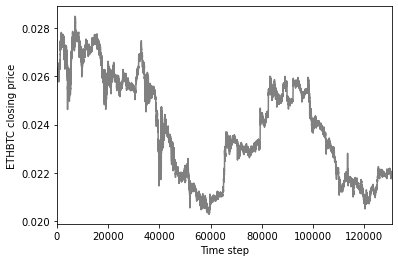

In [18]:
#plot closing prices
#styles = ['bs-','ro-','gr-']
ax = prices_not_normalized['ETHBTC__ticker_info__close_price'].plot(color='grey')
ax.set_xlabel("Time step")
ax.set_ylabel("ETHBTC closing price")
fig = ax.get_figure()
fig.savefig("closing_price.png")

### Get predictions

In [19]:
#get scores and predictions 
sensitivity, specificity, precision, accuracy, f_1,predictions = retrieve_scores(model, X_test,y_test)    
print(sensitivity, specificity, precision, accuracy, f_1,predictions)

0.44380060327036036 0.6651403249630724 0.5521975308641975 0.5584589486571275 0.4921005148968006 [0 0 0 ... 1 1 1]


### Trading strategy 1 



In [20]:
test_strategy = Simple() #initialize class
for i in range(len(predictions)): #iterate trough simulation 
    test_strategy.iteration(rates.values[i],predictions[i],BTCUSDT.values[i],ETHUSDT.values[i])


8868.87
8859.75
8862.65
8850.76
8837.02
8841.82
8844.14
8859.54
8842.34
8863.52
8853.9
8853.89
8849.0
8848.47
8854.25
8857.52
8834.78
8826.02
8822.68
8836.22
8827.96
8824.96
8826.0
8824.99
8842.95
8833.48
8837.2
8838.92
8837.99
8823.23
8820.0
8803.29
8805.54492494791
8802.979793340988
8811.26662074244
8825.411665300806
8827.114590851274
8819.630575345001
8808.219344078927
8812.047340317118
8805.667346586799
8803.966014925381
8809.070009909638
8817.576668216729
8812.898006147827
8814.599337809246
8817.576668216729
8814.174004893892
8821.829997370274
8818.852666962792
8840.119312730523
8840.081974455217
8848.091437633195
8846.814840975047
8848.072186555592
8839.898008791666
8836.966510523822
8841.388770709445
8835.2756463352
8833.194582718435
8826.51116687229
8821.208456694958
8825.050420295138
8835.785907125848
8834.515257705998
8824.820302683667
8829.152516847413
8829.512700934929
8833.864925325759
8836.456249733172
8832.51423499757
8827.701775383803
8819.95781750219
8819.877776593854


9091.126556033867
9090.168397914349
9090.678056488561
9093.542337675626
9082.798734931257
9082.1259856133
9083.400132048828
9075.663514892303
9070.232080357391
9057.643812265746
9055.227304041899
9053.748849643342
9041.003553104061
9051.750387145983
9062.415651290054
9068.859673220313
9055.95123688533
9047.060118019528
9041.054534290219
9036.670152280707
9041.676504761335
9030.858297058794
9021.182067926173
9021.600113652661
9026.269990304652
9032.03086434041
9035.33444520339
9049.313486447672
9048.324451436225
9038.760380913147
9040.391778870176
9050.842922032385
9051.475088740735
9056.246927765042
9046.886781986594
9048.92602943288
9052.810795818052
9050.068008002798
9052.51510493834
9053.22884154454
9053.157467883919
9059.774825847115
9059.581097339717
9069.145167862793
9065.97413808382
9067.89103068333
9057.755970875292
9068.859673220313
9071.979721813128
9072.611888521478
9076.292730162022
9068.737318373536
9056.348890137355
9044.969889387085
9046.907174461057
9041.095319239144
90

9291.513353588536
9298.26819778491
9297.817874838485
9298.26819778491
9299.16884367776
9286.109478231434
9288.811415909984
9294.215291267084
9294.66561421351
9293.76496832066
9297.104818174137
9291.153036301455
9278.545093827071
9271.79083893008
9280.34622846627
9284.849065064263
9274.492540888876
9283.498214084864
9297.457007538647
9290.988297322818
9293.677073848845
9300.435456362431
9302.632782235545
9302.674093073938
9316.45125767824
9320.189888552872
9317.019281706152
9315.439142137595
9325.828817993612
9334.24590131633
9331.09594988881
9336.95176123112
9333.027231583716
9322.048876280587
9320.933483643958
9322.379362987736
9322.906076177256
9326.159304700761
9330.04252350977
9327.945998461288
9332.60379549018
9331.240537823187
9330.052851219369
9332.27330878303
9339.864175337874
9337.488802130238
9316.606173322216
9322.203791924563
9323.825242331517
9321.138302895955
9333.92616997653
9333.450929673894
9329.173766950176
9329.173766950176
9338.316977120445
9337.955381238004
9335.13

9389.889810085102
9377.909971277399
9388.968284022973
9397.722781613218
9399.56583373748
9386.664468867644
9396.340492520021
9394.958203426824
9388.046757960841
9380.674549463793
9382.05683855699
9374.223867028873
9381.135312494856
9383.89989068125
9392.967242222723
9392.855783184745
9394.50740347478
9388.853390457361
9386.89779097284
9391.81212128368
9394.983637546138
9395.986768887939
9400.374201928336
9401.92449582021
9397.020298149188
9404.67044121039
9405.481052395684
9398.783377477199
9391.99450880037
9402.806035484215
9415.248917178464
9416.505364515668
9422.17964281272
9419.788339816105
9414.144459438503
9414.103928879238
9414.245785836663
9417.143720824088
9418.116454246438
9407.8115595534
9415.177988699752
9418.450831360371
9417.802342412138
9417.87327089085
9411.42891196777
9406.899621969946
9414.57003031078
9408.145936667333
9408.247263065496
9408.997078411892
9405.754633670718
9399.065464710524
9407.82593779512
9407.364860264352
9402.290015032728
9402.198800525894
9404.860

10177.232321868962
10171.99663037422
10180.564125547433
10175.328434052692
10178.660237731163
10183.895929225906
10186.275788996241
10186.275788996241
10184.847873134038
10186.275788996241
10184.03170498552
10171.0709089232
10177.730482055973
10181.836830980326
10181.223170343494
10176.978684272064
10179.535603592201
10185.467656414921
10183.19711205864
10185.692665315095
10192.800901025077
10189.200758622323
10187.799566834889
10192.422476965698
10189.487133586179
10190.315575445902
10192.69862425227
10193.23046347086
10191.103106596505
10191.880410069827
10196.881744260018
10194.897574867591
10192.586119802187
10191.461075301326
10186.071089374474
10184.367897930531
10183.891970648978
10189.368227914156
10187.424064969016
10186.70925101539
10187.185577081556
10180.517012155238
10178.135381824412
10180.993338221406
10182.422316419901
10187.661903147722
10188.614555280054
10190.2793148813
10191.416119910398
10178.163636057678
10181.505930072472
10180.592945847991
10182.518434851921
101

9102.931009834832
9105.817469303125
9104.374239568979
9093.309478273863
9076.471798042161
9063.482730434851
9072.142108839726
9067.331343059239
9084.16902329094
9087.05548275923
9084.650099868988
9080.32041066655
9086.574406181182
9086.093329603134
9066.372949035524
9069.582854568147
9066.052548729085
9059.590261849762
9073.799752193083
9057.882497684132
9064.152931278568
9057.882497684132
9051.612064089697
9057.882497684132
9012.54243938591
9017.848190888895
9019.295214026071
9010.613075203008
9013.989462523088
8999.519231151316
8990.837092328251
8982.154953505187
8923.309345926644
8949.355762395835
8938.987101706796
8819.455752083877
8870.629686260529
8896.085920837673
8914.608103021781
8945.314555247951
8978.813453912944
8983.938168351235
8971.46105748413
8968.647693843517
8990.934972349638
8999.437814876843
9003.725841243577
8993.863380600089
8981.218932118672
8989.627647237829
8977.223746576985
8994.417686447496
8992.597889891858
8979.901148405968
8993.863380600089
8996.6662856398

9711.987626093609
9713.02290885942
9717.68168130558
9729.587433112432
9709.399419179075
9684.034991416653
9694.387819074784
9696.458384606409
9688.176122479905
9686.623198331185
9689.211405245718
9688.69376386281
9696.976025989317
9695.940743223504
9697.493667372224
9705.775929498728
9694.387819074784
9696.458384606409
9705.258288115823
9723.89337790046
9721.822812368833
9719.752246837208
9711.987626093609
9728.034508963712
9743.56375045091
9742.01082630219
9731.140357261153
9738.387336621845
9737.869695238938
9744.081391833817
9742.01082630219
9762.198840235547
9753.916578109043
9754.951860874855
9761.681198852642
9742.01082630219
9731.65799864406
9738.387336621845
9738.90497800475
9726.999226197899
9723.89337790046
9738.90497800475
9722.058280704581
9733.27675797678
9745.43378895778
9747.04589297524
9746.736722341755
9739.957052021742
9760.561066381908
9768.950500403746
9772.062622257969
9770.753267010547
9802.696031820926
9835.413230909966
9844.761002078263
9838.009834012271
9844.76

10215.184665745926
10219.470457508352
10211.434597953803
10212.506045894408
10207.684530161678
10201.79156648834
10206.334859334333
10211.136351362898
10213.816721047737
10200.338926492817
10202.853665319486
10212.504796013467
10209.89172181616
10221.207054882487
10227.520142015972
10219.4741566942
10218.937757672747
10226.98374299452
10216.792161586942
10221.619752780005
10220.546954737101
10222.156151801457
10179.244230085336
10177.635033020983
10181.926225192594
10195.872599750333
10199.090993879041
10206.064181157912
10204.991383115008
10207.043945081738
10205.829020264091
10212.835580638668
10211.547356292465
10224.176555686488
10230.974239513325
10222.980347365014
10223.46343149484
10223.923511618483
10236.472196990868
10232.18194983789
10229.4559751053
10256.060108255002
10252.621009330765
10250.792190839282
10259.430195160694
10254.24279176661
10247.054039834675
10252.321957250397
10252.885555401861
10251.493813027839
10257.164300551747
10257.497858641389
10251.010728898013
102

10721.271737273244
10721.271737273244
10719.102098148025
10728.323064430208
10737.001620931087
10736.459211149782
10732.119932899344
10723.441376398463
10719.102098148025
10720.186917710635
10720.72932749194
10720.72932749194
10744.595357869357
10744.595357869357
10744.595357869357
10750.019455682406
10754.90114371415
10742.425718744138
10745.137767650662
10741.883308962832
10755.534732579692
10763.823685311472
10765.98700822171
10769.199777857131
10771.371863330682
10764.855606910034
10761.054457331322
10770.828841962293
10784.92449887228
10786.79886419227
10780.759242605636
10775.888206804926
10774.939453988634
10773.805578671603
10768.760990526449
10771.051881473102
10771.815511788653
10783.258396365622
10797.605390172946
10789.5716384232
10787.397307900064
10785.766560007713
10805.684023909771
10798.147605693413
10787.462330710778
10786.408852895587
10785.992092441227
10789.453519548279
10782.322285106995
10777.031690486088
10773.770041550759
10762.897878432992
10777.575298641976
1

10973.97667650941
10974.525594910598
10971.232084503481
10960.802634880949
10953.330483144806
10944.481150031927
10933.761597034367
10944.401323573433
10954.436649783915
10950.114617245537
10964.072843701933
10959.693792264632
10948.30141625978
10924.718399665147
10922.084126534897
10930.249232860699
10935.244088406369
10935.244088406369
10949.738292512644
10953.205041567173
10940.13630993398
10928.857971726973
10932.940524889873
10926.337736394567
10885.797299260179
10871.360114052828
10891.772879867329
10872.511895811074
10884.930611996546
10891.556208051421
10907.760979125393
10906.643408706497
10900.017812651622
10904.031943135815
10901.63714938104
10919.791966798184
10914.705881014235
10890.609694329296
10884.98763089547
10891.932532784314
10884.736747740208
10870.995193099718
10839.372511756917
10849.042917014289
10874.610191291447
10887.952613639476
10888.100862776675
10909.574180111147
10915.6980098555
10921.605167783942
10923.555214127115
10916.690138696764
10929.929927026727


11220.316975962676
11251.197064694254
11241.284450380672
11240.719845435902
11219.829462479393
11201.197499301965
11212.489598197377
11221.523277313705
11231.493301787279
11227.23930290572
11238.79100507437
11245.765552788615
11243.657528868074
11250.921177005708
11255.558829630898
11243.019098766426
11243.741849824897
11242.356576962826
11241.200175269274
11239.995590171822
11241.091762610504
11256.89591908907
11245.199397792812
11231.539402787712
11234.647232339137
11235.875909138538
11244.50073843629
11242.404760366726
11250.848901899863
11252.511229334345
11249.812958716053
11216.373676410796
11209.013661465367
11206.41175765487
11227.082437927142
11205.399906173014
11193.811797535529
11190.981022556516
11185.825398339424
11174.189106298041
11197.353277722037
11198.196487290252
11192.245836908842
11197.20872751034
11209.989375394303
11209.302761888757
11207.459746689654
11199.509485046474
11186.80111226836
11183.52464080329
11178.862896476154
11188.029789067761
11189.945079372708
1

12161.009529408557
12199.575007859115
12169.606929063139
12195.448256024916
12180.384383630135
12165.320511235355
12171.461510988629
12190.572302220815
12177.049820764107
12187.084214360955
12200.189107834442
12187.943954326414
12170.540361025638
12158.000439529453
12165.48017722894
12166.696095180088
12175.146110840593
12183.19063774953
12196.327076953892
12191.186731178273
12213.17048222584
12220.232152176497
12202.56567473896
12190.61988811511
12195.528609910081
12186.744581434872
12197.98912208801
12191.72711859518
12202.725608030527
12209.405898593606
12210.29168297766
12198.345896353812
12188.528452763869
12173.716169452731
12182.89387987641
12164.107869397914
12158.63322980202
12165.153587073533
12181.688228909225
12182.143423662143
12176.619573822687
12191.111990550697
12198.099845136017
12184.936104984092
12178.194301616564
12187.224381309567
12193.41256943706
12199.600757564554
12196.20525075901
12206.600914710765
12202.20890047316
12179.682911484213
12173.728472013621
12159.

12315.600745010512
12317.328442098893
12312.72124986321
12316.176644039973
12314.448946951592
12315.600745010512
12325.39102851134
12328.090989439805
12328.090989439805
12318.41500116396
12314.37074043929
12309.167376952411
12317.029117426533
12322.056095710468
12329.426477404959
12325.319221964952
12324.449894893292
12325.470409281763
12337.036239017732
12348.249298347811
12354.334587849416
12343.650684128173
12346.964206154926
12331.366714637355
12341.030103970132
12336.960645359326
12336.255104547547
12331.84547447392
12345.47753087296
12345.301145670015
12341.571858522033
12347.79573639738
12340.841119824117
12342.655367625839
12342.068616848695
12349.555988728813
12354.739553876587
12355.315505559673
12347.25218199647
12342.76100522784
12341.815609337638
12331.100479761202
12330.204719315254
12328.15752845238
12325.852984564455
12328.15752845238
12339.934660319053
12340.856536473977
12350.073869336622
12343.160869689638
12329.33487039567
12328.526049436972
12330.411510997117
12317

12251.271665399616
12268.534820928133
12266.747637535083
12256.892227664714
12259.236287042555
12240.237750538177
12252.191158304735
12264.481281783028
12259.637755775775
12277.53549091487
12275.554048457358
12269.389560811765
12283.701011790905
12278.417447027661
12288.98457655415
12293.09401581445
12298.964643329165
12296.61639232328
12306.132842728079
12307.155214896666
12301.284320838136
12291.362509879222
12298.168043226797
12277.311541788979
12278.204282855488
12265.485957226843
12285.333273111217
12268.746402861043
12277.393585157606
12278.567444377908
12289.132177360643
12278.567444377908
12300.283839953529
12296.762262292617
12281.802629735546
12278.60658553975
12276.54921296027
12277.778460727883
12265.18837569748
12258.524558851996
12278.314684519455
12277.727008518663
12289.752128875001
12287.478181742936
12304.5269768853
12295.708634570285
12289.241850205939
12278.071949940251
12280.645593726902
12286.306298123345
12286.137901882721
12286.527019157993
12302.996894518796
12

In [21]:
#scores
print(test_strategy.number_of_trades)
print(test_strategy.current_value_btc(rates.values[-1]))
print(test_strategy.current_value_eth(rates.values[-1]))

3055
1.3251489752312953
60.47042873192002


In [ ]:
#store the trades so that they can be analyzed later on 
#however, due the the secquences and different forecast horizons the dataset is varying between algorithms
# as such, we have to get the previous data and merge it with the new data
try:
    df_scores = pd.read_csv("final_scores_trading.csv") #if the scores exist
    df_temp = pd.DataFrame()
    df_temp[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy1_btc']= test_strategy.value_over_time_bitcoin
    df_temp[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy1_eth']= test_strategy.value_over_time_ethereum
    df_temp[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy1_dollars']= test_strategy.values_over_time_dollars
    df_temp['last_start_time'] = df_test['last_start_time']
    df_scores = df_scores.merge(df_temp,on='last_start_time')
    df_scores.to_csv("final_scores_trading.csv")
except OSError: #if the dataframe does not exist make it 
    df_scores = pd.DataFrame()
    df_scores[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy1_btc']= test_strategy.value_over_time_bitcoin
    df_scores[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy1_eth']= test_strategy.value_over_time_ethereum
    df_scores[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy1_dollars']= test_strategy.values_over_time_dollars
    df_scores[['ETHBTC__ticker_info__close_price','bins','last_start_time']] = df_test[['ETHBTC__ticker_info__close_price','bins','last_start_time']]
    df_scores.to_csv("final_scores_trading.csv",index=False)

### Trading strategy 2 


In [22]:
test_strategy = Conseq_simple()#initialize class
for i in range(len(predictions)): #iterate through simulation
    test_strategy.iteration(rates.values[i],predictions[i],BTCUSDT.values[i],ETHUSDT.values[i])


8868.87
8859.75
8862.65
8850.76
8837.02
8841.82
8844.14
8859.54
8842.34
8863.52
8853.9
8853.89
8849.0
8848.47
8854.25
8857.52
8834.78
8826.02
8822.68
8836.22
8827.96
8824.96
8826.0
8824.99
8842.95
8833.48
8837.2
8838.92
8837.99
8823.23
8820.0
8803.29
8808.49
8806.35
8814.64
8829.44
8828.989950604668
8821.504345086016
8810.090689453107
8813.919498966125
8807.538149777762
8805.836456660865
8810.941536011556
8819.450001596038
8814.770345524572
8816.47203864147
8819.450001596038
8816.046615362246
8823.70423438828
8820.726271433712
8841.99743539492
8839.870318998797
8845.826244907938
8844.549975070264
8844.975398349488
8828.61385046079
8825.686094259943
8830.102709416171
8823.997388464913
8821.918981332572
8815.244096888317
8809.948155637636
8813.785214958885
8824.506997906017
8823.23797047425
8813.555391093289
8817.882075171674
8818.241799483041
8822.588468245394
8825.17648481884
8821.239502077768
8816.433185584225
8808.699112889833
8808.619174153975
8801.794404579985
8809.148768279041
881

9037.262738472116
9042.335594659513
9042.08093320432
9042.0503738297
9029.561776067154
9027.453179218173
9032.73995102793
9039.839912398646
9043.486664436974
9042.529137365458
9051.207999758353
9059.357166324451
9040.491845723933
9051.696949752319
9059.550709030396
9060.55916839295
9059.58126840502
9057.442112181418
9071.27532242737
9080.942271266404
9071.458678675108
9083.845411855578
9085.821584747857
9085.006668091246
9070.440032854345
9066.385822487711
9060.060031940777
9053.683309102804
9057.615281970948
9070.876096857217
9078.091533968764
9084.388942574142
9079.77288092651
9086.029529605637
9094.548354191553
9070.927976930609
9091.175470294498
9088.413985291169
9086.355609015627
9088.485315162106
9084.368562611016
9088.444555235856
9089.463553392066
9094.375124504997
9091.919338948532
9101.13108228067
9096.637300411785
9100.193603976957
9111.881512828684
9106.37892278515
9094.558544173116
9078.427803360313
9084.562172260697
9082.49360600359
9070.021068571581
9069.501379511914
907

9250.280322085193
9252.362799076735
9247.465885359003
9252.589603501554
9258.77517872395
9250.465889341865
9246.661760580091
9245.476191995798
9246.414337571196
9251.867953058942
9245.723615004694
9241.6102074818
9241.682372526062
9251.084446864106
9247.43495748289
9246.414337571196
9251.538055713747
9254.063832262893
9253.620532705287
9256.713320316485
9255.713318988866
9264.507145096704
9260.16693314899
9262.723637574247
9264.33188713207
9262.043224299785
9261.723636246628
9257.321568546688
9258.1256933256
9263.414360140749
9260.847346423454
9258.785488015988
9260.32157252955
9258.404044210607
9258.77517872395
9273.414373416957
9281.218507489213
9299.032964129716
9294.27007120847
9284.692738905793
9288.342228287007
9292.136047756743
9282.878303507223
9287.012329614192
9301.785545103681
9315.383501300917
9328.311353515726
9336.063941127795
9318.589691124527
9320.775261036439
9340.36291590736
9336.579405729663
9320.940209709037
9295.981413686666
9299.383480058985
9297.08450793466
9248.

9448.707973949096
9452.876317254108
9461.676153120245
9460.286705351906
9457.507809815232
9460.286705351906
9497.338645840899
9538.670543047834
9536.858104305935
9554.931292890416
9542.961005380355
9545.275192700521
9550.159561513437
9559.150076854612
9546.596122631057
9540.431782955218
9549.41205852949
9543.46275395862
9554.019953636014
9577.366622175743
9572.779206603023
9574.960276953447
9574.489247675889
9585.025967819478
9592.357640922304
9580.725265720053
9586.561932854986
9581.308932433545
9583.018973506412
9595.224775655252
9600.805448617599
9574.182054668789
9561.89433438472
9567.5671652492
9569.103130284708
9564.06516496824
9577.627127609947
9572.993539256
9562.33628604192
9571.603462749816
9577.627127609947
9581.333998293107
9586.894304317844
9574.846974597578
9589.674457330213
9606.355375404424
9614.695834441529
9626.2798053264
9629.986676009557
9608.672169581398
9621.646216972451
9620.719499301662
9648.057670589953
9669.835535853508
9646.204235248375
9603.575222392055
9546

10348.794398121008
10354.057552659926
10351.420784902757
10348.109253743161
10350.040115171641
10349.832495663202
10349.0746844574
10352.894883412671
10354.213267291256
10356.092223842625
10361.957474956014
10360.21347108513
10354.55583948018
10358.760134526061
10358.853563304858
10358.69784867353
10356.673558466253
10357.722036983869
10355.386317513934
10359.891660847052
10359.175373542937
10358.905468181967
10359.154611592094
10369.556348964867
10378.567035631102
10376.220935185745
10364.199765647152
10357.722036983869
10357.217000832561
10354.792672149251
10347.034820362664
10361.580792462517
10362.065658199179
10344.610491679354
10354.307806412591
10359.641329515869
10374.187301615724
10363.09173010137
10363.526927458437
10372.393790270738
10372.724875425583
10365.934220842653
10369.329548134117
10368.844501378195
10371.754781913736
10371.754781913736
10381.94076378813
10386.203168421232
10390.24114774093
10390.012190150639
10389.616717949224
10396.75603190106
10395.194957421796
10

9272.845284366382
9249.860015320288
9247.351577282836
9246.585401647966
9242.576099010703
9228.30214197751
9233.528929185253
9238.944636412552
9247.414550622689
9254.971351404965
9249.608121960877
9250.374297595748
9263.210363368977
9291.926206341632
9282.753089836477
9273.013213272654
9273.789884464166
9267.555523818786
9263.745636757722
9274.178220059923
9279.111131681686
9251.833179968993
9265.52988138687
9257.070462733376
9247.918337341507
9253.953282410688
9261.289676503482
9256.031402625813
9249.440193054605
9244.454803649629
9230.233324399649
9241.253658873804
9234.7883959823
9257.689700575258
9250.825606531356
9244.517776989484
9238.41985858045
9241.39010111015
9230.212333286365
9230.117873276586
9236.152818345767
9245.567332653687
9239.23851199853
9251.402862146668
9256.62964935441
9252.116559998329
9239.584865367717
9255.181262537808
9259.463449647765
9265.592854726723
9274.797457901801
9274.923404581506
9283.571743254557
9274.692502335383
9280.160687345891
9264.102485683552


9674.916564521463
9689.789519920745
9705.300194971038
9698.91152129456
9704.994934112776
9701.93142335665
9692.253501167155
9695.732893302666
9702.363923343204
9709.856551037034
9702.702018624876
9690.377900292957
9674.70554804254
9658.09525404297
9664.355469903609
9663.46115335209
9672.055317286206
9669.568681021006
9675.708927588148
9688.033045920067
9693.518914522683
9678.064688260443
9631.832885066631
9654.496175238071
9665.51153764094
9661.923365135452
9675.174518917118
9686.909697080964
9680.202322944566
9712.932127470309
9720.053940984242
9706.312003729181
9701.447794192865
9717.512773221997
9714.306321195816
9705.112310794215
9709.758394342354
9694.565919265926
9695.645642907397
9701.098792611785
9694.849483050553
9704.948716303083
9688.708296507195
9689.738407431281
9675.831909956098
9687.678185583107
9675.831909956098
9674.286743569966
9669.65124441157
9668.621133487482
9650.594192315948
9646.98880408164
9614.540309972876
9621.236030979448
9604.239200732
9609.904810814482
960

10051.697917214578
10049.03152112986
10047.983194464072
10033.169882882305
10041.180465991523
10048.450383521651
10061.383544018041
10070.317110387354
10065.326163869804
10072.26563060311
10063.776463581251
10055.310086269517
10060.688457859203
10061.798011861849
10060.737926731797
10070.808735467266
10084.382001867309
10081.643293135527
10085.922525528933
10085.14655805493
10057.919228746488
10060.714993910178
10046.6220552279
10059.459752408115
10057.919228746488
10060.349832745942
10053.68564149861
10044.374031810561
10045.766208749217
10041.407097351135
10036.717058647962
10038.771090196797
10039.946452694185
10045.355402439449
10055.625560183622
10055.306044164914
10074.180311841428
10072.731078470862
10074.55688429205
10069.216402265078
10058.980478380054
10061.239913083771
10064.081323392991
10065.929951786944
10064.149791111286
10069.661442433991
10069.216402265078
10068.177975204278
10070.8119411213
10057.700699559698
10031.556696569829
10042.699293477302
10047.106099221446
10

10789.71531384241
10804.05359424057
10795.814772805437
10793.550234869537
10782.147888076714
10788.361142915917
10777.812265194414
10786.062466217165
10797.459043024997
10809.783302737294
10822.100981912663
10843.431874989712
10837.152064744801
10821.995208710194
10843.647860188205
10846.354441622956
10852.850237066361
10836.610748457852
10846.354441622956
10850.14365563161
10842.023911327355
10845.813125336008
10856.098134788062
10857.722083648914
10848.519706770758
10831.197585588348
10840.399962466503
10836.610748457852
10836.610748457852
10842.023911327355
10826.867055292745
10816.04072955374
10815.49941326679
10805.755720101684
10821.453892423244
10818.20599470154
10805.214403814734
10798.718608371331
10787.892282632325
10790.057547780127
10788.974915206227
10780.855170901972
10768.946212589066
10772.735426597717
10798.718608371331
10787.892282632325
10772.735426597717
10776.52464060637
10777.065956893319
10781.396487188922
10792.764129214878
10794.929394362678
10795.47071064963
1

10877.71479612995
10871.122241708053
10870.572862172896
10861.782789610368
10870.572862172896
10880.461693805742
10874.418518919003
10865.628446356473
10861.782789610368
10855.190235188471
10851.893957977521
10854.640855653313
10859.035891934576
10872.22100077837
10865.628446356473
10862.332169145526
10872.22100077837
10894.745561719852
10891.99866404406
10883.208591481532
10878.813555200268
10877.71479612995
10876.663494661398
10865.884537200494
10858.182528010033
10849.380231792364
10856.53209746922
10860.38310206445
10856.53209746922
10855.981953955617
10864.234106659682
10862.583676118868
10868.635254768516
10869.932656016075
10855.692087739446
10858.898801661302
10871.173964630987
10881.483722293731
10883.678999566398
10886.89720708654
10881.000991165709
10884.989269771027
10890.184376196401
10900.057377124267
10908.608614249217
10911.378571436197
10905.298457942785
10907.424773625735
10910.229211607575
10919.366622245121
10913.056636785985
10907.424773625735
10909.585570103545
10

10920.81643268988
10927.059709444784
10928.64087450748
10935.767743503302
10942.848107644339
10943.289903764799
10946.94053486543
10954.881238819993
10947.95201545701
10951.893301900049
10942.685340652592
10954.823107751514
10956.77631165249
10952.439733943773
10955.695073778734
10959.086149810217
10965.702290766987
10977.280537441335
10970.113051404835
10963.496910448064
10962.945565368333
10960.74018504941
10967.35632600618
10972.318431723757
10963.496910448064
10959.086149810217
10959.637494889948
10969.010361245371
10984.448023477837
10983.345333318375
10970.664396484564
10978.934572680528
10964.713053641308
10966.527431056586
10967.678862877821
10970.353906502913
10983.229007776728
10985.113168938748
10985.124799563206
10971.551860821977
10969.53976279093
10958.897741412846
10956.443679652435
10953.524392913747
10961.049406937374
10958.572083928051
10961.700721906964
10965.45741360655
10960.57255133464
10955.32991039837
10956.433332860011
10969.122691168877
10950.970713621788
1094

11407.681257456587
11403.009635627932
11413.718430281306
11410.556101658834
11409.250443250314
11408.93900179507
11403.620540020911
11401.76386980696
11402.35081716492
11398.54164859694
11395.355362939448
11392.12116321192
11394.79237261651
11399.440037410142
11396.361558410235
11394.780394099
11395.15172814179
11382.622198826995
11390.276471515479
11378.046405138415
11380.525958262855
11378.944793951618
11374.943969103491
11386.4673029475
11385.820463001995
11387.509433970816
11378.513567321283
11372.404523391506
11355.634598878394
11359.12034747362
11366.06788762905
11369.014602936355
11367.241782344969
11372.2727596989
11370.23641172231
11376.680854142349
11375.039797243566
11378.74115915396
11381.400390041039
11381.616003356208
11383.005511387293
11385.377257854148
11374.141408430363
11384.38304090087
11382.33471440677
11384.77833197868
11385.149666021469
11391.55817288898
11389.929094507706
11390.887375908456
11392.073249141884
11382.202950714167
11383.185189149934
11385.257472679

11950.619317706669
11963.90138647165
11950.307532054909
11961.257444144727
11965.08617194834
11977.782083688015
11984.416882357471
11983.431639697908
12002.500450159561
11991.962095130066
11991.538066643672
11993.62079479743
11980.326254606378
11975.78665551675
11989.093667133873
11997.82366538316
12004.770249704376
12003.834892749095
11991.72513803473
11994.119651840248
11989.60499560276
11995.0674802216
12015.395904716363
12012.29051962483
12010.569462827114
12013.51271937973
12023.153131732155
12020.172460901327
12010.644291383538
12028.690444907415
12025.672359798376
12027.979573621404
12028.665502055273
12021.369717804086
12009.983305801805
12015.607918959558
12023.489860236055
12013.175990875829
12020.284703735962
12022.40484616793
12024.986431364505
12020.20987517954
12016.455975932347
12002.78729295918
12006.229406554612
12006.229406554612
12006.241877980683
12007.913049074117
12007.089934953472
11997.27492263606
11995.341851595147
12001.826993151759
12001.053764735394
12008.73

11973.61810892363
11987.752152375004
11994.600863632553
12003.320807474132
12001.611748380721
12002.035894433098
11996.347347377648
11990.546526367156
11997.83185856098
11998.742525085207
11984.658381169407
11984.708280704981
11982.986746727674
11992.093411969952
11985.207276060723
11982.076080203446
11991.606891498106
11981.377486705407
11976.711880129225
11951.362916057566
11959.084869187664
11965.971005096893
11963.875224602782
11940.422442882937
11941.4578582461
11944.040159212062
11956.165746356577
11945.150423878587
11962.265964580514
11966.158128355299
11969.02735165081
11958.061928708392
11964.548868333031
11967.96698651986
11975.888537792252
12001.611748380721
11992.704681280737
11991.993612898805
11993.266051055945
11993.765046411687
11986.105467701058
11998.280954381147
11998.343328800614
11995.286982246696
11997.033465991793
11999.004497646973
12007.237921016702
12000.501483714195
12003.433081429175
12004.917592612506
12003.757428410407
11992.392809183397
11991.182745445725

12389.186704112404
12391.429331637537
12400.944660854355
12405.328554208576
12406.253479685043
12404.048862795928
12402.870533079331
12402.870533079331
12408.181633661228
12403.357477686308
12395.436058936986
12411.899935665575
12406.348605406052
12397.337199436824
12391.55773231732
12393.040621907194
12385.398037097848
12384.29537560794
12389.09892393753
12388.503233247582
12387.565337267662
12386.373955887764
12386.564069937747
12382.166098248126
12384.447466847929
12380.82262562824
12381.950635658144
12382.31818948811
12380.771928548245
12368.883463289263
12379.136947718383
12386.348607347767
12386.564069937747
12380.607163038258
12387.387897487677
12388.972181237541
12391.405641077332
12390.543790717405
12385.398037097848
12381.659127448167
12385.296642937856
12376.27256269863
12365.325248642304
12371.194723597833
12368.153548104481
12372.211911899387
12371.63214564297
12371.63214564297
12379.748873232784
12375.063731675029
12381.749793844301
12383.944649167423
12389.476192062682
1

11803.933052509594
11798.344458554873
11799.219308543112
11821.573684361998
11849.673343685738
11849.764745923314
11872.314983679866
11870.35636430321
11881.024311174724
11864.376046473159
11853.786444376712
11856.17596001623
11837.099007287614
11857.481706267334
11829.31675963104
11830.309126781878
11832.319976008575
11828.337449942712
11841.72134901652
11840.742039328192
11852.37623842552
11863.553426334962
11862.796093509323
11836.106640136773
11807.327992762463
11803.946109972107
11820.163478410806
11817.003572483138
11810.474841227622
11806.635947249377
11810.527071077666
11818.348491121775
11814.170103118244
11798.018021992097
11806.518430086779
11798.631722730117
11787.611224370805
11783.472008754808
11767.502732103818
11796.960367528704
11787.950718396092
11781.800653553399
11795.184552627205
11795.589333965047
11790.888647461075
11784.35991620556
11789.32175195975
11790.875589998563
11813.882838943002
11816.990515020625
11816.92522770807
11821.208075411689
11823.950142539004
1

In [23]:
#print scores
print(test_strategy.number_of_trades)
print(test_strategy.current_value_btc(rates.values[-1]))
print(test_strategy.current_value_eth(rates.values[-1]))

1755
1.3040186243180418
59.506188934838086


In [ ]:
#storing is more simple for this one. Since the dataframe always exists after previous steps.
df_scores = pd.read_csv("final_scores_trading.csv")
df_temp = pd.DataFrame()
df_temp[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy2_btc']= test_strategy.value_over_time_bitcoin
df_temp[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy2_eth']= test_strategy.value_over_time_ethereum
df_temp[settings_analysis['algoirthm'] + '_' + str(settings_analysis['time_ahead_prediction']) + '_strategy2_dollars']= test_strategy.values_over_time_dollars
df_temp['last_start_time'] = df_test['last_start_time']
df_scores = df_scores.merge(df_temp,on='last_start_time')
df_scores.to_csv("final_scores_trading.csv",index=False)

### Baseline models: Only run once 

In [24]:
#optimistic
test_strategy = Optimistic() #init class
predictions = predictions 
#predictions = [random.choice([0,1]) for i in range(len(rates))]
for i in range(len(predictions)):
    test_strategy.iteration(rates.values[i],predictions[i],BTCUSDT.values[i],ETHUSDT.values[i])
print(test_strategy.number_of_trades)
print(test_strategy.current_value_btc(rates.values[-1]))
print(test_strategy.current_value_eth(rates.values[-1]))


8869.313587812247
8864.63253755479
8866.421500914932
8853.500329835184
8848.822463288849
8853.075069240063
8854.297433191552
8869.715119984296
8852.014291845584
8870.685910577833
8861.058133074113
8861.048124989391
8854.646581567034
8853.366574740681
8858.340277142383
8857.527297342243
8835.329880252537
8830.65757465748
8821.563025262814
8833.779324944626
8829.95701658287
8821.593955382075
8822.633558701933
8819.83904489059
8836.947385135805
8827.483813393656
8829.935994067162
8833.759764646316
8832.741739687268
8818.38967669629
8812.88933249471
8796.19280406546
8798.445911097093
8795.882847494475
8804.162994071175
8818.945402917398
8818.495888446936
8811.019180255164
8799.619090796
8802.773339307989
8800.756598676777
8799.864227228465
8805.872734900257
8812.342744956335
8807.952362771977
8809.279142566422
8816.192363600636
8814.406697561495
8818.472378549923
8819.588645962229
8830.730785265398
8828.606379283568
8834.796101662376
8832.527567432522
8832.95241243336
8816.61310481679
8812

9166.363087022331
9149.65931431522
9156.817245587048
9161.465098391356
9172.59689073448
9189.517215096028
9186.984990150278
9174.841948627785
9185.524343561423
9177.067447572294
9171.891242810923
9171.351520148099
9176.779884622278
9203.554409968416
9212.231188529924
9207.633956075571
9218.35845206675
9221.4756207622
9219.28114201618
9218.83500526222
9205.762160843879
9197.991081106306
9204.91138842935
9201.470839587018
9220.356564366191
9226.425577881793
9240.213131663393
9238.764442035257
9248.57346755163
9240.99376601625
9251.773580087225
9249.263665414279
9243.855416029042
9258.769598811048
9253.363650478595
9254.444978070016
9252.426499156893
9241.495182070857
9238.699509467546
9242.107086917229
9234.235294063054
9230.024559018528
9214.79707188689
9215.242553978835
9213.01514351911
9205.887430047986
9219.251892806342
9226.298350343895
9232.858904526407
9216.333379175056
9213.660945370928
9211.87932283484
9207.425266494625
9213.215539736906
9204.427267896363
9193.651531223028
9187.

9080.759296389933
9087.06133133592
9074.349907321992
9082.210111543167
9077.379361032237
9081.736491198262
9088.113261620767
9073.979255707314
9077.093333992845
9075.57455352616
9069.916273281353
9073.610014996317
9092.812311402868
9097.70522478832
9101.361919587183
9093.395908754004
9092.310565375705
9078.972793683115
9082.08092864121
9082.187053990263
9078.183935155554
9088.858918714777
9092.93574208389
9095.13584072182
9094.707796916167
9097.483674717017
9096.274989918124
9091.204659617677
9094.53329486298
9087.043388664535
9090.904362838259
9077.252695534347
9076.624935638232
9076.171260217157
9076.263419993567
9067.651600886782
9064.297396690796
9064.297396690796
9074.094711357553
9088.006007519381
9091.083210456465
9089.842071938509
9095.38103722526
9099.176254180993
9098.263350642992
9107.182779446133
9107.182779446133
9100.160247796413
9099.554880365915
9098.046592022132
9091.746666558985
9083.95538931788
9092.511013016758
9080.240030164463
9077.216748100871
9067.361765461626
9

9418.587781072962
9406.081777434998
9397.123177677662
9392.999787486904
9364.183332746052
9367.864839589733
9362.13368223982
9354.049325977872
9362.13368223982
9386.835881929108
9364.846994310237
9362.93791400076
9378.887320395816
9376.505871149951
9378.302394763718
9377.404132956835
9383.691965605018
9381.198885771364
9373.371013796183
9379.55200201152
9394.046844816276
9401.789335512525
9396.051990452892
9389.293250351098
9379.998856000506
9387.635096808477
9385.389143629662
9377.752902821692
9373.260996464063
9372.8118058283
9369.499240501054
9372.911098711522
9377.851537740025
9375.176963702323
9381.060953391216
9374.773680024973
9359.953678518825
9364.032771660653
9341.649092610134
9362.741401764279
9355.416715953847
9358.131954940067
9358.40550513644
9363.584094204412
9354.964147365703
9354.275572783527
9349.310182825395
9340.828599031931
9338.526226858321
9361.990196354614
9352.581282996804
9351.498752105099
9353.957210111495
9365.288374585416
9363.608934136602
9373.260658161711

10309.849261918422
10317.987719724319
10336.445658400033
10334.5027174868
10324.788012920635
10322.359336779093
10311.30066792472
10317.021720939501
10304.393192869053
10312.650307376653
10340.821639226118
10337.42165089946
10337.538403584322
10321.983069766871
10322.468467512921
10321.209788442413
10331.180029006298
10342.124253154683
10354.482324441853
10338.888114148127
10333.934412691491
10336.94852884205
10342.797700452655
10319.401014010235
10334.511374004298
10331.586788198996
10319.374716134675
10325.307367122507
10329.1856018672
10336.420557983813
10333.495155939101
10315.455176663374
10352.022702222279
10370.550248505457
10375.847861993629
10374.415983007215
10375.489892247026
10379.301217196156
10391.64064493201
10383.965352423958
10378.149375412051
10353.772945081579
10359.188447254382
10347.515366291283
10349.131421158874
10360.23890814782
10360.480917066925
10378.903858286658
10391.294230485122
10371.804179383807
10359.758883647997
10346.049782662934
10350.088041178045
10

10352.269585695885
10361.172857166215
10360.64974473415
10357.4692211472
10349.52837442846
10342.314947680381
10338.471242870113
10350.574927144122
10359.542449014029
10363.473777679277
10356.511793642982
10358.618138000102
10358.915243520147
10348.85147139492
10353.759862341321
10344.433919543157
10332.090482546644
10334.773095882605
10338.595363482547
10338.104778146897
10336.233681261461
10337.154834707215
10336.066513327169
10335.235391457047
10331.803550095623
10335.235391457047
10315.243179995545
10306.420492156525
10286.656954302654
10275.137749255822
10271.22042643872
10261.40837892361
10281.747651745902
10284.930554881252
10296.617742166078
10275.55224768929
10271.633085926165
10216.220300745394
10225.618508657253
10240.31260049323
10227.30895812552
10253.069533320337
10238.357810032294
10241.792554044583
10244.81329461702
10262.436253266018
10255.582880458076
10256.889183246985
10249.269346993642
10248.546866243854
10246.461286993072
10235.491140133952
10221.514892364627
1023

9794.941689148518
9790.162777378942
9811.13473241704
9809.830216596478
9830.216193376045
9832.671716502136
9826.379438491525
9822.563146299724
9818.593383912543
9838.91243739545
9836.276165472915
9842.3198503927
9834.639973278048
9853.42550491535
9852.934647256892
9845.752423403304
9852.780418375754
9840.317217602906
9831.842804104099
9829.420082754019
9838.834961924586
9834.296192813043
9828.145613915936
9841.273563404995
9848.654099420875
9857.528409484186
9859.900344892812
9878.17038185495
9875.623256818566
9879.693393386704
9880.00944095158
9872.258290997459
9860.28303518666
9864.974163706183
9861.729739347487
9848.310375182744
9863.925508426926
9868.519085615058
9868.14323013704
9865.902934649705
9857.013047721963
9864.178014916673
9859.869793090073
9862.676740269735
9866.16971610007
9857.546956013952
9850.919731686334
9854.289892824665
9854.903989505103
9850.005727216008
9846.637637301335
9852.246392778985
9855.75100494334
9863.008846706527
9877.014133484434
9867.233673809811
987

8542.159088067006
8536.487919580719
8563.372038140807
8539.804516382557
8497.31950658408
8527.235638118626
8541.809668167856
8535.755087899082
8542.2073252883
8534.636025782049
8514.290891152748
8528.61647747072
8534.487619404314
8528.912260005185
8543.62958402632
8549.873297247406
8552.549174342159
8571.91544235345
8569.384931518065
8573.843508485557
8588.462727587108
8577.411322530425
8541.00106987596
8548.314754267689
8522.943551924898
8519.82779023368
8526.50442242915
8508.700069907894
8529.851682988483
8521.776058214848
8535.964823005464
8543.206391757523
8549.659516211803
8563.039071842957
8548.117001278028
8543.466485685425
8520.706283285705
8508.017425652904
8504.504049380776
8488.486697136537
8464.885301955117
8440.240101673597
8450.293743397597
8443.17170905845
8462.144750671407
8480.5697686568
8488.147326531769
8490.488951970492
8493.427416294388
8491.020143094895
8500.366261658883
8497.19799882646
8514.935535082082
8506.671285382137
8481.435831411514
8469.083359061426
8467.

8420.967123875409
8423.616337525958
8416.94800714459
8412.728197155926
8413.610820897957
8393.142455045247
8400.945688433894
8417.69468823245
8402.990189473832
8381.548618687255
8365.684295488725
8374.336635143174
8369.412928046995
8373.715196383462
8343.176722411974
8346.258797300194
8347.970779826497
8345.729891234554
8352.605780161968
8375.819087627217
8367.717413487117
8376.575799168482
8371.880016989375
8368.520234174272
8372.617063361919
8380.218699778543
8386.428200734888
8385.107565169852
8392.87826139312
8381.750666313235
8376.637775923784
8373.73932175371
8385.160953037765
8383.028200542825
8380.381067802271
8378.166573613058
8375.10366455672
8366.488407386934
8360.756123772724
8363.84273802653
8366.047462493534
8364.565817100523
8370.580375997695
8376.681130802628
8366.040724855564
8356.826625223724
8346.677883876233
8356.826625223724
8347.790715427467
8349.167317805952
8347.1945038862
8344.043378131937
8311.526618591919
8317.309411096034
8333.38911247679
8333.580332531641
8

8509.06746248797
8534.292790538748
8530.806083731735
8532.83594925448
8521.68640377127
8530.321935207347
8514.080780792605
8515.82623219863
8516.272835210597
8512.881499413845
8528.38515866382
8512.313350961405
8512.189885366122
8526.923036851336
8516.846877396983
8596.998407408939
8581.325020126833
8568.03720056958
8580.138948028012
8574.025417725436
8597.820544104658
8588.151351870754
8579.05741619647
8594.322977751166
8582.035026331117
8587.349623926151
8590.94397316444
8598.193620122462
8625.05695513617
8605.81215873716
8596.076500303248
8592.030002537795
8594.327610054082
8598.882193512793
8597.67480407879
8607.059017798672
8595.52699989856
8575.302230487036
8570.807837284474
8577.4523625772
8568.074041926078
8572.510366118639
8568.176879374227
8575.813801040948
8588.701456753473
8588.749850129152
8594.96355956637
8584.907416100219
8578.202718019742
8580.000141323675
8590.335325321288
8588.846636880511
8601.390199856578
8602.116100491767
8598.670598255421
8596.299216735119
8588.88

8937.12012895883
8929.748924267627
8926.368569383694
8949.956510146281
8948.759155668118
8942.182871592824
8937.988633465715
8937.55673251441
8942.770916134794
8941.87300249293
8954.443793479013
8954.39034247574
8950.200420619507
8947.228164840484
8953.575583259351
8949.4259996315
8941.366782496194
8920.813652848527
8919.025511828373
8922.61447637214
8920.819994100257
8917.816654808334
8912.135009452535
8911.483422225529
8944.654939994374
8954.516742574302
8943.235293169257
8944.895553184622
8950.305913860851
8945.830670392694
8946.732271561597
8947.34663107691
8939.977205057206
8934.113232597001
8934.113232597001
8933.216998135187
8945.316163369682
8942.179342753332
8939.04252213698
8940.489736899472
8938.175053216453
8941.776739445215
8936.646136403844
8957.712560739836
8959.057226122983
8967.125218421874
8967.573440216256
8967.905776955033
8971.685276355402
8969.21535995803
8958.496192667926
8948.65463068075
8954.482328817152
8953.603146586338
8956.87780979712
8957.325989822632
8947

8981.824057050295
8973.785112448073
8968.021264034513
8977.305392285518
8981.89519161534
8984.615931794251
8979.968386597235
8976.310198388337
8974.612566741336
8967.75316122052
8955.085837987475
8949.221932487357
8951.664678546465
8943.001926129453
8944.804405606652
8948.859984430354
8949.761224168953
8957.394724754897
8963.831599243473
8955.271446429559
8959.172937012823
8959.98012788577
8957.663015262251
8970.160229248113
8967.586714817893
8967.56026565437
8985.141949263889
8979.638647420848
8985.062505967995
8989.022236754381
9001.170476767498
9010.713888602688
9016.129258235642
9001.212303064889
9009.754661256964
9005.613220650945
9005.841177194594
9017.808895736182
9011.206454913783
8992.408414549196
8982.908800704425
8986.334428811133
8982.286327812119
8985.743815823056
8992.702284642062
8994.084586800618
9005.316522195495
9006.586593507755
9002.157217784503
8985.793085360265
9003.771863042059
9006.019210252283
9011.457314063417
8994.512041571234
9002.803864716825
9006.063374518

8942.108138327398
8931.949978181112
8921.669497297451
8923.696341036295
8934.649908955493
8937.146117841086
8943.426810223185
8941.770568380201
8952.005770780657
8952.117427534116
8948.646763447416
8947.61257803267
8950.110819128706
8945.185012560838
8942.235102244469
8929.63264996518
8944.123144910665
8954.17720462573
8964.287068557529
8964.017348176643
8957.04545032135
8968.69485163736
8963.400698319329
8962.551918989004
8972.853187997885
8973.992496705356
8965.467542404469
8954.648887522317
8958.322910754929
8961.565021624509
8968.109567034493
8973.268974282419
8968.434935059136
8968.316793388241
8958.909468080494
8958.013532336898
8962.665386610464
8962.144546909025
8947.08685040862
8948.349236557084
8945.485169670605
8936.826383455627
8942.7923226562
8950.639854323885
8950.388807694706
8953.187644373415
8953.63548289104
8953.052250250057
8938.564046570536
8936.773468836847
8930.05880233552
8925.134713567877
8932.062524623248
8940.25266298869
8936.7253193063
8946.861442810288
8941.

8404.282911032868
8403.608667816767
8405.447411031206
8407.479617178533
8402.992577941737
8404.359371456752
8424.879258307188
8429.384281669181
8440.81319323224
8437.162415817133
8439.473375905021
8435.69670961353
8430.847500688631
8430.426799715542
8420.389715899602
8422.151830339402
8415.076232382315
8422.293458469489
8430.476032159344
8424.986728627753
8428.772861376425
8426.66945429383
8423.020275221668
8420.464501892731
8427.125831677358
8428.95424314008
8430.215873770696
8432.318591488387
8430.636417314234
8429.685842556684
8435.673435552611
8440.384394606464
8440.44732726558
8435.43069529602
8439.961846752398
8446.210882389227
8449.161450119376
8456.748624282616
8458.434662985557
8476.559579042187
8475.777358246345
8467.168362391563
8457.479080719091
8454.108895789535
8450.73871085998
8450.451153201051
8450.343982534936
8450.433115971307
8454.789106954237
8458.098938612073
8457.454739006613
8457.454739006613
8455.76830735377
8461.24921022551
8462.51403396514
8478.113526753936
84

8572.86507613669
8573.357881993963
8569.34247227593
8560.619135085068
8557.644484603778
8570.474582179053
8560.544119499331
8560.45425105879
8558.216526889331
8553.492071694563
8552.343176063516
8545.022364124783
8551.484829817171
8552.723990782553
8551.99162305175
8553.088646275703
8544.072197642023
8544.02137555427
8544.698926518236
8545.124057068339
8546.82457926875
8547.674840368956
8543.423534867929
8546.089446497428
8539.422081325083
8543.197062064923
8534.90186796499
8538.676142930542
8535.26970008122
8539.203857008635
8541.327297565906
8539.203857008635
8542.074111609898
8548.76233569098
8546.019277535575
8547.717949624133
8545.656362189207
8545.746141255766
8545.430955684244
8550.953729853962
8546.281733947144
8549.028193398251
8546.746016809022
8547.193575744921
8549.314816343543
8549.733342832096
8546.7862391686
8546.361490821559
8544.662497433392
8548.485232556764
8545.936742474516
8555.70595445647
8554.646060792422
8553.667191273558
8553.433699461719
8549.477416579724
8546

9141.62303441856
9138.792917563269
9137.38252929545
9134.32824476845
9129.212479917283
9129.638959057706
9137.31558358534
9121.266110745164
9122.573218133066
9114.397299828208
9122.070069045161
9124.964450726276
9134.495692527062
9126.758983566633
9126.758983566633
9121.732934812271
9122.041038696563
9127.328484283902
9124.337041243236
9122.815889120835
9122.614075834475
9128.651412712787
9110.804577761992
9102.143819107727
9109.813087878216
9120.072482173811
9118.64465222583
9131.644437307767
9115.342102382578
9123.437811256754
9134.516149716153
9134.090059775408
9139.629229005108
9137.924869242122
9135.67060461905
9133.614141172631
9133.51131800031
9137.85793392115
9140.017477092813
9141.755974302476
9141.30528847678
9138.748399206776
9144.155476810354
9148.771698335162
9149.801605084212
9149.37539856264
9148.5229855195
9141.703681174366
9144.687126825362
9142.70583676438
9147.224620232848
9137.531049458263
9140.087240538865
9160.110737336912
9159.25867364338
9157.98057810308
9155.85

8931.15831473548
8924.768171337608
8929.29776044952
8928.449572583411
8938.20373304365
8950.926551035269
8959.8325236294
8971.707153754909
8974.675811286286
8975.948093085448
8976.796280951554
8981.037220282094
8993.335944340657
8966.672660459188
8971.332363286136
8969.053666294913
8962.739521496502
8966.557063176268
8958.497808518981
8974.192146535801
8972.495461344794
8977.861555721596
8988.247639144807
8989.94401503216
8991.216296947676
9000.970458299962
8998.001800497092
8983.900200948214
8985.474144069718
8995.222535829795
8993.015903857806
8994.84270407352
8970.848239665953
8976.031220798957
8974.337390309587
8992.969525692666
8986.910958269742
8981.171999721859
8978.274570974469
8972.220102197873
8971.01245483807
8963.014942824313
8960.006368622675
8960.522862556956
8948.764358231609
8958.974795729444
8956.2902112284
8949.437401854462
8929.913662709678
8921.87784005213
8929.49072467507
8935.158940214884
8930.664800659142
8938.955232013524
8932.469900190848
8938.479134394962
8939

8697.524934669735
8701.696310287913
8698.671004551983
8702.334602677762
8694.261552451208
8698.551424822046
8697.882368552591
8699.384437942303
8703.073918171393
8704.264524919701
8703.98485525989
8695.788626760188
8695.27249221986
8693.35662557734
8694.560518810335
8693.257379939758
8696.225043978426
8697.45436615032
8693.766399634636
8691.93474852705
8691.389863191165
8694.840313013212
8695.103447726207
8694.407165208137
8687.667405252552
8689.42284067738
8693.108790885519
8686.555990515493
8686.160760408924
8686.188182588721
8686.597676657295
8690.530712397189
8683.98477608555
8693.255188636786
8696.600090158667
8697.627234149413
8712.779894836085
8713.189426205994
8732.027869221856
8731.208806482036
8735.686583984685
8746.056693141034
8748.505071169959
8753.049556265674
8754.827302472439
8739.029384244373
8730.457818309531
8734.647195383855
8731.786726126888
8734.974831489355
8738.605324359314
8735.019763331804
8733.851535428106
8728.90284132277
8727.023251361457
8745.02374395573
8

8707.311877446713
8701.7609493029
8700.950616300217
8707.028113820334
8702.976448806923
8702.571282305582
8701.7609493029
8715.321337283005
8723.22895568302
8717.150517097361
8711.883111839285
8708.222184147917
8644.194231777257
8611.782251746865
8585.380876764695
8591.23792511679
8584.774918569392
8585.720105962671
8587.522145478835
8588.991962301669
8590.169485861883
8583.54044366372
8578.702147580112
8583.943635004021
8585.153209024924
8576.87020740632
8580.75180330663
8579.905169128704
8571.156972708308
8580.023130946016
8598.869794549613
8594.157862663968
8598.622726960102
8597.714136008513
8602.037554000823
8598.137837610644
8594.188831759508
8594.117800916436
8589.791428352304
8592.516120816015
8587.123565543314
8584.407187520768
8584.880418173621
8580.285210218883
8599.850189674007
8603.152862491957
8619.06907380433
8613.38471262134
8615.703087065824
8622.157401579967
8621.754006922833
8615.853608134608
8616.537769219602
8617.747787162198
8625.77590651613
8626.630086880283
8620

8166.073010543559
8162.024711757291
8161.0145919010665
8151.698899869951
8166.7041675366645
8168.335554195777
8165.060883949949
8161.920776668621
8147.1213762259695
8146.853510254927
8166.663907321286
8163.811419500635
8160.732128367026
8155.559432571244
8153.982641149218
8155.95363042675
8150.829058305168
8153.904980229706
8148.990265249469
8155.694530089294
8149.095007952756
8159.802604138064
8156.940617682102
8143.811346493361
8143.862837516219
8138.477799235111
8149.282614942022
8160.128887830252
8155.865553999563
8153.290424452965
8133.016342727026
8136.55546669976
8139.470807161409
8136.321923440858
8134.783045073321
8131.752578273965
8141.662553037378
8145.336042869219
8145.770371504526
8147.424412806587
8148.764446547683
8149.551880904986
8162.938264979133
8158.236132605591
8157.06046751852
8155.762881607607
8152.869201887715
8154.256288570104
8153.782431185147
8162.132783330369
8163.508498039491
8174.174640562746
8166.114547216122
8167.737029716983
8159.17314387351
8160.747513

7666.191211767161
7667.832686456727
7663.9603033780495
7672.180076941427
7683.9347817395355
7675.943050876772
7672.812568392727
7670.889522002915
7666.672571528788
7661.831758320368
7661.831758320368
7652.83532527762
7656.304310743978
7651.435885700903
7665.587174330649
7661.969811397962
7648.287722449037
7642.814886869466
7648.260336379796
7633.64430760291
7609.741486222661
7603.153669163267
7590.9191517672525
7599.115422861925
7606.729912709795
7609.091260123291
7613.744517631665
7605.114378037256
7593.24290864635
7590.471146314301
7583.370644043932
7553.746676843727
7550.884173874948
7538.6800656343785
7541.549851988072
7585.895750581748
7602.940329816526
7603.243987509927
7625.838158958035
7642.451366655595
7633.383516361748
7631.988768397338
7633.221085924824
7627.742510347927
7645.195245411953
7640.8668920815035
7642.363494548532
7655.445526632956
7689.78474682395
7702.919967662035
7694.127113401477
7687.470277891892
7688.645013570054
7701.823093464621
7698.687557447523
7694.7766

In [25]:
#Random
best_values_in_dollars = [] 
highest_profit = 0 
for i in range(50):    
    test_strategy = Pseudo_random()
    predictions = predictions
    #predictions = [random.choice([0,1]) for i in range(len(rates))]
    for i in range(len(predictions)):
        test_strategy.iteration(rates.values[i],predictions[i],BTCUSDT.values[i],ETHUSDT.values[i])
    print(test_strategy.number_of_trades)
    print(test_strategy.current_value_btc(rates.values[-1]))
    print(test_strategy.current_value_eth(rates.values[-1]))
    if test_strategy.values_over_time_dollars[-1] > highest_profit:
        highest_profit = test_strategy.values_over_time_dollars[-1]
        best_values_in_dollars = test_strategy.values_over_time_dollars
#df_scores['optimistic_algorithm'] = best_values_in_dollars

8868.87
8858.97763034788
8860.765452496384
8847.852524062133
8838.145413693788
8842.918334051072
8844.192652189324
8857.360606284607
8846.741288465832
8866.70560596513
8852.263333731595
8852.263333731595
8848.247532505246
8848.996767675944
8854.945101797395
8854.132433591625
8831.401130524868
8822.644480794665
8819.305758180637
8831.51893194802
8825.70822387653
8822.708989096169
8823.52890064337
8823.95392612028
8840.954945196665
8830.329308273924
8833.304486612293
8837.129715904479
8836.11130258367
8821.753764488767
8816.251321985632
8801.840190771572
8807.794852155104
8803.966855551405
8806.944186243172
8817.800860984173
8817.351404852678
8809.875667004371
8798.477057073636
8802.30081937571
8795.927882205586
8794.228432293554
8800.233091869939
8806.698958265506
8802.311387862448
8803.637317932551
8809.70209516517
8808.761589030539
8813.46714536955
8816.946465628691
8828.085266959704
8825.961497409338
8831.908052150362
8830.633790420143
8831.88883628347
8823.729609299686
8820.02081817

8872.577175683495
8886.011281986424
8879.322858215566
8869.618802171653
8886.303693079964
8876.417719317775
8876.649028978536
8871.49987479111
8865.033261231509
8863.564947732748
8869.880707165767
8866.010984159675
8866.242746929674
8872.008488657315
8877.653088586476
8872.008488657315
8866.73389920071
8861.68444330968
8858.284610458748
8864.744311303893
8864.309679792259
8860.747931056509
8851.408669099746
8848.030852073405
8843.81639682138
8849.458800294027
8847.293669021488
8813.07420138481
8813.508964060622
8810.171290998413
8818.506424862302
8824.947213835363
8822.069563965502
8819.433395203603
8809.43772661256
8809.002606701139
8819.880604486643
8813.238334128368
8814.600065431863
8833.939943497851
8836.190429101205
8844.995839256306
8855.890142056609
8859.978451497329
8861.349711180539
8859.281221386276
8850.138965580421
8855.79845726976
8854.927766240631
8849.268274551294
8856.434293324839
8860.955908511702
8862.485296630057
8857.520181959191
8859.201504677516
8851.831874558868

8916.81197479588
8907.251135782953
8908.127090163634
8913.875566790544
8911.513233439215
8917.954049595213
8914.518947645349
8905.943649309129
8895.381870160201
8901.427231368301
8908.740006074273
8909.059463420523
8907.382929241172
8894.911866519762
8893.192627695598
8897.718296960686
8888.967916369787
8893.272084448603
8902.98189509428
8900.889835261232
8903.008983943906
8898.702604441176
8900.310661669153
8920.646365197032
8920.518658466584
8921.605950696381
8934.103007768796
8942.721667818736
8942.146917390652
8945.89377469971
8943.773072055486
8936.828122353609
8932.607510583257
8932.627656701494
8932.547072228552
8929.940551629405
8928.217040787113
8926.750714817972
8938.311038786978
8941.328990613696
8943.484670489923
8950.963537103002
8954.90463253742
8947.193793643995
8948.222793978592
8943.909773882202
8937.440243737617
8932.26461962195
8936.191413081728
8937.954651174983
8932.705239480205
8926.246750235767
8928.181274315224
8933.65235022744
8927.683980860655
8914.99128630904

9090.42257201401
9088.679274943912
9093.909166154199
9104.37949988029
9116.713160720938
9118.735726554125
9125.43062253335
9132.848607546646
9132.848607546646
9112.335424940899
9105.056597835635
9113.49479490919
9109.811374558287
9115.05418001101
9118.112483191764
9118.98628410055
9121.769982675607
9136.586279872765
9133.965217588317
9138.770498443137
9152.080324802779
9146.525471102508
9147.808918805711
9138.019613171942
9149.847360658812
9141.364889057686
9147.483607189586
9145.298350713907
9130.87565797443
9119.801134352498
9116.081846444189
9110.832914907442
9112.145147791629
9117.831490289771
9098.68445313941
9086.45397529969
9080.738671367095
9033.654615346095
8947.381050867632
8987.466226586308
8980.514222327562
8972.93572931294
8983.464782274588
8997.803859002555
8975.807565405032
8972.288158429428
8946.707799311347
8862.62911748907
8893.855690231947
8929.181581450086
8923.21854148497
8929.768773840538
8958.710383094007
8944.199145542243
8952.259601526193
8950.897374053406
8936

8938.576718394284
8931.683607019748
8932.472197325533
8933.825535098185
8924.519625989244
8932.071741314303
8942.70406877666
8947.049930312762
8940.466199847724
8940.748571401233
8934.609754334062
8933.352173809159
8934.702156532683
8945.726788032873
8951.24425135914
8947.166853092394
8945.798216524974
8953.688555142167
8950.634255238918
8954.52090228599
8946.249806801276
8945.165082058873
8946.370600554439
8940.05535598159
8931.762334663887
8935.14702645839
8934.807558844781
8935.483224618138
8941.627164755884
8947.082582486682
8951.968144503471
8951.888217108513
8952.854949871104
8966.900709462998
8970.092428368962
8971.542894458318
8972.013045535557
8971.683676894785
8972.194768329424
8972.135258884002
8975.206555613044
8975.64531228862
8970.380232181691
8979.594122368819
8977.839095666508
8973.012772235155
8970.951625000296
8969.801406825003
8969.216660264
8980.193281397082
8975.160440016616
8971.167405613854
8971.237458848991
8980.364394626733
8976.821702449846
8975.83094955292
89

9123.877289221477
9129.973777630239
9103.467440318364
9106.067867903706
9094.748410810309
9093.006955872863
9083.864317451273
9074.286315295321
9083.428953716912
9087.782591060526
9093.647558778877
9090.36500938963
9079.176740450308
9080.906417447133
9087.428807614808
9075.332730670647
9086.215221081604
9087.18707678021
9104.738465477805
9098.754999779647
9098.754999779647
9097.013777887047
9097.884388833347
9094.837250521297
9090.484195789799
9108.551880285047
9108.660461141046
9107.09580639924
9101.005558427443
9109.73962219539
9103.847940072741
9109.28490539851
9112.23581009995
9116.400404960703
9115.692723545448
9121.022416602591
9121.89295083467
9108.044965841387
9109.934669840366
9099.97364291803
9102.674595824168
9110.156432524016
9123.878061886582
9133.471132283394
9142.695883237304
9134.566160291437
9142.582112052467
9155.503842777449
9164.361083944612
9151.793642866316
9167.550992626813
9156.591582297688
9166.579696705028
9189.245442885343
9194.046967674994
9177.896384291622


8951.531688076133
8951.066730131179
8947.812272621475
8946.244901824057
8946.007205414176
8944.75993219172
8944.75993219172
8932.052440003725
8930.253234385658
8932.714747485534
8940.981167462669
8935.253788557056
8940.109609945976
8941.716916973332
8929.83796345347
8927.210252429402
8934.217481826914
8938.159048363015
8951.297603483348
8964.598638735335
8966.045794961958
8967.259852199055
8969.485715468643
8977.361745659307
8971.235944399901
8980.713731601585
8980.090790120372
8984.665612846697
8978.54228899411
8976.673874375783
8975.29265458433
8979.248954984278
8992.112977020097
9004.240807753005
8999.861100175907
9001.612983206747
9005.116749268424
9007.147168562042
8999.781717976073
8995.504690453268
9005.32977351548
9002.219903450456
9000.982752710308
9004.06101754406
9003.944121411134
9003.602731010813
8986.997366166685
8983.262914279867
8984.663333737424
8985.159315628642
8995.465473516386
8999.404901732125
8985.579690700399
8985.90219447193
8987.823072763229
8983.376565683142


9268.881550444845
9273.149017629263
9267.830767876369
9272.34066119407
9275.046597184692
9269.84842604732
9259.629446151039
9262.009862954465
9274.290547577017
9263.560970695507
9267.579057793462
9272.428399533137
9274.906468408397
9259.231468032729
9256.316092885365
9243.051135964852
9248.074629869894
9251.128334978108
9273.567620225627
9265.500203141864
9267.324589877982
9265.062611701298
9265.515007336635
9263.253029159949
9277.277293855395
9263.322777709422
9279.875500672242
9277.657585112254
9284.683554923533
9275.005010578978
9280.713675493067
9279.400779814358
9285.362298711014
9285.547125918734
9273.205828296233
9265.900335563143
9272.690946494566
9272.933815268936
9299.027636387396
9297.910440025289
9300.669429302146
9303.83643811995
9314.380544904348
9331.281988074423
9290.957652830772
9302.110367003497
9295.5506979257
9292.225381601338
9307.153370819038
9307.086805424067
9313.267898841961
9325.145886663195
9330.129446142051
9321.291113373418
9351.69618306783
9346.19275793900

9497.49061674647
9490.43493719058
9489.765947400469
9487.834780063968
9477.676839873973
9463.028935626617
9470.425306525414
9481.555070936156
9486.693030818084
9485.44807191106
9472.848054267986
9462.684206855873
9450.117625251496
9440.300565291895
9439.013412141276
9441.270432487032
9432.910654459269
9420.65245608268
9413.310957513911
9446.753283996988
9439.806912610706
9460.226731612589
9451.197376816825
9429.307792134125
9442.256045689683
9446.478062823626
9434.216986595558
9456.103770574067
9473.234259555538
9473.688458829622
9467.783868266539
9482.318245037206
9497.553455375575
9487.632959735849
9481.341913720411
9481.716265151143
9461.025319371282
9451.024296869844
9444.657774675597
9444.44559729168
9451.016700000919
9432.30986415857
9435.201012398582
9420.220179382359
9433.38515385116
9432.151535820101
9435.52408631962
9445.97537260604
9454.956376233147
9474.341599249625
9475.227113505174
9461.872591604111
9461.979195189679
9470.464564615057
9475.665292602427
9486.370922255475
9

9559.077494437606
9570.771105751026
9572.18103460062
9572.693490006486
9570.278184329409
9567.806671764334
9564.458119576077
9567.147042624494
9570.832535121257
9573.979356527825
9577.340733612444
9580.656007624666
9584.54305653681
9576.247118061008
9578.494430348172
9582.539592465064
9582.118895604908
9572.013057660353
9575.873061021131
9574.743876679779
9566.717676165415
9577.224728048544
9583.612464744509
9583.122730629068
9600.909286557122
9596.394685504467
9622.033049557605
9624.731824721095
9626.280831705766
9621.127992816737
9623.169683697295
9621.059936454052
9630.906297065203
9645.108728800358
9637.23347177792
9631.739858292434
9628.811807663431
9625.601652488776
9622.741373394647
9629.050481212167
9628.599830653773
9630.402432887351
9616.88291613552
9618.702405146823
9615.627583940059
9616.318445666893
9614.742195665005
9618.343897180519
9624.196662143231
9631.458803973637
9635.864291813816
9636.39824089163
9645.39875295523
9641.598479347333
9644.534612358073
9649.97669767661

9542.127739883634
9541.193718677969
9539.477410249689
9537.475537181608
9525.498943920062
9526.30144150293
9517.280696150678
9503.792888869051
9507.640601151548
9504.757663362883
9505.658374821149
9498.740726175809
9503.107401322362
9513.474099777608
9515.496698986979
9518.30926315494
9520.622135538406
9514.205394001983
9506.861444219507
9502.399797308648
9511.540319471156
9513.22885932986
9494.923194566461
9495.229276339745
9476.337211019269
9477.23804634519
9495.713169944253
9483.543893626633
9481.291805311832
9490.300158571035
9502.757161691754
9501.847222099263
9506.797976146396
9504.097564847958
9500.497016450043
9492.395782554733
9489.245302706557
9474.797239928579
9438.452648200075
9464.60338620728
9474.432116416781
9467.080305165699
9473.906022726997
9486.031329070076
9483.959518392923
9478.610465546626
9476.671963938707
9466.344878978478
9478.018975020475
9485.348475399778
9484.98607812666
9490.46592415341
9475.490730784557
9479.176042778867
9489.273975380687
9481.192648187423

8589.146618511662
8579.494381884933
8583.135014963313
8575.031670369499
8576.713242012509
8566.806816259148
8576.26294993281
8576.26294993281
8589.771712323758
8589.443856461698
8623.898916763692
8627.859322225138
8619.733885726417
8607.997144117155
8610.705622950061
8611.157036088878
8606.93307983753
8602.128981528915
8608.892370496465
8616.035356924282
8616.68997640081
8610.566079725495
8614.862205737834
8619.487114891454
8611.944302123758
8606.082155515338
8601.567085104098
8598.770369249338
8594.953576548593
8597.350509762131
8596.900032921169
8601.855278171752
8605.45909289945
8607.157734754182
8602.51967591186
8598.015738908765
8600.233648638696
8589.656215642044
8584.77732588344
8579.4788516056
8568.300922505536
8575.42016095469
8565.773377693053
8567.947427489595
8571.277756290117
8569.307461518938
8553.301010224073
8553.076529504695
8557.30262304779
8552.481167596776
8566.740573292995
8560.695854731539
8561.549177829886
8554.608340201907
8556.409499974558
8563.476421488362
856

8689.860309203075
8699.273363509894
8701.114557825453
8692.744627731041
8692.28699442608
8677.660263345046
8671.402402022057
8661.494948041603
8660.840401532383
8659.500513498995
8659.500513498995
8663.394618721217
8669.708786195046
8658.230108502943
8648.196697339568
8637.486917630558
8646.771959149815
8636.727659920643
8640.836691423487
8639.923573311746
8637.096110383676
8610.301145712527
8618.984570434848
8632.69524104904
8634.252247655104
8630.351277688726
8637.288676078539
8636.436056056682
8637.428538880115
8641.162232960565
8637.287752223388
8647.153279576341
8652.261382619356
8655.156591181612
8653.840729108944
8650.186235557801
8631.456956108186
8633.389468286441
8634.138992867252
8650.12813915034
8650.584971901286
8661.279898052313
8662.85729015851
8655.041958217063
8645.930157537385
8646.039102980292
8654.378381428434
8651.110018141158
8657.111921632339
8642.749509634164
8643.206531976168
8646.428166557063
8645.3683756201
8642.06848815203
8628.360348002685
8630.188100022599

8536.350840168727
8539.533500934702
8538.62416928728
8543.170827524387
8538.62416928728
8537.26017181615
8538.911411696063
8540.371010840614
8545.473909954315
8552.525278997507
8550.386749292711
8548.210345080312
8523.47780440013
8516.857150855009
8473.271400023865
8501.917132502604
8490.53243263392
8491.44080242451
8484.558266195174
8487.519097527598
8510.552673286222
8515.558613043784
8521.741370963653
8505.919183638161
8511.784729718329
8509.123053345815
8504.144732723154
8489.567297126307
8490.930790990613
8488.544123149566
8476.128247101748
8475.10877749518
8473.289108407149
8472.03516897958
8446.504879255053
8455.908255395212
8469.96444633364
8469.96444633364
8457.6577271656
8435.202229023911
8449.75822941912
8440.707269709003
8403.039154088152
8420.802478195445
8387.101504958555
8379.483012619205
8410.016193056961
8431.076477524224
8453.90018211958
8438.836537086647
8441.11890754618
8440.977046353795
8435.520556681395
8450.105420405935
8459.220960233772
8468.28379492188
8488.456

8520.424536996674
8525.840634805974
8529.451366678839
8538.251413513535
8542.989857771108
8538.924778532453
8549.764989835536
8543.893208713032
8542.538182300148
8529.879133496663
8532.993375344433
8546.151586067843
8543.104272588009
8535.653044392862
8531.137542597173
8532.243501874482
8523.598817350836
8521.233006559518
8525.745666742638
8530.865209963384
8528.481615454408
8532.674518496327
8531.772544445748
8522.752803939937
8531.151583116547
8541.973004019574
8550.928991307772
8556.30000579256
8560.416446095016
8549.139682940186
8554.491089840274
8553.083403376386
8541.35758192202
8545.41759133563
8556.094513869111
8547.274504307768
8558.443130034453
8562.493954266927
8572.207272592774
8572.658655209412
8580.783542308916
8620.742118031203
8608.788223513204
8614.644841097344
8603.787520056138
8598.6856026407
8596.570839003174
8596.570839003174
8580.796487563248
8591.95409376567
8607.579755719413
8592.234867312614
8592.539220537195
8605.989440752997
8594.708519191609
8605.53820389054

8609.297207738682
8610.404474874958
8607.235056390227
8603.61286383625
8593.1604657819
8596.654903604498
8593.949918713646
8595.76050544465
8594.51165324694
8593.23767734775
8592.834340668755
8591.621966652392
8595.054503404228
8596.741016744158
8594.749780553819
8597.612451248206
8597.72088562979
8595.457970199555
8600.906288491986
8598.419112394853
8599.776543186685
8598.52029754846
8600.98687015373
8603.670254966173
8608.388577159978
8603.249726334518
8631.915775726817
8628.509812941396
8634.868253382167
8630.420239659565
8628.869093611123
8636.982104033483
8637.223330868845
8633.787199194643
8638.290437492076
8633.309050351729
8650.986325143756
8652.61081275879
8649.854810773764
8649.414719501927
8638.40988552749
8636.815675187863
8635.909873858533
8630.02216521787
8634.098271199866
8639.533079175862
8637.268575852531
8634.551171864532
8630.951875173288
8629.254980815966
8632.819031578272
8633.828234631465
8649.631988887239
8642.833032757002
8641.92650527297
8629.688384238543
8628.

8873.695356816685
8863.551109014847
8861.97227527761
8858.394029772022
8853.392278141067
8851.39800102237
8854.17751707631
8864.107506240127
8861.425206207978
8860.97815620262
8857.37040901338
8848.907806057952
8851.143056084742
8848.811540992097
8844.277105741961
8849.195809830297
8848.85917640542
8854.851067346966
8830.019862199228
8822.587594077653
8822.245005534278
8824.51903129467
8829.444677478476
8835.265895695698
8848.018056034913
8841.591498291
8837.859334386387
8844.69602818427
8851.850845740815
8851.249769517892
8845.653374173578
8851.466117127846
8853.551579509922
8848.336178614009
8841.735764276033
8841.117917209825
8839.329212962753
8838.419957355432
8837.943804284861
8842.372027841166
8844.569020217963
8851.403282521134
8851.850845872925
8850.548579642395
8849.586569704292
8849.253199923764
8846.348120407712
8843.801213945886
8844.24868415505
8844.24868415505
8862.888213674822
8863.383622262436
8865.069916877968
8866.746254914564
8870.605155135729
8862.980049005537
8864.

9254.044430896281
9268.334909877261
9274.848573605836
9278.671190859684
9287.543086127944
9291.949892178382
9292.926663230488
9291.919048479453
9285.575591558145
9285.575591558145
9283.039405141331
9287.71558273331
9293.54183063744
9289.882235508227
9297.993761505933
9300.872770940927
9309.899210725804
9298.410677009602
9295.7604348429
9300.00848662154
9309.757831751209
9322.583082392735
9325.089308592884
9332.470786326325
9325.142180104098
9324.22516346725
9324.503478016533
9356.558080820825
9360.99284231633
9352.90692097221
9360.388101498687
9372.505325822996
9372.045776652818
9358.800231361043
9338.18697318934
9343.816564492241
9348.445974599195
9336.10694268487
9336.10694268487
9343.327812069834
9336.186315417795
9338.371928866705
9343.876692002059
9342.041770956943
9342.041770956943
9340.246531914345
9329.233318091923
9316.849988875636
9321.95841029454
9323.660669772966
9326.539635605526
9326.403900572106
9325.486263547402
9314.606318516748
9322.369252454631
9326.872266293036
9355

9216.029275849869
9217.27248426634
9208.80789897643
9218.943669127397
9217.420085037013
9218.39303097459
9212.092965200565
9219.226227417514
9215.999820878571
9218.765312197664
9216.92165131827
9210.587750218869
9211.831405075713
9220.361799722321
9219.340541568554
9224.263776630589
9210.59240568533
9220.226916569938
9226.93238877261
9216.776315575533
9207.882542087025
9206.614720167394
9212.583330197842
9218.301239322327
9219.049358943434
9219.509460224011
9204.326117964934
9208.577592748064
9208.761450385957
9209.221727361535
9201.397018776712
9196.333972045357
9193.572310191888
9191.731202289577
9188.881355970361
9194.953141118624
9189.427228813978
9197.046789591393
9188.762637650603
9191.81590429973
9184.24534409085
9185.593789929584
9191.520825167445
9191.520825167445
9194.28380737942
9201.979884344226
9210.160335023102
9216.610995120673
9220.75784804054
9218.914802298375
9224.904700960406
9229.512315315811
9222.600893782701
9230.433838186893
9226.286985267026
9229.697113826289
92

9270.454066060596
9278.283557947128
9276.053168109705
9283.1368100513
9284.52726441398
9284.52726441398
9288.235142714466
9280.323201547204
9281.426866354856
9285.23056828123
9280.628680199321
9281.495845405336
9281.988557541636
9293.107485686432
9291.439572338526
9296.2712049268
9298.530794702836
9291.557441452384
9297.118473337541
9296.315008036065
9289.791561728734
9279.072164308982
9291.555491382127
9289.703702533101
9277.23406364761
9266.536309138548
9270.87567639727
9271.058020481574
9279.857605974088
9280.320742052641
9278.077229839315
9271.98429263868
9272.447428717234
9269.489791700895
9266.917742703961
9255.813717565843
9247.987431210528
9251.689217433368
9241.848543025422
9235.547302825598
9245.384441831759
9243.996662720105
9251.398151315587
9240.75851145958
9234.74480197575
9225.4929412314
9232.148493003251
9252.441590339851
9259.316909818397
9246.873899130278
9252.298374798189
9254.614924216015
9264.187940518135
9271.715485382201
9266.31026835451
9260.751593928382
9261.71

9335.314888547295
9315.257481201375
9314.525715596828
9314.821070309881
9315.283895564295
9307.415866239278
9302.224989431132
9298.78016669242
9305.280865139835
9305.016321200264
9313.354979657975
9311.987132067065
9311.773145722143
9310.97860225058
9307.761217756259
9303.5883733747
9301.733775871786
9317.961504022294
9317.104355421385
9307.156841702557
9300.664231418845
9299.051125698572
9284.587637941246
9292.42904905574
9297.742571631426
9296.93959527204
9305.114027473292
9300.404031100941
9299.36328172652
9297.18226838457
9297.18226838457
9297.645506165756
9297.645506165756
9288.380750542054
9291.62341501035
9285.81720655811
9256.224976129111
9259.792030739709
9245.103679700638
9258.137581737476
9261.514591132298
9244.401172931503
9250.275012944914
9258.467935348292
9267.231655450338
9268.622018271219
9272.760942080367
9277.974509886573
9278.258098154382
9281.535714348407
9279.625373298204
9266.636495551134
9270.811491969836
9281.944815753037
9281.993610327849
9284.26425820787
9291

9574.310279627509
9579.849835537369
9592.577550533271
9590.766871470147
9591.720747145842
9579.751493148595
9580.727063080407
9584.404868775495
9584.685311790836
9578.932164363636
9578.932164363636
9577.983423434844
9588.740779000123
9578.951950021354
9575.566402286386
9582.980949811212
9589.116001148852
9589.925538671165
9592.827988708259
9591.441407934173
9589.230229422516
9604.56893120405
9599.060448359232
9602.769031962118
9588.905622927174
9597.150627538816
9598.53665512141
9612.208016144761
9610.892089896464
9599.137292604328
9605.032155788616
9606.141612668725
9606.879757522745
9623.251925373896
9617.790440685358
9615.93296373948
9611.766213779269
9613.781983704243
9603.322368134503
9597.256384838145
9593.852309383094
9598.312204736854
9598.775220279775
9600.420696028577
9602.104202022014
9609.155121241582
9593.894634559903
9593.841537976903
9590.133773131307
9580.750574348916
9567.46924626348
9567.662486342704
9575.52622805134
9577.892807201044
9587.842964603604
9587.5533556489

9993.59882179272
9990.8115733051
9964.387857557938
9828.932207543163
9849.983182011849
9852.31589729575
9857.270336836777
9887.781427010274
9884.51975431243
9897.411618868147
9883.085031195342
9887.97215293791
9898.210419943536
9905.212394037355
9891.700415137733
9891.700415137733
9881.23570058514
9901.204763460382
9902.919644183243
9906.039487426038
9926.070533941864
9912.71856283409
9920.18085214459
9921.580031390307
9921.580031390307
9916.321787060408
9904.454754625469
9917.735351024083
9925.199660992395
9922.867064127297
9907.202425906242
9897.803273490268
9885.65667652193
9891.678331311507
9889.992722100742
9898.786596133497
9900.563460352381
9898.976718521513
9903.676758833597
9909.731588860386
9903.666426359148
9898.510521609376
9891.412111663294
9908.533021824367
9920.388859556217
9913.752565562992
9912.841105001817
9915.911647166806
9917.721871366479
9922.107785998827
9921.280254936119
9921.569890808067
9915.834691555565
9908.369705197645
9915.834691555565
9910.771763313567
99

10087.091739203965
10077.425422097815
10078.837353550565
10076.228239300657
10072.53289041522
10072.93433500166
10072.913748099792
10079.74932817679
10082.573578478885
10088.222079083074
10083.019764838613
10078.837100624602
10075.071950178419
10067.473963176484
10072.157054948226
10070.355353721372
10070.46602596655
10071.236857871347
10077.777783942904
10070.826271970693
10068.002279932938
10060.000969159302
10066.548865364173
10076.991244593892
10078.402917427597
10079.222086703998
10066.794983073274
10072.742590751119
10075.610130632593
10078.148777050956
10079.843147212065
10080.995761090986
10070.594629433774
10072.945265405351
10071.06475662809
10075.819538448502
10078.891231064108
10088.484824518158
10101.176516357782
10101.646579018508
10129.38027600139
10132.20065196575
10142.54203050174
10144.422281144645
10140.191717198104
10132.670714626476
10139.721654537378
10128.989696235963
10138.012059203324
10135.40746126265
10123.648902325736
10124.589587040688
10071.911243003313
10

9951.473719764606
9951.57682294793
9959.25536217467
9959.726650049088
9962.08308942117
9970.094983286255
9967.932400169417
9958.904232914138
9952.403078299134
9947.221988196849
9945.325646104313
9945.45322135247
9920.937290207161
9931.780875136816
9949.235605213998
9948.12295156481
9947.103019053053
9947.123623750262
9955.833866433113
9965.626641842331
9959.73369844107
9962.02081983107
9961.608725886925
9967.851949140708
9966.121154575303
9970.287878888113
9957.864854567946
9962.415737701509
9959.126231621009
9964.388083765663
9968.64232658999
9968.496759735206
9960.503153842967
9976.028234581483
9973.548373845475
9974.489141507962
9964.704452242358
9966.486595463788
9964.158477729436
9968.495762712399
9968.02555064812
9968.495762712399
9965.204278262447
9964.734066198167
9976.48936780514
9992.006365926343
9995.336549299394
9999.224256534097
9998.274400697292
9997.68450250765
9996.900165604216
9989.572807690563
9988.358281329267
9994.469093963144
9993.999031452846
9992.588843921953
998

10028.842105938049
10030.197929411519
10028.317678604619
10024.557176990817
10026.907490499443
10036.525235201665
10033.066283902834
10034.152253823455
10033.966955101801
10028.70653028149
10022.306499339402
10027.473797389564
10025.527095099258
10032.325103097159
10028.390300155947
10026.510564392094
10026.510564392094
10020.560185642185
10020.89649230402
10023.152949527743
10027.980790124448
10022.288261659678
10024.439687426651
10025.53415089309
10026.944145851257
10023.184159296143
10024.800624516018
10022.305956547336
10010.428371346112
10012.895517223436
10013.072841524205
10017.673586098057
10016.582581791954
10019.567404893558
10024.43042871585
10020.205267199508
10013.632793729643
10017.949377882489
10023.516854903539
10023.815296370472
10020.192834427016
10022.055520824077
10018.846556321416
10024.283762521514
10026.778575540766
10025.839650681177
10022.345919728972
10023.014382588131
10027.705798666195
10026.29734708157
10027.236314804653
10027.858380921194
10019.74352936986

9829.575443840087
9818.833248876277
9827.707236020293
9821.64219554604
9819.744592958317
9826.28361618422
9823.014104571268
9844.032393511676
9845.900685861936
9839.828735723595
9841.229954986287
9848.703124387323
9837.493370285772
9836.559224110642
9840.762881898723
9826.64946986298
9828.78638248492
9834.371260400232
9831.755067939524
9827.368342901134
9820.143135918668
9820.610272401207
9818.741726471053
9825.28163722659
9825.18791796978
9821.123896637824
9829.998687565063
9829.531593305735
9821.646165005253
9826.233213732807
9824.278963844392
9834.090161211747
9833.155761462474
9837.573994523325
9838.651193646947
9838.18388809011
9836.7819714196
9829.772388067044
9832.614492798559
9838.367404589944
9837.861313606501
9836.487638080012
9836.514957788146
9835.62633436991
9835.58072709598
9828.106881558673
9827.666417011545
9825.538961655124
9827.993927725665
9817.715065524098
9808.837866350017
9815.94536129439
9821.242745749307
9817.36336795225
9814.148769379684
9811.078879424535
9816.

9707.121302911906
9710.44800216816
9704.782265859276
9709.508483084419
9701.651627247971
9714.399222883281
9711.948476905676
9698.897787004316
9704.187645169886
9698.0871604092
9710.231875868512
9722.690093502379
9717.610385305275
9714.793822708694
9695.862616426202
9711.51547114854
9713.864197923993
9710.438671992084
9713.974247986804
9711.364184981143
9718.886907177206
9722.178098137983
9722.696507731322
9724.528948824256
9730.592262914282
9728.429909078079
9743.190316548877
9737.081144016433
9732.85171687859
9731.441907832641
9727.212480694796
9728.867417938927
9728.302057284305
9738.264887251747
9740.547961114777
9750.866561090688
9741.902983325672
9744.510003046436
9733.251001543214
9729.13350264199
9732.887388434461
9728.327946905069
9725.898486451524
9722.648823537167
9717.672958001724
9725.153457822404
9721.60206627529
9715.610391062764
9719.878291430785
9717.931343861312
9724.99279478057
9729.417457317446
9732.23988385928
9731.954981043882
9735.340684378472
9731.271586866204
9

8477.531725722973
8473.714546138646
8469.473235489395
8473.290415073721
8466.080186969995
8470.432744652788
8460.402196512769
8451.648892695615
8447.685307403533
8448.512354422553
8454.692263297864
8457.684434367238
8446.856550676719
8445.158775378859
8437.993674662606
8444.367567848356
8430.785955354831
8419.750895203844
8408.973103898663
8408.47961739698
8401.979670655088
8416.334272392061
8421.623323473937
8406.10747251419
8411.065250140753
8420.398151512776
8461.87292420941
8460.808783306782
8466.317950057746
8475.217373270842
8499.895867958066
8497.677804004374
8500.273408430894
8489.086335398018
8494.654489451175
8492.9513794579
8489.988872054184
8491.664629619983
8495.45101453424
8503.8870016489
8499.575084948889
8491.950628080102
8492.374209017256
8495.33927557734
8487.714818708553
8483.90259027416
8472.889485908134
8458.641667593241
8459.060026730956
8459.48342429974
8459.060026730956
8456.09624374947
8452.47010946651
8449.371843562047
8458.021576449904
8448.568336549377
8452.

8739.93365417526
8731.14801553293
8731.095903100528
8732.45861182483
8735.409621300681
8741.733213034648
8751.850959808993
8760.282415454281
8760.703988236544
8774.052058376776
8775.770873845986
8780.855890493262
8780.4346250984
8778.75315270012
8793.558601287114
8791.874334173288
8777.97913048422
8764.50499357361
8753.136190555282
8757.767925118305
8755.241524447565
8748.083389213803
8755.241524447565
8757.294999755413
8753.901900491906
8746.285445271264
8744.565974194626
8740.760432181116
8740.760432181116
8748.75246530005
8764.736531537917
8769.282913989888
8777.257864348345
8778.993421290224
8776.55872584006
8778.288100889878
8782.473974590008
8777.866078585668
8769.273623162082
8768.748171982113
8777.159037812993
8778.879790779647
8772.365993213665
8766.618524773092
8769.408748768174
8765.262711705058
8764.872548702851
8752.25516979397
8744.974639346452
8744.407261682709
8723.227454140968
8717.952680411
8721.735784274244
8732.810851098724
8739.63472677053
8732.094951364332
8736.07

8580.534937908364
8575.760465811562
8564.411468629844
8556.575943858074
8554.35234899041
8553.072097399936
8560.204927689716
8564.430720533459
8557.89728547051
8558.317944991031
8557.055966429469
8567.834389450743
8559.53302644535
8554.905569656099
8560.293219577874
8557.897269151414
8566.310459545783
8566.310459545783
8570.937714262685
8574.302990420432
8574.39445946772
8571.464205828332
8575.242690784384
8574.865669353696
8574.630446890364
8584.491251227373
8589.11810231089
8590.25239504391
8584.439689116552
8583.598736952648
8581.34474380012
8578.906716676043
8577.046877802733
8580.564189661582
8582.751109109686
8594.099506756404
8597.461994948024
8596.621372900117
8595.36043982826
8593.16915040644
8588.91798390599
8589.896396516879
8594.393409239903
8595.84902407339
8596.629850573472
8592.089318021322
8590.37906903074
8602.041233237329
8603.211081620451
8603.631447646134
8602.370349569086
8601.52961751772
8591.654767260592
8599.187761653551
8598.767468996579
8599.212856487513
8600.

8907.814852676109
8902.438010829454
8908.69824327813
8902.650983173693
8906.47262624782
8906.047130708634
8915.327441162637
8915.375648528901
8916.652191433903
8917.503220037237
8903.035733780556
8908.567419702229
8898.826572690352
8901.07287384903
8908.390887230265
8921.808619283147
8931.563464712395
8939.814598790892
8931.865278721214
8939.703352249158
8956.019749994912
8951.877014605321
8938.071738987197
8953.405830800175
8942.702421741218
8952.457223415659
8974.593519594811
8982.006301505238
8970.269975019524
8963.443934897756
8970.188327900374
8961.999872457916
8996.120490898576
8985.009948776053
8998.488446554866
9013.648727864982
9014.393796400973
9004.971234348384
8986.126110243209
8952.45332469476
8963.990612907128
8971.302706941387
8968.707123200877
8979.003653741744
8966.17738448611
8957.637761246435
8952.06469156966
8935.774180206781
8937.488970876559
8935.802982259569
8924.517221696256
8931.697535077286
8953.014712799837
8932.042061648148
8930.221211223825
8944.38490557289

9009.942269108531
9004.696051085857
9005.570420756303
9004.696051085857
9003.233357410802
9010.846884767396
9007.786729120522
9015.796911229074
9023.114441096237
9020.152583769051
9011.809051036915
9016.251837027694
9013.289979700508
9015.59364651054
9009.350722538524
9005.41000731191
9002.174827230892
9000.286088397785
8979.219386028526
8989.079571321357
8998.550987752635
8990.969014483873
8989.245712667122
8979.23103837658
8983.600919162243
8980.978990690846
8991.029716497866
9000.643454226321
9001.080442304887
8992.77766881213
8990.5927284193
9003.124589508683
9003.548458684532
9006.170978746288
8987.047103514953
8984.95590601771
8961.091082727402
8980.657333384486
8990.7487233286
9001.7049801681
8992.871902799265
9002.137747818999
9021.576310135533
9022.010622144038
9012.38994289014
9024.634443758738
9017.20028251709
9018.368574075323
9013.732308628822
9013.295024763853
9010.234037709062
9020.02562542435
9014.890277407947
9008.730630293125
9013.42685022876
9012.114493866686
9003.80

9074.79678457301
9083.584657312635
9073.039210025087
9067.32709274433
9070.402848203199
9075.336056777614
9064.138048424038
9088.62165215328
9087.66878002804
9094.542366269743
9099.341884879828
9093.301145309193
9093.693028730706
9085.279345503988
9089.673889058939
9099.341884879828
9102.857519723788
9105.494245856758
9094.507886969383
9085.052171332733
9093.189523902898
9083.960982437504
9083.521528082007
9091.871160836412
9075.171895327601
9075.611349683099
9070.383512779257
9068.635902563592
9060.984805149603
9058.951407204437
9067.284150050415
9061.90079728394
9066.451855570072
9067.330643188137
9075.112680591441
9079.172646432362
9084.703868778122
9091.89705702085
9096.759463169154
9092.451122947377
9088.887905868167
9097.991782212634
9093.769417738076
9097.1255741313
9091.41240348088
9091.851878146297
9087.01765682671
9089.180866272254
9093.985292088475
9092.113189782354
9089.93543812013
9079.667530063594
9080.072833054266
9083.516801642
9076.276732519344
9068.170059806578
9065.5

9470.755365105799
9481.92950660033
9485.952197538363
9498.914201672022
9498.64587924714
9502.934432480108
9493.552127680763
9468.532648215842
9473.074648329013
9478.65212829847
9487.29759457539
9477.466661172317
9485.510152138468
9476.301025273138
9478.807032365736
9468.634794959564
9448.45248148642
9447.108372787672
9458.717996916446
9448.894468807484
9454.252756866917
9459.61104492635
9464.604299611738
9462.887988149516
9467.866239628336
9459.61656574915
9451.490162858963
9454.448666594948
9456.027682950016
9452.843612213539
9458.706490894352
9459.022614419198
9458.25302861268
9463.399347729963
9465.8582129419
9438.611263574712
9423.290795283974
9442.549607113731
9453.888251809763
9448.793004992258
9447.90279066681
9459.086387720155
9423.29887714945
9434.918075308024
9453.688121340492
9474.30719332348
9469.244851918813
9482.240573115607
9481.90665042676
9486.37903694175
9495.35276867441
9488.17337819064
9482.212149711442
9484.603040136757
9480.246027208697
9474.77485144745
9471.61704

9454.301734171235
9459.845004266364
9461.047326482143
9461.047326482143
9465.057727073026
9470.401415760874
9473.21262403223
9470.323044583676
9462.586649046709
9475.500263137443
9480.71693944531
9478.047943919732
9454.471816777115
9466.037464054625
9466.037464054625
9477.603111332135
9475.211798101038
9474.46112925772
9457.288590152255
9457.183132823735
9460.826264608084
9463.936916738297
9464.825674489788
9465.270053365533
9467.047568868511
9471.076717917716
9471.613566704958
9471.546460606553
9471.546460606553
9460.779611523238
9459.227778718885
9458.112349157429
9450.110562060005
9478.561360628628
9484.88329166267
9484.398602726636
9498.616758600676
9481.421991805842
9485.925392736128
9489.461468173811
9490.988704710127
9483.658538052556
9487.921282190122
9485.400599332246
9488.47734127831
9495.470363448056
9487.71728655035
9481.510948730907
9470.871512469006
9467.931481581967
9465.118054696135
9470.766006288195
9468.140864018362
9469.702536244578
9469.031879460314
9472.09970206463

9289.681193489816
9294.497903041001
9282.675070506275
9282.011234223226
9286.012647373174
9282.827921690183
9275.392089427138
9273.515933693403
9277.887759044004
9278.762124114124
9275.135180421958
9270.073383539328
9262.552452821468
9261.03438329641
9254.917740310791
9252.427392809503
9256.98857943911
9256.55151671109
9250.188688897742
9256.143230954616
9260.575164982434
9253.520841462809
9246.236797774292
9253.252834599105
9242.245409839848
9243.202577210219
9236.461899182586
9247.387968430223
9259.625165987578
9254.513279495837
9260.370455939217
9258.621566334694
9261.083456807082
9259.510289661519
9263.233200835233
9264.812815405046
9266.124374169076
9265.73186388203
9276.501963221674
9279.76649999929
9277.81049142405
9275.620779247645
9275.620779247645
9267.245420966678
9266.345025333898
9265.94272090223
9264.047270363259
9256.597821255073
9257.37766464395
9248.611571417194
9235.39057835389
9245.41907066908
9242.353613417534
9243.229458346546
9236.50278974351
9240.74891123853
9251

8154.281384900911
8162.717137404489
8156.810003146661
8164.243172273088
8169.057099853607
8170.203799113911
8153.558131306207
8151.3766356589185
8145.26844784651
8136.179137157299
8139.948320101094
8140.81011821136
8132.154255873095
8153.130990095476
8157.032757363929
8153.149930713284
8156.294073269415
8149.134519737984
8153.5571539961575
8160.11639145899
8171.404151669887
8181.087255079278
8184.253056151704
8181.287388647589
8180.413179384498
8188.724132987884
8170.706617132489
8179.2227826182925
8180.49315131266
8185.78229154935
8191.412845185298
8191.9436717907065
8194.237601049796
8193.45602578168
8186.032439338238
8183.055144492862
8166.27182165885
8174.016622886778
8175.430083305446
8170.892556705802
8154.092826541855
8152.465189632287
8169.450399440271
8164.247944652891
8168.431137266149
8178.382119783215
8173.57753746989
8173.383533475209
8168.24562341844
8164.081046281957
8162.775211181784
8159.257889929672
8158.079424561742
8151.990007204956
8159.384299709624
8145.9005898481

8252.423012233345
8254.612073978611
8242.35101966162
8235.364496228978
8264.183905388634
8249.12815698699
8251.520831666967
8190.3887516313325
8222.375184612336
8217.93465761389
8197.39855973491
8196.466033881632
8207.844932365795
8240.15781652514
8246.316685816777
8229.246285034034
8226.706747771741
8225.717028694893
8218.741412509025
8233.31121930379
8225.24107409253
8151.175289083392
8133.926471481675
8155.366084020814
8154.3789381905035
8140.129079255831
8142.984599048533
8161.231748358674
8150.249724634559
8140.160610336033
8150.249724634559
8161.2161532199125
8149.811067491144
8122.614324599468
8047.208903716178
8085.119855613967
8076.7815134733455
8073.270632572033
8060.543689304767
8036.845243220897
8062.737989868089
8062.737989868089
8064.932290431411
8061.860269642761
8093.458197754589
8106.65981211971
8092.052841915287
8092.548947271224
8072.896554022462
8056.576688698636
8067.5346523964245
8059.748083236376
8046.601131835249
8055.985057057065
8016.471260385032
7992.76298238

8117.890347137555
8135.708126529629
8146.008191862937
8146.782974868688
8088.161482968061
8107.837443893068
8112.309253194206
8103.812815522044
8100.682549011248
8097.105101570337
8094.422015989654
8092.3204462792155
8115.273188074961
8089.1992575413005
8073.8430089507565
8071.648792833024
8052.87855589714
8077.58472831446
8111.850646770808
8113.809979584297
8120.0391741786325
8131.95567325854
8143.610535035989
8128.369561942402
8143.9732594372845
8185.330360735111
8172.078341802458
8194.70515142109
8318.928306116388
8291.475831419875
8289.931861440664
8273.9614219682
8302.36079719537
8250.858718119049
8263.226490680694
8256.865789781465
8240.535008183662
8190.262505250921
8189.94285349817
8192.657923981598
8197.761183132214
8196.508402914173
8215.002533370367
8216.495459421303
8185.6166109102005
8204.649527260362
8195.409119017078
8216.274931897184
8203.059454677543
8178.543182628316
8201.611342114262
8235.007730685536
8260.269412641843
8249.044354772934
8228.732503623876
8206.9817664

8390.23896033032
8379.624568852583
8389.56806777171
8391.29570271905
8383.235547076696
8380.453465875302
8385.513001468502
8394.633606427777
8412.999624624717
8407.452930120126
8415.905761407683
8408.342701834605
8382.09443625745
8395.142875276506
8386.490859497306
8395.688772366844
8388.272504498393
8378.575075975725
8384.294403607573
8382.269608086903
8389.842428048994
8395.610167423116
8395.290233582067
8395.223106856542
8389.488566590258
8390.840690632978
8394.057909910141
8388.886177115328
8393.772538566469
8399.066045055086
8404.778165561838
8403.54289118017
8391.984936306728
8382.571954003006
8389.313296364979
8390.30042614471
8393.737777011409
8378.797494946806
8381.13167475834
8381.13167475834
8385.881507934431
8385.737898007043
8372.133250885818
8364.148340019787
8367.336245542127
8363.372265017233
8374.914686530607
8372.092726508428
8370.330049579736
8368.469878644397
8380.766150714107
8380.48800258605
8391.82493663307
8399.517171071066
8393.122351990332
8404.276064780614
83

8325.355950723451
8324.659574625035
8318.927916551134
8317.475124761999
8321.852676173607
8319.231207382876
8316.172827127026
8317.11088783925
8317.685586466476
8317.568947456175
8318.053552171503
8303.93073826674
8310.044918888163
8312.66528201163
8308.363223116241
8305.235504166114
8309.45494010252
8316.538199862203
8316.538199862203
8313.918817752012
8314.403549254668
8310.951327904751
8310.951327904751
8307.119383739682
8305.085296401166
8313.56110213723
8312.94437163506
8307.258144788193
8305.077876522804
8310.327928057623
8308.84414256513
8312.371632603888
8307.555833106593
8297.808835830792
8293.359768610464
8298.149811574398
8294.660078173116
8294.223861497954
8296.924042717197
8294.512441570936
8290.151499172634
8286.87668349398
8291.45723258754
8292.331085311152
8293.78075092934
8300.318493914465
8297.267547188074
8295.959998591048
8294.216600461683
8295.159357383172
8294.507095482535
8267.03755143864
8279.877792854004
8274.505750345206
8275.360670727563
8278.257899362381
828

8707.394301717644
8706.536662491044
8721.771277776137
8731.743140667757
8727.765026791994
8736.748776847924
8752.40670847741
8745.624890376826
8742.916223617889
8757.78514477484
8772.49655394374
8756.160433731553
8749.570739537221
8750.042825096982
8739.005939596102
8738.077163607433
8757.215500509104
8749.103538817062
8748.21410950998
8744.460335706652
8738.195014180441
8746.990923530302
8747.423479689849
8745.384259672293
8734.646442336987
8751.541518407985
8764.526419883463
8758.229560399432
8762.206757333868
8772.370705055206
8774.952555474489
8796.056118436998
8801.815309045896
8796.942147761443
8809.346558303687
8789.030317011748
8791.031171468974
8786.841588896566
8777.119127097367
8775.712441923988
8791.732504100106
8794.969042350769
8789.114780787477
8798.24742566568
8783.774865323474
8801.342658920983
8801.6428027518
8810.797189591718
8806.037057853524
8795.828446344924
8797.160004367784
8792.563075038663
8779.883916814588
8779.830584241956
8779.642947616067
8777.591111655984

9012.503029624568
9007.290694537329
9024.636970043868
9014.961954998802
9024.051993491144
9031.164619945015
9034.268651121352
9034.353286558237
9040.945446697759
9041.92345619064
9043.776031864656
9037.22919521502
9045.927642768673
9039.34680709224
9033.680124689572
9036.296964735986
9040.338657927781
9050.064806848166
9044.63609080197
9050.055398328155
9052.635696834406
9052.635696834406
9049.490328599559
9053.148641404323
9043.240370586984
9053.755234776028
9042.049210198209
9034.276296350596
9035.161772405774
9036.554503129308
9026.965363890931
9036.847660273315
9032.287280953436
9045.374197839392
9034.147767195309
9023.659911418732
9018.532100509667
9022.58611403033
9028.05379574775
9047.347545902076
9060.165985096019
9056.974340896144
9072.885712662197
9069.674213897852
9069.674213897852
9082.363184291917
9082.394564231956
9081.026252892998
9071.904177299935
9078.820607991202
9078.020657278097
9072.432517674664
9065.354124391148
9065.86231101794
9069.003228141322
9069.520445032897

9142.726912221922
9135.04187871119
9135.185492083901
9137.230666790738
9132.149959938884
9131.713373197064
9126.289935410457
9140.75243617474
9147.498279835916
9142.571213533402
9143.4750762337
9147.090527034901
9144.6877110865
9153.1923097817
9148.398291830992
9148.300865524598
9151.918760967981
9144.682970081214
9156.219262834144
9150.40807489293
9157.753558186916
9130.944021036117
9129.017143118184
9120.714928403635
9109.219239778193
9106.757215259879
9115.482932216359
9115.031044305779
9113.22349266346
9103.649205224305
9088.27738839666
9067.228946069583
9068.13376883638
9052.630624222717
9065.793879064988
9072.587907493851
9072.13538677424
9077.565635409579
9087.521091241035
9073.52433079246
9080.209220561546
9086.546039717514
9089.862302675823
9093.349631452707
9071.95636211034
9029.096799632387
9011.57954850578
9037.813203647715
9036.866630404445
9040.472362725804
9034.162331163427
9020.190118418162
9030.55659884207
9021.091551498503
9025.772161188472
9032.940536367476
9023.3533

9127.439984505176
9127.54216756492
9128.300130961452
9111.622612056291
9124.92936109898
9128.314172862776
9138.62064905879
9138.345683272511
9132.049914924626
9140.472143315323
9135.905788645136
9137.732330513212
9148.234946254644
9149.396523683125
9139.919864636468
9131.12205545938
9134.667576606287
9146.342594736008
9148.626211682662
9151.366552018646
9141.51961081655
9141.399189092006
9131.730037110709
9125.740855371303
9132.1185757995
9131.860134387583
9125.468471459804
9125.925018811788
9122.517272676623
9113.68712816145
9119.771133933375
9126.313268081629
9124.441015828264
9126.374698316358
9125.805968172801
9128.915026290912
9114.14223411043
9112.316484464172
9105.469923290713
9100.449111763508
9105.469923290713
9109.287233514598
9105.693197866452
9116.020966433267
9109.175393742578
9103.309122667844
9083.700282726051
9082.37017485465
9101.402781473775
9109.016021916423
9108.56002391773
9112.664005905977
9112.664005905977
9101.761302604282
9092.378170681419
9095.50564354627
9090

9085.025390470182
9082.947641343593
9082.038204523695
9075.23857522158
9068.892254539607
9074.78526660144
9079.31835280285
9083.398130384117
9084.583532425786
9086.974960929023
9077.037535963367
9086.452342188715
9094.261525135302
9092.28230403898
9096.205033962347
9091.673020094599
9098.017839509448
9103.45625615075
9103.909457537524
9106.189986856638
9109.275982201452
9105.649858508483
9103.383531200378
9105.196593046861
9102.477000277135
9096.503019510945
9093.889749966916
9092.983261754202
9088.90406479698
9099.176824337821
9099.031413979339
9099.687730598112
9109.818149561426
9105.273365429919
9108.838052654355
9109.74535262474
9105.662502758018
9112.467252535886
9111.559952565503
9114.981981386396
9110.7000875202
9114.782552085182
9119.318623824052
9114.782552085182
9116.143373606845
9115.037820429501
9144.789430423116
9139.341779848995
9142.706430431925
9140.32120931395
9134.175417804327
9127.92383019673
9136.119280266312
9136.12185073538
9135.929466978478
9131.422423737758
9123

8947.357945003454
8941.517926261422
8938.940196795018
8926.465873635747
8919.823084763802
8939.141046031215
8950.794625657527
8944.50390654311
8945.851917781914
8948.997277339124
8954.83865937394
8950.794625657527
8955.287996453542
8965.125920870152
8956.977242110866
8962.240074330619
8959.191657270463
8961.88642115374
8963.289423021932
8966.861889467085
8965.82192618925
8969.12129686725
8979.816100829941
8984.056349768694
8978.804223242287
8981.76559601832
8987.61501085558
8989.775293541274
8993.970485363941
8993.837660766976
8991.141262127861
9003.637448835176
9003.444485560567
9008.355400899405
9007.602844128423
9004.129505185434
9005.88235403065
8989.240609681694
9001.38458528769
9000.485031539098
9003.828227093732
9005.649009788265
9001.805135210916
9004.11264371479
8997.81606144646
8993.202177823518
9000.27799805913
9004.327313295209
9000.197768076509
8997.217187061491
8993.554157225897
8996.644946076634
9000.945285707488
8999.914568481154
9001.111756813392
9002.011058617449
9002

9288.406650397841
9291.451063441902
9291.003649223989
9291.898477659819
9292.793306095647
9296.820034056884
9293.289542153021
9295.975400028585
9298.211944971332
9298.211944971332
9300.895798902626
9300.448489914077
9300.098075209391
9297.350133977381
9290.802228266344
9286.780042492408
9288.160190291943
9284.135659583697
9286.552280860044
9286.897518852074
9286.004161387898
9280.197337870748
9279.75065913866
9278.965623947086
9283.692991499172
9277.123644888032
9277.380585156769
9281.113347592804
9269.013153457821
9273.150300423215
9270.030944706003
9267.7300069879
9267.7300069879
9260.137899715406
9262.817466988052
9267.283412442459
9261.92427789717
9269.516385169663
9271.565229645348
9269.224504372598
9259.966269858836
9264.476447823403
9267.469406231197
9262.560552594729
9260.77551490874
9254.52788300778
9263.647533443236
9264.161495774086
9262.464770084749
9266.448382165168
9263.011643004711
9261.101203239554
9261.101203239554
9263.333546970749
9261.856171174193
9263.391691835155


9445.489927407745
9454.529328245864
9449.60560468482
9449.166677643265
9443.434832801244
9448.725766501571
9465.039478744247
9463.584310603179
9457.550709369376
9455.637741949151
9461.917634544194
9476.912050744357
9477.41946178857
9472.52319824002
9468.554633451631
9485.310795891495
9487.515554107265
9485.310795891495
9478.575700493957
9486.16246931095
9485.280363818172
9484.26745178398
9486.174523026872
9481.323387752427
9470.743696776573
9471.22470888965
9474.187743506198
9510.389912482788
9511.7759910408
9515.634095571377
9516.95828623316
9519.447432746852
9520.166088681595
9516.639284851568
9503.513469706435
9507.375311965006
9509.736768214701
9496.12154273331
9504.27341233686
9505.80168051742
9506.263670311851
9498.852501253103
9509.59996529799
9495.645635601008
9493.885063498363
9505.7689251912
9521.61407411498
9524.695075294603
9512.371070576108
9519.853502012336
9512.811213601768
9513.919249461002
9505.377483799455
9497.069713481445
9495.307040575077
9496.665165601296
9505.846

9165.239088728425
9169.14565523558
9173.10659029694
9181.261536558972
9176.05231015525
9179.52512775773
9182.99439614062
9185.415061139714
9205.879180212944
9210.842599722368
9214.483818749646
9214.918628291867
9217.962295087415
9217.962295087415
9221.906520275192
9218.032924679834
9222.569080147661
9231.269206632402
9234.837968065998
9240.551054024352
9238.338064324143
9244.433390819291
9240.57591990879
9238.823147821846
9252.566036657396
9248.222628903482
9248.367088141418
9263.407523107318
9248.83880798148
9242.534463700797
9242.56808570891
9239.954976269919
9234.239396903153
9236.941765225887
9246.20062159299
9250.53400625022
9246.192743979733
9247.936157337701
9246.192743979733
9242.955456376258
9234.78487736103
9234.701066691372
9229.252848435222
9228.627169660223
9225.700918158687
9230.28713501956
9230.598403354603
9229.92333585585
9244.35064504993
9246.771961717795
9244.604607774745
9245.8080540361
9248.214946558814
9245.990977867828
9240.829737972672
9245.523458430302
9238.810

9347.777232254397
9357.85978002698
9353.01258661167
9352.137860159803
9336.830147252089
9331.03652605765
9327.435449283807
9319.826224867664
9322.204583919276
9322.791951944168
9318.795016198716
9319.888911482984
9317.04500774497
9305.727323322757
9304.957424603617
9308.460463775707
9317.593848728446
9320.449896575647
9321.529936249617
9314.687019666764
9312.515449028908
9312.303190990793
9313.418231236303
9312.107036215713
9317.788881304929
9310.952149190596
9315.152438492414
9313.194123506237
9302.069226318577
9296.38763921361
9286.772645651356
9286.335600489434
9283.71332951791
9276.272448580883
9274.583121545236
9280.337171410403
9292.100579124139
9295.770314685566
9294.895747904618
9292.992822211578
9300.113700960697
9303.143239456835
9302.633618307951
9294.33622907203
9300.550621104967
9306.33395249295
9307.576370728142
9311.970705576035
9307.912933639736
9309.619354162089
9302.796532947896
9303.533868770843
9306.633978055885
9302.176367500062
9297.08333081749
9300.50115316591
92

9214.828341567194
9210.349442419534
9212.78412130879
9205.290110587594
9215.429066269211
9222.923076990406
9213.224945468859
9218.514835389704
9219.358572832078
9213.828369850358
9218.42872665217
9223.726942375442
9244.19069301304
9247.000205570886
9252.889768841798
9256.738876469246
9262.899286794938
9261.573869554626
9259.18310491045
9242.973847615578
9247.965345915582
9240.790859564899
9241.462800930829
9231.708269793384
9241.800638386025
9230.102803810918
9227.456052863543
9230.742263251053
9231.670052704925
9223.73376170537
9240.047248760011
9238.23779248922
9223.234580024124
9223.076113491561
9221.798198739953
9222.522683834924
9208.250236217324
9202.24565279313
9209.739338178142
9209.298533155494
9216.792218540504
9213.265778359322
9226.747432345614
9218.57342347602
9220.301420600472
9205.089221195894
9202.938649343214
9203.379234303446
9204.700989184144
9202.938649343214
9215.275028229733
9211.75034854787
9206.534823627742
9213.139345871105
9215.38586994548
9212.82346303189
920

9227.399287912525
9227.574987009499
9230.390647517337
9229.86801425111
9228.886777985237
9233.514706585462
9237.930279794482
9231.36924976622
9224.808219737955
9221.309003722881
9216.042712051327
9216.361694897036
9218.236927383925
9220.904783911665
9223.21541099005
9226.279165931299
9225.841486653975
9220.1516560488
9220.275479017788
9220.98560609005
9216.17069857714
9215.892834641756
9215.378345456074
9221.942940373767
9221.067661051407
9213.00292052673
9212.248175919853
9209.60461406796
9206.63635324822
9207.96205438419
9215.906584549391
9207.161174135885
9215.868090793778
9212.295305834508
9210.515432869972
9216.6487669672
9213.582099918587
9234.192845838004
9238.389052745379
9232.691753993684
9232.198104093031
9236.938983279157
9231.286769443755
9229.623977742773
9231.249022648257
9228.260854312644
9234.402791653285
9236.33763352853
9231.480194640722
9231.431717206713
9224.644650458624
9225.083459546744
9223.328223194263
9229.093750283771
9226.046336134761
9222.533075236854
9229.3

8840.169287241013
8846.528575972043
8851.639261125794
8849.313844233315
8841.960293315282
8845.303954155943
8835.469065753668
8827.829964779387
8827.405570280816
8819.746147600365
8816.590506870514
8810.647978003526
8802.391242055008
8792.076843950756
8744.540633160386
8738.386750228583
8751.161543378197
8755.838580448315
8737.555617356036
8715.020802381834
8683.530379818361
8673.370874091435
8711.206284266356
8726.218425335319
8722.767728983006
8714.231060624244
8729.197120757408
8715.581821373406
8721.13396346572
8742.206799315385
8741.084091266965
8735.741203857968
8719.111090890752
8716.013619578594
8728.012561846077
8729.055076462468
8741.164284698994
8729.126080352567
8733.777756839214
8741.201964551828
8750.53238775822
8733.81984712599
8729.979492493188
8725.478738103258
8724.977763841409
8705.559389966353
8703.42431384187
8708.548496540629
8722.212983737318
8700.008192042698
8674.198815379395
8667.194952703914
8648.470791427248
8663.254610233249
8677.752837043252
8682.563516425

8732.698657796614
8731.634896846033
8734.190621973165
8736.149176367091
8748.364829218808
8764.40939583367
8769.297245064436
8766.223749604927
8763.543850145858
8772.350911520976
8804.3226973004
8794.524496205035
8744.837810782283
8746.881382391937
8755.260021640983
8748.345285582296
8742.322906166417
8743.399036258763
8740.435568264416
8719.569242181837
8697.513094764641
8688.180721111761
8706.057636175776
8693.288411130052
8688.511677717264
8686.021446517814
8674.116380165937
8677.092646753908
8667.752974663073
8672.677683510341
8677.438516191658
8684.925498489352
8694.714982819265
8712.558887712215
8703.920350330756
8702.367767071553
8701.504918857312
8692.545751835296
8683.087494641259
8683.512344797567
8678.542112887142
8674.117957026927
8671.63809904842
8675.891195374405
8667.166724462175
8669.411237668755
8671.7798282614
8674.614099363234
8663.88127741364
8655.157360260413
8644.557283088427
8658.175450422588
8667.537940464823
8688.09517176646
8693.923139674762
8687.965191466068


8644.62286703791
8645.849864112697
8647.983021982309
8647.068814487067
8647.557588671978
8635.290349515713
8641.63547321723
8633.175308281876
8635.713357762483
8623.869126852987
8624.163928914308
8624.562877721024
8624.650451849328
8616.467136082292
8610.98888783397
8609.535575894894
8618.892287947323
8626.032180368702
8631.978360301793
8631.001548447215
8632.271124551424
8632.529929756227
8628.90015454337
8637.497041263594
8636.762575276996
8630.393744945823
8627.432044964717
8626.205070627244
8620.231870949148
8614.560249756427
8621.25047200945
8608.991768224783
8606.455484683129
8597.11159968614
8578.392731474236
8566.829406293795
8574.832024594867
8583.194403574887
8582.863797894282
8591.751256484675
8593.889923208908
8593.889923208908
8597.795554950322
8610.333761597805
8615.87819743106
8617.920884316994
8623.144326496747
8627.530528735977
8632.186051709541
8624.144693846114
8627.953758097212
8627.953758097212
8625.837611291045
8623.219556785394
8626.704275829676
8621.847083642255

8655.102147752752
8666.542288644185
8664.553605734718
8665.631951061798
8669.679887193028
8664.70283904973
8666.532681062714
8665.214925019101
8665.415146862902
8676.673229585533
8675.216068300222
8677.33156187911
8658.292119669126
8703.56368225731
8695.947905373316
8684.947338763104
8699.332695099536
8697.80423448794
8702.294386109977
8706.525373267752
8691.36617361115
8682.864838422072
8694.221117799887
8685.761691827085
8679.864722267926
8687.193222818096
8687.61626607219
8696.7028260873
8694.94989009921
8683.531329678799
8682.685723355919
8678.034888580065
8678.034888580065
8682.028820003228
8681.903072423773
8685.288584178381
8688.39732605125
8688.338477947615
8698.79030332048
8685.389535543614
8690.002595689284
8691.462535994502
8687.924733463746
8667.129326150882
8654.112928135686
8652.819138151553
8653.151894974666
8653.996393280913
8653.569921636257
8655.001299705977
8646.976459539355
8651.539471508979
8650.107779856473
8650.952351988855
8653.486068386
8655.424548080258
8666.6

8637.549414429044
8635.480164183882
8623.021633525641
8624.089319292543
8522.022641941723
8554.263570991707
8572.862775809108
8568.946273097896
8551.926246113024
8510.05098148284
8506.798806723065
8512.61898114906
8522.802826774789
8520.485619217412
8560.093554095625
8569.13633296896
8581.600626559828
8557.641625907352
8571.706711033743
8596.938773185888
8593.011599233208
8598.143798078063
8596.005381892708
8615.67881079798
8602.290122053617
8607.602077873744
8592.656138454746
8583.675608971465
8599.333821553017
8598.358906184545
8593.228110218646
8595.793508201596
8588.52488058324
8588.52488058324
8597.44904503326
8607.49813307827
8598.385586323568
8590.98421181702
8609.542345584165
8610.245200558038
8611.632167706484
8612.225759709461
8617.77652494874
8612.652741650945
8619.057470773188
8646.267403102693
8646.295651800961
8652.284375833473
8644.139334499947
8633.837975865406
8633.225920736297
8627.668624964072
8629.092194556622
8641.192053647468
8637.73877305839
8629.189186878486
863

8871.638899448091
8866.697794889
8862.293192065048
8867.747837334373
8866.355812126088
8873.01473787586
8871.035270251796
8874.472138025298
8870.145659798882
8879.663911896998
8878.059851923343
8903.459542142287
8904.757485610211
8895.671881334738
8898.945231594262
8911.024802067199
8940.60116577132
8904.179680357685
8908.51261450871
8896.813692300942
8893.631016979467
8907.918663100334
8907.854953059192
8913.708390757025
8928.891366894679
8939.173260983127
8946.942661431136
8976.126645909684
8974.362982725548
8957.552487849387
8987.943189243395
8990.081006209155
8974.674646004856
8967.51148257104
9012.277367870945
9000.985899569998
9016.271029839696
9022.910897802227
9005.371951553218
9005.371951553218
8999.233320366066
8994.410110147588
9023.800183763362
9021.449606733018
9038.174012179234
9040.22753259788
9038.275023605049
9037.995571050036
9054.752034860921
9072.744225143766
9083.926389395083
9109.498784479947
9080.278039099683
9089.909499340762
9081.153626394327
9055.323801202347


9051.188079459465
9052.431837930584
9065.082078751082
9059.306567372045
9052.328028202386
9042.528590291475
9048.99540433341
9046.815873818403
9056.700755770793
9056.700755770793
9057.990088199365
9054.981419803076
9049.07082168493
9043.272836641516
9042.412432965511
9040.88955932816
9044.082687762631
9035.701797062318
9037.397883202117
9041.105752840787
9028.92328686252
9029.064984583778
9027.30163047884
9029.541150090445
9033.194136997898
9045.788505348168
9043.205961998716
9041.531613060488
9032.431598572864
9032.862062834341
9019.948134990029
9024.07539189193
9022.946608743492
9038.875280174549
9048.008984862816
9043.070760774854
9047.637208622833
9038.589736748721
9041.02382816663
9040.968716662828
9042.585320774344
9055.17829939303
9053.909731447226
9048.664235912667
9057.766392540305
9058.634784175329
9058.358463945106
9061.89362480894
9059.898093515774
9051.28274728763
9060.317924075911
9052.488438851455
9046.022683573956
9049.040036036788
9052.057388499621
9043.849222954776
90

9233.42042222222
9234.28323775483
9252.402363939631
9253.462764229209
9252.785228841256
9255.846525533096
9259.531553824527
9261.02277658138
9255.256800532778
9253.699063616255
9248.645690881114
9252.820267979478
9254.978410505944
9252.820267979478
9257.568181537707
9257.933650025709
9255.845938480592
9259.872902083172
9257.576049399788
9253.261370032991
9254.908503195946
9264.201455301474
9270.081381180667
9271.81014828052
9258.984369846172
9253.197411875306
9252.746231664882
9250.580428043406
9243.649856454687
9256.644678183535
9257.127000051074
9252.281188141224
9261.152315675427
9259.62967858028
9259.272614958956
9247.155413929844
9252.75184881789
9257.543443220946
9253.648991926704
9247.590956580108
9251.204700152226
9250.898672871373
9253.647134166353
9253.647134166353
9263.266015391706
9260.583391361757
9265.773089241378
9265.773089241378
9266.638038887982
9276.584959823924
9275.287535354018
9274.422585707414
9276.584959823924
9275.287535354018
9279.398159247374
9277.49264706504

9078.920392891485
9077.869716882264
9081.88968807789
9075.631136096747
9064.654317407161
9066.719669489436
9076.07594832867
9078.780209716797
9072.698222722081
9074.835892535642
9073.42728612788
9083.378225525068
9092.356853095605
9091.074192014099
9085.991688096237
9087.614265586391
9093.17374725475
9091.692586727446
9089.385259854469
9102.237719183064
9101.245798038968
9099.962426128552
9105.095913770218
9111.512773322302
9113.312806807577
9113.722781516595
9108.164069113494
9120.505736187493
9125.66717042974
9129.088547192485
9135.503628622631
9135.632032892536
9127.783200113745
9131.17784578335
9129.85536466719
9126.860005295579
9135.966258940032
9134.433002943062
9134.39583310071
9137.350835567599
9134.507342627763
9138.363713771658
9132.451738382239
9113.747180937007
9113.942179241421
9116.12846176266
9119.97114623439
9115.701496821359
9111.431847408327
9110.150952584418
9103.282979414436
9108.408884815073
9110.11050244741
9108.959081337818
9112.672480589687
9112.62606309904
9114

8115.556719931546
8121.691326414913
8114.492747032794
8090.356333810393
8097.97835903852
8099.248696576541
8099.741502852123
8110.8430737697345
8116.77050515423
8117.09867569928
8138.310193897873
8140.851562752011
8145.087177508906
8153.558407022696
8153.929023313924
8117.576478033983
8124.527582699624
8102.570236146789
8098.252704817603
8097.186462265702
8080.278576564584
8100.36518493374
8092.6961758824555
8106.170522283619
8111.011933714833
8119.914418981544
8130.936543597475
8123.562548918309
8130.293464519604
8110.771944756291
8104.665643206639
8101.318830601563
8084.193218469182
8048.47834635206
8036.079291297043
8045.65151449059
8038.870518692453
8056.9350364031
8074.4777725919475
8081.692479186086
8080.275637581035
8090.584773698337
8088.114873040556
8099.104716806045
8109.204682685318
8108.35287547075
8107.075164648899
8083.02513199918
8065.0059237629785
8068.665393857901
8078.111193640081
8097.904606766323
8081.000942375302
8080.149369485016
8049.918531879839
8056.59848763390

8193.85790048437
8194.720366449372
8189.606191667118
8192.374555620758
8201.732944272808
8207.340524386176
8214.673513765192
8210.181274003386
8181.664843254591
8165.919996450908
8159.498316965701
8127.194486898511
8130.211582857796
8131.987174000795
8124.621110809138
8148.357344122247
8144.317388446534
8137.060792532569
8125.858061232287
8141.0090486821
8147.015539566002
8153.264905664493
8153.496255467865
8138.421913439373
8150.050691575638
8146.174432196883
8127.223830789636
8125.931744330051
8125.087885247471
8135.9108872574625
8147.736417458499
8132.094604808982
8116.029538926014
8133.500016645739
8130.205610750715
8142.6387438551055
8144.828853035491
8144.814199012423
8146.970851609735
8159.291232503272
8186.643833366813
8182.436989182932
8184.982757335269
8187.5706214098855
8185.845378693473
8181.591900603832
8172.4281656114
8156.474813172462
8162.942388485545
8173.290508986478
8163.918543939267
8170.62237546682
8177.775625867727
8159.6584275355835
8153.928336900302
8160.4779123

8221.975398409995
8218.711269393558
8218.521684870417
8209.123660159006
8216.716153029307
8219.350805206364
8218.913000220467
8209.382182689762
8200.938299849713
8207.072664691283
8206.804352667696
8203.223774973601
8191.578897803891
8191.694059914525
8196.570167418264
8198.67311089767
8203.481460450872
8205.667073884146
8204.792828510836
8196.05037477774
8208.72693269073
8213.145160737038
8225.438127210744
8224.563592297425
8232.434406517286
8224.317785894802
8199.227914400246
8192.772379930304
8213.286229402634
8203.671357000843
8200.408654066732
8185.443496812148
8180.640601497435
8174.199450379797
8185.27180814073
8178.2818236760495
8202.74676930243
8213.231745999452
8225.464218812642
8226.007968393527
8234.163318262545
8233.038021906135
8252.265923868124
8256.635901586757
8248.351574884358
8243.254642795568
8241.07099918158
8238.710960836457
8228.405866220464
8240.221678859038
8237.577169399205
8244.826446064604
8250.397869937131
8229.1279327133
8239.235871448573
8250.757443297647

7990.322084140122
7998.432122292026
8001.408283081717
8006.951382552515
8029.449298022078
8036.880066439382
8019.562646464314
8023.996800278044
8025.290993310347
8022.271209568307
8000.7755476669945
7997.729297417686
7996.4360035468235
8002.4713749441835
7992.798636089919
7974.968737136304
7985.013750631298
7983.404688284414
7983.162863885461
7979.05184910325
7987.636615266101
7986.194969810802
8000.081270873789
7988.278380017171
7980.891194570012
7958.517808689737
7969.529209783028
7979.199646662432
7976.714351321003
7969.83527895421
7969.32105754624
7992.075836418786
7995.946924225028
8001.695190253172
7990.142056011222
7989.816222249362
7988.199187903207
7984.330602416168
7983.542679013166
7983.859086321722
7977.207416060742
7967.482368589922
7953.577983022793
7952.718694130936
7940.716039478374
7952.166558053473
7952.817243726376
7944.214022995387
7922.688521255305
7929.9033817550335
7927.53251909082
7919.443693530556
7924.157841825645
7946.107225376215
7950.499684366747
7954.58865

8264.62472987149
8262.067273163148
8268.870040570022
8260.954792814762
8260.035664496778
8259.390623507374
8261.123786999873
8255.13408662542
8250.047302576342
8249.626674928331
8253.899182456207
8247.76570442838
8256.727990219193
8255.209586428187
8257.517206055483
8260.292576005888
8257.08385432596
8255.786225907077
8252.41311311526
8252.487247462333
8251.430833016544
8262.190116675121
8265.223862521572
8266.860254629735
8258.608951326725
8260.26753120723
8261.134477841488
8251.164591547524
8259.8340578901
8257.67517004254
8265.973604899318
8266.393529711733
8269.42897820924
8271.129575220904
8274.075159861948
8268.86861020708
8270.620019751526
8272.959287810269
8273.393085685986
8283.242072565683
8290.221832302068
8285.87958328033
8284.576908573808
8284.576908573808
8281.971559160766
8270.681711704246
8270.681711704246
8286.71581750496
8294.842355940993
8291.800928226803
8287.456031492247
8285.283583124969
8284.414603778057
8280.695974375965
8275.404440986382
8280.615379397037
8285.

8301.60230060258
8305.175674349375
8304.672764880179
8300.859347162837
8299.29559580099
8296.301080231193
8296.273105018568
8296.002677963215
8303.76816144719
8304.6002433492
8313.529090746188
8317.555362435502
8319.505490009084
8317.574023943384
8315.762342622547
8301.972514655074
8300.749829718532
8310.326286152509
8311.095468947355
8316.948333720593
8317.463387406106
8320.086227597645
8317.64983812108
8309.456174539275
8319.16493904094
8316.104815311393
8314.356173180224
8311.733209983468
8305.175801991581
8304.637330379635
8316.622063653795
8315.62056932646
8315.183388286066
8312.560302043705
8313.871845164886
8311.685939962917
8309.888531320687
8310.969732495303
8321.756592216569
8316.508204183427
8311.69718181971
8309.51035347257
8314.019419452841
8311.545693752802
8317.667090970568
8317.667090970568
8318.10433362898
8318.10433362898
8313.974350228582
8314.748149929483
8311.056286296269
8308.874680665007
8298.817627846604
8302.155082687548
8299.542763790023
8300.194191343233
8298

8546.323515028154
8546.163562258735
8548.882775419635
8551.490467166077
8553.663543621446
8558.290881760124
8557.810545532104
8557.810545532104
8553.465597042292
8551.727617646367
8549.555143401461
8551.380197737595
8551.497020944635
8546.89896109338
8547.780303235577
8537.346637927996
8536.738296551195
8541.298198510234
8536.513888489682
8535.209076665895
8536.928984795684
8533.904264842107
8532.599453018322
8533.953613695157
8530.424766645341
8533.034390292916
8537.383763038873
8531.494050366315
8532.42420635189
8528.096224909921
8529.878118310111
8530.85552318366
8529.333027130633
8534.69345403669
8550.787621398156
8547.742778924365
8552.785359074354
8547.90135483209
8553.294557840745
8543.277108438824
8543.277108438824
8541.103025298444
8550.668991116117
8548.592567790403
8560.07671765844
8553.43410160471
8555.13613807029
8547.745279530438
8549.919061453922
8549.228883519434
8551.262072184212
8548.955909115366
8550.941471490214
8547.460526458059
8551.62890591989
8549.200998974136
8

8882.23800224672
8889.301412188866
8893.716043402706
8901.801231217336
8909.05310618063
8910.494810714132
8902.095773089308
8899.660552141875
8904.92412355835
8906.249589813408
8924.806117384207
8927.457049894321
8929.224338234397
8938.133737132033
8928.838643384935
8938.998604241704
8937.827158987968
8952.73464708311
8958.04416649425
8960.256466248891
8974.45410345588
8965.222321677427
8949.595766677568
8957.098311429447
8952.360832310938
8951.349365178574
8955.325779013056
8949.696603230524
8941.40212175009
8930.711950188976
8938.439285445851
8936.589978529057
8939.284076450735
8946.231078048853
8937.209241961142
8946.240274619786
8947.89579848045
8943.045751482161
8954.922707504948
8965.23507091256
8951.98986988196
8949.340829675839
8951.98986988196
8951.932354804017
8962.811349903064
8963.956162668434
8932.858819631787
8931.811214103955
8947.350696100104
8938.601656942055
8938.601656942055
8930.208188943543
8925.543321194229
8907.220193246612
8923.142549911936
8924.273947872558
893

8940.58395255361
8933.993517677778
8926.647502624302
8940.49445868518
8943.131772684792
8945.769086684404
8946.208639017672
8946.04568817668
8932.169755946892
8930.985834176487
8932.865759698638
8942.444547616611
8946.35770584461
8947.35904278976
8947.797983088169
8963.88709172512
8955.369371614419
8956.246746883511
8950.5195065329
8944.840868385325
8937.38317859805
8934.31236515623
8914.822653623105
8910.71515549771
8903.942347477612
8889.200993094246
8912.005588049638
8925.108909341616
8917.014716104033
8920.241137296654
8909.236573228905
8913.687754874249
8908.249452864024
8905.397771809921
8904.27877138483
8906.024879585906
8904.7152984351
8913.445839440477
8908.847880376277
8909.002867122841
8902.27461894853
8911.503069160679
8912.81390560135
8917.62030588381
8918.057251364033
8909.983879200274
8908.324624282359
8910.713188003316
8912.696379017738
8914.007905438351
8913.133554491274
8912.696379017738
8895.646535549758
8900.85046603993
8897.975626356472
8899.618391889877
8889.10469

8368.980889894861
8377.458641824935
8379.002457231662
8364.590976850315
8354.220901160976
8357.236800189281
8355.019594021842
8370.913625004658
8384.079843476486
8387.784819161765
8390.062023729302
8393.324209637558
8388.073987995738
8398.739646775188
8384.977566346246
8408.631142083492
8412.782893388334
8398.403686809745
8442.295533715243
8447.028968185445
8442.295533715243
8441.432427225205
8475.591942997095
8454.58286760639
8457.394077843659
8458.728876746896
8461.362398907335
8441.17807495164
8457.529361516285
8448.715785067528
8453.883722136588
8450.438430757215
8446.204842067753
8464.730740134411
8460.241252427748
8458.257944605526
8461.232906338859
8465.118386663302
8466.434581854412
8462.295757437443
8447.240587838993
8456.703837300876
8465.306791357134
8470.313540279385
8471.654537356892
8463.136434377233
8461.590697309417
8453.012896766559
8443.905252565837
8441.754925263054
8455.086954540304
8455.086954540304
8451.216365395296
8447.775841710845
8430.573223288586
8425.8425032

8675.579848906458
8679.011305387781
8685.201470583963
8676.507550833705
8664.928009344281
8666.437529094641
8662.423825850345
8664.11911146723
8656.302470217495
8659.565023929195
8662.137171956105
8655.278110551013
8657.98644524212
8655.548443308642
8659.449405532143
8670.607383753168
8670.178230744667
8669.749077736167
8668.890771719165
8660.307711549145
8639.7083671411
8636.18079635909
8629.728642237811
8639.990020160076
8635.705361236767
8620.028467447311
8623.57664095437
8636.886617348177
8630.076297003863
8623.57664095437
8605.538258522218
8605.140075768772
8614.156088421127
8623.437992302612
8630.283380229486
8632.432569237413
8626.844677816804
8627.151195153114
8627.11757469895
8635.081060243927
8638.031774180166
8642.486003956537
8639.907824867205
8647.54637480892
8650.14092017911
8650.463108590991
8643.591185164278
8640.15522345092
8637.499225046495
8637.16484442113
8638.881377405562
8623.808079860408
8621.186153828936
8624.330631551995
8624.869670449641
8622.530378924192
8622

8781.533111244
8774.959781586565
8782.71384621257
8781.848396021822
8783.14110171606
8779.752366074732
8776.54830267544
8784.925529521777
8791.030108735224
8791.030108735224
8791.466150107613
8793.646356969557
8795.390522459114
8796.262605203892
8797.190300229264
8808.000258577538
8803.140396961135
8808.129608506491
8801.357215797701
8803.407889319205
8800.959749588723
8798.650144934856
8806.066698508035
8806.939234222527
8806.066698508035
8807.375502079773
8805.63043065079
8807.811769937018
8807.746104207949
8809.058511246341
8808.18585202486
8806.87686319264
8800.960861985634
8799.287288784235
8797.150451075828
8797.501929446593
8799.27640047393
8801.975427407126
8792.778868779336
8793.564937511977
8796.617804375172
8791.384318323982
8798.36229972557
8796.523827974523
8798.73568496316
8803.86189676712
8800.522090347087
8799.649801508713
8803.16148284917
8805.037057374508
8808.390917240013
8807.814339363928
8808.520087464869
8804.657949150442
8810.767143346213
8807.948186595879
8799.3

9085.42644475492
9088.787169627714
9093.767745270223
9085.814848268012
9087.764991429984
9082.001413609809
9083.823420281862
9082.445034448087
9084.034030406037
9081.84942311673
9083.306370924
9086.500573499834
9087.476604060861
9088.350652017392
9085.291484169531
9074.80290869115
9078.379512929278
9073.205056442695
9074.113732579075
9065.713188086209
9075.900083471546
9074.603475796692
9069.162028808149
9071.981522955537
9073.29124117348
9072.418095694851
9073.695545948485
9072.42899260286
9070.604243897342
9069.765833294086
9071.949004349666
9070.202467505202
9062.516975337167
9058.688931472847
9064.805829415285
9059.125852754449
9041.649001490332
9030.959421734076
9030.940828112016
9037.340760163583
9044.373658144184
9039.463397508604
9040.887482847536
9040.387677621275
9039.950838400322
9028.229741412044
9036.867291686314
9037.35077135721
9037.668909888538
9031.013028793785
9031.387462050481
9035.432164210599
9040.41201207195
9058.228681520788
9058.833315038864
9060.136089072374
90

9366.92386753139
9362.990205322078
9359.493616691578
9356.871175218703
9355.020770025676
9346.35960611865
9362.532768855479
9366.487592756464
9373.043696997776
9376.10321231039
9380.036874855177
9374.791991462127
9384.587392506559
9387.921603124822
9385.226354998278
9383.53858122906
9378.355465418586
9358.699837085307
9354.76871141865
9369.182838863057
9379.999429413001
9380.510418420748
9359.867266389152
9363.914885658334
9373.645682171764
9378.249708636104
9382.853735100442
9393.545730443246
9391.869157066018
9410.21862464739
9411.529300903203
9415.024437585369
9439.927286445803
9432.976123660945
9427.615937725399
9416.686128856769
9410.784032067708
9406.100831061216
9409.94103602052
9419.248833877065
9414.86674805792
9409.512162525292
9397.916912359442
9398.42664603559
9399.05601448562
9394.766031469504
9395.718848463383
9394.636334438848
9396.82540991989
9404.071336449528
9403.481851059752
9371.44155762334
9385.784950545098
9388.85148471797
9394.108400442896
9391.203577321172
9392.

9220.028558817741
9224.698919568827
9226.823036637763
9228.109542917271
9217.817492681199
9219.961669813714
9219.103998960709
9214.794838458456
9209.752105848682
9212.753002592197
9207.179908639953
9202.035514222498
9199.463317013771
9200.590286209117
9193.061401531639
9198.395937911158
9196.200097399602
9194.486386689627
9204.768650949472
9206.300470975257
9211.151969714942
9209.808952581809
9200.125800252015
9207.237871200892
9196.286038542916
9197.96101410113
9198.817714237499
9207.155216771735
9208.533749617323
9187.863475712837
9172.156767413577
9173.012538711151
9136.214372915409
9145.675817607455
9153.25611866974
9145.013369324857
9147.199448657426
9141.144921141095
9127.45511467701
9133.2838840495
9122.830799148724
9127.08370038455
9125.801206187774
9104.426302908185
9121.526225531856
9120.260188300615
9107.52418818417
9094.816134162309
9091.75103748313
9108.864921788982
9108.009227573688
9110.443677616195
9110.770787939224
9088.432883644424
9082.163307627263
9079.2432477863
90

9237.755039569462
9237.489323397951
9233.56691721065
9237.05865113708
9233.02020203178
9234.043945310992
9228.875878180554
9234.474617571861
9236.411942042008
9241.738967061621
9236.227289926162
9227.708019551668
9223.260008302163
9220.675738196167
9220.005926395934
9218.475123597616
9216.751883084748
9218.850703867398
9228.125163628778
9228.814566674837
9235.707528726316
9231.065261382795
9217.248035506136
9215.956018680301
9215.525346405022
9206.844771581236
9209.78353550223
9217.109989414423
9219.26482880036
9216.602761340399
9209.173366010094
9203.798595810844
9205.877690008057
9206.776346192044
9197.29548682038
9212.378672184392
9213.240568490904
9211.947724031133
9204.378015429713
9211.076419840447
9207.17475991447
9208.481085488398
9214.054184434504
9213.715154071911
9218.779313850386
9215.773639165523
9220.099797833982
9227.347460487777
9227.328609950422
9231.279887432169
9237.315094232583
9227.831197831933
9232.47291849075
9235.159663232434
9233.866404632347
9238.177266632641


9245.118660718324
9243.42649593489
9236.043363555762
9236.005549817584
9235.945567738721
9235.142886696318
9232.298312123223
9233.326675284334
9228.272435817114
9235.072683313654
9229.894137883757
9231.110390914515
9230.524625789847
9225.740988097925
9221.859915419001
9225.92063863993
9225.731024057075
9221.381973138585
9224.45111462592
9228.710537206904
9230.435852319488
9230.674047598613
9229.582734731603
9229.126496000035
9224.019656034467
9230.435794497893
9234.749082252332
9239.286327984184
9235.478506657772
9235.229132615981
9233.072980876019
9236.522823659961
9221.088154597901
9224.088897244557
9221.078146351518
9224.365989788947
9214.626140734523
9215.488247310817
9218.505620327853
9217.643513751558
9223.247206497477
9222.81615320933
9224.540366361922
9228.850899243398
9229.713005819694
9228.011333305647
9221.9599740468
9226.646810544958
9227.33161744506
9237.388499133504
9235.916411032089
9235.95697320784
9235.093920647618
9235.862764979523
9243.05708395322
9241.052890135434
9

9041.696175728059
9033.490194006596
9036.945344205107
9042.850955163616
9044.633202339195
9043.371126541988
9046.209749813901
9045.345531065412
9045.777640439655
9057.074829774754
9075.178204975457
9077.393620083043
9076.93268958233
9085.031833812393
9077.227723038422
9074.629525183183
9070.960876186058
9080.46469270554
9080.032701045564
9076.576767765753
9077.872742745682
9078.736726065636
9079.600709385588
9068.800917886178
9078.736726065636
9077.672538370824
9071.638848217142
9072.647215927125
9076.648084857328
9080.61533055695
9074.397435854658
9070.716289604528
9061.82493490459
9051.919315552888
9042.714782213048
9062.268454074885
9061.467230447375
9080.639367248494
9077.100629560327
9082.932339244357
9089.272814677668
9091.372372668513
9099.153861147259
9097.809219938132
9099.303383086668
9098.883827552741
9105.725977915328
9118.679874886946
9119.543468018386
9114.79370579546
9116.952688624064
9111.547286495748
9106.964301378366
9105.90448606997
9115.755012984479
9114.45991613663

8902.655088940546
8898.838756680463
8897.142609009315
8895.485307360206
8893.864816355928
8889.651535759367
8901.099076726865
8896.468622722452
8905.370942870215
8912.782874588745
8916.573862606727
8916.337487404811
8920.163876751876
8921.439339867566
8917.497390160983
8925.219532873172
8922.564087459035
8927.67837962392
8937.06156519683
8934.467342718055
8939.567894959378
8948.918907401805
8941.69312505993
8943.306504541959
8948.964502756095
8942.471380629131
8944.326423827972
8942.485919073408
8939.955150518706
8940.258375096082
8935.499591994092
8929.777875363965
8926.116262949263
8927.33901860172
8926.858078865007
8921.825743297282
8904.734334339155
8909.345506257478
8903.401104197554
8903.960316256438
8902.575966757371
8897.784763986625
8904.079482271203
8901.673857449072
8899.969873200062
8891.660444126948
8891.325944962753
8873.876116627896
8870.896877643898
8881.111411303324
8875.078659205032
8868.390861831327
8874.757323595484
8864.210569978392
8865.789473187711
8875.969478285

8610.40179551772
8606.534462642201
8595.362167668478
8581.611650777742
8585.049280000427
8585.478983653262
8585.049280000427
8580.482616461619
8579.847672593673
8577.547367293284
8584.739210057467
8575.870606079132
8579.811609282413
8582.818753347352
8592.20411441283
8588.284811190713
8586.048695000749
8586.908288402661
8598.083002627522
8592.442073935097
8594.90154660089
8578.567150063214
8560.01887882815
8562.095910201488
8548.330482693125
8567.055933566742
8566.172849559529
8565.875180793053
8555.171055553677
8565.511713557975
8575.852371562269
8575.147603154264
8566.068525130862
8553.99027360988
8560.430138501191
8567.762068540555
8564.170514177564
8558.676051217426
8562.930800304783
8560.09302717745
8552.636662874833
8581.478481023485
8581.220299760147
8591.678838506003
8595.126089022657
8598.888321578615
8606.51243364564
8608.947301481947
8606.822465273364
8608.869750515067
8613.856311934045
8618.549060743922
8608.601304851418
8606.76378855743
8607.625024739802
8609.457638877444


8774.355303021483
8774.14721554394
8774.10619590551
8777.452317726296
8774.10619590551
8812.036471889982
8817.11142563914
8822.839318297696
8828.885316851596
8820.680033099874
8825.862317574645
8824.566746455954
8814.132000737482
8812.14023336225
8824.096235357212
8830.260674417406
8838.433264936335
8824.708449407668
8825.912694819057
8817.426870708168
8819.772421189744
8818.045593500818
8821.49924887867
8818.47730042305
8822.362662723133
8831.428508089994
8834.873736548725
8826.533899446911
8829.043550770848
8828.118684330333
8845.28639051861
8857.795573456533
8870.71755296114
8877.407574384892
8874.54364400587
8878.787126800931
8871.828597613609
8863.19295387232
8864.201398873278
8869.643818175677
8870.256437266737
8885.372757030313
8871.469630765267
8882.943768381621
8871.28919421639
8852.296554836012
8859.116343727934
8857.896159021037
8868.104045715329
8859.078417658659
8848.845000185645
8846.980651173544
8832.809615331564
8851.492772452832
8843.385354335074
8834.999011214733
8840

8838.08163218603
8831.714699179225
8833.84358080379
8833.045979655519
8830.020963909063
8830.885254122335
8827.428093269242
8834.774560082065
8829.087472139137
8822.464865665732
8818.315881550698
8813.24052093492
8817.011659893538
8820.897898442881
8816.579855610278
8819.96285044852
8814.761610796011
8813.646312848547
8820.217051728825
8822.689698593818
8827.431522525216
8828.723593883899
8824.416689354954
8821.401856184691
8816.664261202854
8814.941499391274
8814.941499391274
8813.218737579697
8811.75864569222
8824.183321025124
8821.086981840104
8828.739318431362
8837.34558573987
8833.903078816465
8830.460571893063
8827.018064969661
8818.84211102658
8815.61320477276
8807.878970941794
8814.24873928478
8817.259217019595
8817.689285267425
8814.678807532611
8808.556207152884
8797.435792266482
8791.517336682635
8787.449431924193
8799.492926006125
8802.503799526608
8790.584673876687
8787.876203890106
8792.802479010626
8792.727927554693
8793.158184352871
8790.576643563807
8794.622766876933
8

9053.744329466183
9060.177573060337
9061.772959716043
9059.094998933977
9063.111940107075
9053.644185614838
9052.71073815183
9052.489992896231
9044.8128747001
9052.208868607895
9048.387043284498
9057.385075091472
9051.661576684086
9053.24852539658
9043.71422150689
9032.413085430757
9041.2144504468
9039.658027335294
9032.068054180521
9039.47458884587
9036.832809395548
9045.257150531572
9042.018524612846
9032.616374440973
9021.915278923814
9016.958883724661
9010.49772429827
9010.093208093107
9015.265129474954
9020.730354526848
9010.295857498608
8990.22605258728
8997.578468149226
8988.243958326526
8990.910961133011
8986.465956455533
8998.817379852933
8993.68321161511
8998.127609327908
9009.2386036099
9006.57196498222
9009.234997425594
9011.631359541541
9009.868675383106
9003.232247179218
9010.356648045157
9017.981655893762
9018.869645816058
9027.305550077886
9033.433181812052
9032.69946565895
9023.820374470844
9022.932465352034
9028.259920064898
9027.520922184403
9020.71269255501
9024.665

9150.253960798902
9162.1100608627
9165.319543853091
9161.73689182774
9157.91070097
9152.550322679062
9155.880851837768
9157.969822789386
9150.38166205532
9150.38166205532
9148.773823684583
9142.858430580745
9152.269735273761
9141.657288170645
9139.811739397333
9130.844106215034
9138.914976079102
9141.67700709925
9147.274104410038
9152.105432933964
9151.435111508496
9155.15002131405
9148.873536308496
9149.321856666038
9150.958189208786
9152.62337744303
9148.780635364008
9153.70722777301
9153.60869592483
9151.78991566945
9154.931159633834
9161.91693169881
9166.661664698051
9165.315539826834
9159.819976065924
9160.726833307417
9196.605524517865
9236.628647664955
9235.205888698996
9261.665226698959
9252.695959580327
9258.073861287448
9262.811267629628
9271.531273433471
9258.054894308549
9254.917634093603
9263.340148301202
9257.045852562676
9273.172329731427
9300.49774937848
9283.923314510597
9282.131483714069
9277.613606339472
9287.823615003283
9295.235489954279
9276.87254039814
9283.14281

9379.434768911611
9377.225243642137
9356.802533523023
9347.187427553557
9355.781158692347
9349.787981754547
9344.921986873807
9346.249076386737
9352.884523951381
9344.479623702831
9359.962334687001
9364.200180942764
9356.411612126354
9372.784447429452
9369.244374931484
9380.000559087377
9381.701838720777
9374.584779121828
9366.424680176135
9367.964571383183
9373.266192532807
9372.824390770338
9373.922235014941
9369.282990347538
9365.594773866178
9377.272736574807
9373.39884211805
9351.643692662317
9362.67729935997
9364.60344534941
9367.498558265594
9370.796550972704
9374.825348881956
9373.860311243228
9350.418328989856
9357.014314404074
9363.998586502299
9375.886763818029
9367.529818610283
9373.389869481618
9368.854558499375
9367.923846062971
9352.958657390911
9350.288761044234
9348.958616823882
9359.405644810047
9350.286122211644
9355.588491356133
9362.563864013093
9378.622038152807
9374.557038172072
9376.769584086202
9368.382255299714
9357.335588893422
9357.777619012411
9356.89355877

9211.536905209105
9208.514747431804
9217.702471460676
9216.155497972368
9216.117995584773
9217.697558461527
9217.50275985727
9221.751635704773
9223.47540814941
9203.221081924909
9196.756935257514
9201.06636636911
9204.944854369547
9201.726490198102
9197.595151129539
9196.302143376333
9189.36922242777
9193.62496263471
9202.763563838187
9198.319233608905
9204.349647816402
9204.302763347043
9205.3705811629
9203.579208721434
9204.732089591596
9199.05011325978
9179.067409799569
9183.18572811396
9175.437657283077
9168.471886780671
9177.802692197843
9175.543925215119
9167.369912903647
9170.381391123663
9172.61372593184
9164.393665537116
9162.961240434162
9145.449068252217
9160.074904015179
9166.344053429153
9174.620534601883
9169.886690337114
9181.075776781114
9171.23381503142
9175.884895004465
9174.428388661958
9167.314037863902
9156.567031618659
9161.063185392204
9163.255060356807
9168.101601177179
9177.05046775603
9176.376230660784
9168.538224428587
9153.976576052159
9159.950526971761
9152

8034.531741256054
8054.524344594182
8040.640860479709
8038.072614073713
8092.726602266374
8148.866005460023
8135.11311172035
8142.205808721823
8193.07328474176
8158.964046964396
8146.028395393442
8142.892401088742
8154.723701344592
8105.708314570356
8071.904599553642
8077.820249681567
8112.419634007066
8152.265094614552
8115.552656045796
8153.424100382419
8148.726291964365
8144.542934565109
8170.498585733202
8131.611329613255
8136.955974582978
8131.553821822579
8157.162673973848
8138.033364456478
8108.276660762791
8131.6569279506875
8144.4189634764325
8138.646060511776
8144.79812039031
8137.579060533863
8113.3739774857795
8121.017687922017
8120.40045830429
8115.095611307152
8131.679180062814
8130.963777399357
8131.29252179504
8152.541131205259
8155.086943986941
8158.969624584094
8173.985657881118
8165.9596860753745
8129.553504663511
8144.168239370248
8106.845506845517
8105.4176766143455
8104.350490698722
8091.766347514299
8118.717636858764
8107.921153320401
8121.412952891367
8123.87570

7808.517126388587
7836.698883988927
7839.7346664904335
7847.226791415014
7842.714939907659
7840.3418746152
7854.210633828015
7868.183110742096
7875.971182788114
7870.240502111422
7881.47851125077
7870.510649151831
7880.16925871181
7877.216866022782
7867.50975703745
7867.50975703745
7881.314607464538
7875.8702492981165
7908.076568768808
7905.375385106329
7900.430520730611
7907.549267894033
7904.683704124802
7892.137392376577
7899.539063864842
7896.121551100479
7906.160057151249
7901.82836817463
7898.752591906439
7890.05119078511
7882.748333012674
7870.216156162843
7878.580773823023
7876.961671499657
7875.875853147121
7874.667478686592
7872.669897833586
7865.143444776383
7855.671554132955
7849.7222203919455
7860.649993631737
7836.992503581031
7847.616977486383
7869.290724085322
7861.76909956145
7859.354658089289
7854.099909957518
7854.357796026524
7857.278717482837
7855.187793383865
7851.2428629064
7863.771441942953
7844.016449513399
7898.4039565550665
7902.578809325591
7883.307806667698

7881.536259232766
7891.75687266568
7887.079898063054
7885.262826251572
7877.295212858005
7864.961021336331
7869.623117336322
7867.864426263224
7862.427276687542
7854.554469104839
7872.807582704082
7868.640710306679
7876.043361933039
7884.054450679374
7881.620702199474
7874.166636446026
7873.315099013729
7874.8748090362205
7862.718066514481
7842.982897570045
7838.143573898356
7865.762430900784
7858.373639445662
7889.187709257747
7892.457125005741
7894.161299283744
7898.421734978753
7897.605593135711
7915.520857761369
7919.785226287261
7918.505915729494
7924.888579470043
7939.84199195133
7957.919821681583
7988.217486136846
7973.331920726022
8025.395942736319
8015.018192069844
8003.625728004869
8002.347561118238
7989.302076341718
8000.868721572789
7992.744275754291
8004.696796243138
8019.422044705016
8021.617449620831
8017.334685365827
8018.444126452281
8027.628866012081
8021.838687800163
8017.63942117363
8026.657669986122
8023.727846928249
8018.687970970932
8025.177804036932
8041.4116314

8131.150180374355
8124.611554568412
8103.6797935839695
8122.9816223606085
8111.38146156003
8146.836332760195
8144.606888194281
8169.130778419327
8142.82333254155
8158.875333416125
8112.61951849993
8099.376724978314
8086.909295165263
8095.369336824119
8109.617828039034
8109.742260112815
8140.886697643621
8123.533473922146
8139.106879826033
8144.891287733192
8138.530357678925
8143.037245386141
8152.838357855012
8139.848225813117
8156.368077091727
8169.052108820411
8162.870526176018
8163.759195331336
8174.423225195155
8161.161171500098
8199.102195927437
8240.51304557543
8298.588535621178
8284.845480724856
8252.211255817376
8271.712117396062
8276.084993472383
8271.656911613918
8273.87095254315
8298.34341114624
8288.443433405138
8241.335022070043
8257.715865251166
8270.554904501234
8247.209760451598
8284.799983685794
8286.27285084865
8262.786436543342
8274.488109080146
8259.422452154902
8257.650804267267
8258.979540182992
8246.960709259642
8236.984449675605
8251.318709962528
8201.1213947106

8273.014642055465
8280.569580473591
8272.544807576725
8273.25895598441
8271.915229375214
8265.055645985618
8273.747583842296
8279.63930820569
8279.670949048475
8272.159445335414
8270.779032055756
8270.943933781673
8263.068511077057
8271.210816981333
8273.848142396238
8272.943154592524
8264.208001346336
8268.082662412222
8266.770823614504
8286.523045709617
8289.490444747635
8287.012902058748
8280.42810228867
8280.437522603077
8284.20564836564
8284.846229745275
8296.682327752684
8304.768830960516
8312.164464457894
8308.33004046626
8303.732500151966
8302.85758216064
8300.233417311661
8299.7960565035
8298.428407825693
8296.297170038197
8292.360922764734
8302.420221352477
8307.920749037403
8318.65447242424
8330.650986797762
8330.641562984429
8322.39572631763
8330.179796131088
8325.03344171664
8324.594982063101
8323.211422626362
8318.146887713327
8317.708652273272
8316.393945953101
8302.47601960058
8295.326516132436
8298.104207597382
8295.326638889765
8286.907977180837
8298.207131301137
8311

8372.93188311414
8379.937149811682
8377.160425610165
8388.521463275347
8390.112196800961
8392.75714426071
8393.557510256982
8386.251075900474
8376.200741676477
8365.538729807762
8369.547570986997
8371.851754480114
8361.307860582785
8359.989873845618
8360.463834616841
8357.599323693268
8353.644623697832
8362.872257020521
8351.886979255412
8348.811101481184
8354.084034808435
8352.426486459368
8345.103302032681
8348.17846117746
8351.25362032224
8356.086013264037
8361.320536859643
8370.940451351376
8369.621292799395
8368.74185376474
8356.429707279589
8359.947463418204
8363.626255397332
8371.31859782413
8378.880539492262
8381.962467072339
8379.257652956465
8377.85555238289
8380.057238378999
8383.139598773547
8377.07249369612
8382.795470740617
8388.519318690596
8387.19843070214
8392.922278652119
8391.367421774266
8399.50267547861
8397.686853715279
8396.330671599771
8394.712770360666
8393.990826825826
8393.398613476575
8388.248275722082
8382.421388989698
8385.50851214027
8389.477670476721
839

8847.284878976236
8841.952244562266
8837.508382550624
8834.5349215993
8837.397618401212
8824.914427778245
8819.135760193441
8822.247350431413
8821.802837540274
8823.58088910483
8827.581505125077
8828.470530907356
8836.000579283247
8841.143671223477
8833.067984714413
8836.916235632305
8837.712411594142
8836.816034070094
8846.49371031814
8843.95567547389
8847.036905967463
8851.185796875225
8847.6317294553
8855.681947225288
8860.954469599037
8887.155858548385
8896.578387387333
8901.925162463302
8885.941655937182
8902.369148755693
8898.277069174328
8896.504891084125
8899.613383359136
8899.169313034135
8878.742078084057
8867.640319959013
8872.08102320903
8867.235680414451
8873.718249418418
8881.713790715385
8892.374512444676
8903.479430912688
8904.735139557311
8900.355853660301
8884.176775880545
8901.952239617802
8904.17417258496
8909.506811706136
8896.175213903194
8904.17417258496
8907.28487873898
8900.619079837508
8905.078419313006
8912.173131266725
8912.038922960417
8906.29201776911
8897

8831.800304080085
8836.608355771335
8842.562679399378
8836.237013174572
8829.56588278331
8802.324065661243
8758.18244681729
8765.41869648946
8766.745650927036
8772.495786823205
8758.55980081243
8751.408724717901
8768.65157306912
8766.883075802327
8776.232924106533
8773.134228961571
8795.036837954716
8801.894237898241
8782.301576207736
8788.668045939197
8766.599273224403
8758.068181741957
8757.813435719252
8759.650283620434
8803.286662427077
8802.122460745588
8801.680098575483
8808.315531127057
8802.896185358264
8797.407919563371
8796.56147060993
8805.891315110399
8777.160116662342
8779.22044062746
8770.807183240064
8777.314706099907
8762.293379276161
8767.097832257337
8766.134420905739
8760.790214540273
8774.71423520676
8782.516963792448
8787.812687804584
8785.606136132861
8785.164825798516
8784.282205129828
8785.606136132861
8764.864550418664
8766.26682283225
8768.029105625148
8762.269892786504
8757.409989208154
8752.356502022822
8744.860781089099
8751.0337277404
8743.978931567484
874

8529.783399885182
8529.509308870507
8504.855300326453
8513.164666846029
8512.727331766053
8503.765749510967
8519.503586487965
8525.39349933426
8543.790793018277
8545.990224520665
8535.730680125534
8523.840606606698
8522.487102918538
8530.615972048914
8532.980926150349
8528.736450442342
8516.06048913326
8521.624711625409
8510.934428290739
8501.962031053832
8503.878024609116
8508.561214884327
8500.281012923519
8496.204712206623
8510.659790206324
8509.742757474849
8508.157923570801
8490.753488828914
8499.297639123533
8484.80183834565
8497.39419974036
8525.52347803863
8523.484006513525
8528.174350631562
8531.663426769694
8519.45166028623
8522.078397736652
8515.3340151701
8515.3340151701
8513.154284966042
8500.94779582332
8496.032783218638
8486.819078283032
8483.768773623555
8493.79120321898
8498.512670448605
8509.905192315195
8503.550797648571
8500.458521626764
8496.225088368623
8499.12276907418
8497.29138012298
8497.350681933436
8488.012823884073
8493.047097170383
8499.293416783032
8508.8

8773.514418953358
8777.494540419691
8786.231022019581
8779.580260140578
8782.232167186534
8773.061115060176
8772.034588361757
8766.855294565192
8769.813557868816
8767.536535010506
8766.108729693615
8784.10391443954
8785.429616811172
8782.719220963772
8781.167075294648
8783.377731121467
8776.745084527538
8775.877655014538
8779.658998993347
8790.715947004774
8792.485058686603
8803.639708102046
8798.097775579214
8802.207220033879
8796.45269683245
8809.732365758828
8797.218113488618
8799.96828706778
8797.853326089551
8802.334933355467
8801.89238257953
8791.713714733016
8792.818145777093
8789.73527463571
8783.542204990774
8819.815898625406
8826.451330387838
8828.59855787561
8826.793771890825
8834.874060485023
8851.90419400674
8848.870520426608
8847.499090302927
8840.980265728898
8850.575908027102
8855.005182327985
8834.630520543918
8837.47426169699
8837.993981695015
8838.168254505417
8834.967455569406
8846.47593021093
8852.67280117175
8871.70604769427
8865.798993765078
8871.513814040087
886

9034.13084505039
9030.190368512893
9027.228872684722
9018.996967911782
9018.551078903629
9022.118190968853
9028.55307163169
9020.026886355814
9017.173119321036
9016.726812989651
9012.710056007178
9018.065731983808
9012.834469252728
9018.68318608193
9015.535410510187
9006.729426732794
9017.44564162703
9011.195307980988
9008.516593561255
9018.59973716182
9014.19199493442
9013.745814070442
9012.853452342488
9002.786072727176
8986.814578950796
8979.686489842961
8972.977700094409
8983.647226227371
8977.398353510762
8967.578696384662
8964.900608077543
8978.860863784152
8977.512677731367
8970.366754501492
8951.602973206163
8951.188777857478
8960.567362118067
8969.499347128154
8966.819751625128
8969.183693010895
8959.226376412551
8961.46130420683
8960.120347530261
8959.685993367484
8959.685993367484
8966.189528693161
8965.904272265947
8968.756836538074
8973.017905321612
8973.463437491688
8966.334922770478
8962.770665409875
8960.097472389421
8967.22598711063
8969.008115790932
8953.358806336608


9019.266622704943
9029.830281670012
9029.284773424042
9030.378357317342
9043.878688779063
9046.744555660618
9042.02565834618
9040.069204195344
9033.351292971023
9039.826010434695
9037.581468513943
9036.844910556483
9030.615301895896
9029.297753575496
9030.193517241527
9025.266817078364
9031.089280907554
9028.24055896463
9023.050315635735
9025.296337243564
9029.471368952783
9035.301196829212
9034.88274262601
9036.85137944562
9038.705892391628
9037.964087213224
9037.473440790123
9027.164876559904
9026.716678115112
9025.696309535699
9019.695198488063
9025.076878200765
9031.35550453225
9034.943291007387
9042.118863957654
9044.361230504614
9043.015810576437
9044.625997934645
9043.37789650552
9044.275012511323
9037.995200470697
9042.929338502618
9039.340874479403
9041.583664493912
9038.17407508542
9034.655368281687
9040.937848545727
9047.22032880977
9047.22032880977
9047.669077400058
9049.9128203515
9051.707814712656
9052.605311893232
9054.400306254387
9059.336540747563
9056.195300615542
905

9363.432286142923
9360.28219117474
9371.532530346825
9368.335716770182
9362.565112721524
9364.364913781255
9356.715759277397
9358.965510602062
9346.816853448876
9348.050570280495
9349.887712266775
9359.78987034071
9359.897243041492
9353.546418344293
9355.474689891327
9356.48199592336
9362.612172632591
9362.497051943215
9366.789439967039
9377.69364067028
9371.002337321535
9369.535725272728
9368.634894994364
9370.51440530375
9369.074138976499
9365.020212666364
9366.307535164402
9363.83069699623
9365.042274850366
9367.106880909516
9366.393456826248
9364.010786133125
9358.32297299461
9361.760010646967
9362.837366531523
9363.14502154367
9356.386254685
9366.576683584073
9366.730300441912
9361.113684077154
9362.534640012169
9366.039024581632
9363.156186243721
9364.50787617966
9363.55028315919
9363.041307918318
9362.175866884823
9364.429423563739
9361.09165823103
9359.083531001479
9355.624555869239
9356.174717161603
9351.198248236637
9348.841903277978
9342.916281345539
9346.638248781983
9353.4

9392.828994433836
9393.200929654698
9408.487264116955
9383.340317945396
9386.8697138993
9387.579029398215
9380.0232328051
9381.85511945356
9376.133939391973
9380.14932761366
9380.284850926959
9370.120602429544
9371.648856036316
9375.170542862767
9376.802844706825
9374.526954595232
9371.824940377639
9370.98237680441
9378.952834514374
9382.671735803106
9379.90204889501
9378.595909865091
9376.748579396233
9377.588151651904
9373.29629036467
9369.580655384345
9367.894225655356
9376.888517543293
9377.700000155774
9380.271766673779
9380.74038528357
9386.906419622926
9385.144695525969
9386.025557574449
9388.286455623936
9383.780785904772
9378.628095184033
9373.071731419464
9374.051125381457
9369.735973766741
9361.280215995881
9363.320206689314
9367.987344666846
9366.988659126524
9366.108716556384
9366.548687841454
9358.56328601242
9364.01351346079
9365.099687203372
9366.420141170642
9367.380016132161
9370.333968490237
9380.009373099143
9373.898081499323
9375.06818504098
9372.11480956953
9372.1

9297.106728525612
9307.185151614929
9311.374205749611
9308.239855908629
9304.938657608085
9310.37248843907
9318.66930540681
9313.839233557044
9314.213654449326
9310.244341371526
9311.126410944371
9308.48020222584
9305.311367285396
9307.117568244685
9306.3944610938
9315.096105571522
9320.829558029855
9315.096105571522
9311.80358758278
9312.028423565294
9306.714091060883
9309.092542326622
9306.434995003581
9307.731971862568
9301.416286218264
9293.21953988052
9294.91096675284
9292.556260677904
9296.582992482723
9300.3241931381
9302.984465840249
9309.501890493755
9315.233527935214
9316.365512221257
9312.339432375473
9318.068475611519
9319.831258145687
9320.45217185161
9318.016226737207
9327.63333804887
9321.922112543636
9315.1430536897
9319.346426852428
9318.833191606935
9324.569759060809
9328.099954417037
9330.306326514681
9330.74760093421
9326.717452251241
9329.250175259072
9320.58214214625
9325.257057340126
9322.75787255569
9319.68107411778
9318.303840531285
9320.25930644974
9320.259306

9684.415466138282
9684.233591368367
9683.313632059162
9682.05779291071
9683.35946695243
9681.672194559918
9672.17193213827
9687.703157031547
9683.370247488314
9676.336688846213
9671.825714527231
9674.90619325989
9670.55430211886
9669.560811720981
9672.726118758115
9670.465185160163
9672.726118758115
9668.656438281801
9671.906665984872
9667.783423947209
9665.394294614038
9664.649669047392
9664.197606290994
9664.174157795818
9662.967329253086
9653.68859832617
9661.691256449703
9667.319825636712
9668.245716705123
9663.724675921067
9668.245716705123
9673.218861567586
9672.76675748918
9670.506237097152
9661.012051450632
9661.89310645338
9665.008921083381
9655.923297133939
9647.382242119033
9651.961585348417
9649.588871177155
9652.755191999273
9652.344058810468
9651.80027034916
9650.24705420519
9644.823789809065
9649.601488696779
9651.1185159785
9654.74018543775
9655.228835823467
9647.998147249951
9650.504907672028
9652.994853127828
9649.368623039421
9656.512802429495
9656.178644863867
9653.

9434.220281166565
9428.345922336448
9424.637878828287
9414.349848689537
9399.902352278734
9414.66453592964
9430.63806854314
9441.030703087554
9437.86541205841
9440.925502514745
9438.58075787937
9444.009979760429
9457.338714962354
9447.215606869811
9453.433973618638
9451.73126845715
9453.537533092085
9449.021871504747
9464.037281680039
9463.977745391408
9455.561510883457
9458.179904912107
9454.963920660986
9462.686253214602
9461.738721273845
9461.738721273845
9467.161957071288
9465.354211805474
9458.575167058669
9457.908579069352
9463.051874542842
9465.1865974864
9465.673364092903
9474.656990067004
9478.273961622668
9475.636070358014
9475.971857617677
9472.354556722466
9469.477500282452
9468.196595948953
9464.79078055058
9467.79088141621
9474.121734563261
9466.434270027556
9455.458379485752
9461.805057956855
9456.529100577374
9465.572353040392
9462.407214678336
9463.88636748501
9450.23239428125
9452.522453770824
9448.161421542547
9447.433630760373
9457.808190104435
9463.011385442005
946

9428.141535608305
9436.090311787144
9437.98563907179
9434.15401672906
9438.164256302804
9436.287185909345
9445.71090813229
9443.886343577818
9449.364772537549
9446.672645821725
9446.223958035755
9444.877894677844
9440.302589429279
9441.730751883517
9447.254963598863
9446.76899165263
9442.978152214784
9441.633062501254
9442.081425739098
9440.736336025568
9433.562524220079
9432.217434506549
9429.527255079489
9428.95491761293
9409.976078380148
9402.05749219373
9410.392324462538
9415.08995882094
9415.851831648819
9407.818747180381
9407.399730159514
9408.284900319582
9407.304148287223
9409.173118733575
9410.148123628476
9398.348407119025
9412.197133889878
9408.219561022663
9408.99973225486
9399.577721173971
9402.704255825642
9403.528251523381
9412.572163862369
9396.854605382638
9407.179891676686
9418.316183471297
9419.663646323623
9429.994194858118
9428.386575556278
9426.826858609043
9429.521906074218
9420.538414523631
9420.819864618863
9414.815161971359
9420.204037809359
9418.90749134751
9

8859.990926518065
8856.083451910397
8855.427635787813
8851.81409734934
8846.770343884915
8847.344287116062
8836.955839157943
8840.96157952343
8835.339864788526
8851.680777322628
8848.215005185832
8825.24925279128
8818.934226492323
8825.217652399679
8810.155683174038
8784.782437967042
8777.177378095734
8763.053695477594
8771.697962864146
8777.685013926943
8780.409859431118
8785.779424167333
8773.688473362468
8770.961129146232
8768.20831144492
8755.138721412752
8725.745671389372
8728.496889255499
8704.318102605654
8707.631618113883
8760.40076063418
8782.948758782999
8785.219354043167
8813.84859862792
8829.329784221416
8831.335835865788
8839.184761076507
8836.33779576078
8833.955439368106
8852.450828624096
8845.287302380973
8855.867189993844
8878.79929248052
8906.925263042573
8922.139529003229
8911.954940184933
8904.244459550644
8905.605132603752
8920.86904136008
8917.237212136848
8916.90848839077
8929.70094652312
8931.966448082518
8941.934654943869
8949.230728542629
8933.815323905143
893

8445.319153149043
8444.078738579727
8454.67409937397
8445.773996306805
8448.722447879762
8440.480600673589
8441.134096250884
8440.148976052276
8445.520705638022
8452.724611909765
8446.565272047425
8445.150191788098
8446.115510252796
8451.49519348878
8441.93432504534
8437.647071473666
8437.979113891519
8428.017841355964
8427.62947328586
8423.394270776544
8440.758601064737
8440.758601064737
8446.264364326846
8438.780974100053
8443.9179404851
8447.306690536463
8461.23727268761
8474.537411779202
8496.247892538746
8497.172509590677
8509.951891349137
8505.212258574351
8503.880460935155
8505.20468956349
8511.544602615393
8491.430879763011
8499.972675518815
8498.280717782956
8500.395664952779
8522.870716166788
8539.155944308055
8525.73362201703
8541.31664868092
8547.314997378024
8541.054076483217
8540.328870348536
8542.022288059408
8541.819518222708
8531.547231958797
8524.343680605696
8525.191157235473
8512.479007788826
8515.029180224647
8515.93122926452
8519.127620427553
8521.363133265502
852

8689.746757779212
8684.6746744535
8685.864720457266
8693.806090112763
8699.719956555673
8698.030280429128
8697.607861397491
8687.892223669849
8649.874510822556
8648.551957386728
8653.057509497985
8650.51735906931
8644.20582183591
8659.409623359561
8653.497033878142
8653.919361698243
8672.501785782706
8676.73779294422
8669.781102253795
8664.285872886205
8654.268090039162
8651.738244531845
8654.111200395299
8655.651481826599
8661.13748783624
8672.953500780082
8669.57749708184
8674.331038577106
8675.825968820891
8677.292458049189
8676.331467624472
8676.16476520386
8670.732227496788
8674.284235195071
8675.239888703172
8669.894949168149
8686.372819685575
8692.1654249367
8688.14836769512
8687.43138681826
8692.1654249367
8700.495012770838
8697.963223155599
8694.587503668612
8697.119293283853
8689.101959502259
8686.206348765556
8681.410188247512
8686.052202250561
8696.542131810367
8700.622258766438
8699.3555468002
8696.399885545645
8698.088834833961
8718.417801162448
8709.767642958092
8714.412

8743.643316418802
8727.302093118298
8741.31134688078
8748.260545821018
8769.298103571657
8774.02409833621
8777.031549550014
8764.142472919417
8769.707030150284
8765.042497377282
8769.249706259148
8777.842797593063
8763.961865013149
8761.96534273539
8766.047770983067
8757.453185198485
8763.469395247692
8784.526130419914
8787.879467923065
8792.785869423411
8789.157337737972
8781.369966413351
8770.55147683761
8772.687506371782
8771.392721628445
8766.507165639381
8773.463473686308
8777.398825883702
8778.644668860225
8780.810590690264
8778.234565678325
8775.284433140654
8770.211492604105
8776.655754992125
8769.427640452364
8773.153663559106
8761.658691400266
8761.658691400266
8760.369390567666
8760.547867622388
8751.563814593372
8752.423834622321
8752.423834622321
8761.884054940769
8775.316707772938
8778.288033971958
8777.294665423453
8779.003470636108
8786.27833644726
8783.695023367498
8790.073058890495
8788.884373209976
8785.526336162502
8782.06148967707
8780.812524281366
8774.73226695916

8797.439979565399
8794.947545047804
8795.89302457295
8794.598544537654
8803.877298378446
8812.447617026346
8807.52860084655
8804.11833554523
8801.958345767127
8803.460907232433
8805.075844707168
8798.596442348915
8796.004681405613
8798.596442348915
8801.955709235637
8808.615271808421
8804.208498948685
8806.994844120089
8806.83172415985
8806.40012250711
8810.655626756388
8805.753108469487
8794.099743428646
8786.054078336834
8783.770849054024
8782.03793678523
8789.780387599258
8794.119511647545
8787.410856905624
8787.842798060603
8786.253645085082
8791.05650739965
8784.584823770727
8781.698159232637
8785.396405739246
8782.806116872689
8791.440413094544
8790.760972553982
8795.835064806935
8801.179580351472
8801.273469675434
8798.265681342662
8800.988770925373
8801.454879997093
8799.404547489037
8812.790627623112
8817.540527025523
8817.10871798894
8819.168586135953
8820.802385283903
8817.63380511818
8814.285707765614
8814.755881208544
8817.304658845776
8817.959608581357
8826.121001418502
8

9050.848264252774
9050.848264252774
9039.085428963492
9043.44203462619
9039.62270300024
9026.493174120824
9037.372137113305
9033.391801315174
9042.9115389692
9046.288033065377
9051.448919138404
9056.240119663427
9056.742024923371
9061.433015064551
9056.795687005848
9045.121396763014
9044.250501192364
9045.556844548337
9042.073262265742
9041.072014965106
9036.987874182783
9028.280461864835
9033.940279871502
9037.162985468945
9044.525025122111
9044.960318462428
9053.829317106882
9054.584702969709
9062.96261890288
9062.977393650537
9067.33187277111
9060.364706178192
9068.202768595225
9058.187466617906
9062.275612732026
9055.485443522817
9055.613004505072
9052.124934125313
9065.885076683508
9060.398077313941
9069.106649091444
9082.604935346573
9077.379792280071
9084.78207829095
9077.815220868946
9083.040363935448
9069.542077680318
9070.41293485807
9067.800363324819
9073.89636356907
9072.287845077191
9077.941801701447
9071.013990031866
9076.15840463799
9086.104272876497
9083.253191101883
90

8833.889259180694
8840.22284132055
8833.000664200716
8833.415130995447
8849.320546829607
8858.5615081167
8852.176047871897
8844.90609825846
8858.704475304567
8867.615941757364
8869.04436704721
8869.655702239867
8875.372386629015
8870.095447192878
8876.69162148805
8904.714891915193
8904.74398500154
8917.895240042868
8896.392589380428
8882.788871614395
8882.35004200904
8865.983145866963
8869.331867750321
8881.768594976093
8878.21917275572
8869.431560403016
8879.649367045624
8894.810261786772
8899.311876072281
8904.652123397282
8907.137376170664
8901.434140890646
8896.077807528796
8887.90332179543
8893.349783227788
8894.493621159027
8897.950098141664
8890.934862033935
8893.127123317601
8884.796530439671
8888.304148493537
8892.10039966801
8894.984163178347
8893.668985628345
8895.287900364772
8891.360826219012
8883.675482608525
8883.219524004104
8890.67998897338
8889.802287212287
8881.025269601376
8871.94158299514
8869.984494869457
8869.545603998857
8854.623314398383
8850.673296562964
8868.

9334.161315759962
9336.10292654281
9345.721915180657
9358.359600416847
9365.314260370036
9360.605767617944
9345.296991781952
9348.810075092731
9342.623357968234
9360.997985972666
9369.747808831919
9366.247879688219
9364.361885995286
9375.406039846619
9370.587806505268
9375.336070338077
9370.769404843859
9376.735711395544
9387.239896285082
9382.425478210711
9378.924083247532
9381.202926768621
9379.796270338167
9375.971132420644
9381.646312794
9375.28522485896
9349.241235323427
9362.199739405763
9355.547066302148
9353.127396541662
9351.815168033518
9355.659474420612
9342.211101584604
9350.956443125988
9340.024766199256
9344.397436969948
9342.34765134743
9320.548427083491
9316.965612447982
9318.275278685323
9316.965612447982
9320.45805574756
9329.625719408952
9335.300939770765
9331.453751543031
9313.048979168014
9312.327774347212
9325.51551964188
9302.603813709293
9303.040064122615
9305.221316189232
9306.57548109723
9298.703875117872
9298.060501446811
9277.805899887679
9285.216636170067
9

9355.92504752353
9357.236748390085
9355.175305542221
9343.26936074798
9349.386925571218
9353.159067603558
9352.595351483853
9348.696314989229
9351.045132154664
9357.706804792773
9360.327399463895
9365.83551384402
9372.111066657139
9373.858616734828
9372.111066657139
9380.41192952617
9378.02968498821
9378.792152446184
9382.129217151296
9375.80897689717
9372.514818641652
9376.449910700234
9378.636072955002
9376.034904960925
9375.548390845328
9377.671190661262
9372.711596019155
9371.789318457626
9372.01481181447
9377.27063842171
9374.64272511809
9366.3436584011
9364.838249505408
9358.769569894655
9357.132924669853
9358.033823717571
9358.895749690322
9362.733892509697
9359.79599301007
9361.325328540483
9362.369657295729
9350.195230185043
9355.181664782154
9351.992228313436
9353.761001340335
9348.878674225456
9360.097387248185
9362.855211327469
9359.675325752109
9360.229498251145
9355.853309790604
9357.702687034029
9353.665215560335
9332.659510949738
9323.031896336546
9292.739280013928
9300

9116.877064103403
9122.720157311336
9119.222315910582
9114.70348296582
9119.647729053915
9127.68310287826
9126.384527959655
9135.01182772628
9125.938957037857
9129.50768244912
9123.067461819403
9128.434913813593
9129.52888311842
9114.611133835197
9117.44242268807
9125.648858120985
9124.364981353803
9129.954514816465
9131.632960010871
9145.687635343604
9151.253033419684
9153.533935337047
9156.136219327193
9147.532937040429
9145.907503619072
9141.908549508806
9146.24449551028
9133.236657505855
9129.334306104529
9132.21097560418
9116.461340758351
9115.161094299176
9119.49524916309
9122.09574208144
9122.962573054223
9123.829404027005
9113.464836543502
9096.333387296963
9097.199622263852
9107.557717835092
9101.821767175928
9107.676188405505
9104.870896966266
9105.983443957533
9104.146114006475
9111.73919064816
9113.391912554
9114.647981202437
9109.402170208805
9108.10311585169
9111.967516772149
9114.598387637265
9116.330460113419
9117.319486487846
9114.537021241442
9114.804192163552
9113.68

9168.768457691835
9175.526032946635
9173.039667987685
9174.76570800424
9171.918339186768
9163.13776555109
9156.665708929002
9151.488063631334
9133.420037829448
9144.880774116
9159.514649313438
9161.236281689606
9162.527505971733
9161.66668978365
9160.352629769683
9137.723907009087
9133.963476253883
9109.328744567129
9105.891586282225
9096.010104225401
9103.7644192451
9120.119194011366
9133.80756566352
9128.671599357682
9131.142889968623
9137.01634376244
9128.765006685291
9135.857150666388
9136.625150215144
9146.028010434948
9136.453586962412
9130.895309804462
9131.825964530208
9114.370581803794
9138.79077741192
9124.203198457513
9108.045204165728
9111.92592219051
9111.506942624921
9122.120352354617
9118.780976438935
9128.068644319199
9115.554983040705
9110.376916304776
9118.575521969997
9122.89057758327
9117.281005286015
9122.89057758327
9127.627170979404
9128.601718091057
9134.556143883558
9125.910897045896
9101.84584842352
9107.87784093845
9111.755550412336
9110.893837195918
9113.478

7976.071800058767
8007.3600040676165
7981.152540002967
7983.5858820464855
7992.317184028407
7999.718180343553
7982.688578201761
7984.437353114772
7982.455217882229
7998.434812269591
7985.478384387946
7972.953837435688
7980.727694164674
7970.794432788746
7986.766669220715
7970.224113291204
7986.709334391377
7993.656820466768
8008.813267730518
8006.172961892673
8007.758974878565
8008.190776387052
8009.5510133182
8011.572346800839
8020.211557828823
8018.725731025279
8015.828298522231
8001.2935425664455
8003.3326632776
8024.855867229947
8037.114467040448
8036.574511633109
8042.61834721341
8045.640265003559
8043.050049754859
8043.541807300255
8048.063365092819
8053.679900617095
8053.24785942292
8054.630295331135
8041.104232178843
8051.80534991482
8045.978479472146
8055.028620218887
8062.520582509639
8063.6523271253445
8047.22374330364
8046.780545728609
8037.931855685284
8028.962321973435
8032.220727474064
8035.666553611977
8029.205629603391
8045.690787047006
8049.541137667293
8045.644572199

8369.89237354034
8364.786716741288
8361.892363232224
8373.297835475869
8371.168100346216
8369.270218508977
8368.46986296821
8354.388027160916
8345.794079643018
8340.075974708088
8341.651884428153
8343.056009960055
8342.339619382554
8348.983843025506
8348.983843025506
8334.909803991799
8329.632039354161
8319.516323798685
8329.632039354161
8320.62553400003
8321.914443291013
8326.486942571446
8323.406969595435
8289.527266859333
8294.130936786274
8312.62055932389
8314.119836752685
8308.196318967886
8310.142208868207
8310.076932675427
8302.801118994515
8313.488061670329
8309.90769252711
8322.006181745279
8319.946777178799
8322.730787055709
8321.465464393046
8317.95133201788
8298.153474539984
8302.94767092386
8305.111254580203
8324.288040115704
8323.068045807284
8332.075035037427
8333.59247236115
8326.074191815278
8317.308719753295
8317.158946694253
8328.59146758318
8323.059864336688
8328.834175604527
8315.016386372117
8317.553719052614
8317.020193199758
8316.00077773091
8312.826607983754
82

8410.406203615983
8410.406203615983
8421.588596591931
8415.576709660823
8411.298410549884
8397.717749386098
8403.874365758795
8369.569828741633
8374.028605487005
8384.284844272677
8376.157786212962
8390.455445201573
8388.298101845347
8393.989320459132
8385.512790630415
8383.229849599982
8376.844872675976
8390.417903137564
8387.742387224573
8370.797453108968
8362.881207080865
8359.561138376408
8361.789047639873
8359.561138376408
8365.440168511099
8370.087546241157
8370.4472708163
8360.637978750143
8358.854471101751
8366.880255519516
8375.511990673715
8373.021544063604
8353.097833839654
8356.127712686419
8361.03259021254
8362.192888486019
8373.150780390866
8375.14448594496
8374.252184167211
8365.32916638973
8380.69282419896
8384.362943056452
8396.912178525356
8396.019412358908
8404.054307856939
8395.768481679737
8370.15556668943
8363.565454993102
8386.328369238412
8384.980932150718
8381.646120125803
8364.665433519347
8355.521987948548
8347.04873230321
8354.863443398066
8344.238235908404


8554.543170101879
8551.111145361636
8545.742654530606
8535.43831596562
8540.020387311797
8536.646614404335
8546.93334737082
8551.405839964942
8544.697101073758
8554.53658478083
8557.220080337305
8547.380596630232
8553.551987898696
8543.01832861609
8549.315632965983
8539.924711933852
8555.129060271589
8563.625607872087
8551.551566545062
8553.804752587637
8561.504431263233
8548.531777075103
8550.877946000965
8561.315270721721
8554.1566062675
8554.1566062675
8542.971193057776
8538.944444302277
8539.652575810756
8526.444107471858
8523.62567986735
8529.887460814936
8528.348229629437
8533.586837359268
8531.676541085675
8528.098380544197
8510.381923261924
8514.33073695576
8509.683948928629
8517.084389119986
8508.447705932063
8516.92758981859
8513.917486328008
8516.438937192075
8517.331973309852
8518.225009427631
8512.866792720963
8511.527238544295
8508.84813019096
8513.75982883874
8515.6111373627
8517.767894752189
8519.155725864844
8526.760826802061
8521.92953047494
8526.985474878733
8519.239

8411.378811619135
8421.303211766048
8430.628637174563
8427.907593498006
8416.955414237158
8424.293432499508
8437.309885884766
8438.96061004897
8434.95716215761
8485.04045097625
8476.403058573711
8468.535648499565
8493.05806719977
8487.26014907376
8477.002293927742
8471.650369503734
8468.971607343268
8463.419938421453
8484.831636995441
8479.747288208697
8480.320977772388
8469.637654880928
8475.112988569672
8475.112988569672
8477.345043610118
8473.327344537318
8477.664624786697
8476.547624619892
8484.585653133387
8491.730567367604
8488.158110250497
8497.301544521224
8499.17535756039
8497.425024286855
8519.709500160172
8510.955619466544
8506.98852422112
8523.570725342624
8516.864532797115
8510.349851227526
8499.42843217879
8505.912545134439
8510.58296429244
8520.735634159424
8520.126048363249
8520.126048363249
8514.764106230861
8526.906791661859
8530.754848491377
8522.456090850173
8521.49185011131
8512.126303924926
8509.538018190224
8510.877751281516
8503.732508127958
8531.420325347994
85

8497.206082080402
8493.933052561262
8496.139264478732
8495.622213881044
8495.175028797674
8496.516584047788
8493.644591512046
8494.53349797144
8488.683919980595
8482.805667587832
8476.057625003621
8459.636750839776
8449.495570695517
8455.909078590708
8448.769152513647
8455.28957454894
8460.542784060886
8450.451823468302
8458.958689243755
8464.49805175091
8471.98242225805
8459.107010925845
8449.78739247826
8463.347367720338
8457.403646008403
8451.794071429975
8452.166768889187
8468.422111917987
8476.745688507104
8476.229645871268
8478.112245857554
8477.229733493026
8481.256283398105
8482.741532702292
8479.717981414475
8480.623116835257
8485.982967404976
8485.982967404976
8486.012982210485
8480.025464723887
8480.472440554835
8473.118177357452
8475.790949794247
8476.764602610509
8490.328922727249
8491.002330339223
8485.91620071979
8482.394198402686
8481.615167858845
8482.062039047878
8477.593327157541
8475.358971212372
8473.965633994903
8478.58783153147
8478.499619915983
8474.321404801687

8921.937438307998
8938.862958016323
8934.084458276055
8931.82917366499
8938.855467765072
8941.475240198557
8948.749187101781
8950.97551385844
8950.783589138038
8951.282593411082
8946.46265132428
8943.301835770892
8945.108016087113
8950.131055022666
8966.546890720812
8965.946646582757
8967.39099963027
8965.583968698355
8958.807602703671
8959.25936043665
8958.677722355442
8957.121556293077
8958.211884283608
8957.542909268725
8954.381051552782
8955.284439471621
8952.574275715098
8955.284439471621
8971.177682600803
8970.27427751759
8968.861505738527
8972.77860508233
8973.668599981103
8977.352316361365
8982.20849201775
8978.116287398718
8977.054943019139
8982.291614516005
8970.554187668871
8984.548811986608
8989.966085916054
8981.574076720713
8985.205223797184
8984.302641655166
8988.153084150483
8987.864776849767
8971.93961249699
8973.294822145923
8972.489028040764
8957.755230297307
8957.457480799234
8960.588359490945
8960.588359490945
8953.45055200173
8953.998181284784
8955.315815965963
89

9292.940085932501
9303.533742850446
9309.06086819894
9307.761544663108
9312.578973299042
9298.65449331749
9290.142423197824
9284.59566273653
9295.038137233674
9300.92716891753
9300.707084020722
9292.401645338758
9307.166869662251
9316.014197613848
9317.672711125664
9322.778681022612
9317.701669017499
9322.31713447669
9324.495174473072
9317.333346261752
9308.105522803042
9314.56499922414
9317.555732193196
9319.653525301037
9336.724177797876
9334.878701852273
9328.880905029057
9328.419536042657
9331.924038576342
9332.880634605539
9334.265540472077
9335.18881104977
9337.26241583141
9324.452097501784
9319.927636668606
9315.772519576913
9319.565376940085
9318.42218788488
9323.091262088754
9321.244099522588
9325.862005938006
9325.400215296464
9331.403493636508
9333.156450911802
9332.541922091988
9342.748861708571
9342.537617426762
9365.639914999862
9357.739525679626
9363.24015375857
9362.921546200449
9364.771377583675
9350.897642209477
9350.9934736492
9352.587637987119
9363.314635369383
9362

9465.788347671141
9471.17702841301
9468.160161110012
9473.796939491935
9464.14921794787
9470.31726025164
9459.87903481449
9461.0430402391
9468.215622723012
9463.8704067784
9470.179898424001
9479.733421151537
9488.160791421336
9494.632705342168
9500.54254458595
9498.737862132313
9498.803145350574
9503.54756528232
9496.4309353847
9502.758039244849
9500.906882825771
9500.550510467017
9475.277129312044
9478.389319446336
9471.1357629878
9486.48712110786
9480.50707018782
9481.928080490621
9476.71770938035
9468.88997749867
9461.728605677545
9463.228652590782
9465.277499649685
9472.304946083597
9472.700195801111
9472.549134400188
9474.409211042333
9480.454460129307
9470.352660918505
9464.79221904145
9467.615228584229
9462.906693184543
9470.767140163352
9471.201772813478
9478.145405296946
9478.619075731995
9472.461360076379
9479.254902503775
9487.403721662033
9492.019985497209
9497.581680271565
9504.69490801293
9506.56815282786
9504.220692830173
9502.248586005018
9489.673843796934
9497.47187555

9311.690914446637
9372.874118818569
9386.960700153804
9369.282054009956
9383.242156987139
9381.259301614484
9369.021679062032
9370.903032482094
9399.006843163028
9375.708831095693
9377.621167811025
9380.75493693448
9383.675520673247
9362.416786913118
9364.801508458433
9356.795662462011
9361.090574581785
9361.360255110238
9358.330554640406
9399.842549656656
9388.710584760192
9390.601067157017
9391.078353107061
9398.156503746246
9399.617771956624
9395.022760069553
9378.30818696924
9388.814490060864
9396.992282153411
9409.768208760623
9414.548137750138
9411.680180356429
9409.96119791558
9398.570105127917
9388.050745018392
9385.659981357137
9400.482716056922
9400.482716056922
9395.893059950196
9392.354119608653
9364.336381565434
9369.76150025576
9378.427334032855
9386.428551764779
9388.988750022303
9379.896457145116
9379.417915414737
9388.74972943444
9386.479492531978
9401.909376742518
9420.903779047001
9424.429376010577
9423.727659174223
9433.244562324131
9435.067800611798
9424.7795274171

9567.45443164246
9565.79881356622
9565.882933400617
9554.488213953808
9559.986432305985
9559.57915687249
9564.466462074428
9558.893289634121
9549.211428078035
9548.763508800954
9540.139634239393
9569.372126139782
9570.173493541028
9567.321691159044
9567.399523024953
9580.706625638884
9579.332135315333
9581.888078049024
9593.773917185237
9585.30623619383
9587.252429199196
9574.568059681864
9577.89454252968
9574.08050944637
9564.472679851651
9564.672804191605
9565.337437797012
9572.467944782748
9569.853449798367
9575.553177774373
9592.978060443873
9589.30617229105
9594.139213515184
9606.314277082201
9600.227386338549
9585.73181611606
9581.92491684079
9588.782397596397
9592.114480439088
9592.858877742394
9589.543949676274
9584.306103534636
9576.211250406652
9576.13792056067
9571.897904550618
9574.491083645233
9574.36902658982
9581.316107327182
9586.769284130372
9582.758356209692
9569.791008129354
9570.946694589848
9571.898317427987
9574.162880973188
9572.068058393626
9570.512195021427
957

9584.513865491694
9586.344106873114
9589.301949459787
9588.668270553835
9590.07697786445
9584.393131934148
9586.907303241236
9583.840024692432
9575.28464063836
9577.252854006001
9579.787210531476
9578.31572367455
9585.066637980943
9580.851772585987
9574.152249070377
9575.148124187563
9575.379489113777
9573.015543128542
9571.546878814308
9572.295575354408
9560.955410546587
9564.319066436628
9560.385262432581
9556.21113603925
9564.771066392508
9556.21113603925
9563.344411333632
9563.344411333632
9556.114133006282
9557.281127333408
9555.872685904118
9556.09309049785
9554.252978260432
9564.171740979646
9567.973458853434
9566.271911629081
9565.015087460743
9563.314189695717
9563.27380407836
9570.886210250483
9570.775594044546
9571.41420967096
9568.300238474412
9572.410239508754
9569.959716739166
9567.183862187214
9560.439897189219
9562.362697365737
9558.15885330695
9558.15885330695
9555.73114034041
9561.009198889447
9560.389865350016
9554.276383337303
9558.449237013743
9563.72026009896
9565

10006.386259954956
10003.041500049483
9997.794216161084
9994.255540526374
10002.659174838958
9984.451300495028
9983.32743812589
9974.380086584493
9982.77681474643
9985.94429385156
9996.661181824518
9995.122594903934
9984.265279280396
9978.767007203693
9980.502821851012
9993.09504503746
9989.8198506935
9988.154410716921
9987.933454567987
9991.66499464348
9969.537519861044
9962.585489982439
9964.356888486916
9975.578662768658
9973.634914265484
9984.587284995703
9966.281488931616
9975.220105069933
9984.991865799617
9984.383732380482
9986.480526421725
9982.170915920613
9980.417460492808
9978.998207510142
9978.078805072757
9980.448625328881
9985.74734974907
9986.945743664844
9987.785259797658
9980.49535274469
9990.970765400638
9995.71342263401
9998.507863065275
9995.959432128857
9994.100881468346
9978.629978992129
9976.53863964017
9974.377120435021
9979.306957536292
9968.731605744862
9971.520322158256
9993.365267396508
9990.740204481905
9984.681378032385
9982.358927023351
9987.93280944503
9

9754.020951146505
9762.426726078864
9767.120373666254
9766.952692894552
9765.78879624653
9771.596095281131
9769.762173056146
9771.19559600995
9771.596095281131
9767.011289718666
9761.648164813032
9755.864880989968
9758.75863970623
9753.721918112124
9746.063561639941
9748.813320944459
9753.672607595101
9754.80266334427
9752.421474444238
9752.174720465957
9742.554932353327
9745.76152839087
9745.87974825741
9748.6806329379
9744.620357663665
9744.004462938257
9752.248121536344
9747.411525818554
9748.628253443409
9748.628253443409
9749.544090566189
9753.665357618704
9755.497031864266
9755.039113302875
9755.039113302875
9750.620499580034
9746.557222611755
9742.896371971776
9745.949060138339
9744.327598169708
9744.247694042871
9747.04390643328
9747.501471164594
9744.756082776716
9744.756082776716
9741.509076697886
9741.625839884671
9740.253457751793
9739.25527848048
9738.057646339186
9739.795997040834
9746.450152380805
9752.81524836166
9758.428314662548
9753.84474100606
9750.636239446518
9750

9668.507928263647
9667.60973931041
9664.58545269597
9661.863289860734
9650.067250908049
9653.696801355029
9657.780045607882
9665.946534113587
9668.909359735533
9669.74847187382
9670.749008301638
9671.573448847323
9666.812357267756
9669.772734607359
9668.597675071225
9674.724587274084
9668.656282696078
9669.56371172308
9667.53088921679
9653.72298544571
9645.705140311366
9635.728857433885
9636.228939926088
9632.991634365386
9626.18931469137
9624.828850756567
9632.08465840885
9636.879457093713
9640.543415481568
9643.628328674613
9642.875525285977
9646.504418135835
9649.646794393546
9649.118191967558
9640.511759347812
9648.072044238183
9659.435455855428
9659.945931599701
9663.631530958599
9659.420519770005
9662.144168584264
9658.058695362875
9658.51263683192
9665.77570033661
9660.92360349924
9655.63414903651
9659.18378293872
9655.404172755523
9655.553315760037
9657.679117109717
9651.205405364086
9652.547977538365
9650.829740003706
9649.121692729854
9657.916451322986
9661.994315268375
9663.

9662.705268236334
9670.408967976522
9670.408967976522
9676.300032483723
9670.772433061851
9668.965519632044
9673.133527806118
9679.309256315177
9686.110982111331
9683.39029179287
9682.483395020048
9677.641110391249
9688.527442571141
9691.311162215314
9691.800520538216
9688.423193088252
9689.069384221571
9694.64651077223
9691.26643407486
9692.857058403035
9692.866999805085
9685.023233586782
9684.156023199537
9683.15054239176
9681.911103527711
9685.088850379154
9685.528730083186
9686.43608206502
9686.108259877068
9686.41305135505
9681.829917465404
9680.561778388743
9676.221453151944
9673.757259800372
9673.303625227814
9674.210894372929
9667.962296787806
9675.143591550377
9675.803295010506
9670.809214856361
9673.079251290064
9670.809214856361
9676.938654640837
9679.543895550512
9671.797778494642
9675.18856914426
9675.447258807824
9681.801040018168
9681.801040018168
9682.708723048218
9682.254881533194
9680.439515473096
9679.98567395807
9684.13592345277
9684.54729820821
9683.639698067804
96

9457.381901416706
9463.156795766196
9435.469219403174
9449.582303176112
9440.715496480607
9455.334228961678
9450.820942933535
9445.378146099221
9439.81572597272
9443.165140242441
9436.282042836569
9441.58900352392
9437.708439877171
9446.33368213057
9448.983861070938
9451.792909555224
9449.987840486796
9455.310626350705
9455.250853293574
9458.561918561829
9459.415061893658
9454.303076508231
9455.426118866493
9455.235553268096
9458.00829989473
9452.781971720788
9456.328612530602
9455.695102590613
9457.682353026765
9457.231106194711
9461.795821678457
9455.970012945649
9458.225838608358
9457.52387303446
9458.202433524368
9461.36073229051
9453.859190691577
9456.073297994159
9451.605189563721
9452.722216671329
9455.548205091516
9456.351003304388
9456.35747223148
9455.92838690633
9453.787809874897
9447.46692399982
9443.403497365842
9447.854755497441
9444.782041034186
9443.42762678356
9443.636567755291
9438.558217183734
9420.954019648098
9421.405409328498
9416.89151252449
9424.621039446274
943

8976.70766085818
8976.638590968652
8982.370337190914
8977.12499059117
8988.82210058334
8989.271361983809
8980.735395374897
8991.652483347205
8991.358393583472
8992.257080079584
8981.322197106289
8976.769695682018
8976.078996719469
8970.318339524138
8979.226550584286
8980.352665985636
8984.094814977849
8991.62810669442
8991.88742135191
8996.82079035469
8984.41804149207
8989.754101080036
8982.685298895238
8982.173352218902
8970.883503183986
8971.781085204417
8971.656853120925
8980.712719689802
8978.725218865276
8979.17413268053
8963.013235331438
8969.405413867635
8970.399862565338
8978.591756788002
8980.669268423799
8979.242047489655
8977.219301456695
8965.245986575059
8971.752624885026
8961.330125042488
8944.804677140946
8942.524185284838
8944.320413904961
8947.463813990178
8940.727956664714
8942.524185284838
8951.056271230425
8951.693537220272
8935.607030114174
8932.125430381082
8939.631116601264
8933.27522449696
8923.611554070309
8920.921017923352
8933.640577781427
8924.988183519197
8

8582.259371485849
8578.84167648003
8585.677066491668
8595.272713444718
8597.528207593028
8604.898909975116
8599.752636272298
8584.829978501326
8577.083319983585
8579.54894308426
8580.838072414406
8575.712634043626
8575.9800554991
8577.50680300576
8584.669510365193
8575.235829362444
8583.253963268244
8579.358381249272
8580.641180050297
8593.93202410313
8596.865811284186
8594.363595065151
8591.135031803786
8589.050648414906
8599.59756290881
8602.013945196615
8598.280436497833
8595.032184897835
8590.872838336858
8590.722708687961
8599.691843463861
8598.184397565265
8599.990980095072
8623.907707302224
8627.033400898912
8623.407534282318
8617.868786410552
8616.675102973197
8610.920025372538
8600.251792078889
8597.569528228503
8599.279551504964
8588.627474511231
8581.99567421062
8577.146194531088
8588.715222581846
8585.476216721652
8604.039046302492
8592.921139286042
8591.382500368585
8581.086804086108
8574.072234446627
8573.684591649682
8572.879487379105
8578.167332711788
8581.259736424456


9015.622127973575
9008.30591564523
9002.957512150024
9005.041940151243
9003.186796303378
8999.331298422256
9008.689843210046
9008.814451353772
9006.863610063088
8999.027061956393
8998.161188093027
8994.310387260482
8999.851714162745
9001.952416859465
9020.773459543812
9019.985492018153
9028.288895024592
9029.586871096144
9027.082678073442
9029.384763710925
9033.940030792925
9031.62545005109
9023.065345523431
9025.229565360694
9033.886444709755
9036.483508514471
9027.407284735618
9021.492718641435
9025.41536106764
9020.222122787478
9016.66648564499
9004.013488602513
8995.792620929113
8995.617342511418
8985.509634281809
8986.917464363116
8994.177671734818
9003.714126926787
9007.457640738632
9003.191777553871
9009.116360429072
9010.471499518386
9008.884515055102
9011.48748659947
8995.53064848847
9004.742019657237
9012.986530951257
8999.968881539646
8989.93087618167
8994.371806923727
8994.23337737703
8999.59551695798
8999.248004663732
8995.035660842048
8990.017255843619
8973.115688653246
8

8957.92491946323
8959.261824835456
8964.170193229958
8962.020907680431
8963.503306309412
8956.534309339037
8963.653272708347
8966.27959948031
8969.076912381319
8970.566951043182
8972.57646047593
8984.211061678587
8986.944600431856
8986.507109213842
8973.819863891453
8968.71121025259
8974.739415194668
8968.614806283495
8972.37645008255
8969.89369003538
8969.89369003538
8968.144490797855
8968.144490797855
8965.957991750945
8952.210123610423
8956.897332987073
8954.57066183461
8958.070591739568
8972.301660226049
8976.26138292248
8977.06161559525
8980.386765933554
8975.146674460007
8977.668094043895
8965.417267656974
8965.417267656974
8957.979265922058
8956.666677380601
8931.289965579123
8925.60208189948
8924.727022871843
8920.351727733658
8924.289493358025
8939.670010797652
8937.54793095899
8933.982621677384
8943.746953910399
8930.607266906612
8938.819319877968
8933.533351172799
8938.955415429418
8932.481899178443
8942.70745344196
8937.131270898702
8927.057068819176
8946.631932885526
8944.

9162.171683544299
9171.718881802773
9169.743343633043
9175.104638590707
9175.980334571483
9162.050239287897
9157.184735810126
9148.260076636687
9147.353667518208
9154.78825189761
9165.724304377418
9171.7953532999
9180.191635218083
9174.942562000253
9182.99394568905
9195.972792754466
9204.869184497707
9192.246193102019
9208.073193141756
9196.683568830544
9210.701567982805
9223.352209443758
9221.592247351457
9205.39327696965
9198.388316804543
9205.309489765496
9196.906403471696
9232.523245142358
9213.12011404093
9230.83442152845
9222.81455448516
9218.156005250386
9207.863861592165
9187.594740397315
9140.270577452096
9152.049911246577
9157.426411908888
9155.236687754918
9165.74736369398
9152.654335987407
9144.007125376103
9145.620484352501
9117.562955902917
9119.312632156209
9118.00037496624
9110.08561382809
9109.900885403757
9133.937563201656
9115.145251468753
9107.847754547996
9122.29317182514
9127.539638063428
9129.443255817601
9117.170344247428
9123.17895720366
9121.969367361406
9115.

8903.042778083744
8903.912895634377
8900.432425431844
8896.715362436234
8891.507868997322
8896.767662931796
8895.897308044012
8884.147517058924
8884.147517058924
8881.971629839461
8878.055032844431
8885.838964747845
8876.995052205519
8873.077386561923
8867.52978744501
8879.47446154425
8882.088378076938
8889.215004983895
8889.866119393912
8888.158238062246
8891.20600467665
8885.110471447842
8885.545866678473
8887.722842831616
8883.804285755954
8880.573291766646
8883.680345903389
8883.24487137663
8881.06749874283
8884.115820430148
8888.035091170988
8896.05786276406
8896.622312638403
8894.008989722715
8895.57891776664
8909.973350347467
8948.749065983802
8947.370650389388
8970.491007214701
8961.88537329099
8965.360319151127
8972.310210871397
8990.671609349714
8978.864233284337
8973.066484188616
8981.168241883188
8979.864608018002
8995.508214400224
9024.46863365313
9020.146047959304
9022.201205889627
9021.757368965707
9031.41600460251
9033.29347620227
9021.854791823725
9027.427775293447
902

9676.399187792815
9673.382231316597
9675.348458443867
9679.995441503397
9656.585537170862
9626.974142093024
9640.142204276264
9636.268108212082
9626.519424516437
9620.66419317894
9625.169446843554
9635.495918402346
9646.720344009731
9655.250907471342
9642.679550791072
9654.352953422751
9635.944895426643
9642.230573766776
9648.830985000943
9649.863433759972
9644.926064683672
9649.863433759972
9645.82376815209
9642.681806012628
9628.767402252148
9626.59116706142
9625.171494670129
9630.558717521624
9628.43451849174
9630.992596940578
9625.500493417827
9603.594889795997
9610.190762040223
9585.29834741313
9590.590907550704
9590.578456308735
9595.374218358498
9608.120474521314
9616.200938406815
9612.621067999295
9593.125611109834
9593.789929917139
9582.176765648825
9596.943329430422
9605.603577541739
9611.421366405575
9612.009898944041
9625.835589560753
9631.49900923417
9626.414474024816
9620.206680912373
9630.553274102145
9643.011259265308
9640.222446165268
9631.893144198068
9634.59002034092

9530.31693821393
9533.003552648683
9527.152172679613
9525.80821008377
9513.043162190212
9474.367030072675
9481.31559054057
9484.36438892844
9476.312006540784
9474.597157766872
9464.401745403278
9458.59152521579
9433.929969650195
9451.639450612076
9461.614861669908
9445.442095897946
9428.483588945708
9433.392630431883
9435.624012925598
9374.484132597792
9381.567019041251
9370.176890094534
9392.921831656775
9410.408568907711
9420.950210183093
9427.326877807518
9442.586704396695
9433.549890790393
9458.023682842291
9454.455795377648
9466.793086851005
9454.498023797394
9453.606300333702
9443.35148050124
9461.631811506932
9475.899386926008
9478.12869558524
9463.415258434316
9471.346893419906
9475.860916692614
9470.212427670098
9471.926196426079
9460.782753842048
9465.811302734648
9466.3685854068
9448.506714932137
9454.261069432709
9442.632131511229
9448.946404971179
9460.654201145011
9461.259497312863
9466.681642335245
9470.694431230811
9476.041302233349
9480.049779941568
9482.114109885002
9

9305.221235972109
9304.866834430666
9302.754415640902
9295.924982415252
9304.853148770406
9301.90643982401
9306.938885180309
9312.586681075289
9306.603552570718
9300.206097617629
9302.020168199728
9302.599848701195
9297.976102586777
9294.796772502586
9300.091193220775
9303.6208070329
9302.297201853353
9310.238832930632
9302.269517327417
9304.149852755198
9301.5658780932
9306.946149845868
9308.061512282664
9292.179706773295
9296.591319414787
9304.091060905323
9304.151297064329
9309.776394348664
9311.48789788625
9326.514267838698
9327.39817195355
9327.009247955686
9326.197145185519
9317.3617540196
9316.919984461305
9314.269367111528
9321.007280591613
9312.696503610245
9304.725376551109
9313.551742521404
9300.287094198406
9295.935465371645
9294.643605353891
9303.474988771988
9304.35905538374
9306.595527315152
9299.243971110547
9290.396816728366
9291.281532166584
9301.013401986982
9292.166247604802
9298.143101111747
9295.279143203847
9295.819148735301
9295.819148735301
9303.5118328624
9306

8390.555869389183
8394.189151795154
8392.772428167667
8399.405697937455
8396.656063297785
8397.508737454338
8381.815051752837
8380.929679929477
8395.095629103242
8398.485788644637
8402.365576511784
8404.72218840146
8398.637116396685
8410.059107934916
8393.983450956966
8390.870302546151
8397.239171921934
8399.952860799272
8402.34395009722
8403.70899751373
8407.089317393345
8396.580082422432
8388.621657827434
8386.62635212027
8373.729799342707
8368.360529871026
8365.487136518355
8356.831487137539
8360.755790193562
8359.153980540159
8371.239490499966
8367.565879139167
8362.357599846964
8360.563956702135
8361.327724956749
8358.679919692077
8375.008052157555
8376.33195478989
8363.721022296779
8351.588876228168
8353.352861628153
8354.234854328146
8357.287805027725
8348.967593923791
8352.684995261914
8350.920685182122
8346.240755658415
8344.419586083752
8361.74318772364
8364.311990627833
8368.544770585802
8378.928687817099
8380.176293399418
8388.78325351362
8394.086177131707
8387.899432910604

8370.928472206697
8386.541504553956
8391.35409864301
8386.065429047221
8396.902301004106
8396.023803841388
8393.19143408978
8383.854303183603
8392.413070404677
8388.003359565577
8375.748802091492
8379.79418041355
8378.015597333762
8404.249697760612
8400.69253160104
8388.222017680115
8403.403806796818
8400.29028185914
8392.111209303257
8401.909433140678
8392.448746541751
8397.866391480084
8387.641896905734
8400.184029232265
8389.67792629383
8372.071279955315
8370.8408423894
8367.728179127955
8391.056640910198
8401.04856523527
8393.639380178894
8392.95804213083
8394.469868558002
8403.464632776784
8400.905166490249
8402.239349417698
8396.457890065427
8392.355588872877
8392.861060244899
8388.100407870748
8388.99676582055
8377.74495125234
8371.887042969825
8353.532430195182
8353.322378393046
8361.71092910758
8361.71092910758
8360.468924814706
8340.234082605552
8343.55884249588
8377.87380918294
8388.80447553775
8386.023210477211
8390.025024310418
8366.45878729264
8386.912502440146
8389.58037

8325.592265479227
8327.452421266633
8316.202727955775
8314.460863483753
8314.780710457948
8322.011190541225
8304.613453611622
8316.001692656882
8309.344147334848
8314.043197051635
8311.344228409294
8318.92716469883
8314.912669016134
8321.157440078106
8325.61799083666
8317.88604360426
8318.91885949786
8316.68930362857
8322.486148888725
8334.525750582896
8329.930577076013
8331.241625364753
8327.488103404537
8317.957416932057
8314.493472000942
8322.156724474245
8322.205103593396
8308.852466708093
8310.119999629816
8303.10137655235
8308.88782009771
8330.330684893974
8338.479027539286
8342.650882959155
8337.772920824376
8336.23403991281
8350.319770671476
8347.538523590232
8347.5861356987
8346.695298909233
8347.85516840912
8346.46386827581
8343.167207120347
8340.757484202331
8337.95518063197
8333.035128159674
8337.387845289879
8349.539152842108
8347.037386184043
8341.639181280882
8339.379982816063
8346.070421129472
8341.62162618679
8346.510423559483
8333.666512880887
8325.9877562949
8325.954

8574.138601907593
8570.0833574167
8575.179265507584
8575.756013643648
8572.12934316095
8568.85458679517
8560.847772250043
8560.397106437647
8565.354430373989
8559.946440625252
8557.693111563278
8543.722471379044
8503.162548263519
8499.55722176436
8514.879859385781
8522.541178196492
8528.0955586224
8530.57477581085
8537.54206205982
8542.99046030796
8539.335329828542
8547.250263528922
8547.792106246066
8544.264366373172
8534.85706004545
8553.573679926647
8557.307204625462
8561.481696808389
8559.678629762242
8567.032958130332
8573.80353212253
8576.511761719412
8572.900788923573
8574.254903722012
8569.348945807264
8558.600449706852
8568.134546739479
8569.005386571178
8575.209084777076
8579.292531697414
8574.217670981514
8583.839457584985
8578.867511187565
8584.291452712023
8590.780430354323
8583.208767194226
8580.409029720446
8582.29977498608
8578.22675779694
8588.635579502523
8590.898366829824
8575.963970469638
8574.333295045008
8586.15217041081
8584.360559291239
8606.06335644946
8602.314

8669.968254356263
8676.233151769024
8682.812964793246
8682.573362610565
8692.45839871661
8686.182031336226
8682.333768194047
8685.530503749347
8691.010621844147
8691.47329908136
8689.135755325113
8685.837505353065
8691.444147035903
8688.10634738324
8697.125825579946
8699.411895873707
8706.69100978762
8705.11912548962
8703.289838570683
8706.09183920501
8702.375195111215
8706.395251593209
8729.297726420018
8747.027534477145
8741.348565231883
8740.519406944328
8738.687012938677
8737.770815935854
8737.86731621757
8739.421242495977
8742.170352669771
8745.033364892657
8735.977624618974
8740.786668704355
8749.250974120763
8753.012887639168
8760.397589526257
8770.48862816543
8767.064443362939
8745.55407398728
8753.08675608706
8742.100027690065
8738.996979952168
8748.141273754785
8755.607982374102
8744.23337300987
8724.102350810257
8730.221173068423
8738.45092203148
8740.047358698628
8734.900184400456
8731.39118798626
8758.265214537376
8758.265214537376
8752.665645381529
8763.625876076654
8757.

9157.38130461788
9155.20284009238
9167.754038041465
9157.687628137446
9152.290759028041
9146.61517207634
9139.491074699563
9149.761741008111
9147.556202037242
9150.364555199809
9149.450706747279
9136.658722362752
9134.618366337625
9135.531873849633
9135.988627605639
9136.445381361642
9135.531873849633
9140.81131055431
9140.232834662853
9138.813671089336
9131.5015233303
9109.108070818254
9086.658314768465
9097.551790841384
9090.726748339868
9104.806687812643
9100.689763566746
9091.998479047634
9085.107723113615
9086.0732225916
9090.653358302152
9086.989249733711
9100.04451894456
9100.093492045644
9100.083697425427
9107.888875258212
9106.057591680195
9102.61049518124
9126.66415546608
9125.443160460703
9120.40830693384
9109.880885923127
9105.303746353253
9116.438449426107
9115.862468070507
9128.677859399822
9128.62336835589
9121.78190834186
9121.321830269108
9127.792755691282
9125.046728989812
9120.470017820691
9096.213448624361
9097.5779607341
9099.806333942075
9099.855201775585
9096.874

9127.691576187408
9115.541509069306
9116.889895466782
9100.70925869707
9109.249039214417
9111.496349876878
9084.079159794868
9085.685352277995
9099.777560705908
9098.12967567639
9109.070105753683
9113.586103661237
9118.175906511235
9121.015632770239
9103.308430028625
9103.308430028625
9103.758020527936
9105.45318846746
9104.17627963347
9104.625912993784
9101.140329105896
9123.165015852897
9115.615851586574
9101.86434173719
9103.977201098109
9104.144983394262
9100.547573542086
9098.299192384477
9096.950163689911
9090.383197228999
9100.357927987556
9107.093793281323
9108.893614189084
9112.04330077767
9112.493256004613
9121.963424069972
9134.963346308283
9143.220077878463
9159.162756109074
9151.473754860897
9164.761749241648
9159.149675781873
9145.065807170295
9156.141105717985
9146.654708235284
9143.96376955328
9134.949165353984
9134.498435144022
9134.498435144022
9134.576663879263
9148.143350224564
9139.928228735194
9148.66827695048
9146.863449908273
9142.351382302753
9145.780553682947


8931.047297955338
8933.542500324764
8939.82066021911
8937.969025796587
8946.016014365803
8943.776526717673
8939.98168722762
8944.007698495325
8946.691706007126
8946.79186556278
8947.534819210761
8931.187560798888
8944.230799811823
8947.548583044028
8958.727715161674
8956.08614931283
8949.12042006545
8964.660945721625
8960.166656541085
8958.176012228221
8964.778119371009
8968.850609579351
8965.394836285015
8955.345426503625
8959.0197355208
8963.495664645261
8965.784590346131
8970.147205793282
8961.19362271618
8961.33551193792
8952.272611457638
8950.20207242531
8956.457113796578
8956.20364365128
8950.548818821082
8952.106075046053
8948.075410446754
8943.548167968818
8950.728458103804
8951.624247581196
8949.78783257149
8951.684501964603
8951.12665802545
8954.176204892812
8939.686182382871
8937.89537986236
8931.179870410451
8927.074835282318
8935.761839676758
8943.344415429316
8937.966577536694
8951.859325425967
8945.13702806019
8938.414730694412
8935.277658590383
8930.846463575876
8937.52

8789.19600743519
8790.058618198176
8778.19085228702
8784.344508685397
8790.713229221243
8789.162070899247
8792.703570923562
8804.767097391614
8800.070117054236
8808.744526693028
8803.161760626836
8803.713491276594
8808.04317417215
8807.164145679315
8805.30322365725
8797.335859020071
8795.502991098841
8778.825307540632
8780.143515455073
8786.564932866278
8784.872733108612
8788.413100368867
8787.933078458245
8792.939253383765
8791.189259441639
8797.902635898856
8800.742717820845
8802.529476627566
8805.87684103524
8800.618136763402
8799.739041954015
8802.367226871804
8798.548182361115
8800.305958443896
8804.260954630154
8813.42578555598
8812.660943606197
8815.455501401764
8816.22213347823
8809.874045918239
8819.027737779492
8818.265589507382
8812.077601896463
8801.909433829314
8813.75082404431
8811.994260731613
8800.165854809216
8791.102275167097
8794.961304437402
8795.134288006757
8803.482152502316
8803.921513791556
8801.285346056116
8796.013010585235
8796.384845559209
8792.82063606185
8

8771.77991778713
8774.760091034346
8774.05612586243
8775.975924463515
8778.097714220843
8771.988171017347
8775.49328591511
8784.694212521743
8785.132351883962
8789.513745506169
8779.436540175097
8784.256073159522
8780.430666996352
8776.06912459237
8774.337610977054
8769.580270256623
8767.562834950777
8760.197051130528
8765.450542615463
8772.017406971634
8766.659407780588
8768.294226392938
8766.106091479183
8762.309918973917
8760.992385175583
8769.250263573891
8770.26964592622
8767.671590245269
8761.319542254218
8762.156185130974
8764.516129026268
8767.674380094672
8770.09198185803
8770.58359805021
8765.370747550267
8770.07912864699
8776.777361278639
8773.105945066312
8773.536832294629
8775.286029689294
8794.363651074216
8796.584881704703
8791.336061726557
8779.919703313428
8768.610388460129
8763.21376770715
8762.915577297772
8762.804443882229
8762.896873122263
8766.462369798634
8764.698071063727
8764.030519752216
8764.030519752216
8759.766300751806
8765.09705642265
8766.407300638568
87

9005.859798585154
9004.993183900917
9003.18199864183
9002.65564851406
9003.671625992445
9001.938233948165
8992.837925715705
8984.604313505384
8990.671185660358
8985.889124922654
8983.624831729794
8977.930697110078
8980.53677278413
8986.18327007791
8993.176357076689
8988.293891853105
8989.709915901272
8989.212939912237
8988.778573498132
8977.123825883957
8985.71248175397
8985.059331504668
8989.516138320576
8988.923171181837
8995.924236457471
9002.03573013483
9007.063822660297
9016.342014273901
9020.262577714488
9021.55980479142
9027.212411185401
9027.562575367769
9032.206111514302
9045.28401471342
9042.92053823165
9042.392231723963
9039.06482757904
9040.510719073769
9036.803304984722
9036.985058805976
9037.855548143625
9041.337505494223
9038.29079281245
9032.856132017403
9030.913552091604
9037.441608728941
9033.959978522362
9032.654367194895
9031.78395964325
9030.04314453996
9029.579230371048
9033.520577206124
9033.770968652116
9030.515879854205
9032.71376032459
9032.843592926214
9031.2

9195.826216292908
9192.566000620409
9191.243857092657
9200.806120494073
9200.934238592457
9192.412093231838
9179.201121018288
9187.330879654433
9154.752330869465
9111.47062808571
9132.056511312236
9145.096035368793
9156.574064066246
9146.831737269385
9147.007261175895
9137.979339920406
9123.53572314372
9130.36935794443
9133.782261171396
9132.075809557913
9139.75484181859
9143.594357948929
9152.126616016347
9146.580648272524
9142.314519238817
9152.586304644728
9155.17320295448
9164.996533828944
9170.8139326499
9164.200461223169
9167.6108721498
9159.93744756488
9159.084844833222
9152.25884427097
9157.56605072595
9154.445263831649
9148.933576367539
9146.802944421483
9135.723658301988
9142.54168052937
9156.177724984133
9158.55779427338
9156.912857776733
9156.800703015599
9144.690690208008
9143.175996740561
9143.810317739055
9156.280995860398
9159.976954501468
9150.134258363812
9149.273346686481
9136.182555857376
9136.856883993734
9139.964453974027
9152.347493878968
9158.210116875553
9169.6

8950.169027969989
8945.446367487644
8963.459286248619
8964.440904443925
8955.078119602596
8962.31299879817
8969.547877993742
8966.568810089684
8967.523473678597
8969.741786843217
8970.593411983196
8966.53362509446
8958.501094219288
8947.881975533028
8944.00679670332
8926.61552083893
8949.679503912917
8950.532016725254
8962.040939691802
8962.872804643825
8961.84827222247
8972.870693860477
8977.156709413879
8970.70669071563
8975.598522534196
8973.64706360381
8960.885752070952
8966.178424640284
8976.3914423048
8977.668069512865
8972.561560680608
8974.81034972063
8969.305305108728
8980.941346533498
8983.06973342954
8980.04589585537
8976.861092637027
8982.103335102618
8988.4355737424
8984.181498502803
8984.181498502803
8980.352830787167
8981.203645835087
8976.183302740514
8967.973015489139
8968.398037906933
8967.701247229728
8978.278238662848
8981.610998996486
8976.086207523647
8973.961287726403
8973.536303766954
8968.415147184362
8970.707141775552
8968.146196265343
8968.995895085398
8960.4

9053.577636686914
9035.596160050907
9042.074592858813
9056.783181750547
9063.42741890003
9062.572741412274
9068.738930947855
9090.271028659632
9096.805850711875
9098.763560294634
9097.428101639596
9092.363580611664
9096.645967377211
9095.851156393526
9085.838233824245
9087.61622942066
9086.483926961891
9095.209473772265
9093.07053170139
9092.69755367778
9093.090584283304
9089.134440095424
9086.994813343988
9090.418216146285
9087.850664044563
9090.418216146285
9098.81483899201
9095.601749967029
9095.173902855218
9092.60682018436
9089.89214737381
9088.365770780467
9086.157312870762
9068.424144485643
9066.870737650852
9067.629696503878
9067.06994252813
9062.1655961073
9065.584152469297
9069.43301961336
9049.25872173763
9049.685573564126
9051.617495966964
9051.96373725288
9060.661707735484
9055.633466233743
9062.44444310217
9060.816544784717
9057.401700613047
9056.845748372067
9053.856831289486
9064.958523310497
9067.947440393076
9068.374428547731
9055.991772062756
9066.239487774461
9064.5

9174.388431068575
9168.372235555655
9174.914026932418
9173.71266495792
9183.711107274748
9182.42493327158
9175.99406325575
9175.136613920306
9179.423860597526
9177.708961926637
9177.280237258916
9176.721451246196
9175.952109974665
9170.801064930094
9171.51087961512
9174.231646082224
9174.503531216742
9176.879354037232
9173.224456074859
9169.03903434947
9176.57407269187
9170.518196984878
9172.957349223505
9171.249942656466
9174.101874504706
9167.112765205564
9170.321368319877
9167.521667451085
9176.295451670074
9186.382360557456
9186.569820265366
9189.994609797128
9181.999097868667
9183.622738785734
9179.305543283706
9177.071863871786
9178.160547954907
9176.50459449656
9175.291240572475
9169.308343342893
9169.586061794718
9171.829498316916
9173.173400998356
9170.125456610047
9176.552213693127
9170.726321979026
9175.539107051192
9176.341238253855
9175.529336615931
9182.697578805288
9181.138709582978
9180.607558850084
9186.183521205954
9183.213944230614
9183.993272040645
9185.326579860213

9019.533798293845
9021.700765408152
9028.74216327458
9019.78288056411
9022.095698875226
9018.598035117839
9018.209405811462
9018.190448284322
9023.123914543045
9043.308606271543
9047.418071459533
9041.83854418586
9041.35509874893
9045.997977044948
9040.462602716567
9038.834183346193
9040.425636202406
9037.499237666274
9043.514212200495
9043.943853238652
9041.366007009701
9037.33193716458
9030.687575058988
9031.612281897225
9025.222102158461
9029.323970876361
9026.342520002701
9022.608927438663
9030.215802944564
9032.782043622385
9025.535782243322
9029.777411693789
9025.914313499881
9032.61172820768
9031.957101752432
9037.196569228969
9034.621869351695
9034.192752705483
9033.371324747806
9030.980406947772
9032.346645690648
9037.631333050245
9037.166432366907
9035.904559083556
9035.929655264667
9036.358752503496
9032.979090823668
9029.535809470823
9025.693738499614
9023.805881030008
9023.796396264524
9004.399435502226
8996.257638078034
9002.776336475556
9007.27049038339
9005.298372212863

8833.180577881098
8825.033156855534
8833.270329153105
8831.002186699941
8831.426958329892
8815.090472517708
8812.167200956726
8816.57705088831
8814.51440480449
8814.51440480449
8806.866236123533
8806.441337863478
8810.690320464011
8823.748040977503
8822.479122689188
8812.797376064176
8817.037712037461
8817.462159046177
8819.581121603314
8822.168256002218
8819.286191562802
8817.548461879082
8811.447962853299
8809.326358316352
8804.658828335065
8808.902037408961
8808.460288793265
8814.743173756598
8821.537791995272
8824.717537438606
8824.905439831591
8828.726112765904
8828.344045472473
8829.9685525912
8836.334176097176
8848.216673308334
8847.693800993553
8851.97124536463
8856.307260953929
8865.225571708701
8865.253104657408
8874.624517971797
8880.567536399598
8889.05756272503
8890.331066673843
8884.812549562314
8884.388048246043
8885.592297352114
8883.819671547648
8897.339698869842
8904.05333983125
8918.220365504687
8897.68954806776
8894.272755121936
8892.579045628512
8889.19236409157
88

8563.926684419197
8568.532327621666
8557.255420123774
8561.900596744292
8562.63196497816
8559.645151624572
8561.782925138965
8570.33401919653
8589.966198132743
8585.610634765651
8577.909000587151
8579.708977322463
8579.849789786413
8572.149485826692
8569.0707836655
8561.616385489266
8547.219366037383
8554.73037283532
8555.477277134867
8555.049075068944
8550.498369603009
8549.865644527936
8546.731678140462
8555.481079569214
8545.918912533038
8550.200006067018
8554.062694630426
8560.696134328022
8557.592909962947
8551.599898070623
8552.456042626667
8563.795292434526
8560.561622888386
8563.01197019759
8546.580265845334
8533.435436486488
8535.506017565202
8521.783339080372
8542.367356807617
8537.650186078457
8534.090605615562
8523.426199151701
8533.72848706365
8544.030774975598
8546.177084957253
8524.920510384585
8514.484723810057
8520.495958612544
8535.608735329653
8532.03065945069
8526.556816262315
8530.795598010238
8527.551019166975
8523.48501036674
8546.224665533535
8553.097115727796
8

8911.56381338641
8809.61573159565
8861.240504927993
8855.167002183012
8858.637575180142
8852.256919783771
8866.724548202277
8847.905678476896
8846.153233465433
8823.71994590391
8736.486021213932
8753.290831093236
8788.05840664987
8782.18961083509
8788.636318631632
8814.343437820318
8803.363110166856
8807.328782041699
8809.7400699656
8804.140302142328
8792.163574520313
8817.123393732583
8819.046486454612
8818.612627720591
8824.686649996893
8824.25279126287
8823.091387876028
8817.84351365117
8843.467941928047
8828.701322243067
8844.770878959074
8844.376953754549
8846.881940489799
8845.143935099004
8832.977897363446
8830.048528382384
8843.170353500076
8840.025979997492
8839.969475128195
8833.643413373238
8829.363779135154
8826.757453115533
8831.101329814901
8838.920307873763
8837.182757194016
8836.363828273656
8830.414161100138
8821.696356711744
8822.873495711563
8830.838621031386
8825.454440503612
8821.211077563654
8823.949127689275
8811.557790178413
8804.812153478768
8807.284657531822
8

9013.2779291259
9012.546796177689
9010.627490538649
8999.97584667801
8968.368926297142
8965.317658992128
8969.61999935872
8965.222695701812
8969.180268993028
8984.570831792204
8977.80498867871
8974.993440666556
8984.80259538006
8974.022624826122
8979.66225042723
8972.183231356274
8975.702769742607
8972.623173654565
8981.861961918687
8976.582654339189
8967.588004134544
8981.447100839083
8971.902492730838
8971.726079421847
8973.47942234114
8975.20485224648
8984.915411248614
8992.714012420642
8994.472548526712
8992.714012420642
8989.1969402085
8982.79541244228
8984.960712017973
8986.995692637724
8981.860343767463
8982.739496152699
8979.222886611755
8986.695681886264
8980.910799848622
8976.53346535984
8969.167937885783
8964.23503912164
8968.630744384616
8974.153226006998
8969.760160985456
8973.201932377748
8967.910325769872
8966.775650503427
8973.460550181282
8975.976157106534
8980.800366050004
8983.81611145161
8980.941335170502
8979.379524622755
8974.557086639606
8974.239068774792
8976.65

9083.658710358932
9079.164790925748
9082.28786969969
9080.587022541382
9082.1207344298
9084.645676153617
9083.0547256439
9082.399759272017
9087.266831779056
9095.673593382124
9095.809765221647
9096.525310168123
9093.299844595182
9094.204748419632
9101.139065770025
9111.781521618434
9117.624052832807
9109.342215656874
9104.621560954618
9108.160772445755
9111.257582500502
9115.5117916907
9107.549835234682
9111.527510224594
9106.74180326581
9101.200311915176
9098.97017391347
9102.461752507596
9094.161983844455
9095.605263177018
9094.257389570133
9097.351275734938
9096.02532452145
9096.02532452145
9111.052771607636
9112.371005785062
9113.990992169694
9111.563451576083
9112.319233376375
9113.202723703442
9109.227017231637
9102.69145540577
9099.42036736767
9101.93208171594
9108.32878286398
9109.93045026777
9113.792139161573
9108.869222785504
9109.773231381509
9110.134678881068
9109.692675354849
9109.48647982586
9102.394764042494
9109.043053542451
9118.793878142389
9122.782851842365
9120.5667

9135.484907032673
9138.161318626531
9142.621823512442
9141.589405764644
9137.130746346138
9131.78035504393
9125.770766106136
9130.663925006038
9127.18281997705
9128.307641361263
9118.958060301487
9115.841533281562
9112.815214581446
9122.446747343369
9128.231431393682
9125.85432672713
9132.118609587564
9124.657879920467
9144.224376665752
9141.552282484665
9141.41644581901
9138.00237258041
9138.463564729807
9135.765100025883
9130.489542539466
9127.378946014534
9122.046494828937
9134.044509996533
9126.698258620694
9129.975666661097
9125.805312118668
9130.025880024745
9139.206429650167
9135.122723642364
9142.093158612864
9135.103090440402
9139.255512655067
9139.883775117805
9131.577110774315
9126.736648540254
9125.9021770948
9127.236438341999
9135.686759574262
9136.131513323327
9127.681192091066
9129.904960836398
9117.25019383862
9122.070146770573
9115.164527836527
9103.155088405912
9109.407918247121
9111.04751408209
9117.654987117625
9111.950764482193
9105.095738679576
9096.663751651497
9

9805.07456858782
9808.320207306318
9806.191531969656
9819.429515329257
9825.922926751231
9826.112070549652
9818.936696014127
9810.72356069867
9801.433130859286
9798.458216623483
9800.415136951353
9808.954425654787
9803.256190300754
9817.014225659586
9822.808091888988
9814.137066832358
9820.949308866584
9817.652987401985
9811.630455841198
9812.093727499721
9819.230464460987
9813.47927358915
9816.722326885114
9809.77292696519
9814.869153573134
9814.907664831026
9808.817384476202
9800.44954723271
9796.277565115357
9795.814011546761
9790.251368723622
9792.733790794162
9799.683345101823
9782.675668400183
9766.429231940207
9778.498013310475
9769.6785192322
9733.00799122254
9752.967898873369
9766.38420888712
9736.084049725321
9754.091511702618
9763.577645854324
9766.15527121822
9762.236527777393
9776.627575015069
9784.519439629279
9787.271137380549
9775.767315349389
9780.164375884164
9784.035377257893
9784.86514915495
9778.344358907745
9776.359508769227
9777.342009587794
9780.252671775652
978

9942.745114453284
9955.301222136703
9957.246677607984
9963.671792862791
9964.708036503265
9956.762816456336
9944.709196032221
9942.777438227671
9954.518121671897
9958.181455125085
9951.648621741499
9957.254394799795
9952.582917251215
9946.509996438059
9950.247178476924
9947.189047085998
9946.969419496298
9943.188206854291
9953.512674168142
9953.512674168142
9953.03027382429
9952.118103926105
9951.142577269853
9949.231729953943
9950.412253426599
9947.884925142775
9941.80916737783
9933.39657970329
9932.384259378063
9936.65864271198
9935.57635464154
9933.344531469163
9936.627213085934
9937.504386811825
9934.22823503357
9935.164278398786
9935.69777397468
9937.501408014143
9935.517015541947
9940.245790938781
9936.206836900048
9930.938201309918
9924.904964925026
9934.260580671764
9934.073509521537
9931.45724270764
9937.786928254027
9936.416193502344
9938.476753397785
9937.326681549082
9934.718344289224
9938.88045559135
9940.32120555035
9939.385337621568
9938.449469692787
9940.78913951474
993

9900.94351029631
9890.996795727937
9889.020296611501
9885.776475520766
9886.48328003948
9887.020562467993
9894.745038597252
9903.096600572997
9893.353111601293
9886.393476621506
9888.249379282783
9880.825768637676
9879.036492881936
9873.996699140751
9876.470668617296
9871.609612673297
9875.609856627212
9881.432996560126
9878.200840325802
9880.059042139257
9896.78285846035
9888.885500753167
9888.659506248616
9878.260419850549
9881.66216243889
9877.42659397371
9872.90291617291
9867.334181273072
9869.190426239684
9878.47165107275
9872.438854931259
9860.837323889928
9862.074226226572
9862.79362046024
9862.732826581338
9858.740695200137
9870.78315284305
9881.467326804903
9876.792687139314
9881.967098022804
9888.516060989628
9886.112121969272
9896.331766113777
9892.820864969564
9892.861457396106
9902.096234434403
9889.269040658726
9888.804341206602
9893.324617298946
9890.316693439758
9893.568100796827
9895.426047858009
9880.097984603255
9894.857051570521
9893.95101210055
9889.308259558191
98

8153.3754055119325
8160.379271424537
8166.0311775981
8174.265325370815
8179.085162368557
8180.233269278695
8163.567167803391
8163.1175626615695
8154.89218076048
8150.670387281835
8154.446283471723
8155.221034278483
8148.663984776223
8165.394408051083
8169.7677383531445
8162.402947782734
8165.311144000368
8159.195460498549
8157.169177293964
8163.731320496964
8173.773884564537
8173.773884564537
8176.936855612604
8173.973839226196
8173.100411450461
8180.087833656349
8168.2993623870725
8178.5792186287035
8177.705951935133
8182.508918749769
8188.999246400387
8191.138097389469
8188.80536808319
8187.393926463303
8175.306681450041
8174.994080285905
8158.227290573151
8165.964462457409
8167.705699082487
8165.354167726503
8161.454941359729
8154.9202010949475
8171.910525783378
8165.375785518597
8175.696582646947
8190.620532719886
8185.808760663957
8186.68037954919
8184.607258000184
8180.434338890107
8179.125888100138
8177.817437310167
8180.182619127132
8173.309824338722
8178.360972599745
8161.7376

8080.773385957661
8094.483409198775
8093.751665413642
8086.287576812396
8094.428278553478
8086.913917262859
8092.134327845485
8083.4462130289585
8095.486523726312
8085.361505695873
8068.39350027296
8067.207694021755
8065.854904070679
8079.710365105288
8086.992470725412
8077.996928488788
8085.385227770092
8078.612031074724
8090.439824666288
8087.975697204657
8089.503529515035
8085.18423010628
8081.234009508091
8081.720742034991
8076.58351092447
8078.235191517071
8073.902177653864
8067.480047382106
8043.3300259516645
8052.236107948162
8059.518547371214
8059.518547371214
8058.32142913558
8038.817874483851
8044.385516059147
8072.491590024292
8083.0238222149765
8080.343937160343
8084.141455457926
8063.9221350710395
8083.4631418603885
8083.017127440089
8083.046803860933
8083.904194134479
8082.745993627802
8080.585755696948
8075.414666051383
8071.920655744807
8070.635045107344
8068.994708782794
8070.044797694157
8069.305113960659
8073.12682059949
8069.508410381398
8064.035972159247
8048.50031

8117.494449214127
8111.005020706
8123.46903190381
8113.194777570376
8083.56745282536
8071.28639538211
8055.348545187268
8026.4669319712575
8066.70861904163
8057.085606916106
8069.411835999379
8072.247535589517
8070.401033530822
8074.769090796541
8065.144243680292
8076.955800801013
8093.574935041898
8088.559972242038
8068.437712089003
8086.250449899999
8077.389908370192
8087.449086353596
8113.511688108196
8108.325654569042
8105.845989494464
8101.638256369501
8087.319451786116
8077.519443851476
8078.838222536187
8081.036187010704
8101.249547504156
8097.742211534609
8097.720406775157
8118.99470759168
8111.5125744519255
8096.108182693605
8090.386551469087
8092.147053384325
8093.69013331303
8069.413745670299
8062.203528402756
8050.1147209410965
7994.508045380588
8007.206080943959
8028.071286748079
7980.221023622461
8001.283742689917
8001.721809141747
8018.810781427668
8008.370308635868
8011.055809308849
7990.919265666181
7973.415538936094
7974.727603365736
7951.547798442056
7916.36604072124

8480.899404891883
8491.986312002162
8493.768190260987
8494.750005181602
8495.151422261055
8495.45106143994
8513.494374818922
8508.321624025082
8506.985028493214
8527.033961471228
8524.939374593667
8523.418732530252
8530.601136238582
8526.287868498957
8518.556667749766
8529.272394990501
8528.34334143873
8527.185691063687
8531.396772710159
8531.38375422896
8525.988267525778
8526.341414302187
8524.836831097522
8514.979835723167
8517.508901218978
8518.399039064401
8515.65205453068
8516.858047740607
8511.699076787036
8514.867201806761
8504.865115264121
8504.281261408525
8504.36740378066
8493.932485680183
8490.542826251642
8472.65486197028
8474.458243665806
8486.553763559006
8485.15563356437
8474.283108292135
8473.93368052649
8467.41285080826
8463.850249419469
8477.139661063013
8469.627214699382
8469.182428058552
8456.396900852733
8459.592102190441
8432.331577170864
8420.347768144391
8444.145829234563
8437.57621297536
8440.75305638187
8413.362576377578
8425.246479528494
8435.942730331486
843

8612.43990807031
8620.13241468709
8620.13241468709
8617.417412351755
8617.919838918922
8614.341594648778
8611.852129074761
8611.17507538368
8608.611313632711
8619.464214380056
8618.559805984443
8615.04238085223
8611.094095560346
8614.539623821442
8613.366040548515
8617.022814269008
8612.030514120353
8600.27100603952
8602.140044162337
8607.10843110598
8601.13390065094
8602.633978503716
8604.443725843257
8606.815698792474
8601.03199694531
8598.411418164216
8607.008924581705
8608.366425594993
8609.452857638444
8616.264631202997
8615.18093995409
8615.711893044605
8614.258321869747
8614.000683047512
8612.190258355826
8589.107343536814
8596.801648476485
8591.822980574345
8591.822980574345
8593.70804319219
8595.787272953006
8594.740723838857
8594.098708784024
8586.07858580078
8583.427785200769
8603.531302159974
8608.862627771674
8610.219493794755
8604.327590745126
8600.365143943696
8602.124083743354
8599.617511925466
8596.283167434958
8596.500908063515
8602.187204813505
8598.008113797172
8590

8923.52918525638
8919.14350582349
8915.224401547435
8919.551346764527
8922.706635799666
8919.551346764527
8927.198915457666
8933.494473156828
8935.107922302148
8932.532154028557
8930.219469429338
8932.83355373063
8931.8855890939
8930.876248080223
8935.6765302426
8935.49458049635
8942.36078934166
8940.499487722622
8936.891813651086
8933.78865305314
8934.572717543002
8935.68140243474
8931.686202507633
8935.269427382304
8932.85260466793
8932.85260466793
8927.223098650302
8908.351122856007
8904.871482584154
8908.739962011656
8896.988795707952
8900.28667194537
8896.860527617704
8881.490716229106
8876.970183467754
8878.591638898219
8883.43238224156
8884.084560559313
8871.888118035795
8872.222497080447
8875.665923219305
8878.61020668014
8871.969139296223
8878.0082106439
8889.64866107121
8885.732208297093
8884.781758114494
8876.396626929665
8862.136053392556
8864.840947904731
8872.053999937201
8863.488500648644
8894.612187223433
8908.149175276589
8907.698061225074
8908.682592831234
8902.415596

9187.606945543099
9183.507368819754
9185.822636659861
9172.563114657156
9180.486371145453
9187.72230899862
9200.30519800428
9197.758829242672
9199.247253483063
9190.576037636649
9187.837758948306
9198.334493920283
9200.54849036146
9229.766964511964
9237.525196922381
9240.255713548297
9246.800270195095
9237.7657291681
9251.683563068396
9249.397616348919
9250.769184380606
9252.41526672475
9263.188862292109
9260.24638783962
9251.329666868294
9245.006639722726
9257.799334850586
9257.030859378976
9255.62986737205
9272.097411548659
9272.554863687963
9265.235629459103
9254.15828867022
9261.874061168966
9262.913639911072
9264.353790278576
9277.919823040214
9278.377494696837
9282.496539606434
9288.370297647522
9287.852397876184
9300.216052894804
9298.384400299454
9284.64700583432
9281.899526941294
9282.61560923388
9277.93163579162
9281.135025426154
9280.677398335507
9258.125919715143
9257.04016832394
9271.05506914258
9260.071491214876
9255.921400297486
9235.367685388965
9237.662009285656
9218.6

9051.733779960057
9065.967425238692
9068.961539806378
9064.043932740526
9071.494873697882
9072.461989973883
9069.504845976116
9081.324122772216
9088.205953053399
9080.992679646051
9078.777985564942
9080.121994149038
9080.061244961036
9076.079114129652
9070.702820844552
9068.462698642426
9059.789837044435
9056.505087515296
9056.057322011118
9051.021751151125
9050.589042959318
9046.414115754664
9054.951430909467
9067.087584476747
9064.48333410204
9066.88950524433
9074.433176933671
9070.118041825246
9068.623069661047
9062.30313541082
9061.950481223583
9066.22811733363
9059.06007612805
9070.488353023651
9064.731576015049
9071.00784911417
9054.620107785298
9052.709336292146
9044.194411668901
9038.746032728852
9036.303055590895
9044.961266294476
9045.63829321377
9045.805485098927
9021.544366098764
8995.57148943671
8978.011980738918
8983.662094355106
8970.586283727596
8979.617645296277
8986.347092091151
8986.947621129199
8991.589155236243
8995.926066465514
8980.247478061654
8986.518913423199


8670.68622130828
8664.505832887486
8667.065282000058
8679.950124887584
8682.598659015348
8684.591228762984
8689.82909617768
8685.122786593638
8688.306196780115
8692.452886706016
8700.333432383779
8707.158957394555
8709.369913748851
8704.516818680706
8706.214025840643
8708.452504473209
8712.428733836927
8711.990306465055
8706.729178002593
8707.606032746336
8696.206921077668
8695.09042368617
8692.651397851452
8691.578593254979
8687.092544881663
8700.74625926938
8706.819220518362
8696.92084410197
8689.077674211843
8684.249433435103
8687.760881272732
8686.883019313325
8681.528384414143
8687.172343302183
8695.367555150995
8695.615338711934
8690.717066617115
8690.278030645071
8686.907147135555
8687.852576417512
8681.201114650385
8682.60139647204
8691.84855185648
8697.301532496747
8703.008999428725
8698.193015123585
8695.54538882537
8694.667316989682
8696.927630191532
8702.916575232637
8705.843870318226
8716.259140933837
8717.718891578406
8719.774115887334
8719.334744018146
8725.925322055953


8612.4657144203
8618.492632345014
8617.631644070056
8613.757196832737
8610.472868376113
8610.440776558355
8598.82016769266
8598.623930040352
8605.592109788611
8604.036828461098
8606.188590785025
8605.718521951969
8610.57266536442
8609.355950963421
8617.100112030701
8619.881828453466
8621.631868224391
8625.075011941733
8617.727966457938
8618.088541772458
8621.101859444409
8618.949489678731
8620.033259512624
8620.655587097192
8627.57240208597
8626.282072697353
8629.01752842035
8629.767947003327
8623.296126702624
8627.596535665009
8629.334493260236
8624.820011371554
8615.354480081014
8624.389759949256
8625.56934714441
8618.521511897296
8615.709675453301
8619.491712651976
8619.661245000198
8626.25196639171
8626.62763472206
8624.068440690226
8618.738599784729
8615.623301435495
8612.298474018422
8610.147012995685
8602.832045518377
8599.126826023135
8605.465050419854
8601.380407488912
8593.491512682918
8602.644773208436
8601.353472582015
8608.240409256254
8598.340437787036
8592.744801739216
8

8645.861763274002
8648.134997424802
8645.9369760248
8650.245709303072
8648.623709593981
8653.525591620953
8652.012737149977
8655.911300654938
8660.36989535511
8663.384744632387
8662.95405187849
8662.596905511327
8654.048077286761
8661.840452694014
8660.281977612565
8662.141211043067
8662.02860596345
8667.709318877713
8666.469771341524
8665.432206564961
8666.462419832673
8659.056052328737
8661.33809951746
8662.914876841689
8663.708718716316
8669.933790950005
8671.045580293983
8668.566836838554
8665.69623320451
8668.785549496386
8676.84146572653
8674.60877401116
8680.44835811417
8681.233570955299
8684.823933997588
8685.67918131826
8681.802030607425
8681.802030607425
8676.210895819606
8678.934660536324
8676.484183249377
8675.176378668535
8674.315318978344
8678.470569167685
8688.027874506102
8686.840759320488
8693.728585880233
8685.118802680552
8689.761989881874
8686.62906367792
8695.664638017273
8698.676496130392
8693.513310793618
8701.5775109807
8704.092586332394
8706.029401669934
8699.5

8932.74169407245
8931.758082701637
8937.56329908447
8940.128417841941
8935.274752756173
8936.570408624426
8937.866064492679
8937.434179203261
8925.84600414419
8934.385601142652
8934.86359796065
8933.126263372158
8932.537015826589
8939.883207557468
8943.886929584982
8948.882543062577
8958.100802042078
8962.420873802323
8963.28488815437
8968.900981442688
8967.604959914615
8968.468974266663
8976.315815665695
8973.97036014559
8974.116594705893
8966.773507388316
8969.4723174535
8965.54253646158
8966.217037864679
8968.52263534399
8971.977881242508
8968.038618019938
8963.561571687607
8961.633894049624
8967.997025518434
8964.502329473231
8962.056042241587
8961.235182217428
8959.507964912515
8956.917138955145
8954.326312997775
8956.476588864092
8953.24935112314
8955.428426178996
8955.335883105103
8949.00782708598
8945.138615787053
8947.885757031125
8945.295295533311
8944.863551950342
8953.93016719269
8951.079407920448
8956.067094017348
8958.65779899103
8965.134561425233
8964.594860583706
8962.4

9132.678197928979
9130.73292404911
9136.193653988837
9146.762904680887
9150.026130813982
9149.846012002747
9149.476294442842
9147.561347081288
9139.41065742857
9148.080794566718
9158.29672991433
9155.36569553883
9156.902354337637
9139.448945758617
9143.233679466786
9140.509332394773
9160.589604662571
9159.241814093737
9151.904407240168
9146.293449058026
9144.998612554456
9145.430224722313
9138.524430036601
9137.22959353303
9137.22959353303
9125.239204652242
9135.650997925823
9131.645731962784
9129.312482114989
9116.79060433126
9111.124238739681
9112.217463143324
9119.55453967785
9112.172826096059
9119.79913376077
9114.18562103639
9118.071899076345
9119.367325089663
9115.256083368236
9120.009217315435
9112.88902266253
9111.217932798369
9122.7273762973
9112.361775325591
9117.879343039369
9129.848066362929
9139.535564102722
9144.428573053527
9135.123342948422
9148.319267383291
9146.19869415328
9147.804234112617
9146.216279764842
9137.926860232681
9140.08862214501
9151.76106847072
9161.482

8977.97822113087
8979.217821984808
8960.313908962244
8964.808124773668
8962.405540917474
8959.773552058588
8958.123670483785
8960.003551826003
8960.003551826003
8965.098081208704
8962.975360632578
8952.292157989701
8959.808287005648
8959.33852894215
8965.360827316177
8971.345545045122
8972.935467313417
8976.758437357244
8983.979602995587
8979.199035026006
8981.874599802459
8985.269169035017
8987.637713068329
9005.307803475569
9008.706190149824
9009.256939677256
9007.129059093915
9008.080770889013
9007.49845551154
9013.624043883288
9008.5423852794
9014.657526514613
9020.253166882088
9023.653667581162
9025.778980518084
9019.450823842892
9015.966962150995
9012.20482456871
9010.49537039667
9023.898618218098
9020.536864858657
9021.842829881563
9036.51487296357
9023.342110758083
9016.96819356188
9017.818049188041
9015.268482309559
9009.319492926437
9012.432956009987
9020.9543606401
9023.632612036505
9017.681469367928
9019.381795844665
9016.408519951121
9015.573198402579
9014.298011245804
901

9033.25998843346
9033.419963788077
9037.570583536828
9036.511748269528
9035.156861802383
9039.945996220436
9037.263709695597
9035.575162759065
9040.234859279943
9042.35290315307
9048.707034772451
9046.031506502
9047.71310286576
9043.680987827795
9053.85418129916
9056.455545839784
9056.912847418815
9055.640570843507
9057.336939610583
9059.158837545963
9056.000326129324
9057.486684443036
9057.495974182497
9048.596132545877
9046.0533206497
9045.114092390857
9043.956321902133
9047.770191590875
9046.922664993377
9047.164669856842
9050.767937661372
9050.377893208304
9048.922094922267
9049.29053016101
9036.421402882079
9033.456141780438
9033.032533051633
9033.879750509244
9028.044744449353
9033.36321766473
9031.244400941536
9026.583004150509
9030.11803458138
9031.63129518014
9034.778505873262
9037.2108634001
9032.06894621689
9034.793993294788
9035.035560454104
9039.584645128823
9046.523131603835
9045.68716937793
9043.868441245191
9042.17276890222
9041.748850816475
9044.716277416679
9048.86548

8903.719758579782
8905.113620672328
8904.264495089441
8906.819398583799
8914.698720960401
8913.594907267774
8915.680928059772
8916.653044209037
8922.613943006618
8935.387297572861
8934.109962116238
8932.832626659612
8934.905450021672
8935.138712764976
8937.870299337106
8939.999580426142
8946.20059588608
8940.905364909115
8936.221587453452
8937.92477925551
8942.608556711175
8942.182758760659
8941.756960810144
8938.940232852849
8937.44449890142
8944.22217099261
8945.446403529557
8944.594496820017
8945.020450174787
8943.902612266796
8938.58797862882
8949.880407571372
8954.95796368974
8947.293599496577
8947.838012910754
8946.903897234812
8941.644825979256
8944.140576089307
8941.587417354041
8936.481099883511
8940.858192666605
8944.230798164102
8944.656227711199
8958.070272334597
8952.450737710911
8949.814015733657
8954.493101008042
8945.857139614689
8946.074050014817
8946.074050014817
8948.53380701177
8948.337660638337
8941.940168549823
8940.160403510801
8940.6297028978
8933.833974857595
8

8524.641221672022
8532.81056011358
8525.546517156958
8539.846036092978
8543.016653693823
8556.246231002799
8563.227606358298
8550.08296054309
8553.555075450924
8558.763247812676
8541.776522829858
8542.57216490522
8553.555075450924
8550.950989270048
8546.610845635254
8561.02977671827
8555.233537450658
8559.80971972245
8557.906908669956
8553.942796775842
8555.272728573646
8571.481240069754
8591.855490501774
8591.921763621209
8608.000915631575
8608.866998830654
8614.98119631853
8606.662711372528
8603.089759490078
8603.51316151575
8595.288005529597
8600.482840889272
8589.644503495383
8590.755641962356
8588.590632980005
8585.403213227804
8595.117695131965
8593.845185418859
8605.11352849319
8610.570377483156
8610.316936917161
8600.466031290343
8579.690009471076
8579.444232593662
8591.231477877824
8589.623115648705
8584.581079177944
8582.097596798203
8581.23159300438
8589.025627148798
8583.829604385852
8578.65659220971
8584.83746782814
8579.102830541611
8571.089529432618
8568.079794300449
855

8494.782395319973
8456.337671839627
8434.64640054362
8440.443322117337
8430.281281946012
8428.247150199937
8460.46917846899
8471.995576532767
8468.164668306568
8472.043414401269
8475.19054278815
8494.824189032905
8503.874991060793
8508.615887361115
8509.02844015717
8512.786894585995
8527.43292000933
8520.047812457522
8527.598123292937
8531.47332567161
8523.722920914264
8510.805579652017
8530.33001179649
8524.786336727897
8518.035346303994
8524.058199579158
8528.360237632847
8536.964313740225
8536.103906129487
8532.726823465493
8526.163035367088
8533.092576717965
8548.114289894576
8542.519692614778
8547.683936257668
8553.065678907236
8532.196868352505
8536.984162747265
8548.172870693197
8542.57851672023
8524.934784959336
8492.659665884528
8504.278708751459
8507.291053198442
8509.003601139995
8508.796466899745
8516.586866042142
8525.410911096153
8522.551163792306
8537.582118225802
8539.729397430587
8537.582118225802
8539.33385571739
8533.52820969127
8530.88791727157
8542.481714712872
853

9108.944198001343
9110.221195553118
9115.761555010034
9115.821885603033
9119.730707831091
9109.7476605568
9093.950146258265
9082.624382026806
9084.35861743318
9061.146038669887
9068.148405455477
9069.020736875138
9069.964897119135
9057.319176404326
9070.03519737759
9072.707909055533
9073.712638613568
9073.548872121728
9073.982805592419
9067.051707766463
9063.950325952012
9066.986679908829
9065.54010275931
9079.060597269792
9084.702460929664
9084.702460929664
9079.49458678209
9103.364009958468
9098.156135810894
9090.256092785725
9090.035650742528
9080.055183873754
9068.772916978618
9068.05061323399
9046.338198069076
9039.58585406881
9047.88384468411
9054.626817031442
9055.838027604914
9049.046056146733
9053.0247849891
9063.38896027879
9056.284379989263
9059.263548756147
9050.589001383374
9051.705415630251
9056.555051991058
9059.418034599967
9068.53506665431
9077.648784275034
9072.88293201143
9065.95078326437
9071.583154121356
9075.107978455517
9075.268527020498
9061.009807593042
9054.28

8841.841883312884
8842.001454723397
8847.067847007183
8845.34465328996
8850.132979627864
8847.714314157738
8852.211735748919
8849.060521636471
8846.601437642037
8845.730794847268
8850.954651615879
8854.97299068689
8851.902179569888
8857.495442675856
8875.725433636677
8867.031303454956
8871.457477041715
8868.935355606016
8871.118535821106
8872.95949320895
8871.65381417429
8876.441303968044
8868.904361397093
8859.994535621114
8863.472756198089
8863.462789950017
8869.329870804499
8866.161252235122
8859.660944239053
8849.162852184556
8851.246059775332
8850.81068121853
8851.196949074125
8855.215967261836
8851.29927059851
8853.040024671101
8857.82709837072
8862.614172070342
8863.484549106635
8851.542335571174
8855.167156809592
8856.472266191582
8852.991974506273
8859.082484955563
8859.74285203132
8865.509532650243
8861.963870646206
8865.499572925512
8864.981723804152
8871.943523528353
8869.76796111454
8864.816949317606
8861.384502031326
8859.210462653988
8860.722797492588
8866.327811896741
8

9108.966157306586
9109.17265140857
9111.915228363565
9096.139058643343
9077.12838806626
9086.69748823394
9085.444784988493
9089.384130899023
9087.414310874845
9079.986999652663
9082.620668456702
9086.845651469774
9078.972572204962
9086.845651469774
9079.381342480392
9076.903967866609
9079.91112707975
9071.169095474224
9080.052326625835
9099.519450644553
9092.846973507394
9097.572761592213
9100.196304636025
9103.257104853805
9107.684469727219
9110.253219637303
9112.002248333178
9112.876762681117
9113.97300139683
9112.871358182445
9106.950025905135
9108.034568105742
9112.87743282915
9116.575477645425
9117.55893066669
9114.185601798963
9103.894073187665
9108.246529910182
9100.37309968695
9111.30841944144
9115.515117974714
9113.548422587508
9113.430420864277
9112.279485951927
9109.655359390099
9112.792959292787
9101.433337145323
9094.943527085275
9093.018464746689
9093.018464746689
9080.431167526232
9084.916872470158
9086.99637687323
9088.060043189225
9081.588372173144
9081.230064059955
90

9052.618386055668
9049.638338921237
9042.313413983895
9043.302668189479
9052.526942331308
9057.79795612664
9062.62971877236
9062.190467622748
9069.218486016523
9080.199764756795
9070.975490614966
9071.853992914188
9078.882011307964
9068.069231065685
9068.718249763198
9059.932434756647
9048.510875248128
9037.967897240265
9031.088959915642
9035.558590866336
9037.155583188589
9040.728487788845
9034.13615259285
9036.773086671248
9040.728487788845
9041.607465814977
9022.490544597318
9019.834656236764
9018.326734273813
9025.558455838074
9023.059076916612
9019.95721986293
9011.915728378932
9013.243012260196
9010.1579454622
9014.555289495107
9025.861972461242
9022.335384144773
9033.796796173297
9036.149103757087
9041.226583070125
9022.095368781791
9028.724402460932
9028.25715779632
9031.858835419349
9030.41816437014
9028.409576466674
9032.818410130347
9039.431660625854
9027.968693100309
9011.215125178354
9014.742192109294
9009.451591712887
9008.128941613786
9008.252955050611
9006.83884960906
9

9767.215280588702
9766.759273525788
9764.023231148294
9776.79142890993
9778.615457161592
9782.719520727833
9804.151852684865
9810.079944502766
9839.264396529365
9876.200968625526
9848.609312789129
9850.619313489244
9853.82152048698
9843.332872607069
9843.332872607069
9838.60637200868
9845.195542332185
9832.243735194055
9812.107229510488
9841.21073538997
9837.339456491492
9843.213668210072
9841.444976561364
9849.705458227956
9849.292133080573
9860.76561070636
9867.000582990457
9864.640788789007
9869.943880764848
9851.124753242579
9857.550796786767
9864.298601511277
9865.354105837723
9860.306480591702
9865.354105837723
9861.224230636433
9858.098924634107
9853.775889663153
9843.392709778574
9843.284140407159
9848.021712978069
9850.775427034909
9850.212840292113
9835.8619433794
9813.47760158252
9819.445474007114
9800.249830716088
9805.661077159586
9805.648346696998
9810.732261270065
9823.583746805294
9830.842076735164
9825.899535846691
9805.971526675605
9806.65058494849
9794.77975548517
98

9614.660394089713
9602.358728823447
9600.982375446167
9597.31209977342
9589.512763968834
9592.724255182487
9590.43033288702
9595.97668648613
9593.657139925666
9604.66693150785
9610.100465499838
9621.591344769016
9610.933694300733
9612.032863304743
9611.202204698171
9617.557148205453
9622.601642227495
9620.767280764932
9624.436003690054
9614.80560601161
9615.264196377251
9611.64296873912
9622.889834484016
9625.556481394588
9624.600200079376
9624.835214359378
9629.003195679172
9630.623535021292
9637.783481817356
9626.324662820569
9622.657840741596
9632.283248698897
9628.440059811572
9615.722646198396
9627.644858349144
9628.103404970327
9621.683752273771
9615.264099577214
9614.358682307464
9612.612246582643
9607.57154797405
9623.801679170077
9628.151682925503
9619.398232275566
9626.039113143135
9630.458580141281
9625.437254770328
9624.06245417214
9630.478190297012
9611.794252392017
9605.777939305894
9607.610491018453
9613.768968885057
9612.068307751802
9618.890500113937
9618.991321223582


9816.02466958795
9816.02466958795
9816.48540766209
9815.1584727938
9812.77106447207
9810.886787656156
9812.772505940555
9811.850556158439
9805.857882574692
9796.390350298787
9794.336912803758
9798.946446365882
9797.879157730627
9795.678265405526
9798.915452323165
9798.39237029074
9798.840883541054
9802.12646083366
9806.252479159893
9809.569087192465
9810.781797791855
9823.259004976988
9815.480038400114
9809.857560222585
9804.774253591604
9813.959059450344
9814.749689236598
9812.164847894925
9818.418503979692
9817.270616956368
9816.34663854536
9815.210699486868
9816.673296328918
9821.337794365727
9822.761505224085
9823.230353311194
9824.999387666772
9830.889580269704
9829.387383498486
9826.410510569964
9838.66202291668
9845.82310650159
9850.69717653003
9852.221349030138
9854.309663299768
9858.407114046813
9862.501798126686
9861.027127487456
9861.572968491353
9860.646955723758
9860.183949339962
9862.831999526505
9859.07017451956
9857.020969844722
9852.31725803013
9860.187630352224
9863.4

9643.872296102398
9646.159959138764
9646.355956499534
9650.948513250256
9663.783734977818
9661.95234563116
9657.373872264516
9664.554042518626
9668.22857083834
9662.01232935289
9672.508312520005
9679.315707316964
9685.225093208976
9686.02670964671
9692.03790667969
9697.204436196604
9695.799392379344
9691.678391456962
9684.87452918787
9692.107570703798
9694.855156124268
9698.099635499064
9699.406217738904
9699.406217738904
9696.156354723318
9699.31760549516
9701.938642527508
9701.182665764132
9706.221289368807
9707.29145683596
9710.251516492044
9722.728935387719
9719.25862045798
9716.151851646206
9695.221010099638
9692.47254205992
9700.647035703647
9687.152366847009
9692.781488266557
9694.477591945997
9695.393245083373
9696.308898220745
9705.92325616317
9705.92325616317
9710.043695281354
9715.537614105597
9710.043695281354
9696.453262841342
9688.71630240564
9689.547049774545
9678.951866007494
9687.637460181873
9689.008869788355
9682.608958291445
9686.818970014896
9683.096430116182
9686.

8348.856756772811
8368.023172633706
8369.33962788844
8347.744175452077
8326.316814965901
8331.63952105089
8335.021457047129
8333.599506685074
8314.07651252497
8319.545150390273
8327.944712421062
8340.03271179284
8322.096779652447
8311.481692548821
8322.959292436393
8307.93749522104
8288.697433756906
8299.432954440175
8302.960500058894
8294.773914170682
8298.343332173401
8293.493851397016
8320.386426611518
8316.418669612656
8324.527217493098
8330.31242939183
8329.432941752992
8331.634515190046
8334.276403314512
8327.668189106302
8324.741515285838
8312.289588720723
8308.696785837625
8315.911134026886
8313.161442220355
8328.241633521679
8333.957007763327
8331.75097329677
8327.780111256965
8333.515800870016
8333.074593976706
8312.77907688437
8312.337869991059
8308.218357407171
8295.773461347875
8307.768080182548
8299.423580977276
8303.50481709834
8300.332279290535
8293.356560526016
8299.556201537429
8285.154226802635
8290.031759395348
8287.8522525796
8273.799099178197
8271.764071459376
824

8390.482098792709
8392.739856463017
8382.952279777233
8368.976328112916
8415.149173725611
8404.432651377663
8407.08388015915
8414.441425119314
8402.584938064865
8407.61346425619
8404.93445837273
8397.790442683507
8399.129945625236
8403.799612727455
8408.395131554837
8406.691823796364
8404.23428254805
8407.110981774194
8401.039074912385
8434.892269296945
8440.281498028426
8438.110436186511
8411.439316363361
8431.487953520844
8436.487940675062
8439.99125648766
8435.547518659781
8435.99189244257
8436.10286679609
8436.527659333198
8409.964259726397
8410.12022229541
8414.554302657249
8414.110894621064
8442.489008936818
8454.80482765553
8448.337309521723
8443.292068778415
8439.059051278628
8439.944437529615
8419.41200808864
8427.239664684032
8443.21031138822
8436.66832968578
8414.784872537233
8405.79325010921
8414.487073076476
8409.53975945422
8413.217698948196
8390.77298341029
8379.743398579798
8381.462249459177
8382.203091531526
8381.760642173303
8392.008265737926
8383.890932299997
8392.76

8551.898746103181
8529.821772363173
8519.038507925019
8529.00043009371
8523.02904710133
8520.487464333233
8530.47002469131
8530.855790711592
8512.820154790426
8514.623718382543
8498.179453189754
8510.725611462613
8508.409437746188
8521.033190621183
8530.501005277429
8516.975555768506
8526.443370424751
8526.894218741716
8527.345067058679
8546.31225575336
8523.418937670016
8522.017738012451
8547.50652921614
8556.95945140911
8567.094347948667
8581.595774679565
8562.917255075821
8565.296871713188
8572.960558387877
8571.608143092344
8602.088585098158
8637.110357423066
8634.986036353628
8659.234047064137
8648.906190650403
8675.615378040326
8646.203230769672
8628.170613856395
8629.480553228359
8619.745192008737
8622.004229102213
8610.860966589787
8593.75627674502
8607.710102671013
8613.561707091594
8612.797894465833
8635.117267646794
8636.019013393206
8620.527668923285
8602.30782578085
8600.747456581938
8576.643901701109
8442.053593950839
8439.023548440728
8434.69361011621
8449.020053615344
8

8619.143336287936
8619.751331930405
8612.89460631955
8616.746588667029
8623.971664769948
8636.912849192058
8635.947390700876
8635.967093935391
8643.987919645317
8632.616645282491
8635.632138948653
8635.912860693701
8637.732096602842
8655.651141877828
8656.568695794243
8660.169150529624
8668.051806369114
8664.71411569426
8668.288802156678
8668.078580189978
8677.201316909823
8666.823976788886
8659.99396945192
8659.08330180699
8661.359970919313
8649.9766253577
8665.383061524351
8664.829612369822
8657.089040337203
8662.096558843998
8672.111595857587
8667.913794914259
8669.02110110846
8670.345913876523
8671.033217895183
8670.577926048616
8667.846174969205
8664.071872944347
8658.80200635397
8655.092980368432
8645.097562107996
8649.637126516125
8650.547375095606
8649.689358855236
8651.115783048463
8642.657379205797
8648.671204256556
8646.85196336378
8645.656227263706
8648.630744339102
8641.96140297833
8636.047236930808
8638.776852029663
8639.528387856117
8631.410314655022
8634.176375498222
86

8646.164588608242
8640.705864187592
8637.973646154605
8631.420033079454
8663.054865579485
8657.863720441937
8658.448213624799
8648.755368342358
8651.531710960946
8648.680537325252
8650.958304124653
8648.544882645747
8652.929145814305
8649.739377842285
8655.712366010584
8660.97428016621
8656.930401694757
8663.62472581497
8664.024241519379
8670.855204424557
8685.248882863267
8678.442406475066
8678.374244336701
8695.290518141179
8690.149727841314
8684.407011998981
8673.913087375886
8678.931920891278
8685.319527183598
8692.401361340644
8691.77949432915
8691.77949432915
8686.309526113713
8698.696848042538
8702.622430980391
8694.156479762676
8692.853167331861
8691.485291145027
8687.885273560232
8689.883508130244
8685.994261332999
8700.867533586039
8703.628877141895
8697.828310172355
8692.878262211074
8698.95987992968
8704.420002407924
8709.022105639584
8704.591965161553
8705.590512267026
8722.754519908976
8706.544152361925
8702.773993342997
8695.180854965252
8691.077418978955
8693.8130429698

9026.78693751032
9030.95193993435
9023.69087304797
9019.13818411021
9018.57534584815
9017.433651128655
9017.605271159826
9027.138103311569
9020.328937488895
9022.144715041608
9016.420005112406
9014.753342843878
9014.733963050057
9018.270775422225
9010.964593152048
9008.687467378184
9010.189401399244
8989.17201500134
9003.202985727095
9008.387080573973
9002.350274799011
9000.746717245896
8995.526551269415
8993.315465234662
8995.126729511241
8997.307614071158
9010.941275472418
9008.951389419626
9008.922323816885
9008.836513682967
8996.472557309342
9001.562156669648
8999.288920102985
8993.689272835627
8997.470330849656
8997.12805689417
9003.220346197157
8975.93510421454
8962.292483223233
8972.297071950192
8961.837729190189
8966.840023553668
8973.170964135164
8980.635826201673
8974.274958976801
8976.221965003919
8983.165691840326
8990.43252287675
8991.79505369608
8984.780476165422
8982.422022519135
8984.9834578317
8978.768352526116
8973.759111700305
8971.943939187193
8970.133990286778
8968

9432.025267131172
9410.261548364655
9404.241796365406
9417.963451527532
9401.60828683722
9398.222044366157
9397.648845896078
9377.124368313498
9376.291321132483
9382.195975662546
9392.64043834769
9392.592039540066
9388.102202656974
9402.080421705567
9402.95904015022
9402.034825579733
9392.504707553686
9384.139657009846
9406.773189358411
9432.340304644646
9433.489400404984
9452.89130245693
9448.835234976592
9452.068290340989
9462.899557880259
9470.949561489944
9463.557961422444
9449.236736291661
9456.628336359161
9456.628336359161
9452.470561321194
9433.991561152441
9442.769086232598
9452.812408041116
9445.41861496351
9458.792822269497
9474.472927386862
9453.719847084467
9493.03953232553
9498.374263806518
9531.49565422444
9494.6226810564
9511.951000574529
9447.39241066362
9447.844320629403
9410.688311109674
9386.143266725796
9447.170876857781
9455.086199918725
9449.551511770738
9429.21916813375
9365.078977609499
9380.37079385201
9373.419968287231
9371.103026432305
9378.053851997083
9376

9298.005337413008
9293.99533529683
9293.6499762629
9301.01763565339
9301.039797819745
9312.637682748942
9312.95469005729
9310.231376779602
9290.794207716675
9298.41124251879
9292.754424002376
9294.119229379596
9304.308118309551
9305.234380939546
9312.383867336544
9317.34480169543
9316.375644306168
9307.531847932265
9308.456682177886
9308.77568802873
9318.558805714298
9318.097971907715
9314.853608072768
9312.500031663549
9306.4398213487
9317.526615536744
9326.33278040055
9329.658856274571
9333.13700193434
9329.852378879154
9339.543574405516
9348.84847657077
9346.769937031677
9356.884656487724
9360.357704471651
9404.065339942981
9406.3494093331
9402.458748761797
9399.261348507225
9406.978496241394
9391.855574878437
9401.60428084085
9406.152742567556
9390.992298979796
9387.749927335395
9389.946997076526
9384.434322508409
9388.124441681673
9384.434322508409
9376.693041979437
9384.363008744549
9382.178912213834
9372.868762628064
9399.12458725308
9384.84510368509
9367.368213431973
9368.83257

9236.5023549108
9249.423156461322
9235.019322174692
9240.757592630738
9247.229635276535
9254.644101533835
9262.521971932216
9256.467337322669
9246.883629940554
9251.863676687348
9257.621440238589
9251.925162245412
9253.315175040221
9259.801901415993
9269.995328577921
9266.288627791766
9259.801901415993
9252.853560131141
9255.946436718687
9246.676585505149
9229.063868199424
9236.943241730933
9243.43213758041
9247.140078065826
9246.676585505149
9258.077668211192
9233.257789709778
9237.887845767202
9239.739868190169
9246.22194667056
9239.739868190169
9250.29881427937
9254.47157928919
9257.713237668644
9257.29607513511
9265.26431725686
9264.80137809841
9253.227899137111
9263.412560623054
9261.8816273072
9262.859266388472
9255.88394694818
9263.000947446932
9257.803751013984
9263.233534222152
9259.336084636605
9254.573723865358
9258.542357841397
9264.662656231965
9261.420996800114
9266.541475729247
9252.807444595479
9262.486113470579
9267.015730504127
9247.96811015793
9239.063734792837
9240.

8971.351588144935
8976.39837486221
8980.068765202046
8975.93957606973
8972.269185729894
8973.645582107332
8970.433990559977
8969.975191767497
8977.774771239649
8989.809416841457
8988.300017905296
8993.805867839696
9014.911625921555
9011.850940001754
9029.090445295238
9020.384590790758
9008.870547427936
9012.840555889128
9025.429989629165
9014.867485697885
9005.682699670682
9017.163682204684
9007.433472354916
9012.311425876975
9010.337244294373
9009.637655675297
9002.593271643353
9009.485824679012
9005.622208669909
9004.568034038422
9004.673451501572
9004.918526530108
8996.647859447878
9008.478705935804
9020.081394133864
9015.942687401914
9017.814364637965
9024.222530286668
9034.324024939488
9039.793184368795
9036.833639622037
9037.328172581085
9040.543159479903
9051.297648897851
9043.897832966637
9048.498754789154
9055.549663067957
9092.794484978616
9062.127117009884
9073.070326209909
9070.598042520236
9066.89653363921
9067.356478677186
9073.335764170888
9074.44809525073
9069.723018242

9154.828246148492
9146.64106416214
9135.699560621299
9139.346728468247
9146.185168181271
9150.744127989956
9156.093149150942
9156.028591823266
9156.485046710939
9164.244779801373
9162.418960250681
9151.920497834213
9156.485046710939
9151.007588058868
9148.725313620505
9146.289688598079
9127.857282518751
9133.127688387609
9139.06244095929
9144.853115999307
9159.690727403075
9158.421147328683
9161.444880024945
9149.950819198773
9161.415805672095
9168.702178328447
9177.010013527484
9180.969297960519
9176.395051885107
9182.798996390684
9188.28809168118
9190.32671422659
9191.53860413829
9190.065998539285
9185.553090756484
9185.951003055614
9190.045074808624
9186.789307822897
9176.512008772914
9173.875754016388
9172.93658397284
9171.438483259257
9185.159280870477
9176.46944238337
9177.131344636773
9187.34797933402
9180.943733580649
9183.776064328827
9184.67690270848
9180.560469656122
9188.76978747687
9190.407464550697
9193.859106133827
9189.540158603966
9193.657951057412
9198.233276005683
91

9321.475760533733
9340.710772495091
9334.603022631172
9354.812523119132
9343.658667367103
9335.595389899636
9342.98772515839
9357.478475039949
9354.95253210085
9349.952581257741
9351.802317165799
9352.424627979253
9342.62563033627
9345.217333091998
9338.962536173487
9331.055528748198
9337.978811201496
9330.118170459213
9330.58056109111
9331.042951723011
9330.118170459213
9319.681089115986
9322.018185829538
9322.257913108582
9330.24929612091
9338.476587118837
9342.939179846508
9341.74981041909
9328.273566741478
9328.126477616632
9323.963787300361
9317.435353123377
9327.592857962647
9327.492823646267
9328.426801847318
9327.492823646267
9310.72212642582
9317.740167032973
9315.83205770759
9321.380223109967
9319.068487525643
9321.84257022683
9318.296867175364
9317.31505255927
9323.11672913683
9329.885376396669
9331.273201472492
9334.048851624137
9337.749718492996
9332.198418189706
9334.511459982745
9330.810593113883
9345.541543953463
9339.494402250633
9346.897885724475
9351.06234517851
9351

9608.726704073299
9606.51078795361
9609.043263518968
9617.89798517852
9620.218516672034
9625.946832656351
9617.996214771543
9621.419013868393
9626.323727533345
9619.356208911795
9613.782194014553
9610.530685324498
9611.365270498029
9608.38208931111
9597.498262420006
9601.67916679376
9601.67916679376
9597.498262420006
9603.110085032036
9594.684889649261
9585.8577052166
9579.35346405569
9579.35346405569
9583.534761944846
9595.192505717247
9594.491029812283
9591.062689826056
9597.100015640171
9596.138319694837
9593.095154177265
9591.093266026537
9600.311551357692
9606.458900723534
9610.837157586988
9622.771503708938
9615.79578495021
9624.385243699237
9632.383807693428
9630.595953498861
9623.0652076402
9625.637035686845
9623.740623126558
9624.54457986427
9641.637183023979
9629.071863476489
9630.829536108564
9634.082723714257
9623.858419810653
9616.422562426213
9605.733517436081
9608.521963955247
9609.01030087622
9611.51614391756
9596.017406051631
9600.871243753756
9595.509213532478
9597.36

9462.43183335743
9458.509531139964
9463.409963586224
9459.896954390639
9456.340602152146
9454.117882003087
9455.451514092521
9453.672715611634
9467.270953115616
9466.446725852125
9465.293949057854
9468.550601047935
9456.677430985406
9457.08303951306
9461.085755246488
9461.975247631695
9451.746085201823
9448.215924750928
9444.960083751632
9449.49253184376
9441.486372014473
9441.04158535729
9435.259358813917
9447.929503493462
9448.827951191211
9444.228308284954
9453.122016080684
9462.72186915609
9456.094067325837
9454.572870158796
9457.240011877775
9461.03058480544
9458.717446745137
9451.608301726914
9454.718552672386
9443.166192017774
9438.440254570443
9443.135236014567
9441.507516070738
9435.247176262808
9431.377132389414
9435.944167389198
9440.01244696074
9441.205020039244
9436.314816374863
9439.426764161288
9449.11926563354
9449.66667148306
9455.149407472432
9454.467647064359
9450.910326907433
9440.238366436663
9440.238366436663
9433.568391142431
9426.898415848198
9422.200833622168
9

9581.128286342002
9588.433572274736
9589.816720020324
9594.298780555013
9591.253097165029
9588.531044137608
9568.127814250078
9564.870178135307
9567.557946075958
9568.453868722841
9564.870178135307
9564.870178135307
9563.078332841536
9564.663368727035
9564.348372996108
9562.88511059054
9571.469450827883
9569.496769943287
9565.64330001734
9567.884127252166
9565.963012283895
9565.655692347254
9566.103837378521
9573.722302910022
9572.377867816227
9575.963028066346
9570.585287691169
9577.011056451303
9574.195088778692
9565.913044373843
9560.383512497068
9558.592810003167
9561.060811840109
9566.440757903229
9562.405798355889
9562.405798355889
9564.647442548856
9553.887550422616
9540.437685264818
9532.257086781428
9539.04350617314
9546.53731875422
9549.829140240656
9565.198809854171
9569.55154028331
9567.665029578131
9561.415962867224
9559.667010234298
9566.760899353047
9569.003669631402
9570.64526847652
9572.958254029561
9568.636086934479
9566.877309032789
9565.49667406581
9564.036123347036

9332.63858818591
9330.610127301763
9331.392084107649
9332.732480384993
9327.817694034733
9327.370895275619
9329.604889071192
9329.04796335393
9335.374612336653
9334.848650282136
9336.18935049043
9339.611866743358
9342.57823388302
9342.568378842689
9339.551411596578
9336.424529069258
9332.404251534133
9326.584670646222
9333.340631796042
9331.064159022426
9330.617461518523
9335.977831565355
9334.191041549746
9335.08443655755
9333.86768616062
9336.39034777626
9324.435733345494
9317.28954511282
9317.471726462529
9319.907399149415
9343.115673488835
9348.025116137558
9345.258445256792
9342.943056544676
9353.648744458598
9353.47924487042
9353.776908868558
9347.974317734024
9350.097680440129
9354.80923893024
9348.604780718151
9336.23648557019
9338.694598143831
9335.193152204016
9338.038463764899
9313.950660333003
9284.956082127943
9264.436842167439
9263.544701299592
9281.27584581556
9277.060182239928
9286.988660941415
9274.934300363468
9273.497819422691
9275.509927850153
9272.387010746841
9267

8523.045312609103
8525.40664744565
8515.688917596743
8514.42138761645
8503.858637780682
8518.646487550757
8513.272537735742
8525.30047786697
8525.603128957935
8525.186966323708
8522.236928814971
8505.801005552
8519.708325236052
8523.078173311114
8529.055154963575
8527.971094565824
8530.425011109497
8548.098543591077
8530.004212717078
8513.078957402446
8510.816199890087
8497.90271518909
8508.427215728063
8504.217415512472
8506.322315620268
8515.162896073007
8511.374075878975
8529.476216806012
8529.945562380286
8528.579515888729
8518.009631834733
8490.87973201633
8495.164530310554
8498.111901033799
8491.14230106353
8484.830639712436
8489.115177356614
8506.403758832455
8519.053940400143
8524.33086201798
8523.383606723719
8520.20004769352
8528.22962249775
8536.241940178508
8528.10966323107
8535.15698496076
8532.009502398685
8547.196268385651
8557.89299318401
8572.326991257189
8577.559441632651
8577.137877793184
8573.765367077449
8552.79063235064
8559.851717476677
8558.562556706776
8548.346

8449.612476859867
8459.383947454093
8461.868834543327
8461.697799764977
8467.575361177844
8470.801887667732
8475.002193979812
8473.029950839786
8474.791821340017
8482.659939815729
8490.922731396415
8502.49708074293
8512.381495536336
8495.694022906278
8505.329717770977
8501.191877966661
8480.490101980997
8485.732567913521
8487.439198010261
8482.84732587152
8486.816890903163
8477.991444657042
8479.160627706742
8482.602174586906
8473.003558904693
8464.724988601176
8471.66201246025
8475.106202615041
8478.995828813888
8475.022073853335
8480.114921972112
8482.393030731495
8485.75708010306
8491.566116293048
8474.96887003594
8467.50010922024
8470.404627315234
8469.828619883883
8466.07046392077
8460.98423780528
8461.436346793324
8458.32930624823
8441.627261558851
8441.573347745054
8440.74366831631
8435.765591743851
8440.328828601938
8449.609586185963
8450.327297775024
8439.217139632907
8446.027739221703
8448.520569181688
8447.669169344614
8448.913853176842
8446.613644263314
8456.141311446227
84

8467.64306292174
8471.572079016887
8468.854290021196
8465.636326108546
8459.949080462813
8461.005521894838
8454.990080223188
8456.711751681352
8459.203906421533
8467.377754871972
8467.27727908467
8468.76614756922
8463.669284904327
8464.157748677431
8467.491485787012
8470.003296167208
8476.262381464396
8483.587951762458
8492.733332737505
8480.262358680622
8484.419350032917
8487.329243979522
8483.412350055258
8477.284666283555
8487.209506300711
8499.04694540383
8500.181127303562
8505.303239108798
8503.14463484802
8497.783695017726
8501.94295481657
8496.535917078072
8503.849814470987
8504.728210211608
8495.422705334395
8501.229058504416
8504.140011075444
8504.140011075444
8508.298514748341
8501.779250580408
8497.687733332226
8506.400000859554
8497.663967994822
8496.587552713374
8501.410688180957
8493.501624719398
8486.44478199408
8494.714458787903
8495.018152668243
8490.438179150653
8487.107289319682
8490.89021212781
8491.06429309759
8506.464752844877
8517.702926173975
8518.484237282106
8

8728.711842153965
8723.627319309071
8727.101614299809
8722.864146909686
8720.996164327142
8689.253517934801
8705.299265525731
8711.423596667306
8716.869899261093
8715.630107281806
8725.251573480686
8706.346090288407
8713.260407934622
8710.820060530075
8715.53182229009
8718.523859032382
8707.369336089625
8709.578091930525
8702.659914771248
8698.10595425353
8697.389815870347
8688.440628463344
8671.762597386654
8656.304910047285
8640.847222707915
8659.250905253233
8647.465385575986
8637.814733605677
8649.556505993849
8654.721829875878
8657.974567573849
8650.329593107554
8659.608725690547
8667.690238452322
8663.118312242616
8663.66337731057
8657.886408999711
8635.217439943759
8613.422034242563
8601.533018629578
8611.285784370926
8606.409401500252
8618.193993437715
8631.897942676762
8634.214500868695
8646.493466213515
8637.132706047692
8640.795612199536
8650.563361937786
8654.870356356298
8644.8177672115
8632.795093277271
8637.118356284043
8653.400213782104
8660.727049656232
8659.5059103438

7642.716638332639
7647.776944724932
7657.076780385855
7652.248187174842
7643.828654608344
7635.6531664640615
7641.824003997272
7645.493386202755
7638.444454281948
7638.042578948951
7629.201321623008
7628.353546318032
7636.334581032445
7634.727523720711
7652.80691847772
7665.261612643659
7657.226326084989
7658.43161906879
7645.976458856229
7647.475841912827
7638.642720238962
7647.074336382197
7647.074336382197
7659.1195023011005
7658.827167730272
7689.549221022253
7693.080539399814
7688.186508108556
7686.433247687783
7685.465029246459
7682.441889694471
7677.609152083005
7683.286201173447
7691.771773623848
7698.153805018868
7698.738686719712
7693.26717963557
7697.105631712274
7697.911273917811
7694.7477917006545
7683.582537765329
7678.751361949076
7691.231899474396
7686.803321642832
7683.582537765329
7685.867576835354
7687.465375911742
7695.442237769094
7697.053595616086
7694.252434902405
7690.5601699733115
7694.185892421177
7683.308725077579
7672.028699684219
7672.431557733981
7665.6145

7658.0696910841025
7662.721405334074
7656.921985756502
7660.358666759009
7653.033249349312
7647.454124539014
7639.735291590608
7642.17753208022
7647.87609322265
7652.353534120274
7654.388734528285
7652.440396473688
7628.91005899224
7621.213880266613
7582.211661099089
7608.303209884194
7602.203228690743
7602.757045983297
7597.2014125423375
7596.794840701786
7603.299990150607
7607.772280396673
7612.244570642736
7601.616087899449
7603.650890094771
7601.320750242696
7595.153264688148
7591.901740841757
7590.642630908492
7589.937212810018
7579.594386584249
7572.684261385991
7571.058349574635
7568.213003904764
7552.360363744053
7560.083444847989
7569.838915716118
7566.652832992156
7553.258237365336
7533.203964446717
7546.203453600205
7538.485006915321
7493.7570146104545
7511.575131805981
7483.154491882387
7495.847945044172
7523.161333888727
7542.000764651729
7562.442796259724
7538.875117798829
7549.36920548108
7544.160549580052
7551.913216054282
7568.818998835346
7577.334248658509
7583.458171

7705.5882748486365
7707.714989409593
7703.0984626797135
7704.974466987548
7701.952807513626
7701.952807513626
7700.739391988863
7698.7170327809245
7698.748359125055
7696.880213705102
7699.033770230881
7697.503617256161
7699.930448305688
7701.952807513626
7699.444583786473
7691.526212149659
7693.548382254861
7691.930646170699
7689.504042044456
7694.018967526553
7694.626917074804
7688.964047031222
7690.582009900817
7692.746110069681
7691.795482053013
7691.795482053013
7693.655782187744
7693.952362535431
7693.143494541051
7687.885852577587
7680.666830293424
7678.994594701582
7683.926017136084
7681.571777672955
7675.495762587967
7685.103136867649
7681.465663330433
7685.346315771388
7683.754485827929
7683.503599586839
7679.894071201592
7682.750459025913
7683.169705334091
7683.169705334091
7685.595969451565
7686.809101510302
7688.426610921952
7689.694319365748
7689.460322277151
7682.989074372858
7684.984651916591
7684.516965855453
7684.11247501611
7685.325947534141
7682.899002498078
7682.899

8161.329980395922
8165.458749051362
8174.4903174696365
8157.297387880125
8152.171450693228
8148.065597532464
8155.598344783669
8145.894622336103
8151.9523068681
8148.68536267496
8143.882812719743
8164.417060860741
8173.350159019936
8172.41424829604
8170.362218403936
8172.4741326843805
8171.907188302601
8173.138824653513
8153.8431884892225
8157.127552091654
8155.598329407815
8150.241387039158
8145.07737844778
8142.206071520795
8136.396867136949
8146.368169554566
8152.012940753691
8150.2374597521375
8154.347306688627
8156.2905376686485
8158.173111828718
8154.263248460561
8152.207724576402
8151.385515022738
8128.434632570863
8126.563055874679
8111.741528728925
8094.898552800743
8090.79050989143
8101.8822257465745
8102.293030037506
8110.462798904743
8117.5184098439795
8119.402229524656
8112.004515405834
8115.37236585684
8116.250250947384
8116.778369502063
8115.893048554373
8116.293215205027
8110.388680693998
8105.516957623992
8107.258307555855
8110.88446668206
8119.610651970463
8113.549814

8267.80579456103
8258.773082266234
8251.382681297762
8262.057704918887
8260.865138085808
8274.799461561246
8274.860954144822
8282.701452078963
8272.783710116932
8281.289593314938
8283.480990731905
8280.609455209515
8275.422676010452
8270.904402846401
8269.26139442311
8274.601171798806
8273.779667587161
8268.182085349014
8279.238591916594
8287.048031088832
8283.759846174205
8278.005522573609
8291.980308460774
8288.692123546145
8292.592142671929
8299.862795482937
8313.039898970681
8308.921678471834
8311.082500531138
8318.699197745578
8309.63496365902
8328.049676813265
8315.66886872467
8311.539034565903
8313.05490868852
8295.328086914475
8293.908432743694
8298.828099674369
8296.767916937744
8283.582747423341
8262.156846962438
8269.688571788642
8267.691611939837
8237.971639929161
8214.95313988632
8215.793514870978
8222.117927337878
8228.312207861014
8224.704370048754
8222.011382769348
8218.75006778572
8227.756980692975
8233.72974629747
8236.190636881669
8237.831230604468
8219.719612378914


8448.43442081174
8446.168812191223
8447.600724897853
8453.217008157417
8454.76485693445
8453.131480482976
8448.478848495368
8446.138046203034
8440.963923819492
8443.739847191251
8439.144003466308
8439.645726867524
8464.147528948719
8478.848610197436
8471.498069573077
8484.565697349715
8528.668941095866
8550.439817645423
8569.741509572441
8552.478036915036
8561.905642706986
8562.315538610983
8567.45993715411
8567.978674256767
8559.777297139646
8563.46791684235
8571.259225103617
8585.611635058578
8563.982586061957
8556.603335283296
8562.340521427643
8569.465090317375
8557.005942131049
8562.540222607768
8578.200226932533
8583.776896318677
8573.688191237212
8583.6752253878
8585.952550409875
8570.128428944749
8573.243667098855
8560.934630965188
8564.378206913943
8561.873071880018
8547.72682044836
8545.263735205699
8554.516725433965
8551.364264566628
8548.607455525453
8533.374816253701
8536.854418975538
8528.560243388714
8537.174536357363
8545.788829326011
8536.764331930284
8546.609238180166

8362.898752683286
8374.104127116307
8373.311912544894
8377.334916776077
8369.660022418011
8374.120335099055
8379.252707971342
8384.355202558088
8401.284225923062
8394.059586951422
8395.31350787228
8396.204311986543
8396.553646933313
8390.196082177583
8393.991431889259
8392.622163504286
8391.035431517046
8398.572408456432
8401.36553555035
8408.415422909844
8403.55873811185
8405.611640119969
8406.66391292445
8405.472998642976
8397.498880751655
8396.651551194958
8400.96954946565
8399.655036408607
8408.867488733682
8411.647804846343
8415.107336694993
8420.415207495884
8416.852586296596
8415.94315921368
8417.963136676699
8404.059395697477
8401.339858939906
8402.068459018192
8398.079019785864
8400.946822007265
8400.448336343943
8397.270110442276
8389.57500101295
8388.814032771605
8394.775102007075
8390.422009738024
8384.549717514463
8378.677893972575
8377.466981387815
8381.686540373084
8382.333015248674
8383.73953491043
8380.218098621965
8383.054894211258
8385.32639570572
8368.595913544585
8

8315.382511766691
8316.527930647033
8334.156277098156
8330.191030035117
8321.690908342196
8323.23238667395
8326.577218019984
8320.45824008283
8315.702560212338
8314.513640244713
8315.610819184567
8312.239874400366
8310.56304545643
8303.62235658024
8295.698199513152
8284.212152829652
8277.875023624963
8285.395307526427
8173.398198651138
8134.385552779888
8170.876774499642
8205.458103088533
8197.998309698036
8216.720412107748
8211.589040158322
8205.368667370727
8216.711700101043
8200.64675973645
8155.614397076695
8191.068770415682
8195.978521723053
8202.361405444608
8211.702480069676
8203.355316833404
8216.357128727908
8232.608605607442
8248.397369869894
8245.24355928064
8241.2359301658
8243.414431998546
8236.708941527999
8245.165253310233
8253.435945283027
8250.176473420197
8258.634177330076
8256.26463806726
8257.054484488199
8261.17713527307
8262.440754997973
8270.740462264383
8271.565589248139
8275.51571608159
8273.935665348212
8280.338930758762
8280.512941746028
8280.017010432317
826

9008.104323420926
9021.355936101894
9026.913064000364
9024.495426103766
9020.851534838763
9026.189603522163
9019.773185150863
9012.501244330055
9013.784528004315
9007.53196870329
9017.098086513766
9005.538253251534
9010.133757929441
9003.779059449998
8990.0779357683
8994.359536918832
9002.49457910484
9005.254944492992
8993.703143485489
8989.263462500361
8981.559846887858
9007.2385655962
9004.242715080227
8989.701184507334
8980.750827433714
8993.20291812813
8995.597268747188
8984.892812003949
8991.8821992579
8981.325759741314
8989.459079861188
8984.593021450837
8995.92691126172
9000.207424637843
9000.81880265843
8997.606771340894
8984.506127885405
8991.425126163747
8976.14272558691
8984.597034432127
8979.612090498167
8972.770807061761
8980.894831142494
8969.350165343558
8966.784684054906
8965.372012900396
8966.309484193376
8959.851209555016
8956.482279436404
8952.760317718537
8973.245455081438
8975.810827584915
8980.56446283386
8982.915541220878
8975.71391206363
8972.602916542188
8976.8

9070.008748772587
9078.317433912034
9076.326874950768
9075.455742704396
9080.246970059441
9092.007255385466
9076.326874950768
9085.19138079322
9085.574349693634
9078.872393936379
9066.789653337575
9073.320040584289
9088.557610826621
9113.373082364134
9127.304575157124
9118.162033011724
9126.433856857562
9120.77418791041
9120.77418791041
9118.98265540464
9127.318667425623
9125.491838688478
9122.905150654693
9121.614202248444
9111.160628527981
9107.676103954493
9107.295893104616
9100.468069996341
9100.314613796098
9099.007973428463
9100.75016058531
9110.767736737187
9103.10057576689
9107.755823980822
9104.769948936644
9105.747783270692
9108.650237930295
9114.316990088271
9121.398047198507
9117.398661015717
9109.872526553481
9112.414197118229
9118.576995148558
9109.019606727756
9101.826308043175
9109.908666115736
9106.180678454768
9104.732585084543
9105.433060333056
9104.554103892666
9107.877973650006
9089.682565039153
9094.127861979061
9098.973985463188
9100.208478034501
9096.14236934709

9246.544308745024
9245.762443887364
9247.256006243662
9248.639305607212
9256.006878304377
9256.81881488733
9255.776328410453
9259.244045584994
9259.169081613427
9255.639720312052
9257.384570745935
9265.796802132609
9265.054569072181
9261.39355465251
9260.242830154204
9263.823916954669
9260.814483516522
9261.48348433831
9265.960442565378
9273.123575728689
9271.332792437863
9269.542009147035
9273.667265146614
9283.735376084089
9279.844659441873
9278.890310431185
9275.754339391544
9283.224615748333
9291.142460036699
9279.041700477537
9270.974527438097
9273.215408837941
9263.46362362653
9270.252846205161
9269.56190762415
9274.258287254499
9268.452222298461
9269.348374314155
9268.63106780431
9261.359798001498
9252.84216229009
9224.0610622553
9219.05043752501
9219.664630811812
9216.976420694946
9189.19824948733
9208.46375532487
9209.446943981224
9197.389944361592
9191.12747304801
9190.739179914099
9203.3770269618
9191.299104354237
9199.382363207982
9192.444152747661
9182.527207811321
9183.39

9634.657581907366
9606.914650827342
9599.054153688003
9596.27986058
9610.151326120013
9606.914650827342
9595.212634410042
9587.923869989381
9623.277589589878
9615.3108854687
9632.915723123093
9629.680874955098
9599.180877942572
9611.19602828084
9612.129017643998
9604.631642646067
9626.913777798822
9644.353702782444
9644.00078287871
9646.617102707292
9653.826735919141
9651.869413942119
9641.787730392125
9635.394467653106
9635.774901534456
9613.602456890465
9602.778793267127
9598.464532109781
9590.691000047229
9597.36385500358
9578.36734744743
9580.264049960797
9563.84731728326
9577.213013982273
9581.360988819897
9588.735166309008
9603.02263519416
9612.15295553863
9632.25647508033
9634.115334262102
9625.81006242222
9625.598853822485
9634.39292044
9632.5238992444
9639.58794060352
9644.238910286576
9647.462987658666
9643.522315841568
9639.131248488358
9639.387229993252
9632.76124719345
9642.020450417822
9635.562607701184
9636.946431140464
9648.478293134458
9643.53859006649
9643.89307581399

9731.492225512891
9725.76922601978
9725.616726614813
9725.756219119856
9714.32779745668
9711.089578589606
9716.639387540252
9719.817823905163
9717.461557032693
9719.742008914096
9719.772773578246
9720.119036109245
9722.427220149868
9728.331293450243
9728.67030090812
9748.133375899293
9737.709928576654
9741.48307712993
9734.56725268981
9738.371759743783
9733.62117700204
9731.476604893893
9721.51603518571
9720.97466011527
9720.456684427623
9715.548152346279
9725.504659922206
9725.415315708844
9723.245705896692
9725.515082838529
9726.886999199487
9715.911668311815
9720.936583623268
9717.027111768675
9715.097245255214
9717.241195239027
9714.039468321322
9725.931596872802
9722.729869955096
9716.891388735075
9708.986802489959
9709.701790190522
9700.582396626518
9701.95298708429
9696.927488739126
9699.472846086152
9693.613649545969
9698.90678811532
9693.851989744213
9691.140869989176
9685.251880924214
9685.003799517617
9693.228855822941
9697.863101581786
9696.01474640277
9693.766005618165
967

8947.35557806314
8943.693245276365
8943.693245276365
8946.153922742858
8942.045397603353
8935.931660874161
8938.283098077698
8945.007147511342
8949.828681083152
8941.16347333776
8939.752675966487
8938.81214438564
8935.520283852667
8908.715133798481
8914.640529784407
8911.5748435671
8916.23802734032
8919.918177866679
8906.370033539097
8895.538470998308
8901.660658521363
8910.184533115962
8908.334831890246
8910.777255055695
8897.67605631886
8884.431786768984
8877.828308900445
8889.58233603838
8880.773261692708
8861.002077828056
8880.306067476886
8885.485186650962
8879.364409445236
8889.588747787917
8886.337349503285
8883.339574163509
8873.457170653553
8880.986620946853
8873.757727485636
8861.123783246332
8866.298848901533
8864.417006845097
8891.373977005076
8894.547202877608
8879.482072379958
8894.547202877608
8893.743133079912
8883.004276821826
8894.076417549555
8885.60228164463
8893.605632221504
8884.05701825451
8892.480797605795
8873.175930894906
8864.244607763776
8862.941835821908
88

8922.453194076652
8928.42752969639
8925.686389094726
8923.33678227439
8908.769219988304
8870.380873836279
8847.644971248186
8863.595126551603
8876.791506775897
8877.486076106667
8879.832010802535
8880.770384680884
8886.721245907476
8882.919049728174
8891.950539848449
8888.337452021224
8886.929955987649
8879.07785089545
8899.299386697732
8897.515870242625
8901.856325663895
8899.981574965506
8907.62828575961
8914.6680341414
8916.789246430635
8911.839681473795
8912.268374906931
8907.576719624289
8886.464270852399
8896.210222912752
8895.34408939354
8901.78404685403
8906.023006195113
8897.916070893662
8903.4356982666
8900.667191224898
8906.29458881682
8911.921986408743
8897.384542629608
8894.482324869528
8896.442278094108
8892.220174081092
8903.00999544769
8904.979391173334
8886.986918377997
8883.273403969351
8902.025366403188
8900.282852014001
8920.210114789335
8921.479331787108
8922.02662635341
8917.140920810116
8914.796279213353
8939.229047448622
8935.412971622125
8965.859950943695
8962.

9699.441858069536
9698.973162221127
9704.63155729604
9702.739123935673
9711.332283100406
9727.706157290662
9723.15438692098
9719.92544226514
9726.821034133995
9722.313085668158
9713.077598338507
9695.314643000977
9691.899490978287
9695.909709289026
9693.959704822379
9690.696075459264
9684.522019579575
9686.42733530636
9708.88507313518
9709.280712466423
9702.024798147844
9702.417992763367
9709.621447091016
9708.871954733228
9712.30026874899
9712.786881318194
9704.787005229966
9697.23968077755
9693.575324629619
9690.655950722177
9701.887898817811
9697.209772871594
9697.338758639351
9696.13699220331
9689.332685542115
9694.058070445028
9687.831375544038
9709.322844232402
9709.167530582901
9717.911027458551
9718.396777284976
9718.396777284976
9714.510778673577
9717.911027458551
9706.297089133608
9695.106724657307
9701.274970253182
9699.620299433744
9702.91050698962
9702.72291527434
9694.30213161071
9698.379358859258
9694.492817013299
9693.92025847
9696.901021334414
9696.187179923718
9688.92

9797.906512283342
9800.895569909984
9801.05617294351
9773.420080845151
9778.779918360819
9754.417020562321
9752.955246694411
9761.238631945902
9754.417020562321
9753.442504650382
9745.646377354862
9754.421723576113
9762.55404765432
9766.201550555941
9747.750281816741
9738.479580023775
9733.329190138797
9747.09755913825
9720.5560765391
9749.77618498561
9752.053078171994
9749.9470350291
9744.22392431149
9752.74930412094
9747.845432236909
9725.543129365817
9730.249495873406
9722.627478466096
9724.795878544535
9728.560639725214
9724.666489564212
9724.255909841988
9697.463903614527
9713.13585252523
9704.990006733453
9720.926286963875
9725.100801075718
9707.8834757998
9696.10905350671
9714.965883478317
9721.238136137048
9717.384305232501
9695.35619415423
9698.02266136416
9711.589076596367
9696.465525932408
9704.14888427459
9714.859328033885
9722.972703390426
9726.270384951087
9724.32396302094
9713.132036922587
9716.161657255027
9721.589867930152
9714.85034793463
9715.094312459354
9721.552987

9772.780815858776
9770.761940834922
9770.655607106448
9772.114131603703
9768.250694680408
9773.244682559009
9769.488787508644
9760.626360406977
9758.11041874046
9751.067473099562
9773.733880965887
9777.45629522745
9777.075022816298
9775.617860261356
9787.760881552547
9794.375758400463
9796.98907874442
9809.141739604229
9800.87793021956
9805.67548184119
9792.702128724932
9796.104397679721
9790.271936614368
9780.551168172116
9782.98136028268
9780.270134437951
9781.87336147669
9779.201672316805
9786.331344733315
9792.64542024483
9793.191033109328
9797.151309181509
9809.583997233078
9803.36830781156
9790.229139626583
9784.220880757186
9793.80498919591
9798.29559098065
9802.848668776747
9797.497237741682
9792.14580670662
9783.419677151454
9785.736758809468
9779.325772431379
9777.293106993087
9777.779418512957
9780.843367831763
9786.410104965955
9783.007995771737
9765.99744980065
9776.203777383304
9777.17580858165
9779.48893761592
9778.033841736986
9769.77002988963
9775.11720226145
9772.2005

10123.269940010927
10124.635623597795
10132.30654318057
10134.16849461512
10126.37855098453
10131.655454867272
10125.502584939994
10125.819199172958
10128.995895310369
10123.607158432402
10129.868589339152
10137.025045422899
10169.845168019156
10171.286813131099
10175.611748466928
10183.300522397294
10186.357996989089
10197.57961781171
10207.459412524424
10201.419470675992
10196.085401603477
10190.08833216186
10193.208934319016
10191.558764668112
10198.570069932759
10200.704618658781
10199.263366181223
10183.404399458337
10184.091739971147
10189.471948216069
10184.568401414284
10186.756919107152
10192.058533460295
10196.86270905938
10194.086187656985
10195.885243008248
10195.719605755014
10188.712145914114
10191.114124353908
10187.492661460232
10185.211170102144
10182.718429544233
10183.085433609867
10180.929790877155
10192.108430064209
10198.130948340788
10191.869706521082
10188.505101354809
10190.427732878394
10187.779301706105
10181.427798584918
10182.558598641435
10179.602377932937

10200.457605612763
10202.519769459
10202.99982026451
10204.017933615116
10197.719261403923
10197.301407900977
10198.648015435016
10202.630067302625
10208.026299048612
10201.513185973456
10208.714931916114
10195.271672823153
10194.055545673498
10193.271074873946
10182.97168928278
10186.964139637921
10177.833976124568
10173.052307665757
10158.328139151623
10155.726658734606
10160.41353640899
10160.51857092002
10160.717223607464
10159.736690119162
10163.308023854855
10173.405744079668
10167.730383077402
10173.459075729432
10153.255506710535
10163.357291219983
10160.297508795808
10164.118119146247
10159.887029997826
10157.908311689609
10165.74605427258
10164.941601822706
10166.773258235802
10174.88475849514
10172.12897232513
10165.849504992797
10161.320611381334
10155.485711240051
10153.379249095184
10153.50949318406
10128.480695191854
10139.551125073021
10157.371003523524
10156.235073451939
10155.193804219654
10154.672270974828
10174.502481403644
10181.575882990468
10178.770943148704
1018

10215.792044824686
10212.049199264182
10199.667062336053
10200.896297153533
10189.683306576466
10191.337797961753
10188.472795990685
10180.595242050094
10182.544707365247
10171.822648131914
10170.118432863905
10169.537638349562
10177.139814040114
10183.056027775106
10184.0307160764
10183.97429526939
10186.417609397182
10186.417609397182
10176.669841349913
10177.131127178998
10186.170017506123
10186.657627368138
10185.400505266969
10181.569848858284
10176.208819307883
10176.696185630646
10187.788794220312
10191.33189865017
10190.44162350634
10185.081567184505
10185.081567184505
10171.780246327373
10166.336996722239
10166.824053541897
10166.824053541897
10165.84993990258
10166.556751401642
10170.00463295974
10173.872711199883
10176.588429635553
10175.481999659805
10176.334761407885
10177.79652843131
10172.246320857286
10170.258683147185
10168.851669774056
10168.244645674189
10175.925922919507
10176.413112363798
10176.41754578774
10180.682329104653
10183.746295567902
10186.669299671108
10

8656.956974395509
8648.900330608707
8653.679834988405
8638.084581279643
8644.406981431845
8629.144881119688
8633.308370674735
8628.666353269444
8641.326400738417
8631.913473140552
8628.515199084735
8625.337875475803
8631.311814440453
8625.367303746567
8620.668589848263
8617.67965599227
8618.033593393453
8622.544223380677
8608.635534389985
8588.800134274614
8593.639732152371
8596.950482201173
8588.097208362107
8624.353472655423
8638.265760116812
8644.432806491215
8649.575665146496
8641.989427170925
8646.3559578565
8639.047895258676
8634.836396260354
8631.046047161864
8623.04419906505
8626.17702661898
8621.661458271587
8617.030004638682
8611.372802759719
8601.196071732345
8611.421746698587
8610.716953978877
8603.355785573007
8608.498801213964
8613.544568107656
8597.952475637227
8597.821145726904
8610.136843485974
8618.66470749221
8624.80731019108
8630.260208500216
8621.451680462378
8619.75565459549
8616.373522103193
8613.241354301677
8635.88019748164
8637.976386664968
8640.048364443994
8

9027.84499541251
9024.956845337378
8980.616707664605
8995.831460787615
8993.223217395098
8989.310852306324
8992.788510163013
9003.221483733078
9024.087430873205
9012.118712291242
9028.085726461346
9026.745994617107
9021.488114868087
9022.072087483775
9023.192477678396
9010.998230828003
9020.28928513005
9022.839754445922
9017.501317287039
9015.331457977813
9000.14244281322
9016.633373563349
9022.9916641263
9027.063346610194
9016.63898437574
9028.800740315935
9030.103785595244
9048.608415001574
9048.822508648034
9051.428486139246
9036.661280355716
9029.741671321932
9037.44636017678
9030.062115818277
9016.69072917447
9008.664982209837
9022.113988443814
9031.779561892583
9029.771482962688
9031.533521485022
9025.025089929784
9035.146035965457
9029.506633378849
9026.034413946672
9027.73380407421
9035.624635162694
9033.035546126157
9028.627846559517
9029.856822096606
9006.851370403527
9005.983240150957
9014.000352280818
9015.771328732331
9005.799089597926
8989.756791859967
8978.2404243363
897

9270.37551466821
9253.52335439387
9250.69415173849
9257.531925870375
9249.879957049458
9254.381115179409
9257.08181005738
9251.230304488443
9247.701471683902
9250.07882210643
9262.34368712265
9251.627931757415
9256.917865338984
9261.343938207234
9263.819044745398
9248.73224051811
9241.970153190767
9218.70969979926
9223.71996440865
9227.328089180803
9252.584962585863
9244.535799086656
9246.356057909565
9244.746835371585
9247.129964475234
9244.87247461525
9258.868911747162
9244.942084766579
9261.461963087639
9265.071262371772
9259.911033650375
9255.31109901497
9261.007642540248
9259.697534574469
9265.646395189451
9263.579335954555
9267.168285419539
9262.650360163387
9272.58979572692
9271.68621067569
9297.438384635758
9298.793762212603
9290.85869515311
9294.02236327788
9304.55534769853
9315.853316696172
9286.930516062208
9289.263822330666
9278.078087357044
9272.699775147727
9281.579678301743
9288.36169146372
9284.295181018462
9300.109388305578
9305.07956773867
9296.264964454438
9326.58840

9690.625248320823
9690.409351318998
9689.307355126957
9687.032763043966
9672.930292129418
9675.649710718853
9678.621685000879
9681.661980530764
9685.061164455283
9688.413726766512
9690.233147184683
9691.14285739377
9696.704388496364
9697.061412283598
9696.63568763623
9685.612966742774
9686.978291378628
9682.882317471067
9674.69036965595
9702.880136390768
9712.009243035936
9714.739892307643
9729.303355090078
9709.733701976182
9733.875561512355
9738.418018421033
9735.01609181843
9729.805048178605
9732.957995986806
9726.13232064248
9730.227725849078
9744.576624154319
9736.620151329817
9730.250995077195
9719.33244150127
9716.14786337496
9712.207239105079
9708.104518804139
9705.740006742895
9707.340868498239
9702.569967079015
9705.752628267841
9702.202051445585
9705.339720420667
9706.24871543054
9709.884695470035
9718.133017542572
9714.141904969654
9718.585212563148
9719.123745428988
9728.201524110564
9724.368626326732
9727.329965133104
9732.818769074358
9735.48344222735
9727.945591927652
9

8412.153485823097
8418.64672943991
8417.377018276065
8428.689176938467
8417.589449303436
8421.234437802756
8419.813149625315
8426.919601616348
8424.25468211971
8421.589762623074
8409.597624888207
8408.709318389327
8422.922222371393
8424.698835369152
8427.807908115228
8432.580690103056
8426.47544836691
8437.935299523051
8421.806357771706
8418.682890441554
8424.080379113837
8428.961331664284
8431.179946459943
8434.286007173865
8437.678626393406
8427.131153427898
8419.143771996603
8417.141206342447
8404.338997063713
8404.064099227133
8398.571661392163
8394.945547577025
8402.001290066515
8400.391578323693
8412.53670883839
8408.844974721622
8403.576681994164
8406.833284134027
8407.601279261808
8404.938820420008
8421.801778171548
8424.238472617279
8411.555414775557
8397.113552938084
8398.569308036522
8401.628480047119
8404.289468797133
8395.172477841457
8399.991750216795
8385.533933090777
8385.657981285767
8382.11374714321
8399.515604511205
8402.743626513855
8398.676479720853
8404.8780340835

8253.813121129395
8249.815902118948
8249.00177964038
8248.039360336526
8243.598005880474
8234.715296968367
8221.835369045812
8221.109737445835
8211.951945251054
8223.7935862088
8224.466497751131
8215.569411535476
8193.32669599634
8195.106113239472
8188.878152888513
8185.764172713033
8190.657570131643
8213.345139981562
8217.885323077411
8228.197586944196
8228.849472950518
8237.635752449076
8235.978351453237
8233.354959153718
8233.876765732033
8250.36388704079
8250.411889046236
8235.339189880611
8251.367313945902
8285.981418714733
8273.245168479505
8291.498574921288
8286.156114499303
8283.581699465665
8267.309362687174
8259.745086090528
8270.424064815204
8268.64423502776
8256.4704724855
8264.41437075734
8259.033577924956
8264.287078224477
8266.971672287218
8271.84128597411
8286.499795395071
8285.611400884709
8253.185001256523
8248.743028704715
8267.843510677483
8244.422742214176
8251.24950588689
8275.965475158771
8268.682073365015
8294.861802402786
8309.625371907676
8329.461056930119
833

8576.594304783484
8577.497389368595
8576.287179262357
8579.378857731519
8586.097668287006
8588.128986064356
8586.451416819142
8586.189723492407
8584.142461561749
8589.114321664802
8587.976041413443
8588.053042892925
8587.601182793858
8588.730162481143
8593.151181572272
8601.72352795812
8590.7153606223
8604.380733689957
8600.985635622279
8606.7699149586
8603.604663860318
8601.343770218687
8609.430900860842
8609.362834187757
8607.296168527799
8613.163603441517
8608.196706030234
8623.204604593102
8626.001052327474
8629.165561911159
8628.726523276393
8615.613424989295
8613.45367908406
8616.217760543872
8612.609098638004
8615.880421527887
8619.783976674591
8622.291910274214
8620.761628202725
8612.621909068534
8612.091545122137
8615.00739968303
8613.848415957638
8622.433346712109
8616.79444790565
8616.376291991697
8606.275499714828
8603.858979001936
8596.753257381879
8600.917721406078
8590.974463924684
8593.686261419609
8598.056051902933
8594.63757082802
8604.204547479781
8596.995197925155
8

9395.560878982498
9388.633702124069
9378.473842731708
9370.161230501591
9384.631021857447
9391.177092480904
9390.586414437492
9399.422280151894
9404.974570266606
9406.28562145572
9407.673320342583
9381.307041492179
9382.155786810496
9383.57735760384
9392.510875329057
9399.508168528539
9397.335931903424
9405.6211884116
9407.6059725533
9411.55930761488
9396.571141078808
9396.571141078808
9400.865262149244
9409.70501452116
9416.257961388166
9417.80330469633
9419.65401524503
9408.425428621013
9411.66019397891
9413.585665637298
9430.709690692784
9436.263428548617
9428.395633252854
9435.937195507606
9448.152219763893
9447.688961503547
9436.570763255235
9425.364697886167
9434.202358748395
9434.355141482747
9421.902717892974
9421.902717892974
9426.068629190493
9422.828475959088
9423.711417714647
9439.24923694855
9434.247756087565
9433.886804964895
9440.115749427177
9431.306211154137
9419.279240330538
9423.498087407424
9425.218888791984
9428.129213835578
9427.917389902357
9424.277869595222
9415

9185.320264075606
9191.849056654628
9205.179903956237
9207.47832590479
9202.329253956637
9187.444974566306
9191.069458601187
9175.576514312908
9178.086015485662
9178.086015485662
9178.906944647893
9180.404274188422
9173.055541529477
9187.753006847368
9182.700753144343
9177.461988606434
9164.903159889169
9167.528045463507
9172.758019172306
9174.454484618635
9166.652687498006
9164.358041286056
9164.358041286056
9166.422275187924
9177.857639995886
9188.029822858252
9188.029822858252
9184.357181777867
9186.476680849482
9188.011097897705
9195.780916708767
9188.880926670263
9191.382906060995
9200.657821849294
9200.12746291011
9188.653693251686
9184.064185388317
9186.817890106338
9187.276840892675
9190.489496397035
9190.001723501315
9200.937082846911
9201.52798318307
9210.514073158514
9205.568886737201
9198.694955370162
9199.279315149606
9198.881810759918
9208.363576510823
9196.376024516936
9208.749680402818
9211.95766526212
9219.588565298058
9216.073622116075
9208.515137182216
9213.099909468

9515.14952222488
9519.302817023881
9519.566673399348
9516.399383671176
9517.317157746176
9523.059088264683
9520.116197051171
9516.000060171142
9518.922518655772
9516.16673891575
9515.707442292414
9525.352671382487
9522.319982167553
9529.054468970562
9530.382011497804
9537.272108382926
9536.697964877605
9535.110292347417
9531.35086233066
9529.062350776469
9530.212194028343
9552.730047108005
9557.20970170351
9560.42916599186
9562.500109391514
9560.409376421603
9557.189609010733
9561.789276740548
9551.670007734954
9554.889775145824
9553.0499080539
9546.270376372804
9554.573676443035
9545.814483102884
9538.134303849793
9541.320845659651
9540.890990064778
9541.350151990804
9543.626497599214
9547.761915917865
9544.136128173166
9545.85494771164
9546.497057218809
9548.393951281789
9550.151245249606
9549.691948791891
9550.151245249606
9549.654257087386
9542.82748765348
9536.55616938061
9537.973437470528
9531.631187321305
9533.465957520983
9537.62171202325
9531.731927906672
9527.253233507414
952

9743.306427550486
9751.48752135249
9753.013992488946
9749.566687850242
9749.802093739629
9744.237925781632
9746.611428815144
9745.982631557688
9748.830752090838
9742.215762465456
9734.692760694319
9734.728793090851
9725.17188260203
9727.479159442504
9733.726561868529
9740.336685251525
9744.951864917599
9750.951598483496
9752.136531094186
9747.922132218395
9755.987890796825
9758.855426728827
9759.316881969358
9759.778337209887
9766.141541024399
9760.161820913694
9753.064066758585
9757.46504777587
9757.495681054412
9759.842724855198
9764.142942228147
9766.289050066736
9766.750944176178
9762.532476360093
9765.183547408848
9756.866067455534
9762.162136868512
9758.82895206128
9755.608236680058
9754.114832258678
9751.804525571739
9751.804525571739
9759.685536154495
9753.716118208562
9741.242153866404
9746.304320519788
9745.507362590526
9750.58819964387
9754.002683806712
9757.148839726884
9760.386928774593
9765.463680373052
9758.12945975395
9760.55036544577
9766.556094392115
9765.171225635526

9738.524502653681
9742.002202109048
9744.300447412148
9740.925008378641
9737.436662922519
9736.415208093505
9741.517421770273
9741.053584163294
9742.179074520687
9737.521379614569
9735.892020769914
9742.850537009088
9741.063507000574
9738.643243200173
9739.060179401084
9737.595818110087
9734.115803297482
9745.881806198082
9751.410959610243
9743.06492769198
9743.657761176524
9741.445742577835
9740.906109303236
9742.900630581198
9738.199258997432
9734.83735625577
9745.49881329086
9745.49881329086
9745.96235490108
9760.578095360906
9749.24559156684
9752.026587742052
9757.12508072994
9747.715038803857
9747.951391870578
9747.951391870578
9750.631628084593
9750.112678997833
9760.311056734625
9760.311056734625
9756.879554804264
9755.860087880683
9756.827208563593
9752.50472353787
9746.562889260893
9742.20117317763
9744.278425455215
9740.370781724925
9738.516532575539
9737.164439591732
9737.103391219862
9742.953860190719
9729.025400286679
9723.92691145213
9722.491621447518
9711.212041252707
97

8685.736732318881
8680.211995186082
8682.076004096467
8689.921900463423
8687.81375086926
8678.247524880653
8684.886772759988
8683.246446431776
8688.71903350319
8682.348693530437
8672.758326769734
8668.038542664211
8657.008884654655
8659.49133105552
8658.618267446114
8652.55642806718
8648.089046528496
8650.13566078656
8654.815714070453
8654.391187866791
8673.49486703161
8672.081950430054
8675.985144110187
8678.11524029118
8681.086034827666
8693.72685640184
8692.793427665685
8698.802145401416
8692.862079552444
8687.346304121256
8684.37627119677
8680.470559099753
8691.217375605689
8701.399909997417
8689.143274810369
8682.412335827285
8679.866920308134
8675.33426156042
8682.262224656431
8682.686660627523
8682.262224656431
8674.622377176776
8666.13365775494
8661.040426101836
8669.104709552581
8660.191554159652
8653.825014593272
8649.580654882353
8656.963084916593
8645.864667581342
8639.102204657314
8639.082437828985
8632.542569046636
8645.881694325806
8646.87214909228
8663.857607323565
8658

8677.818382204956
8681.95370513643
8684.590916966266
8681.010542290955
8681.357054088632
8667.717844262885
8677.47036348024
8676.523196968154
8676.949477954542
8676.949477954542
8691.397716544085
8687.009709659611
8690.849215683524
8692.306605028198
8690.176868514985
8687.176623499361
8689.612417631732
8676.611733286672
8670.23447980014
8665.354458718972
8672.648561049937
8666.078811857751
8667.070208547171
8674.79156107308
8669.254006921645
8676.213973013535
8679.704278060417
8673.555102047474
8676.111787412852
8663.75447481352
8651.836272925693
8653.493407328968
8650.511647355977
8645.52348495124
8650.254614534717
8652.655707545517
8658.030004812093
8660.259293147054
8662.685976182092
8654.148822606978
8648.610303693282
8648.184263776844
8642.865070212132
8638.385345698767
8643.237069521409
8645.672332429525
8649.871323919215
8655.838222097824
8654.903484056758
8654.991497935927
8656.641707023287
8661.330188499272
8659.474385663163
8660.383822775602
8661.058566439668
8660.31890876416

9005.772260346776
8992.769690816094
8993.647676629207
8998.91559150789
8992.809207640563
8988.349920329718
8995.421712822512
9000.244054985438
8994.106528596261
8996.736897048764
8982.39883138769
8976.221380316703
8987.109881382232
8992.133193683421
8990.13854727434
8985.312687230422
8981.802970834842
8994.34557851054
8991.035951046671
8986.904034387584
8973.281520815337
8971.08434120691
8978.351570767325
8953.74535452368
8948.038417398322
8943.142215662905
8945.65619150886
8931.766923372003
8923.70716797437
8929.412021339682
8918.879984357565
8913.63244608073
8908.032604145485
8916.224790537164
8895.226910547675
8905.725850542422
8881.143166548261
8880.81712459146
8846.3609825188
8803.88513778539
8766.226141423811
8793.761499250648
8791.654826134796
8781.036938029532
8774.738904820048
8669.788374711565
8706.521060249534
8703.897296996822
8699.920931312072
8681.127822570526
8651.781931343876
8684.927380523102
8690.869426806341
8703.815624264022
8684.628539301137
8733.854212703074
8730.

9514.96451091491
9516.102403766714
9520.006676615758
9507.178914102937
9507.516839681388
9496.114265162805
9498.013352935373
9502.085481373655
9508.872362104126
9505.786763337357
9498.952959009055
9494.014637970775
9494.525874251722
9479.041615039303
9483.37893930587
9482.105432733897
9502.616606764339
9508.530694102374
9503.341126387166
9508.321675836412
9508.434079140268
9510.994699598092
9510.936723285839
9514.200820455953
9524.992176405789
9523.657790780291
9513.239520664338
9522.751854248469
9524.6089000254
9531.321922060373
9531.775017797303
9529.509539112652
9520.447624374052
9529.509539112652
9515.463571267821
9508.667135213871
9511.838805372381
9515.010475530891
9506.382516406007
9514.498059140797
9507.986302232168
9526.992614041756
9525.635363693094
9529.699011502082
9528.626198751737
9540.54181782047
9535.111799711294
9535.111799711294
9536.47576053012
9533.223237150416
9532.34495932385
9530.564122411091
9533.279640728808
9526.490844934518
9524.227913003087
9533.279640728808

9487.916482145312
9485.555054137776
9486.682320182526
9489.98637583093
9486.805914002778
9487.698511262643
9485.95632342246
9486.402196810166
9496.457395228937
9496.667830687595
9491.76344823982
9487.54624645969
9487.118329282357
9481.604032928995
9480.145224369906
9474.39751864709
9479.234426330842
9480.547741997236
9481.029409683611
9478.799838286357
9468.15890022028
9460.542522906291
9445.717539147394
9432.357259742661
9462.418903784548
9462.236635344909
9469.264331555685
9471.16695208769
9464.891120988697
9462.667854259158
9444.886300796972
9441.072120103378
9421.963336805451
9418.408214331419
9408.187597174723
9415.987238631735
9416.426356578038
9421.09297534367
9415.795467624392
9418.344487674069
9424.402679055935
9413.730523526192
9419.511274438137
9423.570681368223
9433.268848517639
9423.027395436879
9424.960402913786
9425.921029844807
9409.456150319538
9413.828296728221
9400.8469498853
9391.757137929375
9408.368726408666
9414.601792950863
9417.805384352796
9412.852909555619
94

7742.747329426946
7749.436889191016
7756.274831752603
7760.088973094902
7750.84621032862
7754.010156298751
7756.515490759591
7756.330830072486
7761.731082260829
7746.422854855478
7740.959494544736
7751.438525655832
7738.915333466178
7728.145595233187
7729.731659193765
7731.273951258124
7722.094868405407
7708.8636365928605
7711.4733133214695
7714.167499675706
7714.739864695043
7715.547638869363
7718.46687747658
7713.045434348894
7729.117981015374
7737.096660898651
7734.71118922347
7735.68226866922
7724.560829064176
7710.369865806992
7715.79030752533
7710.756042675473
7706.46400141185
7698.747363013676
7718.352846474376
7708.763276710497
7718.741357052976
7726.592446639434
7723.342776737624
7715.2510882519355
7707.6540207945345
7706.560982551554
7692.098550923375
7671.457291541493
7666.723803613219
7693.738637727031
7686.511438735989
7715.5331690047215
7716.147122251225
7719.029660547746
7723.195578654793
7722.397542884454
7739.915358112597
7744.9800731775285
7746.47360747491
7760.468550

7875.023335173383
7865.772848576601
7862.659743663738
7868.019429923904
7862.444332513256
7861.05116411347
7849.425050121191
7847.2169484237875
7855.911384397621
7854.86508419831
7847.443476067309
7844.466801839171
7835.288722969081
7838.78003624432
7847.853653038879
7855.308866546989
7850.680084670384
7838.4430751115415
7840.429784752422
7831.768605084889
7816.920868511976
7842.377766547076
7836.2763308864605
7835.038502906646
7808.2188966773065
7823.737078161279
7833.6696841934
7834.082504054499
7842.338901276456
7825.968802145728
7815.594174733715
7821.75886246762
7812.67978936443
7818.125552998452
7815.817860834505
7815.457461256468
7823.464773735975
7824.153958794543
7824.926497241974
7822.1826537907555
7821.663516220169
7822.4911179042465
7815.341056051262
7819.833689724274
7822.327090821959
7821.4714900794725
7813.213032261036
7816.876245037219
7816.530670314708
7826.768799409645
7826.932898403808
7824.593603786354
7818.376239004603
7819.083058824959
7819.496264080935
7822.18443

8298.195997940526
8302.983240649255
8302.54796720177
8307.082123360058
8307.082123360058
8315.096049337246
8305.41837769145
8307.781563702887
8296.297730591123
8297.931522182713
8303.33869560569
8294.251840843637
8298.550853587534
8293.234054287206
8300.943733905848
8303.516863602443
8309.621510816873
8310.513564215009
8307.964090962912
8313.083527160054
8332.628086815572
8355.425346471115
8358.349452931734
8359.376486843898
8398.657475995373
8394.082283336558
8372.261656495519
8367.151589949799
8364.660130419294
8383.353868937771
8383.728922874412
8378.931721359235
8381.539654546577
8380.571492058969
8375.85521035786
8375.85521035786
8385.821522953229
8392.88099437495
8391.635205300528
8428.593614508352
8441.682994903862
8457.201040383894
8455.953174796585
8457.616995579665
8463.440368320436
8465.271466317401
8477.14912558228
8473.78961131906
8463.960743746013
8476.911331686157
8458.142338873427
8477.119847688708
8457.5502166811
8463.393083842882
8464.645126806121
8465.821953705692
84

8190.527575582149
8190.1148505846395
8189.041471730916
8188.960910016812
8188.960910016812
8185.659741597557
8188.548263964405
8186.8976797547775
8186.942248829605
8192.589559295011
8196.363067969907
8205.835697297964
8216.223639943046
8221.430563812524
8227.109634247376
8218.186658254644
8223.878266993897
8217.494465564221
8207.787345636003
8204.478587824711
8208.200940362414
8208.478611317938
8209.421602859853
8197.667271278642
8198.149754070264
8195.66747215038
8193.894080301177
8199.04870005614
8205.835184356647
8206.817262271297
8202.848672831182
8203.568791126032
8206.950081610767
8204.275658615805
8204.416410231486
8202.015339826516
8201.37792021042
8214.48715081599
8213.437677699643
8210.177415425265
8211.29878632384
8209.734038486691
8210.975179492309
8206.83804280692
8208.492897481075
8206.83804280692
8204.769474464225
8196.495201093447
8197.322628430524
8196.908914761985
8203.03222871298
8199.311778228837
8197.6198796328
8193.641236993552
8199.490420456976
8199.329720876853


8366.505301857935
8371.846880070143
8373.749747922411
8371.750421331088
8363.846007563267
8362.187337061025
8360.607635861392
8359.81463659652
8367.402094898409
8378.916362591452
8381.694735236217
8378.147163379705
8379.75889972933
8377.527897247355
8373.567187994451
8379.378543459028
8373.742492835014
8374.91906120906
8379.071433196372
8381.66857951669
8379.757032580908
8374.764902114646
8366.050698222842
8360.548632877973
8366.824205480125
8366.824205480125
8362.243832391108
8363.602059304429
8387.182631070535
8383.248154399043
8373.197122570573
8364.07011782913
8368.218756347966
8361.251250297146
8361.976430930801
8367.754957836893
8364.44616217327
8366.935580673917
8362.790402629536
8358.735693642604
8359.150498649484
8353.758033560041
8354.76247641771
8353.832349195463
8361.527835741796
8362.554485600313
8363.045517860297
8358.8949170772
8362.346940203935
8357.85743788618
8355.057486210346
8360.676568244973
8356.084451139279
8369.0983707995
8359.677037585932
8362.165160123037
8365

8727.991045341161
8736.576505180325
8732.113143736742
8740.215724912037
8737.73100292547
8736.102342380775
8731.99992287273
8725.846293610664
8727.404175932068
8721.460845206144
8718.615360971005
8718.462704653532
8723.850574682023
8729.265384060656
8729.159972921778
8726.808723783992
8728.039797038593
8723.672632062417
8717.833872459982
8723.046166372244
8717.68680290782
8719.327470415661
8709.89363224558
8707.43263098382
8712.35463350734
8712.35463350734
8711.534299753419
8723.22644209767
8725.010438216776
8721.728354072056
8722.548875108238
8717.625748891158
8725.8512671486
8724.863265461121
8721.847107287813
8725.419460058283
8717.741044234293
8708.575539891799
8704.428507370607
8704.518288822816
8704.888416597872
8699.152891473985
8705.028362591534
8714.054953995179
8711.18444177504
8716.105319866709
8713.73493288995
8723.369178858804
8724.189699874547
8722.548657843063
8724.599960382417
8721.646347292473
8717.63739917545
8718.457882695373
8721.035119889471
8719.747915295875
8722.

8956.007361497177
8950.280957859552
8949.739070444519
8949.095961645064
8949.514143699345
8943.17192775497
8947.948578202544
8949.858029967534
8944.988898853686
8946.78205300864
8940.39487627389
8941.83233660106
8939.743709034818
8936.493159573549
8924.589397218799
8923.335650171659
8925.843144265938
8925.860343585844
8919.274974107871
8919.274974107871
8917.60407208949
8914.679993557329
8916.350895575708
8913.426817043544
8920.696911725512
8923.997477900457
8921.311183763626
8921.273583117365
8919.482299695805
8919.913422989257
8920.518830167293
8927.937315023071
8925.813700465658
8929.213521079213
8923.70829404673
8922.873603970556
8920.249975004539
8912.533618098261
8907.381769182692
8905.713376829252
8907.253431309351
8909.777396123325
8906.019405844709
8907.88193764616
8909.325297622541
8901.999946294032
8904.455357014234
8903.583725483168
8909.028061721703
8915.309988150784
8919.916734198776
8934.272611269605
8938.338233012586
8936.57615767477
8930.739283118255
8929.866124126858


8742.27836081269
8743.8918365114
8750.233197897449
8735.741496100623
8738.000605334048
8736.30965214482
8724.895718117534
8721.936550036386
8724.895718117534
8720.835063551662
8718.322040364603
8727.209555358066
8727.209555358066
8723.70688724453
8719.989511720583
8729.994422728547
8739.56660071752
8742.825810588889
8748.745488062284
8747.899053707788
8745.575111053204
8746.247894321268
8751.7983562828
8748.8721003427
8746.729878755106
8737.005144346795
8733.15231125996
8732.956038383061
8734.390761055327
8734.814246667984
8740.319559632528
8742.860473308472
8742.436987695815
8745.401386984415
8746.671843822387
8744.977901371758
8744.554415759101
8747.595548099802
8747.230696704188
8745.537138002019
8736.22256514009
8736.075775939578
8739.606447000528
8743.545977640837
8751.622913063762
8747.626677100578
8745.93304173231
8745.509632890244
8756.094853941915
8756.51826278398
8762.257024287608
8764.034825373747
8754.44703479763
8753.540851806567
8749.645199154269
8760.963058105757
8765.19

8661.682747074945
8663.7919620868
8660.962287625518
8662.708513818108
8666.198601061922
8669.589795975271
8679.101500856908
8683.059152914495
8677.648070324594
8668.164421115256
8682.981072548106
8674.937747484559
8671.97441719799
8662.907534993485
8656.592968559171
8654.114982969839
8663.432323168789
8651.573890188307
8651.573890188307
8647.80265862639
8654.622591663878
8654.190826119057
8650.10260997253
8643.248031200625
8639.932002652868
8647.849266079022
8647.643240636704
8646.42628953876
8638.07777367202
8634.78136659496
8630.668485402643
8636.174899336203
8634.06195064955
8599.116129975659
8600.348042437727
8597.09109334924
8605.224636130222
8611.509650085743
8608.701598204705
8606.455438558638
8598.517660773345
8596.053890881069
8602.844884110624
8596.478694013847
8600.298408071912
8619.396978362243
8620.24580370848
8628.30964449773
8634.611289490766
8638.597445855117
8639.93444237964
8637.98025040506
8628.257910377139
8633.775513448361
8632.713357031049
8627.409048366182
8633.7

8628.019511330065
8619.558180045049
8620.234189646735
8620.147490615722
8614.829950046991
8622.119999485514
8631.007910343025
8635.663482696958
8629.086908609588
8632.538936788533
8626.084650986928
8624.870496551366
8625.998623827047
8633.38964314395
8641.00584651469
8635.928377600863
8627.042807001666
8629.02297291147
8625.905774736442
8628.971275436952
8626.399367980977
8623.58752490582
8624.90922927808
8623.3238333865
8619.272502240514
8616.732316818172
8617.573106338768
8617.967929899149
8620.789473879424
8623.726575974932
8628.435569170684
8626.41702481347
8628.640391581192
8631.34613970367
8633.563939782554
8633.98644951828
8636.521507932623
8635.676488461175
8636.168438516985
8636.111157817266
8635.698447233695
8637.642565973461
8632.527848324571
8641.394714786533
8641.353673861766
8632.030861048383
8630.048039114201
8628.94153018146
8629.817115510847
8634.907056601452
8629.172453784815
8628.232109019169
8631.18669393078
8637.96338222241
8636.587009114526
8634.476406228623
8638.

8681.056102578488
8689.034628479372
8679.467142192156
8680.059934068919
8691.250020727204
8672.681955171973
8667.748102782296
8662.433410102229
8663.27275251879
8658.174349566374
8662.19891635265
8670.59658859342
8658.839847456344
8662.192841476552
8662.325640855746
8669.760082676545
8673.638704465995
8681.195172328735
8685.794761462575
8690.439981440999
8686.324079259726
8682.920018253924
8691.61725723121
8687.5117010637
8689.19077174423
8683.733792032508
8684.15355970264
8677.986655474624
8680.016895519486
8684.992329386672
8685.392772589847
8678.256393801348
8673.712784004512
8676.212894253984
8677.038204329034
8672.069040172131
8662.95199738605
8658.224799106642
8661.963119430187
8665.749261466086
8665.479211397513
8665.479211397513
8664.640832990837
8657.907235848968
8656.448926913261
8659.13768401347
8659.946141450719
8654.91494543535
8667.92536677129
8665.839506274928
8670.326940396253
8662.359046230955
8664.81899935838
8664.81899935838
8671.065413071809
8673.414311236647
8668.9

8671.347627949488
8676.074085445603
8671.180085612872
8676.978490286323
8687.729773150575
8688.833961486242
8688.833961486242
8692.51703204395
8697.375985059767
8703.120907197346
8709.254184792271
8704.756447889327
8716.635849335355
8720.406555281017
8716.759479038492
8715.060863076931
8725.721989567945
8727.007429061869
8727.47463733111
8724.607260889672
8720.997461291887
8714.831059294265
8714.733881039288
8717.41070024456
8719.530953080417
8722.402128795642
8725.421458890087
8727.060035689878
8730.774248108202
8731.269134350428
8731.20727357015
8731.20727357015
8721.998854563004
8728.177732715589
8724.261191670324
8717.106048488044
8743.350040731117
8750.73116354948
8753.19153782227
8766.313533943805
8748.68085165549
8772.054407246977
8774.514781519763
8776.975155792552
8765.903471565007
8769.843596937924
8767.513687807825
8771.205445232279
8784.331693852559
8778.99915535057
8773.994770192721
8771.327474222968
8768.403196249483
8763.88385756319
8759.665808122649
8758.961260662309
87

7726.433570043425
7717.382312654535
7723.575840072757
7728.453374547068
7733.737370227574
7740.647210732848
7738.208443495691
7701.713100242992
7686.891875564104
7680.846903793161
7650.438076741095
7656.324422633079
7658.126310200981
7658.839299179134
7674.261001774832
7670.217768390986
7665.635637996247
7647.219168806862
7658.182203551441
7665.477254338057
7673.582866323189
7674.821526229257
7671.623195825929
7682.794481901111
7681.767089619266
7663.89684789656
7660.363608685845
7655.538302261555
7665.735841980896
7676.877973694076
7663.470354052272
7645.593527863199
7662.051350095359
7658.947900524562
7669.105656360802
7676.012930329443
7671.5411887912405
7671.60290447153
7680.683925999821
7703.7479573765295
7702.116900111739
7704.513228239388
7706.251589232174
7701.209465410022
7700.257456017029
7691.632836314934
7676.618041815427
7684.3894519071655
7691.9082169795765
7685.746884288352
7692.058063411266
7696.193590305642
7679.967525943717
7674.039034011749
7681.487588560215
7668.622

7507.4043076334765
7511.456450078359
7515.508592523241
7515.238077977048
7512.037626631884
7507.4075925114685
7514.076056390091
7504.871272443392
7517.830955176012
7527.5507172254775
7523.48448231141
7525.696854561454
7526.710707047233
7526.150252589805
7537.7526048636355
7534.119214406369
7523.470579715225
7531.074379979926
7527.430311731548
7532.505220948272
7552.897247193481
7553.302706569001
7537.027272061188
7542.053985078655
7542.760762805471
7541.2847439022835
7519.1707698738355
7517.727446485708
7522.2573016552815
7530.548125289598
7519.881118348029
7503.106177981343
7512.556848610461
7511.042991185612
7506.725674591569
7507.94120743681
7516.8551149685745
7518.070647813815
7529.010443420982
7526.17420011542
7522.932779194778
7507.536029821728
7511.182628357451
7520.296895409518
7517.954535314776
7513.174644701425
7513.031242849021
7532.083388549566
7535.731671768819
7538.569225383794
7532.488753351705
7534.128632336872
7532.96108117624
7529.651199736731
7528.9081457861685
7529.

7717.5917599795985
7717.796700495152
7733.137845998814
7740.43506098318
7744.621038690035
7748.891793581587
7748.793229313624
7756.234913327432
7755.885744660219
7755.067613252555
7755.89539861083
7759.792570025634
7758.726527620688
7760.098401863119
7754.623071460458
7755.292123924048
7757.384959277609
7759.83969846624
7759.83969846624
7767.613039230246
7771.380631850699
7766.54984586585
7763.476278856202
7765.521990655638
7764.8070409759885
7763.657470472724
7761.6112795838735
7760.335281493398
7764.5682232080935
7764.97725066546
7762.114058463888
7772.607223086466
7784.637266838208
7781.075172779757
7781.725763962253
7781.796393772238
7781.316199448361
7783.277421649184
7785.277870221174
7787.325980783687
7785.277870221174
7784.263101482831
7787.727428067689
7799.59887043045
7796.073305749395
7793.737509794452
7791.102217595442
7797.655557700664
7793.969303891477
7793.1501363783245
7796.705818981753
7795.897679089901
7798.3565649688135
7795.48786477675
7790.127526345868
7787.7702416

8380.841231095412
8382.423227116922
8388.527685651814
8382.492763718375
8386.96023949102
8381.749694623255
8392.679291464521
8393.256309435987
8395.359144608969
8393.788873471896
8388.829904481918
8385.047864059276
8390.825317339659
8394.075130075056
8393.866585942304
8381.74495822605
8381.996949053126
8387.844874109069
8380.459202566719
8376.262468026898
8382.97724329061
8382.523261531765
8385.467240175287
8396.028913318665
8401.903489998482
8407.533006194426
8404.702542512465
8406.381803759721
8407.641249695162
8408.061065006976
8404.28272720065
8403.321343419551
8408.467900109556
8411.406749485466
8410.986913860337
8415.229171483288
8415.249223021316
8424.151884285224
8429.698200900433
8427.233171293672
8410.10554903691
8421.00598494294
8415.555766989924
8413.459529315689
8422.677642672934
8423.702141942435
8426.998681160434
8440.408127097637
8429.943429011857
8422.137757008197
8425.214027405686
8425.502764052493
8433.363857780432
8439.218908313975
8435.7856070534
8427.256057261891


8053.303459187022
8054.71646094534
8053.907876248162
8044.609152230607
8050.673537459447
8040.245129654155
8042.252555930618
8043.465260513066
8048.9569123677065
8058.4033838560945
8059.785794317809
8059.794327715721
8051.061370129196
8054.074656582509
8045.4292032522035
8038.751238486885
8036.609355539072
8041.903587834077
8037.644815754098
8040.647636164408
8035.459874770442
8031.880259867101
8029.476804146287
8030.370768117771
8039.671262989955
8025.922705352813
8019.452795876511
8019.218818070211
8019.743371685851
8019.444205028456
8018.488018404652
8024.533056164425
8017.9632762563315
8018.367224227325
8013.923796546393
8018.283003903008
8020.217701803488
8014.14677582638
8013.427174516689
8006.029148447908
8007.239615509965
7999.498733522616
8002.198062159356
7997.678498847117
7998.438585690316
8014.857886940924
8016.067494228419
8013.59445454835
8012.178234171286
8014.862743514184
8009.66190755362
8007.9079317328715
8005.4882586911035
8014.395038862758
8022.866169001608
8022.540

8275.909844510605
8274.86075047889
8268.444886357565
8276.865708016805
8286.890495706375
8288.093470229123
8297.703688838665
8292.070731764506
8297.326840717495
8299.654406698502
8304.457802303905
8297.964044128908
8300.181730094686
8298.546454545934
8299.875115929295
8321.173386005903
8313.712724306872
8312.81788507018
8312.238370135943
8302.565959376565
8296.150996301907
8286.929486882085
8289.335098035082
8289.736033227247
8289.96513521382
8274.555740669473
8278.05325825343
8273.430014110565
8275.032848423367
8273.395536743788
8279.435821858671
8288.256231503992
8286.65339719119
8284.649854300185
8287.454814347591
8286.180040147761
8289.828205782629
8289.427440580512
8290.703678168182
8291.333377285886
8296.891819963812
8293.683431789039
8298.4960140512
8300.77950412489
8299.249223495675
8310.481229791672
8298.045794249678
8293.844746303963
8296.902371985592
8293.818085050953
8294.328675997833
8299.843058224144
8301.362823056259
8300.60111397954
8298.125526580368
8292.110648697952
8

8389.573644013855
8390.744391103446
8384.078324201897
8382.064573645961
8381.151140481881
8380.761174394944
8378.421377873312
8371.012022221481
8363.639962146273
8369.893926269786
8369.11293402137
8365.207972779292
8370.284422393994
8372.041506564401
8366.742964231538
8369.319003512068
8380.036705401633
8373.419989122545
8375.789256019354
8381.555789056132
8383.508712255969
8383.71302317529
8386.601894040992
8383.867429778182
8383.476792026351
8388.822951700602
8392.41822804781
8396.595241967134
8399.413374508496
8402.479013660588
8406.202294941175
8408.802705161823
8407.630419827212
8408.802705161823
8399.424422484937
8401.378231375955
8401.77127911056
8393.628272566933
8389.03491766903
8392.153558483891
8388.970415473166
8386.305080948483
8384.381206884447
8392.085330378553
8385.218048966113
8390.083811172917
8388.763843765752
8387.27763348904
8396.657190042963
8398.054527458067
8402.478755394362
8399.765762459674
8392.32626755986
8396.234947298837
8391.935399585962
8393.108003507656

8353.5135940833
8354.13017382144
8350.318823208021
8356.240944228424
8350.99368764162
8353.021131045685
8352.935666952884
8352.217017540617
8340.128744159798
8343.638242883262
8340.914871873854
8343.888886602761
8335.0787181454
8335.218773357803
8338.714573684201
8339.620575724784
8347.569461552535
8349.342883287458
8350.854137763083
8357.094452402856
8357.875124467539
8356.33419178998
8350.854443396196
8355.09856172964
8355.879412062512
8363.297490224795
8362.126214725486
8356.269837228947
8356.94078912427
8361.303607690323
8359.741550129687
8360.352654383416
8353.494592964058
8354.766801554862
8346.960796881824
8347.351097115476
8350.151349074837
8348.912298050083
8355.092559790379
8350.9248259724
8348.193597930453
8357.557808359987
8352.042424198044
8355.606931187169
8351.945986876935
8356.412885147736
8357.193129114605
8357.583251098038
8355.031679331978
8362.017277300394
8368.116544650746
8370.789888702591
8371.311022019334
8363.901746879894
8356.102509891009
8356.102509891009
835

7982.585986960103
7983.382930601789
7979.091738949561
7973.136710676642
7967.059438421581
7968.631146763406
7970.339794028245
7979.891784193864
7982.279781735268
7977.105787062225
7979.891784193864
7979.745437754536
7983.246857277188
7983.1640102505635
7968.117896602662
7964.755880494454
7969.288052858506
7968.414801921309
7968.589452108748
7974.134595559947
7969.528642402427
7964.357240168663
7957.2142778286925
7957.083079009234
7952.476112816215
7951.6308941327125
7951.6308941327125
7950.038896356221
7953.24949419205
7951.221429120605
7940.722695711954
7946.7465431326245
7941.577022262893
7945.553576778071
7949.927786744767
7949.132475841732
7949.36687543825
7945.880051468854
7937.926217583498
7931.960842169483
7931.5631504752155
7931.090479579677
7935.291950194015
7937.2820419706595
7934.068525353589
7928.972683613725
7944.408546692182
7937.610720478327
7941.991520133399
7943.186283675692
7947.474374458938
7947.840956588038
7946.586289392844
7948.178871443927
7946.188143880074
7940.

8752.115676985508
8755.924110052409
8758.473760363515
8747.982364076435
8744.171023812198
8737.706487491485
8743.212829648513
8745.087749020977
8749.190651958395
8748.614817135422
8747.79566768557
8747.21338072724
8755.107456892427
8747.960597742605
8751.059149152414
8754.211347251565
8741.172919877912
8746.024218785724
8749.564089330246
8747.414530058088
8742.58295187754
8744.22963260438
8731.460461698656
8727.043018790728
8728.107938063175
8726.421815881802
8734.045633772726
8745.478184900465
8743.925479743895
8759.348412949323
8770.80713953801
8777.848043827444
8774.87767134961
8779.109587275025
8793.921293013982
8777.289017043911
8778.288485287398
8775.218444231969
8787.918977095052
8783.815139176004
8789.3466198691
8789.955890490484
8781.595635458258
8775.900953867722
8772.119447674946
8772.458706328038
8763.53662386273
8769.000805268708
8772.807896790533
8771.96187645235
8772.946813330062
8782.296851309138
8788.640913566283
8791.178538469143
8782.166545962125
8768.085842542001
87

9002.452454603605
9004.180787208279
9004.839007989944
9007.815222124858
9006.518511680215
9002.788964967747
9003.861102678826
9008.616130386805
9009.048405632984
9012.667408806697
9013.82666650066
9005.608686334464
9005.309378846305
8992.965349800288
9005.093438175525
9009.251097165263
9012.906485455025
9008.583541196089
9006.854363492514
9003.099458432147
9011.330225477675
9003.749300021853
8997.329143918863
8995.085488760331
8996.225760267333
8983.772451396815
8988.210407233586
8989.60880032001
8990.91979383853
8984.517297072314
8984.949764812245
8983.21989385252
8984.084829332383
8984.517297072314
8978.895216453207
8979.327684193138
8976.30041001362
8980.651035477329
8978.297739252172
8985.715502668016
8985.832211892346
8977.215180829337
8973.159535283878
8980.42779390664
8990.809791356243
8983.02329326904
8984.32104295024
8987.636962093165
8979.415549155303
8978.919932063303
8988.900299778654
8986.74290773113
8978.429478865715
8974.893479678287
8972.066931250021
8969.845938236766
8

9384.641289922418
9388.222241520094
9385.129650664065
9389.162085182828
9396.592172404724
9391.937653424826
9382.937957376429
9383.777372091683
9393.095374217064
9385.974299422058
9386.684512998689
9381.703548447926
9373.38931484418
9360.832738809366
9367.243600027745
9354.601798363736
9352.34475595463
9363.2020447275
9352.68695750644
9357.170538917264
9346.11319048311
9352.305305606236
9344.786308671013
9337.709605673155
9352.565542513104
9350.128515925697
9357.398393395506
9361.267908663998
9353.965147005325
9352.732213218795
9348.132421784434
9356.378446493112
9366.101655081817
9375.82486367052
9371.405223402928
9377.605195096141
9387.73747882642
9381.040007150383
9393.033957444224
9385.076007183752
9380.654923705712
9373.992295640763
9370.087205846756
9359.422129545788
9359.538416178984
9357.771632145728
9376.322864494927
9384.634696887513
9394.916835642227
9401.322926245304
9393.146157363739
9394.920558259742
9386.886490818704
9390.997795987534
9389.205432151459
9381.703246949985


9067.79635394176
9074.613269673095
9103.754591428506
9088.628898210794
9104.574617269727
9105.43654802967
9110.750730414247
9117.026347916693
9117.026347916693
9120.474542450702
9120.474542450702
9126.508882885215
9117.457372233444
9113.91480751143
9136.199925400317
9119.813036737029
9124.076345636084
9140.46871011692
9131.409771851195
9133.566661914463
9138.494685938374
9127.555072007348
9131.424092539688
9133.998384064991
9130.978737862644
9128.390469689206
9133.670787825034
9133.105173581092
9127.692018055119
9124.674029102003
9121.65604014889
9121.950460492353
9128.786817390683
9125.611189858138
9116.247725918467
9111.641505754595
9113.359978116938
9126.321532515161
9131.228902842235
9135.621082136002
9131.73743990185
9133.031987313234
9129.951411092998
9123.151639041995
9127.86757798321
9125.056889471685
9121.170762939473
9128.511224166985
9121.983205188133
9120.49183603478
9123.512723838898
9119.452606611512
9127.712081553173
9141.02741358155
9135.567538858166
9135.135944038926
9

8368.48315665625
8380.304585914217
8371.93253546255
8358.283734902265
8370.045876205837
8347.995546143
8353.01681114394
8355.453746017196
8347.435444176162
8352.691668874419
8351.787306415683
8339.993791874056
8332.138825377257
8318.744736744888
8299.846108680495
8305.337546541128
8325.148102778798
8318.819597949625
8304.35444405437
8332.51320539809
8331.89451494473
8324.546221663517
8329.232050143835
8318.345448360762
8329.947340023997
8341.033254581673
8336.867778044989
8323.91543378271
8333.027066869483
8338.540532798046
8356.899248662205
8350.241055152133
8355.22032829176
8361.104923820409
8364.273552181989
8345.71444320702
8345.103350594429
8342.590385783515
8341.601300039823
8355.470554795564
8358.184397881623
8362.707469691723
8380.125392254435
8377.796220142765
8369.82515019694
8373.309746652234
8380.06647278851
8385.044371654514
8375.520782254229
8385.33417976542
8377.195273578536
8376.743112123708
8379.908242307498
8371.769336120613
8364.082591388553
8361.369622659591
8348.70

8646.297578689993
8651.794804674188
8660.686885316702
8658.769870636934
8646.860885019763
8637.162017694429
8644.108103754485
8642.815579217742
8647.462747590307
8636.192674071164
8638.481377276252
8642.598324065999
8646.436930000791
8640.027074717762
8628.005070641677
8621.887779467635
8629.66879259554
8621.247186211636
8623.275861568181
8618.70481684962
8618.15587003307
8611.488211434518
8618.510952443643
8618.53616916814
8629.883452982296
8637.793900017854
8631.217673298834
8642.687793585541
8634.490548620917
8622.535000008253
8623.58061729616
8624.912299691134
8616.325393780911
8615.186872091926
8607.389376057181
8603.112448243723
8603.542745267167
8616.088410404009
8611.855627530724
8606.842110097392
8614.134499091331
8621.882662397391
8613.338793712452
8618.750362636936
8614.648583076694
8595.775356012502
8602.412109199075
8595.11265047256
8579.601300678713
8566.371031736902
8571.389409611382
8571.845625781789
8588.26940791645
8580.05751684912
8567.283464077716
8577.73261004689
8

8729.359641740582
8728.82215505566
8724.221106619098
8710.91763118466
8699.498524030461
8699.79853542179
8687.75642188795
8690.21282114266
8703.774791263628
8697.565096156983
8714.863532525493
8717.081280777866
8724.63999488826
8722.519750806594
8711.131144839783
8720.580789260388
8722.682834888856
8730.815478115463
8742.32353294582
8748.22368582277
8746.896900900476
8740.993669434622
8740.106438513942
8734.158979019123
8734.88957092798
8731.717263955314
8733.483879826761
8742.368400559037
8756.314251508265
8758.047150322478
8755.499004769754
8758.227723941265
8761.388810587136
8760.504335515228
8759.854994618794
8768.616082751356
8766.85608291144
8750.79535645257
8761.45135566891
8756.218372053752
8749.582158704552
8748.80614237434
8754.885296921057
8751.357912351861
8751.935728382667
8758.358043628894
8764.39949557193
8765.310983946156
8766.498791995666
8773.522269607412
8784.62125031484
8781.362930539826
8801.748506566104
8788.691655522136
8777.085491878022
8777.148421020775
8785.81

9036.477031276681
9034.764821800834
9021.219655609668
9024.888524153925
9021.38397017171
9039.663931759978
9044.868704969516
9040.074517963894
9047.668161830472
9052.975288898162
9051.537168801147
9051.008311733214
9053.682139375182
9048.772333442765
9054.712923225508
9061.574587531293
9054.382451334272
9052.1742470189
9053.222031832765
9053.05695582096
9049.169054263955
9047.609110779342
9047.147283200587
9037.59487863513
9034.318176188814
9033.871507634667
9032.084833418077
9027.492689399787
9028.169476233008
9036.689573489593
9048.801251088365
9046.56532293144
9049.4764410217
9057.005625003925
9053.899372991555
9060.82585135944
9054.778482637103
9057.912863478683
9058.954133899222
9053.456617240912
9062.858851994983
9053.008891776431
9059.277048279146
9044.50210795132
9044.054382486842
9035.54759866173
9031.070344016935
9024.354462049741
9031.518069481413
9032.194090160232
9032.361033554173
9008.135972972397
8982.201698851857
8961.633136618326
8962.527421932828
8946.877428929052
895

8820.72680364848
8826.379721984564
8822.0313232645
8824.205522624532
8830.728120704627
8833.77199980867
8828.553921344595
8827.249401728575
8836.678015105494
8823.988967282425
8828.335331663906
8814.426965643166
8817.1837376565
8820.709287838872
8817.230404270407
8818.534985608581
8833.755101220608
8832.885380328493
8826.362473637624
8798.165991422235
8795.776537666832
8801.80846555215
8789.500743929999
8790.934472469948
8790.590005223336
8800.7822292435
8804.263551327851
8808.417117577023
8812.235792826308
8812.474929707163
8783.2902220659
8785.00536813064
8793.373812979327
8801.608838557459
8797.669426260083
8793.74431095743
8792.437533023367
8803.534057016543
8804.975295106331
8804.975295106331
8803.668272548917
8791.033721160591
8787.532553218909
8796.857890355079
8799.000575211543
8797.53795989648
8800.66490329833
8797.107111657042
8797.497092377855
8800.109305103855
8800.980042679188
8800.980042679188
8805.310002956925
8802.18245290434
8803.038751461101
8795.812945955699
8794.380

9021.449829165205
9025.170705515355
9022.905097342838
9021.73966847316
9022.01358127476
9016.514922240807
9015.961732283693
9020.308659496595
9016.641662120013
9026.718229081314
9028.45781632916
9028.0229195172
9025.413538645429
9028.16190210078
9031.078517327123
9026.294876758404
9024.555371097053
9018.467101282318
9027.35413133583
9027.854983721889
9026.201537430234
9030.11689379407
9024.61799330086
9023.801789412464
9033.883762443005
9032.436855549939
9032.098373255109
9035.5814673494
9042.112268776193
9047.245104265037
9049.078456964773
9054.285523719567
9050.38036352147
9049.016804022369
9048.655043338935
9050.640089140345
9051.354334592254
9053.061102944866
9051.795973023325
9052.207718768559
9047.551285579937
9048.496798187123
9050.036888896135
9049.7678369048
9049.323314937625
9048.748041186718
9038.16038439298
9042.072255291294
9044.680169223504
9044.435591231198
9043.866917902806
9043.208139205537
9071.09910147471
9069.49533483583
9073.841044148163
9063.865301111897
9072.8852

9044.431280162273
9036.143123712438
9035.32350913833
9041.45754785073
9039.107665406877
9034.826568662818
9035.729591101785
9033.865360744616
9032.983229657018
9033.679938688245
9035.195751580512
9031.400683036154
9034.457911060685
9037.239460385039
9031.243471927364
9038.354173742635
9033.45080856451
9021.041522844484
9020.033665054312
9024.469369523245
9025.176553527503
9016.124598273014
9017.47296244113
8965.014528222062
8973.521253498213
8975.491654600926
8989.43714102099
8998.223611634605
9004.560732167874
8999.809371272031
9017.931757613555
9018.919341270112
9007.272170791608
9011.877636959594
9019.152527497052
9016.240873237031
9019.035299972258
9016.895044799034
9017.751146868324
9013.67001798525
9006.172297649837
8992.479252389163
8991.704864116875
8976.725109238296
8986.140955161974
8986.996941155036
8999.34525599322
8996.939304063048
8997.506976001703
9017.183942859938
9021.491125248449
9017.183942859938
9023.600345096316
9021.638449693635
9010.359868925569
9009.976540456368

9013.577708577277
9010.073334927534
9003.47091241741
9013.99882508394
9015.543872489841
9012.80769226184
9004.388441731937
9001.756903526848
8996.205667743217
8995.40474317742
9001.105076411355
8999.001129640188
9000.247522855845
8999.381918758409
8999.520047071828
8995.683450973629
8993.460412841496
8992.767553310689
8993.290975371247
8993.557938036442
8992.434853720792
8983.799992343076
8989.34317730147
8993.971437303824
8997.75819548757
8993.55068639452
8997.75819548757
9002.386455489925
9002.215162745737
9001.589038268588
8993.491952813889
8995.175418011664
8994.075610197959
8987.560249908132
8979.983270633234
8984.24581818845
8982.037246678667
8984.984523701436
8984.563484126755
8982.862600030923
8982.181665357979
8975.556355026623
8980.58591298797
8980.58591298797
8983.955959027027
8988.123430791766
8981.70202838164
8983.861871472094
8984.282641547103
8983.02033132208
8985.245784248793
8981.484997646783
8983.109925726054
8977.361785453119
8985.71953778162
9002.303484031227
9009.0

8434.91199623373
8449.734530496495
8466.316810307764
8461.741743575929
8453.02923263357
8453.327734079132
8447.424281821033
8449.974704288246
8448.44758357685
8449.08475066946
8453.05895426424
8477.818475115808
8480.964916498846
8483.939053787331
8493.286342408292
8491.586835386299
8500.934124007259
8501.359000762757
8494.268218994192
8502.831790761938
8503.265184862485
8503.61043714756
8493.84073059418
8489.53532642596
8488.882116703388
8483.434132136434
8489.80148324887
8494.470874064657
8498.291284732119
8499.21763201687
8500.339379220266
8505.009195590013
8493.284443526454
8498.328807187952
8494.729413209987
8492.711094697
8482.036459238914
8482.885129653567
8482.46079444624
8485.855476104847
8488.31863886992
8487.099762719994
8470.345261975095
8476.386083042316
8477.325870097597
8485.067482275745
8487.030799787271
8485.56063785921
8484.020907384333
8477.226896647688
8481.108284408485
8479.00846858124
8462.397088463234
8460.239587171705
8457.724389040639
8460.28401665515
8456.55019

8772.41725646676
8774.99258201421
8770.271151843885
8779.284791259963
8781.860116807413
8781.72849964466
8776.829851880553
8777.42482934178
8768.848603284652
8771.647124696057
8771.984205559975
8771.97256247084
8764.664734696558
8764.664734696558
8761.655629142442
8747.89971803791
8747.30783385337
8745.470774798801
8736.874450254842
8737.304266482039
8741.602428754019
8748.479488389188
8761.13945715598
8760.78133342546
8762.499554819613
8762.499554819613
8766.795108304988
8774.956659927204
8790.395738264344
8788.297964146508
8786.578477164676
8793.713034451228
8792.59668160109
8801.893902575326
8806.148885413539
8795.82615545115
8787.855793278963
8780.673695149451
8782.39429941049
8778.522939823151
8788.418208484223
8788.48760432543
8792.116015451411
8788.57682754984
8801.03833789235
8794.178063304429
8785.017812265063
8797.164772570593
8792.872148838387
8787.828468962285
8785.135954754007
8791.56335558635
8772.631784713458
8761.740094872015
8763.65177607114
8761.396163332263
8759.8253

9028.838640038297
9025.532846241047
9017.614442851467
9024.135889751093
9027.218053753448
9027.658362896642
9024.576198894287
9018.411870889577
8999.91888687545
8997.717341159483
8995.515795443516
9007.844451452935
9010.926615455288
8998.725272633077
8995.952672376936
9000.99559023412
9000.919273573112
9001.139153487113
9000.37598511525
9000.221106714042
8999.780739696393
9004.184409872883
9007.266978996427
9009.366310294345
8999.831593601628
9005.086926730533
9008.667570174048
9011.970643510589
9008.883748105198
9008.408750751738
9013.32732213466
9023.858496445338
9026.986910355152
9018.188673021863
9009.424790913263
9014.279244633568
9016.756677136724
9020.626377973753
9029.742711718805
9031.752421850464
9033.863193857696
9033.869493066964
9034.183553012703
9042.962249351645
9066.985508863369
9080.168637042465
9089.500401306543
9071.681558336777
9081.32505179502
9073.16686379551
9051.0722362902
9056.667424455149
9059.697930075603
9051.74695188246
9044.704334959879
9036.112066367
9038

9311.702955467737
9312.611680260892
9309.031701688593
9308.291764347243
9307.12788580851
9298.849791931829
9298.899094251654
9302.084116204962
9296.169075434533
9291.619044072664
9285.249000166046
9290.03285263457
9293.936602091828
9296.91709777691
9303.288589815722
9300.370034590498
9303.021979282426
9301.901157374894
9302.731766467083
9309.356624527672
9310.930389334097
9292.723642385849
9296.3649917755
9300.791703304987
9301.321778632158
9300.702157052185
9298.879740640496
9306.625010390173
9297.968532434652
9297.51292833173
9306.16940628725
9305.886861580408
9305.226001449999
9307.959750458895
9299.640993231058
9293.04986513938
9290.817891018458
9291.728353842802
9291.872211521362
9285.909491484006
9306.392111312289
9315.495497902637
9343.715996332714
9346.601253719835
9356.225827406795
9378.97708172886
9364.416278962739
9370.331605086476
9366.047241760974
9357.609380842217
9361.25189130576
9358.975322266046
9365.805029385188
9372.179422696388
9376.159138566096
9371.32231529157
937

9612.781600682896
9616.176714190487
9607.265680448438
9608.83539023272
9617.073496306748
9603.800992076372
9604.906992599925
9593.43265869537
9598.466423615684
9602.569878219767
9609.428530101739
9606.68506934895
9601.65539130217
9594.339495961402
9594.796739420199
9581.079435656255
9582.908409491447
9583.365652950246
9600.283660925777
9609.885773560536
9597.082956714188
9601.92916216518
9592.327408466532
9594.910621390532
9594.852133550745
9596.567776851214
9609.932248242932
9608.585963099957
9598.07478701666
9612.228211746931
9613.149761079436
9614.063819248218
9617.9612060619
9615.843222408836
9606.699210215598
9615.843222408836
9604.236688412708
9590.374429478645
9590.705642973906
9593.558487684439
9584.859303305526
9595.488276662309
9595.910952465541
9615.093024237856
9614.102362820831
9616.031787825616
9616.488302817443
9625.162087662138
9619.683907760225
9618.260668404439
9625.591955311622
9624.9945567369
9621.847158041865
9622.7610872932
9625.5028750472
9618.648405662198
9618.7

9631.639536265513
9638.723652715726
9637.724706457167
9637.873064812398
9638.371850782463
9634.289716822132
9640.207359185633
9637.616865095773
9642.622405049216
9645.795214903279
9650.781058959665
9653.500610263147
9650.781058959665
9653.047351712567
9651.888381836714
9652.151881594587
9653.964832736885
9643.993601454247
9646.669837779393
9647.846112660398
9647.361764179985
9648.69619366684
9650.985033613428
9658.291994502984
9654.198806648117
9652.236127007087
9648.860653406193
9651.783055465263
9648.943768474397
9645.710033870124
9646.617582145458
9644.846212636767
9645.299554409394
9655.523177529725
9653.663923184991
9654.553991754281
9649.357600276438
9648.238876887879
9642.613678948906
9640.705498034868
9634.86044641893
9641.961541275517
9639.348782592726
9640.65298131373
9638.895336888398
9628.074674984457
9620.329658207198
9606.540956562887
9575.88536909819
9606.177357753977
9623.651567654919
9633.44434650061
9634.802125830633
9630.085438049522
9627.685144534045
9614.5653254845

8278.137403145965
8288.483883356017
8281.700597659203
8277.357268502139
8281.761992463667
8274.292750519602
8270.634045798412
8279.51226595072
8276.4538710318
8272.928788192623
8276.894506386696
8278.298721373141
8276.458058830212
8276.096954969844
8280.061024825869
8281.82283365077
8264.64519760799
8266.47398159537
8263.633891153557
8262.794459927925
8265.085761673285
8266.954258449796
8265.55353925693
8268.51447160945
8276.32031586893
8277.035876697333
8277.735742296101
8284.799478256607
8290.061532575366
8289.750973248378
8287.108260011064
8297.238660754101
8306.488157084701
8294.467988222741
8291.597695882776
8293.287571024648
8282.395219745322
8290.829802711516
8290.08717919779
8293.131490486521
8292.472617476536
8295.434604994409
8298.516772841274
8290.591198377904
8289.235849851711
8290.082026891461
8288.142475025068
8282.649470806371
8279.465682103497
8284.60851357951
8295.40850615216
8287.900754950759
8288.08154997335
8278.350542494527
8278.79050585244
8277.910579136613
8273.5

8270.205279072987
8266.887328767485
8261.697277080491
8252.182182321001
8255.011682589595
8252.216766662921
8260.15558706916
8264.478012808078
8257.994374199705
8267.50371082532
8270.09716626867
8260.587829643055
8262.749042512512
8255.987017642181
8263.821157109633
8256.461106345374
8272.886674879626
8285.556537336357
8273.874551617919
8276.054574566113
8283.504237349984
8273.254895990041
8273.995966437576
8284.148631568796
8278.716102468945
8279.463387474432
8274.10014082313
8270.385698841828
8270.478328317671
8257.310577989918
8253.412760136047
8257.50902672413
8257.212848002868
8263.946144518233
8259.927003497076
8259.519776808662
8238.15467251081
8243.350061204846
8246.462797812352
8255.669643238318
8255.533236745405
8262.740513152827
8259.820245979234
8266.064408034506
8270.100382022683
8272.109880315244
8267.589610001927
8261.743735446675
8259.14324953687
8263.910807038177
8266.51129294798
8271.27885044929
8274.312750677393
8281.945582931883
8275.765213508439
8283.088580654156
8

8646.659194348513
8645.350746551134
8640.989253893204
8642.40122608031
8639.544614126087
8640.057265084448
8634.86478564519
8641.579047076902
8639.304265058709
8634.943182643232
8634.52748426739
8640.0568065666
8637.439664965257
8626.971098559885
8634.406266119839
8642.918451132526
8641.088675714496
8650.695707797866
8654.18917401
8655.499223839552
8652.442440903933
8650.259024521349
8652.327010666719
8651.408813771835
8650.43116782522
8655.08071276105
8653.606425107328
8657.884232711485
8656.08214327231
8652.589237405891
8649.616914343751
8648.306432512378
8649.180087066627
8644.81181429538
8647.758636691562
8645.419580251079
8645.419580251079
8639.971215243184
8626.443865365636
8620.77888196935
8625.535242824171
8613.380098417409
8617.153663462072
8613.836510517127
8598.955638541232
8594.578911489498
8595.891929605019
8602.057188659535
8601.918507686174
8585.60037982067
8585.923968758512
8589.076649552924
8590.25379210368
8573.65679982689
8591.928472300704
8603.193827669142
8599.4035

9065.138152301697
9072.286765896688
9067.303486438741
9070.036593238976
9064.546745443158
9057.750713995081
9053.673095126238
9055.10844958902
9052.00111084104
9061.512369888755
9062.871121181286
9063.324038278797
9063.324038278797
9072.835297326512
9066.041540863858
9061.965286986266
9062.430917466703
9058.700255639525
9066.224944972844
9066.64101236381
9073.288048775821
9073.741486459418
9067.846796572656
9072.834611092225
9077.368987928194
9081.449927080566
9081.449927080566
9087.454546585588
9091.786220453234
9089.65821473223
9086.347983610665
9074.323620906123
9079.763047623286
9083.184267980585
9083.647478227678
9078.911389782896
9077.442556847913
9068.82889213333
9069.735593682233
9066.608606715452
9053.46982804594
9057.234405356596
9052.703069352314
9061.567234858869
9056.597843274714
9060.989838884328
9056.64517081361
9033.123383981945
9042.730874377978
9038.758074731388
9030.141749031452
9023.752531280395
9010.58762639701
9006.061057710987
8987.502126098294
8995.197292864532


8917.523048660794
8911.414591104136
8914.504387633819
8901.890197076304
8915.759951632077
8918.850183344368
8918.256589563987
8914.504446569417
8918.477042133842
8918.33507922435
8912.612065360341
8913.157503191003
8918.138621614798
8938.65105085048
8927.612953726684
8942.624765815048
8929.976777237556
8922.27049396071
8929.335540377782
8940.374675404459
8937.283717596989
8928.010844174582
8929.777105778849
8930.371333144461
8922.880316533156
8918.981299262596
8914.579061493218
8908.911110748959
8921.089597095714
8912.421829152025
8912.863519202036
8912.62819469381
8912.271328567764
8902.681671277594
8899.340380664116
8902.400476399764
8910.031942145417
8917.88869101271
8922.150296730455
8920.462653580393
8912.506242710542
8914.78177621932
8909.480460770788
8903.2422386942
8911.452866561316
8913.832251991216
8912.906256168848
8910.85163403439
8898.919825161205
8905.548607868532
8904.222851327066
8909.525877492928
8907.316283257152
8909.967796340083
8904.66477017422
8907.202681830628
89

9033.284888055634
9032.88516967093
9029.474603248553
9045.248472952055
9038.80457433286
9031.301858668676
9031.301858668676
9034.285018021767
9031.301858668676
9032.580355534286
9030.023361803067
9031.301858668676
9026.94254233607
9032.032079196753
9034.619109658819
9037.147928576076
9029.900475288701
9033.311041541583
9039.705853265737
9032.458399978363
9030.241102182641
9031.013166906208
9029.743635638199
9037.373267074412
9039.503416809734
9042.911656386246
9041.20753659799
9041.633566545053
9036.09517723322
9037.799297021475
9039.435149771018
9037.489310736084
9028.28980331671
9015.685491536513
9003.399328680245
9014.108934728829
9018.52447015389
9011.49407467684
9003.020726525401
9007.159654663848
9006.30871846596
8990.089030405472
8982.604757212659
8989.83541590259
8992.507505821452
8994.612329299447
8986.24200256398
8987.34387880238
8983.13191930827
8984.351636935142
8992.077588074337
8990.376797912038
8998.455551182959
9001.006736426407
8995.053970858362
8994.600367996089
8989.

8940.658482358393
8940.658482358393
8942.2164563702
8940.81017624115
8937.163589407995
8937.986501997855
8938.781675961092
8941.064594350895
8948.38128827444
8946.64284253325
8939.73014750581
8944.367374310608
8948.161468969081
8941.416411798464
8941.837977871628
8942.259543944792
8942.56440366626
8945.603658385447
8938.76957344622
8948.498954912237
8953.55913056178
8952.045333474638
8966.803278407871
8967.60707289869
8986.99558226856
8986.786547583724
8992.053454278092
9005.119623636047
9010.598984979706
9012.836255423126
9017.840817461676
9001.56829638205
8992.739222491016
8997.05445730666
8995.482672945256
8996.165006527874
8998.269963476381
8996.165006527874
8991.324658024783
8987.624143709309
8991.58137394464
9005.692935674893
9017.201343557597
9016.000714523454
9013.033894162058
9015.122683575377
9018.422231453938
9023.730229554763
9020.360660687693
9021.414442218582
9012.503517694244
9009.81891756723
9007.285935020825
9007.70809877856
9007.689451805381
9004.816106061757
9015.016

8805.505419465046
8816.941117172046
8814.925946450645
8822.134838433692
8824.964167288608
8812.070693798112
8815.24643565375
8804.90759724271
8789.92228513484
8790.346816517846
8795.441193113917
8803.50721976788
8794.49039080078
8791.07757144285
8775.117398784958
8719.183138170874
8768.70933194912
8779.91235606316
8774.699337003984
8787.90398163734
8781.51463745991
8787.478025358845
8784.381592418551
8786.89908091954
8791.94528168145
8793.959367931073
8793.114076566942
8798.654522621391
8797.375958147288
8801.211651569598
8803.34259235977
8809.996501431593
8803.183388700176
8790.845702455264
8796.893206964602
8797.319743679445
8800.30550068336
8795.91095049277
8805.657440255309
8807.261357002702
8809.552646828455
8815.343131458725
8825.616200573806
8821.450236032713
8820.326492074086
8815.266527845622
8812.117250780077
8815.956953285862
8847.246262371906
8844.535616708541
8872.649153501843
8871.891354518342
8869.75499077472
8865.853715415213
8863.723395579906
8859.877591667251
8858.168

8435.924278218814
8429.628779515808
8424.860393109424
8416.940627898655
8430.70265736507
8435.290000520541
8460.728903473611
8454.473435534332
8454.05640433838
8471.571714568361
8454.254431601777
8447.421733268871
8445.176427301116
8433.088551638508
8441.348453074783
8437.17184209409
8439.260147584437
8448.031030643888
8444.19880212161
8451.285664610008
8451.750707646977
8450.397183838735
8439.924194957412
8413.235369003696
8413.652381909222
8415.372760310715
8409.30521085894
8403.054380899079
8407.297624441564
8424.41957966718
8436.947839588363
8441.959143556836
8438.61827424452
8432.771752947969
8448.211302765072
8448.501519906147
8440.452831193688
8447.427716484173
8444.699675358075
8453.141121180312
8466.074706628047
8478.726256470536
8483.901574027761
8483.484613219089
8480.148926749722
8456.382160655477
8471.868954035843
8472.072166169663
8459.387404075564
8472.91181159516
8472.04421145636
8477.796714113372
8473.427277773399
8459.336250088167
8463.21063870904
8459.906297291736
84

8336.21809271111
8331.372378957092
8336.106483181267
8332.516376637983
8328.455072375345
8323.97236915099
8316.831824320292
8320.393716321963
8325.517042579782
8321.441500655668
8323.886825810137
8318.996175501201
8317.943604851062
8324.37966376316
8335.23770226778
8339.717541292017
8340.938225943844
8336.565042613482
8335.11529088595
8330.638859473014
8329.011066231946
8329.011066231946
8327.25217866221
8324.212061017099
8334.384877242617
8335.548033794541
8342.779162946596
8352.187270726901
8352.038646700232
8349.920754320196
8349.193374449424
8343.734485162013
8338.810350273665
8337.665941272126
8343.695656342272
8346.545418215626
8346.891941931466
8342.640554935955
8336.845828282281
8326.320927007408
8320.71941291319
8316.869350085899
8328.210934956578
8332.894644047914
8324.577343181356
8321.936395501903
8330.33059070198
8330.544425165235
8333.751942114053
8330.77862479605
8334.613112449937
8332.859707845313
8338.173652437643
8336.44324484595
8338.080619771425
8329.256332498331
83

8497.703659486884
8498.336311140429
8488.461444026414
8484.042051316152
8494.366192792826
8484.583014324255
8491.77661239992
8496.749106390494
8500.396451865678
8494.988777632285
8503.574746037011
8505.234870932523
8503.796740428226
8501.619775533953
8497.470214925042
8501.619775533953
8507.844116447317
8501.193852184373
8493.47750770715
8495.762434433782
8490.776414518234
8489.529909539346
8489.646783508175
8488.427820472298
8484.880912991965
8485.806591688382
8484.622005592244
8493.756416364107
8500.292618728003
8490.850012936697
8488.16727801305
8477.342324894256
8496.862930904252
8501.555983628125
8504.687666974332
8503.310093654885
8509.029628252527
8505.707572861087
8509.484803824555
8505.869813741267
8512.407024907707
8520.301193858957
8526.830294805508
8528.702997122471
8529.118686696831
8536.185409460933
8521.05099549267
8532.298139536133
8525.322986419793
8528.209798725666
8523.718333248287
8529.567348533714
8529.071533671407
8532.211694466007
8535.998551454055
8532.602513048

8692.606214241587
8708.352938565427
8713.505018131696
8715.204868734705
8711.707827067195
8724.550232442587
8731.592841841995
8734.048425331417
8723.782546590937
8726.213458806411
8729.119161955658
8730.110973476769
8725.267036851343
8722.756666132678
8730.092463848498
8732.691365472898
8738.637932200634
8737.596682908918
8751.728685453721
8755.346282044397
8759.83610975255
8760.251760339015
8759.00480857962
8770.403717916342
8761.854988245552
8750.78463607849
8737.43578107659
8745.777532429795
8743.285384576708
8752.838618013537
8753.579175531686
8762.305261657368
8759.39480683652
8750.229661684712
8741.081486398058
8742.2504277614
8729.917742166343
8733.658244888527
8724.93040520343
8725.973818022172
8729.553916387413
8717.506276184908
8718.510208535597
8708.094793023496
8712.664012785743
8716.38877668856
8723.161599614146
8721.010940567023
8714.741319356639
8710.210694709242
8710.679724502394
8696.794672701373
8696.502533205527
8696.917482271907
8712.270597727991
8720.984528121984
8

8771.693723053537
8768.11748553617
8769.905604294854
8771.080455668682
8771.650028352926
8763.035411265557
8759.812872734456
8766.185329210042
8764.723839904389
8757.558542453065
8755.569731294989
8747.422691825102
8757.740458645383
8754.843127997787
8760.120084443723
8754.750253892129
8749.835738643522
8754.041530101897
8748.604725521926
8742.726567174386
8742.463185531962
8748.575456061353
8754.725907038439
8750.991309770292
8748.916533510212
8746.422071508241
8755.428658655044
8757.792189596415
8755.467580148235
8753.199897448387
8754.859035940059
8760.66602066092
8754.444251317142
8757.247442119195
8751.05037291561
8739.603563404507
8734.533191625276
8731.04390351914
8721.081343354415
8725.173293457012
8704.658152969829
8719.558428444458
8706.727635674639
8715.005566493877
8721.74653348401
8729.07140212203
8726.926651503454
8733.71157185143
8738.228503804228
8728.845493371284
8712.834368010415
8716.03786975255
8707.41966578827
8716.997094333514
8698.683046714961
8705.65509220951
87

8013.622814213745
7967.517983526528
7984.322547982618
7970.534187403262
7968.379756062738
7978.290140229149
7990.785842004189
7996.818249757657
8001.127112438706
8002.1981130054355
8010.130222478995
8011.67206108861
8006.016262457965
8016.349383743203
8002.57188869622
8003.16252646451
8022.777468997257
8020.131910626118
8024.408893834311
8039.068498497701
8039.819721315381
8037.343839125538
8035.619179753374
8040.361993026823
8036.2079543178
8036.1427863387635
8033.268656540701
8024.215871899576
8022.060446985023
8020.336107053381
8028.095636745772
8025.062880175464
8028.272872111708
8034.505770416518
8028.10484130013
8025.778922289815
8010.444366015421
8004.405258792793
8005.267988396026
8007.641872152725
8006.356833820522
7997.98502812772
7982.056527545466
7980.439668119852
7980.871113201114
7968.359205844491
7996.600179252418
7997.158943777161
7999.987772175132
7994.3758662265955
8001.282827394025
8008.3429935938475
8008.464098524218
8008.6589628112015
8008.227717376771
8010.8151899

8363.660477559637
8363.223047618343
8356.030031025657
8350.172023930578
8354.464771529852
8356.70902008533
8354.521972448563
8360.645705831508
8361.95793441357
8356.271610557977
8354.521972448563
8352.334924811796
8344.272990008878
8344.744627404587
8345.1817309941
8344.824442520032
8344.358753578432
8341.297887295612
8351.792285979565
8345.233286802095
8341.840601625421
8342.464745984315
8336.344723638696
8331.973279106112
8319.650694110644
8316.457694852264
8329.23908306007
8328.129742070047
8320.260973511042
8316.136356556257
8309.3071787812
8313.009709152071
8322.632260641145
8330.53849885553
8325.62968542999
8313.415454894266
8312.700153133237
8284.386270834508
8265.312941756114
8286.178088735547
8278.767650127073
8281.884700303506
8246.449966258544
8262.573335987543
8269.109837229027
8269.54560397846
8280.548247259672
8269.816169810116
8258.853148656224
8261.038377303274
8268.468154703238
8272.838611997337
8274.811396211684
8268.767438225217
8274.882098278838
8273.135052549233
82

8748.393005888684
8751.485715905412
8753.252978772112
8757.22932022219
8752.8262325059
8749.365250255174
8747.124002674673
8747.89168473939
8748.97720451208
8745.065481218075
8750.453778735513
8742.49922250011
8740.558589188138
8739.048734427177
8725.366261779704
8717.290755502443
8723.623847986499
8711.330476660845
8715.146954257749
8711.79207902702
8694.229462971496
8698.076345255186
8699.66512417785
8703.927142296845
8714.113389906513
8702.150290908643
8700.985286052628
8705.855818755625
8708.74377189867
8702.22976206243
8707.341301639162
8723.277462638604
8716.637395555503
8719.736093527616
8711.506726388176
8696.893344219137
8696.881697367904
8703.505183026955
8694.324081159211
8724.853755526345
8738.132382921
8737.689878622477
8738.655619916266
8732.202607616808
8737.112781622647
8731.551990456159
8728.933261639067
8732.576310870429
8740.702759969448
8730.399914386544
8738.073543302231
8752.394273861535
8763.65077028749
8758.621685535069
8763.93450261167
8760.835359316987
8769.04

8960.128258584979
8960.47893793639
8955.862329810181
8964.090396020096
8953.54672699029
8936.08433490746
8932.226004419774
8953.454494620406
8949.915052189135
8959.732828840502
8955.215696080815
8958.377689012597
8948.439996941284
8951.601989873065
8957.990521950058
8945.93709690757
8941.42191137438
8939.052457595311
8954.447767524141
8949.9319332574
8958.963601790883
8944.969004303244
8942.706598430612
8948.577182977377
8946.944590123507
8937.406048257206
8939.211949661178
8939.211949661178
8932.610738934662
8935.481468391325
8929.265295937328
8939.334629869716
8946.285422228724
8942.068591327843
8936.119371745497
8930.822215651808
8926.55707521698
8921.829355141526
8923.807086647194
8925.566912579185
8936.404391376205
8931.231986967627
8929.132424224286
8937.261312735112
8956.000186850013
8948.801293723647
8941.579422408224
8935.012502602396
8935.342361574729
8937.135782474612
8913.668072496897
8908.069456746269
8901.361020497043
8906.850392643242
8911.254914563997
8902.128868271222


8902.241354734715
8905.907151801244
8905.94894374851
8919.960494463037
8926.126634653669
8937.234652589681
8971.895556290896
8963.653122595144
8965.952526367852
8967.3529862788
8966.480725182986
8969.996384704289
8963.881841932884
8962.54732944557
8959.878183469658
8962.54732944557
8963.677009446403
8967.675911936354
8967.704272946923
8954.11934888531
8947.634131135646
8954.984749180489
8955.429606843141
8968.330479060041
8978.117347638381
8970.109909710649
8978.530173769892
8965.533883980592
8964.718194666464
8964.975604769044
8965.86494315551
8963.716744504325
8969.298257400103
8968.853880752393
8973.031021240877
8953.456940911841
8952.09394885798
8947.766738684591
8957.094269164232
8955.366885583815
8965.086300708188
8959.464749993604
8967.824149486783
8962.0507768357
8973.153416549323
8976.944185497478
8968.501718438361
8969.834597916975
8972.944650033744
8959.615855247597
8972.944650033744
8976.05470215051
8974.721822671896
8973.143536978025
8977.68684328401
8983.29098351465
8979.

9302.507867828495
9309.337202825072
9309.633132700585
9310.676099248944
9310.071604494702
9306.224858121053
9311.369468728079
9293.478940830613
9301.90694972819
9300.592192562151
9303.186344308986
9303.369284003593
9302.589383200271
9317.245783331982
9316.46302950561
9316.977169311042
9316.637183523875
9312.775315102754
9317.600242980514
9313.805788721356
9307.255809195778
9305.822147023164
9308.670989867574
9305.899142775716
9319.284821605343
9318.409113578504
9319.035636259181
9319.208766363212
9310.552261161718
9310.340657701237
9308.959415193998
9309.834605286153
9300.539119860023
9291.644989608632
9287.393026624613
9287.830203852376
9279.63086100763
9284.415349572788
9281.86544353166
9294.992109411356
9297.330226324735
9292.804331764739
9299.975632360583
9303.800947573913
9297.28445582859
9295.788806285058
9298.41115490689
9302.1380673623
9299.863777113163
9292.874026059339
9295.932042145387
9283.298787933678
9272.341357117282
9276.953715668174
9274.771005744957
9271.362911993832


9152.113924912235
9158.54097120782
9156.940975171323
9157.635555836816
9161.857421245804
9160.55226567806
9155.623469305996
9151.85533535423
9152.627802814342
9169.994709706134
9164.422068942007
9164.850733616173
9155.848775458739
9154.562781436247
9157.297387283354
9162.543465726061
9158.859746360182
9159.080490868533
9150.033586362682
9146.86153893221
9147.242935575812
9151.600840566496
9149.742658935627
9146.823999909362
9152.91673967975
9167.285679515433
9166.00941112775
9162.02423228248
9130.266782603858
9128.53917734134
9141.802866744314
9139.923450227509
9156.9934255317
9155.29528754375
9152.717299383186
9156.154616930602
9152.717299383186
9152.276524420116
9151.90949753469
9158.75563300032
9147.755789620145
9137.421686876098
9140.427417694149
9140.538512940306
9147.786227253653
9146.069058690651
9153.79631722416
9153.367025083411
9156.165671558896
9169.030513590664
9163.444619374595
9165.163356056462
9162.585251033663
9168.276604354423
9164.802476239935
9169.0981418018
9164.481

8959.670344132102
8961.017712285533
8962.045817049113
8967.27572734827
8964.789453481297
8960.356742838947
8961.67856649779
8960.823933790703
8951.422974012765
8950.68966111893
8950.30297785013
8952.604214864456
8952.387294981956
8948.015720987696
8952.392175717807
8951.56684091302
8949.001431997971
8953.24724104651
8954.859115687334
8952.185480705997
8954.75217028808
8953.163377458886
8960.676373890507
8963.63632480585
8966.586849125923
8970.676835624323
8970.627390948852
8970.551967912459
8980.86986429611
8977.322969185734
8976.83241997827
8981.539725914283
8977.688293784817
8978.544167591364
8978.544167591364
8979.412579949178
8985.288769185183
8986.49322719831
8988.89414330787
8985.468008039566
8980.757072045646
8982.898406588338
8985.97549404778
8979.451531484721
8981.59296321502
8979.023245138662
8979.451531484721
8978.928215251053
8981.344883084681
8978.345245020766
8980.059323914431
8980.438606721627
8982.546663586063
8975.94442578431
8972.3031869308
8965.673236858258
8966.7537

8491.19638710747
8500.619971448084
8496.520920360663
8494.671945049151
8493.160483652995
8478.615994755128
8481.265300902782
8492.73565569763
8489.337032054713
8484.663924545699
8488.487376143983
8491.8859997869
8494.010139563725
8472.34391384012
8472.046807860568
8470.979726701595
8481.97067144251
8487.49943291106
8496.999511397677
8496.823089469794
8496.373890005747
8500.626967990433
8502.753506982775
8510.237868196557
8515.590262214566
8521.064555620842
8518.516136353885
8528.285076877224
8534.23138850013
8546.124011745937
8557.59189844725
8570.333994782044
8560.565054258703
8559.429733475272
8557.592060271874
8566.129855875191
8561.031474847985
8583.20908605128
8582.15764753852
8575.75301888644
8570.901974411132
8562.844923241788
8576.845511978197
8580.237959845577
8586.255025959124
8586.20793120368
8585.78440198101
8604.045240510408
8593.75496783414
8586.809525664497
8584.927653464958
8572.611902688282
8583.007826669611
8576.306303464955
8583.32803246678
8592.248644595938
8588.425

8800.750444350508
8794.77540620078
8803.997960980325
8803.487777098904
8808.37719529495
8807.94862636607
8801.232303254279
8807.243444184443
8802.52589072291
8802.52589072291
8806.577117205585
8804.791031196528
8812.965235483582
8821.877333082222
8822.548729040502
8827.698076547724
8821.931862097652
8826.617443799463
8826.617443799463
8824.47047516651
8814.50287786514
8810.934547723566
8809.617312905468
8809.981026997031
8814.807611293207
8811.408396894856
8809.123170533012
8801.357478285705
8806.001957163411
8806.787609330593
8809.259948818888
8811.84003081112
8813.81398360122
8825.242719954185
8825.841648577494
8826.725313759423
8808.866442021575
8807.5780937705
8806.061698431096
8798.14544517906
8806.123852638006
8806.553189279448
8807.691676707682
8805.278121278838
8804.450561313304
8802.303972040505
8788.807041266153
8792.206631802992
8788.178656353764
8792.251161308674
8806.218803910451
8810.105229689263
8810.890649560031
8814.154249307778
8809.011155170281
8811.485901717268
8800

8734.199974317615
8738.358996017107
8738.664507035091
8733.10311091273
8731.39191210585
8736.700622345194
8727.755887125119
8726.360838655402
8730.686436006847
8730.421363544494
8729.801370255658
8732.366067323745
8725.099425630833
8721.154114515439
8720.054259565972
8721.895817938075
8722.030853276736
8717.068307785767
8731.690981894439
8740.611059771212
8751.769638977423
8748.593004533712
8758.233285939488
8768.755798853992
8755.142360780863
8760.672819998072
8752.164421202366
8743.230602466876
8746.633961985157
8744.506862286233
8750.88816138301
8756.844040540005
8760.672819998072
8750.466583836122
8753.613207944843
8741.407824996557
8741.173269672285
8728.507282161556
8735.984780054934
8744.912932691743
8743.69739447075
8741.425051716504
8754.45513436457
8756.371832712077
8747.425021614574
8740.479348015637
8730.173904007572
8736.377128392669
8725.561109238339
8722.731666484457
8695.209375496157
8696.591214867056
8702.632582748813
8706.800658264132
8704.046918485472
8706.5383973328

9252.044673169536
9254.22954179306
9249.859804546015
9254.89273506715
9257.576047383176
9224.141178749429
9211.918569644087
9216.28378718171
9227.350731135271
9226.318899164718
9220.207019511632
9231.121090320714
9194.310506948646
9200.167475817663
9220.28020092053
9236.493991514844
9234.076121777987
9246.749094191862
9243.830975543931
9255.577931989283
9262.996008687402
9260.814221423248
9254.995838128925
9257.045274686776
9253.512083154916
9248.17175856097
9245.089475155195
9248.649147233184
9256.031685926617
9253.852360327179
9253.274450687506
9257.773221514399
9246.729980496802
9234.887026193957
9244.25143022033
9248.694691311692
9245.565410946376
9256.900034705552
9255.52356671518
9257.359158705925
9259.509485224273
9263.894072696257
9279.233450166112
9288.51125053578
9277.896439344542
9297.458138251466
9311.464039066223
9313.543173475106
9321.367488658647
9324.41027789669
9321.949396019374
9318.848785092121
9323.982671619893
9329.19645503366
9315.369536178903
9316.909427110162
93

7997.398367443814
8005.401241461902
7998.667230701052
8006.074540101199
8008.139706087004
8013.193222939815
8021.915144949272
8018.024890185592
8013.408443538949
8017.940485426673
8013.938400050013
8020.723471373191
8021.986909042612
8030.658359347286
8034.15435118129
8038.059610425588
8036.374482624659
8049.855505032083
8036.374482624659
8027.340145126027
8018.4265749332035
8036.545884551268
8035.70312596438
8038.23140172504
8073.205883080837
8112.845796754332
8129.311095056989
8106.932583238674
8105.160826634161
8095.77519939718
8093.506676301895
8098.566962870729
8100.675415607742
8098.204808703262
8085.8962122575085
8090.952530889457
8073.563310088094
8087.799073891822
8083.161332672367
8082.105323212825
8073.5131978818345
8066.864869295288
8052.894745368423
8043.374229258683
8037.076422131715
8046.0993221308145
8052.177567626916
8043.760070692329
8065.271595218946
8074.00760064779
8059.258630604853
8047.03805542642
8046.195257138252
8041.981265697414
8043.245463129665
8037.2887906

7907.832167178108
7905.308793620533
7912.8789142932565
7920.449034965979
7922.972408523552
7908.8501532677
7876.5825558717825
7881.047181778515
7890.724050629446
7885.621153419377
7896.436140727699
7906.013857883053
7900.539605047977
7929.118411281608
7927.816206486244
7919.668904690493
7919.248540098948
7930.987221317817
7926.290673568947
7926.099516388705
7929.143740226917
7914.497773309621
7915.3792434473635
7921.95289037887
7917.750039887925
7919.608224320663
7906.35542248299
7905.539489209281
7891.747029239211
7901.4090212371075
7891.747029239211
7893.175831173088
7891.895689488263
7892.5790963584095
7877.863548288276
7873.14184185453
7855.107702245814
7864.314537791569
7850.290517837135
7858.0322695074665
7850.872523094044
7849.187876879121
7712.310371916643
7691.379535558721
7666.653946725506
7669.58350497798
7698.738655361318
7657.563743418373
7676.657460310529
7669.924736090836
7683.564451477207
7676.864885742949
7716.004659903422
7688.660847141421
7677.360264557698
7670.78645

8198.914156858666
8200.07628977323
8199.70957330155
8198.715932297466
8195.864234835042
8194.57253046391
8205.211976442835
8201.779110613505
8204.963484814438
8203.998273846579
8200.130006633395
8209.505632140284
8219.240089241646
8219.240089241646
8217.583943421
8219.986893204728
8224.601367913083
8217.46709106021
8218.326658747561
8206.121113908108
8204.176685371202
8201.599187197977
8207.947121868943
8218.43296399565
8219.29281260038
8217.143191088559
8218.43296399565
8210.26440225073
8210.26440225073
8202.525764808172
8201.416100089067
8207.517173704342
8220.4058627334
8220.876037812952
8221.373020506435
8226.960767704368
8219.654789903032
8210.199995101304
8206.001454226254
8208.83331654609
8193.432766592443
8195.501497183232
8200.245846982722
8199.687659133635
8200.119834333838
8198.284965420713
8202.739903596057
8202.335624776117
8202.760472965876
8206.183170086593
8205.456306988377
8201.049124405516
8207.115886133564
8204.109931173176
8204.047028559675
8213.418807415868
8210.69

8614.779893951338
8617.765952840056
8625.595856539865
8643.89939421192
8643.813957690354
8643.813957690354
8654.919317323696
8650.648025157026
8634.049153781752
8637.792245145216
8649.890131346267
8644.505428401808
8635.449185026004
8643.99062417643
8667.68662125353
8674.82242452807
8680.80594494702
8684.194209975363
8687.573218070227
8689.880957046791
8707.881302292202
8707.09710053698
8703.608102654938
8707.465135149097
8711.603101033357
8727.560274443671
8723.979325407887
8721.698395120153
8743.614918378744
8746.893157070717
8755.909687421125
8749.469308599404
8749.808231388106
8764.693560205735
8756.096509141285
8762.1144448864
8756.95621424773
8758.999176196841
8777.761077823698
8769.082347896496
8778.966506728113
8779.254674839962
8774.608643364643
8760.661838922053
8760.373996276008
8757.297677996412
8751.658505185536
8749.232970709088
8755.656671771756
8756.178978995607
8751.620226012992
8750.761466300894
8748.185187164592
8751.13990968338
8758.049948829952
8755.902946979386
87

8492.229091759273
8506.132207826618
8502.685813414737
8499.239419002855
8490.430951845246
8475.381443511103
8469.694077283459
8458.937544292243
8459.367805611892
8458.089336162175
8468.297621144407
8466.535108203418
8450.180475521855
8451.471630733557
8459.23246344155
8467.304695672348
8416.801703982406
8424.934310711351
8412.261849067228
8415.083787515965
8416.21756596495
8412.534543848511
8431.882915081549
8432.311451517568
8426.511045869542
8428.890059466046
8412.838450746987
8425.026332105268
8422.194842741821
8422.777825324003
8415.062696279383
8389.34559946398
8397.513755314065
8391.161081540356
8391.641150592985
8398.631699182974
8400.344045724425
8391.60348068142
8394.242507213174
8382.113636028625
8381.45284899905
8385.734124398241
8389.587272257515
8389.159144717594
8398.577950595818
8393.440420116787
8399.006078135739
8388.84034040125
8385.631745403365
8389.608973186256
8380.939510378605
8370.58978055256
8375.058575814237
8388.053832435193
8386.098522247916
8386.733047568729

8710.739251133986
8714.644379295352
8716.006913706926
8712.244889724177
8718.99470389297
8716.760280977029
8719.44407161136
8714.233039579813
8717.591029812558
8715.194246657229
8711.746098587335
8710.453043061125
8708.833127665943
8712.689003641615
8708.810568532663
8712.416584514247
8715.133941464574
8707.374510740612
8697.529703696178
8699.403351879118
8697.842461798604
8698.479641872771
8696.610647259333
8697.362188028454
8702.792223133622
8691.721899038741
8684.615281503144
8680.592544063755
8685.630593130667
8691.61793918825
8696.36953338688
8703.505112700213
8696.57837172667
8701.152546490779
8701.584644248464
8698.619157337474
8697.73992129655
8705.08489068019
8707.78196689432
8708.066226728979
8704.919212051243
8706.273155506304
8703.680202119376
8699.164141637144
8704.005463706748
8708.760333596534
8710.05711629375
8716.973290678896
8717.352629011571
8707.590143923197
8708.686738501321
8708.219730779601
8703.22592882369
8701.098304278414
8706.33611023029
8700.027034752651
869

8878.597227842998
8871.3395541165
8869.65623946744
8873.840236938768
8874.133804610945
8879.814525088103
8877.914803629832
8878.523452252384
8879.961073328499
8874.100818071283
8874.33255935389
8872.458003771635
8869.109590523678
8876.703643602757
8876.620642298063
8875.606181907364
8870.461071791851
8867.163109767833
8867.595225557898
8868.059920012587
8869.202611486644
8877.559252384059
8875.048512081712
8884.267331992904
8885.379904633604
8878.17239549559
8877.470025169237
8877.470025169237
8887.515726550917
8876.214312496526
8884.16715942369
8876.991354195534
8879.953932541435
8877.988331945202
8873.256187624607
8874.093405739211
8867.725810250913
8869.08403922751
8878.282997269378
8881.481670892597
8881.06620216594
8884.185584922898
8883.121324923464
8880.194609925024
8881.001979579767
8882.011191648195
8884.185584922898
8894.296462939556
8899.820196940651
8898.902689703853
8888.204555322787
8908.99526930863
8911.270687255888
8912.306784068043
8913.142286719592
8908.129270810301
8

8991.553282435345
8995.741027359636
9000.50819684509
8999.558451280293
8998.378079619379
8968.22080628784
8961.854452532574
8955.463213785482
8955.041998263456
8958.987182031266
8965.422732651274
8968.32961863304
8960.754660483006
8961.994150043434
8961.7914029219
8945.368886077666
8946.953999936928
8948.672532892335
8953.29956108928
8959.609144994205
8955.82339465125
8957.926589286226
8960.445173274386
8964.05035173876
8965.10074525449
8970.216487885467
8969.26669949794
8967.670613086819
8968.783014674096
8968.580184257615
8969.714190677034
8961.456938291845
8961.499000557595
8962.659201570359
8966.444208739671
8965.100633523587
8965.941834615167
8970.568440618861
8972.332538569635
8973.290760827469
8974.321066225326
8970.955800990028
8973.621757799558
8979.7681888902
8981.03027858646
8982.002377091818
8981.836508215578
8977.254860607449
8972.627409648372
8977.253514439895
8975.527311675505
8979.957445478314
8977.256113017464
8976.800653141281
8975.79764460846
8971.353566298494
8971.7

8425.793064061998
8419.188422898822
8416.83035967002
8403.37656967054
8404.41350737045
8399.142318196968
8400.486702119288
8394.867087582768
8400.806360456296
8400.818114901103
8405.424744974081
8414.86248243443
8431.159815863635
8425.449209754512
8428.82765484361
8422.54217560808
8420.67190989092
8400.124027094327
8376.991504952253
8383.360794767908
8386.436627731784
8378.45258691201
8403.716621222819
8398.763830985043
8392.903724028083
8401.697805367501
8397.928913364894
8395.416318696489
8378.665687573792
8379.280697045839
8373.806524629947
8368.307235562643
8369.982907816462
8374.787763950502
8359.270444016505
8350.16805409081
8342.873805569729
8365.944752289339
8364.266865255186
8370.641955094277
8358.015150449717
8366.813419575228
8371.93641868898
8374.45543070002
8369.837242013115
8361.48157379383
8364.568003218421
8357.008899691064
8358.64369525232
8372.489372582828
8374.379410123644
8371.01050929559
8358.79613530951
8361.742634098267
8358.79613530951
8350.577246092473
8350.817

8521.7192286614
8525.911337687701
8532.618712129779
8544.96630767914
8544.617020326026
8546.29284616968
8546.29284616968
8550.482410778812
8558.442583536164
8573.500716654307
8571.454703205294
8570.112187163351
8576.36464913547
8574.990268949648
8577.284128837251
8581.184658519549
8577.971318930164
8577.719671853885
8570.709312801588
8572.621425327357
8572.650465307253
8581.246299356511
8581.314059309601
8586.901254054002
8594.037415635881
8594.314253369643
8585.721711472363
8581.521055025632
8592.74625921541
8584.374939878002
8574.7318891928
8579.231933300032
8585.018472308562
8568.06726582406
8557.429553733764
8559.29665741563
8557.09364215788
8556.673868125888
8560.765079871066
8564.973029878236
8563.713598494567
8569.590944951693
8558.675872959886
8555.616353091957
8549.03591188778
8544.000155411113
8540.223338053614
8539.803691680558
8509.58915282056
8515.04455567028
8521.337199614996
8528.411888567256
8527.735347274009
8526.179302299535
8534.338682358477
8560.640847923345
8568.02

8804.826337438179
8812.236126589549
8829.150414110774
8827.63950506686
8819.114914747639
8829.75242025289
8834.411017574734
8819.498821499736
8819.072758754735
8854.449164309322
8867.39317503749
8880.607269996539
8887.419837303434
8864.001637185978
8859.822003665413
8878.44096300789
8873.02989602441
8856.511243625495
8832.796054746885
8834.20168745625
8843.573037913073
8800.124049431442
8816.298425685745
8812.477193215434
8808.643458937644
8811.989992040122
8824.91492025283
8855.384332769476
8841.949485252728
8858.156029746246
8856.876565707284
8847.067341408576
8847.640023541584
8847.937537677335
8836.780267998452
8845.891689754628
8848.446951905633
8849.298705955967
8847.309960329536
8835.712829697359
8851.902476619993
8857.441040040894
8854.45873666041
8847.031129022891
8851.81423707966
8852.065214204826
8868.670819945759
8867.145178640958
8870.275698132957
8854.549010886472
8854.019542257249
8861.574295003331
8853.196814976507
8850.10087823751
8854.5604492281
8861.940712316995
8871

8929.281884926551
8927.479211219825
8921.897599155513
8933.915507380596
8936.545450126367
8945.750249736562
8950.475139125043
8949.81958556987
8953.452652092363
8947.314444505599
8948.471331780986
8948.538778405948
8949.664339055955
8946.409392103535
8951.227008172345
8951.130655850968
8948.953093387865
8952.7011986894
8951.073642643054
8959.406342261389
8958.090652847966
8955.459274021125
8957.040048976125
8971.599547404974
8975.935599220316
8974.23008550628
8993.75717762336
8985.047360484463
8988.531287340022
8995.49914105114
9013.907994552443
9000.806076654604
8997.755989878375
9005.599070160108
9004.291890113152
9016.79487074955
9038.828749908238
9034.499285933196
9038.473158551102
9036.292165076233
9050.957101080041
9057.880260073624
9046.896030162017
9052.407483550764
9047.74876421483
9045.12838034722
9031.122315024873
9036.374900691337
9015.937961221502
9005.479647491713
8999.814727554744
9006.786936707937
8996.764386050223
9005.908786965092
9002.865069059266
8994.643558553376
9

9471.481085968548
9473.166707904094
9471.842970903861
9471.896750720998
9462.095687394121
9460.78965248878
9464.779115398043
9472.434592408283
9474.549747130653
9471.8766904498
9470.103760793188
9468.774063550729
9470.990225621495
9479.461482975372
9483.818299152148
9481.507084780846
9491.7831188209
9489.633162456834
9483.990580663236
9487.71106882731
9482.041563057744
9483.724978799064
9485.59914626071
9486.929112599351
9481.68908115037
9478.060332729543
9486.378347397604
9480.5264290302
9485.595694600595
9491.968586634364
9492.250236038592
9492.62017388197
9492.24676278801
9493.577575961594
9492.690367179206
9485.149092528893
9491.359554005621
9493.577575961594
9498.149416936985
9494.189699894148
9496.575071606701
9502.109133979822
9499.990923899077
9502.319046690529
9508.68604992654
9510.459066158113
9509.141376895208
9513.45633281068
9512.689408004971
9505.157236605994
9504.441458788637
9501.591265144554
9503.364611778587
9507.354641705158
9509.5713249977
9507.797978363667
9496.383

7880.901484168539
7876.855621495605
7899.65756010323
7881.317830770546
7884.202646960432
7885.438996756097
7908.105409676636
7886.341267528077
7843.038160443479
7874.73415601291
7888.5958335697
7881.883107466828
7887.841078420744
7880.849769852801
7857.408323477933
7864.810885491049
7864.213128608489
7859.075642149002
7875.136022397134
7874.443189691766
7874.761562659424
7895.339808023868
7891.725099236388
7891.147423677407
7900.421803527465
7900.780913609444
7865.556974930597
7872.292274552875
7851.016619091301
7846.8331304906515
7845.839213112527
7822.979113415669
7849.035151685502
7834.2797853429065
7841.657468514204
7844.035382693027
7849.960387220265
7860.6160711540515
7853.487231718046
7859.9943718322775
7841.1218629691175
7835.21857103723
7833.900937793852
7821.833150158007
7787.277349334104
7775.280686557861
7784.54225795684
7777.356308617087
7803.257176709455
7820.2475683963985
7825.663556660832
7832.25081554691
7835.132741309569
7830.19229714501
7843.741396511798
7853.5229122

7993.023803998209
7976.779981093174
7991.3342512764975
7986.9649849113675
7983.930432970486
7994.144416466825
7984.781598261849
7989.561779138242
7987.964467927523
7997.563507771438
7977.783311358146
7956.942484879683
7965.017029171119
7962.294495739281
7955.493475456779
7954.7793560002665
7961.56748379882
7960.2253399532665
7970.937756078394
7968.658686560746
7973.971718036751
7972.932840210218
7965.280452437584
7957.442288946049
7964.66396943463
7982.005361055526
7980.132135405695
7977.492064140022
7967.192687902999
7979.170297523818
7991.594992400038
7987.830293931341
7973.356819112807
7981.72655609422
7981.3022895468275
7987.291449960159
7988.066440111925
8006.245087068027
7998.2602824924525
8011.462829735619
8015.845350301554
7996.32319144438
7989.008403546183
7994.152797282503
7987.767762766491
7978.904244575095
7971.340265894069
7983.646300906627
7967.521151579826
7978.978494522554
7987.46541522087
7985.343685046292
7982.797608836797
7981.524570732049
7996.8979978475345
8003.771

8022.226669894291
8018.414944779329
8021.819258498068
8030.370986203486
8029.523498367889
8029.947242285687
8035.455913217071
8041.621257555402
8038.3631897275245
8037.469761509824
8040.903517561008
8046.377144119187
8038.325257789685
8040.378446425359
8027.154097558651
8024.937196560555
8025.334324651464
8024.910935871477
8027.263148448674
8031.270600731396
8039.648993032236
8035.478032262147
7960.237995721206
7914.973393593727
7925.84662484518
7925.810866904644
7921.354675550581
7932.8793083628125
7936.537120871057
7930.283473879555
7918.904541831589
7943.892816005335
7891.600739866494
7897.3624583501
7902.998139241877
7915.034729261535
7910.163014547199
7913.949190536719
7911.425073210372
7903.178821449703
7913.6675360634845
7911.734879067624
7908.790899471968
7918.043406772601
7921.407954881921
7916.485022108421
7919.367798198735
7932.308873130195
7943.465831957809
7948.251295956223
7957.940175530475
7965.1015213027495
7961.722040107249
7945.323760648288
7954.5840447516075
7960.151

8784.515344451342
8784.46503879711
8786.622006100257
8778.425530348299
8778.425530348299
8787.053399560888
8786.622006100257
8792.661514549069
8791.79872762781
8791.165849263034
8797.219369371445
8805.721402837144
8802.450694957672
8809.37158511147
8791.165849263034
8802.261158636345
8808.309041254175
8810.391865501048
8810.888297305899
8807.803937637802
8799.304922808833
8774.051172839056
8751.57226225393
8757.933830979398
8760.960667002746
8763.122692733707
8756.636615540821
8763.381262363027
8744.401621577848
8748.721124453554
8749.977662224743
8737.865831450901
8728.65247696653
8724.293293975014
8712.291446739486
8719.124644984442
8704.394613361736
8697.655736509269
8681.155549205405
8679.431301616309
8667.361568492632
8684.519967053722
8693.568387339405
8677.269284671436
8684.158398379308
8694.92263854786
8693.034263158825
8705.854450198873
8698.043624719781
8705.1004562416
8706.111486871017
8694.884612122612
8703.915801006508
8702.972191427842
8708.453317851561
8694.682971151396


8739.367689220737
8742.858711909746
8748.897966275701
8739.40906798863
8745.461655876412
8739.30349959524
8729.106802431459
8729.849545969857
8733.810258069154
8734.105709588595
8735.10908526883
8722.60206911674
8723.245103943202
8719.552246796959
8716.997537964888
8721.399172754811
8726.273023728269
8727.081023023384
8726.860659579263
8727.626780261018
8730.707481560086
8728.37880365363
8728.528546722977
8722.36743955074
8722.43978723187
8735.654143143027
8734.774153806557
8731.306950941407
8730.416706249513
8731.777985167657
8731.530313927746
8725.714626294292
8728.888487368702
8726.081487704567
8725.140253325984
8716.848250953239
8715.964036768577
8715.524147597447
8722.034881235968
8714.248960179479
8713.809113169576
8712.049725129968
8718.268984151791
8718.098117171856
8712.818687549023
8717.658164703287
8715.45840236044
8707.099305457621
8714.578497423303
8713.698592486162
8713.266642752997
8706.411813732611
8673.450876012517
8658.0458835909
8674.331161293754
8668.093459790918
86

8855.20296469173
8857.793402862939
8865.797296935963
8860.961007807953
8858.047363439653
8854.134207154231
8864.312131459546
8859.477247793155
8860.356905962026
8866.315820355236
8861.44597995287
8875.246958955757
8865.255839811454
8867.894439694328
8870.093272930057
8868.77397298862
8865.6956064586
8859.016294733856
8852.583305543278
8865.523653741666
8855.25132273648
8855.15836046494
8852.84359990359
8847.95649955942
8846.19685027795
8826.400795861393
8839.598165472431
8840.477990113166
8844.23545984583
8843.054676000073
8836.897403848783
8850.937691014195
8852.69950991263
8853.139964637237
8854.901783535674
8855.78269298489
8851.378145738803
8854.140152309064
8847.004870778163
8852.819148427201
8844.223320350862
8848.134382385804
8844.604483418776
8848.681221849005
8849.961954805302
8846.169889020326
8848.809617439987
8852.720416889417
8849.447984283579
8847.783877930042
8851.659948098639
8844.992590583232
8844.66636815646
8850.382533345923
8845.106073171033
8847.551932314602
8846.1

9217.884365182023
9223.244732027517
9223.791316840026
9228.413314728272
9227.857140708524
9222.990638744412
9222.990638744412
9219.85417450861
9216.066093231995
9218.943116986386
9233.05012346208
9237.499920202206
9235.586337709328
9220.847773855881
9216.237830171422
9203.698708605925
9202.388946444462
9208.501169864625
9218.979267156335
9218.106092382026
9225.0914905765
9229.457364448046
9232.513476158128
9239.935461739757
9231.928393176157
9234.107917744912
9238.543778320967
9239.935461739757
9239.498874352603
9244.301335611302
9251.286733805777
9253.927993195186
9244.587894469216
9254.243197348043
9251.566225646642
9254.435094961049
9263.674965027181
9261.727204255194
9271.428279425849
9272.301295271369
9271.2375638763
9268.809231889289
9268.37272396653
9264.54320678555
9268.358041914964
9262.683180642125
9265.265785998365
9262.29096697053
9272.059888810321
9272.242216428158
9272.419346254968
9277.183515315073
9274.136299102513
9282.427687662786
9282.088962620655
9279.909632207029
9

9456.839099629953
9460.06743166809
9461.40473269038
9457.392829623514
9455.40029344817
9456.241499476357
9458.656574416114
9464.452866273728
9463.694976144703
9456.358877061684
9458.269634758582
9461.646722034799
9453.42648188914
9452.996359898338
9454.19018815699
9452.610876250723
9456.890740219962
9449.767561378503
9460.053137331033
9465.402585408314
9463.802249870962
9479.403854561273
9481.61587630532
9497.29157519244
9497.070671183637
9502.636641269839
9516.444728636454
9522.235216886971
9525.353172098787
9527.287773332439
9510.095964975939
9500.768108182436
9505.327124551246
9503.666545014321
9507.412682261105
9509.205779727396
9504.434422056504
9505.60944139519
9505.303978638018
9509.489142113796
9524.413518313178
9538.246421328315
9543.14761256635
9540.007328359943
9543.731966837442
9546.58282338437
9552.051917619621
9548.211599834016
9547.317865421152
9537.2674689234
9534.426554697053
9531.746086168885
9532.192830923581
9529.512362395411
9520.130722546819
9528.592563640672
9540

9238.353980057136
9234.29058002159
9230.104658202195
9228.90868053951
9227.961661085328
9234.638912649065
9233.120759379031
9231.1786006347
9221.585513503605
9222.811623821997
9225.343725181589
9226.6790542936
9211.545324357472
9213.114807880373
9211.857390770949
9213.436344926535
9205.870851139945
9209.876112556374
9198.736982124754
9200.201423631297
9197.626365411736
9184.790388179883
9206.933923174805
9198.854923722596
9204.599207267878
9202.558681912948
9192.18268317723
9197.212324264516
9200.848874653337
9198.35526802365
9188.06668633896
9181.339070225366
9185.330763942193
9190.113580307187
9186.217806990377
9174.072626464978
9184.9157765579
9169.393224545369
9158.30568739356
9150.322660644259
9144.557141325318
9154.928616056764
9176.683737009791
9181.3952017545
9184.712907120449
9184.900746302028
9183.051574638537
9176.682882083636
9181.392561662675
9184.74341246178
9199.975953091389
9195.531520263808
9193.753747132778
9183.259196785668
9197.440080613693
9200.552731965668
9204.55

8696.988875251203
8709.799438721595
8712.212514339479
8702.281852835375
8700.986549160927
8690.987882055075
8706.427429068659
8703.135130230301
8728.186338049327
8744.599198344551
8737.256602949317
8732.753499332355
8726.830322648844
8731.641677058848
8736.392768196938
8762.739728144534
8756.260967501681
8755.51565390075
8767.274240361176
8756.151680698866
8739.305451329457
8731.554881316642
8719.057102181396
8727.372277891076
8720.55803642502
8727.55239000031
8737.14567833338
8733.25808694044
8749.572537434706
8760.52165680343
8765.642469579772
8759.344448090424
8740.089350543363
8746.728347718443
8750.180886513499
8739.775875302266
8733.484366049304
8736.973296371074
8745.467282806498
8758.45824461667
8757.2422377425
8753.088926625502
8749.819570630249
8758.065542599523
8768.022809405245
8751.143292276949
8758.71190185866
8757.814346058427
8766.56878590419
8779.981926043522
8792.5297023029
8803.77943274234
8803.346750802362
8799.885295282533
8775.22242470376
8792.962384242877
8790.36

8669.132584517312
8673.18215588308
8668.203097174212
8671.167019686922
8669.851376825281
8670.05170580075
8681.315812327568
8679.857871366494
8682.495078374637
8669.962586171278
8718.112899595226
8717.43251511121
8702.81973987309
8706.904718873919
8712.516894515002
8717.325781693138
8717.272041138607
8701.17444479478
8701.17444479478
8708.37600105386
8699.902802462972
8693.520821498643
8697.413372335828
8697.961579407474
8705.161878728175
8704.73833170931
8698.808673445203
8697.961579407474
8693.30256219996
8697.724943688032
8703.766242593107
8702.001007938927
8707.9368885719
8720.412186437086
8718.471747058167
8728.959821901224
8715.512577005316
8720.141636364546
8720.141636364546
8718.020566692343
8707.839432265764
8694.7618953285
8691.00331421878
8692.30038347592
8696.547044667066
8694.849743462935
8695.274068763969
8688.513616229842
8697.883890014476
8696.444529100641
8699.157658465418
8700.74777473302
8703.44458136909
8711.927785828868
8714.578479590931
8714.154247360399
8701.8515

8800.56020714214
8798.329664379551
8801.39698980881
8811.195215450436
8806.238846019003
8804.748281813752
8811.569371849533
8802.616691177569
8800.574746717182
8793.755931514926
8780.052099021072
8764.58918243898
8775.235862783155
8770.309352019845
8771.334618077948
8777.308188377754
8770.907934485105
8775.8504447903
8776.119495502837
8776.972747118753
8758.201211568603
8753.934953489023
8744.090895738524
8751.769110782281
8753.033092128548
8750.0240619087
8740.02032330238
8733.614562291457
8729.156822243407
8726.754433209313
8733.57920817052
8730.299708442477
8739.092567645961
8742.347435054973
8747.259825027648
8728.750643711286
8737.572877524824
8739.458354405799
8742.289880030596
8743.133633041061
8741.188944308595
8745.457519825886
8751.860383101823
8745.019380429065
8734.824743772962
8738.243629136738
8733.115301091077
8731.833219079661
8731.953428798493
8730.582696546564
8733.146744328222
8730.155355249619
8732.778352199142
8735.788909092997
8741.767353866293
8732.79968670635
87

9308.835998027627
9311.0460730509
9314.146517020665
9314.936438226681
9308.728815969876
9306.050575848525
9313.876921024776
9316.649612145718
9322.993827952612
9321.882949942179
9333.394180371934
9330.737742580452
9330.737742580452
9331.180482212365
9332.462715513499
9344.4305641766
9338.672786314515
9333.35791444182
9319.120374991124
9328.017468709066
9325.359409020035
9335.54863782799
9336.338497098965
9344.70595736153
9346.49088962973
9336.711453087302
9323.616116949232
9318.558129778068
9305.412447374729
9310.432840768204
9296.40662978032
9297.9255489953
9306.31764092115
9292.049589539003
9292.195416700317
9290.424293967695
9294.85210079925
9298.837126947648
9305.47883719498
9302.459238978616
9295.771608823019
9288.68877889106
9289.131455761808
9276.193388882963
9275.881786440685
9276.32438028487
9294.561120607652
9300.250017653587
9287.859714542092
9292.727333621608
9291.842311970786
9297.152441875713
9299.807506828176
9298.037463526534
9308.583639059018
9307.705505531705
9297.533

9299.449259765179
9297.96025043854
9305.868920909568
9308.407032949013
9308.368436879631
9309.439477804952
9316.435015380248
9315.788531218117
9316.489523586764
9312.975359025084
9298.040159637938
9305.108551115845
9309.400895358605
9309.400895358605
9309.768120447414
9289.503763313929
9298.856479789743
9279.01529202057
9272.919611072679
9278.031495411891
9278.552328910604
9273.5368952193
9272.823160424769
9267.981337899704
9270.870574550076
9275.176634502357
9255.712782946966
9270.631530842173
9282.230712582174
9304.30314839978
9316.482280465749
9313.578852724837
9323.733096180102
9321.755370935143
9314.168711672306
9318.231880489107
9308.774973924494
9308.774973924494
9308.774973924494
9308.774973924494
9308.335403873309
9300.86271300318
9294.27155569435
9298.69523326054
9299.134763192156
9297.816173397308
9295.618523739231
9287.90166288605
9301.066918648245
9301.506789393985
9307.22510908859
9304.585884614156
9299.747306411029
9300.017519010136
9294.24162936336
9288.079506669144
928

8338.215646846727
8332.134853801661
8328.982209074205
8326.766582821525
8318.375495722337
8322.346934880228
8325.53895308191
8329.53244295974
8329.088721862205
8334.413375032645
8332.638490642497
8321.79561629747
8312.822026112137
8311.674046693879
8312.832574919072
8310.754883804468
8310.659137670153
8311.422665965596
8304.911081678354
8306.63295267804
8308.407589852142
8307.963930558615
8302.196359742784
8297.263304959526
8305.272157935893
8305.71567348422
8286.64450490624
8251.16326104023
8250.212907011171
8265.843470459351
8259.366756271833
8269.825653746544
8257.480462658232
8274.644266008405
8273.527843448983
8274.288531164362
8264.97513355733
8268.523094550485
8269.477241934937
8274.656329659645
8275.025348494719
8284.278984040326
8281.45158663977
8289.648190990609
8294.371479260088
8294.027714371825
8298.825156057843
8293.80569957583
8288.858542055415
8285.691679292335
8285.968642804024
8305.562930393427
8307.027293040765
8303.487869396522
8300.833301663339
8289.362472060298
82

8689.05655079063
8675.963607373436
8683.666736844207
8676.837449314577
8691.406596044457
8695.959454397544
8692.317167715073
8690.772838161707
8691.406596044457
8690.951310209146
8690.496024373839
8698.691169409396
8702.788741927176
8705.520456939028
8697.32531190347
8700.51231275063
8689.130166867912
8700.51231275063
8692.772453550382
8691.861881879764
8721.910747010143
8716.447316986438
8706.431028609644
8701.541739064985
8699.428866771917
8692.113103311245
8695.093446669776
8691.658411462855
8702.131934984815
8704.397684167956
8698.639735584436
8711.154319003681
8717.478507258298
8709.657378544454
8714.554189385293
8703.822256644293
8712.081348781037
8706.441708351567
8718.59937476737
8728.963593253857
8721.726407917404
8719.8849546137
8727.68292877396
8719.998983387452
8720.668390378813
8729.792814538247
8723.893359245427
8723.688400499084
8718.01553747329
8715.754295915225
8716.042467357956
8706.452857056991
8702.343024070862
8708.73609760484
8707.1645929104
8714.264799976798
8710

9018.94041127241
9017.974097717251
9022.477230693241
9021.907185856648
9034.59049163583
9038.214293287027
9029.886292025225
9026.436937920642
9032.212136255128
9033.334342467164
9025.19956344058
9001.19637311228
9003.913715413597
9006.016736365704
9006.065100529764
9001.617836631176
8997.99454391706
9003.8823945775
9039.863520991488
9044.826448415319
9033.054047150861
9033.42013034349
9038.884035512028
9034.364502087286
9037.554639787157
9039.479618096355
9032.251855621073
9026.327357725817
9026.327357725817
9025.421872712252
9037.645920395384
9034.476722847905
9031.307525300426
9032.213010313992
9025.874615219036
9030.276438649658
9025.095056346052
9046.606425637128
9044.821290986158
9051.826004127466
9045.355693964253
9045.355693964253
9041.738817593397
9042.263994824089
9036.734776393898
9025.43151080077
9032.787399344836
9031.264284758294
9034.56735151432
9035.019418932461
9028.23840766037
9024.621868315257
9024.385453329996
9023.591635896815
9027.661001268518
9027.208849560551
902

8924.50954833529
8915.998179119191
8919.308053243285
8918.099719877886
8914.019034305184
8911.020291261173
8911.202567120734
8901.35447063758
8898.082698782195
8903.903999928798
8893.620283665106
8902.651920842358
8903.099627753138
8890.585171962692
8891.598395380752
8888.843565627498
8888.395922803022
8907.196921431028
8906.749278606552
8898.691707765978
8894.215279521215
8895.643618245555
8901.644234626234
8895.82265423333
8890.448887716802
8898.689195940657
8893.624286654667
8881.008910747898
8860.818885494162
8863.954031682923
8864.751026153128
8857.128800962746
8855.891094195033
8849.917293564591
8856.204003838673
8851.067650939734
8843.203742868376
8838.723570712842
8847.178985904617
8857.808525936824
8857.069355249803
8878.35316464923
8874.111170560349
8860.42537581227
8857.287831415737
8865.35580272111
8886.311220602862
8903.438751461292
8900.746722006103
8900.278250553596
8902.718143391463
8899.739522635507
8905.18478424639
8897.21437489339
8898.796774306693
8903.134267387439


8897.23486485691
8905.692312447078
8908.363085370289
8912.369244755106
8908.363085370289
8904.556343697073
8915.99277496682
8915.57320946335
8921.808498949435
8925.816899333347
8921.363121129001
8917.354156451389
8905.89915069964
8915.008715347953
8913.009118494574
8920.759569506214
8922.707600701324
8919.58777286891
8922.64532893779
8918.13332941174
8913.560305354034
8920.626162985636
8926.254442722902
8923.578305879035
8921.874140152768
8912.660740686926
8915.72372913022
8919.98538892895
8921.87450048574
8920.598631432547
8916.101938500147
8915.319074762447
8913.137354220575
8914.082311953647
8908.640708035398
8910.169248817207
8909.723829438642
8911.608201063149
8898.83185972707
8898.386606456794
8901.503379348722
8904.52609293256
8909.2825546271
8903.561429014591
8900.288982442795
8899.843812184083
8898.953471666657
8897.617960890519
8898.305553065315
8897.648361041034
8898.983809564303
8888.300221378142
8893.849322487284
8889.587335567861
8887.409922362629
8886.074473839359
8886.2

9464.766034550246
9454.397304694512
9452.97732070722
9456.865061732948
9465.50311664414
9462.824665280416
9459.475497214584
9479.12869725589
9479.061483693547
9486.710722866846
9485.396349238777
9479.201485953039
9485.603932647104
9476.73977311504
9472.800068835024
9474.284689486107
9484.181436755067
9488.12114103508
9499.064764035122
9499.064764035122
9498.189274195118
9493.811824995102
9475.380557628636
9477.240916262863
9467.615354185498
9457.114741010191
9455.285691704252
9454.465382815628
9454.90298824876
9440.024403522273
9446.206558313406
9449.004318633266
9448.48692460151
9452.159327213149
9464.861487569458
9460.677126136683
9467.933285034085
9474.065082507856
9478.80677609116
9481.569490729868
9478.212025023106
9477.626866714212
9480.86921931103
9476.600441483859
9474.108421286375
9462.120503400365
9465.402270579945
9459.062856359697
9465.516720195194
9467.512435381166
9466.198658735339
9483.66268993662
9486.444649990093
9485.132071171258
9482.58479583533
9475.053689022485
947

9208.337207899327
9214.865165653404
9219.156197698228
9221.437979692419
9222.651165336025
9217.397726217454
9220.119962851622
9224.963736658454
9230.184675433151
9234.46492329763
9233.911555126742
9228.167975146162
9227.531345105392
9227.871122425528
9222.367712995465
9225.413121712843
9231.938997535794
9231.503939147598
9229.328647206614
9231.938997535794
9232.871403796918
9239.348910417204
9243.660817714113
9231.721178899803
9210.85263709952
9199.893321513387
9208.08719272007
9223.519938489297
9208.115842619394
9199.63547241947
9182.445532825033
9197.86872862782
9202.681911714262
9202.204906778872
9205.682522124625
9209.36371533391
9198.453165421366
9198.176580057348
9206.956201851699
9206.00107470204
9218.259481729314
9223.476380134367
9220.433189398087
9228.258537005666
9229.56276160693
9241.761638606504
9238.437853386189
9242.782491202868
9222.731635763232
9241.768969748357
9237.380864264784
9233.078426784146
9227.841743575867
9229.578013719069
9230.908791860484
9233.250917843725


9211.905071347363
9216.178715995453
9205.380824098589
9207.694545860999
9205.063775990753
9194.486451788891
9185.9066483495
9192.090290467979
9194.378070570581
9196.079982290834
9197.171236915887
9201.372084366316
9204.771790559049
9208.278370288786
9203.456823160397
9203.895145626615
9207.358798245623
9202.416618199695
9200.57901700845
9209.36290734948
9205.269735838734
9208.606432738627
9214.91899442046
9219.953500444506
9220.560409523994
9214.070655668622
9216.218721576422
9216.402565055017
9221.037355910134
9224.702265063373
9224.135582393454
9225.32599699006
9229.419861822285
9224.743397557999
9221.670824100496
9220.79294596978
9223.865519427283
9223.426580361926
9185.238881675803
9191.297209516257
9201.665693363844
9200.001415043223
9203.52025283823
9210.118073703865
9209.67821897949
9208.39311302547
9211.283535039762
9210.403546166102
9210.843540602931
9222.283395960516
9235.326833922838
9237.581344206741
9237.141249812066
9239.341721785437
9241.542193758807
9239.384387176622
92

8617.451692103847
8613.981223540508
8624.300459802836
8633.044729503943
8631.33037817008
8636.47343217167
8628.330263335818
8608.206576497634
8597.591532475322
8586.283310122242
8600.59640719345
8603.222967200718
8592.477416379794
8594.593030701126
8571.086539486429
8585.07755552955
8574.096637771714
8569.084489076982
8576.283636360218
8576.858911667976
8575.023981807028
8594.0210038316
8605.722379201985
8609.308904076457
8622.520553937638
8617.76842577023
8622.520553937638
8630.72877531771
8610.887068560389
8625.021075202038
8623.155511677374
8610.688041671274
8609.647799925347
8600.064081630153
8609.949582490535
8617.065701706671
8616.785751411553
8604.142902392981
8611.987184520414
8626.071975954655
8626.068629705733
8606.127493324537
8600.369956706782
8592.52540458759
8589.924556066957
8584.40207645315
8586.365184107608
8577.19410036834
8554.5150680304
8557.039560498959
8555.939557845497
8530.966524631729
8538.022397508
8513.703419926022
8486.085246830251
8542.656247398834
8557.471

8841.466302456956
8838.845089090413
8833.792125130381
8834.83482513378
8821.759127688374
8806.012798680884
8803.62913455362
8810.109061783529
8803.1964857963
8813.116828006077
8797.421810834714
8795.692927703962
8804.629483978068
8800.768996301416
8796.87714680423
8811.147261627242
8807.411291513112
8810.381864559462
8799.681840576455
8799.817587575862
8807.122429589783
8802.11489017019
8795.869845003952
8800.817663570147
8802.547299036873
8808.168614303733
8825.025209153582
8820.815559315388
8821.57792214686
8807.494164758238
8807.0374500981
8800.98004286148
8800.547370916007
8790.819856784985
8794.463973315998
8796.194060164631
8797.771533024694
8794.82315218406
8789.197927043673
8799.582958072082
8798.717538819714
8805.640892838654
8814.295085362328
8814.172963455369
8814.196317959832
8812.887421058043
8816.528070147922
8815.072313600062
8810.643385168696
8801.883132657951
8811.786608514287
8810.82478106485
8811.257660340721
8811.645431431649
8818.867382981167
8814.947567096255
8818

8899.182907971059
8901.666634308302
8895.674935343068
8891.821986413568
8883.651411296738
8888.307864651235
8887.119088121897
8893.692725200739
8886.680845649975
8888.872058009589
8882.098699812532
8894.5808112993
8894.559495753201
8897.190503294836
8895.874999524018
8897.494315821197
8893.566267591495
8882.595765953869
8882.595765953869
8892.533106118712
8892.494493463506
8891.104437876165
8890.718311324126
8888.469124158497
8883.787339715022
8875.495272009979
8870.21330586798
8882.902910038547
8891.046305011718
8906.429498480273
8906.429498480273
8913.852228638147
8913.80749178036
8914.027151895978
8914.246812011595
8916.882733399012
8918.111327571283
8912.78298294287
8913.672652100428
8920.124646772363
8923.201006457411
8922.761526502405
8920.787691938402
8928.141165951645
8918.468206941947
8916.269807167015
8916.052388946715
8908.167901580475
8914.556555970255
8913.295839928753
8922.68027843143
8921.826836058106
8923.710976272016
8914.313093066572
8903.173658225693
8910.48518678212

9519.464734031046
9543.995848332963
9539.045146510896
9538.80341302349
9536.64000226672
9545.27455838028
9556.181366102674
9574.45101797181
9576.685580197658
9575.157477694744
9564.57442001429
9559.64050688168
9550.85620663774
9547.083214242213
9555.16711486899
9556.795112570408
9542.688599253743
9538.673370840565
9533.758344252865
9536.778398535493
9538.59440889416
9536.183361857358
9534.363817542533
9529.004280610834
9519.468917907843
9528.971313858341
9522.611397840321
9520.868437415917
9533.047066555058
9527.64155309462
9528.095478423858
9520.254769963592
9515.895941954079
9513.267980718554
9507.99616977185
9502.076615620908
9502.11068215785
9504.959962462623
9511.117893411463
9509.557582653748
9512.255584615918
9511.278888565095
9522.651606030055
9515.38483321103
9518.109873018164
9517.287331106712
9523.580177937276
9528.506886899657
9527.653978618253
9534.532455215003
9528.01843631398
9528.472887255328
9526.200632548585
9557.103296560288
9559.751713035812
9558.801969303186
9561.0

9669.840018220379
9659.945871973727
9661.30994999754
9662.561336534187
9661.649599443223
9670.868189757366
9675.189032140483
9669.272042094013
9667.298234348187
9668.806810818434
9664.710244520658
9666.075766619917
9659.236662979287
9660.492811310136
9657.026106858353
9653.385552273043
9647.924720395078
9651.750234266232
9645.885181601137
9645.638108546853
9653.829733267488
9658.380635890062
9659.13306347098
9658.361038338098
9644.762825528658
9642.032660546909
9647.540703783683
9647.590206225077
9652.471146946535
9654.660447728453
9651.644504430347
9651.02996311389
9658.131001682024
9655.526315775047
9651.883751853222
9648.98483556886
9656.847375579247
9653.204141483295
9652.293332959307
9644.09605624342
9629.067715597623
9617.892327264466
9607.455429769028
9607.58932119202
9610.269541203466
9616.134741877346
9620.894046127867
9615.068341754823
9616.144615952555
9615.250402677557
9608.50225079748
9616.448737305562
9621.000256018788
9621.489089128589
9620.47545860656
9617.743791730802


8601.447937214913
8598.596171306244
8602.699425046527
8578.535819687077
8601.122191754315
8603.43369061999
8597.306366001352
8601.951549903448
8604.728776874703
8602.32711796362
8593.353017999567
8588.856084647536
8588.648533877444
8581.769708354339
8582.886529164842
8584.734719355678
8589.72582120793
8585.87586909238
8581.775641838754
8560.363343958708
8567.197056048084
8567.746716568376
8555.017035774827
8552.773145476403
8559.995489267565
8552.965665294281
8544.086014811071
8548.096321159215
8554.643257133626
8552.25722654973
8536.773906757255
8508.539617723916
8510.294014929323
8518.740144017314
8517.791499813602
8517.791499813602
8513.236531097124
8519.157990428545
8525.534946631613
8536.011374679514
8538.288859037752
8527.812430989852
8528.723424733149
8522.801965401728
8532.955460288033
8536.73885238208
8535.375953528102
8534.3398734186
8535.87498388846
8537.240214199897
8524.498064626465
8522.222680774068
8512.210991823513
8516.76175952831
8516.950070295934
8526.008049174594
85

8487.591543112982
8485.433815094924
8488.213018851991
8489.057524229025
8472.717078579346
8469.17667087529
8487.05450436703
8485.71366685515
8507.167067045239
8503.460805785988
8505.268917826837
8496.779287701347
8494.54517451043
8517.826161199577
8513.253896619308
8538.491635451268
8535.003213195594
8534.838939008312
8532.15615225045
8543.334430408204
8523.756417111175
8527.593063746626
8526.048692062988
8521.534704132848
8535.192987766153
8526.23410909759
8527.61092754584
8534.227632220201
8532.022063995415
8612.316406769134
8596.615092886954
8587.09325649801
8592.647272040782
8586.52482929304
8604.173597986039
8595.088835385985
8585.987553657089
8601.26544668771
8588.967569096485
8594.685258441497
8595.092062382235
8600.935700100501
8618.4666132553
8595.581516487306
8585.85743186382
8580.466562819118
8589.442755108945
8592.254726742873
8591.04826788719
8597.785288172547
8589.70086383012
8569.489802974049
8565.606546305122
8576.415316104298
8567.038129327657
8576.022491059424
8567.93

8852.8521774753
8862.687189741344
8881.986459345579
8893.541622856736
8896.038232443541
8897.826920134792
8900.06277974886
8906.006374304367
8898.496150763918
8911.450788734408
8924.063154448637
8942.828788260224
8931.638272684508
8940.093328897272
8942.531564710358
8947.878369831262
8906.213055414602
8900.897361851867
8897.783915842823
8900.452583850576
8897.783915842823
8880.882351793734
8883.07043450242
8893.435143412991
8894.760529373038
8884.754260033
8890.000820487701
8874.56844615369
8880.664844618537
8887.773997443568
8889.551285649826
8891.772895907648
8894.597762659201
8890.769454537667
8890.49896540506
8899.5113438658
8892.246751039014
8886.026532466289
8886.915135119536
8887.521354067223
8898.236366559991
8893.520053116301
8898.407823317864
8897.519137826672
8883.744512713176
8886.410569186755
8887.299254677948
8887.743597423545
8888.187940169142
8886.629839890109
8890.085784214949
8888.55894452355
8887.567334999065
8882.138089973188
8860.356158818156
8834.128935590668
8849

8923.71695686621
8918.836729834018
8921.498671851577
8923.013435759645
8933.419691154515
8914.6736707978
8921.897161909665
8917.699603217583
8936.2980171148
8927.921350538078
8931.335091069199
8925.56032949634
8927.337179211067
8920.673992780845
8929.787027635317
8922.81745810661
8914.446186468125
8922.932768260458
8927.657861610176
8927.213478441354
8922.769646753146
8913.88198337673
8913.88198337673
8919.21458140258
8922.746409957248
8913.666218017324
8920.13560290566
8910.828011270725
8921.310190655986
8921.75474468183
8910.512486383557
8904.780935651044
8911.450850463527
8916.666199146923
8919.884208238902
8919.884208238902
8922.552302622942
8925.22039700698
8923.88634981496
8915.40135387426
8913.462249578299
8917.520769969276
8913.966733892968
8904.99644101832
8904.240891348447
8906.017652974975
8904.240891348447
8905.536092829434
8898.91060646886
8888.220897819014
8856.498378974053
8872.526015243622
8879.750435900109
8870.876010119677
8866.882518518483
8855.010230508424
8860.6704

8513.942351744012
8512.733112014572
8505.11696355262
8499.560856993516
8502.552606679188
8505.11696355262
8503.478095041808
8497.211124123203
8490.802326513496
8493.793098731361
8495.502111427282
8516.010263778344
8510.883225690577
8513.277142314517
8506.87964979387
8508.587944316645
8506.025502532482
8500.47354533346
8498.022963528794
8485.914864367602
8484.205373057293
8501.30028616037
8517.792778799423
8505.297214944267
8509.548581732606
8508.633576508764
8513.534294762367
8509.689555505362
8516.628797232357
8527.69327629517
8519.942193524043
8525.495705784162
8517.85744774092
8514.542963815215
8522.765081398868
8523.727929840341
8526.3665070489
8529.504160671158
8539.67476399762
8543.707179188394
8538.712483099824
8539.757245217432
8540.71952611523
8541.856330117307
8545.962900213332
8543.992699048455
8540.592956573253
8550.790904773567
8544.388375767847
8550.364069506519
8550.546266701269
8550.335721247033
8546.920879962525
8531.127239021676
8542.65232835689
8541.798618035764
8544

9209.555693304237
9225.853514584243
9227.997964752665
9225.853514584243
9219.302648209748
9226.681891680075
9224.219232455553
9224.971859752824
9227.116703244978
9224.599510203929
9208.704676079346
9207.085716148742
9208.49947024551
9230.363341781846
9237.618492637519
9241.365395191968
9242.651418764915
9245.06882071881
9245.766762865354
9242.341611946025
9229.925439863457
9240.547942613195
9242.8431238776
9232.147864534996
9243.4616521159
9244.94798228637
9245.397294376126
9238.189499101321
9248.642036338671
9234.783277810773
9234.643101561334
9237.596147882856
9242.539696946415
9244.567580021638
9223.606558188814
9223.546892770166
9216.184314694478
9219.901960601057
9211.74742573562
9205.988842482084
9201.722069751975
9204.859487475243
9213.458058978546
9212.838216612543
9222.64181933451
9214.737682789058
9209.480270790993
9196.26112515065
9197.58939002168
9202.014310545354
9202.730140005973
9199.185691423623
9199.549667434349
9212.570926846101
9214.701198068145
9225.26258856411
9224

9014.01246042654
9008.344438984564
9013.083276583593
9020.571591322438
9020.571591322438
9023.524729529305
9021.757866096383
9022.930391902592
9018.436155187852
9017.917067925959
9019.452170306478
9019.560183834807
9004.39434067168
9011.566040387803
9003.968467145321
9011.347746913401
9011.616807440922
9006.042657811722
9010.811744382258
9008.097420366485
9005.226113705912
9006.750043454565
9011.210325645747
9016.372302139112
9026.097395304367
9022.333861361038
9021.807016183977
9007.039993522681
9001.45101128967
8997.977129682078
8991.644093977065
8992.931025940657
8993.49764728941
8989.641889013523
8990.485986843478
8988.67115962712
8986.422128487033
8985.67864711841
8989.061487345647
8997.88148064607
9001.682510138011
9001.682510138011
8997.036807425638
8997.88148064607
8997.67639398815
8998.753761325703
8997.826904468726
9007.27769980808
8998.822214607811
9002.803455164152
9000.580285788064
8989.82881545675
8984.147042172524
8973.081985037212
8971.365887889358
8968.832557913487
896

8641.155678920426
8631.68027579217
8634.152120086499
8626.15205040848
8621.778471695636
8620.728043005209
8615.786145689197
8623.056155593265
8616.15416923338
8621.920237989081
8624.803272366931
8624.803272366931
8628.614673056654
8604.35305259987
8609.28980787748
8609.32064984468
8622.427352096802
8619.944264161459
8618.252489963752
8613.120097834677
8610.774040177932
8603.74762689107
8609.458857975056
8606.577650727084
8612.751666258453
8617.279277648124
8620.983686966943
8619.337282825245
8623.864894214916
8626.334500427463
8627.15770249831
8627.98090456916
8627.569303533737
8624.936236555586
8616.710342528506
8619.592570473556
8619.181192982483
8619.311936976696
8625.076833945779
8627.095268219235
8627.895049966182
8632.4234804247
8627.065011305289
8627.241130235374
8626.600838242513
8629.467105773456
8628.957547101287
8625.878094214317
8626.05783520301
8620.071909724422
8622.54196232762
8620.528345804862
8621.761288541984
8618.312779143058
8623.565268448136
8624.9749565423
8614.94

8527.0138434798
8521.598500023143
8514.876749164736
8511.628078705722
8502.83342570202
8499.384429532929
8503.67271632886
8498.955600853336
8483.51776838799
8476.227680834907
8470.928692869988
8469.97161907247
8484.529895079057
8494.268606810838
8495.05509202797
8493.358847667081
8487.358896921933
8479.008110618144
8471.687214925512
8469.054198336435
8469.363597696758
8467.219455013796
8475.685656429863
8488.748335148042
8497.20436999339
8496.72192769707
8494.154425100063
8486.45191730904
8486.45191730904
8502.284849990587
8509.55944068211
8507.419855184602
8522.396953667147
8525.057500418683
8532.782287713491
8528.743756045185
8541.710022691464
8534.848015653131
8533.594451443949
8542.916354885905
8536.79117894182
8539.789851074125
8531.222216410395
8529.135394208295
8528.140003842773
8532.781873765161
8534.54326281391
8528.125347892257
8528.006280595326
8528.981069881811
8534.41353364885
8524.912605364523
8518.497751894047
8520.395342528855
8510.120409067978
8508.8254532676
8505.2992

8640.672112848306
8637.69389113429
8646.203096031477
8655.773143503196
8657.443350237047
8664.534403387785
8668.480388887645
8664.153479044977
8667.252358639382
8660.448102809796
8661.12746730636
8666.637090377166
8664.518004580701
8650.436707858951
8645.270483912913
8633.462522534812
8632.416925885838
8633.491421164777
8636.18497783229
8620.782524504379
8622.246981938375
8640.289097525201
8644.370052241271
8643.462909803497
8657.431287669488
8641.269657333754
8646.89951764027
8641.394891530213
8646.050815501943
8644.357752239497
8642.8399273737
8649.570298271034
8641.874265462344
8648.487586431027
8648.136512776766
8647.290605160706
8654.575163973625
8653.063924640308
8654.15591693277
8651.091132289515
8643.4749902382
8646.058703807495
8644.696529821127
8642.5444192912
8647.428710912913
8641.215261582862
8632.840178824372
8638.021475317077
8643.52178287875
8633.46199621003
8640.565555718307
8649.02425915024
8657.926712931172
8649.733052560916
8649.310227461803
8632.021471093618
8633.9

8960.191853841277
8965.474466705879
8972.07773278663
8973.398386002782
8971.71149495956
8977.079764892611
8988.96294151918
8993.804235700372
9009.208353549626
9056.300942403062
9123.155968737548
9104.650443653953
9114.31451576515
9112.102077774158
9129.840739896623
9135.26414983914
9156.286240861107
9143.497515677609
9153.597536632586
9122.813013213263
9130.572210960638
9130.141567912238
9117.985689136884
9130.219866648311
9134.4113725169
9105.294195478207
9096.085884710368
9105.445935127567
9110.71097090273
9107.670800730817
9119.746300245768
9130.955682599812
9103.445297833785
9073.719162274745
9083.07285769501
9080.25559168688
9089.016840528822
9081.385670327487
9095.602511099501
9094.61661666277
9069.875371555503
9078.711530522385
9085.78045769589
9093.226517877605
9090.047919548044
9095.661813213175
9095.857419264225
9112.258756894244
9112.258756894244
9103.864026658548
9105.631338287116
9100.329403401412
9101.213059215697
9100.329403401412
9099.887575494271
9106.95682200854
9103.

9511.694812779839
9511.849002044444
9516.599958760098
9524.135959067686
9523.249370796204
9520.046421971336
9521.404359365111
9530.150662113027
9525.983641108987
9534.08368798886
9530.694885660603
9553.344393704534
9560.18653311789
9562.34822455455
9567.405038451021
9587.670895669706
9583.135203816002
9584.766122801695
9588.229488781997
9580.060023156793
9580.967741559594
9589.137207184798
9579.106534868968
9581.106330189896
9582.420205376593
9588.202186414399
9581.467520917226
9584.665110977443
9592.853584940012
9597.782017158035
9597.97601044675
9599.63269583448
9607.925120078218
9609.878733027208
9603.167194493724
9604.231406917997
9592.00364023781
9590.107303835415
9589.26570741404
9592.898077136058
9588.713144889434
9589.366035181727
9589.285035190698
9588.386029749838
9592.923006466412
9596.056593830843
9604.97856325283
9615.046547398177
9607.237411495775
9608.995600502392
9616.41271524415
9625.931223305055
9619.971832718365
9609.613780914933
9622.763613398942
9626.595364966923
9

8511.939298208015
8526.974153844105
8507.517281844459
8507.075080208104
8485.407200026682
8457.548496936282
8475.270549123872
8481.424093327365
8506.735193265054
8452.84402480422
8435.397950753886
8486.086628528064
8494.960967486
8480.318308205404
8478.987157361713
8532.676908057238
8563.693182405988
8549.240182163025
8554.579841882274
8597.525449715476
8561.732404826274
8551.08679412708
8555.033236453588
8568.987472236391
8517.482080932208
8481.961121412081
8490.965476852822
8522.6115401492
8563.154138382777
8489.264774261166
8528.880156229983
8523.966018991294
8519.59002266513
8544.252550200712
8518.447208304535
8524.046107978444
8525.382793897837
8556.794913003607
8541.513527800558
8510.281499648341
8534.820950339368
8548.215722049386
8542.156601060446
8548.613677398549
8541.036699686569
8520.676306928872
8535.012636927795
8540.888182009321
8537.16700345769
8548.868113288294
8555.115654844176
8557.79317265384
8574.3045324801
8576.982050289764
8581.444579972538
8596.076759624322
8587

8330.416299830837
8318.698495509265
8306.147124008206
8313.2509487882
8296.823353984464
8307.479091154455
8304.148003377688
8302.605345224258
8317.878619115996
8318.961354341696
8309.934760952228
8314.817735437831
8333.318437950235
8327.307771580656
8324.168375753865
8328.844560207885
8325.804435433512
8320.574818676816
8327.30898039777
8344.153977523114
8335.783286253898
8357.448340640682
8355.791167796444
8368.919440248012
8384.807727252974
8381.657147349688
8375.307819499309
8383.526612086027
8373.180016813418
8369.4551269087
8460.972806567672
8459.559337011908
8453.776165215571
8418.017881654217
8410.277579760928
8414.816645686007
8407.429913138458
8389.32787779957
8394.246468922891
8386.197865266546
8388.433588504418
8399.165060046216
8389.32787779957
8390.222167094718
8394.437436353268
8420.32433296983
8404.426105675248
8375.18650030999
8380.74822622449
8379.011975595951
8368.37362116255
8367.622439800805
8374.762862928766
8373.351063498903
8386.165469896505
8386.15592826851
8391

8772.01301693623
8776.17650797897
8776.17650797897
8694.000956194877
8644.563930016815
8656.439439636988
8655.055885118132
8658.404216185518
8671.001168779927
8674.99932572916
8673.154758575061
8652.092640464098
8679.394505505465
8617.22449127279
8640.710941094023
8637.54337150057
8650.698704009574
8645.374187111396
8648.844744137326
8635.855296386968
8624.834317597577
8635.39608893741
8638.258946145319
8630.952290690464
8650.873266411716
8651.779212910162
8647.022993793324
8645.880713425719
8653.404008260635
8662.234041993288
8660.226301915318
8663.567233196112
8671.363572350438
8666.318882309404
8656.688110412886
8666.777490494953
8672.280788721533
8655.76060424993
8649.114742872081
8648.65622011627
8640.63849120815
8651.030876454979
8645.737977035586
8663.164277525024
8667.29155921989
8661.788516960067
8661.329930105083
8671.522452194424
8669.347125269982
8658.883901194487
8663.431417208485
8656.305006831573
8668.894342290232
8667.880502139928
8668.03029529441
8663.295933648229
8664

9221.833565141298
9218.17893067207
9211.367803931511
9226.253577728316
9218.129195824611
9230.025450102
9198.386754789828
9211.709710641433
9213.072456789267
9213.526705505212
9236.693390018389
9230.733973924269
9231.095091491889
9249.729077940176
9251.835266066239
9230.355360014782
9234.889156055853
9213.580314662824
9207.686379809433
9219.020869912109
9203.345072879978
9200.030240245944
9199.469129513136
9177.598324080845
9179.000784741149
9185.530240344897
9194.127585275952
9194.080209374022
9189.685264905405
9202.806276804487
9206.425866293888
9205.520968921539
9196.190041845372
9188.873456135543
9204.011404194393
9229.027423601883
9232.442068897359
9236.368910987154
9232.40574941282
9235.56475030469
9246.147923173747
9254.013538115762
9246.791245710032
9232.798054173933
9240.020346579662
9241.008067289069
9235.71788254772
9227.43307537243
9247.245968067542
9257.08133164063
9249.84063533627
9262.937914689071
9281.700697720427
9262.861554694106
9301.387426695108
9306.614456894767
93

8773.07655330294
8767.31906957368
8762.447352571995
8765.99041948231
8766.109068378353
8755.97180383656
8761.623734270976
8770.769580496963
8773.42738946075
8768.554739693807
8766.948492403575
8760.328693613697
8763.428284235173
8758.114700312643
8758.114700312643
8766.08507619644
8770.722469369743
8771.307460222923
8766.453681596844
8763.785277565214
8762.157952463034
8764.75946083933
8769.064448010064
8772.169201183948
8778.062006735408
8777.195921063909
8778.96533864703
8777.3553809765
8783.060602408534
8775.178826670284
8782.611253775234
8784.379078635111
8782.608391459415
8785.324745993661
8782.721826503417
8777.092073930973
8778.961929348663
8777.571389055232
8777.619173729154
8783.673930085622
8787.71969236051
8797.87575921532
8809.013178017816
8814.180003955049
8818.637277760032
8812.279100407095
8817.023160788698
8811.01254374053
8800.812559418704
8800.004700703925
8801.256036997915
8800.812559418704
8802.142992156332
8787.0647544632
8787.951709621619
8785.29084414636
8782.629

9234.565703715327
9233.784141140633
9227.236537959321
9237.268729244412
9242.830847143678
9244.45965673054
9244.824026862207
9241.680379673491
9233.38815860604
9232.531607985497
9232.072780254259
9233.080365952057
9232.966571313867
9237.555064789323
9232.507721966322
9236.422066638774
9237.404925612012
9237.275546824825
9243.858535776853
9242.291874102419
9246.680472954406
9246.300971058114
9234.40018082313
9226.527949179546
9229.697239509142
9229.629040340478
9225.249965989533
9216.472354734973
9222.987645907031
9230.549054785115
9241.360174619362
9240.801887473095
9241.921089310106
9256.947590495729
9255.045363327328
9255.045363327328
9251.836898710484
9244.961617388679
9251.58800802641
9249.408345107833
9250.571076521277
9243.860350289093
9243.860350289093
9244.88519177556
9242.345196626431
9249.924881485982
9247.274284293955
9240.415079484083
9244.568460926834
9248.238214694878
9250.531810799906
9250.449156935789
9253.2385243565
9252.61947490026
9251.860113867608
9251.35785561253
9

9579.402432972776
9585.129848947314
9579.24082878917
9581.04364065118
9571.343100330472
9576.705547482357
9581.29328611645
9582.556398871438
9581.65412907257
9594.514098409276
9596.47628247384
9596.134756756765
9592.339333465625
9592.339333465625
9602.652365403052
9607.618476170304
9602.200900787848
9606.133834783204
9597.844737011676
9594.243690280677
9590.091642772446
9589.683876571149
9590.168542236586
9581.63249184327
9586.746209170436
9595.519646828458
9591.774065151625
9594.397518080686
9598.08724865828
9608.699269117504
9611.217554963281
9609.11293370296
9612.322434821685
9608.596222562765
9606.598692375579
9603.294600146917
9607.884716296914
9606.895467126655
9606.558038300089
9600.821797033332
9589.913177987759
9586.547174913387
9578.721956784051
9526.275447438873
9514.520195344265
9539.839199855729
9535.59487611408
9543.649813571348
9549.631789182999
9549.815396183374
9555.692483863282
9557.048734866337
9555.686061110615
9542.676949410174
9545.42090468538
9547.413502590838
95

9748.469115606647
9746.620455630842
9755.332118771228
9758.130736613432
9757.001294412827
9760.339645696024
9754.842360648843
9756.241200113102
9746.688299231748
9747.143199273718
9743.503998937964
9744.959688170266
9748.16496520056
9736.797638173646
9737.810560223827
9737.63712249136
9741.80936843658
9738.492215289178
9737.483081349757
9746.588580409458
9749.657068806457
9746.055120034418
9739.779182232625
9737.480945076595
9736.623401946423
9737.76814793923
9738.863673400998
9731.582620236455
9741.594068337703
9741.594068337703
9737.92880164691
9741.389298728898
9742.794510596495
9747.348069444222
9744.253800984323
9739.311516657019
9726.338368496661
9725.16171657119
9728.59025115199
9728.608997295438
9723.076188412058
9723.376340792713
9723.416361110132
9730.519967452265
9730.199509519634
9728.710873327633
9737.444070813704
9736.532197042032
9731.516891297828
9733.967643246577
9726.965364553897
9726.652872191582
9727.108559840784
9734.855249877197
9732.539700429044
9736.931929682392

9535.597061416407
9523.863784722693
9527.016442133068
9524.324564817749
9537.68718757439
9542.294988524953
9536.857497719628
9535.582950817277
9527.816135820049
9518.316777121356
9522.600103876304
9523.060466462908
9525.179483223657
9520.50579017195
9525.736398318544
9521.380585108207
9515.810908351501
9516.082427475552
9515.869092237392
9505.625576939214
9506.33666724082
9506.275736411031
9505.312535395988
9508.297209054701
9506.605775196722
9505.582961258047
9495.857307883878
9489.87639000585
9494.204306861524
9496.966254251383
9492.965492223426
9491.51343900008
9484.507260165048
9482.2074281427
9474.387999266713
9473.80964440923
9476.49942814896
9479.717879267151
9478.33854307364
9477.30307309428
9473.42767633163
9471.012629718609
9464.576019193559
9453.240044639995
9451.525148152721
9434.361209380335
9437.249396749334
9444.949116609261
9442.727458309755
9446.662877614024
9441.142279847814
9403.573870908502
9443.575283191602
9466.28949977004
9451.700523104642
9454.923059934885
9456.

8639.487466447546
8630.94090871849
8611.134101013526
8616.04076740017
8611.109154584614
8605.972189419344
8603.125950887666
8609.103479213194
8598.8737689878
8601.07482453779
8602.166872223146
8606.08654337951
8598.900310871166
8588.777010201053
8568.10860466624
8582.217501113897
8583.25104624468
8595.643837388305
8601.409789008896
8595.515240227942
8585.410299460591
8586.05329578838
8582.123357083476
8574.269456689943
8572.411876276898
8573.254829408937
8595.090877005747
8590.77124586854
8592.171191060343
8601.630650995641
8603.923210003693
8611.0889308821
8620.430923342581
8619.620622361112
8621.71959478299
8618.029308385456
8617.338633438054
8621.460118219582
8622.273121171753
8631.548009137026
8644.61716945173
8638.29338220268
8632.391180770233
8647.146684351352
8639.380351854597
8638.045657628583
8629.014249244869
8622.72438830391
8620.256097735944
8627.067273663435
8622.518814559282
8620.327365975454
8622.437295328788
8627.923111647453
8624.795647764182
8620.658909724392
8615.749

8873.51885829431
8881.758368523399
8881.219764749476
8883.671842993652
8885.634510138647
8878.271681776767
8886.067617689345
8881.602141546546
8883.256476267443
8882.389563100087
8879.928136355653
8877.951086761728
8879.04308686082
8880.343093169291
8887.670665394078
8901.723100918918
8909.028556308032
8948.97345917733
8947.442045134185
8941.009235644742
8944.523635009418
8948.17702191959
8939.261963644225
8943.242964054492
8957.469332104156
8970.56394442621
8983.013257429895
8989.653492351947
8965.965908292188
8965.104541599105
8991.497076346517
8986.017106026886
8972.207071093026
8956.67078179243
8952.048236837993
8949.835132130973
8903.350009047215
8916.162198180677
8912.29768193393
8910.793760132605
8896.417693581447
8906.738862656031
8927.381200805203
8915.769885596294
8932.111736631054
8930.821590496731
8920.930470133588
8922.22061626791
8933.83193147682
8922.56634876889
8931.766222782451
8934.291662373984
8929.005615420174
8926.998956875119
8915.297369215095
8931.073056475903
89

9209.888805412058
9207.783410666503
9208.180266131501
9208.460643136357
9212.453598412392
9202.630735069893
9219.075006822282
9222.667787417302
9220.422299545415
9210.810742449927
9216.891032873313
9213.890727387972
9219.625872125267
9218.278892597831
9209.748022257401
9203.485163268766
9210.23003259539
9211.237690471095
9236.389318352865
9235.279647433606
9236.476305915334
9239.875062357383
9250.346681240624
9261.578827873827
9230.528239174424
9241.608414863678
9230.480064497513
9225.129343889072
9233.963691721248
9237.498228807586
9243.568278292127
9260.054038363673
9272.920488857626
9264.136349528082
9294.35498640359
9292.528796516075
9275.122323430342
9306.590458649938
9309.935269601807
9308.628102103377
9297.470967452566
9328.62431466824
9311.145413650731
9324.43714667025
9331.30395793556
9313.165550008775
9313.165550008775
9303.03887686325
9291.29668531301
9320.285277321007
9316.661703320007
9328.133300858146
9322.998325241995
9321.641726562473
9321.641726562473
9357.999128283547

9235.259054146769
9231.580915371362
9236.648841803926
9226.758903911359
9225.528622341311
9240.129871052515
9241.722561147075
9249.97572312145
9244.320906079334
9234.041514412289
9233.011271995103
9215.176849016125
9216.481806795075
9203.914819791673
9211.254510450808
9198.961244431342
9179.051498378076
9209.374251595347
9181.545662540871
9199.826455488874
9192.899385447641
9193.14746233617
9197.927713149747
9215.871133934155
9211.51889254859
9204.990530470242
9193.30305975317
9176.175966021869
9163.875049081493
9151.327646239753
9165.662568740629
9150.525053042158
9150.29843670588
9158.555259953288
9177.676324315704
9165.995290432604
9181.97342278924
9182.84268089989
9188.202039625614
9193.40856539032
9197.885297747976
9202.0979657415
9208.063524030478
9209.54978069447
9200.41591154388
9196.0664500436
9213.029349894694
9197.806234643711
9202.328789053641
9231.25540556653
9229.654594181951
9232.715901609798
9241.04098334281
9229.978612115072
9233.891048302157
9236.49422686777
9233.4406

8166.937971668754
8159.161169918235
8147.928011834155
8163.9136598768855
8171.690461627402
8180.331352461312
8181.651811058185
8178.242269136287
8189.927945536936
8186.032720070053
8166.98939556529
8165.690987076329
8164.825381417022
8169.325212095199
8180.305475282276
8173.3104115681235
8154.2442649182985
8170.710482479511
8168.1105533908985
8178.943591260117
8186.310057011186
8181.541036549806
8181.606855054649
8190.614475854839
8209.667451637953
8205.448776381829
8208.001704097394
8210.596846123246
8206.371429821424
8203.134353790912
8200.118668954241
8185.818625827186
8192.309468951753
8202.694817951058
8193.289136231773
8200.01708552845
8204.425709450941
8185.3859029522155
8184.953180077246
8193.607637576666
8181.058674202506
8175.328405573686
8183.454151879119
8186.923774499593
8192.70346113725
8192.21326811433
8198.702321238992
8196.539303530772
8193.539343324259
8201.739478428428
8211.627227569406
8213.260210092574
8226.62554354838
8219.537769234315
8221.27194039719
8217.309258

7851.87344205237
7808.405803050742
7831.3183523227835
7852.95597177154
7839.514164277735
7856.316423644992
7841.5851725422035
7850.435632866452
7835.733655920103
7832.424450097609
7837.114048478816
7793.937051434625
7790.912643280592
7780.118897986304
7800.635868332428
7797.7048725686955
7784.617967271932
7740.274424881449
7757.374787459394
7759.88066926863
7780.3453707107265
7784.9394873609945
7790.786544915878
7788.070732858074
7814.105792385679
7800.7186513197175
7817.162634846452
7813.814634360411
7814.237314399773
7803.325728835697
7806.04495316666
7809.8229874126255
7786.0565765873125
7781.411528551246
7798.287033163831
7793.906612025776
7794.742061335672
7806.8779935063685
7801.139483514581
7799.031459435965
7801.490820861017
7796.950461307074
7788.763309549919
7774.588277298302
7782.509618850676
7781.258880710828
7794.64641487658
7798.56772293444
7803.345511528922
7802.882489774467
7813.305789921106
7827.898410126402
7832.653282835919
7823.764587658725
7824.743301053928
7820.57

7947.285278820521
7948.284845292644
7953.916331398972
7958.039096944991
7955.532627938079
7955.996464231132
7952.693056994405
7952.693056994405
7949.026295566743
7946.65967203446
7955.236897920044
7955.344059483546
7949.994911438794
7947.444583732482
7949.5309652781425
7948.447978029159
7951.822463166321
7947.215549001115
7936.36382880396
7936.36382880396
7939.702819633853
7936.36382880396
7939.248100419805
7942.072989876863
7944.262368167071
7938.360773621848
7935.224924014411
7939.611098531196
7940.44786950984
7941.8360188916
7946.662342213253
7945.17485373059
7944.459194515861
7941.8818406004875
7942.716510263188
7940.302527910235
7914.0060298180115
7925.745349315831
7921.155310417102
7921.155310417102
7925.328073052311
7925.745349315831
7928.666283160477
7928.074022930403
7920.675442714053
7918.230073619627
7936.775610036483
7941.693769057243
7942.945480799765
7937.510187920751
7934.8343918330065
7936.503653301785
7934.273852162531
7929.718018629609
7929.825004935666
7931.447053229

8423.408499974603
8413.978110027469
8400.189433781794
8388.474242685847
8347.514271457314
8357.458360654538
8369.32042361526
8363.880372834938
8368.446716099837
8365.337626640088
8367.740580749478
8373.143144819493
8376.05221778027
8359.79337160012
8352.575156963429
8362.081501694765
8359.89517393065
8349.042001143938
8360.262714634773
8362.340624540484
8362.186409132175
8366.013354402581
8364.02937987277
8352.933664647453
8347.407699865074
8352.809745867577
8348.654325865653
8353.199351813828
8358.82794258845
8352.848323612316
8346.542139178584
8314.298665533839
8293.016706276168
8307.269477241814
8308.52707467996
8313.97666357859
8300.769081005388
8293.991775981349
8310.058648457421
8311.558234350905
8321.969152507965
8319.030847926446
8339.799763015255
8346.220052092443
8338.614345759765
8344.659177558575
8323.70533269729
8315.605237158183
8316.893002429932
8302.49322389972
8335.453926631215
8334.351594076401
8333.384722169912
8345.782705567215
8338.730167028276
8333.373820812849
83

7919.1334240489405
7923.167413316269
7924.197146235495
7910.6070371259575
7911.005235406292
7912.199830247296
7908.629539867609
7934.768068338456
7936.259620872184
7943.545792386133
7939.168306102067
7946.729418774545
7955.580262271831
7949.869610843264
7950.9113136001615
7953.820879911681
7961.103204841668
7970.215264671999
7953.6931001224875
7951.357985056265
7954.146956639939
7954.303801230164
7951.831394655066
7954.598135346248
7955.010203108764
7964.655952570115
7957.821602554458
7952.656765767976
7950.272994943448
7955.935561488909
7950.079199142956
7944.335758635078
7946.322140532021
7954.664944499182
7949.897627946519
7943.142354693343
7946.059213348
7948.510962828903
7953.824864627952
7947.415279513311
7949.94040616429
7948.400078907193
7944.035394228539
7945.578262208329
7947.241692279494
7955.1917164802435
7954.1550651245625
7954.440234171866
7952.438384598799
7960.003560053026
7960.415899983234
7956.477632894715
7958.74507482687
7967.796730098725
7966.246548384125
7961.0690

8166.088482039502
8175.948526089296
8168.454892611452
8167.883210018256
8172.468516226335
8169.520819378285
8166.682296487569
8167.076479308848
8166.681743857939
8159.875179952093
8150.966149245605
8156.746113611679
8157.635477036675
8154.08335940673
8158.85119245296
8151.797440283508
8151.866188491712
8147.591266577757
8147.901627360425
8149.05918919848
8145.944018801454
8138.844125699651
8133.296111848939
8138.415811318946
8138.02131709639
8139.232907477413
8137.195837935694
8143.055556493977
8151.083281772021
8155.818959398377
8165.946523186365
8160.026882849627
8167.315953444375
8174.103586904617
8172.918934210863
8165.811018048337
8167.993385240772
8166.529916534753
8172.455134138894
8188.650728923548
8181.308885408695
8182.802286115048
8185.635019611415
8176.10992893061
8171.385311611841
8167.245411215335
8169.616279301226
8170.011423982208
8170.23721716067
8157.062566768872
8161.188555306596
8156.630579414193
8158.418172144692
8157.431493474936
8164.147054510727
8170.86261554651

8242.352877579953
8243.125936375449
8242.716648126761
8239.025632524137
8240.026873538181
8241.647526366001
8243.037125535166
8243.423180102678
8242.651070967651
8242.766911273287
8244.637579824162
8238.773033369098
8232.341927739608
8234.085825483258
8236.788944217884
8238.550245412267
8240.603037717952
8240.59932218546
8241.387595325281
8240.615170413586
8231.60188701763
8232.081294122407
8231.695029046668
8241.561485944674
8240.62738700213
8240.241192073507
8239.468802216255
8243.330751502506
8245.647921074256
8245.261726145633
8250.282260217758
8249.123675431882
8249.509870360509
8261.900071113585
8264.232392657164
8267.705388801502
8277.11426920887
8293.990344433
8289.479923512088
8290.501655255573
8295.98356943918
8288.456350622417
8285.01589562048
8289.075683809586
8285.2545776298
8287.563140870252
8285.987184414593
8292.91287413595
8298.789204106464
8299.923286170784
8293.03323440435
8296.174081852907
8293.485321037242
8293.85628317107
8290.181799660799
8286.867430986526
8282.3

8177.246036666604
8178.011768105564
8179.926096702968
8168.921001782157
8168.987929772848
8169.054857763538
8154.206245429642
8164.546932509939
8167.227851382609
8163.3785758096
8173.390387425477
8176.836651819332
8177.219570085316
8183.332285824349
8178.453651442652
8181.0963927411
8185.417688412838
8179.6789052706945
8186.182859498458
8184.26993178441
8180.917809078842
8173.422774654138
8164.150742119488
8165.297553573642
8172.560692783281
8177.918328307748
8175.853345199056
8165.9297219196305
8165.279723141303
8166.4755745774855
8156.942835536555
8160.7644916626505
8166.496975851793
8165.732644626573
8167.693220333912
8174.1487441777
8173.045380842122
8171.549647666677
8163.145847542861
8164.8298881056
8163.9779215447925
8173.032154406701
8164.854134230514
8169.433627084488
8173.273189907079
8177.398990408849
8174.345158277242
8175.490345326595
8180.071093524005
8183.583279900991
8179.31574328778
8169.23698606052
8165.6854008304135
8166.066885782567
8167.592825591177
8168.3557954954

7672.229347051728
7692.222063773928
7700.36896025059
7711.619436337409
7712.395331239948
7717.872835790336
7710.420584005142
7707.219696197177
7707.599007877384
7697.072836402746
7710.326685048668
7692.801874521555
7690.901562890916
7692.474623728353
7690.147684089212
7694.451809214625
7693.815478483556
7701.375087568653
7708.637742312583
7708.145646547224
7690.803513023164
7672.103873939492
7669.906411814868
7678.932709046329
7679.706834023299
7675.1989107511645
7672.978508721055
7673.131872282215
7678.213337915863
7676.979414505146
7672.35291213761
7677.807251513634
7675.902603247676
7668.32079431806
7667.933290108938
7660.570710135617
7671.420827991037
7669.483306945426
7664.952719333583
7673.058446171506
7671.895509153293
7671.565235040121
7669.682697701191
7679.294498474848
7680.610457018548
7690.299389374258
7692.406952294167
7691.609480023493
7691.221993399815
7693.077705589275
7682.623123838487
7677.585338183511
7675.815485803479
7679.835941798334
7688.913842437876
7695.0082757

8989.313907271586
9002.613689031421
9010.20433028558
9009.770145420009
9013.400374198915
9011.263668522723
9004.266311543284
8999.775733579634
9001.960031272427
9004.987958907961
9001.947494133105
9000.210085690329
8998.907029358246
9004.987958907961
9009.726042866145
9008.183912182703
9009.918159126562
9008.589606292142
9000.83254064359
9003.661588115414
8999.839446530888
8993.340431448823
8990.380071471704
8991.68790173557
8993.462090078021
8988.180077927063
8981.681479484141
8983.628017551287
8988.300305237399
8980.049377331345
8967.455855790526
8965.284558973142
8971.755683997435
8979.21325826124
8982.587405312663
8977.146213220729
8975.55802240927
8978.055873822042
8974.255076794869
8963.831511879653
8953.84226216924
8939.50986041082
8936.493698101269
8932.712095883157
8930.540799797624
8949.213946133208
8956.162093606914
8958.333389692447
8950.516723784529
8949.648205350315
8926.632466843665
8932.27783666605
8927.935244494984
8917.45364789019
8929.420960542466
8927.683550101656
8

9270.844703169065
9270.07898985534
9256.685317733289
9259.557261442525
9256.434759234695
9256.602900625725
9261.144651492843
9257.065759417941
9266.82121333979
9268.606212128836
9273.211479105848
9278.125020282478
9282.265670456833
9286.020055008543
9285.989850151831
9274.020126592954
9273.12719186095
9274.466593958956
9270.89485503094
9269.868269846456
9263.833087846364
9266.654207979964
9275.295153405266
9276.63615993347
9287.811214335163
9288.25821651123
9297.645262208653
9294.01576188375
9304.180401473097
9305.53675380391
9304.62363522667
9297.474138124253
9305.517322364472
9295.23992027975
9299.43505303671
9293.005702435243
9296.721896637126
9291.080657443434
9304.176791657768
9297.920981693154
9312.745017091445
9335.619132419912
9332.880681993265
9338.47839683597
9333.192713618428
9338.636991274321
9320.95645789072
9321.936782292632
9318.752258346512
9325.016965747081
9324.56948664704
9328.345249066278
9322.746398603891
9325.878891513708
9338.856362140095
9332.143877333343
9333.0

9620.768894306882
9627.212173211507
9613.729616604554
9581.907947477332
9608.35130632953
9602.524803531589
9610.592268944125
9604.746725135037
9612.808532565165
9612.405148370546
9624.372483044503
9637.03764686506
9624.490004265095
9634.906564208482
9626.270639555885
9634.347434061166
9638.695355250622
9638.888167720223
9640.174849322573
9645.109786186988
9638.917804707877
9630.84710083983
9626.623721754762
9616.47989801619
9615.0617167747
9620.554724397736
9621.778341887057
9613.739315122575
9601.625136272492
9580.11391076299
9586.69365596941
9567.601706304134
9565.362204008758
9565.34978552063
9570.309112986972
9583.250494645945
9591.351079054888
9587.780459626698
9572.100151592693
9574.338820415274
9562.749201474875
9577.396304746402
9581.535821702606
9580.789993289993
9581.376650189144
9595.158278656074
9600.80364914462
9597.151887795315
9596.87352017891
9602.98378571693
9611.385214085853
9609.706514864809
9606.410481461411
9611.58822109719
9610.147019741285
9607.007328285195
9617.

9476.602087609734
9484.992822381182
9482.587068522349
9476.271058295446
9474.359014775171
9482.260857872718
9482.231201094151
9479.976104252186
9488.049770394433
9484.941362948244
9485.09854329321
9487.70548475957
9489.65438923055
9489.2036385352
9487.518263655254
9484.587589011242
9483.552974465714
9496.16647832687
9494.763726057647
9503.173281207391
9503.36637326578
9505.892904380804
9513.97202180585
9517.176150455416
9512.479880673405
9521.49944155206
9532.773892650379
9526.644742505787
9538.724509721595
9543.268512103818
9549.094838882938
9549.885188236174
9555.81189515426
9560.905806743312
9559.520511457484
9555.457433081894
9548.749202198978
9555.880580018747
9558.589546873465
9561.788423611442
9563.07664124221
9565.036938750607
9556.317639851164
9562.989254442493
9565.573451598966
9564.828100435221
9569.795903877537
9572.053996351317
9570.699140867047
9582.997238614798
9579.576797850706
9576.51467844554
9555.88464771285
9553.175679704993
9563.108562400466
9553.175679704993
9558.

8634.06604559642
8640.540259458756
8644.045577665007
8628.898653359684
8647.679259636558
8640.730455708499
8643.055551600932
8632.97605784114
8621.488092681933
8660.043499554948
8656.192765799884
8653.427234693901
8655.327459844748
8643.131548934569
8647.976364676395
8642.608585117223
8643.429950393976
8644.808634456673
8646.646879873599
8653.540300187078
8649.404247998991
8646.187318519367
8652.621177478613
8647.566002582062
8691.683892588328
8706.948984002744
8704.709328287103
8677.46679040084
8689.33236974987
8695.747190102988
8702.620211909898
8695.596932100243
8699.200996278518
8704.664735322885
8712.195447666238
8688.540249958194
8687.44069931096
8695.910211053162
8695.662564510993
8712.205353527925
8715.117676863842
8708.451031948633
8701.471073809582
8703.629120815687
8704.23368472661
8692.13023268188
8710.217373957552
8721.639002621192
8714.88128835539
8692.276188359063
8684.362787081076
8691.167428460485
8684.020356198827
8686.515967718191
8649.51290548822
8636.90746670658
86

8601.602933921233
8608.877089702202
8597.310112879475
8595.501675750136
8603.822761559008
8595.386493446098
8594.93450909034
8593.578556023067
8596.290462157614
8603.745144997498
8617.557270985639
8619.944968951468
8634.653349391807
8635.559925252272
8648.273728473674
8634.52851276369
8627.949255183375
8619.624771729583
8630.935505800793
8620.515045516855
8609.45792886135
8608.426847823313
8610.246108422478
8617.92737331769
8612.269177378625
8581.948365599319
8591.551265184864
8596.636561289317
8596.184534968921
8597.992640250504
8604.577029211498
8601.63189692359
8602.63407416641
8596.301623614943
8590.485135254277
8580.987867040372
8587.70855787356
8591.0738089039
8586.238202367369
8597.551365383031
8602.529157109922
8603.434210151176
8589.405888011754
8589.416906127477
8591.6101475936
8592.062528077362
8595.22919146369
8601.110137752587
8599.691325531854
8602.01489872011
8599.752996301302
8598.39585485002
8588.48957544524
8593.695974480517
8594.32998450746
8587.994319203734
8591.614

9032.646022296149
9026.327592981062
9028.462725641542
9021.43065460652
9031.56864840966
9026.781665137989
9032.163583452022
9032.10372727121
9019.4758074603
9013.510309084644
9017.155354283384
9016.291444178021
9018.015530214247
9015.84067468276
9020.348369635356
9018.094522159057
9014.431619726764
9008.924875733977
8986.832021576978
8964.683619672389
8975.43086724452
8970.01936292824
8978.128164829084
8968.054051979412
8960.79455354049
8955.269358846605
8945.108126439754
8948.6563644907
8947.023633692334
8957.39568729994
8964.953814939694
8964.944165773126
8972.633433894322
8969.98790971002
8970.992253849441
8992.650418429705
8995.808900764325
8990.845571381347
8983.30097952979
8979.315633986516
8991.051531361656
8990.148770025105
9002.787428736794
9006.398474082993
8995.565338044402
8994.662576707853
9000.417445510406
9003.00014787603
8998.039741792298
8981.584424057977
8979.784101782496
8981.881486842853
8981.929721395654
8977.494375732069
8972.426484171177
8974.191703482276
8994.99

9141.441097791238
9137.918823935574
9129.12294089947
9132.667685810673
9143.081693798007
9149.706792261137
9153.259076509068
9149.041077879747
9149.185941429498
9139.852718367052
9135.05759246832
9139.801384889195
9139.270251435119
9124.540782610486
9126.959336731723
9124.038102734306
9115.206486131025
9122.967216849922
9125.340555584451
9125.130323213023
9128.77717501635
9128.208295157165
9129.17248412568
9120.494129335148
9118.667107273981
9112.611676511075
9102.850456847758
9109.916213282166
9117.64657036039
9112.163920588675
9127.60823339833
9123.962666050926
9113.497991571414
9110.299471343738
9105.781479274483
9112.588758278785
9120.21135568904
9119.754797251131
9124.891433510407
9127.780425731475
9116.889685319156
9107.490957336797
9110.623628492933
9107.884277865473
9091.654382371664
9079.596662155944
9096.645097532042
9080.558612978839
9091.676278326018
9097.15209218568
9102.171588223704
9102.081938199193
9098.541108144838
9101.211452389769
9099.353273352845
9111.219812205589


9195.62154347131
9204.797937151865
9204.18958648854
9200.260968982111
9202.619349340817
9197.69628814568
9189.751921519293
9197.0367186736
9203.839144124448
9202.229585537478
9199.009932061257
9199.46988255786
9203.149486530685
9204.989288517098
9208.208941993318
9206.892125799168
9203.912665717484
9207.130816999204
9201.965807401264
9208.019951327451
9196.066260557804
9196.98577523239
9196.526017895098
9200.20407659345
9188.055421127348
9188.844438279319
9194.040206914557
9198.179180597142
9199.072166928476
9193.16495194648
9188.273501811142
9190.183107121418
9189.724504480724
9190.069747738975
9191.164662072282
9190.485840686148
9191.86524120256
9180.830037071259
9186.561768996675
9183.748800254134
9177.001663017762
9173.814224136746
9175.708924648061
9187.664117367896
9183.886988636556
9187.758884854604
9190.438574757864
9199.102336857683
9204.011411601594
9202.012454962503
9204.309741874567
9205.688114021807
9207.702355429634
9209.928524771303
9205.013221667352
9207.19597390156
921

9823.922291661063
9825.903829243794
9823.716013095192
9822.159575339543
9814.83814262557
9818.041269437932
9815.914090310243
9820.765607039659
9810.358265969027
9813.893901157924
9829.230875106814
9826.648927108427
9820.057603332554
9817.066189643083
9822.547777018064
9827.674449882474
9824.411009678726
9822.523235037788
9822.160778627927
9821.247471567754
9821.247471567754
9801.42631184428
9809.032929104742
9797.217721413695
9801.376542332919
9794.747052184028
9788.268133894033
9736.702600638533
9748.542751595765
9745.355018645741
9739.434943167125
9729.27457127564
9707.715065360482
9586.586005332963
9587.947727189225
9602.405166074821
9607.233932868303
9635.470742299212
9642.280262258433
9660.438982149693
9647.172763434926
9651.943228084141
9661.937104519455
9665.955362725585
9660.381492787135
9660.381492787135
9648.550596941046
9658.76056813926
9660.433457721967
9663.476907444721
9683.017467088495
9669.99243678929
9677.27200200001
9678.63692047702
9678.63692047702
9672.267300917641


9938.056703310027
9937.013568618266
9935.978760510498
9931.30300579967
9928.965128444253
9932.705732212917
9929.90027938642
9932.705732212917
9941.880357833863
9938.852945060942
9938.638162397996
9935.23232302846
9931.22304665351
9929.555393599336
9928.62062726433
9923.16753744917
9920.514758601847
9919.57952270662
9918.96717700422
9913.60204234868
9917.341789429305
9922.483941665163
9909.791326087709
9917.129142833108
9919.246246660323
9919.625676367476
9929.157377315021
9923.64716152589
9927.931282057541
9927.96817727529
9923.662195744637
9923.441889882546
9913.554954347404
9925.710794227289
9930.32881275869
9931.220740964423
9915.892615862767
9927.113391136505
9925.21001289695
9930.80883346038
9930.341237225637
9923.209587107118
9921.609246475251
9926.76684213555
9915.574911663554
9936.498108075373
9949.120335735593
9951.457785302302
9951.670913953794
9955.0097306548
9952.510739013556
9947.420579809877
9944.307082027344
9956.515270700958
9957.815975366686
9947.758558187586
9947.1956

9707.60193116246
9710.360673976968
9702.570846746687
9707.102283178914
9705.171726154558
9714.86397488241
9713.940903574994
9718.305571021792
9719.183122913824
9717.672917332186
9715.387200776197
9710.598549399467
9713.406197124516
9719.089361972165
9718.589406716268
9714.689490031975
9713.30569683744
9712.428204051863
9710.133944124984
9706.43253810962
9703.251164344347
9701.150641922406
9701.140445211618
9681.613744056183
9673.466572138068
9682.042005909201
9686.875246821826
9687.659112623418
9678.437162016447
9668.926070058926
9674.65569465691
9679.267504979465
9684.85914836323
9677.85495728522
9665.719553738405
9675.399101217114
9673.248394266064
9674.594603604723
9654.472853414012
9659.27637309968
9660.965172645907
9657.942658707589
9635.82716670033
9646.415036615777
9657.834536812083
9661.686147916882
9668.72889150701
9667.164681268909
9663.941372096342
9666.70420852997
9657.751924092121
9667.155555983429
9662.983213949914
9668.077334820711
9665.772887727508
9661.163993541104
966

8573.739533747494
8565.545728046513
8567.314166080745
8576.739249777396
8572.428030691352
8569.047294260454
8571.909626427863
8579.43318702067
8589.27245384614
8588.338220430387
8595.859543750577
8598.01076742137
8589.607729799638
8590.214302593686
8594.516782899147
8583.749949887899
8576.8591767607
8577.702149155057
8574.387700881838
8582.24518623401
8573.330989065595
8574.791810981074
8579.525936152766
8574.361435965466
8582.538561262025
8591.146061574193
8592.006811605408
8580.518941717404
8582.303367363573
8570.467733093727
8576.936393089558
8569.434337334025
8566.332338095206
8547.385991313453
8547.737402986377
8550.169629489514
8546.70143238147
8551.01359253908
8546.270216365709
8530.746439798317
8523.747243281698
8512.905961223272
8511.944144693867
8526.574563517474
8533.931118257482
8535.301164889224
8533.596884421047
8527.568508379978
8519.17815948944
8510.756705900922
8509.6080108934
8506.397055582824
8513.863016893285
8519.903508634065
8542.3209038903
8550.830304849256
8550.

8781.213903947064
8785.116665682152
8781.154961358641
8770.139938657225
8762.116194236147
8760.405996358739
8764.269720954046
8771.57867939863
8775.908818072277
8769.566496507003
8766.963253528029
8765.67050888509
8776.711701694923
8768.207957747774
8763.46768706732
8768.98668381302
8766.532321930106
8775.15061953326
8774.472437938402
8779.5371283287
8782.400208666295
8782.281736376464
8778.885628996084
8782.764370805655
8783.229514695116
8781.18342785547
8796.103423804223
8797.746402514054
8797.315562827349
8796.023043767234
8797.162902108641
8794.002813641771
8790.663689088684
8792.387348635564
8797.127412389484
8799.281986823084
8810.916688764524
8814.502360839135
8813.118917213618
8810.935052633336
8808.81047849415
8804.452631073773
8807.812422735742
8811.918474282076
8809.252420419885
8807.796789195783
8806.93522245518
8805.182208547056
8816.704254565519
8817.670872799052
8821.074608583476
8815.554875128666
8820.603343739213
8811.604506541798
8821.52117257157
8819.836255560218
882

9007.88301300772
9017.963847442285
9027.299639399482
9029.26633880268
9021.313127981168
9025.73498300606
9032.180079252856
9031.741623909202
9033.449347842803
9022.514710027439
9020.41525956689
8996.456253153672
9016.099722509092
9026.230938376402
9037.230434357965
9029.21025070386
9031.144816215578
9049.508812563949
9048.631624679241
9038.982557947482
9051.263188333358
9043.807091313362
9044.978830117874
9040.742196844201
9040.706405963028
9037.63610978402
9047.457475837049
9042.306510115724
9034.929938450656
9040.430781088902
9039.114492950264
9030.777445602398
9032.530374748496
9032.404047419162
9040.98072483244
9044.73545232621
9046.998113088162
9053.979706658927
9056.332399764276
9050.053444549567
9050.235551292992
9053.861023612439
9044.662171152433
9042.564079361731
9037.408269494284
9026.015105461756
9015.4983386625
9012.869146962687
9007.172564946422
9008.048962179693
9014.183742812595
9007.610763563058
9010.239955262872
9015.013988967561
9013.897686755654
9002.501697218448
89

9263.811093289405
9269.099914504472
9275.291001567068
9274.38339723803
9273.765168480382
9271.766579067247
9275.732450423724
9271.967718368096
9267.571613423384
9267.365967082771
9268.247230487783
9265.909879793418
9270.5379953954
9275.355321023297
9266.547234682645
9262.583595829352
9264.503392235221
9268.821589215231
9264.009803279272
9267.59319660314
9264.244318549157
9286.260612086118
9297.740872552222
9298.070148256571
9302.987205158486
9322.692967551664
9318.813811027554
9321.903457059721
9324.551725087296
9315.110928519895
9306.989125161384
9314.92497567076
9305.181141782608
9307.123750692946
9308.400054131624
9317.831561160085
9307.912055758012
9311.487215937985
9319.558324635942
9320.262168444035
9320.450552417178
9322.207636129575
9329.675241907269
9329.675241907269
9311.665133855186
9315.618161050494
9304.629721954298
9302.79019929414
9301.973816881255
9307.632191536079
9307.62298198529
9321.670324182389
9318.195845819691
9310.279713742979
9314.685097730957
9317.322946911416

9162.59877408742
9151.28862197008
9144.77555832757
9148.683396513075
9144.77555832757
9134.022120745974
9130.61957281448
9140.168160094125
9121.309941535666
9131.74742590235
9122.590731741833
9131.690077087147
9138.67707440587
9131.921652898067
9141.036213483185
9137.428701653516
9123.95761895534
9124.463977000984
9134.467080105806
9117.325330962849
9114.13438337393
9143.555439181693
9133.114610818368
9123.54385148532
9106.923521407429
9073.502230498814
9078.928084170231
9092.571738646757
9101.904073539912
9087.419605024612
9077.415461205384
9078.34407551205
9081.330958642766
9064.178200769455
9049.469946160274
9001.884416542336
8882.055401049894
8826.683148403567
8583.714687294223
8340.285251117033
8201.574861629935
7969.163165843048
7956.385909418578
8319.304128026983
8114.003675894491
8205.3954900696
8543.548955321468
8591.257026228315
8626.058906843318
8631.310047531513
8604.801885403613
8638.968786172836
8594.035577801676
8683.822825926127
8688.726343119088
8700.750050030392
8686.

8576.129698492423
8575.359868047817
8583.201131205551
8580.02356197081
8591.57006710527
8590.652801310456
8592.028700002675
8603.333009359409
8590.307420468938
8581.854204740222
8589.642562709505
8606.135556056219
8604.303001239918
8602.470446423617
8595.598365862485
8608.520699451828
8625.633638762676
8623.38520012412
8613.762931834926
8619.945134740392
8615.737111542472
8615.11017783752
8613.458830003754
8638.825819690395
8631.557255755924
8648.059416689126
8651.348138294381
8630.278246685488
8622.383536408584
8625.446859298756
8625.497448349226
8611.076902885283
8602.913626310257
8616.19467476184
8601.290080878558
8611.21528133487
8618.700196396867
8616.410789767637
8616.656730648428
8610.663125449202
8623.279009655325
8622.910429840222
8622.949419350882
8616.828066177508
8644.998392948395
8672.43484106094
8689.883229038223
8683.92403285858
8689.883229038223
8708.769847010279
8668.501720241607
8643.202293145572
8652.345636309801
8644.116627461995
8641.538936157134
8654.2172683685
86

8381.567325408121
8380.241267925987
8382.893382890255
8379.889553279809
8378.692290456684
8375.019309011555
8373.693868099599
8370.455933032305
8368.413382061688
8373.717119284924
8370.623272571369
8367.72839467579
8360.49764265163
8354.89494839212
8358.869054123083
8357.985919516203
8360.67064872112
8355.036696795332
8357.491216365743
8360.276679958912
8362.385260950306
8372.785694218679
8375.64462610341
8373.061139483321
8369.615201618555
8370.940766268797
8373.591895569278
8372.708185802452
8374.332311797412
8376.573240698328
8390.15560056536
8392.075897041583
8393.149533662532
8397.463082564396
8403.17942735695
8394.770494449183
8396.914728083122
8383.103968986636
8380.78876345674
8381.20350148651
8380.209478370665
8383.217855544419
8385.079995997236
8389.059835674696
8389.059835674696
8303.714384813633
8271.433462985355
8308.398894904383
8306.343274987848
8301.673133887152
8313.614502620287
8323.167872279842
8308.318288759086
8296.396925600753
8320.31546344784
8306.887346122434
83

8790.766986209353
8785.381410142507
8790.687933926183
8794.213905521641
8816.772905187223
8831.240742797885
8836.548250452783
8821.92840746464
8830.300621102548
8826.241668674813
8826.465084837035
8838.194433353636
8831.723498296378
8811.451079088713
8800.43345995411
8804.84050760795
8800.031887127665
8806.768136589893
8816.073386750624
8826.655320298112
8837.678167743412
8837.2372538456
8827.096234195924
8814.750645057187
8833.51214692489
8834.172453368668
8839.46316901674
8826.23637989656
8834.373073778901
8838.519668544472
8831.90533033712
8836.33024322578
8843.370183229865
8844.693050871336
8837.196800903002
8823.086212727318
8828.632114836242
8829.176799053577
8830.81031892944
8835.239163501146
8824.17835439682
8816.684532218735
8815.062166814096
8823.768847670457
8836.609332949547
8834.985807220632
8825.28176200666
8815.922250582282
8807.083790257871
8808.851482322754
8808.099578593728
8800.452741586407
8789.700825309445
8792.194776133783
8813.219003983388
8809.179633763268
8796.

8851.691926026688
8863.557558437893
8862.069357328286
8867.497883734
8888.307234955902
8883.331085750666
8888.75961215638
8889.011441496341
8877.665089003289
8877.665089003289
8894.410277028019
8884.647908441806
8879.211128980383
8885.487323977375
8878.383853649239
8881.494844631643
8883.376227091258
8882.68649609241
8876.734023088664
8883.814683467363
8880.18993121216
8882.45540137166
8876.515044102329
8875.296379739428
8869.879489068584
8881.543631562656
8891.493241753733
8881.657674294109
8883.50147444499
8890.2949030887
8897.536768400249
8907.585691144997
8902.23765689387
8902.001436299739
8908.878047373659
8919.287730115459
8910.688426980927
8917.929945410006
8912.247295075307
8934.39075500506
8922.44630665778
8932.26834301451
8931.815617807059
8924.572014487838
8921.623469538732
8940.112167602869
8942.86104395246
8941.922777560183
8939.61404322121
8953.217310849748
8956.038333818442
8954.131670639159
8942.785262216736
8933.254279141902
8934.161991815696
8922.684695764274
8917.869

9180.51342101207
9188.583807883442
9184.10025962157
9188.773392928277
9192.102309147043
9197.171340661986
9205.783638754427
9206.232504308024
9288.188468797545
9277.510779920842
9256.080295606325
9245.602130352721
9247.43723551964
9239.012866722278
9247.78904324594
9253.246817162066
9258.744256613669
9242.671598052666
9248.922076381945
9259.63718208928
9256.560269837231
9238.08966025892
9234.909303066679
9230.732604304045
9246.066463919153
9239.729163680839
9243.807255857013
9239.786072363238
9237.10528336739
9249.168833848713
9250.956026512615
9262.12598066199
9254.475863145926
9254.841028158025
9264.706539833393
9258.82744595401
9253.462342407172
9253.852687222101
9255.051184290669
9253.63024382589
9247.29554200496
9253.85292891305
9254.86191438601
9250.454733828807
9252.75660860062
9244.757118174603
9245.42294972017
9239.116573795733
9239.468513326961
9243.03017708614
9253.78413889776
9245.718667539046
9239.893604891085
9245.115229583747
9243.043046329642
9246.179470844854
9238.6260

9242.807260341871
9236.73274613453
9255.723059932556
9248.396204539358
9246.226340102086
9246.678525095735
9247.502296263348
9247.502296263348
9257.035927313254
9240.272834215413
9243.74841758434
9245.92065718992
9252.871823927775
9261.560782350094
9257.763543732675
9258.613922101164
9258.747689484971
9248.55519520849
9248.120786791616
9251.596054126594
9253.206840536355
9250.960949021128
9248.723338026577
9248.723338026577
9254.067089033124
9258.520258719462
9253.741331271385
9249.83129972296
9249.203291309157
9248.065498139502
9251.487563921686
9240.19922397302
9239.564095347061
9246.986066792666
9247.786307554516
9249.523388805055
9249.523388805055
9255.603173181938
9254.05887972264
9251.79208429959
9254.020648301399
9249.579416047498
9245.671693438268
9242.381024543753
9243.346762610125
9239.085559895982
9234.527222474975
9236.507316505164
9247.01998964129
9248.091344865355
9246.844879905408
9247.279248793038
9239.395529497078
9244.776356188337
9245.091751003278
9247.748713383686
9

9294.908288159171
9296.218045080941
9287.249004314917
9293.461530663382
9294.387497447118
9288.273343468909
9297.88129972038
9318.304792572046
9312.69578660577
9316.334507258513
9315.350077832538
9320.154055837982
9316.660253652204
9312.729726193204
9312.729726193204
9306.61557236809
9309.881566859774
9307.454598170598
9303.057144944509
9303.401223313958
9299.167496798602
9323.626347008583
9324.936642555547
9331.488120290363
9321.8792862793
9329.5561091608
9334.137256037851
9331.135872806266
9328.166134981346
9328.906858832306
9330.216914563078
9338.077248947715
9339.345382895102
9333.263826089835
9328.837814819164
9330.518822451239
9348.694717473054
9345.141678614349
9342.310484867436
9339.688695208446
9357.60425787821
9359.28937472861
9354.040479051524
9356.5400622515
9355.334741683211
9355.573892589617
9349.556855784429
9346.725309052574
9344.0946490821
9346.072085433932
9345.638668556496
9348.11740456556
9344.069121431065
9348.567213802728
9354.022666220175
9351.399797914852
9346.5

8555.928627745037
8549.077033248344
8552.99131835213
8549.49819733626
8535.061896658806
8530.778087234663
8528.241918266815
8530.822887155504
8524.400686738574
8526.113273516421
8535.982551473937
8539.50568648627
8527.685735558072
8524.89699846308
8531.52611761818
8522.34089554526
8519.383553779986
8513.671289466589
8523.514178762744
8513.671289466589
8517.094903134817
8517.335856636835
8517.617393227323
8518.002159900994
8528.888241399927
8529.580723529989
8529.152165989743
8522.671217590181
8521.592043277422
8521.364180319984
8520.935798851036
8518.793891506295
8521.533480103564
8514.34163122588
8507.50907621988
8502.37013990081
8504.8776838777
8505.83637295689
8500.269445863882
8496.309163049227
8511.764826572726
8515.60486929539
8518.174454349491
8526.739737863167
8521.12131316173
8522.337778044071
8528.334296559055
8524.479391799423
8523.079321229961
8528.960354782408
8534.527281759974
8523.393427804842
8520.050593498201
8512.541454436427
8514.296773875241
8505.569999115556
8503.0

8636.038913568047
8639.177782243629
8642.5486753938
8648.026376762828
8659.792199519366
8662.739852174196
8662.690887844383
8664.183812029914
8665.648333365174
8663.51957188545
8663.403621722928
8656.581815467758
8656.571067970981
8657.392441660148
8645.595333018602
8662.027020055042
8668.346899684442
8664.554971906802
8668.346899684442
8676.752339591543
8685.154573213045
8688.086040952636
8691.866611889724
8694.498013867995
8690.713577254342
8686.927187981548
8680.504971836739
8686.323466553371
8696.873827854632
8696.02979895053
8695.457462950659
8694.643290725013
8692.749755797358
8710.894815967225
8703.29920938449
8707.615382442704
8710.751931766488
8697.778232374607
8702.78814951241
8709.12237114629
8706.982747439995
8702.173501494652
8705.09560017596
8686.122901865894
8685.701286347892
8686.272585915172
8688.881004016723
8700.37567587208
8708.421833482744
8708.0001998121
8726.55208132044
8735.82802207461
8740.465992451695
8742.574160804914
8746.790497511354
8761.385524528476
8751.

8799.294535059222
8826.603377945637
8817.732534814528
8816.7119109274
8818.786996883437
8829.712942312024
8827.03847593598
8835.65887780598
8836.383678097314
8835.862954180746
8828.229745639026
8823.044464669922
8818.70107548957
8830.571262496285
8827.695845353188
8827.447512562303
8835.56318616471
8839.817942522386
8835.509941286122
8831.52671176168
8823.779951223743
8820.00239543255
8810.686982436895
8786.492829208277
8742.622150781423
8757.13230034726
8769.253820767675
8778.640338387142
8773.854971700204
8775.609339980496
8775.786653487736
8784.89153572721
8791.155924242816
8794.455487659434
8790.421942670318
8784.261174094729
8788.370647589005
8798.279373296247
8792.531183106921
8784.519650297972
8781.551190845785
8791.147063403654
8791.933220283152
8783.878117033784
8781.334400218195
8784.527270597453
8782.910246351943
8794.880053045046
8795.425439920751
8803.90285697118
8816.398914158386
8817.478041671342
8811.934148527098
8806.829024222357
8809.94229603212
8797.796086444707
8812

9300.019371713337
9267.427881871563
9308.3326713813
9305.378281252662
9306.198427408248
9297.117748868026
9299.05284249561
9291.871712902937
9292.308751222532
9311.101398965104
9312.710139204723
9330.32788853527
9327.991696601823
9329.44942307418
9332.042046513505
9354.508595535233
9344.851195765088
9349.476129343711
9359.393199685925
9347.374276288705
9333.014259928521
9330.381657532791
9322.045083279645
9305.371934773357
9301.44034843832
9309.919141138087
9287.84670227759
9284.268699117718
9290.876759289875
9300.993516968521
9318.517762878966
9336.603277527962
9320.29501491898
9303.218461993027
9323.360037239023
9310.384265247123
9317.394104840463
9318.306795364695
9303.819613400336
9317.342193890723
9324.443805152589
9330.802333911557
9331.441949230508
9317.709032088356
9323.062163194556
9320.865193130649
9324.3803452329
9309.440948798334
9314.872100463017
9311.689123963244
9310.852278606319
9313.067454186083
9325.739009409306
9339.405516375982
9343.29145997777
9344.175103780903
934

8860.97286088277
8854.258564234347
8848.172055876306
8849.897954040653
8850.44945932565
8846.050449160324
8843.025649568566
8848.062736377073
8851.420794249412
8852.861350705776
8865.432247066989
8856.653480385205
8862.527747800337
8856.275862592709
8860.895943902038
8863.633824666309
8852.124718276254
8854.598809618066
8867.317471775228
8866.06993934589
8869.433235828168
8857.661698140195
8871.955708189878
8873.842937928495
8875.684592477308
8876.08774073675
8868.945485290193
8868.524976756446
8866.001925553954
8872.415563761539
8864.504759186802
8856.91725821709
8865.318838051639
8852.370674989717
8844.528725805918
8845.693515459852
8853.95108642128
8854.533704558999
8856.662052785685
8849.665912395234
8841.246479503601
8842.088422792764
8851.34979897356
8841.601606552282
8849.214814792325
8849.214814792325
8843.320671045854
8841.536339014536
8848.910392793077
8848.882716885397
8846.778245158588
8854.3543433751
8853.091660339014
8856.847864581101
8858.05095739577
8859.870522214975
88

8020.696332093159
7995.33578298241
7979.600539063006
7983.356371354057
7984.1900189491
7988.734814115191
7992.199494129809
7994.24184843817
7995.443020266771
7992.186709366549
7981.583787211183
7989.604630917589
8000.158372636543
8004.722637969169
7993.120783052623
7995.353807167003
7991.05041390345
7965.150589822316
7952.822456949975
7952.294592686628
7962.377833502189
7965.40843206386
7949.048321386078
7957.6617464042765
7958.301809834505
7964.113812578092
7957.771611092178
7941.482900345204
7940.835254178881
7943.205878343892
7965.602532679809
7979.392786622008
7972.898413982779
7975.432710999302
7983.0356020488725
7979.234156524088
7980.923687868436
7980.683101984064
7959.490382341856
7966.670226154857
7969.626632430798
7973.050467656153
7976.545511275406
7968.944377324274
7973.1672295193475
7969.366662543781
7974.32823854303
7979.97724957425
7978.2881867634605
7980.821780979645
7980.129956053912
7976.123226055899
7987.200404169689
7989.313899897082
7992.694368041112
7993.559409556

7768.519717368894
7760.847729416413
7770.742490741511
7778.138110941022
7786.293241613369
7791.748250932003
7797.08928585223
7787.017600986226
7800.173382044986
7795.65154240322
7783.662201121854
7783.068143438862
7792.792561789645
7783.531190903047
7796.826064892351
7799.759558941548
7803.868804797372
7807.983180635723
7817.079385045533
7853.481580368878
7842.591602554273
7847.92697133002
7838.035970109728
7832.3132946331325
7837.243929379519
7837.243929379519
7821.577418055121
7829.42211998044
7843.661011623114
7828.339304880873
7834.990591858134
7845.543472099797
7842.51488596596
7851.22518322579
7855.342023026128
7829.817616264028
7834.346140044401
7829.8508803296145
7808.3046582033785
7783.841737415399
7797.278114482152
7792.022721466632
7790.519910265916
7800.025453130355
7788.744482549607
7788.360858597513
7787.950599386672
7779.33515595902
7782.950026994468
7786.010561353044
7792.432909186449
7797.887281762523
7796.128379856885
7789.785672985034
7786.0902023146
7787.06737003995

8136.7088513949575
8115.210995203684
8132.144275071977
8115.132094905725
8115.542426710089
8115.132094905725
8116.363090318818
8109.965270684899
8113.1971793855655
8098.248512726959
8098.37918289006
8105.060783896558
8123.065811913588
8129.60678086128
8132.615294214233
8130.314344975476
8132.357342850885
8137.788252275075
8130.925848821631
8142.763040067407
8154.287482924171
8174.115867726125
8168.001179015976
8168.934919701938
8171.303329825312
8175.83040157405
8158.8989647581475
8165.427389614924
8162.5712037400845
8164.442005488105
8160.878543937184
8157.33033484135
8159.340147914834
8168.860413025759
8170.077815832031
8160.382384849701
8166.814851842895
8152.52792627612
8158.9874367866205
8166.704776011884
8170.062882718595
8174.482728411396
8174.500232750773
8171.685299845965
8169.741324166991
8179.016460487619
8172.34000129641
8167.523823774802
8162.4589178553515
8156.101358138368
8165.266922691521
8160.9391034954015
8165.804791982189
8165.750677164227
8153.108933706772
8155.5557

8128.430147716212
8144.372654049308
8150.421960366801
8145.52117049235
8155.322750241251
8152.91643627535
8154.6079144957785
8167.968016581995
8168.373655046791
8174.102688220011
8174.843357271045
8164.684933558015
8159.970669298968
8159.086208062752
8155.239869683918
8166.609204641119
8166.188201115577
8177.5810720312575
8190.237772424505
8190.647222895555
8192.817496282638
8193.289442700581
8192.2438611423
8189.272760289017
8181.192396407694
8182.493722115012
8191.491765796234
8191.491765796234
8187.810747926644
8191.932807361281
8191.13982978014
8187.459337595016
8176.7729025808885
8171.781481238848
8186.876020478031
8177.674966678848
8192.965113573242
8187.284103633758
8184.714024350749
8197.858528536524
8193.292416071294
8197.684758926202
8196.550141985208
8201.217543492477
8205.356975056418
8221.276232942559
8211.071580451442
8211.479766551087
8203.772654591214
8200.454129357757
8209.850886042128
8204.892907835861
8202.956560049764
8198.285669882842
8199.102313539568
8194.5161995

8089.7889262692415
8091.736171332192
8091.7104799368935
8096.398153085955
8100.381468833247
8097.599696220224
8096.398153085955
8089.752379961443
8088.434603549508
8092.135923638334
8098.531703364098
8104.832064894316
8104.832064894316
8102.831365791651
8103.683063399656
8107.9707248004615
8100.367001021034
8101.567588986207
8098.919284029111
8098.329459173579
8102.83435336002
8110.24563089255
8106.708131472851
8104.306618251322
8095.901321975974
8093.96992898269
8094.893695058484
8096.707608697933
8090.309262190344
8079.5120524587865
8080.91958671681
8077.025141892273
8081.82480029094
8076.625170359051
8079.4249710916065
8080.207568192598
8070.53413507027
8080.136463951826
8074.535814853138
8072.1355366679845
8082.536742136979
8081.266150079113
8083.600461418902
8085.173770160739
8078.983338454819
8061.738551148283
8050.228440121052
8044.803059294968
8054.368917959119
8048.766435480287
8039.962534442125
8037.561470522626
8050.0776620892075
8048.523858393564
8042.462192773776
8025.6393

8225.312190654098
8228.36806235132
8239.058915228095
8240.607851305938
8248.75013327084
8259.193201217855
8255.009513112971
8257.791654017728
8256.99675661637
8251.373970755565
8267.123328401549
8284.228818879908
8277.68994679298
8282.859782938485
8293.12775795587
8289.550049691006
8286.369864566681
8281.599586880197
8289.550049691006
8300.481068262854
8305.797194911695
8310.12664845451
8322.244215891275
8323.83691369825
8320.073432488281
8309.53923775224
8312.711723731898
8306.122195022277
8304.75277473168
8306.654099707112
8302.770404764764
8302.789650693274
8298.165755565147
8293.03041528199
8298.353693905128
8287.116860557724
8287.558541139842
8284.825561612826
8296.372079360171
8292.342880185877
8296.81769236034
8291.244816685386
8291.244816685386
8284.875815914012
8280.09906533548
8282.28840935064
8284.477753365802
8288.856441396121
8294.827379619284
8297.007709906104
8296.429210003624
8296.429210003624
8294.33776629668
8294.012031454575
8289.63293323311
8296.104203354354
8309.89

8509.14715805356
8529.901175512228
8517.5285881811
8525.910018308638
8523.326981278047
8528.394390752785
8525.324804915293
8516.577407375056
8517.775406729026
8534.54739768461
8553.295895894349
8572.174027364475
8584.598048817012
8592.212771642759
8600.228269354073
8608.243767065387
8609.258941873772
8607.169228354234
8598.35861403152
8596.756684154663
8602.205360283415
8591.576005082261
8591.976432748419
8581.164885762159
8578.233354818214
8588.92761093507
8582.13175359973
8583.194155069465
8591.14899582634
8583.050151985948
8585.054279371825
8578.588176048659
8583.398714051464
8592.266203623309
8595.93777693477
8610.503427871674
8604.691215140974
8620.918363759685
8614.117624940283
8598.544913117821
8600.148745230317
8598.945871145945
8598.143955089698
8600.54970325844
8592.931500724086
8591.8138482638
8585.937844447868
8596.524246718578
8598.930214881668
8597.727230800123
8594.118278555488
8603.509718643503
8596.181181723177
8583.849842023244
8590.259885777206
8594.666790858055
8579

8400.784663777198
8413.249929169553
8410.033086487656
8405.207822464808
8403.59940112386
8392.623245985802
8400.819201810757
8409.801208353321
8400.958094569563
8405.781611178885
8406.550962078072
8402.329394616172
8412.130169515822
8412.057900537273
8429.509054509223
8434.049234475866
8439.421016188006
8437.809670886585
8444.33975970909
8445.041300807561
8441.012754654432
8434.20451165564
8438.874397522093
8425.868447187982
8435.936157897713
8425.2289462037
8438.862175321292
8427.468564024843
8433.103158066924
8437.659570867856
8444.91950740111
8437.659570867856
8453.723803043493
8451.69646934626
8441.207991077776
8442.418200108756
8441.248450382696
8441.911613743407
8429.403284710519
8424.267723112718
8438.708674522017
8438.726458944935
8441.127356038844
8438.717566733476
8450.891605837016
8442.126904725394
8443.077841506394
8430.544387699909
8428.574771650863
8429.571538986907
8429.4560031926
8428.78056316434
8440.639589148199
8437.928463460314
8431.88590774874
8437.534060988379
843

8968.734186353626
8982.40856975201
8992.408717178658
8990.000320427494
8985.85821899261
8989.832763783716
8987.550501086638
8975.85767502188
8971.345501635113
8963.682051605241
8967.154146662924
8960.83605913776
8955.490260094615
8950.38280877951
8936.762938605896
8941.43609907947
8950.623386551999
8954.02893145319
8947.217841650809
8940.612032986757
8943.4511222978
8969.747423869105
8962.233581631855
8947.759894309942
8940.571277339914
8938.648089648763
8938.462346626648
8931.605383258895
8938.553317989923
8926.434335745309
8942.65327218213
8940.690970247944
8951.574227786645
8956.310646544249
8956.919042686304
8953.722677432816
8940.685929842335
8947.571182039313
8932.363318427593
8936.809135825413
8938.66428427343
8926.539140159135
8940.705249659171
8927.87147548384
8925.317858243392
8923.911719975613
8924.844855939915
8919.737405023263
8915.906816835773
8913.778712287169
8928.912196184057
8933.923656252777
8938.655107841887
8940.995214515588
8933.827193004508
8930.730715480931
8930

9133.492381999877
9138.127891624035
9140.012117119608
9138.267007407509
9136.52189769541
9126.051239422814
9120.610820630374
9121.20923539369
9115.101088005595
9116.066694485442
9117.02365946332
9118.76929608377
9128.806706651369
9121.124364997064
9125.788830423518
9122.797043461527
9123.77681386997
9125.780033877405
9131.968756306831
9140.703720921405
9127.164525768814
9125.667412668385
9126.12272925014
9132.29479846953
9123.312345701226
9116.327991752363
9123.613428977342
9119.879833006924
9118.625182870524
9119.303057615698
9118.250811458856
9121.572832647586
9102.357569343307
9105.851253580448
9115.022174702945
9115.458885232587
9106.919626150562
9099.651185469265
9098.341506254315
9094.849028347784
9096.158707562734
9096.931400837164
9102.881169677159
9104.190622734413
9102.444685324741
9106.895886841561
9121.91607226341
9126.92054008543
9134.519864955353
9142.058556914079
9147.86580263532
9147.86580263532
9126.886463957511
9116.39679461861
9119.89335106491
9113.088855539108
9117.

9109.795615346127
9101.478323696763
9101.917414700414
9106.301880198274
9102.085408274323
9102.524401493589
9101.207421835788
9100.768428616522
9100.768428616522
9099.451448958724
9098.634691099445
9083.917300462877
9080.586855713475
9075.672297502935
9080.672431696417
9091.65215750375
9098.679182020442
9092.530535568338
9095.163488749362
9091.743969092573
9090.705696917576
9085.259583696643
9093.930584025144
9088.59609801147
9090.485805234024
9088.83231141429
9084.314730085365
9085.672957151577
9086.922919741497
9086.106015056746
9082.903832178385
9083.342492655163
9084.6584740855
9081.929018933863
9082.115996207449
9081.554002342338
9082.285501294078
9073.287878977544
9084.692543461635
9086.447107228418
9082.93797969485
9073.168757257008
9068.502086983171
9075.865180019988
9072.162535499918
9079.051788889861
9081.974800685308
9078.55860339424
9075.489893643708
9065.093894105701
9066.38549022545
9067.700475550855
9070.825260276448
9069.421631531506
9070.82305410608
9068.30734314657
90

9541.731124933442
9535.908626593968
9529.958008209496
9517.594457831163
9515.31679957524
9494.831535229578
9437.717249102698
9466.807130373256
9483.629211019377
9501.527916711591
9505.55512549234
9506.835734927723
9510.708157491516
9506.212696643945
9502.541563371835
9508.877383457644
9503.576765443344
9494.470092739826
9495.319485323
9504.74672348312
9501.086881958712
9501.700018917747
9498.574165917822
9487.463516125572
9473.105185841401
9479.917639627774
9465.077184567734
9445.916209588095
9446.811618855432
9440.561956126769
9444.13319197172
9432.97307995625
9438.325504052014
9418.309693160363
9442.487491498414
9441.824768129503
9442.634554016297
9442.855105789618
9443.427672191236
9435.758920376069
9440.21942851655
9435.758920376069
9442.89573340084
9452.7088513099
9461.376159686497
9464.474822949795
9465.2016698881
9475.428599566667
9469.181848747588
9479.890564437437
9471.85902767005
9467.397062799282
9460.67282596447
9456.73162612859
9445.967930750441
9447.009847331632
9442.9810

9324.946882692402
9316.813935442533
9335.135104162904
9342.141291429081
9343.515327839912
9339.993149998065
9329.986761561331
9336.768638459538
9333.276608693772
9334.4930212723
9337.149645792157
9330.065313739204
9324.30929394618
9326.080376959419
9332.057550559992
9327.804380858764
9327.699519669342
9331.883971593377
9335.42565154844
9336.944979123962
9350.203265119095
9340.916666838246
9342.804814295581
9339.261511057013
9344.75615833783
9345.87605199921
9329.929725733891
9334.35926080759
9341.889470432881
9341.949951304776
9345.418912598372
9330.471335651322
9328.51486597819
9333.090829335195
9332.701667970918
9333.125574701055
9325.687938435918
9324.317523284622
9321.66480137188
9328.4080646861
9320.090689033123
9316.108500645292
9320.090689033123
9306.81672774035
9305.489331611072
9306.714827964159
9315.402768369891
9316.015751495734
9318.255025326072
9310.894258937713
9302.036020655021
9302.065695753268
9313.087146385515
9305.823228002122
9313.83616199672
9313.329583958892
9314.

7904.554060554137
7904.115805636799
7902.433541976986
7906.260207311128
7906.585054020263
7906.585054020263
7912.775019738254
7913.68949613046
7914.530393962373
7914.109945046416
7913.269047214504
7916.7127828327175
7929.03870428223
7923.153509612526
7925.447899415696
7925.211698809112
7930.160542310177
7938.979764435289
7941.000864309814
7942.074586125176
7950.274331369451
7950.759727428551
7948.258679147583
7952.534757841623
7986.917751100244
7957.65728712702
7933.765209528433
7919.504899889822
7926.385651959648
7929.2930103351
7933.806556788574
7937.583960322992
7941.840210193854
7943.033508433837
7939.798542400212
7929.265121581139
7937.233389276174
7947.717952032801
7952.252298958486
7941.112551677502
7944.044706327873
7935.667121612526
7912.20927912906
7901.645957428725
7894.01732509741
7894.855509141273
7900.393648022481
7883.092106120652
7891.634062342624
7892.268814928122
7898.032593319739
7894.113957361447
7887.636109356332
7889.564279252604
7887.8857378390085
7910.7818819911

7920.820873483648
7922.081949884458
7918.723126696828
7914.886505201026
7915.370897158021
7914.3310955127245
7914.670377123446
7922.528333603454
7917.750210888926
7919.664896061865
7918.191321111813
7916.917861278434
7908.175165853762
7895.204337466876
7899.22533914439
7897.633923191339
7900.8730449386385
7904.648987424956
7905.5688371243705
7900.53824925474
7903.756190550245
7901.597027608429
7896.986505260471
7889.022875750363
7883.930645608352
7882.958134312001
7868.249246837224
7855.4687506606415
7859.100292047091
7854.49440061213
7844.171901750187
7855.198635578449
7856.30943504616
7861.968531893519
7868.4282726678375
7860.303556454505
7861.692281949176
7862.702225729458
7863.066003939217
7868.340787980721
7854.362610270735
7850.833961636073
7850.979472919976
7862.729509095189
7860.819876243244
7856.816754139307
7861.655955787623
7851.623001255085
7861.237916015434
7865.980577230919
7873.519187518231
7871.707243204193
7870.03339125731
7873.967521648332
7873.717713824175
7866.03334

8136.47105712304
8141.833310703866
8138.470956832613
8139.069858142025
8141.05422126936
8138.914659993885
8147.607673858151
8147.969345105107
8149.609153135158
8153.410924849688
8149.698631177882
8146.2298532730565
8143.097647223946
8145.342361212747
8150.326000040798
8152.071673202519
8150.607442737548
8149.688024397741
8145.9511590920765
8143.044708298782
8147.897012120313
8144.522448520488
8143.692264284361
8133.6512739479385
8132.286045933839
8138.932550739324
8139.6191824667185
8141.0073380502245
8136.471547608643
8136.752854723712
8135.922785572503
8141.96630656475
8146.375923667379
8150.548335981947
8150.034169969752
8157.504792522049
8157.463210206854
8152.992565552881
8151.656141788652
8158.7120559643345
8152.255982900039
8162.781367690961
8161.730016349962
8161.730016349962
8154.203134221123
8150.902091916603
8155.467261112686
8159.617414927309
8165.012614886316
8161.277476453157
8164.260318164402
8166.10725560424
8167.205655765655
8167.870152663499
8163.465781238132
8165.956

8729.808387886875
8730.813645289962
8728.706990704039
8734.229021367571
8728.626565292287
8736.737291805539
8738.938202119905
8729.189586609338
8727.267785340102
8734.375204113428
8731.680044922025
8718.589271706636
8722.135062536523
8718.748074089519
8736.414806867895
8741.444978130616
8736.715992344572
8747.854040519862
8750.958267674607
8749.56812481535
8751.78760238279
8745.751292084566
8740.40937305315
8751.799776327167
8758.431892954803
8753.251432450294
8746.24807668392
8743.055184365854
8742.192439626919
8738.74146067118
8733.56499223757
8733.119194776069
8723.898355869003
8720.872488344163
8722.824907137428
8721.099750171865
8714.199122309605
8709.02365141291
8724.284783697374
8735.97775198191
8733.819121452636
8736.629600118727
8745.30639498839
8741.849752144522
8741.849752144522
8737.27117636289
8737.178128374431
8738.182528094452
8732.879674884081
8743.896465387937
8741.352916687569
8749.583625334186
8725.504487573318
8725.072553288503
8716.865801876993
8711.614611345649
87

8533.231061316901
8540.845549398218
8545.57802480596
8564.256264070438
8559.204613243346
8559.622555577962
8555.132281706874
8552.97361288275
8556.710376006866
8555.211566176937
8562.457962236076
8572.214468558815
8566.0783995671
8571.871830778771
8569.456387671711
8568.275430030724
8574.647790160154
8576.347086194668
8584.84356636724
8576.027791018727
8572.284137029616
8568.886818437708
8569.736148085685
8582.21944576963
8576.759086860742
8588.219667645917
8615.809954721337
8608.344882582287
8610.867873412639
8609.58414283644
8609.51716000848
8602.800342248614
8613.274947241704
8616.787661394497
8606.164328018174
8595.98395683356
8600.151961327694
8603.975195096622
8601.851176336108
8588.077912113373
8582.507256299974
8584.207267641223
8592.282321512159
8589.707431634351
8583.927955777855
8579.337037750562
8586.522822488936
8581.382916697941
8576.288848184442
8577.562365312817
8577.13785960336
8572.892802508775
8573.317308218235
8592.187553178646
8594.17350890008
8598.408400780943
860

8937.527277442447
8939.28063602214
8937.558728936323
8937.989205707778
8938.935162915886
8943.134059285765
8939.207460317224
8934.74480714647
8932.39893607519
8935.807779975643
8932.060249286942
8930.769364772641
8929.90877509644
8928.792595449946
8924.796158130379
8928.691767902894
8929.808926000727
8927.226065725177
8928.087019150362
8933.252739701462
8928.087019150362
8922.490821886671
8921.135859843269
8917.371361761028
8918.861663300599
8927.935289871246
8928.836604503398
8934.48275855091
8935.727468176563
8942.187652870156
8941.64933343186
8939.504859618379
8938.735048505847
8936.498930512302
8936.40728633224
8957.522105418822
8961.722643366194
8965.31830557421
8966.683418304698
8964.860214053913
8963.39166469816
8967.70555037758
8958.215001882856
8961.23472185845
8959.50916758668
8954.332504771377
8966.842773241695
8957.783613314914
8955.711023333
8958.646390450796
8958.215001882856
8958.646122127107
8960.783448022557
8963.379902545284
8962.489596649923
8966.804294125684
8968.96

9040.30004449976
9041.431772003774
9040.544324116181
9031.595487299202
9029.021740899287
9033.66493706213
9032.251425152248
9040.772638641618
9040.215695958532
9044.91124665527
9050.460533842326
9047.47245612622
9046.886360903198
9049.057776062948
9036.241708311005
9033.679568041174
9031.971474527954
9027.682947063378
9030.765748397907
9031.08530707283
9022.137664175048
9018.768281038616
9013.217481509522
9019.336512543547
9016.585045691647
9010.274514208792
9003.964486384531
9002.663205436958
9007.197662988894
9005.837933088811
9007.973536108278
9010.837670199393
9010.98076190878
9012.262065458202
9005.403934336844
9013.204434917068
9007.25621787691
8994.8829157657
8993.877980493493
8999.003427412139
8996.86782452937
8993.023739340388
8997.043336062447
8944.70374957555
8953.19120235487
8955.026214000016
8963.382574722524
8972.220269275826
8975.206317004868
8970.470445306606
8988.533753579999
8991.05640424038
8973.840254770845
8976.92767796713
8984.048823139796
8981.064939017477
8982.0

9211.030961009408
9218.60050796021
9212.1449053636
9216.448640428007
9214.296772895803
9216.537853412903
9211.88949320873
9212.319513257895
9211.0294531104
9217.479753847872
9227.61193397852
9226.87680352395
9224.105927195193
9220.545796994567
9211.947749813484
9211.947749813484
9207.7497498381
9208.842073265736
9207.683833769192
9205.12252366301
9199.120174462229
9199.549939478555
9199.549939478555
9200.839234527533
9198.260644429576
9205.118872379431
9197.431177356999
9195.86694801226
9196.516247378237
9197.617233259674
9200.887937095507
9200.483943610821
9201.330894497338
9207.221530127137
9204.245152287569
9204.66096628056
9206.380419130002
9203.938240700523
9208.510738315
9202.922006307619
9201.6322989213
9199.052884148663
9192.174444754964
9189.595029982327
9187.875420133902
9188.661711737095
9190.123141989394
9195.709320548605
9192.271672204473
9189.693435946378
9192.434917530216
9196.949668660896
9194.267589624742
9195.201058787437
9199.069826471467
9196.953595932959
9196.13002

8749.920089070549
8756.045033132898
8761.29498518634
8771.794889293224
8775.855091962365
8771.531374257984
8774.59482382241
8775.03245947447
8781.072838034912
8781.793295727117
8767.023196888356
8767.023196888356
8773.5853399998
8769.210577925503
8771.39795896265
8772.272911377511
8764.398339643778
8761.03183073465
8749.51458757585
8746.9785060107
8742.857113408674
8741.927890098272
8741.927890098272
8740.177666785776
8744.115669238896
8748.243578797426
8738.270016506009
8741.33193221485
8735.30452402217
8740.019682625347
8744.831264453527
8743.956431393859
8744.831264453527
8739.582266095513
8730.83393549882
8724.2726875513
8724.413480996842
8723.795601977246
8720.43573903249
8724.154382933417
8720.62229034414
8715.021265986621
8728.848672359089
8720.535483147318
8724.861321159467
8726.491607569698
8732.168840245331
8729.684497003545
8733.518268495309
8728.645477711889
8723.321857859926
8718.985121142228
8711.552428981993
8711.552428981993
8706.235333722094
8708.984127788603
8702.0111

8944.334308071942
8957.618282950145
8962.151091193393
8960.90659250161
8961.845368219425
8952.547097178242
8934.58296557914
8931.965028489065
8936.649990969147
8939.060046084387
8933.972845087626
8941.903220794757
8934.276303341725
8935.834055712769
8945.61476877771
8949.984175571815
8942.808405935873
8937.140121719533
8925.803553286849
8929.198620080631
8931.64767640002
8929.643903047794
8942.739270309308
8949.16853552179
8945.68501332034
8950.910296622515
8955.71538354266
8957.441900750231
8953.424635018837
8950.323962686818
8944.662508253432
8944.651403092812
8943.43788339991
8938.422002002586
8949.13315195864
8955.100981887788
8950.974784904522
8954.892060521548
8963.575354805953
8972.2553368162
8977.267942207254
8974.54698207332
8976.396912474347
8965.644475484118
8963.975599936462
8959.026066834103
8963.816524093252
8974.70392695495
8973.832934726013
8972.52644638261
8968.542039300819
8966.588854215044
8985.30552026996
8977.970748733727
8981.486584648017
8983.22752021395
8969.847

9138.537909215735
9145.544647118142
9149.681862221
9136.708887870534
9147.664976182747
9148.102935917326
9159.489889016419
9154.234372201454
9154.234372201454
9152.110171137596
9151.744744159374
9148.679566493867
9144.300741257428
9162.47538819199
9162.584611857155
9162.693835522325
9158.113200405025
9166.902069302303
9162.631099317008
9166.564344116525
9166.12642302231
9174.009002718187
9173.296849303879
9179.315141096096
9186.018694453809
9172.073359892833
9173.976348269824
9163.945296599111
9166.665236859575
9174.199669916847
9187.508971744539
9193.209235030592
9202.417352646526
9197.155571151707
9205.226447655676
9218.236717179236
9227.154647545729
9212.92484826759
9227.094501424222
9218.132329678356
9232.183021997576
9244.863167635902
9243.099100911128
9222.257740170035
9210.85087076418
9217.865321689083
9208.658854850148
9229.263804442053
9217.865321689083
9231.455820356085
9223.126159882762
9227.071788528021
9217.426918506279
9198.137178462792
9163.669945657932
9175.479434902007

9398.291442234915
9391.801829715752
9380.81781213355
9364.24175784644
9355.89716537593
9352.81985684489
9353.259472349324
9339.631391711853
9345.241397260887
9354.333076546453
9358.297133983728
9344.345418250292
9354.045583361485
9373.400569721141
9360.923256156946
9357.975633915863
9354.054142474552
9343.913529480731
9328.04869035661
9323.163701357682
9321.55127334827
9288.653925558603
9310.031864317783
9308.55393540024
9296.042021482986
9308.378001416708
9311.608953166806
9307.843393675666
9317.130519867387
9344.01563844314
9350.64103360157
9340.923787369202
9345.134426962708
9331.768924554068
9324.21617283531
9344.025637037576
9344.025637037576
9332.98382190589
9345.792327458645
9333.817669309225
9329.882223294368
9332.303694653892
9328.476166059281
9333.250207085923
9358.753134250246
9370.496738885808
9374.03077499325
9370.496738885808
9371.932561653439
9359.027532075306
9353.22145871947
9342.207042563017
9344.75514875198
9352.77938359133
9348.443247187644
9357.172699815728
9356.04

9512.006063301678
9514.235474557314
9517.802532566335
9523.501998809612
9522.33422842559
9509.942454698012
9513.407612781355
9512.029772799402
9510.414319317812
9517.394648478568
9521.40666495802
9519.827602138648
9521.459218213948
9521.258000181522
9525.6468942463
9527.427472197465
9506.505681271274
9498.942191216207
9501.220828810621
9505.225839698134
9501.90248700369
9498.545341362382
9496.301188746125
9489.142104103312
9493.536673807099
9498.88012784489
9497.67957038801
9499.77897879666
9504.676919680971
9510.910662624638
9509.059831840146
9510.124130030152
9504.415744215054
9490.709566507283
9494.967707479489
9486.956578824074
9478.055324762501
9487.221841535862
9484.781443458076
9483.764610925668
9491.318598493403
9493.629058656315
9483.767998664674
9478.845525931401
9461.170382058963
9471.97885359959
9475.81411769465
9484.370025773624
9479.47635954709
9491.043206991628
9484.370025773624
9483.71725919079
9481.993406538497
9474.640553096166
9463.521649006254
9464.411161333448
9471

8512.460421782358
8509.29543410761
8506.51860323414
8519.399051817445
8512.615370652924
8521.345231151643
8513.661292465926
8503.959192947443
8498.922376400666
8507.347358276977
8501.470540972825
8536.235089847616
8533.319344335638
8527.450175959553
8526.5722756863
8525.495301348266
8511.963637607829
8520.536513786707
8517.829289730218
8528.116613002934
8519.087531374575
8513.223497809613
8503.845185015529
8492.74259354938
8487.77660542855
8498.329716629478
8502.8246872611
8501.470015245073
8499.212228551696
8501.193723565602
8498.26937682854
8461.371579072334
8449.593670614224
8469.550269258958
8450.54486064299
8459.007963272154
8478.367021360435
8470.26322960255
8467.66191244827
8462.00045135501
8461.882708663297
8473.189960173215
8470.935134078847
8466.765845385977
8485.645382044939
8464.328147494087
8522.66697526822
8520.880602292296
8497.022676785322
8487.270273476137
8515.364628307907
8504.009213684805
8509.686920996355
8474.57708923129
8507.673380546285
8503.078777102382
8482.66

8509.646120611496
8506.566188045981
8491.984601695574
8490.576213846241
8489.446792863731
8475.415977409033
8474.469334088695
8489.71423589332
8488.972619111415
8467.479273576297
8476.705579508933
8490.796341678493
8490.796341678493
8478.459354108812
8455.639674421642
8472.522285930461
8449.376610819188
8411.669806764672
8429.451375352077
8395.715788282083
8388.089471087927
8410.977207742202
8415.989437510074
8438.772300091314
8423.735610787697
8432.026422065039
8426.208780486586
8431.184882662106
8440.077650296005
8454.68757220517
8462.148308586444
8482.306076540068
8461.889718085306
8462.345417892408
8474.114695240176
8467.945061679082
8472.825664942722
8469.48681707265
8465.081643232064
8459.158007819336
8473.193650664974
8474.559927523453
8473.191288827713
8465.037207934967
8469.588303208051
8460.941222189193
8460.031003134576
8449.786373897483
8449.820949454546
8443.447718643522
8400.687366511953
8411.756256559816
8420.021027795556
8421.439894891802
8420.531776069902
8420.81589693

8554.644943195532
8550.568369668417
8546.97059199223
8546.97059199223
8550.568369668417
8555.515313973176
8551.225949885405
8543.110056456719
8544.917586720203
8541.734643603413
8545.406135507874
8547.703454736728
8547.496497848751
8548.15607127489
8545.23321521913
8543.062685346003
8538.982997382165
8537.325037336614
8537.612032656158
8533.56832629399
8537.40415379949
8533.968287314157
8533.069643783665
8537.113539670878
8539.70211605959
8543.052742678998
8534.24016257524
8536.614793763885
8538.803509362944
8536.120297640467
8540.403264531069
8541.718721589628
8534.973839465822
8536.429250130497
8535.122545528393
8536.261296506978
8536.32253463874
8540.369463779689
8541.22525439536
8550.408513630611
8554.549506866422
8556.555199903134
8555.814407248197
8558.95259649264
8552.942298344442
8549.601110236496
8556.126520324033
8557.78743045572
8567.166400995617
8566.676812973576
8566.782158333244
8564.531650752113
8557.441838910749
8567.440349740526
8564.288900321282
8563.826980674521
8562

9168.01663359944
9168.539497352584
9164.755238515636
9168.212814280047
9169.280214904229
9175.23481561523
9168.292680823173
9179.35492125049
9171.519167614473
9195.026428522522
9198.713841998293
9201.018475420651
9200.55754873618
9186.293860437841
9182.152289430915
9188.478962423795
9191.479744207943
9181.804502371935
9184.108131380508
9181.34377657022
9197.667910479724
9187.672754929506
9185.09059367678
9192.189155054199
9197.162912153546
9200.090182192378
9208.09684558717
9211.497616485138
9215.250848232477
9212.148459835445
9214.237483372764
9208.245811576538
9208.705603148495
9204.567479000885
9204.567479000885
9210.006080389368
9205.243027134387
9205.246833285284
9212.544409958204
9208.163963543859
9224.053924734653
9224.36791660316
9221.670508051136
9202.41822940695
9209.256729961375
9210.140036282986
9211.49270827591
9221.591016008722
9222.509043984432
9230.771295765822
9245.459743377185
9233.996915582396
9225.231319222125
9224.186449943125
9218.593572728085
9234.621927176446
92

8940.691932405889
8941.957682163891
8945.975736941436
8945.5292864106
8948.65444012647
8938.868281099432
8948.139776607413
8951.26802804008
8958.418317029029
8971.122771747367
8966.101481304879
8970.531939223458
8978.119344277564
8978.879080455912
8981.128289665567
8982.285551322531
8978.056895016347
8975.822324630808
8977.60998093924
8974.429473558837
8964.389742330408
8961.814426668534
8960.896966276541
8959.209218638802
8966.921712519106
8958.240357102517
8959.380046675871
8967.068982345998
8961.53977660188
8964.304420999759
8966.426427888133
8967.364279146836
8974.629678159745
8973.736102247149
8976.863617941233
8973.736102247149
8977.757193853831
8982.225073416812
8975.112394569549
8975.311445305899
8976.316177594143
9004.562424942877
9007.472547289964
9010.788650187416
9008.437844816865
9002.380729366127
8996.219344322342
9004.551432712324
9003.025305032246
9002.955421820401
8998.625920719589
8994.43040645621
8989.282358296126
8987.756230330591
8990.495677424007
8982.400563867679

9415.175491569782
9416.530193079361
9413.622100505465
9415.754574083334
9422.078506214588
9418.919763420357
9410.797281949484
9421.176008273378
9426.668983475221
9435.302369030614
9431.13915866279
9421.719175756796
9423.684793583128
9423.651350999919
9405.768628091839
9409.379807677418
9420.664743882357
9414.116045748913
9421.50548037846
9424.828016167
9423.308740271754
9418.087431340618
9436.136044349349
9428.049265691732
9418.058584329949
9419.754497211656
9417.430006780234
9415.23670765815
9421.87432342235
9417.872514497847
9414.46138141374
9416.380824696556
9409.763692687924
9410.951288762228
9412.447283404912
9409.341715574077
9407.384772165151
9408.437219157386
9423.052647358223
9420.041220407327
9421.550666751767
9413.614333546297
9411.215796505156
9383.406205565101
9383.411432726953
9378.491118494045
9384.815727148134
9380.749907299076
9382.83353471216
9366.858915424235
9367.314679421977
9367.314679421977
9368.571053288179
9362.478461386043
9358.416648604532
9362.478461386043
9

9406.72934934033
9392.641802828004
9398.205167269278
9393.410169595243
9398.749832319474
9393.770037574837
9383.246330712149
9396.744862383961
9395.440625729469
9382.320349505677
9369.228862578131
9366.071284475449
9381.749882413225
9376.02026284848
9378.526348685366
9378.863084512072
9357.294384500758
9361.69616001327
9362.136337564521
9358.671319745217
9339.97304383948
9346.69502428654
9353.52576028272
9351.329232144144
9343.091538011173
9334.318928674766
9325.925622846251
9344.743817268234
9342.984061358953
9350.463023973403
9351.567174019903
9356.634967480744
9349.121631444266
9340.752570855459
9348.87224445064
9365.123190044202
9356.757541684501
9350.858693631193
9358.418729401632
9351.372058985593
9351.774250342089
9353.445787508143
9349.024761445817
9323.881116480146
9332.162990250794
9327.515348927558
9338.178726410306
9348.599533886625
9346.920949442114
9348.792869092169
9348.352013067031
9338.16942390732
9340.222852603485
9339.66763976255
9353.50182487799
9355.118223604328
93

9360.9025189812
9358.26103643056
9360.294621480598
9358.047156452625
9360.793573246467
9359.683652978396
9363.635109628964
9368.025617018484
9370.056363669968
9373.809731164338
9368.777138794054
9370.973598009788
9376.245100127551
9376.245100127551
9379.402913520084
9374.164036728926
9372.781637738452
9365.896187947736
9370.80977442687
9372.568230004732
9370.294474845878
9373.432762820014
9384.152847428908
9380.928184556402
9383.567417562173
9381.81985437755
9384.457296120805
9390.171753231187
9392.388705439445
9389.322469961451
9387.518016493696
9385.285746547861
9385.725420760666
9388.920621199968
9387.239416928753
9384.835910063213
9383.172909577208
9381.747863585777
9383.067006986166
9377.7904333846
9372.95357424983
9362.840141513494
9363.279855980292
9361.183692266193
9364.32287245862
9359.415352535161
9351.725002430261
9357.4339681514
9354.35990968617
9355.677363314126
9359.59319296549
9357.422995902265
9353.470454157152
9350.458178176072
9347.818484201105
9348.086333228668
9340.

8872.439285588098
8877.964965531859
8876.564203749727
8873.888928221171
8873.443048966412
8885.709677286142
8888.727765487816
8898.072736696757
8897.042091717607
8908.184006875295
8911.763467452387
8909.811851821749
8912.175366228701
8909.76281625314
8900.68245263893
8895.698050847659
8894.71601548443
8893.377524912277
8894.269851960378
8896.933082344874
8900.270374459491
8903.84065791713
8910.685808421984
8907.540587292822
8903.660501413857
8908.059945258075
8907.83248699375
8905.23572840035
8909.033753180325
8909.032074395018
8911.11004904823
8910.678771290015
8929.409948470617
8922.19594432608
8924.43062747599
8931.581613555698
8936.497916485498
8944.30265018198
8943.710353042017
8943.263681196986
8949.417131695274
8954.047663024694
8935.43743034556
8948.52626837397
8942.39174741459
8951.329670200612
8952.670358618516
8945.520020389697
8939.710370578783
8936.135201464374
8932.67692742002
8935.136164788104
8936.47770968047
8921.18617461899
8918.393678804307
8906.867695133162
8901.803

8972.885410710145
8970.712799230554
8977.187842348147
8985.288825340403
8987.255576640917
8981.911157421802
8980.60747879815
8982.34571696302
8981.098754877892
8976.879967416322
8970.41107530111
8956.052151868585
8953.030408242297
8949.223490399989
8952.452122061704
8969.95869377237
8975.7130313637
8974.48719536273
8971.539110434778
8971.991935474502
8948.918735776304
8954.57819985322
8948.666005877798
8939.33256312684
8949.566956425342
8945.416510082725
8949.991211341387
8949.991211341387
8951.984325895239
8951.599749621779
8961.22427688653
8960.628301859671
8957.150640848908
8947.587073069308
8953.238272211798
8953.672979838144
8942.805289179505
8940.237948104948
8942.817046622615
8945.336135562158
8941.543055710827
8941.97823082426
8956.339009567553
8962.431461155616
8960.690760701884
8960.255585588451
8950.246557979488
8915.17088898851
8907.316696384874
8911.667884258639
8909.051817397702
8902.551649844041
8918.209841137494
8912.120544523374
8913.8588647268
8924.191433752701
8924.1

9102.203718155859
9092.814037263865
9088.458615490015
9088.02307331263
9084.811158814662
9088.119349225604
9091.939038886438
9096.413418937274
9102.07797988986
9095.977683479383
9081.598413368973
9085.556198533
9063.838186763658
9084.303232631159
9076.465555490415
9074.723849459138
9068.432443693033
9073.450572592317
9064.307021461052
9058.211320706876
9055.720062669952
9048.598650940434
9053.075907654815
9081.172367730778
9072.045679686542
9070.995619879302
9073.130553606097
9082.719297045562
9078.796629274873
9087.662895764333
9088.408368264514
9087.73155770514
9078.407147005373
9073.07492376635
9068.608450134234
9081.241149874239
9073.828885571083
9073.806809883694
9085.14198391228
9089.516924683114
9083.824022279376
9080.991490922384
9075.710920037296
9073.609435993734
9062.77784851012
9041.436243618877
8999.552230772011
9014.466186781656
9026.943905767115
9034.356979840737
9035.22910620234
9028.688158490322
9027.816032128718
9027.816032128718
9044.683088961381
9049.810198363102
90

9436.629145232819
9444.131373616437
9437.917751946243
9429.102413640989
9423.784658743787
9406.901946510518
9416.251489298818
9413.593848301734
9413.74680605696
9422.943391090035
9429.84560979469
9431.757581735037
9433.490692924448
9428.313137243302
9433.415270951273
9429.927077858641
9426.833414759563
9415.005798898797
9398.736220986502
9394.763245269585
9394.480428993176
9390.813747894856
9377.130949145807
9382.763479430181
9391.89166272059
9394.985316743416
9366.258529388617
9375.981442031778
9391.4497121459
9383.052651226806
9377.319390385026
9373.389792876931
9363.22821834657
9347.330585208396
9342.435498508721
9340.819737469179
9310.630002013711
9315.048486259162
9316.374031532798
9323.001757900975
9335.373513788236
9338.613835720544
9334.837355614898
9344.151415685967
9371.114504618208
9377.759114288227
9368.013686772198
9372.236537770657
9358.83227365879
9352.574905053943
9370.599376597003
9374.567963001067
9365.677264877499
9377.070388995498
9370.139158262951
9369.92308623969


9707.663354449294
9703.732343506485
9701.33652096133
9694.565603816636
9695.936635580716
9692.737561464528
9666.68795794699
9679.701455091852
9671.248133866722
9671.980321983734
9696.630734322987
9702.171215637687
9712.60793342431
9708.013169556509
9706.889690542148
9711.188211910276
9705.010472713828
9689.625526061132
9691.833275806017
9701.834632183776
9702.291748402782
9697.748141178403
9700.956109664792
9697.213479764005
9707.848533158467
9716.79991433038
9720.109432622954
9714.62378557449
9714.166648320452
9720.109432622954
9718.526152371982
9716.478470581496
9724.859570880562
9721.443994219206
9721.979816438501
9725.944258091813
9724.890239613373
9725.346828666361
9731.739075408206
9725.729669455512
9731.436927076367
9733.378671026176
9733.777962946699
9740.617964326077
9742.897964785869
9730.219163125019
9733.793582839351
9727.10793984857
9723.78675766394
9733.360554931087
9738.1290445202
9740.160684262926
9744.378436495232
9741.3460399302
9745.458603899115
9739.153874384134
971

8334.756506808073
8329.931629343864
8326.861252775732
8326.94665837035
8329.525962857804
8327.793260604678
8324.283126459006
8320.14935555501
8315.013331977096
8317.207266893185
8319.401201809274
8306.676379295957
8310.1866751617
8312.38061007779
8306.676379295957
8313.258184044225
8321.156349742145
8311.941823094572
8306.676379295957
8306.23759231274
8245.246201645466
8192.249406258694
8198.837086364667
8204.166275744783
8223.567230360995
8218.594207437056
8231.954928820136
8236.662631523452
8232.235470152023
8218.80326611291
8232.442287205426
8211.867821471744
8208.623714841537
8193.437122107729
8141.379644953994
8175.008251604622
8174.840905606369
8199.939302343573
8197.502822273731
8191.646836581143
8206.25512010184
8222.190994221235
8228.688998416068
8226.003737593252
8241.026142848224
8228.48231139155
8235.47671807392
8232.39120551006
8224.667107350551
8219.79571292848
8227.529288509044
8223.018036087049
8256.643925988814
8255.781480672844
8249.801227987384
8253.762789988212
8252

7931.263765205356
7929.642148304654
7927.688837037899
7923.119369210727
7913.524910241403
7913.55729147804
7910.148112246386
7883.726973201064
7895.031866932391
7901.317527638383
7905.57998517069
7905.295430325765
7903.900295580764
7897.612147850707
7900.594629779653
7897.72494872581
7911.304069059979
7919.131720347417
7922.37840395552
7924.708075821856
7925.775682601271
7922.455930493949
7932.264116864999
7928.440561720971
7917.234597916897
7925.236366501419
7922.354239252987
7925.058193936404
7939.080976511693
7946.428114527397
7929.365624614836
7934.057809340791
7935.337496084233
7933.784655086656
7910.519718969273
7909.001275184437
7913.766894923591
7919.739871177239
7910.167131459923
7894.015803766577
7899.983524553485
7905.26089257951
7905.021435225341
7900.950660204463
7909.451396277472
7908.023862050694
7920.503959139596
7917.520236843075
7913.051832234137
7881.361219867395
7892.265867144596
7901.842550646806
7899.381349856067
7894.358949336338
7894.976641105469
7917.5191445853

8255.247783136878
8256.132464525585
8253.519404620332
8260.02677865814
8261.551795646299
8266.543551897881
8271.069299822293
8269.594408615372
8258.975075242452
8258.05184632573
8256.947756473137
8252.922682809987
8250.96750903744
8249.23155963516
8254.378541116084
8248.191129210589
8252.653115907055
8252.317385111763
8249.79973786773
8248.00845598933
8250.143144238202
8250.002894189
8260.853592439986
8261.304992337924
8261.38304279145
8264.227000034627
8263.254050124227
8261.952818579932
8264.121537820425
8262.638133859928
8262.443391547009
8265.828198414416
8260.996734365322
8265.568541997189
8266.441399766103
8261.235012488656
8262.970474914471
8261.668878095108
8261.668878095108
8261.014760613538
8258.970433291486
8258.970433291486
8256.999944653715
8259.310220456435
8257.668714719464
8260.169687520018
8261.66898650314
8259.933524054552
8251.256211811613
8253.425539872347
8251.447756537525
8243.774313002928
8247.737041334056
8246.869999332339
8240.800705320318
8242.534789323752
824

9089.420137336341
9101.99754103515
9101.548348045908
9100.64996206742
9103.028125408757
9099.406391041191
9090.973160157568
9083.34273931612
9092.03362302951
9093.05413840411
9094.46787988635
9107.669042071513
9098.484403700133
9107.033709949423
9112.421955907386
9107.482730445921
9119.606283851335
9116.973418044568
9107.705390729723
9103.772084782597
9108.717304711929
9108.658782685725
9122.382541496094
9119.138573984379
9087.502879287998
9085.945090500041
9095.823069942173
9085.047092368937
9080.97544222478
9060.81021261028
9064.209369623253
9048.36506660282
9065.066317598918
9058.785463968985
9064.61768519678
9049.821232270091
9056.440265004754
9045.88574186306
9035.795315104488
9024.479802571348
9024.172467663042
9015.579133642843
9025.856607873306
9031.218768341372
9029.958224955837
9035.227198199766
9017.799340208283
9004.840163753077
8993.216363848227
9003.331121231115
9009.03533690515
9008.822158952411
9000.777370597936
9017.05770264675
9028.769700255185
9030.11133724071
9033.2

8664.849196937093
8660.84736788324
8668.030068546455
8639.052682969545
8625.93944016999
8623.513815527405
8633.63452524301
8641.171619438928
8592.426787062119
8601.09025475301
8608.778411367282
8598.341291135052
8595.273733479858
8606.691630586049
8593.867450883583
8607.47393348729
8631.91954028316
8633.296370084312
8628.431207430922
8637.17178173557
8638.949434790724
8624.728210349482
8612.729052227185
8622.492474767372
8620.204895277782
8632.641940522682
8642.769527738688
8646.129456780829
8647.700195298314
8651.062554913313
8645.651111876428
8656.64428680758
8642.45960673293
8666.839525611234
8671.118766988495
8662.57266391351
8679.916874786039
8684.783539020846
8679.916874786039
8679.029474841593
8714.150462515954
8692.57892374369
8695.56984512061
8698.475689556404
8700.656885478073
8684.568670915174
8700.686996005572
8693.248892796424
8696.810266283926
8691.26127380363
8688.448443440619
8726.988953030143
8717.243077041987
8712.116604071027
8710.954559368136
8716.709916619193
8717.

9090.468743395963
9091.254320461348
9096.93027473839
9085.174453473337
9086.077148535533
9080.209630631258
9081.141279637573
9072.826835255153
9077.255680992272
9082.52691805222
9074.573923425894
9075.433290173674
9068.672945297216
9065.58235524738
9064.666027426316
9072.320854432735
9075.131710511767
9077.166163604003
9073.431557223417
9073.832716988085
9073.851819834023
9069.143689172786
9074.190914949873
9078.625311079559
9076.643380726773
9084.25548449965
9084.245944789798
9074.072579165011
9074.072579165011
9078.15470585212
9072.948761568705
9070.730753138152
9075.67512184883
9069.613974877246
9060.516664894454
9056.326205210904
9067.858805473785
9067.015592399484
9062.642278702073
9063.08483727064
9062.183844643414
9061.416871516014
9053.461278287234
9058.418375054836
9063.37547182244
9069.571842781945
9068.397571901249
9066.105311304289
9058.461257340523
9057.620934105124
9057.170798883273
9058.159295830459
9058.52238660392
9067.248162705255
9062.293874517805
9066.136052917886
9

9603.398617628616
9577.780781508145
9583.314422894153
9581.895869922864
9592.087641397851
9591.441333938463
9585.607476448806
9580.917031302699
9574.456172642314
9574.908053715215
9566.841976563921
9564.46641788091
9565.867898108127
9556.375602952157
9570.673410534366
9564.824666677008
9562.380734186328
9552.821363772633
9541.161050163884
9541.161050163884
9555.632429138443
9543.874433721614
9551.982120569457
9548.271146333023
9552.204975236613
9549.838387353915
9534.644495401142
9539.64638280513
9530.608347387977
9526.0893296794
9536.934972179983
9527.718275138213
9533.487342701272
9539.811380739548
9551.556022810631
9555.169758832504
9545.446564803597
9559.235211857109
9556.97662684344
9554.509781319393
9556.16923871396
9545.57653462649
9543.764648245195
9552.56215467667
9558.84731105705
9564.618578573207
9563.873347108882
9554.225083750753
9556.132876299425
9552.535892431615
9557.056812831643
9569.177735310375
9567.088060504382
9564.89961582984
9567.243547444119
9576.880188736646
95

9539.826217984451
9540.880847519415
9536.44001855744
9533.704938468276
9533.32261544506
9540.454069059246
9528.995798444701
9519.589496102433
9522.901298385439
9520.49279752514
9530.905961191824
9529.533895695788
9533.895103879615
9533.101051376696
9533.99525464575
9540.701779163648
9536.980131536846
9538.517471281795
9529.205305056019
9534.257963071266
9531.545586578586
9533.807485419407
9532.467526531786
9529.271992576589
9527.754444471062
9515.123474167367
9520.48184301105
9521.198939670947
9518.722700343344
9519.178976232059
9520.07191549159
9521.393258433789
9530.005086110841
9529.496205384468
9534.153921696965
9538.168302295575
9541.996105188977
9541.725935753331
9545.31563109493
9555.83546891403
9547.18300007583
9544.465912753465
9537.286375790774
9537.408686347913
9546.67544152865
9556.417864911295
9554.633369721543
9563.55147365708
9568.153196015272
9555.92660211243
9554.763443237933
9550.34818956046
9550.857424378342
9551.017282778841
9560.308265294761
9568.242666933702
9578.

9445.39194616412
9451.549825245742
9454.174554531857
9454.624967802678
9453.897135990093
9445.203033830072
9446.628473687788
9445.727851276339
9446.628473687788
9444.376917659165
9450.681274539307
9447.979407304962
9449.539600539434
9455.39611394336
9449.539147750895
9449.951011415691
9451.312136118095
9453.16529440237
9447.30859379582
9447.30859379582
9447.759109227094
9449.660396074893
9447.084957935736
9448.34430179608
9452.397838773682
9449.777059571466
9445.104542993453
9446.4978762059
9445.597008584671
9435.32197915375
9433.48125541633
9432.369685507601
9434.794868018944
9434.56626474943
9432.051628784802
9439.693834659789
9439.888120295695
9439.128926601175
9442.736811522953
9442.736811522953
9439.917511840771
9442.95871702213
9443.481057509847
9446.638959740896
9450.699119752246
9452.957844962188
9457.269682967708
9455.464429866686
9455.849779193632
9470.816284185228
9465.996393799489
9465.877138779635
9468.928079704217
9461.226559205648
9462.128530372931
9464.615046604104
9462

8647.690142127862
8632.461505399586
8667.01734452856
8683.795081695225
8678.404761443275
8681.886045006006
8680.580563669982
8673.334649653423
8674.319083538008
8665.137276251617
8678.15710910423
8681.481076989114
8667.40191392383
8682.445128097721
8684.886120363719
8678.858020969872
8690.372546332452
8703.006434634219
8702.570783313467
8715.640322935984
8709.541204445475
8699.932710681505
8698.188706860532
8705.157013455253
8702.88590993821
8701.558097374509
8705.762837159562
8700.555226422683
8705.028331762935
8694.719979359437
8685.724245608651
8678.24313155465
8686.05238657751
8691.48957088333
8694.565546073658
8685.026002101036
8679.889324577316
8679.109325045649
8686.531471960776
8672.560371885245
8661.208853073877
8650.121980952496
8649.614342459334
8643.510476297006
8652.6662755405
8655.609669673564
8640.022552775676
8644.38245717734
8653.974246860998
8698.881262198129
8704.908692260447
8713.611780363513
8722.771148037336
8742.834524846661
8740.217562654141
8738.47292119246
872

8831.514158693617
8843.608066906872
8851.464620634857
8850.950401707463
8843.129237876794
8836.177092249533
8829.213751495266
8828.685581784146
8827.350142410069
8824.508003251816
8824.348569692509
8824.024144776447
8830.10488596698
8826.630176715247
8824.024144776447
8821.418112837648
8830.76676161541
8832.957296811548
8835.562760838926
8835.997004843488
8822.836588919206
8821.676744395216
8815.068224632012
8819.506376648233
8824.715259240997
8818.805801038741
8817.424968494177
8824.788503122494
8823.82353762907
8828.131064006931
8827.264947205214
8830.861742179095
8827.161372863033
8825.33108266369
8824.664618297624
8830.2072575709
8834.21617731175
8832.232769005805
8837.89036703191
8856.970819220078
8848.564676311316
8852.98163187521
8851.303345468255
8856.519967448787
8862.31058738739
8862.649133112373
8870.731177780628
8864.641928626968
8858.161662688366
8861.63916372355
8861.629199537203
8867.597747159194
8866.262546188666
8859.762163927999
8849.263951935094
8851.347183326065
885

9013.243810612235
9003.613737121455
9008.013938452177
9002.521902252387
9014.895393700292
9009.752052342876
9015.358228082614
9022.86985960152
9020.330996459501
9016.981820596982
9024.720444256622
9023.998038505953
9016.031955617376
9023.166485096172
9030.802333260188
9030.915452385036
9039.075067520831
9045.886585437247
9046.533449476983
9041.996875547888
9041.10717793148
9046.445363629926
9045.704877200766
9038.882933890462
9042.843249338865
9040.15017525498
9052.607075102771
9053.896773535156
9061.43941140968
9068.113357750206
9070.398929872015
9066.50595824086
9068.266598677059
9076.923144818824
9079.041182881912
9083.307782962034
9100.695790735283
9167.878546765727
9149.282305838587
9158.993752150176
9150.754703290015
9184.0076032729
9180.903999274497
9207.352878409241
9194.53805404938
9203.858821076097
9172.905263604114
9179.564843438297
9180.008815427243
9161.020084623122
9172.282162962807
9193.194344565156
9176.99734838199
9168.081860179067
9176.527608316928
9181.83374559936
91

9442.016042778589
9442.462980961054
9447.379300968181
9459.272190581334
9455.840898123415
9458.970934832492
9455.840898123415
9466.57245255454
9472.832525972693
9475.96256268177
9467.913896858428
9464.783860149351
9462.548119642868
9461.206675338977
9458.523786731195
9458.523786731195
9457.24270742098
9467.798432039972
9473.386195930423
9465.023620961267
9471.593534477512
9468.414471426706
9461.224219938616
9455.970176192412
9459.541836315619
9461.775329327915
9468.017638482945
9456.363419097179
9460.857646232458
9460.894768431743
9459.042933169076
9440.83467087802
9429.251097147142
9428.943657068783
9425.091878716097
9431.136501180461
9438.558404873738
9409.53729341126
9393.91054108531
9405.518985670302
9400.087423023617
9353.445235386993
9372.626756997144
9380.210149261622
9357.459972468188
9376.776447234914
9385.895631649199
9388.37354738056
9384.60639170495
9398.440753688063
9404.625954124394
9408.264907931447
9398.932282206833
9401.551327234056
9404.681908147335
9405.479507547505


9204.522755856626
9200.596283925508
9198.414910630445
9195.360988017354
9209.32177710577
9211.436666069274
9206.56591690344
9204.181398879284
9208.11425098898
9215.397777909096
9208.305330545007
9213.200642860213
9205.553071531485
9188.512129070372
9178.681775230107
9174.22295768608
9172.91497038102
9175.966940759494
9169.427004234196
9182.457234806605
9168.232968783155
9179.908488758032
9187.009053367317
9194.724667921564
9193.441015409635
9202.402824260766
9203.63685500185
9192.394579683765
9175.533176638693
9177.543906132994
9166.49446881669
9176.57684099526
9157.297235481736
9164.257320787314
9178.150085627572
9166.904686674485
9165.66051487542
9176.455382754122
9186.46005064393
9192.114862929471
9189.246317592337
9188.301953754219
9184.823018848165
9188.301953754219
9183.95328512165
9188.211504925597
9190.024434683872
9202.20126054849
9203.94080710058
9202.805535532023
9195.095878259766
9187.432296001785
9186.127695401226
9196.873871452646
9199.624908917467
9204.40822684137
9206.7

8383.431281249485
8374.38513456158
8369.39402933668
8376.686480745047
8359.507643588437
8363.974937528745
8383.716747687098
8380.353004838986
8382.769868381401
8386.904995095098
8390.779150472954
8381.817350269659
8379.915808981244
8378.117350818571
8370.723552100912
8378.263300194618
8376.303688903134
8371.679555650013
8337.331135024458
8351.115187306037
8345.940063789933
8341.55192704928
8353.690811725879
8363.651155820608
8369.80589206696
8369.786457909202
8371.942333133815
8380.957993626098
8384.56425782301
8382.630520358833
8383.077858499573
8369.00560633141
8370.356390041476
8384.314488378823
8381.612920958692
8380.587342929437
8394.815299485597
8400.96162111478
8398.374524391687
8396.895535090936
8403.48162545348
8397.576519323398
8398.393914023965
8400.727110888514
8392.427157781842
8390.172825785017
8389.965404697989
8399.209191514605
8391.541975907252
8401.63265223998
8406.694674267506
8402.119330995689
8400.766042152512
8376.857939256412
8370.542591321593
8371.444783883711
8

8677.776834648193
8677.322976027135
8671.422813953368
8659.168631184775
8668.640310227422
8669.116849071492
8667.940089885115
8672.220681952376
8672.207448580994
8666.722901018255
8667.636992278709
8666.430633304008
8659.168895145702
8661.740786764665
8662.64599782707
8659.85249702158
8659.369227712377
8656.192809717617
8667.531749805281
8657.350334098148
8653.92393972136
8659.262825423708
8648.637849560879
8644.102643556915
8631.318434346607
8628.00582010678
8640.320497108552
8638.506161343503
8629.434482518254
8628.073730694467
8624.445059164365
8620.816387634268
8634.35225775278
8626.700489489598
8626.247454068452
8614.01549769747
8612.20335601288
8601.104537273699
8577.223017720118
8602.565944380402
8594.345785097234
8587.141070181748
8566.629902531438
8578.73029629995
8589.62140210242
8590.074059216782
8599.127201503989
8581.177382387723
8569.801599995866
8576.561182136951
8566.60597547362
8571.134019226181
8573.177936518086
8566.068527470887
8574.844877129284
8575.600252802311
85

9082.30802730876
9085.786186426294
9088.72113477796
9089.97560919604
9086.76538623734
9084.412769756025
9084.900095831483
9085.252051437876
9084.054054019012
9086.580798735855
9089.779003607147
9096.763767621518
9093.967913685501
9090.372039541322
9088.077186456514
9086.700274605628
9087.618215839553
9083.028509669937
9086.124710305929
9083.667084068245
9083.667084068245
9077.697935198361
9056.039649921695
9050.092551087737
9054.024117862096
9042.081312978304
9047.593376770823
9039.803875207603
9044.265616240582
9039.662233731171
9041.313406272648
9045.742799934013
9055.51825934897
9037.425193354906
9039.265153693554
9044.325044624837
9047.325276593194
9040.558012865267
9046.711841176131
9056.750760461733
9052.01854438724
9050.587195080756
9049.340850106406
9034.160757801601
9034.148659282946
9041.029005155031
9031.491858161951
9063.205479934646
9076.999055384895
9076.63204666839
9078.401183064927
9071.697287518313
9076.7983615785
9071.021375357694
9068.300834370015
9072.085519782788
9

9212.35406711459
9214.715960536805
9209.905795030116
9190.20399167773
9195.243987884154
9172.33491421859
9170.960369798657
9178.749454844949
9174.575080736067
9177.263029840135
9162.338442192651
9168.751758436374
9173.79079262787
9173.332698610462
9153.634655861884
9145.388963548527
9147.221339618161
9150.886091757431
9143.556587478892
9168.013010828729
9182.120240446846
9172.950041465077
9167.565621579943
9175.564687152833
9181.068649974419
9160.063087757062
9164.495808228317
9158.532326122653
9164.495808228317
9166.833927171741
9161.950649113145
9161.480549653674
9136.622630535694
9145.795025506615
9139.832968775516
9156.343279723176
9154.508800728992
9146.253645255163
9141.301652658261
9155.90570059392
9163.24326589367
9145.816548306764
9125.084110801015
9126.006719104314
9145.7103889638
9133.549938729879
9140.787249781808
9150.792452020092
9167.416916044502
9175.220535671599
9169.222967409538
9159.729588711305
9164.662697352585
9170.366192635509
9164.723603394883
9166.432182706109


9100.902782304152
9092.922610731617
9087.045709372389
9095.84097144997
9095.52446745499
9096.428774918448
9094.854666359417
9094.93464479962
9084.10091106212
9089.328440703037
9088.917059995574
9094.862711342701
9091.367521060376
9083.120254119154
9080.858746237938
9078.888319297621
9102.929066247154
9103.691372333007
9100.955763036281
9099.622178275346
9112.009257119538
9107.25976490102
9106.039386670729
9109.619375166547
9102.293117220597
9106.356237846278
9096.30036192026
9101.67978658853
9096.260776048262
9087.229091814484
9087.419230443647
9088.050700472013
9092.744577038124
9097.437264416403
9102.855625100605
9122.297681522989
9122.75013156175
9125.012381755561
9128.18165627983
9121.418618200554
9107.845751847395
9104.226320819887
9116.130529030152
9120.310407235684
9125.709416584496
9122.555917648066
9118.902684382758
9105.608639441543
9107.242598419773
9103.2101946736
9105.021688667865
9105.134028015045
9111.740635828204
9114.835971846083
9113.965408591053
9101.63242914482
9102

9664.455573458494
9674.836783910088
9676.266815058145
9675.278027330478
9682.472347610594
9686.986741655544
9698.272726767922
9686.083862846554
9687.889620464533
9696.46696914994
9695.112650936455
9696.078837801775
9688.736373260845
9683.769179930034
9687.264290878133
9688.284810230773
9679.26303245293
9685.732361040793
9680.59859108208
9692.791349488536
9694.820637234823
9688.40474887942
9696.979357144219
9699.086884385799
9687.012660224182
9680.241997631414
9681.948625288627
9677.02339377262
9674.314387083747
9660.769353639376
9665.176064569592
9662.130460187616
9667.430602878329
9660.390114826487
9661.774480454658
9654.516449232677
9660.800520078637
9663.865837910946
9673.95997499267
9667.889651615413
9657.387796499135
9652.06953379576
9653.748519151528
9665.92848223644
9662.760515340151
9662.279320745407
9662.440637721216
9670.861263390132
9651.954389088916
9645.22381857186
9646.938788552769
9654.609054649087
9654.527608154138
9667.615799654532
9655.88051739154
9664.456300583726
96

9540.822176950911
9534.480648934372
9526.353861795706
9526.004886455188
9522.49317593391
9521.933639627252
9522.129540735305
9521.684310944276
9515.632324656308
9523.844402666358
9522.005186478993
9515.610102649589
9518.915537082885
9510.04086406328
9507.817541282137
9504.704889388535
9504.157813249032
9505.775687440384
9505.889524994165
9492.098043959168
9498.17849885085
9496.953114638727
9508.251109867248
9508.2974549091
9498.110210457773
9501.561519453795
9503.879621034783
9502.098701027093
9511.00330106554
9515.64724811294
9518.070916843995
9529.574620753514
9526.528499397447
9525.97221255735
9510.37996509724
9504.478654045846
9500.042230188401
9501.028200650213
9502.366562137839
9502.554824987097
9498.480819984206
9499.37269611754
9496.697067717543
9485.102677984229
9488.670182517557
9494.416932870112
9501.140885145676
9501.032909269717
9502.133874630787
9497.229892617983
9498.12152571122
9497.905037196182
9499.721737394571
9498.92631730771
9508.903438397238
9502.9391422825
9503.7

9374.03379151936
9373.385726560333
9366.164892163288
9363.446690020135
9362.81857574659
9369.875089616693
9368.321292358294
9370.889344792575
9379.322390667205
9380.21007970664
9381.311270387705
9385.89744568251
9378.482965280844
9378.296375707821
9387.292012711327
9387.292012711327
9384.628825228407
9386.848148130839
9369.449278873906
9369.154822194976
9373.375025309308
9371.676154912175
9367.3553284686
9370.645690305155
9370.201604921036
9369.757519536917
9367.527842317768
9364.613344791022
9361.062107269296
9382.36953239965
9373.04753390512
9375.710962046414
9360.174297888865
9362.837726030159
9365.057249481237
9366.388963551884
9366.743263416953
9364.43892645461
9362.664350194147
9362.268284293152
9364.459471099352
9363.277977889707
9359.615756896465
9368.452087293386
9369.339335336505
9362.684975013113
9356.130769466947
9352.904735149461
9347.563289125726
9346.693717869694
9347.673385174385
9350.058824091342
9352.72177339331
9354.79709854931
9355.384722695278
9349.614999207683
934

8693.899377570395
8687.361628000857
8686.489928058254
8688.233327943464
8693.899377570395
8688.233327943464
8681.40497279046
8680.248837723704
8672.405239376365
8671.085589250617
8667.568759417174
8686.866733243178
8686.564642984873
8692.884614438306
8685.208210319986
8689.62917604258
8683.433314286287
8697.753296449855
8711.42521284919
8727.461294335977
8728.897481405636
8755.829138228088
8741.822492609921
8743.495349264784
8742.192035836988
8748.708602975963
8725.683399084925
8728.225963741159
8727.521805218012
8728.678637077468
8744.481966218382
8761.190642031912
8747.419313200651
8763.407528929776
8770.78596130023
8759.067274594216
8755.595071125766
8758.860300017666
8751.078685797069
8740.260834503317
8731.695026601572
8733.288757387036
8720.266307825845
8716.793654609526
8723.802797089911
8727.077211292884
8728.468193015957
8734.966779549695
8730.201149424953
8702.90708598325
8692.229970694747
8692.320165876967
8693.626239768168
8688.43343166079
8688.43343166079
8686.13353348816


8933.157738309585
8925.383460259387
8922.45052848851
8926.208050200035
8923.603571303738
8931.458546661053
8927.370343374061
8932.523287566264
8937.950857457081
8938.046205831233
8934.589864347667
8938.537400370205
8938.537400370205
8938.09878525659
8953.285394073184
8958.693703519639
8954.5191934146
8956.611163633896
8958.270424769993
8953.016742417607
8952.11763119174
8951.454329478833
8957.362964950857
8958.117437778887
8966.668129829892
8973.045931362722
8972.16965979981
8969.946382919927
8967.783466498322
8961.688341957455
8967.158380182731
8971.338716089764
8969.584102611161
8971.003850739291
8968.84102862816
8966.04444934028
8978.216610988971
8979.54448316883
8982.119750426735
8980.518537224658
8979.640847766368
8968.669729537742
8978.993893212079
8974.307124539891
8976.851836747825
8979.922945826424
8992.090074109889
8991.785464703977
8998.807896852913
8999.68570087153
8988.931659759759
8979.859936953433
8965.369209426808
8963.470265451388
8969.281690929158
8965.742552921934
89

9433.854576698386
9444.757063684912
9434.130241434115
9440.655743362075
9439.945346573651
9445.080500501406
9435.378510076634
9433.196577083614
9431.024792616145
9422.414766054879
9423.052639192805
9416.921540119578
9423.753046206137
9415.38876535127
9419.053213638415
9419.952069328523
9405.693352817332
9407.993145803008
9422.133229792826
9422.133229792826
9423.100734416961
9430.465408691613
9430.005116549446
9430.465408691613
9433.87019565101
9433.596024017406
9437.007068766638
9431.287890407351
9431.257431034574
9435.09531200472
9433.267749637984
9438.344311767807
9439.633758548784
9439.298705448215
9444.873846396906
9443.49234364024
9442.62512830979
9435.423298258185
9436.540648477758
9440.034907346238
9440.319323765765
9438.084623326622
9441.599197653639
9434.613242392847
9424.473948204353
9428.621841281465
9423.217610383554
9420.333600605627
9427.43192044637
9421.547380245353
9425.232890931478
9429.37909045337
9420.6262840547
9425.642381113483
9424.443920811022
9427.027647703399
9

9920.574133047032
9927.333649850923
9904.410023609516
9898.328245218938
9907.428690922225
9901.082136622144
9895.929226728935
9897.33456579072
9904.36126109964
9895.460780375008
9913.139594437485
9915.599472696387
9908.956456766347
9921.227029982307
9915.805892790846
9926.060755682924
9927.861075938468
9921.654446991177
9917.971070448097
9923.230099062639
9928.737728433409
9927.981448393879
9928.03117631955
9923.117697784333
9919.211464374886
9930.138573132816
9927.476844752942
9904.435710356156
9916.529868205153
9925.936038400007
9939.499254962868
9938.096163594297
9947.703424844094
9947.455391511228
9921.239687152218
9924.516650197093
9927.32547566413
9939.928831424539
9931.069142447313
9937.281726928857
9932.473577094344
9931.486874117505
9915.621397699511
9913.280709961044
9903.309455097176
9911.254105066073
9900.644666371689
9907.678128619395
9915.065130214876
9932.922566331892
9929.334613642284
9935.724761659454
9925.87812551057
9929.058959407734
9932.89257642328
9930.40525015467

8796.231191706293
8787.55314579026
8786.605713561286
8786.429994472479
8770.701577155314
8774.36507111083
8770.016582407483
8757.541152266753
8755.679430083022
8741.379355817575
8745.967407383589
8739.917089360175
8732.571937191664
8741.529992167902
8697.089457620543
8711.359367846197
8712.75721113372
8704.370151408579
8702.229220220781
8669.202578076067
8665.5136256155
8658.07283820564
8604.754053555007
8596.174812567457
8586.908697646075
8494.452128497307
8543.740264444667
8568.258417499208
8586.098043242671
8620.311232082895
8632.840079758313
8630.983954176769
8626.807671618297
8621.03547836387
8646.287547725176
8659.014613016387
8663.140435510451
8654.099330385949
8653.171823893223
8662.729874761446
8650.777028099183
8668.699420500456
8668.699420500456
8648.973403004837
8661.264473641932
8668.712884088412
8663.169142992574
8668.733156571889
8659.683942256728
8674.159177977757
8671.464869656027
8684.452353814913
8679.813966615311
8676.103256855631
8678.656017370544
8642.930452738537

8788.30909813201
8793.763149632152
8792.025357603061
8779.80019274724
8770.332725331371
8772.205727515104
8771.563482558311
8769.890507988512
8771.762815953496
8770.81230464545
8756.036338986696
8756.504026004053
8757.255820256909
8754.32717818482
8742.919443712575
8737.724517127777
8746.15852101962
8745.59417848053
8733.112407961082
8705.295179074648
8704.292518954388
8720.783365678284
8713.95018264589
8724.9847224901
8711.960070199766
8730.068544099968
8728.890675281127
8729.693230132118
8719.86723678738
8723.61047234728
8724.546281237257
8738.583414586881
8738.973122841022
8748.378558280263
8746.97530021071
8752.12057979907
8762.650317297454
8762.287144329526
8767.432900487105
8775.385432730638
8766.96510447278
8763.615575078147
8763.413290725633
8779.21571535279
8779.683316722449
8775.942505765175
8773.13689754722
8761.013396836062
8757.909049793067
8740.721832373152
8738.85185925824
8750.539191226435
8728.099513847501
8718.681452690911
8712.463161606065
8721.07741418105
8703.77998

9438.564482569016
9443.01290529331
9439.553020952191
9446.98568091208
9441.864072745502
9450.299305580102
9448.222752254867
9451.681829622326
9447.624744982966
9450.465792929344
9447.007522212083
9441.079058125348
9446.019444864292
9472.155968060279
9495.735680556289
9494.76617784882
9486.21693502238
9496.231900570549
9489.796797635425
9482.698265288167
9481.82901653377
9484.659375282843
9479.34927341527
9486.279707893718
9491.725049269642
9482.109400131401
9484.939494533903
9476.03582675075
9468.116619171129
9463.667780830701
9465.344569751085
9460.244395718288
9463.12530274293
9472.197213090332
9473.692015904227
9466.220340709924
9460.963672771806
9455.568826677389
9441.24370412104
9445.68943181094
9434.822097457847
9430.376369767946
9425.436672334723
9422.472853874788
9424.316135067967
9423.846365021349
9426.519414638406
9409.73777014838
9408.256621435938
9405.788040248532
9406.775472723495
9405.294324011053
9392.95141807403
9403.31945906113
9419.32836654436
9416.96104588046
9429.31

9865.833778453607
9867.554117030817
9871.33442353292
9878.799887703184
9884.881523075293
9887.983252230058
9888.994366579096
9881.500221362745
9890.847800065476
9886.62899916784
9878.026401727766
9883.00524568025
9885.938425047594
9887.541950863799
9890.849234678379
9900.801789754529
9900.08028922684
9902.948461335181
9908.33425118307
9900.50520361326
9899.887363745576
9898.634100486874
9898.822491547859
9909.28688985254
9902.871715387088
9900.90390521808
9898.822491547859
9898.324186866681
9894.743425237879
9898.625497754856
9889.136262561698
9888.140026601131
9889.755227948943
9866.686144964493
9882.086805251021
9887.361483880824
9876.058431323157
9873.783539897764
9871.34919346592
9868.922831626904
9869.920095453868
9871.914623107794
9886.873580512241
9883.881789031351
9882.803751820726
9881.677147861723
9872.235890877486
9873.663380077885
9871.665252301544
9867.945333568992
9871.42080049912
9870.597411994191
9876.10664999809
9857.260378190269
9842.27822136862
9853.265136371163
9841

9938.95326452207
9941.933460403485
9946.900453539178
9949.440502304073
9954.281749870135
9943.570865704047
9942.107270821982
9931.965176709633
9926.75447748814
9931.909394375914
9931.33222982714
9914.646158119782
9915.142188045642
9911.439737345987
9903.279731574652
9909.410038940743
9918.10580266676
9917.82762065183
9919.929440320204
9920.469588627257
9917.492405736655
9907.874055209599
9902.265255728438
9894.825164622653
9890.277209539798
9897.680676670545
9901.153721170855
9895.199930598894
9911.971420266344
9908.012578208909
9896.648642366028
9893.175263549454
9889.205687759086
9909.929062605865
9918.218627910761
9917.722121171279
9922.190681826625
9922.190681826625
9913.253560515934
9907.716014892401
9911.123936605243
9908.14389432914
9893.740356661308
9885.793577258368
9894.494066967087
9877.223493046697
9887.33086944556
9893.349232146893
9908.068842127263
9907.053696611374
9903.19972191446
9906.106226602353
9904.083713552951
9916.618424135886
9914.494677475583
9902.074856513671


9745.366600587053
9734.115018820521
9738.897911229484
9748.767518530167
9754.12853651266
9749.254883801303
9747.30542271676
9758.80782405497
9757.974585398213
9752.21011155642
9738.108975204259
9744.570126068747
9763.957191948813
9770.823693543578
9763.239330418452
9768.306573246942
9762.941783576678
9758.064702058256
9753.187620539835
9746.359706414045
9748.389021017207
9760.242670106101
9774.030335625288
9771.820174524553
9773.927664516434
9767.844015779405
9767.30324700278
9767.35524400053
9769.191944133352
9767.243852614507
9756.272730574234
9755.405148382484
9757.840833279215
9756.719153131982
9749.041667848844
9751.477466786442
9760.673886570325
9761.738292601118
9757.343292921836
9763.437771341341
9748.067135026855
9743.276828635873
9745.081378781722
9744.106968084912
9747.517405523742
9745.568584130126
9763.453175303772
9759.583874226066
9758.356515282063
9764.098058816724
9757.441196747552
9755.901024030667
9760.840713255133
9759.987143417327
9756.659625256074
9757.22119254194

10484.352093875967
10482.802879896259
10486.438178464794
10493.771352016169
10497.53704418801
10479.03195414241
10484.030088981002
10483.242841495423
10489.945868778708
10495.076143429827
10509.734071004448
10503.38230238878
10523.903400993251
10525.369193750712
10529.23707197898
10538.105970275816
10538.244546811704
10535.36108889188
10527.763790154053
10521.165303169184
10514.566816184317
10518.477030693868
10523.342799963977
10520.903478483737
10521.675875681924
10508.140037695928
10504.961384017362
10501.64905963821
10496.507256244124
10497.571811812259
10496.362349407826
10498.808141734558
10508.102152576144
10510.859216489875
10471.412945150754
10487.439891420943
10490.866359530159
10496.740304860243
10493.494528609795
10495.669310143065
10496.413753323252
10505.683452054593
10503.880714326633
10500.125899650646
10494.12854389526
10499.756639401132
10511.862087931448
10510.2459798478
10503.545069174817
10501.420529732031
10505.42472779955
10509.14015118639
10509.629198613036
1050

10346.145615181167
10350.954387756328
10359.315304408765
10351.79184057183
10351.353965998778
10360.541487291344
10352.967798045354
10353.476040881093
10338.197801405153
10341.137573291808
10336.8245359645
10356.48149975659
10361.385369021118
10374.135429108892
10381.00084607923
10376.587363741155
10381.98167681702
10386.86882610612
10385.888007520085
10388.83046327819
10382.953941684165
10392.177873655455
10396.102041643242
10381.386411689042
10384.329537679881
10377.462243701257
10378.784960061774
10388.657735128687
10393.0734298305
10397.489124532309
10400.432921000183
10393.407060096857
10396.476615549838
10401.938386255277
10408.02713829809
10418.42938414316
10414.40003240416
10407.922177469254
10407.204158905
10407.204158905
10402.576913543657
10411.461196767947
10418.82605967535
10417.41770149111
10413.03346785633
10415.661014793206
10416.010691786576
10426.958026020644
10423.027555036719
10409.56457896989
10386.709176419714
10374.339365275893
10373.93556252092
10391.58264306253

10213.167121114187
10212.920535539022
10212.341595492982
10212.931256650987
10212.361106500593
10219.511289892596
10220.830404237526
10211.11400101389
10210.27748947808
10206.58825911502
10203.59612169847
10201.159082642744
10208.788901635966
10200.127811035598
10202.316240354428
10196.020014852098
10195.580648093457
10195.559215568645
10197.745333099441
10208.708069540648
10213.34711618305
10207.048562458647
10208.502074856586
10214.975288444773
10208.72460033715
10206.885746993405
10211.2476639793
10194.769310921476
10201.554515121758
10203.69199984208
10200.977558687224
10196.426094237233
10186.049082436079
10186.284680227229
10179.182899825735
10185.545934224796
10182.18270294389
10178.305347135965
10185.17105175718
10188.065511959896
10180.319406267474
10184.676590719462
10181.477326099062
10195.09662385024
10194.127922570004
10200.424480891541
10197.322610271707
10192.422904937252
10191.496165674567
10186.472843275147
10189.418081630867
10195.379753724503
10195.05016909889
10194.

8612.501952340408
8612.501952340408
8607.365271255514
8606.370753293986
8605.239751147692
8610.220129019966
8607.070398781229
8618.71366681952
8632.778857312589
8635.85011694646
8625.59224004437
8620.890713130912
8608.486717416292
8608.2785722716
8598.526468962493
8599.3816608138
8601.092044516414
8590.437722356095
8583.804524253306
8578.678420487771
8583.854099724927
8580.616927108123
8599.16925032185
8588.057635924319
8583.924429029768
8568.092456352728
8561.08850888258
8560.701453093485
8559.897567993054
8565.032788075667
8567.430254128265
8566.922012614876
8538.656823011168
8520.927148789091
8521.217217035415
8525.071227536111
8523.03937264542
8522.821787202805
8513.64579349826
8547.726012014982
8564.27282329981
8558.956694486504
8562.390062262459
8561.102549346475
8553.956366841227
8554.927251147545
8545.871820673674
8559.598750613517
8566.462215583439
8538.479043569405
8554.34512985308
8562.238412745719
8552.734703207107
8564.723236802169
8568.728582324607
8565.393598159704
8582.

8942.469409727242
8940.294353166246
8944.794815820103
8940.590791109677
8944.537490988036
8959.952904727352
8959.411788493831
8952.279331752829
8963.252951919232
8952.498836638071
8957.137187918303
8951.840386946173
8955.351945399421
8951.570527629541
8961.889498109502
8956.621929830832
8946.525757296717
8966.143311459877
8963.940061903468
8963.940061903468
8964.81883647941
8970.091483935066
8975.803518678695
8988.204306562255
8992.36507130408
8990.819160276526
8985.012243576515
8977.467719442478
8982.673015616603
8981.861976769665
8978.785996640636
8981.037470402869
8975.816933186632
8981.25650209178
8974.227539851832
8978.181331111802
8970.814451512171
8965.880647191896
8970.277159395791
8974.959476672633
8970.928873791925
8974.043106215779
8968.13750611997
8971.615228345474
8977.32851324645
8989.03823608499
8994.7291714944
9002.005940756871
8999.453757778772
8996.379123765182
8992.154864767639
8993.198019568035
8992.9410658408
8991.041972163257
8987.759517788025
8998.74323915209
900

9544.139410113039
9538.099403671044
9532.777670148973
9533.98252823627
9542.809429514728
9543.274003266224
9534.447101987767
9536.769970745258
9520.974463194334
9527.478495715302
9519.068944266504
9508.518460432779
9513.204146644648
9514.916421474805
9521.816786508913
9515.859710602796
9512.999083790735
9508.07757529687
9518.915379623639
9509.150481818348
9502.351559657587
9503.221456278668
9498.462610057457
9504.734614125102
9509.86845915253
9508.98975626945
9518.083891216169
9516.868731172633
9515.007058885627
9517.66480551346
9516.166573417979
9512.613104310578
9510.98625577787
9511.129500302764
9509.658361834097
9505.468264641473
9505.468264641473
9494.932828585914
9487.426823489293
9492.300946448066
9493.163702044067
9492.723976949852
9494.196544707225
9498.813941184417
9501.139232234891
9498.813941184417
9491.176778511153
9482.275459731842
9467.763550814943
9478.02408359844
9489.213620444756
9491.074615467396
9478.04765030891
9487.817874177776
9486.422127910795
9476.528371192328


10054.28268357878
10058.792214864672
10059.924962903682
10060.127870493568
10050.43903307643
10047.463905269926
10053.613193475212
10051.721104796663
10047.936927439563
10049.829016118114
10054.086215644851
10059.7624816805
10061.181548189412
10057.870393001951
10058.498059363461
10063.096812327723
10066.93662592743
10067.831754186698
10066.413283550219
10068.777401277684
10071.055035796091
10070.189783489299
10062.72043348071
10068.963576635284
10069.693294666338
10068.731002197463
10069.20415684982
10067.784692892745
10067.60751729424
10064.451672520581
10067.306341476822
10080.019750203532
10084.004096000655
10092.373472286868
10091.42685375549
10087.14984664011
10071.092059110206
10066.833469158506
10078.662885691007
10084.34571468074
10079.156125042746
10085.227539482508
10080.558176673308
10073.690811201528
10080.460655730587
10078.859405078503
10079.366129968403
10074.805605959307
10085.26673764144
10085.26673764144
10085.740113221707
10085.26673764144
10084.3199864809
10076.692

8859.911182626147
8863.471620221833
8836.332193542432
8831.6802857168
8832.685706517104
8836.417344684805
8824.779679549025
8848.085875724903
8841.880042631597
8840.126699537683
8835.970798236114
8834.209194889752
8820.429777198276
8820.796769082886
8818.412125457831
8819.365982907852
8860.85878198383
8867.535784133988
8843.689347883426
8840.560695447353
8827.888765187214
8818.539926975815
8815.1982510238
8811.599164324867
8814.311113761425
8815.740307002225
8805.25955656969
8829.34599464894
8808.452782542508
8784.043094776429
8775.637567658077
8775.160085881722
8808.583810226683
8787.95272415591
8795.631731237738
8805.251132582176
8813.404916983578
8794.643158648198
8796.569809196326
8789.679499785707
8812.45780900672
8795.216540031723
8778.68806168541
8783.171411436848
8778.770704077142
8782.95447515855
8763.31951817138
8772.807737658355
8780.872724222287
8800.323574170588
8797.951519298844
8797.951519298844
8799.17241594133
8808.830474557122
8811.053518514456
8815.622651910262
8803.

8989.160002140849
8971.911106585114
8992.04723428587
8977.766624751275
8967.233835409097
8970.713485997232
8974.257095512357
8990.492716184806
8983.588262115223
9016.404726163602
9057.019161867041
9042.103510354953
9057.573677723805
9072.495545397156
9068.644740836291
9065.756637415643
9072.573878463534
9076.412003168767
9057.150690625569
9068.707478151488
9069.189010965067
9068.3675159851
9080.424727819942
9074.477589550053
9068.865591025127
9060.56119478988
9071.497275240525
9043.553845320512
9048.371678065341
9059.453830386976
9049.145208092386
9067.835321510769
9065.503811092298
9071.65449427101
9062.49363559216
9061.047877500865
9052.855248316868
9067.79474859357
9066.37538618967
9046.161933962021
9037.6069971259
9034.379763917166
9036.375151011525
9025.481098501274
9031.735096384144
9031.735096384144
9028.730002293749
9017.258257015039
9017.573145482582
9031.24411003793
9040.561239588018
9036.616898949991
9023.788979499708
9023.915841316917
9029.6228499644
9030.875931529377
9045.

9029.891700809843
9027.50977211008
9028.938929329937
9050.376287627823
9044.65965874839
9041.80134430867
9030.084160648785
9037.293870092211
9043.836963442003
9053.37591080111
9057.188059192415
9054.80546644785
9060.637930068242
9053.001389141518
9045.385348995804
9050.22353331448
9050.951311040384
9047.066413038734
9050.81805596381
9058.475097671546
9056.015003950184
9059.85890038981
9059.161873835426
9032.159107901936
9035.017687638587
9032.635537858045
9039.78198719967
9034.06482772637
9036.467747947278
9030.481798127059
9020.038660767512
9021.943229741491
9019.033907309858
9014.821388319202
9016.594501128433
9021.350841530992
9031.372926393222
9040.606410016706
9038.326579817234
9047.844114256044
9042.543500952366
9044.182572663281
9036.73067713094
9028.16370224347
9027.611606402506
9030.161108144604
9032.812238536615
9029.383613777532
9033.595650571475
9033.089159866262
9032.157587452732
9034.52051700176
9022.13793748452
9008.802851850569
9026.477206735017
9030.438087215613
9027.0

9986.058611470035
9991.003428806738
9986.453547107973
9987.468622177743
9981.095805253306
9988.018880029045
9994.941954804786
9985.051847982299
9982.579321276678
9976.802065815868
9979.357456894668
9980.326086648322
9989.029958007204
9988.559765995502
9974.480960844707
9974.80234741295
9977.050708014724
9981.871269119092
9978.19210336287
9973.742188644557
9967.314534051438
9962.96786526555
9967.32400165444
9977.022594008205
9978.758229045023
9966.567211690606
9972.085907526238
9973.14599599184
9971.805295873577
9964.821183629616
9972.106693574584
9986.32435064265
9996.533026256739
9992.07250086079
9994.591617271128
9981.277813043449
9992.125132399955
10001.338999247935
10012.26074341469
10009.489649691011
10011.109431999414
10000.999453114886
9993.430795863364
10004.84788846742
10006.337074459254
10027.505531172596
10035.934315854449
10038.900833933898
10046.011043566188
10036.195637557767
10053.784596371168
10072.202734150436
10089.002258204806
10094.985653830903
10097.478735341776
10

9808.816791685069
9806.838709145783
9803.871585336854
9801.72127609608
9796.662241616377
9812.05989365115
9818.908531426716
9805.805023135405
9799.369793426647
9793.9245990577
9795.87359945825
9794.735880546801
9783.409095999223
9788.355958059192
9793.803689902732
9794.082774546137
9788.565731705554
9788.071234825953
9783.126266029942
9785.807428111139
9778.315366822573
9779.892613688962
9790.489845931637
9795.669164907002
9795.720884330554
9794.135640369726
9791.66374706793
9789.845557814884
9792.752189418588
9797.562095809059
9801.030996305073
9807.614951600564
9806.6472853008
9808.624232641854
9808.12999580659
9815.543548335545
9806.735239193766
9815.04137702213
9817.575628289811
9815.507617591831
9818.543435361973
9814.49820345361
9812.146572676693
9814.716051211297
9813.161453042674
9810.688378079709
9821.07529292416
9819.59144794638
9824.53759787231
9831.370263787638
9837.136741581568
9842.111317990786
9835.015222832757
9840.309869715758
9832.892195102864
9821.276846388106
9820.3

9819.924359234758
9816.50941211793
9813.094465001102
9811.143066648629
9809.679517884273
9815.036417122
9812.3858146894
9811.024415774602
9811.344138247017
9802.33758927686
9804.289079937676
9797.543109452396
9799.67823245716
9798.336931868604
9796.873036908662
9807.608266614894
9807.484030729294
9808.938871498907
9801.19003874728
9794.507486577852
9787.18905009971
9783.285883978037
9790.604320456176
9793.007849170659
9790.554437232664
9795.433856339183
9793.970030607226
9799.3373916244
9798.661172448103
9801.849591291731
9806.89845017229
9809.886930800609
9809.824717861817
9807.873872735465
9806.89845017229
9807.17312916608
9806.483408125183
9804.532839570607
9806.443085972023
9812.846609115959
9809.632463481907
9810.457788052408
9811.775935625154
9804.83201235693
9804.5574350116
9807.463231890923
9806.926669476146
9816.801481609602
9818.509362728015
9813.39765592504
9808.945305628717
9812.846258225905
9814.408055310572
9811.882649303918
9818.067317075314
9819.840255169782
9823.901520

10200.645038917377
10209.895732623832
10208.452637820634
10211.30001298714
10212.84663186037
10220.060792419725
10224.870232792628
10221.022680494307
10228.98295839535
10226.530451609355
10222.291420483558
10226.736139181681
10221.564320679638
10214.375955521658
10211.97505857837
10217.786759993016
10214.74420509482
10229.437173840599
10228.546591850225
10227.301010325107
10227.491014286566
10217.99081621364
10217.758589149636
10216.24272598083
10215.879661086323
10210.253432672023
10198.538688184652
10201.61262857828
10206.797871987637
10200.644903723292
10200.164353249664
10193.917197092485
10208.333711301357
10209.294812248614
10205.930958933212
10213.80692362094
10217.725791920124
10213.884361104045
10212.924003400025
10217.689390521711
10227.113845300963
10228.213193972708
10223.149847686505
10222.198488259037
10209.407989289719
10199.103035636585
10201.959199248166
10200.492874796562
10196.744616645128
10197.012547568265
10197.901076589835
10202.245450160308
10200.80445504023
101

10338.216979315519
10350.855980653847
10345.994826292952
10348.911518909488
10348.074140348202
10342.135711978584
10337.27500054747
10337.265306344592
10336.817340262674
10330.759132297686
10326.354132492157
10331.853128057011
10327.698793417232
10327.530126929012
10327.044719421636
10324.839644661064
10320.246824210672
10312.469331431841
10309.684954990485
10311.9184581867
10316.294095439112
10318.725005023787
10320.183550774591
10324.530077398544
10312.552622015752
10325.69211145912
10328.125350244929
10327.152054730606
10332.045914998223
10336.321463426486
10339.476197813969
10325.708876494135
10325.095998785937
10324.807836616601
10323.27574843049
10323.27574843049
10327.168753332322
10330.755064388233
10320.956528448767
10320.470058024162
10320.956528448767
10325.053910245868
10327.487169149772
10325.480797772869
10317.502732589875
10322.854639128518
10326.540427586899
10317.419730844442
10317.09933166145
10318.402288338946
10316.5439730776
10320.050193837167
10312.16608648174
103

9911.849398991926
9916.171544445382
9914.732889128942
9913.469874444569
9908.259603500463
9901.548314398475
9905.862714535466
9939.89853783841
9937.073568339287
9968.659882815029
9967.80847528213
9967.320891798472
9957.85963703838
9953.345719962892
9952.056029369898
9948.789517949932
9952.82772947882
9951.40070399104
9947.276472790501
9936.93921315672
9938.254423285201
9937.432644491775
9931.039369017748
9909.927986297087
9911.616461806889
9911.783911906687
9914.657309185106
9906.516016896252
9910.826112813878
9899.811423246607
9900.415097675326
9899.61984176818
9892.444471020344
9901.533273967605
9898.070688790884
9903.961264440664
9914.927819412185
9912.05351072414
9920.129846750922
9921.694670395456
9918.616037468497
9907.521826783319
9903.943732115771
9905.466677768281
9909.29302897167
9907.216214677823
9891.984911938267
9900.876012912018
9881.18857504157
9873.645884177165
9864.213419567082
9839.25436211745
9841.640330001954
9856.910524462779
9861.971229152912
9865.679567246108
986

8883.81314123892
8877.736067850014
8867.162281370054
8872.093071131743
8883.81314123892
8881.542364633353
8886.851677933371
8892.060597981006
8876.433837838105
8877.736067850014
8890.452721563004
8898.883666115173
8922.158764476382
8932.271267708533
8923.154490229947
8921.399112900168
8917.898624600317
8914.656848363771
8938.087925015592
8940.25746915002
8942.401954615785
8927.893697071271
8928.551782724024
8921.950677407189
8919.979821354409
8921.763006253197
8916.498853619247
8918.830155178583
8927.99036963697
8932.00902051998
8920.703561012519
8923.313971523772
8925.00365584695
8935.01022947342
8935.354237060175
8933.037244784682
8931.054142225747
8925.304294788422
8933.141529644083
8925.304294788422
8927.916706406977
8928.787510279826
8953.17001871966
8969.59019958589
8974.102206045152
8972.987455647844
8970.24434699405
8978.089660547614
9007.727511749965
8997.702944431523
8944.965003321457
8937.760390374766
8945.285863570272
8937.219110512511
8936.961544974192
8938.439594122323
89

8879.088915788101
8885.978267125349
8886.136052670165
8886.731086600146
8865.459816613895
8849.479789663306
8849.479789663306
8850.80051038586
8855.64945780369
8853.526191622768
8854.990644252739
8846.780375745966
8851.448824299752
8849.984050841102
8852.745081688341
8854.215794066458
8855.94412039753
8868.474486297779
8873.722312853444
8871.50478519443
8858.435822569372
8866.215770195875
8864.689279243546
8856.941081075025
8860.655886339366
8858.20404066072
8859.349205371618
8857.251805725426
8857.251805725426
8855.092343124068
8842.99935255647
8842.99935255647
8839.97610491457
8843.431245076741
8857.480193945286
8863.46561447047
8866.057650035456
8868.217679672945
8863.390937925842
8865.880961576833
8855.325382574985
8856.883149734795
8852.728378112286
8842.263389966052
8811.210338300754
8808.212540346209
8812.439487991713
8809.298538937415
8811.5894897961
8829.446071300259
8821.235447017041
8817.716536365326
8828.459827532608
8815.990112164889
8820.557737335186
8815.341702589076
881

9052.233009916485
9055.767748595235
9057.970933003555
9045.791873011474
9045.942485698348
9059.538412537633
9059.962192501562
9061.765987641718
9067.139106210558
9066.696547683312
9067.139106210558
9070.679574428525
9073.777484119244
9074.662601173735
9069.794457374031
9072.892367064751
9078.581899491024
9076.823393183013
9082.324136024012
9086.244108323857
9085.921598538109
9091.288024068363
9089.95824034958
9089.123490783179
9082.1912741793
9084.261993626056
9094.019048933373
9090.201442270485
9089.996193748964
9093.544374746769
9078.860422837311
9068.459568914828
9072.350963127343
9067.150937055987
9061.779587036308
9068.737649388306
9062.642050073367
9064.800908164076
9069.78781587196
9061.368799511727
9067.256049775704
9065.0408499199
9065.0408499199
9064.998893148551
9068.426747387584
9074.626775441666
9075.736580463346
9077.17236746004
9072.66966130034
9069.856690857838
9058.985732168583
9052.764697251552
9054.536535524732
9063.932916804937
9056.458592018553
9045.182412545792
90

9927.31001574233
9926.37351411127
9915.525812729902
9925.440394296767
9927.37596895528
9934.372864505387
9938.400099453298
9936.211551537865
9926.762890876456
9936.671989968658
9930.73914334148
9916.805227726893
9920.1130346741
9923.420841621306
9914.422546809048
9922.886430913284
9916.130139800176
9934.056540623793
9932.641298453507
9936.887024964364
9938.550476080454
9950.768369294934
9953.237044152143
9953.237044152143
9957.01579777559
9957.01579777559
9945.679536905256
9946.624225311118
9949.458290528699
9942.9494256722
9939.077765235275
9948.52376197091
9948.051462134128
9940.022364908838
9928.10466254538
9920.74021359465
9922.628260071688
9921.212225213909
9926.876364645022
9933.506798710898
9929.97773256575
9929.254036768605
9930.19792707107
9934.445433432158
9930.413350210913
9925.705057369747
9928.682951987237
9929.819783378372
9929.980750654993
9934.940554865876
9942.807830510726
9941.882268670155
9939.115643603232
9937.797724025899
9939.74945225493
9934.427697293182
9937.847

9883.488818400243
9883.257753302967
9891.163615424468
9876.281992607524
9875.351891181466
9877.062582089548
9879.515891088933
9878.491989399108
9878.644054006507
9879.155300525761
9874.971187692596
9882.874511933018
9886.085132337965
9891.219720567164
9894.47432891745
9899.588713467896
9902.37837776814
9899.588713467896
9902.767360189175
9901.45977937102
9900.994856622307
9902.854547617164
9893.487579766936
9894.91702933314
9900.496869763214
9901.891829870734
9903.286789978252
9909.331617110834
9912.586524028378
9911.19156392086
9906.07671019329
9904.216763383265
9903.789295527811
9907.238622685407
9903.918323475906
9904.850166125327
9903.034446834898
9906.270281771473
9903.541630994236
9903.761087180761
9902.09363788801
9895.15567662454
9894.709375022796
9888.940477766691
9885.221607658004
9879.63059883468
9884.67438774707
9885.139395715634
9886.476849774785
9884.67438774707
9873.577813311718
9865.635308875775
9850.175531292074
9836.243175519385
9867.592034866975
9869.557832679431
988

8693.34956195825
8685.878589942582
8684.501727220817
8679.672088150119
8684.840168284354
8692.261919215964
8690.874190949582
8690.568950015511
8697.585843537337
8697.58615138367
8684.604679515933
8681.008734846986
8668.218086906712
8676.674796747726
8674.915077101856
8684.141055520655
8687.850047482865
8699.434642043163
8697.354872553624
8695.757368452965
8703.302812349792
8696.008229325535
8686.961747018144
8690.898557306076
8688.779496023906
8698.407821154808
8694.630100756493
8689.533056890137
8694.807387062989
8691.701513577113
8688.51991803734
8697.78470788383
8710.29217417659
8699.176960280825
8703.09471876741
8703.09471876741
8700.779696498226
8701.242700952063
8705.618248610317
8716.499018346185
8709.36544555416
8703.452079799752
8712.261992508438
8705.639665336555
8697.846840675273
8707.868567674239
8704.541354310582
8702.151716103032
8707.553870521875
8705.788659787742
8703.852945744065
8703.473194541746
8707.641968291127
8709.75351704278
8694.126748211982
8694.156818966629
8

8990.045303107954
8989.336019306578
8988.380062905313
8975.310014286899
8989.710907619257
8984.935620046388
8980.02169200428
9002.367296800629
8999.977626144224
9004.960421149111
8998.420434539841
9024.62850945991
9027.975746230228
9036.104749815288
9036.58292649676
9037.582120664954
9042.1990136137
9040.285421949002
9032.093348949174
9045.547799026923
9042.891682129348
9040.097961118234
9030.046494120643
9037.615620195467
9035.43254877924
9035.681759483141
9037.871828888998
9046.325545776763
9051.345954202156
9050.813760519053
9063.136955094098
9057.496733564645
9050.865908310823
9038.902092538192
9040.753133157428
9054.694329358064
9051.465684065768
9043.571067055307
9042.268157480046
9040.519290220294
9040.293750939432
9045.00053968527
9049.786507482342
9055.220726959977
9055.995620936874
9061.743026662027
9060.785125707836
9051.20611616591
9058.390373322354
9067.011481910087
9078.027342883302
9083.295798131361
9089.522154333614
9077.548392406206
9083.230561244778
9077.79038564671
9

9352.198791451694
9342.854731693715
9329.589230463534
9338.625989496924
9336.716851574578
9318.883251728115
9314.889587615877
9326.472234938838
9331.093395627415
9320.808746077815
9321.738389447939
9314.114908781694
9312.339797134606
9316.695591739564
9328.430505043756
9342.226968160374
9367.719869266892
9358.425079969866
9360.521232446055
9329.61184881511
9315.140715700358
9323.753236002409
9288.047414692051
9292.113959555574
9294.21355467406
9295.155933741707
9293.742365140237
9292.799986072589
9293.566858347436
9293.551948300625
9295.909640712289
9282.235024724632
9274.690409007306
9277.327699218993
9275.587448191152
9257.244674252517
9269.310827840342
9257.162467637814
9260.927454914943
9274.57553379453
9271.281169927044
9266.104312420992
9265.633689011353
9249.161869673919
9246.899816372988
9242.313861487062
9267.364095659696
9276.424384064456
9274.254341161488
9269.527776543213
9256.539191845577
9250.331056713703
9241.571279130869
9253.89314334691
9242.328605690536
9236.211909062

9902.819173649978
9893.293869620857
9890.732101621563
9888.289696020563
9898.13427608608
9911.364995763948
9912.503689980986
9898.326208869848
9895.00773475403
9898.728409086014
9894.327018063743
9883.568062231527
9882.100931890769
9894.858468424118
9898.22959944146
9913.877190564697
9916.322525572976
9908.98652054814
9919.745994584568
9915.344391569664
9909.96465455145
9905.073984534893
9918.2787935796
9933.43987063093
9922.193488334591
9909.45146089647
9906.551536414308
9915.772793433183
9911.637474176374
9913.59185403917
9907.24011948508
9896.60961223787
9889.474823633076
9893.654494120707
9903.509262065378
9895.698153508092
9881.540519248018
9897.25515935181
9885.608412944362
9878.634802879013
9872.089833557802
9884.210045987304
9863.530194843397
9866.767744924635
9861.744869946548
9867.100280371576
9860.771158960179
9869.5345578375
9870.995124317054
9861.258014453364
9856.389459521517
9864.416426174186
9859.8339375282
9853.018944927588
9853.505730113344
9849.611448627282
9869.5696

10045.320828535443
10047.57212676035
10053.072713700794
10061.603398968055
10060.613261815413
10062.77212743669
10055.767761614383
10054.106137924076
10051.935208017601
10041.93178938993
10043.046101201462
10047.791290207178
10035.667104136064
10033.548124810515
10034.857845700177
10034.421272070289
10040.658005641215
10035.158192970064
10043.657903461843
10038.158090790692
10041.15798861132
10031.442935515266
10038.374860542644
10044.877694566316
10047.823741493708
10042.109182010823
10043.726710951974
10041.037388606896
10036.532885740906
10035.031384785576
10028.065516448545
10029.613158980259
10037.238641912107
10038.74513668582
10045.254698077328
10039.073226591721
10043.164877267833
10051.177774347532
10050.676968280051
10037.155204458059
10029.643113445842
10028.641501310878
10026.872454959721
10023.542192670518
10027.048328756302
10031.79265780253
10027.962784644773
10030.597822722675
10029.093610702497
10022.920136647568
10025.925960650162
10020.415283312075
10031.93760865535


10289.702105965862
10276.861859537818
10276.861859537818
10282.814284594022
10282.318249172671
10279.342036644568
10280.115348425923
10277.364095401934
10288.90694894014
10277.5029269737
10275.250198290838
10281.037487937041
10283.098220994745
10282.493440327646
10289.598605615574
10297.097448969664
10291.143074962934
10300.07463597303
10296.105053301875
10299.6222906151
10284.752842412714
10293.682732488613
10293.826602939835
10304.17169372693
10305.659660758514
10297.600231168748
10300.60333798986
10301.793138821055
10304.768099538815
10302.78479239364
10301.793138821055
10298.322351316998
10293.837598034974
10293.916419740284
10281.523069848952
10274.954512114704
10272.569745955348
10277.527549886796
10277.373184695145
10282.18841309269
10283.991472184283
10291.543107909069
10275.198907555283
10272.473106457994
10276.461422392189
10264.542078001245
10253.616012309547
10253.823110918338
10262.25081377527
10264.787116034435
10275.093386686653
10277.614797398193
10274.409917480205
1027

10547.825618711679
10544.592578143907
10546.957615830795
10539.004400548803
10541.986856279551
10542.483932234674
10554.361562182376
10548.23673143375
10548.38877345639
10551.753518687208
10545.785894866667
10546.699837449385
10545.353710100842
10547.137602440782
10540.516406945922
10547.24704368863
10555.570095802981
10558.054460822705
10554.57634979509
10556.31106263884
10553.718718171647
10555.971979607268
10553.281191679293
10554.221873637853
10558.996535288816
10562.972061092765
10565.445677972648
10563.740823386439
10551.395120067871
10561.292808416687
10560.516304689872
10571.503713955668
10564.291796164354
10563.34004633805
10570.392667590695
10565.00314149618
10563.974206780897
10560.810779837104
10564.061775692837
10561.786861368253
10558.803727104345
10573.719398423887
10566.758751808102
10565.76437372013
10562.531160824934
10561.821728056899
10557.65801830835
10546.79700743908
10530.844897724837
10536.280167961399
10527.001337921867
10512.578357783827
10517.567005986639
105

10694.612792660195
10693.858332457306
10689.22200569037
10683.075097111887
10688.552555750224
10689.053495552247
10691.238667104
10686.038110455325
10687.514847248061
10693.247531613637
10691.569504206358
10695.075922240909
10688.707116484133
10688.718057009319
10679.768707408266
10685.371584705641
10687.376721051054
10684.783997545845
10686.875436964701
10698.625836719271
10694.949483394319
10697.958403526349
10695.332436865669
10694.971366449825
10699.607043076232
10702.133143565658
10698.639329439757
10696.583249578827
10694.426781895581
10693.343074785727
10700.051523138594
10697.546594886151
10693.037724031752
10691.1429091301
10689.78597346421
10687.67396875843
10681.098009310934
10675.590839784925
10677.260200559143
10677.612410242713
10671.460457033669
10675.039025555796
10670.530773890929
10667.024355929363
10672.520367537672
10676.494505589293
10679.362891731238
10678.019817762712
10675.995020735469
10671.456768541779
10668.020036361508
10665.008386271405
10664.006506667245
1

9930.112976876795
9937.406630413956
9944.7472224585
9927.506685768536
9924.3029275429
9923.34300942817
9933.305770442954
9936.803420205588
9932.236408113777
9923.102383930154
9945.937444389212
9941.749352216199
9929.480896293724
9937.770693068802
9939.898555342617
9934.855965058314
9943.123596601372
9955.8368766165
9950.942916667826
9943.293811276582
9942.55748438576
9936.121389264794
9928.749425373233
9929.968847971837
9913.48447157071
9921.776545241215
9919.603755883702
9937.895094862763
9934.004028207217
9908.220084590952
9901.130123886414
9911.258639178612
9891.508034358827
9860.535285276046
9851.99893713798
9833.41490592999
9828.754163848811
9832.399316171919
9835.792952109321
9841.807924967523
9828.263672408168
9825.20850830427
9821.622011312737
9812.434380130724
9774.102713662667
9765.984688152981
9738.931959235684
9744.360148025458
9790.433555314283
9815.632708151368
9818.170276081548
9850.165697809896
9867.467134473813
9869.709054206642
9878.480842490744
9875.299135909107
9872

8952.026441343967
8951.398433133767
8944.079923377441
8953.381011399748
8953.882350843083
8950.413081895193
8941.81009704753
8940.867578894056
8936.976608512094
8933.473685267109
8935.558894319185
8951.884257941674
8956.527716345234
8964.772702906796
8965.392379340718
8959.3539297856
8961.11932367547
8965.593799336439
8961.560978656624
8953.067280691344
8951.96994370093
8960.736354603781
8962.491642828036
8955.398802940512
8941.22818867549
8955.398802940512
8950.245852298685
8946.717798759248
8934.162960002841
8926.005867439648
8923.859264133544
8902.822551733729
8904.11051371739
8907.925220986635
8914.362664617422
8918.22522607241
8910.531378751708
8914.596677267573
8915.454840213019
8910.305862540356
8912.880351376687
8897.098119078066
8906.208695908077
8913.26327669234
8903.64774975978
8892.856582036773
8890.281430516878
8888.564662836949
8895.002541636684
8899.579054135924
8893.810227298129
8882.873640955557
8866.17350775074
8871.318289283283
8888.896292852809
8887.610097469673
889

8831.422265438025
8821.070049814354
8821.676843677797
8825.836317741705
8823.467864274726
8822.190560064231
8822.190560064231
8821.764408457619
8835.827411475788
8838.384321115454
8833.27050183612
8840.941230755121
8832.276539862738
8832.36780794741
8821.021702851347
8818.701780104817
8817.373801047348
8821.634019340361
8825.894237633373
8829.302412267783
8828.740915496765
8827.693022786883
8832.109442939702
8836.794460245597
8834.685929875119
8837.750727646117
8837.525518864224
8834.271178893247
8836.228366718273
8836.140249205473
8838.392141199207
8841.486044981904
8840.634242358186
8839.652070627182
8842.102867571492
8845.84296644804
8838.1963245041
8827.962257370138
8866.893639428223
8880.888055743928
8881.406809139886
8872.389854619629
8865.961827196028
8851.739319517465
8822.896967898443
8798.731616537614
8807.634640723183
8818.477763608567
8811.394586247001
8811.05256210563
8828.02545411065
8830.995710211528
8828.198138011197
8840.241891714099
8829.69662719152
8823.292436945758


9100.902978161004
9104.00196369112
9114.319596584708
9125.38657360713
9097.055112429733
9101.4819032387
9089.529568054488
9086.277952089426
9100.875086115724
9103.975140889585
9100.05317745083
9111.659234743329
9122.151591674561
9134.743239486066
9147.61220008578
9134.743239486066
9115.641708140734
9145.271587818428
9147.272211343394
9147.882555609187
9140.411859228467
9188.15822819158
9170.942516336698
9184.034108621981
9191.795272185722
9153.329359340612
9152.151568607665
9142.199974059504
9126.595021781799
9162.174021025006
9155.082419521204
9166.858542599599
9159.00465106693
9157.026488583506
9156.743364376523
9173.54212280919
9201.026399005872
9212.366671135364
9238.138757422419
9200.494896757667
9216.026297746323
9208.58554166322
9178.175250970924
9185.274980424392
9187.19400090955
9188.85462983157
9209.263461513876
9249.506926835811
9232.969131873111
9238.54440896969
9257.056585366254
9268.096875816764
9270.325533748715
9268.66004697861
9274.331595837783
9249.369442162548
9234.6

9434.745890435293
9427.515406567254
9415.398419456315
9405.139029588307
9392.26128217744
9406.973610573124
9391.437558527005
9391.204975898187
9398.265021187863
9433.907898514288
9420.506826637995
9435.894834344766
9430.738752285457
9445.903873501602
9449.21803826115
9454.912475631865
9448.346834598155
9448.346834598155
9454.598103770384
9445.508088615123
9442.841582958556
9465.930984420687
9448.9526828946
9453.369857226735
9470.353832195984
9460.967951291927
9463.202684840511
9468.308564274063
9455.938855515316
9464.879047864646
9467.547345566518
9467.077152664724
9461.037200854698
9469.373898094102
9468.78749500575
9463.18734551199
9457.538329094199
9444.178112064581
9444.696101459293
9451.068348352715
9448.918203695426
9439.713944348832
9434.884784932021
9436.664221571902
9450.085598203505
9456.73146429456
9455.39160435346
9451.372024530154
9452.711884471257
9446.905824726482
9443.779484863911
9449.138924628318
9438.420045099507
9438.129567037233
9435.68510422969
9430.933068531824
9

8436.49316765204
8433.761415071982
8417.545877645309
8414.72659597145
8412.170707395151
8423.849061958595
8456.59701070303
8452.230744641018
8437.273845106865
8434.670110745337
8433.655372506637
8426.09563991866
8444.488331247876
8441.996048450605
8410.920641375751
8393.122172951214
8417.835809229213
8411.119060833831
8396.420545961255
8399.365971620158
8415.78249111725
8395.999411060837
8379.82222342526
8388.525511345004
8401.828244999226
8390.086910176866
8356.214288188865
8272.44647214176
8299.858863819707
8298.754237133062
8295.146867327745
8278.740257256206
8226.221219345238
8251.879412445178
8271.997813119578
8289.61645033955
8286.458844900557
8319.140061194137
8329.964640292465
8314.60555480502
8309.847816194313
8277.914983731687
8261.180660828803
8270.377704104483
8259.8626132256
8244.557612019795
8251.72488766646
8212.006497507911
8183.803512849877
8198.595703443216
8172.3067881555535
8069.193932823073
8153.851880969287
8125.5073139136975
8153.405403315724
8151.6165912483
8171

8343.701379685786
8341.995436273455
8339.94054989042
8335.133462881
8327.959212765012
8326.614040868264
8323.026915810271
8295.226696610818
8307.121661593907
8313.73540921244
8318.966644569458
8314.637383928895
8312.843986811846
8310.602240415532
8313.74068537037
8310.720939990519
8325.010153712255
8335.773513281782
8331.270692302056
8333.720603926195
8334.843312362818
8331.352220164594
8341.666629738485
8337.645732062616
8325.861402526769
8334.276160910631
8330.243446639222
8332.931922820162
8346.822383088347
8347.270462451836
8329.284230599578
8334.839328114396
8335.620399001102
8333.98922791327
8305.1496885151
8301.98754952514
8304.528028867517
8307.86827126631
8295.84847502768
8286.451882903862
8298.391924000744
8296.719712730785
8291.950792391235
8293.293473471667
8304.961368927705
8303.462451238951
8316.566612199165
8313.433689678155
8308.741843708229
8275.466550862087
8286.9164820699
8299.880155496377
8291.98506380851
8287.617540332461
8287.082815308528
8310.744898389275
8314.51

8481.010032177068
8482.395314313773
8480.509279196162
8476.603852942519
8479.433888302305
8477.051548147205
8473.241048498028
8472.795205769877
8476.80779032323
8475.482411353121
8476.56373625178
8481.471220520136
8482.36349038711
8485.813178793185
8482.658342749191
8486.194427861945
8484.643153238676
8487.765951602032
8495.796004536376
8490.306981552576
8492.622527616724
8491.926633899942
8492.540010337198
8496.83319934657
8496.350362975127
8495.055273792888
8495.94775215332
8490.891416002281
8492.788662119263
8491.276089851088
8493.454219675159
8496.772485779164
8494.701352897317
8483.792950246296
8483.792950246296
8482.196089143159
8477.79650728971
8475.567502581478
8471.169694124173
8474.57449792961
8470.56360339441
8477.694553179725
8474.311602064681
8470.404531762799
8468.565349888986
8471.999473003792
8470.21701992721
8481.53538752528
8484.231802084305
8484.67751954173
8490.02612903083
8490.67574796207
8490.084701653346
8494.021832709841
8493.907436650088
8494.143298379384
8497.

9068.434088148457
9057.592039566707
9065.1439224483
9066.694590888945
9066.266481213228
9079.42670738733
9073.024147739343
9077.052028039725
9082.795785348071
9082.289347974282
9094.379364855182
9091.753782158054
9081.337178477206
9078.152538147338
9081.096544988393
9076.514257319277
9082.29073741172
9077.453907408824
9055.396249445519
9053.843964408004
9063.687044424656
9052.949138951944
9052.949138951944
9040.516836736912
9043.908380703224
9031.376612768365
9042.935485850863
9044.082072797055
9058.52161084297
9049.995325567115
9063.56928498804
9053.006453570226
9042.700615694948
9050.253828797247
9049.94561613663
9041.679912965545
9052.50324521332
9057.366826387643
9060.09443403856
9065.380991735858
9044.713032316136
9036.43342244369
9031.038141151386
9041.195437052833
9048.828548019752
9050.624574129615
9042.54245663523
9058.898332099989
9070.664675301881
9072.012537703482
9075.157549973883
9070.228126032951
9074.271705607538
9076.391792966477
9069.919942686276
9062.906436827066
906

8613.40014865848
8613.04459875337
8617.839305639856
8615.158433965684
8613.970536412136
8614.071381107648
8614.305825343843
8606.393920820106
8617.711572336824
8628.81096254671
8626.273366274214
8625.401682603026
8631.997736087415
8639.029197434396
8645.181726113004
8642.351373510854
8642.824318766716
8645.898962779083
8656.183989603645
8649.10719568144
8653.507274804055
8659.126542516891
8680.641096060175
8672.420823482425
8678.578963649232
8678.139096494458
8671.10122201811
8671.54108917288
8677.259362184916
8678.323136912017
8675.15423843384
8669.733107459628
8683.926825547485
8686.662999168966
8684.813683670975
8673.808546964006
8664.564232130153
8665.342814737789
8643.93319288121
8639.268168255783
8631.432879647931
8640.35876157106
8638.560437419814
8620.940079558663
8620.711661649377
8630.808742069905
8632.72198384136
8581.232365564798
8587.359316458203
8581.116094855333
8584.210477268178
8577.362554058687
8573.584240224132
8595.736901752181
8599.759583064493
8599.900254704884
86

8792.1859797248
8790.984632578815
8797.955035181581
8789.242031928123
8795.341134205544
8795.341134205544
8805.744474466632
8808.37106257537
8802.625165678044
8810.892620760274
8814.353812887559
8815.616526054037
8810.530734438893
8809.223598678876
8818.999586857055
8820.772439402737
8813.402261729289
8809.043291324357
8813.893953590965
8811.862464151687
8808.251895847972
8810.430969593914
8807.380266349595
8805.637007352841
8808.922480951846
8810.519291810984
8810.786965307603
8810.014990794594
8813.065550001933
8818.70084802565
8826.664561628348
8819.525311932131
8824.755830057227
8826.499336098925
8815.401599338402
8811.44372797868
8813.186411534276
8813.498679515236
8811.919583407687
8808.45432980762
8812.861230306395
8815.859686793265
8811.383016505843
8806.661971180332
8807.713810551792
8806.171402663085
8803.7504849335
8808.555359816648
8815.38382623712
8808.320810904444
8811.298829408495
8812.268861331411
8797.375629987031
8795.757190036164
8787.625998436783
8791.110213532558
8

9041.253101603059
9038.254127831342
9048.9064017926
9051.182616861593
9046.776545745479
9055.295969933959
9064.24136533186
9060.83359565647
9058.394914316257
9057.183318194291
9061.440513643502
9062.41455996228
9059.612364617782
9062.593621037127
9050.277475812214
9041.142500499825
9043.674388071391
9042.943554300567
9036.94748858569
9033.24081481138
9037.6150569166
9041.465140938646
9040.188097839644
9034.614230393528
9039.718062534348
9049.000138959
9048.166731277943
9052.589384674719
9047.964775541956
9045.368498581121
9035.15447562234
9034.821120555032
9030.159054897278
9021.976801140294
9016.018891931995
9022.217208734759
9024.881983635933
9024.713682063228
9025.36654116801
9037.282901952312
9038.559654893488
9043.66666665819
9045.895597259003
9074.946647276576
9076.702223426786
9078.149639933607
9069.030001201878
9070.307569289951
9070.307569289951
9069.217055481779
9059.527631177458
9072.288404752146
9073.140582885224
9073.992761018302
9071.862315685607
9073.140582885224
9073.80

9038.64653638381
9037.305300421267
9037.305300421267
9040.713353706993
9041.99137368914
9038.157313742699
9036.253104439933
9035.686634263795
9034.834853849554
9042.228282291751
9040.471604436636
9033.463581078473
9035.28888829149
9039.121550778864
9032.307928579088
9032.733779966575
9034.271916851549
9032.762751823264
9034.891814839297
9027.98951730441
9037.816009995979
9039.868828034167
9040.936515043755
9056.687275522925
9057.112971752093
9076.694998293764
9076.483877228782
9081.803353043764
9094.999936147935
9097.545997624326
9101.55162034837
9107.310791455115
9100.924476562317
9094.112407343335
9096.302417773528
9096.691206813754
9097.116922426203
9099.245500488449
9094.67984528824
9093.463516183287
9088.311062066443
9089.587570010925
9103.852944560995
9115.48679147744
9114.273075859344
9111.273917829416
9113.385474573228
9114.42526333183
9121.253507196292
9117.847521970156
9117.839385264062
9110.58437615807
9107.579221649736
9107.958980338735
9112.298169772635
9107.904949553225
9

8906.359458120012
8903.985607412007
8909.596527267295
8908.95849624696
8908.977261865206
8911.242738276316
8911.242738276318
8907.903367313344
8909.923254108367
8908.342415029229
8913.711748078835
8917.548614861318
8919.629626778264
8923.007770469645
8919.642398298349
8919.567403932413
8933.685093319526
8929.138559884765
8928.650643625217
8933.931743196772
8926.477486162992
8925.483585225156
8921.038940875538
8921.901791279364
8927.546398492366
8923.270749174875
8925.654774172172
8922.252742717916
8917.574949468315
8918.536565552906
8926.322550610388
8920.22208174813
8924.883397988726
8922.329905051434
8922.755487207649
8922.235475180285
8924.636884230453
8921.656185810223
8923.359442050354
8923.73633007489
8925.831076718216
8919.270525289558
8915.652277131921
8908.838633817339
8910.542044645985
8900.747432381271
8899.895726966948
8900.903087081826
8895.18476673975
8893.038053037562
8883.936083173345
8882.447643978452
8881.9403856904
8885.34473233114
8891.727882282526
8892.578968942711

8544.322242545722
8541.622069578692
8539.483777366813
8548.87399353043
8553.572974059434
8559.310188231157
8564.438082502687
8557.541474084372
8556.928375767115
8552.225357273388
8559.493658581874
8556.073281495528
8553.869667216142
8554.707011868388
8542.140528365904
8545.564918234963
8557.122234043034
8551.433680397427
8546.481760098017
8549.312838038119
8552.554895570966
8554.347922082343
8539.16860468295
8538.869155312308
8537.79365766679
8549.11105032192
8549.959608097284
8554.268788889069
8552.12808098394
8550.348334964361
8554.304810580988
8557.549783634073
8565.682709098712
8575.099780689345
8587.513193240635
8584.944900988643
8593.758694426842
8599.293390187055
8611.276678642
8622.83199250927
8636.43160830975
8636.641328072366
8635.355794756355
8625.43254669195
8634.03802584487
8628.899227297596
8651.252651968169
8650.19287815505
8642.929553106713
8639.938772204458
8623.275850034743
8637.020154572829
8638.718753805482
8664.771151293104
8658.36482404205
8657.627843144708
8668.7

8946.458949557787
8961.277461969974
8959.702978028474
8964.043257117406
8963.98799559942
8947.4348055988
8947.4348055988
8951.640361323589
8945.736427395444
8939.66295482409
8947.210805738712
8947.646511159006
8957.00504225978
8955.791404410302
8948.962346777773
8955.074385636846
8950.277647311856
8950.277647311856
8954.396874256736
8952.580808518162
8958.68761670951
8965.666826071052
8968.284029581631
8972.85946663408
8959.036486447867
8963.79488835835
8965.300826394749
8961.651559793037
8940.54364341101
8936.924288830623
8933.061025498588
8934.368940729262
8935.770483071721
8933.628006751083
8932.352485964844
8925.815441935363
8935.441637869018
8936.23883836042
8938.74751883927
8941.36552553228
8943.110863327622
8955.764562343844
8961.064041884452
8958.824687680379
8945.627090672582
8953.483614289804
8956.102996106847
8949.76802729422
8957.883930404678
8958.32066600657
8959.478773524588
8957.023624158877
8956.181802462892
8950.980594211873
8940.596389525319
8941.818741313806
8939.495

9191.366021694355
9194.196399000144
9198.75291228845
9205.031742280542
9207.334503289481
9214.43982889788
9217.73251960243
9208.368530490992
9209.260338977796
9215.75275336529
9211.595738836933
9209.811237531463
9199.00475445787
9185.147540907396
9173.039707779755
9179.869452258647
9184.41271706417
9185.486392603361
9191.742014021684
9186.702062705806
9190.215440875238
9191.34368062542
9193.465821483453
9173.803521568745
9170.498692030233
9168.965582287541
9176.318099897202
9173.776972259755
9169.991743160366
9156.643749130677
9157.325458689038
9146.684861669386
9144.167562936249
9151.318776632274
9147.882413747842
9155.638385870086
9158.022419748138
9163.168380582858
9143.779137736396
9153.020844915942
9154.807759034722
9152.574116386248
9153.457467552838
9151.421512671288
9155.890416623173
9162.593772551001
9150.9746222761
9136.352904814004
9136.697933246965
9135.08122858966
9131.89710905119
9131.404211289817
9129.970773702238
9129.174123645475
9130.170093074958
9128.957179809348
912

9369.102545948917
9360.644197697453
9356.402724929038
9364.367880483744
9363.482863199886
9370.12049282881
9352.41695754939
9339.141001316595
9345.209208636383
9348.431496385727
9350.613287115013
9357.334494220933
9356.36550469803
9362.121360819601
9356.36550469803
9353.266197555644
9351.052406739655
9344.853792454884
9362.806553428849
9349.785782120885
9344.61390201255
9332.564183881612
9332.564183881612
9345.390930864198
9343.870754349606
9346.71360654563
9338.309481869828
9346.198384605223
9348.42806260172
9352.515233417205
9350.393412466847
9358.145131672158
9364.35049830747
9362.136913185896
9363.793608989756
9357.741543743086
9367.962091448126
9369.716480965635
9372.812445816557
9364.85139334276
9362.247233565426
9353.841800248316
9352.515766536912
9349.341949049787
9353.81026947767
9353.368071667928
9365.307412530969
9365.872217200826
9359.135803371657
9368.861418017832
9368.687241100986
9354.344560572374
9355.518093330507
9360.27675913769
9359.653600520083
9364.017863033954
935

9253.993734316744
9239.659252846952
9253.461620989458
9254.67643441252
9250.813707356374
9249.550605934095
9260.414536643437
9256.624814332543
9266.103014611661
9257.972066023869
9260.9322246696
9260.901030604391
9252.724165916661
9250.88658294503
9256.620800457076
9259.648758889505
9257.978161133682
9259.57653323665
9259.605841397502
9260.79272567077
9269.34778751248
9274.97672229851
9275.299931509386
9293.85599853077
9283.918299210367
9287.113090529183
9280.004305761762
9277.300319687425
9272.774657299915
9270.731621770428
9261.242643651933
9260.32221277444
9263.68297786381
9258.532343981678
9266.929318296625
9269.673458172061
9266.29218073536
9267.752812002329
9269.763551149063
9266.11519427162
9270.476540028125
9265.679059695969
9266.98746342292
9265.679059695969
9264.580999313508
9273.96561663333
9270.912674603776
9265.345508769993
9257.808250223521
9259.252926011295
9255.9962529589
9254.745607819497
9252.64225008505
9253.845522302505
9250.524744771288
9247.037435127153
9241.80647

8228.918690018983
8222.404486818394
8218.595547754096
8219.16642068511
8206.710160501869
8214.59007866437
8226.171135919956
8210.233952339006
8193.866034066674
8179.65178925123
8186.112809621887
8177.067381102967
8178.790319868475
8161.991666904769
8163.838752023024
8171.938328510211
8172.660650647593
8170.455453697987
8191.365072657796
8184.453621876669
8193.5249010269
8187.0454159195915
8186.613450245772
8187.7634810984955
8196.384682254204
8203.161826268026
8201.870050199093
8207.73288440262
8218.400017579694
8214.769567880807
8211.927122767727
8223.12804509452
8221.045461546322
8213.137328012528
8212.704943841536
8198.436266198767
8204.057260421676
8198.436266198767
8199.9854122066
8198.716821421134
8198.716821421134
8202.403716056688
8208.381898170108
8197.514016386947
8188.014496552847
8178.6062133746655
8188.550596061682
8179.69663655452
8181.04551917856
8179.112430540615
8176.024756973779
8144.162766453391
8146.139880252105
8164.299594955481
8165.77212097989
8162.082811137815
8

8437.257860457008
8436.938966894604
8434.599061517836
8437.372734637398
8439.591694435061
8434.709982880202
8432.528097462839
8435.923707735159
8429.679237997074
8433.28624963028
8443.266284227198
8438.063311247211
8436.294356063156
8433.12024642498
8423.37381167863
8410.086774465233
8410.565049675975
8418.104975101514
8408.347424550817
8427.175831822855
8436.077782318976
8436.521389501093
8446.280747507668
8447.61156905402
8442.288282868614
8435.190567954742
8430.310888951455
8433.416139226274
8437.408603865326
8417.318360772206
8403.700393049463
8389.499705898512
8389.499705898512
8384.618219690372
8384.174448216903
8403.700393049463
8397.043820947454
8393.493649159716
8395.508398275546
8391.569319812921
8381.513524214439
8394.167391600246
8408.894155837172
8422.174152924723
8427.928818329327
8414.206154672192
8421.774417929722
8420.410133727593
8422.835175567052
8430.06648428505
8431.740883217319
8424.217284906657
8407.3998298593
8395.008020877036
8397.663408516093
8398.991102335622

8765.296076260582
8747.962420001062
8759.36476074656
8746.586441328822
8749.117087418328
8753.820358250317
8750.710968566054
8744.28318979311
8746.377833707502
8728.219617281082
8726.887268079849
8719.337289272858
8740.210760092185
8749.201852206868
8748.852902072078
8755.516494716085
8743.077788447272
8735.213159638379
8731.932131451771
8738.676166580497
8725.793815582589
8720.018968583527
8728.903348582084
8737.78772858064
8748.448984578908
8748.893203578837
8749.337422578765
8746.616010382793
8745.05676676128
8741.949386184258
8740.273031159646
8726.77027589494
8728.991167195367
8730.323701975622
8729.435345455451
8736.9863758769
8722.772671554172
8738.318910657155
8741.845743785407
8744.813998034437
8737.709447208372
8740.939096087704
8735.40321276669
8731.152959194405
8726.864328614694
8724.21631510239
8715.456763157703
8719.145435138598
8714.497784834937
8710.739271027296
8708.457089883499
8705.794360303958
8692.92450066952
8682.218474943773
8682.241596685111
8687.121004929302
86

8864.74308537412
8865.619481131447
8867.697230552567
8863.480403902975
8862.019490558667
8856.104809009423
8858.920011535374
8860.61655953116
8855.590422688028
8855.45935996459
8845.8348117026
8851.95952423296
8835.967517021661
8835.35067972355
8837.999451650732
8826.860095737786
8822.516505958798
8829.51989274662
8829.082181072383
8827.331334375425
8818.057403193554
8803.16781769637
8782.77968888079
8784.069764491425
8771.284462509568
8780.115171996902
8786.707013426609
8776.923756784074
8782.177302528358
8791.808803059546
8778.267503898796
8786.604267643508
8784.644810658898
8785.03914400187
8789.168954902434
8771.669071627446
8728.321529971066
8725.469552441513
8749.648004141449
8757.382508208444
8770.289136444633
8770.414818124715
8756.398167212245
8765.729542246869
8753.795366349248
8757.983666273572
8768.043254422557
8756.34895169765
8765.666163401864
8762.656531639937
8741.349624229784
8714.037955880134
8615.438068358786
8607.194460396917
8647.551696588642
8635.633403444674
8650

8797.539552873977
8787.553742707876
8788.61685577248
8780.031218617623
8778.748948133458
8776.771052848959
8774.934501681159
8766.772563732804
8750.132336089355
8764.36323743353
8766.508129496315
8765.449611335462
8762.812601180349
8766.817077779355
8769.915815154507
8778.196830847704
8765.47671351924
8773.559532239471
8764.339429760137
8766.198321389036
8764.497435548594
8758.222541568652
8759.099459970812
8754.714867960012
8763.922511182689
8762.60713357945
8762.16867437837
8754.714867960012
8750.081047847056
8751.171218335467
8761.625673788434
8753.466238889858
8750.170566967758
8726.789756346143
8730.051505954883
8734.616217722842
8744.698549817906
8745.136617073182
8729.302227112295
8730.623784027339
8738.47881685328
8737.60119519848
8733.213086924476
8730.704526536014
8721.126537662343
8717.291618890764
8730.250369251014
8723.986714920458
8735.818198677985
8749.911471646474
8748.495580132869
8755.126783635129
8769.608222352987
8767.893784570597
8756.625578445084
8757.958411638134

8976.399605746888
8972.11406268239
8973.551734180524
8965.992777155509
8963.409661979145
8940.645776086269
8942.267504873178
8937.475616988697
8947.315937424517
8937.70467472696
8938.776664942035
8923.558068811777
8925.537127670377
8917.293512148637
8918.489527752823
8912.689633962511
8909.462910358612
8923.153976274496
8926.595057586146
8927.389210547602
8924.056321994012
8919.382921344628
8917.254523114909
8914.148646937641
8893.177111333602
8911.839854027105
8912.63233057163
8915.221100032448
8921.486941837622
8921.757526673044
8921.367144584054
8923.860405275931
8929.164343876064
8926.343941705305
8926.197427306824
8926.965017892988
8929.08306241448
8919.920329667004
8929.079411581106
8928.559206481286
8932.10709112601
8930.389213043287
8925.99470911987
8932.407719790488
8933.073085637809
8929.780512010637
8914.73178239789
8921.448636319994
8923.165950783192
8918.443336009394
8918.443336009394
8914.770945754222
8913.927744813167
8912.701687243736
8922.826275434369
8926.121711949723

9370.196769588292
9362.783639232604
9368.005438661688
9356.862376069144
9358.566598373214
9359.438257349453
9367.28318813559
9366.53376189759
9334.753389421205
9319.873172647305
9325.143957762382
9287.735506397163
9293.825254293826
9295.565182264301
9299.91500219049
9298.902766035035
9291.244850637358
9290.600277356398
9296.103201486387
9295.035426558243
9302.006485282576
9298.86987919412
9288.452487628063
9302.913598655992
9301.787133948757
9290.926858822588
9280.747692885
9267.663932039766
9283.177798227582
9276.115398697002
9283.42579432995
9288.598767728945
9269.738561193324
9262.36392198644
9261.62260707922
9256.57641474477
9241.394767497326
9264.401789671714
9271.172384264066
9268.99519551818
9260.830030390833
9252.134659735737
9243.815253000319
9262.467762109518
9260.723500019767
9268.136613901215
9269.23104242812
9274.345563143974
9263.870515211578
9253.875169480485
9267.401902651976
9283.511230084818
9275.218483805005
9269.371041007278
9276.949531304168
9275.759970677835
9274.

9407.003612003304
9404.499328938899
9406.094800042423
9402.51940366891
9423.959261954751
9425.283657784885
9431.905636935555
9423.689400411613
9427.363018836008
9429.937444346018
9424.649563760113
9419.79899784979
9420.330878717397
9420.764790500509
9429.500129670438
9431.704932356948
9424.20860322281
9419.73946420861
9423.757561283193
9432.57717528533
9433.018155985437
9428.846176931627
9421.597681912139
9431.660752125365
9428.954220939344
9423.509318841936
9424.848705377102
9423.729310171155
9416.247016103951
9414.926611268562
9410.525261817265
9407.153352351696
9409.14413344979
9408.70779165482
9411.203255435204
9407.127652427087
9412.64585899077
9422.020180173295
9423.97547490455
9419.129563805825
9418.922981734611
9416.370292334388
9414.664336648939
9411.54192014734
9413.516100126497
9413.802819048586
9401.137693182573
9401.214716727773
9401.291740272973
9383.990326432484
9396.103830387394
9401.545890821368
9399.061654056948
9411.482837879046
9412.75384273526
9414.13564652366
9421

8833.19316155199
8817.92742183965
8810.51263397937
8810.51263397937
8742.034887269729
8744.65746720443
8700.103161041932
8665.980334351092
8653.598688575712
8584.126948227333
8639.295406272786
8630.729008595783
8708.042743719003
8713.458294953325
8701.418560115126
8702.077513226763
8694.034259001939
8674.836965427794
8685.267488440964
8679.372630221485
8689.364702528335
8688.493326204374
8708.214315168236
8711.329485526392
8711.204878712066
8707.140779537116
8689.820432345765
8700.421596703061
8696.474183818487
8706.483637165222
8712.620131422926
8720.25520845728
8721.125754050618
8729.395937187319
8765.965250617586
8770.251280488475
8769.27588721003
8756.76153910087
8753.028016904773
8749.980001974998
8748.673709862238
8745.19026422821
8742.142249298435
8734.739927326124
8739.331783589367
8746.573177279348
8758.32873881982
8752.396534153564
8755.90607890928
8749.376693317252
8747.433852434433
8726.062418033483
8714.75303052195
8717.365787426494
8720.398952977746
8710.637039808593
8728

8844.881263629799
8836.206409506978
8821.89290020432
8824.276403123105
8840.242250868323
8835.437177099897
8836.876992855614
8846.60585905349
8848.963710346548
8856.333511594632
8865.941564833533
8865.108186407846
8867.26693775149
8863.471551668245
8861.945364671807
8865.851198498216
8866.687247508367
8876.415194777017
8880.462821464656
8875.116678145097
8868.738175536038
8876.942161867135
8868.969441280788
8869.200556847634
8860.771422294003
8854.921755503057
8853.455116770756
8862.299998034254
8850.169356660332
8850.400705320819
8856.156144925795
8861.790659186257
8856.156144925795
8850.955054839214
8842.71999553546
8837.494691340558
8845.59299274815
8845.382256280294
8844.920643064992
8835.598063129857
8832.226279644168
8825.95436095799
8832.50766880898
8828.60887195679
8781.39011008028
8781.823309730524
8778.497636015605
8786.80280404279
8793.220437583228
8789.193724077277
8785.827214138366
8775.869633736607
8775.436171836292
8786.272719344117
8779.770790839424
8782.335036140808
87

8888.46348779706
8876.430051117819
8885.549875165863
8884.077804919576
8883.200668344081
8886.709214646067
8888.46348779706
8878.851674773843
8877.246775110174
8906.187169635108
8913.612658790595
8913.805650599781
8912.928437033814
8925.485627736589
8918.614821778658
8921.188597623413
8926.204652211896
8924.690616849963
8924.22214345968
8913.69001661846
8920.711434512607
8930.365884117056
8948.732610855124
8948.672680420364
8955.0618870546
8956.441356393783
8953.362970543987
8952.782363846152
8963.212091559793
8952.273214836701
8958.861581936228
8961.057704302737
8961.872148141416
8959.843967205294
8961.288904581097
8957.331709147053
8943.083605823525
8941.961141825162
8962.177902491825
8983.273652752694
8979.931298336696
8984.817861671789
8988.973443196508
8991.416724864055
8984.687686828845
8985.148305503875
8987.932044452966
8980.632239798695
8979.891244538867
8977.05743834249
8980.391917011724
8988.09755876138
8992.494436541814
8997.331002100289
9003.046943214853
8999.529440990507


9329.370944598593
9328.11678825921
9335.415597859515
9338.317102900528
9342.282439786926
9337.013256253442
9338.30550848884
9333.266726516706
9330.578852915309
9322.028521515746
9330.014474483223
9339.549723848813
9337.733485874416
9333.065657565541
9345.815514268925
9333.554240270612
9324.017693827482
9316.614191268496
9305.629456670998
9312.24157095406
9301.797256518408
9306.152185072391
9275.985274091468
9281.589747634187
9290.194750235003
9294.644235250349
9290.288375762393
9294.364267653878
9285.614389638453
9287.433849693247
9290.307897907158
9296.401601635276
9311.753896657894
9306.046184088751
9312.851790992074
9309.131521042436
9305.01739867417
9312.504383113725
9307.049968207566
9307.799032551857
9314.727539135522
9316.172345350564
9315.86952680981
9321.094687187026
9321.87915266185
9313.235145638884
9308.961366587633
9309.595563734476
9317.892410602333
9324.702189800812
9331.07058975482
9328.148998937862
9316.905890992964
9319.563656679402
9324.60834632591
9323.555378005241


9790.59441467432
9785.519894645984
9781.829334625374
9778.60009460734
9785.058574643408
9796.591574707812
9794.692528773849
9790.91284864854
9795.673009316732
9781.374776748278
9778.34096207997
9788.256441848898
9790.103108473151
9791.026441785278
9803.029774842917
9803.491441498978
9809.954774683862
9812.233459731526
9816.879774524807
9833.134798951462
9843.248560326934
9823.916484594705
9846.065103833716
9845.583566127785
9848.801227314716
9855.499938240026
9859.834064077533
9859.834064077533
9852.479752156167
9864.032967101035
9867.191369032824
9847.890789790119
9863.82976462878
9858.000259032695
9848.826078688655
9855.143758667333
9845.133410262264
9833.646042799528
9833.186548101019
9826.433937156304
9825.240062867313
9824.964269001806
9832.49254563951
9829.989786612228
9828.486418605438
9835.043007405444
9836.178396235746
9840.572738571607
9846.096375085608
9839.057469347777
9834.44713417307
9829.74794885581
9824.53279437857
9821.780567430851
9814.999511413887
9798.383566693366
9

9505.370175838872
9499.664969313708
9500.617490750952
9494.981738913923
9487.004371876996
9486.399123880412
9499.317695873046
9470.192728412092
9478.753252787172
9474.69826755687
9482.857582682189
9490.349083437179
9483.137796302988
9492.99431943328
9489.839153000727
9476.118438493799
9473.874312846501
9481.11220752296
9475.211677673775
9477.297190099342
9481.357148912752
9469.734569485647
9442.983906859981
9433.971201322804
9424.957278906099
9430.593298797385
9445.17609098894
9451.252945212671
9442.69243579955
9440.128387064045
9444.368169032132
9447.97031183796
9434.462276316102
9420.562608624108
9333.794742044085
9190.637141162419
9126.587940073183
8880.693948338478
8678.418541052135
8578.01611316378
8345.081908084434
8158.984474313112
8510.064204440247
8152.877833954513
8237.14637495674
8352.059497828017
8418.96224934014
8389.456126258145
8330.551068381075
8170.10143007461
8218.646464155665
8202.807830458407
8211.988114341924
8215.651324936156
8234.727273129585
8209.883546113222
81

8375.20201846009
8374.337561961354
8375.676028273869
8378.352960898896
8381.47604896143
8385.042508451535
8383.758419563745
8390.912629081435
8391.912701329895
8398.028219384458
8395.578453846916
8409.015237367825
8421.713651293703
8412.263404926634
8417.624949480445
8416.284563341993
8409.36035060805
8412.954263622549
8412.200701216283
8415.289855407817
8414.621277155646
8417.626894941834
8423.942286539086
8418.797466937354
8414.315646504241
8418.03996306404
8418.521279798355
8412.94735907654
8408.087288972329
8408.980673373218
8419.942800149292
8413.04442544297
8415.619429203654
8405.738679948141
8405.673276367907
8404.485185782567
8398.494069459577
8398.90778539599
8401.504099393924
8399.717495651363
8405.182997443297
8408.245450307966
8407.46473227465
8404.953553631054
8402.705263959862
8382.618048868586
8382.171666311002
8389.354274130317
8388.86740467476
8387.081874444424
8385.296344214088
8387.974639559592
8386.540909672245
8392.181532040568
8392.181532040568
8388.161860205104
8

8163.676523377306
8167.118933886848
8171.047197609679
8173.63846351471
8169.101409493265
8169.494374386489
8165.19373510749
8148.204339177356
8158.904695257845
8157.711545501524
8165.520139780346
8169.383363596765
8169.837740852906
8180.200902466544
8177.657283961452
8182.269503350718
8182.606274616165
8175.39436424488
8172.72765082973
8173.868931229299
8166.885870257602
8176.795570865142
8178.604323888553
8163.604536729433
8162.052269329488
8173.26411795055
8171.972854990213
8192.633062355615
8189.620115448161
8193.063483342394
8182.952829799802
8183.10935527905
8205.536790304972
8202.03392105051
8229.981947401631
8231.30638231001
8227.819845525673
8218.866811166887
8234.103826754485
8217.040982073986
8220.489897491436
8222.150535175933
8218.403805912187
8233.371162405323
8220.437134292417
8220.006000021986
8234.233430946184
8224.503139177863
8301.903439979644
8286.76804718007
8273.936336661533
8289.326936854617
8288.019979991133
8290.187122544212
8281.433884239494
8276.454304265306
8

8604.424468348703
8589.043022920636
8574.717822286026
8592.081701843128
8585.136150020287
8585.570247009215
8589.938870613074
8592.505451991583
8585.732307484179
8589.153814484516
8573.328191809098
8575.83610701637
8586.583870297558
8604.866294845908
8616.060934410343
8618.479649163313
8620.212529358178
8622.37862960176
8628.44371028379
8628.869022333738
8635.84219326256
8648.06449045905
8669.093568826476
8662.608609543991
8664.770262638152
8677.024707750745
8682.467962746088
8642.038517616382
8636.880497228683
8633.859401711963
8635.838219275414
8631.445911383495
8612.07520623084
8614.359144635226
8621.243007595016
8626.49983940006
8616.795353194977
8621.883680505242
8610.379050063542
8616.845887924095
8625.886692804195
8630.29670151818
8632.453520806808
8634.610340095436
8634.29837775353
8634.035691392039
8644.82230336969
8638.954576298218
8632.658150866417
8626.127065625034
8627.42085530591
8637.116073560846
8635.034107206382
8637.685113093445
8637.138755571586
8629.486042060313
862

8434.93495410338
8445.25450166739
8450.143702264984
8457.347937116463
8452.187435628826
8447.200443079897
8454.508002022685
8455.228778492663
8455.652557000005
8455.483934684376
8457.348681317335
8454.395422295758
8454.605102183352
8442.151013535078
8458.70882894991
8465.339084422803
8458.147396026801
8463.423083177277
8464.017395552575
8464.504490258798
8475.603437099706
8474.493800891165
8479.485830204965
8479.910335127628
8476.51429574632
8468.873207138375
8470.146721906365
8467.335002513977
8474.643637858791
8477.189212918975
8479.869279194838
8492.99384058962
8493.418426593747
8495.116770610264
8491.295496573104
8490.211885156807
8487.690250987807
8482.173528160807
8489.812067459732
8499.148059936195
8499.148059936195
8498.149277637804
8499.59210185602
8499.59210185602
8497.396380968758
8484.684161875954
8479.504779482602
8493.90781622628
8484.410383005867
8500.274046161601
8494.379947910827
8493.226266800983
8510.606964427077
8505.943850429834
8511.030883881374
8514.908020688155


8336.8236343263
8336.411042836924
8332.285127943165
8332.926029408738
8352.602068637525
8353.610197223119
8354.435611994842
8362.689759712071
8354.435611994842
8365.16600402724
8361.451637554486
8360.525877108967
8355.781843044411
8354.171870177588
8368.42511216226
8372.965318141732
8367.931404385608
8374.64876130505
8384.09008579419
8374.182896611292
8373.670469512377
8386.755252054103
8389.988999658692
8382.337729106212
8381.517619976275
8386.235057747306
8380.147908143363
8388.272241010098
8380.29253843865
8382.771914929313
8382.952135847665
8381.805593644794
8379.486698486198
8392.801710701084
8389.781748488187
8375.697421793533
8339.44904493989
8337.184172026848
8342.131811118106
8331.41192642038
8333.0611394508
8332.23653293559
8338.421081799663
8341.7195078605
8344.605630663733
8343.421442933077
8344.56782740265
8323.41195399111
8325.037297899504
8331.667669081362
8340.653022620147
8334.698412677357
8330.261125564433
8329.405426061545
8342.205632027451
8343.67002499116
8342.6378

8438.533709673571
8433.25108549879
8432.75862954205
8430.717293635598
8422.551950009802
8430.717293635598
8439.290904442687
8432.905387712637
8433.621078448372
8436.80044598649
8439.124220613248
8440.161025227268
8445.46750553524
8450.365795050293
8460.570564873316
8456.488656944106
8451.363903177142
8450.736197172368
8456.464153263803
8459.528797100855
8450.454527726612
8456.983441360471
8467.18486891338
8464.603865304556
8461.12549026464
8450.210889888765
8435.569105493338
8440.455041841726
8440.70201248781
8435.63553388291
8435.63553388291
8434.414334896197
8450.045343246935
8438.064725904855
8435.622213923214
8444.323825691938
8449.729905538448
8450.443253193343
8452.728472178831
8458.888643158964
8456.938559537039
8469.250648415305
8465.98665356092
8468.878706817663
8456.652282419745
8463.994896914151
8464.113194592117
8472.84331031369
8471.466099364905
8462.904120922001
8468.101219412614
8469.079351813105
8471.52505986099
8471.441328600262
8471.061535811565
8468.207541936092
8464

8481.638045736807
8484.990996511968
8486.714360163192
8492.419172786449
8492.419172786449
8498.427959937006
8492.018586976412
8494.404758073402
8499.677463555796
8502.963395365494
8508.22371080865
8506.231167080183
8502.945542103205
8500.142329236689
8503.163636869729
8514.33783974553
8509.505855247642
8509.608820673066
8518.546149811564
8511.229979875598
8506.582353286034
8507.8227027893
8501.901239177869
8496.642199342099
8498.458366700796
8506.49379984391
8510.480508680077
8506.486552448892
8508.090490707109
8506.486552448892
8504.882614190677
8503.679660497015
8502.877691367907
8498.201130290821
8499.53813744378
8497.933618469322
8499.53813744378
8499.53813744378
8501.363262534296
8514.41426583871
8516.644394700168
8513.434049548325
8513.434049548325
8516.81699810467
8514.768912667634
8511.541626524424
8512.839361680682
8511.235133024942
8516.448876156095
8519.657333467574
8519.98327864056
8521.028946789163
8517.549778001963
8523.425655541516
8520.195280575117
8517.197858777223
851

8617.758955784457
8621.920019755908
8622.19774415998
8618.573618450217
8614.955030001858
8619.333371024617
8619.973102780687
8630.891159195782
8631.146913344439
8632.222844590515
8625.961277502696
8627.15185716024
8633.872017893924
8631.999915107515
8632.403166528384
8629.961927590604
8625.117381532695
8625.520688246505
8628.41425662847
8627.133915101744
8633.990129236507
8630.551449080316
8625.210557131812
8634.885498867236
8628.838660282596
8631.482268774718
8631.642623004678
8635.674216943493
8636.480535731256
8635.938112181628
8635.280199777962
8641.327314763803
8650.826167732208
8650.136987712656
8650.675512109829
8643.14922050868
8642.449616067555
8642.449616067555
8638.81969043079
8640.432990713796
8636.39974000628
8635.593089864777
8632.655483005059
8632.788477794045
8632.788477794045
8634.05339746855
8631.184584959423
8637.233632699197
8631.58785480874
8630.119859805154
8630.72921304884
8631.762464201176
8635.52455814045
8634.058577873035
8634.853386451754
8639.560419479061
86

8029.379316844528
8031.390382144545
8037.825791104596
8045.778878648219
8051.797935510202
8056.7360831511
8065.9955731391965
8068.5991482612835
8070.911103573481
8054.136395729301
8065.934283360901
8062.1928440521515
8072.120012029375
8071.740573608912
8061.016648415581
8055.781437523369
8052.559769282008
8047.7272669199665
8046.519141329456
8047.7272669199665
8033.632468364012
8029.6279347400005
8015.92826251801
8011.370977974356
8002.514630980967
7997.281335030328
8010.565855520412
8020.227324967745
8025.187667901486
8032.601646472419
8038.546900937367
8038.688653542652
8038.680698548424
8035.258179134362
8032.041663475965
8028.021018902968
8025.567274602899
8022.974125710066
8022.938964369146
8022.930174033915
8028.021018902968
8025.048084346479
8023.154984440721
8022.953114728903
8013.629079308334
8015.617614122447
8017.086473356593
8017.922051962845
8014.104777066919
8020.261672060347
8017.522951324871
8020.234843298584
8029.072731762129
8030.680475601089
8032.690155399787
8032.28

9048.770492517315
9036.543014413435
9041.346666525675
9053.574144629552
9053.137448982987
9054.884231569255
9045.276927344778
9047.526156657641
9051.00716702994
9050.605160009898
9053.052402188883
9053.332509284035
9055.245491760184
9062.016266681268
9060.894675153655
9069.924066837548
9066.867721174049
9068.614204410333
9060.75502984705
9097.74705724605
9103.731519222663
9102.422383254987
9098.494975351958
9086.712751642868
9075.118986783898
9068.052045333923
9066.307350375706
9061.073265501054
9070.217926229656
9071.144083842451
9078.346952864675
9075.691351921392
9065.955038322018
9060.360047607543
9061.670358065641
9075.64700295204
9076.161376678392
9083.71629658156
9078.39966372015
9079.368258424422
9073.523419778303
9073.989077202265
9064.37726345589
9064.478765956654
9074.367337580106
9071.307727187395
9077.864035171775
9074.367337580106
9065.638273500575
9053.805909826078
9059.49309915405
9066.823566973453
9067.260859515507
9065.554554511427
9051.843673652807
9052.36589540321
9

9214.122522268332
9221.328902177203
9221.773153702095
9224.982870969437
9232.946982156935
9236.946814784584
9229.168050507942
9235.377508673468
9232.711534891796
9230.80890227377
9239.73797833617
9245.5147586814
9241.515449211625
9238.564267658496
9249.107027320695
9242.345854109486
9243.235482163593
9237.452899811902
9243.680296190647
9228.969050836724
9228.82656800758
9238.869376470204
9225.702123111314
9220.684692056398
9221.692249205358
9226.083092357618
9234.981706451326
9241.655667021607
9241.655667021607
9234.981706451326
9238.541152088808
9239.730389572136
9246.145878298237
9245.700967034727
9238.58238681854
9225.453231617174
9225.687238924977
9233.785926621065
9234.387039825664
9241.944912806119
9237.943685934113
9251.110485857038
9233.648184863558
9228.367313171211
9233.285622024845
9235.150297269502
9229.320462389765
9233.483695515773
9230.368635230043
9228.588600781055
9231.552473395852
9228.102068409362
9237.981833981861
9238.888053542238
9245.078856831093
9245.64906239717

9491.80048275068
9461.35341956217
9471.38908685065
9462.154404486466
9430.906731897236
9439.084683122499
9453.098242247339
9454.806934623073
9475.80645753325
9517.214686341638
9503.277671287322
9502.796277137597
9518.940052891741
9511.244848296463
9520.252549164336
9525.200119748182
9520.793974484772
9494.697955653703
9438.436250605488
9437.81901797071
9441.986621068008
9479.570946522801
9479.541953728674
9475.163395947551
9465.11453388089
9470.158620031656
9477.316717367785
9483.258608726635
9482.344471594506
9486.277231685257
9482.015908312858
9490.031898743478
9507.157093418096
9503.03194198939
9524.678905225464
9526.966731634291
9540.476941413279
9541.448232525025
9580.27174136967
9592.60391476738
9684.477903189692
9680.811246585425
9672.600695640924
9669.328303187654
9630.015182384273
9658.112167857584
9649.501801341568
9601.011842540858
9600.105488170751
9624.109390903974
9635.813818373665
9602.335710361098
9615.864119708349
9611.057914323701
9618.292432889242
9628.239895916864
9

9650.947959950905
9652.9001216625
9661.542606425899
9651.217628832077
9655.951308812742
9657.27551724252
9662.961854965963
9657.067869881059
9667.68859887172
9663.373857218136
9666.992356468529
9665.117859924501
9665.571600024025
9669.655260919724
9663.302899526412
9653.059742189142
9646.521802396039
9649.244117000919
9655.142465311495
9667.846600134273
9672.837510243222
9661.04081362207
9668.575390977147
9668.728259080091
9667.82065293543
9671.451077514077
9666.913046790769
9661.03623574067
9662.866389167726
9672.289618829564
9669.36871474746
9669.603955344677
9671.417268281553
9667.955876686421
9667.692625492295
9673.936303010078
9667.614158057153
9660.366731428801
9633.704391028556
9634.604313052281
9636.352897301216
9632.698213186357
9623.90033578442
9627.354945160494
9637.769260076246
9632.350112446316
9631.254910488442
9643.152644814014
9649.745295351933
9651.305998546302
9652.664890835016
9655.863542097013
9661.729834548863
9660.154155929375
9655.73931383861
9660.245890407798
96

8754.17089344425
8739.378981708134
8740.298819512755
8739.378981708134
8735.772562589502
8750.145835434765
8741.9833755143
8739.838900610443
8737.53930609889
8735.3227195905
8745.301333783003
8748.985601279588
8759.099537212765
8756.339896526813
8715.042788482424
8698.271505837507
8690.911783780744
8673.43244389593
8680.105894870032
8684.965703337164
8679.747384409342
8693.503872451336
8693.043996029815
8687.850836941014
8666.978525130702
8678.559869899496
8684.96296937184
8691.646050569785
8690.268901623354
8674.202163915003
8686.833388282199
8685.271686228309
8654.077433737863
8640.553380824691
8639.63743728509
8642.385267903894
8652.431168112624
8645.032384841492
8624.865837024026
8642.2824010482
8642.247742544123
8648.200040904461
8655.98914822607
8650.94651130249
8654.156417091575
8666.527352249426
8686.687394728884
8682.223594777704
8684.924859492396
8687.670791365555
8685.840170116782
8681.32688784176
8671.603428159424
8654.168048115414
8658.746912579434
8670.715656675991
8663.7

8545.588176133713
8543.404154063484
8540.713439621566
8492.062948351851
8510.8242153923
8513.57348562447
8538.893655957625
8537.123338538338
8549.065485677012
8545.39911257283
8559.956128008525
8542.314765565603
8559.728421543903
8558.073999122595
8553.61889139242
8548.541112735444
8551.520022215293
8550.146725279012
8533.574404990919
8528.48339869773
8546.979073988132
8542.178100691946
8547.87520789713
8563.389355630341
8556.973801984554
8559.723324975605
8561.098086471131
8562.014594134816
8565.185710651162
8532.014182176385
8542.203287489981
8545.540244235055
8562.413164987598
8566.720718910059
8569.928198854024
8574.48917989076
8572.66629389193
8589.369477555108
8605.72887467506
8604.812494217742
8608.674619975849
8604.201195142274
8591.395892569888
8588.043303670225
8589.511301176586
8594.679049155064
8593.334512268475
8595.61997357493
8594.248696791057
8570.936991465222
8564.279473761793
8520.45103510421
8549.771208925538
8542.210466969456
8550.122726119123
8543.192626646372
8546

9149.852010555252
9152.645375585176
9156.777775191926
9158.03417252098
9163.170478843202
9160.037331986647
9156.904185130092
9152.908138811403
9151.130976823915
9151.438606174725
9145.318682021274
9147.315437889287
9145.188002578278
9141.855530275974
9146.187935087331
9148.961191648286
9149.731673740613
9141.5862335588
9143.511385971891
9144.95525028171
9138.698504939166
9143.283813223852
9145.101128705812
9140.901795191003
9139.179793042438
9136.773352526077
9136.773352526077
9136.773352526077
9141.466766781941
9140.306777265061
9150.134150285361
9154.464322088525
9152.058671086766
9150.726152129082
9151.126502493316
9144.700365877674
9141.128008781438
9150.469517280215
9151.316461608882
9157.761029349324
9158.328153056236
9161.750247783213
9160.527514743655
9153.78758489257
9161.490361865239
9157.325655222765
9154.477486885822
9151.589487258012
9147.212315651452
9146.461723212968
9160.838572486002
9159.73541692672
9159.253857838505
9156.364503309218
9157.297134942894
9157.54872573348

9531.178424005542
9532.968910138938
9532.34122494321
9542.77932342766
9545.139411305048
9557.175154285464
9551.178692096428
9554.521081884383
9558.770263568276
9561.526042493619
9544.195819169921
9544.293631600487
9543.723801572534
9558.828364688927
9555.996259104602
9585.261350142611
9563.652169294199
9559.49648335624
9549.572640054523
9543.429308486791
9528.779825517586
9515.07547048188
9515.07547048188
9528.327180122036
9521.20595492561
9531.912487083142
9530.49397736236
9517.24120796227
9511.14027315538
9514.444719349152
9496.506297154398
9489.507041096713
9504.863996394959
9501.109655401928
9488.774909258562
9501.527369315803
9503.88893599307
9503.713668543609
9507.210079416995
9506.265498187047
9493.513651582762
9487.373873588107
9497.295422334877
9500.680314559833
9505.852506013636
9510.224384575238
9505.507895703138
9494.211452545085
9390.930006853316
9367.501272602563
9375.240958139435
9376.660230626412
9384.423457162935
9387.070547955485
9379.406313501448
9397.886501751755
94

9329.354356664697
9325.539449955777
9326.970039971622
9327.113076083766
9323.602480085468
9331.709545819265
9343.631701310142
9342.062041286596
9342.987657679996
9364.497553636378
9371.610938479036
9388.779333762644
9383.52326105302
9373.011115633773
9373.011115633773
9390.69063292978
9380.383554620774
9374.643419820208
9381.269806925478
9374.815508346375
9368.958718527565
9364.922624174997
9362.585572854578
9355.26522870449
9360.17338418396
9357.261584276692
9355.971362137534
9360.909467534928
9357.93708817578
9351.084098212521
9362.728204705329
9374.78715711988
9372.030181095186
9371.527494290993
9385.833965134798
9396.340238810215
9405.948540376623
9400.301293557739
9400.051856860791
9408.113650906125
9421.464277411551
9412.380813603218
9419.200937348272
9426.540709797677
9465.311391096226
9437.071018298517
9444.7791658291
9442.205596723526
9433.427531557227
9419.86143084567
9435.54475358043
9436.701489091762
9431.787786267383
9429.352572624663
9443.701067536085
9439.874802226374
94

9591.271568869413
9595.074045332616
9591.147886192804
9584.574200531439
9576.366523404164
9570.666587970363
9575.89152878468
9576.00930465057
9575.740193708178
9574.470248998972
9601.316918811011
9601.792160949248
9592.846171573085
9575.010278789006
9580.753373848629
9569.519716848552
9569.1884293767
9569.268741491089
9566.397583401702
9572.403534187657
9567.661138769494
9561.397386248253
9561.688628679143
9555.520409535988
9555.520409535988
9558.315713597716
9567.120761018457
9568.295436672077
9568.084597452198
9564.108219373802
9568.857267598329
9566.089781591108
9562.235894763759
9575.440531750937
9569.94492756989
9584.849335868823
9574.96324686246
9575.54963424275
9577.923933680944
9576.499354018028
9571.270396851358
9561.527126666186
9559.46652145675
9573.440162947481
9562.347581160657
9562.273732562982
9553.726660997478
9551.212644360692
9553.024094214647
9531.001558934446
9538.20970514683
9539.159064130125
9540.583102605064
9541.806939308246
9530.327272444445
9542.08741982499
95

9735.748661491876
9740.324806573657
9741.697650098193
9734.37581796734
9736.085939400911
9725.239106081506
9720.372002110114
9725.207225404323
9723.530884510858
9717.083544680187
9713.0979003259
9716.95465674379
9720.665852430366
9722.841029708892
9715.974939814554
9719.17911509858
9725.12972634034
9728.705113570326
9733.460407321492
9729.79949132438
9726.138575327268
9712.385740790593
9716.922460209022
9712.433087330579
9708.053119309714
9705.415069605195
9713.724221659042
9716.473907700274
9719.681874748378
9718.765312734633
9731.597180927049
9733.283494175706
9748.474294192283
9760.371639060197
9769.553550291675
9775.521792592135
9780.112748207874
9776.899079276856
9778.276365961578
9778.276365961578
9772.308123661118
9770.661210153085
9784.423649041033
9786.695131574248
9792.512424713103
9790.21328111226
9791.592767272765
9791.132938552597
9790.698073933645
9792.621930623667
9791.132938552597
9797.0574301815
9793.381431065482
9799.673325881884
9794.28873501084
9794.28873501084
9789

9696.18773237922
9697.769858112675
9698.160382819033
9700.443450333132
9708.369070636796
9706.96004589572
9707.455642677007
9715.676494315123
9710.986586601375
9717.892257062413
9713.555666029632
9711.607289372963
9705.670819971458
9703.846819198528
9697.875806851527
9687.536738492294
9688.348158426312
9680.585790686973
9671.453593346578
9665.51766507532
9670.99698347956
9681.55629669493
9686.61055469091
9685.092883236093
9691.68263650945
9714.564756974356
9720.247894237486
9718.875494779526
9718.875494779526
9713.321028199978
9717.838851934024
9718.913428573806
9718.913428573806
9719.370832255498
9719.083178855944
9728.416196546033
9729.418260935096
9728.397025695489
9727.383942232507
9722.806349789105
9720.94010654826
9723.735012295225
9722.339386484224
9724.551557026614
9730.046949007485
9726.610951284965
9726.153422193696
9723.408247646083
9720.505243863145
9718.872974586553
9717.958041851833
9712.92591181086
9705.148983565721
9702.370248676558
9710.457822318502
9707.25365503481
97

9590.370137785183
9592.87951152595
9589.954109747421
9590.652704683307
9600.73992366801
9597.988863944911
9600.1945902693
9601.241341972573
9606.969099989743
9642.55251809467
9644.190733014138
9644.7207181334
9651.73176902018
9651.903679856832
9652.599130224628
9656.04614509109
9658.324112416398
9654.9784557032
9651.310525424895
9653.150009014817
9656.040847611077
9658.248650080468
9657.542959793447
9655.047823321544
9649.98993561526
9656.887055214738
9655.115792595963
9652.716883357285
9653.765494672849
9652.559086584135
9646.823356060442
9659.01052337704
9664.49039190566
9656.21875351213
9656.806302692357
9654.614001231339
9654.079178053533
9656.055920886662
9653.137718506647
9647.625052413176
9652.350463849616
9655.99145328672
9654.592932835081
9672.76066493105
9671.032624331188
9666.47463605934
9669.273395324104
9662.383504063364
9662.383504063364
9662.383504063364
9665.040213062026
9664.525819330072
9674.714854170255
9672.26928940273
9671.67305667015
9670.662492716627
9672.6634093

8920.54573045237
8930.454164043547
8935.381811735779
8928.584906297547
8921.992854491544
8926.382878858196
8953.761751614084
8951.118524651309
8935.893368378895
8929.527910008928
8927.607097833556
8929.307189639856
8918.68161585048
8925.619497126547
8915.140849799822
8922.150771808176
8918.762028233386
8930.67276008797
8934.512667748158
8936.478938694707
8936.60056284319
8923.588745295123
8929.91901504719
8919.720192530718
8923.119800036207
8924.972106782041
8916.085708218956
8925.120791486797
8912.309387741007
8909.760221686449
8908.356534444894
8910.070958230725
8907.209272544864
8902.918932035034
8898.618409446703
8917.313878577947
8919.863260732207
8925.811819092149
8927.680208585774
8920.522861753143
8919.673247689449
8917.974019562062
8913.2162245605
8919.301412395245
8919.612188050725
8904.334055826424
8912.544730656158
8920.184782334976
8932.069307168693
8926.91383467606
8920.419733026294
8909.382236568925
8917.872618459209
8901.120806316694
8909.146059615883
8912.724718623449


8851.635885159589
8850.78879813292
8837.729871580887
8830.414625422338
8836.583281289844
8840.998403853628
8843.205965135518
8836.57346990637
8840.28657457273
8851.726197746153
8846.641920780188
8849.607749010334
8841.133954067058
8842.828713055713
8851.16377079128
8855.228368038834
8872.437809063922
8881.25945853472
8875.041079787487
8873.881887540767
8880.018052537904
8883.410933635445
8877.049281577556
8863.477757187395
8847.361571974077
8846.513351699692
8834.266019181014
8833.23188998976
8821.360406217096
8830.539376416775
8827.900009539697
8831.912445166721
8836.665963491783
8831.154441276873
8831.578404524173
8833.274257513376
8837.910562719459
8843.4558722614
8851.538699773946
8843.666990586657
8834.33778062296
8832.960571268048
8825.957576485775
8822.568714675052
8822.01043397213
8813.724373012963
8817.119837598359
8808.643875245463
8812.034260186623
8824.32440559832
8824.699987356524
8808.349335553703
8798.2013319738
8818.536596400838
8821.691056731306
8818.095232844267
8827.

9049.438469863722
9049.002667385037
9044.148179900905
9046.053207077734
9053.202734312832
9058.168183019983
9065.896584374084
9063.015640866766
9074.470586894156
9075.22769491485
9085.153051302603
9086.462780238398
9090.828543357717
9083.843322366807
9091.701695981581
9081.660440807147
9084.71647499067
9078.951415812551
9079.813938352272
9069.94778904947
9082.732228012148
9076.625309791412
9091.096524932334
9113.42622364006
9108.595409479254
9116.023150735125
9108.039976095917
9114.680741976335
9101.135435025171
9102.092639920653
9098.983218279143
9105.10018178723
9103.486131832724
9109.15953159669
9102.207896183998
9108.370319280488
9118.565881114604
9117.572657911602
9118.200083287933
9118.415105975168
9120.321439357596
9128.757525886924
9109.073109352115
9099.887048302538
9099.449616823988
9098.272313742615
9096.170200028193
9102.949068652397
9104.018785899052
9098.426567087616
9107.213141236261
9099.365282769844
9098.928065525814
9091.93258962132
9097.546717867284
9096.6918921354
9

9327.76200231964
9325.47666115946
9333.427145690359
9332.543758520258
9331.21867776511
9330.33529059501
9324.15158040431
9330.818814771032
9329.901724828718
9336.9684937928
9337.46899770468
9333.110752565422
9326.416715913621
9327.965443916253
9336.705175177407
9349.013569676903
9354.309211066382
9354.309211066382
9357.83963865937
9365.744266040065
9367.638354565413
9372.837223939263
9375.043843494763
9376.566410988056
9380.297998838927
9383.182363937944
9403.487151912193
9396.706321790369
9400.71252132113
9404.39222015569
9412.79373662094
9418.099957546363
9423.848363548903
9417.215587392126
9420.879465286811
9423.73595931588
9410.010352534317
9417.537298188721
9413.552444606978
9402.171724915592
9407.962281690789
9405.166840488972
9412.591154030728
9428.466121333233
9421.63852317737
9415.723427602792
9406.73542767545
9406.400401031953
9411.085235026345
9381.67446339856
9371.508897442029
9397.972702934178
9392.278583182808
9395.367713008596
9382.79987604275
9384.341870006478
9383.4593

9591.824100883847
9584.709568489652
9591.795297504306
9595.380611991905
9594.463646377491
9595.869314203526
9592.218901938773
9590.415683797606
9584.467979284685
9589.972803053632
9599.013778695702
9602.167643818953
9607.123717584062
9608.397733565509
9603.496715472198
9588.208857936053
9584.154456520839
9595.416682674211
9600.82703449482
9595.886272455902
9601.6665780444
9598.617201473506
9592.026302113
9599.001576591989
9594.495003081853
9595.189231717943
9591.79105897577
9601.254863347058
9601.254863347058
9601.705520698071
9600.407618514006
9598.112255852238
9590.45286945833
9590.198127277908
9587.762290615343
9581.906480900614
9572.655173166097
9572.375560504452
9576.495014755648
9575.45195524402
9573.301026621775
9577.780140438555
9573.267415106893
9573.705623449874
9574.607696909166
9575.121831422104
9576.860009863118
9575.957894187735
9588.136455805401
9576.860009863118
9575.055778512353
9570.513288695538
9572.844485707017
9572.393723147065
9571.771977332872
9575.56402326484
95

9113.053201178845
9119.11586725072
9112.186663451099
9121.657629764682
9118.05776569708
9103.93989435027
9102.640692576744
9112.619870926674
9095.519120276122
9092.33580458284
9120.905243060788
9112.100329107965
9100.488586166426
9091.80276983119
9087.08611351415
9082.366379831225
9096.410698924226
9102.263163848547
9094.018753298273
9091.549382677173
9095.63260967941
9099.101742498358
9084.439218472608
9047.6359422761
8991.505166644325
8857.854329300677
8842.609645326287
8574.26856036801
8331.107011164637
8192.549268403673
7970.082333598027
7792.347485029092
8127.650887151473
7791.459113885614
7947.616107424504
8261.500972791713
8315.727354365543
8286.583040901794
8228.400287898334
8045.358196332698
8225.852138131759
8183.0676418218945
8268.561251677693
8273.230282019676
8272.800258095253
8247.84166694146
8188.35840123149
8205.516389148423
8211.994242891722
8248.343181030505
8197.115470980852
8180.197202633983
8229.352367873875
8235.94657180751
8232.095357102537
8254.885077410861
8307

8210.01283070009
8204.999945611173
8203.253178897541
8205.87332896799
8204.999945611173
8205.436637289582
8205.894206323752
8203.781869433196
8194.253124155903
8194.666808722604
8206.023417486891
8210.066097211573
8203.813082907061
8209.611606734083
8209.644581497638
8211.245172183188
8211.23187129435
8216.772244802982
8210.780016533137
8209.345740036028
8210.37426726093
8204.74919293252
8198.632115038119
8198.195180902805
8202.127588120635
8201.69065398532
8206.933863609094
8202.8775305102
8191.471565897523
8182.638507236094
8184.386000777415
8183.78679223207
8182.225922586049
8184.679580685927
8184.981323849242
8171.192292827031
8170.802126032901
8175.645654081338
8174.516509534975
8163.864324406217
8159.01346468063
8166.888873338781
8166.361907952529
8154.706821604634
8134.55303850185
8131.189363622143
8146.5944292476925
8141.412297080075
8154.678555429174
8142.505255864518
8159.430074472496
8158.329196716991
8158.037221329061
8148.382199063898
8151.653889073386
8150.174145314574
81

8282.070120634746
8293.446832446616
8292.136582275605
8311.15204472297
8312.33460155857
8315.829565389571
8307.529026290942
8305.344673896567
8327.188197840327
8326.314456882577
8349.031721784087
8344.663016995335
8338.983700769957
8338.186537964708
8353.644761241747
8336.33420188081
8341.876900154413
8339.118961227468
8335.183145471476
8351.363721357227
8338.244335503914
8339.590797315806
8346.06161427494
8345.028361634937
8398.391160086729
8383.079858285717
8373.794539124214
8379.210595947292
8370.018545458086
8378.221536129538
8371.512874294283
8361.876852569045
8376.755963363279
8367.132864419174
8371.901335618102
8372.297594742478
8379.36273240127
8407.553102282156
8386.066110052887
8380.803989506941
8376.858828640232
8383.913899241514
8386.164286378764
8390.71929217659
8400.644703701944
8392.7456489735
8367.701839895291
8365.11382632869
8371.598887183021
8363.362396961129
8373.158983322593
8365.858327277985
8368.058087670934
8379.893476270572
8379.893476270572
8381.20851944831
83

8792.92230785411
8789.099297041768
8791.264766128621
8798.289997010821
8803.654783810769
8793.20748706859
8800.138781983138
8781.21150093565
8787.243767703168
8796.463354239933
8802.81918036294
8807.581334950652
8807.002838893415
8807.442815055623
8804.362981920176
8815.362385975346
8809.378903758845
8801.98775141615
8802.867950191292
8803.468435878875
8814.082112123599
8811.95748832016
8814.662810718204
8813.782488855555
8801.459807245508
8795.638505065164
8797.912541781474
8798.352415414882
8798.792289048288
8797.249859836282
8800.671044950894
8798.472086616739
8794.513961615263
8787.47729494597
8765.927503271261
8739.979794928244
8753.173544933168
8746.606857230718
8760.153815416923
8755.4027140424
8750.28116382332
8743.649392822379
8744.57860458098
8748.986598635109
8744.473774547983
8753.960881305788
8764.097371275582
8761.012352589123
8766.539898681796
8759.309386045248
8755.993551018519
8780.207057112475
8783.290923113467
8776.836238701746
8769.952692126273
8765.546344996632
877

8829.608949527126
8832.684434841796
8838.602586619996
8835.626999892917
8837.630640286927
8833.851733535113
8829.76526103542
8825.797421643103
8825.797421643103
8831.01222334034
8827.20362392374
8826.875610576857
8833.827143249748
8831.80828893557
8845.378566595542
8851.202211608785
8848.613924936231
8830.140484495158
8837.379853474195
8831.660151288832
8829.25617453959
8831.883719733976
8832.525873733955
8835.982402401058
8849.80230068563
8853.708348486432
8853.708348486432
8854.58808898211
8854.891540510504
8863.153259045293
8869.306700435158
8865.790448212378
8862.713727517445
8856.043071797501
8859.196998402958
8859.26059097576
8850.924321600338
8854.22399251954
8850.787659432706
8869.649477875506
8878.414819784663
8885.865360407444
8895.481306434815
8897.112917856482
8906.782710582678
8924.262413674784
8918.58151016985
8909.785068085035
8914.095514798366
8898.651275936138
8898.825528037314
8902.457308672376
8898.46685802924
8897.569917304909
8897.79355358993
8898.66833052092
8902.

8785.092899677005
8785.977735543418
8796.153348007163
8781.597254273036
8775.809268571715
8774.784431809068
8782.015496723972
8785.256744289456
8788.14304255382
8788.76415384938
8780.122995375052
8783.662167830964
8778.794647234181
8783.569909288075
8786.68190305478
8784.890958831962
8790.426937016113
8781.247327308967
8781.446545563835
8772.957210330784
8773.95076987878
8775.3017799776
8773.872710079946
8792.656105924292
8793.356630383927
8793.412672340697
8793.123122230714
8794.80438093384
8790.426381995774
8791.754642252952
8789.098121738598
8800.166957215071
8803.582934882905
8806.420105876288
8800.876423080002
8804.987165394485
8799.230824778437
8812.749152347751
8807.502521966595
8810.255910642632
8809.369522402718
8815.13104596217
8816.276702762261
8801.420855805009
8801.599690825009
8802.928769149492
8796.726403635244
8833.054544504406
8839.699936126815
8843.244144992099
8838.370857802334
8846.788353857382
8853.876771587951
8850.8424219774
8849.470686241246
8844.154624555478
88

8842.769213133623
8849.839629899372
8854.214890506431
8878.278823845258
8875.286142964873
8877.94452444155
8874.008102098462
8883.060718803676
8911.886961170952
8911.997055031043
8912.850282446752
8913.033772213572
8901.492265880652
8908.868554506778
8898.363765356387
8894.876590899843
8907.071495886632
8905.751832954133
8897.555231358141
8892.962532623957
8904.597047282547
8919.522976731934
8930.112149947166
8924.278160824664
8925.159204818148
8922.392183428059
8917.287376854787
8923.275123912357
8925.452063440025
8922.40434810129
8919.792020668088
8917.151109148112
8904.091910490259
8916.403797670844
8927.200199612593
8944.02420978735
8935.745436894147
8945.797576233954
8934.126066567902
8924.719324272784
8936.635653053734
8932.271848349865
8934.453750701801
8947.981545283796
8935.604922382681
8937.654330896195
8932.879269091933
8937.424573961995
8939.660408167963
8940.096829785234
8950.785509177955
8950.582547845368
9027.825507912097
9037.926371237614
9013.022433797512
8996.92407004

9095.799562525834
9097.080721204062
9097.507774096804
9094.639581387079
9094.442345727408
9096.172779836299
9092.423773602195
9092.397239875794
9091.543172879752
9089.934281472606
9093.682611131873
9105.6321733539
9111.52660592766
9108.104114949756
9103.826001227375
9100.831321621707
9100.986136289848
9103.359688001905
9102.460662345664
9110.294194065606
9104.205616716814
9104.341822597293
9106.0525219251
9111.612294740478
9109.208355038467
9098.378201570198
9109.117329709059
9105.982797138138
9101.201867825266
9100.347415225368
9099.492962625469
9098.839507182907
9090.862427000546
9090.093420198295
9094.359267220772
9094.785851923021
9096.492190732013
9097.0879162687
9098.210636058382
9099.447248775055
9100.553051839273
9103.889834457397
9103.463482664467
9103.889834457397
9105.033839921318
9105.143964236988
9104.88942698258
9097.928394758837
9090.699543296276
9090.273230243223
9093.257421614593
9095.201864438854
9096.985229991775
9092.125373506491
9093.549713875904
9090.873918223651


8967.60280846259
8974.717296410316
8967.834677994791
8963.111939865059
8956.827308586313
8959.461192879937
8960.715199765194
8961.969206650454
8971.165257142353
8983.454524617891
8986.222895297926
8983.07875093089
8983.91380356867
8986.001435163123
8982.386429665221
8983.25926114587
8979.078473106056
8978.242315498093
8985.466005660766
8979.104545854227
8978.686524227323
8975.942906162612
9016.498812616095
9025.803484141867
9025.455346247232
9017.000763426964
9018.221674952583
8951.914424671
8918.348627352427
8892.564962015616
8913.90061694607
8915.57813294079
8918.513785931551
8916.83626993683
8926.481986906472
8927.705779278796
8918.96623506117
8912.345090333863
8913.849062266381
8914.096667401614
8912.099214418166
8918.21651701995
8919.482227802433
8910.387793661386
8919.60485833416
8938.457945164833
8933.074860988245
8939.253367188403
8937.99626504142
8942.490796175647
8936.81266314277
8936.372355573174
8937.739143653787
8931.655613208955
8934.790022039699
8931.88202460137
8929.056

8481.882843995072
8479.421949552907
8479.663896901628
8478.705623963451
8468.04368034655
8469.27390461004
8469.39061803629
8470.711550015325
8475.575886875346
8473.524583354634
8472.293801242207
8466.222098719969
8460.530795182125
8464.389272609185
8466.851637764034
8463.284829414732
8462.88488723448
8459.038540718693
8455.904989902723
8456.548001775365
8459.693505255977
8465.854672598123
8468.729884024458
8467.497650556028
8465.443928108647
8464.622439129695
8461.99859347305
8452.90791510455
8443.545332098905
8442.013602642995
8426.333768567716
8431.027377649993
8440.345354528863
8441.47911168816
8436.13822355598
8431.208172972427
8397.658516892061
8435.61658476026
8450.21847424414
8437.971123403806
8440.836766525741
8441.658739139095
8428.763056578005
8399.907069313515
8401.044071741624
8401.630420291436
8395.256357266215
8391.144260696237
8395.108589487183
8358.427509768786
8367.87763181198
8362.125383611776
8356.203495449025
8346.973571983133
8304.69073486582
8313.78094000099
8326.

8391.35803983822
8392.886318492121
8399.489041527615
8408.980455891138
8416.408519306067
8418.059200064943
8418.059200064943
8422.185901962126
8431.143783290765
8448.880711194628
8445.266573734647
8443.712208547373
8449.872453400005
8448.518343850355
8450.778371760685
8454.863619474345
8444.952672572548
8437.300255376276
8429.579299852616
8430.959415741087
8427.242971858946
8436.742273034133
8436.808891942474
8442.302001036813
8449.317993118237
8449.590169038811
8441.142321380245
8435.307302765881
8446.970721686741
8442.01503337833
8432.531899262887
8436.957316403936
8442.647893719508
8426.562090887499
8419.537639709972
8421.37465742984
8422.307443629566
8420.986525303651
8425.012860712626
8429.15408320815
8427.914623241008
8434.54872281635
8422.956783372441
8419.651556793397
8416.759483536733
8411.6446751527
8405.459439394006
8406.940087859448
8374.434292531972
8380.34563555313
8379.29071742556
8386.247474807375
8385.582211123321
8384.052104649998
8392.075471873504
8417.939193329787
8

8446.170728730629
8455.549140280062
8455.624249392304
8463.506601081937
8463.096706341476
8463.506601081937
8464.326390562865
8453.880858029115
8450.836442049953
8455.136884131416
8454.89289680285
8450.745112217224
8451.569297628848
8447.0661606817
8435.60363027077
8429.462988979201
8437.689171769489
8439.491648272226
8430.078054290158
8438.226649922202
8441.364663050575
8435.491579498035
8437.932778541523
8444.068861911772
8446.932367484555
8454.576211305903
8466.94309151788
8469.393253500572
8463.192822133771
8461.75748906745
8470.499399767898
8477.850845727195
8463.96478113741
8475.400363740762
8468.048917781465
8461.494542139964
8461.872074643512
8464.729849744708
8465.954610502364
8470.853653532988
8476.126582546127
8474.221938312232
8478.044801124837
8473.144905270987
8474.291562565719
8476.0031778524
8479.879567127311
8477.518999327911
8455.058209070045
8458.684638421917
8459.91903923733
8456.243477018978
8467.270163674031
8465.937831178873
8462.028010955533
8462.426805097963
84

8567.871859332197
8581.798772262411
8585.946429984844
8584.315017947354
8602.993691050264
8592.137694449943
8594.221305196586
8598.619014604328
8606.713750159872
8595.410622835157
8589.86047385516
8597.945989894128
8592.103819150327
8604.034452784572
8622.715067850184
8606.174529927692
8609.96000162092
8605.769289223044
8614.98257068691
8616.773473143476
8606.324160698661
8612.067956715318
8607.626029315532
8609.16229060862
8620.127700556875
8625.1412478906
8601.223407399437
8590.184404095822
8595.280743954325
8598.066054776873
8588.498319556986
8597.227754776217
8594.50664761688
8587.639529211383
8597.632243678281
8604.3223453227
8607.652513622776
8612.64776607289
8601.824719097642
8617.342718098922
8636.395649167138
8643.893966825108
8653.467275599345
8650.954230629924
8631.8066631657
8644.85658454058
8647.756485540653
8676.226924073326
8707.86552273494
8678.620095461149
8640.26708130117
8588.573888302939
8602.330947729886
8588.990768891634
8587.271760116626
8609.55296059201
8599.106

9021.00570833772
9010.604151215988
9014.625125216937
9014.203447551805
9016.733513542604
9016.733513542604
9025.588744510398
9029.383843496598
9034.488690177806
9035.286033822447
9036.892779686705
9043.102557819502
9043.299893780255
9042.456577708657
9043.729141660699
9044.06443021605
9046.674570590656
9050.920388263585
9049.623314242326
9044.351858692982
9048.041577047887
9041.219303845652
9035.74411630431
9006.683505507955
9010.474019959653
9007.947010325188
9011.989055734872
9007.112433384616
9012.630233931988
9002.536760968182
9008.88051713716
9011.82973993705
9012.453961940708
9013.462086923517
9003.594700897766
9005.878598779793
8997.851813869354
8990.743918592767
8994.530026363089
8984.489191572002
8964.276702944448
8948.29760008715
8932.318497229851
8952.92312986163
8938.74430169468
8929.938883444695
8933.718662871446
8942.938929972463
8945.848989712676
8942.051672683103
8951.717846883963
8958.442141980215
8957.428264953385
8959.29023991681
8958.268865300952
8930.284156264664
8

7527.992533262945
7537.085264473177
7551.815581301196
7550.507585349245
7556.0924219069175
7545.210488079763
7554.480283562154
7546.016557252145
7553.701524819402
7553.169050794998
7557.882283924467
7563.094556017733
7562.984056653298
7567.828877936764
7565.262401676702
7557.198379503621
7556.391977286313
7562.439993916124
7558.4079828295835
7550.343960656501
7551.7701539412055
7550.154910946284
7552.70945285673
7549.505302350501
7563.3841022144725
7571.5393236399195
7572.227629536138
7578.275090639484
7577.468762492371
7578.068101366152
7582.7485161762215
7576.293739827061
7583.148300817877
7581.004954779077
7579.391631741243
7580.458387150357
7588.144814699044
7618.6360655343005
7637.992525776768
7631.001909243436
7638.676129127818
7628.57847138521
7638.116542785726
7663.41564182693
7640.117304000223
7658.194357078573
7658.26455922645
7662.669744005738
7664.541397821839
7681.85618952317
7679.166000964607
7697.737140023771
7671.091592678013
7670.401709581921
7657.4695051308745
7668.92

7602.770737808231
7593.095950018869
7594.708414650429
7607.608131702914
7618.895384123838
7614.292406709247
7562.313170186208
7591.162166973209
7572.652044541152
7597.198076461925
7552.044837505459
7544.917200995702
7549.254333141536
7519.832692493519
7572.051748061434
7570.2941310691485
7582.087995814487
7573.130964690047
7585.729088138145
7609.607188056156
7596.706132161174
7592.063387247813
7610.094913419769
7597.990420158404
7587.303982404518
7590.509509076519
7591.653335066957
7572.8329465387815
7583.196662606831
7603.836281534525
7599.058689208469
7604.936884831287
7592.421626785905
7589.192698339022
7584.04792757787
7586.919688508215
7579.633766860008
7563.545088413443
7568.0804826880785
7543.90131181687
7536.647560555508
7543.7723078805475
7524.455798366139
7534.985709760367
7549.5350395367195
7565.573380687873
7563.958013253116
7548.612022622917
7544.977445894713
7535.221155621611
7552.45653611722
7567.817738727746
7569.030465249629
7562.158348292288
7564.583801336055
7569.995

7536.5486402049155
7537.342713394275
7534.960493826198
7534.563457231519
7533.76938404216
7531.387164474083
7528.004412687414
7537.295500223906
7540.074885384395
7551.332671816275
7562.470733903817
7560.482598162214
7553.32530949245
7556.903953827333
7551.448222663204
7547.867364737987
7546.096115038841
7548.13782375511
7546.573068937574
7545.769136959941
7533.140892097581
7527.842495323551
7531.628285276607
7529.107273908318
7522.518461145776
7533.123800495084
7545.070692965337
7543.876978585056
7546.264407345619
7543.876978585056
7543.184316266182
7540.113230965935
7539.360430112394
7538.5734110382355
7536.7338552767615
7539.358547720169
7534.161789710254
7532.172729625321
7527.796797438467
7528.239438891648
7537.116282275484
7528.736214961598
7531.122754336586
7527.128973369822
7529.340272499272
7531.849722125561
7533.749362025302
7539.116017676019
7541.833718536513
7539.5074227858495
7536.404534406431
7537.565970656153
7546.435385794067
7544.143193646563
7543.108285997876
7545.1267

7840.520853592996
7836.559594130766
7840.682034071505
7828.25928593013
7834.881461936457
7836.859567738805
7828.947144529416
7835.672704257397
7846.354475590071
7841.6070216644375
7853.21002218902
7854.786909848022
7865.474233299237
7879.7239979008555
7888.432187379623
7886.135897188092
7882.490134497447
7879.175644322518
7885.912353368109
7886.704907373472
7883.019610503931
7892.030314111266
7897.069382999659
7874.303821739133
7876.245004106961
7871.803463914502
7875.096563491045
7880.706260579529
7873.18233904519
7876.13664668538
7879.193659703047
7873.417398817885
7870.254120109146
7852.927031456521
7852.974302033128
7857.632664468664
7862.264758404314
7854.133430573746
7862.75360823376
7881.237338647052
7878.211757368644
7871.11537746391
7863.3675670912035
7861.786513996383
7867.715463101961
7872.853885660129
7876.92738279154
7875.7521703121365
7887.6269537020635
7893.008209708265
7883.608392422034
7875.535552229823
7877.916667225183
7867.340468721807
7862.727978365052
7861.6776451

8330.612620574968
8340.594065582247
8344.195166515108
8343.776932082423
8352.14162073614
8340.431056620935
8345.199460311283
8347.083614920472
8352.939456301954
8347.083614920472
8356.622455531711
8362.666800630008
8369.254260795109
8370.097483006459
8380.14662455684
8378.955272447049
8373.252019079682
8382.478113812445
8381.09276959617
8381.977436898671
8376.24899713792
8383.308817393525
8378.99955261026
8377.993291964964
8376.784827768724
8372.47639019952
8373.606879502577
8382.405765890846
8379.472803761424
8384.081744250516
8373.606879502577
8387.01470637994
8392.55823944152
8378.677924313806
8372.836670472418
8374.341489776405
8379.365341092574
8385.493549220653
8386.174081576233
8384.353343864906
8372.597097187692
8375.634834618853
8375.320873896844
8376.715299047577
8371.356847682182
8370.716639908576
8369.391821414965
8368.718441535506
8368.718441535506
8374.248283349198
8367.541171543942
8372.152310910054
8364.61117478215
8367.390590176803
8360.49904285757
8361.72654492461
836

8387.074845182087
8389.120313320851
8389.729480600257
8397.193383055735
8399.698512346624
8402.20364163751
8404.291249379916
8406.796378670804
8407.213900219287
8413.894244994986
8409.301507961693
8409.301507961693
8401.869049471554
8407.526472907655
8414.208061521698
8418.384054405475
8427.153639461405
8418.017497442916
8420.655423706081
8416.24990739583
8412.536499949687
8410.765176279214
8415.042292472268
8415.571327808517
8417.068766811117
8419.787777976786
8407.371859131776
8397.622505822694
8394.885544745975
8396.683197754035
8389.589289874013
8378.59203512955
8390.861351908932
8391.12833996563
8390.293567946135
8384.867549819415
8385.726712625163
8383.224255493085
8390.319486616425
8392.823685836425
8399.291719396788
8400.882235109182
8402.551312193593
8408.393081989028
8409.334461493561
8400.981378287996
8398.868486930533
8404.390217676628
8407.021869257838
8409.707246771442
8406.099889644833
8404.36334551937
8399.690788645697
8403.17095939012
8399.84873857689
8404.501167533475

9152.081316859067
9153.733389135774
9152.939241913997
9153.668565312948
9145.220097201825
9147.339794053578
9154.970702719887
9152.851005868135
9148.460583763941
9145.64138695111
9144.966786460445
9149.833477406675
9153.077267311033
9157.658309067441
9160.226570498711
9167.846334733149
9170.320280839323
9174.171613071447
9169.745426492367
9167.334098616964
9155.73435291837
9156.875483297747
9151.104889021546
9157.348634918466
9155.344698642486
9159.681525630403
9175.78385251669
9187.648724959216
9186.377488626089
9183.910445191403
9179.7230516107
9181.659864165335
9176.996110078437
9179.115998299754
9192.57116287611
9200.308015466902
9202.390674904515
9193.907254139449
9186.272175450891
9191.866665682095
9193.576061392783
9191.826820157981
9169.354989286245
9158.331072254827
9163.419033961636
9161.195849093845
9161.038009497783
9160.314750842615
9153.862648066073
9159.774557136614
9157.581916938901
9159.947218918329
9164.01797699738
9170.243161371749
9166.251659641423
9165.40694648454


9009.491238878305
8996.36829466566
9010.409424215799
9013.535395001725
9018.212891314648
9021.614706814955
9008.857898688804
9012.583957383069
9012.267304489946
9006.455792569104
8998.66054340605
8992.654712334213
8997.702421555494
9009.469802712607
9011.572117448977
9015.883701868217
9012.484367830373
9005.292226839809
9010.628457479028
9016.580276228957
9010.20332756832
8999.575079800592
8998.725340763316
8984.54710861446
8970.737668547943
8985.1112447166
8986.589998842277
8985.313796712264
8984.094504689236
8975.588775741762
8984.984544235977
8993.461156508965
8984.120233547801
8968.956397571888
8973.12506802721
8980.373051932385
8973.250481822115
8968.155662527965
8976.115502503988
8969.553846480945
8969.994175435035
8956.757488686646
8956.943863528315
8959.243731748791
8976.281026812352
8980.357734964664
8989.122713871797
8993.776406708588
8985.508380131816
8991.45342348351
8994.955383118271
8989.05209756165
8991.817701809081
8988.292970429891
8995.964225575675
8989.699193331775
8

8822.315121277014
8826.98107313746
8825.99940663035
8827.263333224455
8825.587160119328
8817.663890790918
8814.1835762261
8817.071496822437
8818.452761637738
8821.398839494439
8822.711528876336
8825.96103044626
8824.563096722446
8825.63700607319
8823.405866818628
8823.766182814046
8821.709228526805
8822.182253911613
8816.157959895478
8821.047655356791
8824.085193446395
8827.039384454272
8826.0358219279
8815.479542277135
8814.219827561756
8814.219827561756
8810.650603148022
8812.955958931476
8809.585642584068
8811.76770503361
8821.514877295722
8820.422601581638
8822.566607463465
8824.252072475874
8830.151200019312
8844.868520809872
8846.371213747698
8846.857355636896
8853.288414546858
8853.446103991082
8854.084022950232
8857.245882139065
8859.335403710169
8856.266517781003
8852.902018495755
8854.589330073111
8859.229436910844
8857.649677104395
8855.557562172662
8854.714175738169
8850.07555034846
8856.786966578222
8856.796212623703
8854.595653799142
8855.557562172662
8854.45090422878
885

8898.61190408982
8891.771985304085
8897.281400289497
8898.55280374767
8888.896305467537
8898.07331173307
8898.691393090145
8908.777209547616
8898.97325852534
8891.779604440939
8879.370737334044
8888.113687947709
8871.417776582748
8879.41624962105
8882.982966647689
8881.853219764975
8877.057027377075
8873.247494988826
8882.136403894743
8888.9089059183
8883.780100717893
8890.648123217394
8882.274476635277
8883.212984381325
8888.295156291342
8884.907041684664
8880.248384100483
8888.295156291342
8890.953283818408
8892.732232027274
8886.930778219099
8885.660127550207
8883.656747702098
8879.448302962443
8891.35453908169
8888.201333076584
8886.853568750877
8894.25008847664
8897.225366278974
8895.5287176584
8900.67726915677
8900.996882134978
8895.482539804261
8904.390323569263
8902.693602852121
8906.169421773946
8919.206517899005
8922.365476955107
8924.010650056558
8932.409722497794
8922.971276069102
8921.530156425753
8928.399007577953
8917.070391861282
8920.383055685676
8918.916131065207
8917

8936.582485484756
8952.733192908674
8960.054554476861
8954.455866218836
8966.82524328004
8968.969545138867
8975.85815462054
8969.400083231472
8973.739477958448
8975.384968360064
8975.181963028792
8984.29971387017
8989.401858233572
8991.804042362006
8995.251324306651
9012.487734029874
9005.665536775896
9007.599293824467
9009.321670476089
8996.403845588919
8994.681468937295
8992.097903959862
8987.671551409685
8989.605531724888
8988.313302851137
8989.605531724888
9012.443656453215
9010.783123249752
9023.246504382329
9052.98871709936
9029.719575744544
9032.084447020496
9028.490016505351
9029.352171778128
9025.903550687024
9028.490016505351
9023.990793690573
9030.481841089731
9028.326080325567
9023.583406644402
9022.721102338735
9015.80804881736
9017.754263818626
9022.529854395718
9025.093353642937
9035.767575199578
9032.321932385259
9024.1009430452
9023.342505377126
9017.6208488434
9011.369642050982
9013.225097728355
9009.203841683173
8996.278772807917
9010.48197675578
9004.515556438519
90

9210.228279549749
9207.728625775651
9202.8388648072
9193.869710785952
9192.550899983029
9200.108551902877
9213.455440565693
9219.558104890657
9227.99811102118
9222.721702895566
9230.636315083986
9242.225223543384
9251.486262353736
9236.081056626423
9251.9264110888
9240.866133599693
9250.467464176334
9263.172722985531
9261.405162506793
9240.522525216644
9229.0930643778
9236.121407501552
9226.896707151627
9247.542465077651
9236.121407501552
9249.976599937128
9265.560578090784
9260.880437350035
9250.540591527451
9230.28670069346
9195.698997292673
9207.54976331156
9212.958868143893
9212.292111638606
9229.431057007323
9219.335739713795
9215.366450503241
9209.633032754664
9192.596914028107
9200.98822957657
9194.9476726392
9183.334616931548
9190.72316454644
9215.641519328192
9204.155249813257
9202.278927481086
9216.874116442359
9222.174978622916
9223.941932683101
9223.058455653007
9229.242794863658
9230.126271893749
9216.635259592502
9223.417352293896
9241.741077661292
9239.08946870634
9236.8

9595.053294837806
9605.858028055847
9611.260394664869
9610.360000230032
9612.798695146532
9611.188692888285
9614.341822234033
9611.188692888285
9608.035563542539
9599.026622554687
9590.468128616229
9586.414105171696
9583.26097582595
9581.462818231597
9542.43312050892
9545.57725003792
9542.785257626234
9565.91907348116
9536.669626695184
9546.569439453515
9562.31914156904
9552.70550719803
9555.986222372256
9544.871310579878
9537.772442420759
9524.970417788008
9526.924980237014
9529.534498558376
9496.049578765385
9517.904840892266
9516.393913002461
9492.86176236441
9507.642528623384
9528.755121484388
9524.901749369332
9534.405450792825
9561.917528738633
9565.988118163406
9545.779941770466
9547.157106038909
9539.277088361907
9528.448792939276
9546.812212196686
9550.855427323575
9541.797540841624
9554.892620520031
9542.65004452688
9538.626547880656
9534.515159317407
9541.155881937384
9546.038766216778
9572.123134037303
9586.635066115667
9591.869518063177
9584.577923890427
9582.770536011134


9539.044737136728
9542.224539757644
9553.504565550147
9535.415905891196
9541.963150256466
9540.994146967458
9545.969722136211
9533.09564612409
9525.025490377946
9518.757587368525
9526.233600834397
9530.975738211233
9522.53089674071
9505.30982046648
9515.17289074524
9510.689676982167
9516.517854874162
9508.44807010063
9507.10310597171
9521.234554410015
9520.468786736681
9536.16433113309
9530.334557500139
9521.365674987903
9518.675010234232
9500.288801084153
9501.323794878965
9480.461902398369
9488.384118264355
9481.40685510379
9462.300570001993
9477.88258133958
9446.381056362323
9468.811066587023
9457.477610281474
9457.732827000436
9462.650656854257
9482.292528186586
9471.448610063511
9464.635729281248
9457.895500081262
9436.183524506932
9425.901486367798
9414.510793352978
9423.281921307542
9408.741863557358
9409.026385605102
9414.426074239365
9434.081341013578
9420.680022758432
9436.068313373891
9430.912136519957
9446.07753654702
9449.391762237525
9455.086304300532
9448.52054255744
944

8699.022834453022
8694.324891962053
8673.44897102261
8670.87654164819
8678.592052054562
8710.224255550025
8716.734462500577
8699.420640472179
8686.006772887251
8684.961797434944
8677.176799610696
8696.117557145915
8689.64998140218
8607.419375517567
8588.016648286368
8610.653163389434
8605.571496733644
8586.630739198425
8589.642889717128
8606.431304515165
8583.793742975564
8573.167948783506
8583.793742975564
8590.688045605806
8588.10159451997
8559.442231859965
8479.981565844479
8516.61222052235
8513.214015177062
8513.353642784565
8496.515451025909
8442.614881226966
8469.81491824943
8471.269690561749
8489.312759581164
8486.079087637045
8519.547592258674
8532.056292723542
8516.682822646022
8511.600166881639
8478.89204657308
8461.75143596704
8473.260488588003
8465.08232367787
8449.397063372973
8457.23252868376
8415.750653509007
8389.06611172648
8404.031474367748
8378.52684288746
8326.864488427904
8415.889795666248
8391.90370252431
8412.117186365896
8398.951868387341
8414.85874670086
8444.3

8669.070954130188
8665.105156955544
8664.704553958667
8659.52960878506
8683.674925662108
8678.650524860755
8673.093231088957
8663.495349099449
8639.00982139039
8634.606688747583
8640.659121745577
8635.554817447246
8639.267038755122
8654.009873248304
8653.317941882064
8646.300003594373
8648.231813906297
8635.896400143698
8631.110384733343
8639.447314743145
8646.960122827335
8626.341055981924
8641.944870245667
8636.979971605579
8641.864303939134
8644.100018945419
8648.533503923005
8644.359948880898
8651.119568471031
8655.090760602554
8647.052834153577
8653.339251702742
8651.390792064596
8657.420928802403
8669.945058950156
8666.234205573044
8674.718568071467
8667.15062044695
8659.267598642467
8650.920869673015
8659.267598642467
8662.513548797255
8648.602333848166
8653.720995993355
8648.1490271712
8652.59249597874
8675.565531990524
8684.57338032146
8685.198085686696
8680.119835620932
8678.517768635898
8693.309179541731
8691.327112749004
8691.589238055634
8692.506102122097
8685.02005815086


8939.0616793431
8936.383430525686
8933.614903658248
8941.589464743804
8946.685159123002
8946.600508492691
8950.832358210273
8944.945246807169
8951.740065833299
8948.447082467866
8942.293945470554
8939.58801636246
8933.74030631718
8937.500891555303
8944.011769525572
8940.703902341342
8932.218358809441
8935.037872180277
8931.198976907945
8935.037872180275
8938.797223341391
8940.023711657705
8945.037746268843
8943.305509807322
8937.192840426274
8932.49078705624
8931.550376382233
8931.793387904503
8927.611094811939
8929.560317191246
8927.680112881684
8924.52671976298
8930.405372197874
8934.209397888508
8938.440055816583
8929.219614205473
8931.704147448296
8933.114564989211
8929.11670450002
8932.960187969662
8932.419263798685
8928.317591542153
8924.396432979062
8923.030340723357
8923.030340723357
8923.030340723357
8927.61395861458
8926.48110555424
8936.078579875468
8940.307452902014
8940.407761770202
8938.332146311313
8938.723204296322
8932.23318814276
8933.64413483423
8941.639499419238
894

9469.7045401321
9472.487184693186
9483.456771561367
9492.533221221836
9491.145604043586
9504.47875954996
9501.114491250022
9501.114491250022
9514.40707019463
9514.439942864145
9513.006541577117
9503.450532996929
9510.695975150496
9508.450970587543
9504.925919563255
9497.510091045568
9498.042503519462
9500.81804016704
9502.335521061503
9498.41348994874
9501.75598413885
9501.488187324332
9508.407599418875
9498.85669027376
9510.317781247897
9502.19950847455
9526.554326794592
9528.5948728029
9528.611120416632
9526.828885403092
9521.200527372208
9517.169006470927
9518.391276866425
9521.499801713118
9510.31525527897
9498.667852858327
9495.808817686402
9514.392546303912
9513.38191072605
9510.708210126613
9518.05842026159
9523.208500383009
9526.553092645769
9538.551987527322
9545.225970626196
9551.423240646582
9541.79912247517
9554.933611742312
9558.49443068061
9554.287020833845
9558.08919806449
9556.995827906489
9562.848944645022
9566.191262530607
9566.19521792509
9573.778941027276
9573.80175

9088.267002893093
9084.159634751197
9078.917698278658
9081.220812696045
9082.145015913295
9078.501056377883
9083.597652652477
9083.171321405172
9129.534844549531
9135.96091037929
9129.008829735232
9153.20399007776
9160.758700165643
9163.5383376796
9142.227783405926
9151.493241785784
9140.040467188728
9140.319002552027
9147.274399520284
9144.506654170273
9144.764008192391
9149.126058305057
9162.361451748293
9158.162192695041
9153.987161809911
9150.27602324535
9146.100992360218
9170.366387837681
9170.337197413408
9172.714413360123
9173.782371107256
9178.003683497254
9178.849145551147
9180.307099504907
9175.038690847226
9170.65199077215
9167.40721904068
9157.672903846269
9163.235369671647
9162.21567326978
9161.679878019928
9143.616260566081
9163.53800252009
9203.844782752622
9205.896490525725
9196.643767717449
9189.732603945482
9183.3760878959
9181.9535139133
9182.416897890787
9198.157199906285
9190.271385129945
9195.525333684405
9192.934785611737
9198.49671045934
9204.52212904424
9201.27

9234.568940776433
9238.971161948091
9233.898613045352
9239.453262534742
9236.828150506122
9236.760035820667
9243.717464406434
9241.543424008452
9245.673005003244
9241.799905860247
9231.34015233302
9230.881634469197
9230.423116605374
9230.354912073131
9225.9754933263
9217.197191749316
9223.610607203009
9226.929233408942
9237.653943317851
9240.661144190675
9241.978419053099
9252.980774313877
9255.912902449305
9251.084900258096
9248.641697536334
9245.244575026793
9251.883078039707
9249.585883448728
9248.832047247151
9242.456303855279
9243.244673492109
9241.697133093887
9239.158013851102
9245.118465152778
9242.202230907116
9234.618827577351
9238.318048713822
9242.59162260569
9248.649054793772
9245.438673786952
9250.483558226242
9250.024932368124
9248.190428935655
9247.731803077537
9237.18340834084
9236.724782482723
9235.680674854133
9231.536583883531
9234.611196377971
9241.472864920921
9254.738204058996
9262.088338639804
9264.385255696307
9263.723014542558
9272.71658640541
9269.49817029549

9486.36194698998
9485.479152547452
9473.610471709031
9462.428408770355
9467.55842536415
9466.197656109445
9463.524344147821
9459.642701862824
9463.39881943476
9467.01317456141
9469.131592400829
9461.511172672921
9466.856167333717
9476.576833602125
9477.125830121937
9482.921691992926
9478.077243139838
9475.105843859266
9460.239040858129
9464.308779146699
9459.425093200416
9455.159222946131
9451.057238824396
9457.554635024366
9461.209183925494
9464.33287340231
9466.138196348194
9474.589177580838
9472.531139730454
9477.883356213964
9482.343536616887
9492.02702893746
9493.160654897627
9497.619003019028
9494.498159334047
9495.835663770467
9493.2763454647
9483.55193020594
9482.660870173035
9484.85039135096
9485.38597088097
9486.276868408057
9484.049624590341
9486.26598030393
9493.599009973666
9493.177360064321
9495.45666280017
9489.142518419389
9496.299284160958
9491.890181069208
9501.447183822664
9498.43072432234
9496.660273921425
9492.200701123153
9485.3457062567
9488.980170355777
9488.980

9615.643629646413
9610.010950981987
9612.876097320379
9622.662441826897
9620.99158516249
9625.014014644279
9613.021203138898
9613.60791171915
9616.900842254288
9623.710392510795
9627.819184795537
9627.67859480231
9619.958286495159
9634.952572104252
9632.557496627816
9633.636826444374
9623.925765625792
9627.93481397683
9628.542494507717
9625.185244887338
9624.149510433208
9624.603501164394
9621.425566046086
9619.202778395196
9626.943614547929
9643.141662435652
9644.334077865631
9648.108668245273
9647.173357478054
9642.43518426981
9644.704206103459
9639.712358069433
9642.888988636541
9648.788445404027
9651.03068688058
9650.950995203348
9646.538068576589
9641.328225177504
9644.004547934876
9642.18792357925
9641.808053801806
9638.220176175264
9643.946631851863
9642.395860462075
9649.657726019497
9654.988853964634
9651.82438173418
9651.907293261937
9648.914905355638
9649.543306815962
9651.408561944221
9652.468460506136
9652.922843995308
9655.95649310311
9654.540676862893
9660.334347253913
9

9483.019579927108
9477.602955289365
9479.781149540624
9483.471755188404
9485.732631494891
9486.184806756188
9484.376105710999
9480.306528359324
9480.264707573757
9472.945781236365
9467.523115140155
9467.071226298805
9468.878781664207
9468.293520542666
9466.449495925493
9462.384703680105
9471.417575336523
9467.804426673956
9467.352783091135
9465.546208759852
9465.546208759852
9473.224149667807
9462.836347262926
9465.546208759852
9459.223198600359
9455.15840635497
9456.294606116275
9445.395386455319
9447.907602506068
9441.13042334144
9447.005051149312
9450.78688574233
9453.159549791051
9458.125155781583
9441.422662904342
9446.839687621286
9447.742525074109
9457.222318328759
9452.708131064639
9447.264247384894
9441.638157325333
9439.833217895524
9432.613460176293
9437.918357654442
9433.643342370486
9446.366863140554
9451.332695183306
9458.1171458375
9457.873736904223
9462.841819188065
9464.855789417164
9468.17021816788
9469.073669524576
9468.621943846229
9465.732194150596
9456.70440452036

8530.249106687847
8544.606817180615
8540.78621614567
8547.206852753052
8554.528968521672
8548.232284693344
8553.9467292965
8556.3959413102
8545.42858630909
8544.858087125176
8535.34648866233
8545.157598702495
8552.220167374988
8552.810725739395
8547.229949195736
8555.022344544133
8569.013970734051
8571.360816415427
8547.167595858982
8546.086096828905
8539.319302740372
8543.552951439466
8538.392762421081
8538.487881905321
8529.367935840528
8506.815361073584
8509.325777051543
8507.226473353436
8473.787302208582
8480.79588275011
8456.639904310636
8429.206843377458
8488.324906840238
8507.57579600074
8515.790245646234
8514.461683794516
8519.971729093773
8508.99113702787
8508.517154636536
8516.536001863558
8497.079022623884
8479.629863119117
8483.029302218296
8482.524834083195
8462.656401761396
8467.63957908437
8441.247286099671
8465.461498169212
8483.622157221367
8512.1603357319
8492.972042815378
8496.09217432599
8457.641523196251
8439.181461720289
8454.300797877138
8445.229196183027
8437.6

8673.357222284254
8680.204159108634
8671.217554526635
8667.773172145913
8687.447051868514
8696.858310246547
8677.608009018752
8692.58046552926
8707.154655552156
8724.84448543955
8728.624043762416
8734.681697308642
8722.463199090927
8730.018598955021
8725.085077741844
8736.934041131999
8743.819360189218
8729.992230924268
8728.00344728484
8732.070051799381
8726.924971353741
8731.020174313835
8751.998940975991
8755.339861799788
8758.84915049833
8755.852183832307
8748.145698119679
8740.354572930743
8742.483248140757
8742.911423439422
8739.057845751438
8749.334052919397
8753.187630607381
8754.88114954866
8757.041208295366
8756.115471890887
8756.610409920708
8744.369464856773
8747.571110566936
8740.366949016458
8744.08062458899
8732.623745205718
8732.623745205718
8731.338716940862
8726.62694663639
8717.6317487824
8718.488434292303
8718.488434292303
8727.911974901246
8741.292545880437
8744.252351482879
8743.26283447996
8744.965014214908
8752.211673498554
8749.63837658862
8758.216032955062
875

9080.672334320376
9091.170221412076
9083.212811186444
9089.33851070524
9093.771970738535
9091.373459384651
9090.871662797606
9101.715900609983
9099.60160662404
9091.183774775844
9088.99418330793
9083.739163784938
9083.301245491355
9091.183774775844
9095.562957711669
9095.023635058025
9090.977438702332
9087.912965906853
9086.834674242125
9089.564091700031
9089.564091700031
9088.518571157987
9091.720176807417
9088.277275836117
9089.258253830962
9094.740510229496
9101.280630563446
9111.056389378404
9108.816744695812
9110.414134456132
9108.436552703446
9106.458970950758
9113.789560193101
9112.473109296063
9123.443533438045
9121.688265575329
9115.567225273746
9115.78376389363
9104.75003246838
9112.760673894722
9108.57698177389
9100.260802743433
9100.6998350091
9105.083713989206
9101.949837578164
9104.305172365079
9104.856241900692
9104.67622643795
9106.446319120882
9105.787826105761
9107.965480471037
9095.884918245567
9085.036060977833
9080.119094786553
9085.121678890346
9096.106784421989
9

9482.382229850195
9481.044233204244
9465.434272334822
9408.496819643911
9437.49663476805
9452.717479452895
9460.958124975492
9456.245605890348
9455.800459460657
9459.605159826342
9455.133854017637
9451.482446502214
9457.784222919172
9452.303898013939
9448.300757687266
9449.146019877657
9458.528932451662
9451.358251297544
9451.968179101485
9448.858686797053
9437.806190077898
9425.16332130898
9431.949893411054
9417.73109675636
9398.624588751618
9409.535604533296
9399.47953215428
9403.035227078493
9391.923680440332
9398.146146557701
9390.590294843752
9383.478904995329
9398.407659030141
9395.958687222328
9403.51242304389
9404.082603906596
9396.445803155631
9399.450224531269
9394.827456590861
9403.114671175057
9415.601514427803
9425.471986550892
9428.558890960043
9429.28297964861
9437.543307187912
9426.211599040014
9437.025360357227
9431.95494345486
9425.73344593703
9424.333559076538
9420.407497731898
9409.685146643551
9409.802057772253
9408.858832358395
9420.526901360923
9428.877919322396


9199.047622286895
9192.65965786146
9192.65965786146
9198.74175782413
9189.618607880127
9186.04800509473
9201.983885505715
9188.641996400407
9192.937481300774
9209.453562067141
9199.324858220316
9209.652387462063
9214.437074387019
9203.425097855516
9211.269389280567
9213.622680624438
9208.30587346103
9203.75373068203
9211.863719755089
9211.293263313843
9205.845404299936
9196.901231428697
9193.859353304524
9192.555691251308
9195.163015357743
9191.964297562932
9183.010338868877
9179.53406561326
9182.141270554972
9195.200649736335
9200.145057475995
9202.873990209231
9197.77744684681
9197.359073884223
9185.809238965738
9184.544800511681
9185.838130489805
9183.955194198126
9175.74461681116
9179.92825943104
9175.305028970211
9173.811516249325
9182.709695725978
9179.669207202725
9181.901903078675
9193.582871971808
9192.829209263436
9186.124508698967
9194.655170268228
9197.365581134716
9201.570064437346
9198.35938803408
9197.341955892625
9196.908016663756
9193.527576696335
9190.953484339758
918

7955.676489363896
7968.032541959905
7965.829430973186
7961.3819813342825
7971.769979331863
7960.584407465903
7959.029758554111
7950.6048647506905
7948.03550487252
7936.166179348364
7942.4726979279785
7936.893913344388
7948.105673966737
7942.316277677737
7932.699901155705
7945.147350195963
7923.3003384208605
7933.272742093955
7929.839168087422
7921.674929551828
7926.663060780242
7925.812519363347
7920.223980974498
7913.35176927734
7901.325398807314
7889.447124499361
7899.865977275114
7918.709370254131
7912.689826833185
7899.766189583955
7932.126430828336
7924.808573915974
7918.494718362746
7924.77833394844
7915.861762054923
7910.035475592908
7931.99297684376
7925.055488649652
7913.872235314245
7922.904863008227
7927.206114291077
7940.109868139624
7933.8353318057425
7937.055040452515
7942.645121475696
7945.6551651035625
7927.869322993826
7926.5411114938315
7924.454583619216
7914.275540739905
7936.185651074165
7942.147648143681
7944.5279625303965
7959.6032869795845
7953.260283663965
7949.

8108.231937583579
8108.910241013139
8108.363829917104
8113.604824327591
8115.973511636566
8092.02783513482
8097.701784777731
8086.453353215653
8085.324586381852
8100.888183832516
8101.302759718208
8094.613012471833
8102.371273108404
8092.377572793132
8085.573991329364
8077.448030247345
8090.534125110534
8099.466752539363
8103.7919309950175
8101.153832698491
8100.652793595846
8097.801714322867
8091.288387832715
8093.822175616386
8091.533816656738
8102.944099276524
8107.77911157988
8115.592583258242
8111.251765659152
8106.190504299467
8100.313231738928
8122.899288790486
8116.400727177204
8110.75740421345
8101.781818417587
8078.883854580366
8074.766207077584
8080.42621953727
8075.652862122796
8082.278312589998
8093.657653852252
8093.010525448155
8086.447002784284
8087.003219842627
8078.579836180766
8074.146693024049
8074.457295410824
8081.478791790678
8062.208140712063
8075.642987369166
8066.5419622143545
8075.642987369166
8079.921688729299
8084.694330027657
8082.886939240113
8088.8403821

8245.146247216711
8247.885350268634
8246.585378846401
8249.082994873692
8250.09301027014
8248.46145393628
8239.796193453103
8241.962508573897
8240.229456477262
8237.629878332309
8242.829034622215
8241.962508573897
8235.896826235674
8235.729266093711
8238.688434558244
8235.015835701293
8238.712702280178
8238.784422715607
8240.083847207912
8239.217564213042
8233.586724746383
8226.65646078742
8227.52274378229
8232.806429001583
8230.121592766902
8228.38902677716
8232.720441751513
8230.554734264337
8234.712784787484
8230.077062689092
8228.892890208994
8226.06696413499
8226.087221821608
8223.094541424483
8225.460644531646
8228.058158419393
8229.356915363265
8230.41154063521
8231.291048014627
8231.04057015938
8224.113542538797
8226.24967160832
8225.749045714956
8225.316065977842
8228.411492240946
8224.401894106571
8223.925262001709
8219.979775119229
8212.624282110648
8212.191606051321
8193.969706495527
8184.010505221865
8184.010505221865
8174.046382538042
8184.010505221865
8189.095171034056
8

8852.18762284752
8854.189597885068
8851.541530903583
8870.58773755057
8868.026764366728
8859.011808359699
8855.671014115122
8856.354213624421
8852.701677915868
8863.46008116896
8864.592203875789
8838.32801334256
8836.62325920409
8851.997134082494
8843.341335043928
8843.341335043928
8835.037317777651
8830.422164381931
8815.493024500165
8827.288371725574
8820.265522466449
8834.493067571726
8820.93853725276
8834.168937650966
8823.873453138098
8813.82845762126
8821.190497725958
8822.139990313979
8811.222040719513
8819.921008769681
8825.23674259765
8823.490122095429
8828.148262037414
8818.049225986793
8805.186753139064
8800.371919068475
8804.74455740648
8810.322955138829
8808.376887085196
8811.140432438644
8825.140953509106
8833.530070984723
8835.604572220353
8838.667628480533
8833.866660610405
8836.331548366396
8838.679985200906
8836.541202293203
8828.152572166673
8834.278979225775
8837.115501318134
8839.105126121538
8855.772349284856
8854.396468936875
8848.707389013176
8848.269767480584
8

8883.970866944814
8872.169129643305
8869.602299138722
8865.226374071872
8894.86787197818
8896.234771046715
8905.897515429562
8907.310237427193
8912.320998018975
8914.879203119595
8909.3286628983
8904.58461142711
8902.749122095607
8902.885652460383
8899.534729780464
8907.27305980994
8918.652956912108
8917.287369259848
8922.74971986889
8943.68873053688
8940.652225765172
8957.031122895329
8957.284886449988
8945.851386519062
8945.851386519062
8962.725188583763
8952.236068381382
8937.877630309004
8939.064169864116
8929.418235366446
8932.547108826553
8934.439305775853
8933.696030472625
8932.328279102816
8937.0145445283
8934.048285719578
8933.002489344708
8937.717350699037
8936.34940253047
8927.051949466126
8935.547443080606
8940.888008251926
8932.469844506239
8931.567219725383
8937.914097131836
8948.249913440353
8954.622662386744
8948.705109793666
8956.898644153312
8960.847414253176
8973.563345569362
8964.911713988411
8971.407605778564
8977.233306213884
8999.53823104536
8987.506686590033
899

9200.405932080554
9205.589542088312
9195.974153857333
9204.324944543197
9205.411125341812
9209.991615527084
9211.324643522274
9207.37773966061
9210.125253781958
9214.195739455045
9211.239162376853
9214.285100009567
9218.321728400793
9211.378189334033
9211.0384538152
9217.786988566942
9215.856431573357
9218.147109747839
9217.688974112942
9220.43778792232
9220.895923557217
9219.979652287424
9218.605245382734
9218.147109747839
9216.549367218766
9218.649915897815
9214.874736244223
9223.528609603994
9219.826391475543
9218.910726921817
9218.358123363641
9214.060836359837
9213.113033580643
9212.655352853688
9209.521600101174
9205.812477340227
9203.981841003695
9206.056992689744
9208.447486156261
9207.760285849728
9205.700882213285
9206.616416860943
9197.461070384352
9202.408515249352
9193.821817994702
9187.413378589577
9191.514115162141
9189.725103585262
9199.795031974905
9199.337307957194
9199.73775330678
9192.997879017455
9187.505970093862
9180.494633034743
9183.312696260706
9186.8838367435

9490.160887952872
9491.638454360555
9498.194068379182
9497.104422248707
9494.616930984068
9494.511197956945
9489.311950917629
9493.332579007732
9475.092433783653
9483.6851431281
9483.190403067174
9495.46440770399
9495.107409009837
9495.28879628291
9500.16747566644
9499.82388026315
9499.25449359484
9496.976946921608
9493.040325301063
9497.16796088689
9492.707102286193
9489.138415405632
9486.907986105283
9492.30704713385
9489.48051865172
9503.130262382425
9502.237278896015
9502.876161252416
9503.05270676663
9494.08607488096
9497.659310136842
9505.89683230164
9501.34152906803
9496.108820827698
9485.21345087495
9488.072387989401
9492.62552481704
9484.245387641138
9489.135373491437
9486.529242388626
9499.26823486746
9500.171564604707
9498.021247077999
9500.71159868676
9504.356864137948
9501.850869091795
9500.322311050728
9504.755195656338
9513.522063791166
9514.544705956163
9509.834652138534
9508.949673341902
9498.355889269811
9495.227460755019
9497.462052551298
9495.824968255425
9488.72127

9757.703177867335
9758.163229879494
9759.824896342725
9758.194528499991
9760.49457906533
9754.514447595453
9761.670635400276
9768.729925520855
9767.078305791683
9783.179877938159
9784.056853360104
9800.293765188293
9801.860046637852
9807.604645335456
9821.855875484767
9824.605413587768
9828.931158432555
9834.388873890928
9816.642907478907
9809.295120871513
9811.657358950977
9813.576357417396
9814.320745790728
9818.845357085504
9817.446610074127
9812.16437448054
9806.60469673658
9804.493045813477
9824.715944203741
9837.270984579336
9835.96116430242
9831.208773906945
9829.827921511152
9830.288205643083
9837.652751753973
9833.979254475787
9835.12808500522
9825.41341280897
9822.486667089071
9819.725214554046
9824.403501751736
9822.40871128401
9819.27547979177
9830.39794785425
9841.69168580537
9840.321526696225
9836.043171806992
9801.949434643017
9802.410160820908
9808.399601133497
9802.951630182926
9817.68698391058
9810.588116836354
9809.906111458697
9813.590237310338
9809.906111458697
980

9578.351420346742
9577.894350704619
9576.066072136122
9582.465047125856
9582.117919644239
9576.089107915766
9572.889765430302
9572.889765430302
9571.061569724325
9580.202548254218
9578.831401474734
9579.745499327722
9579.745499327722
9581.124032017859
9586.877309058704
9584.703924418962
9581.047036237193
9582.875480328077
9584.47490356858
9592.225542544418
9591.31086479649
9602.97993385186
9605.644971866628
9600.819637885344
9600.758292946764
9597.098421301687
9602.534401207084
9606.378966902277
9605.658667886897
9603.82823414522
9599.252149791026
9599.947440047805
9598.794541355608
9599.709758226447
9596.9918812427
9602.521709353709
9599.77643226522
9602.979255535123
9602.521709353709
9596.573608995315
9596.9918812427
9597.377049049166
9602.868848419183
9599.09991254973
9596.049521975074
9596.507130440596
9598.438351651996
9595.822365132792
9597.101536436348
9601.218893373518
9598.473988748738
9592.506849734613
9593.921927600984
9593.0070008484
9582.57161712674
9580.702166663878
9579.

8545.655335514459
8543.108827840602
8554.665571465812
8568.626239556039
8571.674675792186
8561.493028070383
8556.826439531224
8547.069027131163
8542.826673913745
8530.948084904978
8531.79655554846
8531.540449775548
8528.803829894765
8521.602203100962
8511.98348443776
8517.95552203708
8512.437611842417
8530.842523197061
8519.819198752055
8518.293649386897
8508.08554094157
8501.130645846326
8499.311147087043
8495.914768703236
8501.155141360137
8504.219782407748
8504.797327231414
8491.803067272003
8478.514312262952
8482.777228604782
8486.656388691687
8486.935694636693
8476.288366623307
8467.162472567088
8501.73102903271
8514.53419809405
8511.120019677694
8513.825166273335
8510.358300255657
8503.936718882002
8504.901925898286
8495.899447464968
8508.664991415642
8513.41953628706
8486.561978410942
8492.530324605636
8500.366569614325
8490.93153511107
8502.196732246079
8516.302229533381
8510.443469154196
8523.224471560816
8517.26000377106
8511.295535981304
8508.213780681019
8515.555870116845
8

8627.564634100812
8639.37743653381
8630.517834709062
8630.095948907883
8612.845599183924
8614.41832798991
8615.591304633163
8622.719787612099
8622.297498577984
8613.42942886155
8617.957650221357
8613.42942886155
8608.790435598334
8616.807741134477
8615.118584998012
8613.007139827434
8616.047529658636
8621.514046357002
8618.560461551808
8615.18493606016
8612.193154652385
8620.162407095057
8620.794380446596
8623.95586065868
8619.736228022399
8612.118748340768
8611.438398295826
8608.83471449593
8603.817633947467
8614.239963752205
8614.955855994966
8617.845808558348
8622.26237930793
8619.563903113678
8617.577571106347
8617.15557524076
8616.311583509592
8615.487068575603
8618.49616073466
8618.658083752312
8604.965926100693
8605.05008566945
8608.428258242096
8597.02692580942
8597.02692580942
8592.84795742843
8600.166599104106
8599.321872004695
8588.340419712351
8595.520600057345
8595.09823650764
8600.166599104106
8600.96007111967
8605.614483705605
8610.153905235204
8636.25179161047
8635.8295

8867.358613100596
8880.044133387271
8889.04020853067
8894.615649301608
8897.090185438852
8906.310422997785
8908.505717654674
8909.48519490609
8912.734259098059
8918.574838776476
8920.83032445965
8910.31336882367
8910.692068184408
8917.024299520514
8920.746001649553
8922.316836107842
8920.34309991532
8927.696207447936
8918.369914621368
8917.450414185932
8915.69146149316
8905.694233994698
8914.032849183797
8906.6945490508
8915.551676897341
8912.035214174117
8913.917286561684
8904.529717445557
8893.53375582856
8903.693179872813
8902.28555603753
8901.180746587252
8908.479950198944
8905.876453830351
8915.21047923066
8913.452488502688
8903.344041816847
8892.79609744901
8890.598609039045
8884.22890057228
8885.598021993233
8890.130719206114
8899.330501800892
8887.669437824818
8871.946965400419
8882.619834216835
8883.16008909257
8887.501422915442
8882.082861190976
8893.066294515891
8892.117558725404
8899.279359503522
8914.079028989307
8912.906059764604
8913.785695201046
8919.943143256152
8918.1

9619.512856252333
9624.834766786365
9628.12559586932
9630.88292265922
9631.342477124206
9637.776239633973
9642.831338748792
9641.142016535514
9648.295372231512
9637.898329234073
9642.274716613589
9638.643316478852
9649.921776123676
9652.595913990177
9651.636946357119
9651.872620822618
9656.052310540796
9659.40825753648
9659.867660573555
9648.382584646683
9643.334256125407
9653.642135658733
9647.463778572532
9636.55923510331
9640.1762208769
9642.884072388479
9632.776063496882
9626.436413555062
9625.5299442491
9623.281653275406
9615.07050363235
9622.125947875315
9629.39619308896
9620.641610990468
9629.812861334594
9634.865026177415
9628.575164415653
9634.788013019726
9641.210899176685
9622.506138913517
9612.842827780629
9613.35888971872
9619.521052308617
9617.81937364054
9624.645647837771
9626.973231303304
9622.33762389716
9623.168903706277
9618.761727442377
9617.269219917203
9617.821685211034
9612.316611983153
9629.10586733074
9629.301581859112
9630.973260374749
9642.995709959478
9644.6

9691.930115019099
9688.663217663026
9665.522168444906
9670.76005724307
9664.371898292356
9663.229603299962
9681.498076977672
9686.296060723796
9680.173110754893
9681.267211650977
9691.646113729412
9662.005037495424
9667.938247957753
9670.676652786517
9668.85104956734
9658.353831057071
9666.569045543369
9667.481847152956
9650.595017375566
9653.333422204332
9647.1265232406
9629.384847453417
9648.00959307616
9671.725958593055
9675.017043952183
9669.929311076321
9674.502679081937
9661.239911865649
9658.033947965461
9675.033889027842
9680.464090618645
9666.155402711702
9672.131561080683
9673.164889957734
9676.365956200332
9686.982283248011
9679.73879511801
9667.00687403832
9667.50898474433
9672.811273799802
9678.790327529561
9680.336537398867
9670.48716999237
9668.658236248637
9665.623897083284
9690.301161466494
9688.749569710433
9697.791853237595
9694.77699566664
9696.412793632291
9697.176201693428
9704.463102333895
9703.789692205743
9704.322389769804
9698.915006949705
9688.830768255393
96

8980.908875054478
8981.284204744532
8990.221194352505
8990.734814444917
8979.691982458051
8986.638053335038
8985.692638779956
8982.234072202167
8986.507784663492
8986.164236364923
8989.474405793673
8985.771071463905
8989.120473263407
9000.494953856936
9002.026739514824
9001.728606735773
8999.682799045037
8991.840269308426
8997.688340614353
9000.422434868427
8998.63656626873
8992.903670705151
8989.316786841064
8988.648129770489
8986.283940362344
8981.082723664422
8986.30109019231
8983.390073334578
8982.44470210876
8985.753501399122
8979.135902818398
8989.534986302395
8989.667187014613
8986.118823092658
8984.375407292853
8985.975247673852
8981.848434573287
8975.70748423935
8978.069388213942
8984.823367890196
8988.934146497058
8984.723961965237
8984.094854149414
8983.149657426202
8979.841468894952
8952.903362283352
8958.858148899437
8955.77725653388
8960.506504702298
8959.560655068613
8945.959122155453
8934.471715455364
8944.169377396149
8951.267173431539
8948.400525978865
8949.8844581124

9199.88647312955
9196.587467054109
9196.934393661446
9198.348330529087
9202.174664685172
9204.178380420124
9205.860920988373
9201.852347368897
9196.255379226654
9190.934591872798
9182.227848930126
9192.869423637836
9193.164888410718
9191.232026304417
9191.253035675138
9181.812266046756
9190.995528301579
9189.062209932143
9187.79149390083
9190.874862752977
9183.170459878125
9172.912104585077
9174.886076739727
9174.266720742218
9167.986616094246
9172.295244204539
9186.359073835929
9185.072603924298
9185.064289891629
9189.906967097317
9188.939862970286
9185.057957293808
9191.721195430182
9205.284265068669
9201.154416173178
9204.056530797425
9211.840166189131
9199.463041903731
9197.527942399756
9207.203439919636
9199.946816779726
9201.973400531626
9201.401595828207
9205.80497875624
9209.144846526848
9220.275769406144
9222.695535249468
9235.58641577262
9236.562451555277
9248.435928244446
9236.300415923422
9227.394495739965
9219.105697007124
9234.58292182766
9223.433654808925
9214.0386943030

9657.869575497865
9665.923139083034
9665.380636716018
9665.380636716018
9660.47335572662
9658.438541849806
9655.610197369126
9655.610197369126
9650.212437945886
9645.023609105938
9646.01818805298
9635.11322761624
9629.607837504376
9630.433100389153
9628.621133758652
9623.367010756845
9625.306190806106
9621.895847842441
9622.325075315122
9624.178998040781
9619.390580486506
9623.587920204054
9631.296122266433
9624.523207964414
9624.70427001599
9619.799712193926
9621.761535322752
9623.357431354296
9621.271079540544
9623.23290266937
9641.379766611002
9637.946576135557
9643.341589739826
9639.908399264383
9645.990591936466
9634.693398552947
9636.47314630337
9636.4200863482
9635.486231137196
9633.94540894527
9642.39619354935
9638.57658238113
9640.494549904422
9632.166040536176
9634.615602115071
9633.837863864212
9634.66051602357
9625.07667078522
9627.948670152973
9627.058456326806
9630.311975905774
9627.577818285825
9621.495325517499
9623.968106520328
9621.96092816415
9620.937567037947
9623.8

9946.410226538108
9956.623994088499
9977.16757940165
9985.303029589619
9987.361378587115
10002.292825388553
9986.983254306282
9992.352995615589
10003.484115515479
9991.70841144431
10010.66446728977
10004.638786430645
10010.162327218173
10012.673027576142
10002.128086072677
9985.319444796893
9975.387339217334
10010.133939286232
9992.542325381028
9997.530808527372
9982.4924047841
9996.932989871046
10007.760408748216
10012.78035277347
10021.69470461624
10027.313391751211
10027.313391751211
10025.725214710601
10017.852303788513
10017.251559581608
10002.471029731792
10027.990090387937
10024.487474219446
10032.993827771494
10032.993827771494
10041.500181323543
10030.992332818072
10030.095260278078
10034.7263327917
10036.385194264274
10021.852966972667
10040.549276758828
10037.025422632574
10014.294016699876
10026.396385074151
10006.093650099561
9983.218408017756
9985.164118263796
9994.545596855505
9978.369908431683
9976.907996408983
9973.847446778727
9996.15731631681
9997.656440089502
9991.3

9934.885413338574
9931.580149780513
9918.506463987162
9916.864358525196
9904.022251707247
9905.550750503615
9911.980999168178
9915.565943918733
9920.052472845276
9918.620153751355
9922.200951486155
9925.91612743077
9925.421562601301
9912.068312205654
9904.64983976363
9903.660710104692
9901.91371029021
9898.624951011738
9902.08739227983
9905.055199081053
9902.060549951215
9904.662504820728
9905.402200538485
9898.47569183225
9901.444195563492
9896.00193872288
9907.38120302598
9909.85495613535
9931.515122528972
9927.219809324894
9935.455417631209
9930.243398576693
9927.737755632246
9930.249255596467
9929.405053927821
9937.815413051707
9949.139072605927
9942.017388473829
9950.867028683775
9952.839645797201
9946.428640178563
9955.815831867087
9956.264623268275
9967.431682705983
9960.463216727623
9957.589913200178
9952.266325201683
9951.783356681324
9971.487439304337
9967.253852337768
9983.60177449855
10015.674829178644
10006.996859781222
10009.28551059344
10001.88438259093
10004.35142525843

10376.415292172216
10370.39963167245
10359.91590797991
10350.43063416285
10357.619119815048
10340.737636704514
10320.788302014238
10308.58644705574
10307.451337232396
10313.932129812394
10321.958476762544
10310.886990330902
10309.133669354449
10312.74844262067
10314.457784868764
10309.340375157084
10317.124879667088
10312.633749126966
10317.749064973787
10317.068484834976
10325.553326605677
10330.045301660755
10330.121743097592
10340.762818903362
10345.259278397842
10346.747056645781
10350.692660074461
10347.802927521532
10353.125559907627
10369.032353126699
10367.354301384159
10367.523241712346
10362.447220295235
10364.480118789003
10362.774371721242
10362.982794299147
10364.079566520073
10368.28766523426
10366.343013555734
10358.914517583273
10359.420824819816
10363.506974061187
10359.82227272461
10356.995222207312
10356.046595763977
10354.752158304484
10347.656132514501
10346.374455852734
10347.668994437672
10344.676031944102
10345.450383172289
10345.599084523163
10342.40200547932
1

10492.36220468061
10509.959882189913
10525.700236558972
10514.433160534334
10509.292423199719
10511.861458912383
10509.195678247133
10513.347303873343
10514.279534952775
10508.825298928983
10480.562439532978
10488.991713387926
10487.030827277917
10499.019782985972
10510.736014496846
10508.848763052356
10510.95338345146
10510.033439592191
10500.967171646054
10498.81763130056
10500.787104213843
10516.565643854588
10516.631032234063
10522.267961499152
10524.304533969642
10519.234629219862
10517.165373341575
10511.221513101378
10504.287009487814
10502.674489736817
10494.924202697684
10495.916152234338
10500.646988486073
10507.205319527122
10508.691487181935
10505.470441715277
10506.070162379861
10503.719408970679
10507.879761707854
10508.14283736683
10516.070145839547
10508.14283736683
10508.14283736683
10512.601948382733
10508.476420984645
10506.612088964452
10505.271078213082
10507.048190021807
10500.65383574961
10506.203276640246
10515.665810408958
10521.236495611505
10514.651967505168


10823.914425620533
10819.360396831295
10822.396416024121
10819.8664000301
10822.902419222924
10815.50931122786
10815.359260639409
10814.853349924624
10812.994047102082
10801.328494510046
10803.351120509673
10808.913342008647
10813.46425050781
10808.407685508742
10813.335914888132
10814.718885415377
10816.543385271909
10814.113806107818
10809.622738871385
10806.359524992693
10809.534244935692
10801.703755931227
10792.597359621604
10797.720304520637
10795.065931753266
10800.562931842136
10800.618248142346
10802.05472551685
10810.061927401479
10800.105105494527
10805.455089203324
10807.153829838462
10811.209311998602
10811.75649415979
10803.659695474718
10804.67179531035
10805.177845228169
10803.659695474718
10809.732294488522
10809.35823048607
10804.780239534319
10806.080025258312
10810.863289330151
10828.87153208684
10837.477526011644
10838.996230821904
10842.033640442422
10841.018462212005
10841.195603941074
10838.848476030913
10836.45431522586
10844.043139618074
10835.708694267807
108

9844.19938902774
9829.525963666532
9796.525944186596
9804.044093785855
9791.93050889393
9799.579657817656
9857.203246376403
9881.170579670747
9888.819728594473
9918.205828624188
9939.813055263861
9924.67133294516
9934.797631803383
9937.126568654528
9932.065414459532
9952.956789484817
9945.823149232281
9957.03315534341
9974.357710242426
10003.401816984893
10018.4439769333
10007.007960698347
9998.35005773474
9999.877922963613
10014.13799843308
10025.342343444803
10024.972770671035
10041.241787747545
10037.105031525767
10055.34234390135
10057.862192530656
10038.49859118725
10042.575138838494
10048.689960315358
10030.855064341167
10033.816441298739
10048.980372550897
10044.118157797218
10039.020138226717
10052.784791067066
10053.294593024115
10058.672086027469
10050.991538274498
10059.146500983039
10060.710455653798
10080.505069991512
10104.193103945356
10104.27104245318
10123.180445321983
10124.198976406129
10130.819428453075
10121.820131873119
10112.785855880138
10114.824416307654
10098.

8915.506282649938
8911.144275564147
8922.049293278626
8917.695731474752
8912.58045153656
8909.849714405886
8916.36835859823
8897.785000947553
8891.814572035988
8896.942712930473
8897.92817501
8896.532662382644
8900.786371181253
8905.161454917928
8903.85200072889
8909.9627869444
8898.614183972737
8895.433144370698
8888.59133749479
8883.18980005224
8876.657828562187
8876.798517178897
8857.961839419657
8863.640580119552
8872.377104273235
8880.676802219235
8882.63237617562
8881.01157359367
8889.510520914338
8913.516171164758
8921.892124445201
8914.778591211787
8916.521216773364
8915.553933974958
8924.577038343805
8917.76351916216
8921.572080854456
8922.881253043977
8921.135690124616
8917.208173556053
8920.219051832975
8923.443071409265
8924.751110557816
8927.367188854916
8921.699019211199
8909.08450112891
8917.2533537919
8917.138384077674
8928.630424378474
8931.341266736534
8937.257708083354
8943.069243016167
8943.069243016167
8944.52508525388
8948.353565572526
8946.200139494766
8946.03822

9016.903054459695
9014.633245029969
9021.100464509169
9021.981388337548
9026.605686537754
9028.599932016978
9020.802784531292
9020.491520512112
9016.204109667266
9017.883516070704
9016.564790721048
9006.894138156897
9004.696262574134
9007.280524684345
9005.415393398409
9005.776386550526
9020.01556088401
9027.418096386642
9068.232383356208
9086.19725037801
9074.593323038393
9085.538983386949
9090.332534277282
9075.852034814157
9079.893864086089
9101.763351674526
9117.517161024027
9127.144488959833
9134.146182004055
9110.07786216454
9109.202650534013
9133.270970373529
9111.828285425596
9097.82489933715
9082.74402358134
9084.189432488236
9093.825970774305
9049.147475084357
9065.779549271101
9061.850184643265
9057.907964435328
9061.412160175716
9065.987618339603
9096.896172130779
9084.83088673903
9100.926727032802
9099.61219741407
9089.534137003779
9090.84866662251
9103.503715561188
9091.200933393387
9098.810693651403
9101.227992421842
9101.493481773605
9100.453230293744
9088.747876263054


9181.180991347777
9177.179508106996
9167.984988838178
9148.734146408884
9150.634043804715
9116.440176903183
9088.46337671102
9103.117891097392
9105.347262831638
9114.38036456153
9118.359099006348
9109.909585600128
9111.831412748901
9111.023744229175
9114.582911666737
9115.02780759643
9126.586261686385
9136.075923736178
9136.521086525427
9149.875970202866
9143.643691153395
9139.192063260914
9152.992109727602
9146.58176556243
9161.36071609942
9164.22326287466
9173.778881466085
9178.541706180898
9175.806064140263
9169.691913205119
9177.722411880117
9169.971180752278
9164.080046779234
9179.3589955541
9198.496985853855
9217.673528585929
9190.02362976294
9194.483290863422
9198.051019743809
9187.889378669406
9171.187165889864
9170.74109647518
9174.96337900981
9169.701439766684
9174.163581586523
9176.840866678425
9171.040082312637
9166.5779404928
9164.793083764864
9176.840866678425
9162.925413254465
9168.164628147944
9172.54826482946
9172.985062160404
9159.91891649885
9157.034811046551
9144.62

9996.048864989569
9994.187113703912
9998.53530921319
9996.055236009408
9991.39637357652
9993.174898969135
10003.031552702412
10005.839897281441
10003.578052716715
9991.98860136295
9985.74350840548
9987.164667379777
9987.584261901213
9980.101524113687
9994.131657465297
9994.652406442172
9989.420523411325
9998.784873562168
10003.93526614513
10017.50423105171
10014.674449526025
10019.829888450808
10026.86003243915
10024.581558554444
10016.080478323693
10019.994529736252
10017.957632495718
10017.250834819019
10016.562555550687
10026.974463862212
10024.070671333773
10029.688233004534
10029.688233004534
10030.624493282994
10041.6386591988
10041.857784924698
10041.83609569179
10035.792497203995
10035.316162432076
10039.763615973265
10040.94220581535
10034.019290849834
10032.986979696389
10045.712685491995
10038.405307153595
10035.969514374126
9996.473436412856
10014.238014052324
10011.429496333136
10015.921824340132
10010.501947781817
10016.634429588326
10007.805593657491
10019.879541957527
1

8999.326803847172
9011.462536846264
9020.460738874857
9025.662322891272
9018.158193412239
9016.26322426044
9010.578316805042
9022.421874003787
9024.175382287176
9047.776485190305
9049.622413753728
9057.652365905395
9065.980485294449
9082.818518291853
9066.639621840744
9057.568556774759
9047.521166725155
9065.8617861467
9071.04314982107
9073.897174933754
9113.377855659248
9158.125074633232
9176.711803017395
9151.449987946502
9149.44995380405
9141.843935840729
9131.628768394472
9144.48472423526
9155.328712669185
9151.35739077802
9140.932254361225
9149.05872068883
9134.027688096112
9141.652482952351
9136.410436488686
9135.216827274406
9125.50513400059
9117.990517357
9098.569844189476
9094.281886468489
9099.834663078436
9116.342900094854
9123.27304971954
9120.211371676394
9133.854457280813
9143.747912347148
9130.076342727181
9107.444965332936
9101.322683738634
9096.556095970886
9097.754669718166
9083.704370552334
9088.849259511586
9093.467734231417
9095.851468040326
9096.80496156389
9090.8

9058.109739566027
9057.318470742539
9038.346698877298
9048.408964265132
9063.45006455256
9059.635333223177
9043.140168474916
9018.008294228646
9034.734146391318
9025.05658964586
8981.421935099565
9011.132712650598
8977.03837775597
8992.265861874224
9016.80215392037
9022.175404025635
9046.629338801984
9018.766833625172
9021.206052220297
9019.742521063221
9029.011551724709
9049.223980503244
9059.404750173067
9069.1105951923
9090.374164748595
9068.96889813065
9054.226419054788
9066.818873821532
9060.21325730361
9070.896999933175
9067.322472812524
9067.810068127259
9059.03335246203
9071.710830645141
9073.173616589345
9071.70830197584
9064.831822779786
9062.978437881615
9058.592932873888
9058.74483228733
9043.303406940211
9044.6621681065
9041.952804575105
9012.798269429937
9024.673687323188
9033.540666016817
9035.062917988791
9034.088629649113
9034.39345280623
9024.075552712839
9032.0911987424
9021.026838008309
9036.604672923655
9045.545726078053
9050.735230604258
9053.638903263707
9057.212

9330.405324021636
9325.018536714428
9340.199482762015
9344.677586140486
9344.677586140486
9342.794668916807
9345.526647876031
9350.772969666219
9342.661816289932
9341.4820467488
9336.30426490031
9334.09204109933
9331.159558522799
9339.957006252393
9342.755914247562
9347.361487058508
9341.973247026524
9344.635822969316
9335.347892406624
9335.347892406624
9325.76440033989
9326.375674772045
9336.149700840764
9350.810739943845
9349.833337336971
9351.788142550717
9355.209051674768
9346.02959915986
9340.511277872112
9325.330794197034
9332.658572598888
9320.564401654066
9318.598081229758
9329.71972765852
9328.473113669044
9328.606784988815
9324.987400916261
9321.509292933788
9324.708423795293
9327.690264755192
9331.582351902849
9330.755806513966
9327.653907416025
9329.910836322639
9327.085670646857
9328.717988592864
9341.881167926704
9342.985241169556
9339.075633369088
9340.053035319204
9337.32517245106
9328.404743974079
9322.035997265424
9323.981131728164
9314.846180468174
9313.527655493093


10021.142081562668
10006.927959376837
10025.21657105324
10022.624870472897
10018.552888770952
10031.183598629032
10033.657502051796
10035.63662479001
10029.204475890818
10028.709695206266
10031.590640844353
10051.602774205685
10025.429270369976
10025.294253068907
10023.634290987964
9945.357561386547
9931.124685410112
9952.630843181498
9955.910826952073
9956.89690240663
9960.348166497586
9963.799430588542
9976.618411497804
9977.604486952365
9977.604486952365
9989.017670868949
9990.256479937014
9971.087166628435
9975.409899750866
9989.381221397765
9983.372829186921
9978.89497406249
9989.236440862564
10008.746926892984
10019.607219489366
10025.288954338546
10025.17592007296
10023.332353035892
10028.68897866419
10040.04170368832
10039.137532162178
10035.114775876957
10039.561869923089
10044.332875475893
10062.731229903437
10057.136227236038
10042.047301373315
10065.69751440687
10070.174656795973
10079.531450862909
10098.649330875265
10101.622728460172
10104.59612604508
10094.684800762054
1

9553.93722195544
9553.356065476935
9559.352031255128
9550.612695559323
9550.353211326556
9561.197053721795
9558.070272781155
9555.43683260204
9548.578277582483
9544.659103285596
9538.944124134126
9540.24905240802
9548.057304637987
9544.498917749243
9544.741352022693
9550.623787245551
9528.3464560293
9523.728826846936
9425.410644163116
9361.854717389291
9398.716289248732
9391.4166149491
9390.866422935664
9430.653971928394
9430.166019635128
9432.117828808188
9418.455164596775
9421.306757798613
9416.36445897634
9422.205180223425
9472.454519647537
9463.163484808176
9456.317459137064
9452.40544446786
9463.652486641826
9461.696479307222
9449.172975108799
9467.63347893168
9468.546248287368
9475.548038001412
9475.624820437328
9464.244183532423
9470.579003647845
9485.265866925665
9499.463168094226
9489.883576827022
9498.239556068778
9490.316084112697
9483.45466988126
9475.41311004565
9475.050018247372
9472.109130548366
9461.088887157674
9465.024124278363
9460.118961271712
9458.160243126618
9466

10084.162805226524
10084.162805226524
10077.66854133205
10081.184162171683
10079.892245011746
10078.372905037859
10078.167209198122
10080.770637481259
10091.872248330901
10090.493314587786
10099.002191207019
10085.214442432249
10097.87977153191
10097.87977153191
10109.823785706669
10112.83935616911
10106.242525510299
10114.362626537904
10116.363390620103
10121.865491846153
10113.44012623947
10113.44012623947
10121.218358709113
10123.23187768501
10116.6319838022
10114.565266950094
10116.249987798703
10116.369521648707
10112.224445248328
10114.726108809075
10111.22377982403
10109.222448975434
10114.225776096926
10111.484393127133
10111.791591408402
10109.778913013894
10115.361813437392
10121.364104974811
10123.364868820618
10120.86391401336
10128.709769881412
10120.567950021088
10106.105367538377
10101.722125116821
10100.8962968345
10105.51820351376
10103.543392647045
10098.32348814433
10102.296646132278
10103.596332854982
10100.299750175342
10091.802435690293
10093.007768104047
10091.24

10245.408530621457
10238.506194504245
10231.967978768565
10228.667028940972
10221.769362283156
10220.393527468332
10210.389997320308
10209.835377070724
10209.835377070724
10198.742972079104
10209.835377070724
10203.59603430091
10201.379525821561
10182.915692029466
10170.486276059142
10171.706611058706
10179.896778841021
10171.656784005017
10180.169812189964
10173.903609180566
10178.241749725534
10177.888170062432
10158.57616943452
10161.913808795305
10155.08728658549
10148.120078136557
10159.398826553672
10147.855318784043
10157.15366724435
10153.816254146184
10167.030073584247
10172.661850580456
10172.559609930235
10186.519020742138
10184.15779362369
10185.945538766413
10184.177374943647
10174.94722815195
10179.279655887833
10190.351415657313
10201.17608263159
10210.07015422252
10208.60390939089
10202.665926034932
10207.752648533753
10203.910391202397
10208.739587048098
10220.771384600248
10210.183402754355
10207.847851816336
10210.34934145602
10220.633753427666
10215.33783881616
1021

10292.52790799631
10293.83827969485
10292.304515691822
10285.033463061161
10280.17532680318
10279.127848096654
10287.841024516045
10289.293220585943
10292.19761272574
10291.713547369107
10292.23029439829
10289.037931777833
10293.241209228103
10295.614198775977
10296.724856950386
10292.953896592262
10292.411194946784
10293.770362230765
10297.78955452308
10303.236116688035
10296.140692930172
10302.523210959718
10288.006063739054
10290.345590334437
10286.46865877549
10276.075105390126
10281.434854716284
10277.000339011887
10267.467239082956
10248.23311290165
10235.6348121482
10239.51121238003
10235.949882082643
10241.213204320604
10233.573732493554
10229.22806947749
10250.06942493769
10249.58474225257
10250.554107622811
10230.19743484773
10240.37577123527
10237.292801611755
10241.126436161187
10232.671506989716
10230.678613329279
10240.250863198296
10241.397473252906
10243.820555038088
10251.99352703011
10249.216856566769
10242.889801275991
10236.203261397191
10230.874428653444
10232.8121

10153.01087502066
10159.448901625863
10153.232190901046
10151.403333164653
10155.741539717288
10139.352759407335
10145.676377038253
10149.796953513565
10144.26622162843
10144.212950865132
10136.754795671715
10137.2369931218
10135.203287282471
10140.224711807185
10140.127988439961
10136.266646987337
10143.717669131573
10142.390729152063
10138.273133256853
10142.612321872
10139.4262707028
10150.386175950183
10149.650540286691
10155.53838533566
10152.450164232207
10147.572019632036
10146.649358406221
10143.96378248007
10147.387610870348
10151.24501647201
10157.995476274917
10155.102422073673
10153.65589497305
10152.738621279297
10152.691543572631
10144.97673236931
10143.530205268686
10140.63715106744
10142.565853868271
10131.957988463702
10122.796650159757
10130.993637063288
10131.475812763494
10130.51146136308
10120.867947358925
10110.922074474092
10116.41862286769
10115.782554722204
10120.120368853732
10119.156410157835
10107.845625841048
10116.05451976293
10108.727610879618
10104.39116

8672.560950491696
8673.490623881915
8673.92397340097
8642.942866381596
8654.369065953233
8630.699085339736
8644.787409942463
8627.852811100953
8625.526174494258
8612.281017213625
8630.558723263295
8616.197668509983
8648.836429312965
8660.612439812747
8664.221840694492
8677.517758700717
8672.73531993396
8677.547291564404
8688.801315117742
8668.826101870372
8683.055210291324
8680.879005977968
8659.552203707077
8658.50605876956
8648.86795453431
8659.243617935443
8660.53678839895
8662.277599813702
8647.480702788296
8656.35830831525
8658.380905744114
8660.752226867611
8636.306693270655
8635.213915200322
8627.337581279904
8622.1299328405
8618.429854793261
8620.400744025463
8611.193306955836
8587.343556448997
8595.077803587483
8592.957344330034
8559.181192704415
8566.260401636524
8541.860993322767
8512.877996079656
8544.973061294326
8558.713885373223
8567.195016298909
8573.160641803493
8574.977428211247
8568.449914310046
8557.051105647115
8565.115693669084
8549.403323976094
8533.469039020812


8806.638705729696
8787.960326310422
8798.819849228605
8815.100406893262
8814.760868705893
8822.790879357268
8828.005037966097
8830.93650919615
8833.55288519118
8847.893068446361
8851.746977052355
8855.990596095697
8859.59745858921
8862.595599880024
8865.02990292823
8856.771638162805
8858.725170680455
8861.334120815854
8859.194981624376
8853.344158083231
8855.951917776334
8850.947265750554
8856.722369028479
8860.634348873456
8860.634348873456
8855.856898255495
8868.99061554771
8865.51360266305
8874.066827049597
8874.783091255673
8850.85657474722
8850.052345042051
8851.389882344523
8855.284074917574
8855.5246363591
8853.5961246556
8856.093055136762
8851.50869077335
8858.720531792089
8866.122392061452
8866.388009994236
8871.50395410833
8868.023909407297
8862.368836768117
8853.297959313066
8856.763122972556
8842.977961137178
8849.753825788543
8846.55206715743
8844.370787924303
8845.241254022223
8848.723118413907
8851.33451670767
8851.76974975663
8854.522090439103
8852.964615937128
8853.223

9013.827322725227
9013.39386144498
9039.401538259768
9034.380070514926
9029.802510320045
9030.23601020052
9038.689444274754
9051.949501918914
9045.00948600868
9054.552007885251
9048.356263571288
9041.13644963785
9045.69440336309
9046.19067262232
9047.73786501874
9014.21536309631
9014.902178015764
9017.937352622377
9002.323894130308
8979.920184633575
8996.58683310467
8995.34655262451
8999.246832962403
9000.113561926379
8993.582701978707
8997.358239217187
9000.880776537626
8990.25477997984
8999.539922630316
8993.90844157163
8996.50758667564
8998.67354092898
8990.009723915617
8998.240350078311
9016.001174955703
9012.10245729969
9012.521954987571
9014.364678327916
9017.396609557414
9022.594205950838
9024.97774352725
9023.662511250881
9022.70775004285
9027.208767166425
9026.117611500104
9020.091753668781
9020.524828940226
9025.288656926128
9025.370799612088
9026.938429455882
9028.223691191166
9018.029228790843
9021.174225309758
9008.80844952331
9021.437119755612
9025.658469033502
9029.98960

9359.353839225636
9352.440996407362
9343.954035745692
9348.65742400065
9353.853909411371
9350.799582084719
9355.208880704084
9367.697735784304
9371.05519856989
9380.062501318751
9392.532982598044
9382.262600029166
9373.512977684313
9360.82399392204
9365.11891883641
9375.9795939664
9376.584785791216
9369.956662709837
9364.212289372641
9368.189163221468
9365.537913988917
9360.677290395906
9353.984856845642
9360.754819518994
9373.522992870588
9398.298565500263
9387.646586915605
9383.395831962987
9389.294983004136
9394.570310804847
9394.392252057713
9400.257116983048
9385.027448857465
9396.333263207378
9407.705304084866
9441.717356459712
9428.311215092492
9435.927265763354
9422.284601083373
9435.678546115005
9446.311794230081
9435.678546115005
9423.27308998075
9447.19789823967
9437.40185537052
9438.233637659905
9429.024123558134
9431.683432796704
9423.262286874566
9423.705505080994
9442.763887957415
9444.395376391369
9462.26224734866
9459.893020779296
9459.893020779296
9489.385939726637
94

9447.919987108
9451.804336536168
9448.92275009015
9440.078065655392
9439.514098578284
9425.327340586808
9439.135968277471
9442.957934080716
9451.484175633592
9447.003379005902
9462.478192271354
9455.825095201697
9455.174293238202
9454.95643275209
9447.860447812644
9436.77297134476
9437.659969462193
9447.41694875393
9449.248570151987
9457.026547542968
9454.920553260325
9449.123215604315
9434.115936759737
9439.54944028996
9427.080370021667
9411.00369254931
9415.87412494724
9399.048994845294
9401.262827753446
9404.528231292968
9328.192399064812
9343.885904123594
9353.541219774388
9359.051244603976
9360.360805168086
9353.082975152158
9342.040750300403
9326.191682812134
9324.404278663058
9353.873693965554
9366.222997313354
9374.751734937929
9375.321541890558
9375.34218292185
9368.955847839552
9372.41390861564
9354.738305484389
9364.04444943171
9368.004992692431
9369.32517377934
9353.483000736454
9363.025507265216
9363.99569908583
9370.06819769986
9357.431349508708
9349.509900781288
9344.669

8159.23784198774
8147.8254337854105
8152.376823607636
8167.356878626054
8174.030798843173
8199.653051984416
8219.61880771087
8203.209364715494
8212.935725635942
8209.502668536688
8206.96413009247
8184.254904582481
8193.711998332197
8188.266556465641
8192.360122483313
8194.938498518504
8192.789851822512
8192.360122483313
8194.079039840108
8190.231886641743
8195.054976655894
8197.321053289159
8186.14191101874
8184.708418204744
8179.3278213558
8182.078733089661
8181.304747754371
8191.553059603577
8191.534409354535
8189.783399478634
8202.699680731099
8205.652561341107
8210.467657994799
8216.467865646591
8206.366903252276
8194.30948218437
8196.031970908358
8196.462593089354
8195.306717031122
8198.34343235038
8191.02386728815
8189.301616685271
8180.690363670881
8192.660311490927
8189.566650064712
8198.606381978056
8197.745455129165
8196.884528280276
8201.61962594917
8199.467308826945
8198.742696830675
8199.415283878394
8206.496130852995
8204.370873721917
8197.912434304135
8201.310047056779
8

7895.31687242089
7894.081742556755
7896.181232381903
7894.921538486814
7873.506742270303
7867.3909569627085
7827.1289053786995
7854.063251821409
7847.766231736032
7848.337938189584
7842.602849136804
7843.175913994462
7866.94311373384
7875.926495062805
7883.888415773657
7869.25052030869
7871.356962945244
7868.94478453064
7862.56015679518
7859.194154694555
7860.4564054822895
7858.246954129935
7846.752990180386
7845.809218926517
7844.124665148969
7841.176696038261
7824.752296707175
7833.4634843642425
7846.484990170572
7843.182469397096
7828.902138873312
7807.430022224615
7822.010397791119
7801.01919489345
7751.834561288744
7777.477831800599
7748.0511279345355
7761.1939174084455
7789.47417454791
7808.9805034538895
7830.120136652195
7816.167978741314
7823.860809644123
7819.599964367645
7811.13301700882
7819.371786748123
7827.806923519156
7834.133276097432
7853.112333832257
7834.620469774754
7821.88454250007
7837.469342073173
7827.781493689893
7834.099655678989
7832.738799404481
7833.2572340

8031.834529018553
8031.695781147339
8028.417868220949
8025.8423827325605
8027.949345449858
8027.1065603629395
8031.320485797536
8023.735420015262
8014.3214204163705
8008.283966079486
8010.558573104161
8008.283966079486
8011.194375258457
8014.044864151467
8014.887649393253
8010.673723184319
8007.302582217172
8015.125059467508
8017.278602048111
8017.584963754139
8023.928453196585
8022.426501729938
8021.162264743795
8019.809001031913
8019.637838936246
8019.759265711733
7998.2642203811
8005.987389746925
8000.793049243527
8000.793049243527
8005.00776401424
8005.4292354913105
8008.379535830809
8009.222478784952
8003.3008045321
8000.8468800862
8018.07035776215
8022.551368718816
8028.85363563775
8027.068444149983
8023.371835513698
8026.050552886027
8022.674361676483
8019.563716346049
8019.7668488872105
8025.071655419101
8021.172937097578
8014.515726854364
8021.97042484955
8022.814354198332
8027.455965616635
8022.717689686794
8026.0620437135685
8024.594881196962
8027.548357413818
8035.143010542

8573.577122028892
8586.21956409778
8592.691309433874
8597.810199665322
8595.082275678966
8595.955924537342
8593.852035449825
8596.839945956837
8602.798741839766
8591.444858974486
8589.288379567239
8584.608032206303
8591.841296309569
8592.675249112062
8598.712863168783
8594.486875917535
8578.633060487224
8578.323030271165
8580.024487707626
8584.170054722412
8581.006060351072
8577.179240344969
8573.121365450943
8562.013411169475
8558.70963520308
8566.12489562005
8567.615086341631
8557.148058099627
8561.88632919639
8562.79650556526
8561.415996903246
8555.64894408031
8561.858464354813
8574.111247091998
8580.259399230737
8582.320657168699
8584.449103341301
8563.912205973624
8571.309710041245
8579.213424750045
8588.582167693781
8586.205105534684
8586.846142181417
8582.785484785423
8580.437613055818
8585.512384829002
8587.578877831433
8614.575932304051
8617.134717234438
8618.840573854695
8624.384607870536
8620.11996631989
8632.047798992624
8646.857779771592
8648.13999880868
8649.67884928457
8

8681.997656628051
8677.151885342468
8676.136580882632
8671.094760456883
8674.35084051251
8669.451651875623
8670.275582987542
8688.074040173617
8690.352397772802
8690.4077832614
8688.871951537265
8691.783189561611
8686.14310063928
8684.240987272957
8681.373368416822
8690.863879318156
8698.424411114058
8709.459729812366
8703.087541822342
8705.426378099788
8698.635941508886
8711.999724367315
8706.813074702797
8709.534985989736
8708.658731149353
8714.354387611844
8713.916260191652
8703.839329527244
8704.932721631456
8701.880664210243
8695.749495146381
8727.861076198864
8730.378677983783
8733.879055341768
8729.222576850365
8733.661926204488
8740.659702298397
8737.664153789216
8737.017314355973
8741.404774459268
8747.8023482631
8757.814842301967
8737.663807750852
8740.476336706537
8740.990352386803
8741.162712422072
8738.445729427174
8741.09772931887
8747.731096728108
8758.338050127279
8750.671821384547
8756.312431642007
8753.687768875867
8759.922566038302
8754.65897133296
8745.911747501883


8798.216176678068
8804.753587067067
8816.748683883081
8815.496295584426
8816.164236010374
8823.03845622744
8831.424819353253
8831.656743112262
8831.230003395685
8822.867592369594
8828.849513236704
8817.936238528344
8818.95238053445
8817.125396725642
8808.375210255414
8814.340492378135
8818.959630809235
8819.240981035948
8821.062901970618
8823.250448568664
8825.892681102212
8824.208987208285
8825.139629589907
8834.939975815641
8832.359554529294
8837.365326137506
8832.066108366549
8835.474811221036
8832.257227796492
8830.328532256708
8835.864259358876
8835.873531933586
8834.879420884
8834.226277091198
8834.114890643115
8841.290034340427
8839.923210204312
8840.799013762065
8839.923210204312
8837.933911754832
8837.673936475141
8835.993381988565
8834.7956387357
8833.43066421307
8843.072233701694
8846.14000581171
8831.239398420203
8837.185305677736
8840.400483947089
8835.14094969784
8841.943217107497
8838.731775441789
8839.865117332025
8845.743164058898
8842.008823985423
8842.195609232125
88

9195.188551579751
9196.483709364378
9198.813471134587
9197.669568151674
9197.669568151674
9194.60485429479
9194.715062205656
9194.576900115755
9192.138328144063
9190.511634843682
9192.152242542788
9198.432251790326
9204.386757491879
9200.929386186595
9197.05276971512
9192.180214222013
9195.337083766171
9193.994131555664
9198.259838172742
9202.722221032373
9196.571872331371
9197.64273427777
9203.148670480052
9216.046397108808
9217.09113920499
9213.630295822202
9216.658533782142
9215.793322936444
9216.972284758509
9214.790166766958
9210.084381880828
9209.202047214681
9201.12821064594
9200.62537476093
9216.118412500946
9220.871634734716
9214.505542681105
9217.337486423137
9216.87982655642
9212.752589299627
9213.87216170492
9215.684350937212
9216.803923342502
9217.250493582076
9218.40874407925
9218.520239651078
9218.262532926097
9211.214822676211
9204.024638499439
9209.638111218688
9208.574305897951
9204.474433416979
9204.474433416979
9205.337245043658
9205.768650856997
9206.085006348196
9

9185.983157994313
9184.155085516315
9181.373631302135
9178.789509988284
9178.272685725517
9176.536975444258
9174.390115773791
9173.10199997151
9178.148004703293
9183.504007240881
9180.92895237391
9176.20801845113
9176.006764179649
9173.19413058118
9169.179796963326
9169.272925316172
9167.802196778417
9169.706088672521
9157.841934751135
9157.916964973563
9157.991995195991
9141.345825564218
9152.938345281013
9158.239568481884
9155.841371198163
9168.727847441933
9175.456117236361
9175.953579462937
9183.27683347964
9181.128497533944
9188.003172560177
9192.729511640711
9188.558241126137
9201.584002924628
9199.548902562728
9193.010358895603
9186.82040059386
9175.91668108251
9174.329965252666
9182.490652019509
9187.215260147683
9186.356240488016
9179.23551728195
9178.504860507353
9179.849104500408
9169.133453036178
9173.429336400606
9179.873161447249
9179.013984774363
9181.217847259099
9187.287912410324
9190.595440170746
9188.913487133486
9181.43671882793
9183.456572337587
9182.498316253936
9

8608.579823455091
8609.0041213418
8590.539376555107
8578.729184048247
8572.698861813347
8589.224750578644
8583.716120990211
8586.960247872765
8559.623374379209
8582.056269197441
8562.945726344362
8565.772065199226
8572.51971524676
8518.47300370096
8536.623338850331
8494.474532778506
8471.293551999415
8459.190067803362
8396.57987999977
8449.819835615068
8441.441314728012
8511.15063534125
8520.41894495851
8508.645940333345
8511.61967935022
8505.287585229114
8488.942992528064
8490.32764348041
8491.331033221311
8501.824426866804
8500.254126184782
8525.402807031483
8529.955955665086
8529.833943216841
8525.854460289538
8509.870222330617
8516.180771778174
8512.316949625161
8523.189844565688
8544.796411228343
8552.284420329914
8555.248616752822
8557.634611898175
8579.568858608416
8585.994136873856
8582.409166358397
8583.028184361623
8578.720011373456
8572.491677037315
8571.21188231071
8567.799096373099
8564.543400972196
8564.555384518584
8569.0577746998
8576.15807966995
8587.684600061762
8581.

8816.628877518902
8805.720345236756
8795.843602522322
8774.76637978099
8777.339183473534
8778.396226851091
8791.070775274435
8797.393091325104
8795.398669858016
8787.055039840783
8787.71313816406
8783.035411402607
8779.626068668944
8765.404212186219
8766.266142882141
8787.81441028021
8783.935722148557
8782.999621454319
8786.908768714437
8793.367370606536
8795.56066537883
8803.087654256478
8802.458937927548
8798.322979412776
8794.557102866329
8793.852280447294
8797.725276313407
8804.075509188748
8807.973094500043
8817.503549826004
8812.195308730265
8805.86202739925
8814.00785043252
8806.091653553456
8804.731204168771
8792.266610323475
8786.249220191263
8783.870435839723
8790.129408712455
8786.294479346163
8786.524158279584
8792.238058792615
8796.979163332766
8794.134981782645
8788.970315811843
8782.005694457614
8778.636430786797
8785.03805002403
8784.607326448328
8780.300090691306
8771.68561917726
8768.095772487406
8761.869393998395
8768.225281159977
8760.722751658559
8712.295567168423


8928.309534470594
8925.736411015729
8926.819422381433
8926.631662849493
8908.770606049695
8907.911929364775
8915.841738567866
8918.283885041928
8916.494295925308
8906.542232423955
8895.132467278081
8893.139914840249
8896.578205934331
8895.863539079397
8898.899052422834
8895.504477725992
8904.814534540785
8910.597960727482
8906.880607624886
8898.042053086996
8890.666581356636
8910.596114666034
8914.775684616394
8914.953538656835
8908.580435541036
8908.45198540072
8903.12006302254
8902.689565461347
8911.299516685196
8919.909467909047
8914.312999613545
8919.909467909047
8920.770463031433
8916.8959849807
8913.45200449116
8912.919565107477
8915.246478860261
8925.142746669806
8926.003291696723
8924.555709529339
8925.463144818228
8911.686624432632
8904.798364239834
8907.137854185252
8906.496051304695
8915.6866081177
8918.268305047908
8913.889957089217
8918.62749342434
8919.456826723648
8916.245993773906
8919.584782245207
8918.321513468498
8901.830494143087
8899.646842093409
8894.103725351913


9103.97447838329
9101.663934297254
9095.925648662625
9100.377670418125
9094.590042135975
9102.418750099781
9102.954645367709
9093.604124552177
9102.509382471731
9105.626222743575
9105.626222743575
9110.07885170335
9104.735696951619
9098.056753511955
9102.827032576459
9096.615658813334
9096.529920990217
9091.648548176718
9088.515465258532
9082.964033962873
9092.171835551675
9092.370455658522
9082.687711970151
9082.599598023544
9085.17051816891
9088.470045198736
9093.641043397954
9102.754891604856
9103.644527540315
9100.085983798484
9096.285540039078
9090.268308217772
9092.202658595119
9094.277100972358
9086.741715102165
9086.741715102165
9085.145059079052
9079.270806915256
9088.616656968941
9075.710483085282
9069.145001615585
9057.44706765835
9065.453060941489
9068.121725369201
9075.39761787699
9077.493820680811
9073.493554099696
9076.391283206793
9072.858001884359
9074.031121934948
9074.699700535408
9070.698706203128
9067.39973967304
9072.28250870066
9072.184853320108
9070.382251610497

9689.479923845936
9682.431673719479
9680.082257010657
9646.086143114922
9650.145753836832
9647.724286254785
9653.755955501643
9652.382911124252
9658.296007480529
9647.479437056845
9655.141174440287
9652.437031834366
9658.746697914848
9658.72789736338
9646.370472681061
9648.817420352927
9641.153188218266
9635.292304821174
9639.3498394807
9628.589175060431
9605.82806605384
9592.477483083143
9575.348059006208
9595.742085355358
9584.809163901888
9585.25995917815
9590.347021584477
9596.074164759186
9599.660122912985
9595.585277372358
9605.957907977216
9613.173651006682
9612.085674351232
9612.690446437038
9606.280662760933
9576.27163162886
9567.708915218633
9539.316750279453
9550.132813113425
9542.486267700195
9551.951040145423
9565.872102585334
9568.439313125748
9582.046866507479
9571.673269052564
9575.73250283927
9586.531657735657
9592.420463962395
9575.73250283927
9564.907879408054
9568.535627467856
9582.121128966017
9590.234313044355
9592.116342778445
9589.768619739787
9593.825777525604


8258.955604890021
8256.088834753918
8249.432348073184
8267.111680591215
8238.946191781715
8216.114701504388
8208.252629997469
8207.806019592661
8239.06874792934
8222.54416295138
8231.029760642765
8241.301799953388
8271.671307480448
8247.77014687511
8237.64934215683
8243.052297710712
8264.414031567654
8248.244991292264
8232.744413436887
8232.031377589548
8221.78532955207
8238.268102481927
8228.91301514336
8237.822622132471
8245.395788073216
8262.277175037843
8261.69571626652
8262.538831484939
8264.09907918799
8273.169836020636
8273.324891692988
8276.881481177583
8265.901601379093
8256.714552792184
8256.021353503058
8255.344376681103
8277.545310740918
8293.131392399833
8290.014176068049
8296.248608731617
8299.3658250634
8296.693925350442
8297.201190854747
8301.865339509626
8307.658996875614
8307.213330924384
8306.321999021924
8304.647571432584
8314.241483592516
8320.039420470894
8327.621337927232
8332.531599073656
8334.939225271772
8322.469771419046
8320.24308323106
8314.774323681237
831

8162.469085151622
8141.568346726671
8152.961860835651
8168.704442883772
8186.058156447827
8184.310305875297
8172.436373899039
8164.928040152419
8154.370101631071
8168.790395053663
8179.985584291768
8191.291984018994
8182.748147340949
8184.857423783457
8201.28418242869
8218.4344233858
8209.950574484288
8202.292983451562
8222.130386562174
8227.112933554878
8242.272010509492
8241.60897278884
8237.347725494199
8246.984863779462
8234.033782753566
8226.570249066186
8246.326661768075
8229.650296636042
8205.732949854437
8215.776003712965
8221.136326750218
8237.369758497991
8231.060952020509
8261.128482714352
8295.430590264497
8280.897291821158
8286.34192255633
8294.730666611465
8286.585498468065
8283.946458500399
8287.905018451896
8290.544058419562
8272.950458635129
8283.50661850579
8283.946458500399
8283.196091469594
8291.911328775877
8291.520593400897
8286.392804954634
8278.804922156884
8288.797424245604
8265.905714148885
8261.811290508527
8271.930089164422
8263.911938857127
8278.01800011210

8588.622094231103
8588.992519933274
8577.831008644165
8582.851251713066
8594.475584751835
8599.457626880434
8595.378039109617
8646.413840781432
8637.612177471861
8629.5951404584
8654.58394065139
8645.843963876609
8644.274245172814
8638.816714213583
8636.087948733968
8628.811240788329
8648.359865183073
8641.49570301681
8638.766714309404
8627.249097598253
8629.443066971642
8627.324830422627
8629.274662973141
8625.1849593414
8629.599971632355
8628.462952767559
8634.421248720326
8639.670219743519
8633.821496094934
8640.180581792814
8640.180581792814
8638.401209686059
8661.05539525299
8654.267878874385
8654.19990660736
8674.863475782855
8667.088485483082
8660.45889528578
8645.559135133233
8643.00639806696
8649.367563537098
8657.546204855844
8663.701711574487
8661.070996198572
8655.622567982018
8672.020996396448
8676.24439270212
8669.166083127724
8664.167088217135
8662.803725968794
8659.215588302737
8661.207228775984
8657.33081634269
8672.185539677292
8673.691414181454
8669.445472652184
8665

9253.53256392239
9254.716908762199
9248.571303972425
9265.374991350605
9261.257656885482
9265.832472957842
9267.20491777955
9268.577362601258
9264.523607099982
9255.023719717055
9244.471478243375
9254.778297639516
9237.38983903332
9223.662108554745
9215.425470267599
9213.59510620379
9201.560091835516
9213.063092067048
9211.024769742215
9193.691477225908
9210.459136855896
9228.952456139057
9234.186957087011
9247.805217451445
9240.948219020314
9250.090883595154
9251.919416510122
9237.251543967506
9249.247737925398
9251.871161863017
9252.71492190597
9236.376067493482
9250.09006313935
9250.739793396731
9245.434464064943
9238.942431551339
9220.706253294336
9216.916287248747
9200.055906393625
9194.138274461262
9209.71232824506
9213.503955769527
9210.480789345032
9216.026327632206
9193.008994115935
9180.23897291771
9201.482390644715
9213.209716680869
9222.307530344538
9204.775485620576
9232.472846457114
9215.701942262396
9214.788546956162
9214.788546956162
9228.360486864547
9228.696639172123


9384.72347765106
9388.91613145348
9397.692896020482
9393.194546157598
9387.522041776645
9386.58275068455
9376.625246458645
9374.734321276603
9372.343369294045
9368.514547466728
9361.422560678335
9376.136135933328
9381.873417177512
9365.29195233492
9356.846023348155
9351.646725194141
9355.428032942515
9355.554659958401
9345.586608549904
9351.6622791309
9360.484350397292
9360.751087154506
9356.058496055362
9356.796040752552
9352.068953735905
9354.631980316331
9347.470029026837
9348.977780337658
9358.934640761488
9363.61149774309
9363.660935977567
9362.145612386246
9360.71441720269
9358.044752540887
9361.225626126068
9363.630567991517
9366.945831768788
9373.238185362496
9372.313376756489
9373.929791426559
9365.670846023591
9372.749962309324
9364.339008930117
9372.270444681419
9374.156960229795
9372.267390191451
9374.629352739381
9374.629352739381
9370.850212662692
9374.156960229795
9372.267390191451
9369.90542764352
9379.825670344831
9378.170919537113
9389.009377540895
9400.895125014506
9

9255.172123140095
9246.918811363204
9244.167707437577
9244.167707437577
9245.08474207945
9242.869643067928
9249.773230245657
9247.881569352327
9243.786221026554
9225.587601088995
9222.217386510825
9217.75960566937
9227.424329382164
9226.888033768075
9236.90213550752
9231.110142875357
9239.722994156446
9233.774576441196
9243.511278296197
9250.080492395246
9239.552913033323
9240.926075558791
9244.130121451552
9230.398496196869
9244.012990688127
9247.768334871767
9247.152849954638
9243.2623317309
9247.279180031974
9253.05160785012
9246.64050607293
9245.090012247754
9247.03006247641
9268.29896822509
9256.85379785188
9276.894970560685
9265.834016845938
9258.066985911442
9263.862053410978
9278.23008127339
9276.032424203377
9268.04176114291
9266.933263535711
9267.391500852804
9250.436720120428
9251.811432071701
9245.854346949516
9241.154665025428
9249.64780042583
9240.660803958375
9241.354488247382
9242.446022954695
9241.53002235777
9231.192039620895
9231.873667725087
9235.048107181748
9242.9

9694.667269163534
9689.187734180257
9683.708199196979
9680.511803790068
9685.991338773345
9686.447966688618
9693.297385417714
9695.58052499408
9692.890385650786
9683.573436808283
9687.267830390147
9691.482384297686
9690.948924025815
9687.602443296355
9694.017208435089
9702.1814549753
9705.071645434926
9709.160002452745
9711.31871457828
9704.455268445661
9706.58483563354
9697.329546084338
9703.32269970557
9700.947897098526
9701.297537260274
9700.382536313586
9699.925035840242
9706.358041496027
9700.398728442065
9697.854132327664
9698.56803345572
9694.125345869585
9693.210719457105
9694.619707847916
9691.805146530767
9690.433082190264
9684.12383275063
9695.48079607735
9694.108794077905
9701.426138074945
9696.923309832886
9695.796643742975
9700.70722099672
9704.682308723555
9735.295427633006
9732.089864436552
9727.96842604111
9729.34223883959
9732.865152792494
9744.103765062573
9745.5057607405
9732.108658448693
9735.318456818894
9726.736293734351
9737.167623836342
9736.409500326894
9732.3

9797.103755275652
9802.285501742415
9796.031266888638
9802.127046510757
9784.24438742109
9783.783627148548
9779.251600166075
9777.561305753836
9780.21045036796
9775.52674675543
9771.698862217843
9765.24939143728
9760.652447579687
9764.57959923862
9764.680541768166
9763.293841572886
9755.898107198056
9755.43587379963
9774.383083349716
9768.93032210457
9774.656227233982
9762.605267661605
9772.31838229755
9769.37632612725
9773.034736542584
9765.63967597107
9766.101867256792
9767.02624982823
9767.48844111395
9769.799397542547
9777.5941745415
9773.749750621315
9765.848170624658
9760.30516721687
9754.497033641577
9756.180813827486
9743.24832020503
9719.230832049037
9731.708161015955
9745.955736611975
9760.738434795205
9764.434109341011
9764.434109341011
9781.988563433595
9791.610340809795
9786.207578276579
9776.970078202692
9778.730605306773
9784.138668302016
9777.802493515755
9780.743827414488
9771.04045785166
9771.63681077271
9774.983870641176
9781.90535657677
9785.135383346713
9782.833142

9578.794658095896
9585.727627915581
9584.800544742018
9589.385575654747
9587.146806663668
9590.345416245988
9589.888472019942
9584.17173419673
9581.708275217252
9581.708275217252
9587.191108620647
9581.251372433635
9581.251372433635
9582.346145313984
9584.0707171034
9580.931546693304
9582.123922515537
9587.715686897596
9585.057389363195
9580.317982362303
9581.73126213807
9580.817497951331
9570.395374111595
9569.114841884937
9567.544563835918
9567.544563835918
9565.291646965103
9562.742168196006
9570.490264501559
9570.490264501559
9567.747479748645
9572.286849770244
9574.010171601132
9568.251288797339
9570.420910944413
9570.420910944413
9575.88323153679
9579.040215972009
9580.411981719679
9581.783747467347
9579.954726470454
9581.783747467347
9595.072939399814
9590.189812283483
9589.665774101055
9594.694439950084
9590.378229992726
9588.013525435063
9590.533122498153
9588.470510970805
9592.83196675739
9588.237693748808
9591.834525906845
9592.799700275315
9587.770350067838
9588.80423587605

8479.42772496051
8490.670150378633
8487.464092719145
8489.893516829115
8473.602120678303
8459.35881897526
8456.384809044428
8444.752987161086
8453.947008855537
8453.075584009099
8452.781845296815
8442.219044230553
8452.423176838405
8462.627309446258
8461.931845938027
8452.972636952547
8441.053851886847
8447.40869268134
8454.643820887117
8450.266485845093
8440.875278229374
8446.979240442985
8439.32182574073
8434.216882605891
8464.42112948701
8471.227797333016
8481.295239098165
8482.010841093155
8485.304570823524
8488.902126823985
8496.553232841852
8496.128171396414
8498.149126038747
8502.650742252077
8513.978338605884
8504.802034861244
8500.123925931179
8500.97449119119
8503.951469601234
8509.493832788607
8512.826298067526
8512.400996993483
8514.952803437747
8500.91786799429
8487.308233624879
8493.904057861799
8488.013803003103
8489.823931157354
8487.810321579767
8480.60821951215
8479.111584625718
8487.09813039805
8481.15270263595
8482.619030279691
8478.588176344641
8490.308960359667
84

8699.018354167656
8696.402240307183
8696.829897166801
8693.408642289867
8704.100063780286
8712.653200972622
8711.370230393772
8703.558288825965
8696.829897166801
8690.41504427255
8688.276759974466
8690.41504427255
8687.61699406492
8688.423444301392
8686.635991994644
8693.884955836651
8689.58410249523
8689.034535602455
8686.150807734946
8688.860691043445
8694.085250659153
8695.909357450935
8698.321885788451
8697.482684400553
8696.380867473794
8691.724746177504
8695.576512523243
8700.712200984226
8695.148538484826
8692.386682923368
8697.367347204367
8696.416314851498
8701.520004784077
8699.141953965902
8704.112813789652
8700.46555569412
8698.047765066536
8695.726380155746
8701.18803525869
8708.035320747778
8700.97966380215
8706.477563299011
8724.396737890376
8714.978841509925
8717.915781673963
8715.437311555104
8718.733156167054
8724.72453024973
8723.243322207158
8730.632977723728
8721.498814671417
8712.737074576173
8716.157485418724
8718.255342187877
8720.394371419485
8718.683148034199


8928.584926787267
8912.17605571226
8919.654605974645
8923.74944543884
8895.505463386753
8886.863445632236
8895.050131957909
8900.220670689912
8890.601226358089
8904.38526258285
8920.762332423523
8893.610874529775
8866.459416636028
8875.59945715923
8872.846542474497
8881.407668943906
8875.095668281625
8891.061951148666
8883.08159388966
8868.321653353523
8876.961452324107
8884.05929427669
8885.932534018455
8883.131208984145
8892.730761896111
8892.922003829146
8908.957415289457
8908.957415289457
8901.024705781996
8902.880213067767
8897.69633405584
8897.589984185972
8897.073490992558
8895.44749390218
8904.725242006096
8902.372328569434
8909.06761070628
8912.865255512002
8908.97506214151
8889.834351177642
8894.217004126907
8889.837015106461
8897.589231465658
8893.815961948227
8892.768505631846
8889.573791841894
8887.70867773862
8866.905481971326
8875.33307446535
8884.392177924266
8876.906392257897
8875.204952859287
8865.646304552492
8864.317652437849
8860.644084671585
8870.800446194848
8883

9076.34230778041
9078.208471963053
9074.250126713814
9071.229260642238
9071.61386565856
9078.17479035732
9083.351472427472
9074.723668977218
9069.908505676116
9074.660431928814
9078.97676584811
9081.263472368608
9086.663731701592
9092.279449719757
9094.886784397762
9103.570021426714
9111.966688120912
9103.739374188759
9120.261634903753
9121.03958936557
9120.557699421934
9138.412856711584
9150.882979430087
9142.621637997563
9138.47895509129
9143.117133812248
9139.550777569724
9148.282835380027
9128.612399846286
9110.481229847537
9116.400863021288
9119.54425619347
9122.347574665737
9118.26543522007
9120.855115832175
9125.694151589063
9117.00141431382
9113.981396809551
9114.100081771745
9108.348373392466
9125.846774635207
9113.155541171613
9108.11455424786
9096.36979793863
9096.36979793863
9108.87191756613
9107.390214631927
9111.520166554106
9112.890685120708
9118.26272345902
9112.662440666545
9115.805980515635
9113.737862193866
9119.159983225902
9130.639691999115
9125.484393757262
9130.7

9099.35631253135
9099.822102988242
9099.486733859281
9090.059135011777
9089.863503019882
9089.993924347813
9092.220402731758
9091.171998524878
9093.311399851778
9100.585364363234
9088.104257477204
9087.28884073496
9089.856475914823
9096.703503061128
9097.987320651058
9097.559381454415
9093.70792868462
9089.20054997147
9093.770748018991
9089.65715935005
9093.254155710223
9098.989694748063
9102.075987618635
9104.640916038968
9102.075987618635
9104.213427968913
9104.213427968913
9103.785939898858
9105.495892179079
9096.091154637861
9098.615346437533
9099.724793828593
9098.769224378293
9100.051042066629
9106.533020216617
9110.41266875937
9106.48025219023
9101.780684619313
9098.597710226873
9101.353451203775
9100.07175095716
9088.511141993504
9091.497022575448
9090.64243809243
9091.069730333938
9100.705892503844
9100.907558360796
9096.207559152252
9093.64392322032
9092.589627943313
9087.28838933514
9085.490101978388
9082.129514112894
9081.70228062366
9082.129514112894
9083.358321365693
9081

7698.694475211553
7711.0158720205
7715.130872222465
7720.517460469672
7719.49620808611
7719.730983572746
7721.886376500807
7722.278856468025
7712.5323424810995
7715.454706183425
7718.388043519958
7724.681377308163
7723.867996095431
7728.748283371819
7727.8065302691875
7724.855522225809
7732.542279704073
7732.984047375237
7726.054631929289
7730.5276109267215
7729.714342018097
7726.461266383601
7728.637053490977
7728.96396156764
7730.47676056485
7727.292087170104
7730.17239714197
7741.557638692649
7740.744407153315
7739.9311756139805
7739.611402400704
7733.007140530838
7739.319647860268
7739.981815583824
7738.355427305701
7735.509247818987
7731.849874193212
7729.905735184416
7731.399322354077
7730.577407521068
7729.525710046573
7729.30476519899
7728.3418869228535
7731.859051126678
7728.699765672497
7737.650670854893
7736.8369522019475
7736.023233549002
7734.635355014539
7736.012655206515
7732.459887978505
7727.173153017754
7729.206512618043
7732.8665598985635
7738.559966779372
7734.93542

7597.762595060034
7598.647811360888
7591.764525161145
7587.91673675291
7578.719933137115
7587.512415261726
7588.436708159429
7583.618306459024
7593.808037729741
7598.204684311931
7599.8264569507255
7588.712560516099
7588.722294986012
7591.973315279244
7590.066050040548
7594.207539131159
7599.4035758684595
7598.150002028451
7599.900007216817
7598.555058174958
7597.355917450363
7588.602944020632
7593.911489156776
7592.712071737197
7587.114790445833
7590.3132368980405
7593.212263984073
7589.213189977844
7587.214345374499
7586.837697489125
7583.493165136708
7580.391241348713
7584.1657408181045
7587.253597885284
7597.049339178479
7597.848397746891
7601.04463202054
7598.247927031098
7599.482025046496
7601.62247521958
7606.198377353336
7604.523621572171
7601.567769346449
7603.743484621101
7602.201426025246
7606.198377353336
7605.830849684813
7602.614358661158
7599.709979974029
7592.349330704261
7593.959533974436
7598.357194141518
7593.55974668652
7591.798683683248
7584.063807126029
7532.76778

7696.1714774619695
7695.386994359429
7687.542163334037
7685.580955577688
7690.680095744194
7692.249061949273
7694.60251125689
7688.718887987846
7690.57197789076
7690.888054832501
7696.600995408932
7700.769406589177
7706.653845768945
7703.515478206403
7708.670581556319
7711.253882995151
7706.153328376298
7706.829118121164
7712.667586455443
7710.5029201683865
7721.989383117091
7721.386699544265
7722.066222917763
7716.569251995872
7711.464921854115
7715.7685698862815
7719.353380901665
7724.4574749941185
7721.605041802362
7724.029195697721
7724.44154703268
7725.992399539653
7724.029195697721
7721.382730955147
7722.851273392562
7723.2439141609475
7733.677842356479
7737.484032860441
7732.199545151815
7731.324461174341
7720.271215983145
7720.567098423424
7720.9763257770655
7716.997645169735
7722.4943618846855
7717.309332564829
7721.6448757262
7721.50035762082
7723.9571799413125
7726.881768564181
7726.371775344708
7732.953320897027
7734.524101583784
7734.524101583784
7730.597149866895
7729.026

7941.7904076927025
7933.973684850485
7924.593617439825
7931.62866799782
7935.537029418929
7932.413416944152
7920.0718604067915
7919.290826743717
7907.184804966062
7904.060670313765
7902.245433268831
7901.546943929473
7905.12061031689
7917.79747761609
7915.455164980961
7904.133987244501
7901.484078210273
7904.45515714042
7901.976117559114
7891.245375079659
7891.557820939276
7903.273896290797
7905.617111361102
7916.552115022521
7918.658525558891
7917.77489056409
7925.930274094082
7920.776338932634
7916.478788388673
7912.041043932239
7923.884426214301
7936.564136988039
7941.949495901795
7930.9886034587125
7929.931953854178
7933.010950549972
7936.041926566153
7938.474539197495
7938.790389280146
7931.35156611122
7928.610947048983
7933.262566895887
7940.4930078774505
7938.585989212279
7929.424184646416
7931.093121849059
7927.572016970574
7921.97966557428
7916.731054312801
7926.4506236991465
7910.934244541047
7919.9243867231935
7918.013391287109
7923.022553902775
7917.940435523107
7924.977214

7800.947810090153
7796.88955214369
7808.352552886212
7807.029161814951
7806.968562154912
7801.541402918101
7794.6635965802425
7785.91980923507
7784.597978472092
7784.071413947707
7778.491131014058
7775.774211261902
7773.449383413208
7779.408813023073
7777.946099535626
7774.119796675933
7776.0576100755725
7771.472845888572
7771.082923839582
7772.711759328255
7765.593733350829
7775.890507388284
7781.318432552995
7779.046758637051
7779.630200497371
7771.922193948348
7772.472765844706
7764.879804169546
7763.158555864398
7761.99658032842
7760.372372086206
7753.154121312373
7743.222264272457
7751.023362473701
7752.920261088951
7751.984129304801
7749.652011526746
7755.359130737128
7755.933948499325
7763.257509192114
7752.194295073184
7751.832963983159
7742.709408221405
7746.972801297965
7746.197638920409
7740.91647159504
7746.729316820567
7741.0840533170785
7749.742386189926
7748.369895350318
7747.982186073593
7741.391128369267
7737.901744878742
7737.5140356020165
7740.228000539091
7730.77193

8059.304579162765
8050.751530405331
8044.531131309016
8035.196594374365
8039.877099073417
8040.223803125199
8040.931404699855
8029.262660824221
8032.6564970883755
8028.170305595853
8029.929745199961
8027.758717514602
8034.054756307256
8040.663307662423
8039.108354402384
8037.835417572782
8042.536759003068
8040.592426549969
8043.168558167708
8042.12834808263
8043.416227235585
8044.0271442696785
8050.202359695384
8046.3304666009235
8054.767726179896
8056.357606843845
8052.465458620817
8063.363473645293
8051.297814153911
8047.2216871981
8048.864636135426
8046.437364841084
8050.236886034879
8052.18195148526
8056.278123169179
8053.718867546925
8049.286073604364
8046.743337812578
8040.98915973831
8043.633546083523
8039.25547624391
8040.923114652809
8050.89592256345
8053.928665224732
8046.946499065022
8058.627940009474
8071.674550298387
8092.278871019056
8106.760713341317
8072.797132501642
8069.793633196774
8073.932454490935
8077.456776421279
8074.376950367161
8075.91026809279
8078.7708124518

7885.82015741639
7880.459111280266
7864.714248180339
7870.374484580364
7876.126298473462
7875.01489777283
7866.123692167781
7854.264287234899
7847.201828503365
7863.036199872955
7861.467856019258
7867.492554832408
7868.421588212678
7872.685636658233
7866.363905298257
7859.322166113303
7867.846376705616
7883.0417086310445
7875.99996944609
7871.034646054878
7877.398265207316
7871.46676856073
7870.354612939495
7861.086649429204
7857.008745484675
7835.87778868121
7842.837953650858
7838.915234081431
7848.607047608178
7853.397392097987
7851.544389079702
7858.451301066307
7862.912933197487
7856.1301502597125
7853.533940692541
7853.067101414785
7864.699290931082
7866.058406496023
7867.778342582832
7868.218515799361
7864.428135323692
7862.797864151361
7858.681429441226
7854.6465082897075
7856.1483994038
7849.462220404211
7850.2041286126105
7853.742460068054
7859.221166837775
7858.330649383945
7858.330649383945
7860.182893444046
7853.648972864955
7862.193766535319
7862.38394799042
7867.487623899

7867.796703968871
7868.164925839231
7875.248733258137
7878.083912045806
7876.6421591963945
7868.541648374484
7870.164912683727
7869.343693206342
7877.473893950317
7875.230847107549
7878.201845941022
7881.904532356914
7886.505323478687
7882.879481088499
7881.882044869381
7886.298283583415
7890.346502404611
7887.684008758984
7881.433804947809
7881.583083118503
7881.073872819895
7882.546557837706
7884.461162125779
7890.5156084408045
7893.305007142535
7892.638985640507
7891.9017003546005
7891.380144743349
7890.3567033370655
7893.675853153847
7892.569469881587
7884.824786975764
7894.0446475779345
7896.257414122455
7895.888619698368
7890.311637396032
7891.25586581676
7886.389457802238
7885.687339232978
7888.745993689867
7888.3666882559
7888.5210393710395
7887.010873087674
7886.693934042263
7885.412260360659
7891.028199874987
7885.637850649427
7885.52844807154
7885.159586230018
7885.159586230018
7879.257796765655
7882.402567494911
7886.593044660138
7889.295206311481
7884.78263915446
7888.3778

7393.849388988951
7377.234217901948
7373.249629668622
7368.066685874576
7381.97652358195
7376.246073906708
7374.309133693899
7353.312421860962
7362.03693729129
7349.313685622062
7345.466097977778
7351.125259862298
7298.943027906516
7313.769998272451
7270.111993745607
7248.97794725216
7236.9534035576135
7178.854597978726
7224.991653161115
7217.827625447806
7282.484644877236
7289.050042233131
7285.767343555183
7285.767343555183
7277.742969009089
7272.636548843393
7273.822805263338
7273.4200607456805
7278.048368579447
7279.356876297194
7293.220635981535
7295.829623762317
7297.039744427329
7298.610876340541
7284.9274697611345
7291.493753910144
7288.591757270972
7295.079074986513
7300.184098831849
7305.289122677187
7307.82111422722
7309.859211129222
7328.595259421248
7332.178501801923
7330.355030401324
7329.625641841085
7330.530083655783
7325.932426629631
7327.1050303785905
7322.203468433503
7327.614420973744
7321.58445454608
7324.260939347161
7330.329808027666
7342.063304099756
7328.217991

8742.686302623579
8740.117191162331
8725.316276700161
8727.068437692402
8729.711528002732
8728.345436381662
8738.066465163474
8740.74129798576
8747.90500113106
8751.085120841326
8753.903416536823
8744.224918919084
8738.274336749133
8739.713523431585
8749.65362275419
8771.424816390052
8769.256410662105
8782.947677501546
8760.27151679872
8753.60818473623
8762.300990877773
8758.02100878807
8752.472831095138
8752.4332718959
8751.533300113268
8751.008119708194
8764.114732370246
8765.381777957575
8766.233074211561
8762.2480245602
8761.178027088543
8752.617675419579
8756.048056636675
8754.229881696014
8754.012212001453
8753.377439514317
8753.21599424549
8753.030396246395
8739.288026867536
8736.711332609
8737.999679738268
8729.410698876483
8731.78559502967
8733.37587415636
8738.958649686856
8744.429202703019
8753.11515576155
8752.35232083034
8753.326291726955
8751.079265248723
8750.761011362598
8766.610735144683
8755.95829857169
8754.346750062037
8760.733623296614
8759.329697601088
8761.404188

8812.095707179375
8814.373364005629
8812.154537025022
8818.47649554807
8819.33763284562
8825.796162577233
8833.128630842893
8830.946492569297
8830.64177956713
8827.43900529786
8829.143956554655
8834.187569289666
8831.73949995045
8830.639859187391
8832.795250903082
8831.732225503409
8832.125141817764
8845.276094335122
8852.719924381605
8869.711916878725
8868.194066652648
8861.818232905034
8864.891865302545
8872.394038201704
8862.711001520287
8862.102044647372
8876.19933864772
8888.789102975386
8898.174913403294
8905.000957350863
8881.437010804255
8883.520051494826
8902.188812400907
8896.763272020093
8883.090405594934
8867.70843086663
8861.299274729838
8871.344459653288
8820.2212227264
8835.164237528445
8832.602577848094
8828.760088327568
8832.114264033187
8850.861163191068
8871.757451097781
8858.297763287283
8875.954427293624
8885.975333842644
8876.133881891068
8876.708445538905
8877.810784004665
8866.751417428837
8874.004591013621
8876.362165108627
8876.62109496284
8875.606545180577
88

8937.495033512621
8935.348455380561
8936.224083628429
8936.362437269734
8930.62785266151
8950.357545775825
8950.116693295822
8961.542734947147
8958.874089468718
8965.31930183359
8974.163404899287
8974.885962339295
8976.743352237228
8972.638947865893
8963.49607831099
8964.631718950439
8963.159235748439
8965.565254052362
8969.626612949382
8975.41068095201
8970.780589393358
8976.013908162085
8963.498426326674
8960.917041748024
8952.191283880797
8964.776365920878
8970.668702674064
8975.514293258999
8971.027534264627
8987.055976265408
8989.023600186516
8977.285690920588
8974.472030337374
8958.46398557909
8964.829421463804
8954.774753462943
8958.967212532187
8930.699542264929
8932.885438961195
8939.880308389247
8941.191846407008
8937.745124496334
8943.377743103272
8923.43628844051
8921.051901600957
8927.168794862902
8933.72260907213
8948.141000332433
8944.208711806896
8951.199446963405
8945.956395596022
8942.00277658984
8949.197672932141
8945.884947975279
8945.611489321223
8944.056023232584


9188.189812878118
9188.526454122992
9189.589027698265
9192.009462828124
9194.888850433827
9200.669714349902
9204.898396192288
9203.606722344653
9204.107568448517
9201.524169086295
9196.052898294158
9197.616555027951
9190.306621347001
9191.938243264185
9194.172856034294
9198.903474932109
9193.822532202099
9190.303953528028
9198.36943110527
9192.695178502978
9197.610539850932
9203.789949223452
9205.118616644693
9202.776186088144
9201.486137559652
9203.655637970987
9201.916153735818
9194.004578951588
9196.343357869799
9198.492437921646
9204.080046056451
9203.790074983217
9206.102485119007
9212.660900800038
9215.240875848103
9222.550805150953
9224.27078851633
9225.990771881708
9224.712496154407
9227.727657348329
9225.384188428772
9226.41497419277
9226.845049938549
9220.629416349044
9218.70504414486
9219.408180142542
9223.932305180262
9222.975707652698
9211.903529186164
9211.380700588017
9198.309774585015
9196.771744625343
9196.34196885336
9201.499278117135
9198.920623485248
9191.1846595895

8981.895573852855
8980.537113251126
8970.289868787466
8974.498748065593
8953.397378909216
8968.72343595076
8955.525997942765
8964.040474076955
8970.974067001587
8978.508246806468
8977.254779728264
8986.005849236295
8985.472937971124
8974.462602018775
8960.991262227866
8964.28600535132
8955.422339733668
8965.272550340638
8946.189521244516
8956.491983892058
8969.671423370894
8963.294275235974
8962.869132026979
8968.821136952905
8979.237580919922
8992.24308240795
8986.511983729373
8987.131508625385
8974.496549336853
8986.528618841845
8982.2754461319
8987.379253383835
8988.04246081211
8993.055750341162
9001.41472332665
8999.713454242674
8991.53785594794
8984.101761896089
8980.726762349497
8993.481060913713
8990.53893163181
8988.015646712463
8991.501518101042
8988.639088999473
8995.861268057653
8989.91359118621
8995.011599933161
8986.939752750488
8985.66525056375
8985.66525056375
8975.044399007602
8969.478378613321
8967.618962340679
8962.423809337719
8951.078839334634
8942.736160437278
8943

7914.421278681486
7918.068981718165
7916.582542730718
7919.81987917577
7921.616372921335
7919.577213985499
7910.378574238982
7910.777927478789
7921.103718621415
7927.679749008588
7918.141143644719
7922.43512171414
7923.993940194177
7925.680973181232
7924.415698440941
7932.850863376213
7927.065689857008
7924.066311871674
7921.9052643519335
7916.477825299335
7907.12132717287
7908.21239977224
7912.114019481836
7911.692534609715
7916.602555189924
7917.2656922777805
7906.96332320777
7898.437056552774
7897.346302636854
7898.447079513368
7896.472958999287
7896.381985703706
7896.673100249562
7884.346218698495
7885.18317301783
7889.85739046631
7889.436081266199
7883.959061664765
7879.27451792779
7886.879911279211
7886.371013364322
7870.283550583865
7836.58505539832
7835.682451735556
7844.433643052392
7844.012646237972
7853.945577717863
7843.534537301195
7859.312630109934
7859.503589808109
7857.818899043453
7848.974272529013
7852.343654058323
7853.249776357756
7856.89155680032
7861.432430170103


8088.742054484048
8082.079970052001
8084.64302197933
8080.155367882743
8080.544054132577
8075.9205842797455
8063.451417286856
8072.294755712425
8071.114271703791
8078.351411986451
8083.034267463468
8083.483842023538
8093.737466650284
8091.516464926078
8094.292717081334
8093.622341644133
8080.419737319202
8077.784003463011
8078.912025458723
8072.010087620791
8081.804665938663
8083.592406441339
8068.766873773921
8067.232639267636
8078.35252624072
8076.666874050242
8097.086130868655
8093.558526860981
8092.373611000646
8087.942223798448
8081.143660167089
8108.9446850205995
8108.093843544809
8130.21572191536
8121.334681983974
8121.178369722431
8118.625610385761
8129.262107621882
8109.265492817976
8112.669171933535
8114.308028536581
8110.012030492804
8125.75549560971
8110.442446617123
8112.059917458262
8118.384209744102
8108.790815567147
8185.102154701288
8168.90276981067
8162.261803966692
8167.541044283444
8158.581196718801
8166.576969378742
8160.037776901809
8154.378852822791
8168.42663973

8373.63783026499
8393.082191126105
8392.233247395652
8398.877929973909
8403.164440731643
8409.000047585932
8404.693980808066
8412.767246007023
8413.617063396387
8424.064994571876
8403.00027350563
8407.427312213782
8398.021676626146
8406.093429552891
8421.37125817264
8404.647283676712
8411.140731398371
8383.531313563763
8394.939340164936
8409.132352198552
8399.793116914168
8400.642138303658
8401.262835766958
8380.278892156439
8381.126841047682
8379.809787750954
8396.273531625247
8402.106141714046
8396.484492079355
8405.38670717168
8414.905048809693
8407.790356116408
8414.832542387341
8427.35602433802
8434.723470211678
8409.398347948014
8400.226480495565
8408.963398601376
8394.954949189192
8400.67090490584
8410.504754038602
8407.773277804079
8406.918547953483
8403.31122076453
8397.290329290197
8404.609989988812
8404.059220018955
8400.254114438992
8392.661979790135
8411.94261563489
8415.076248843307
8409.704798727647
8416.43039593129
8433.348206883804
8427.859397353852
8450.771566082498
8

8378.780238659177
8360.712561498436
8363.68742555188
8366.30025033073
8366.595061039143
8359.702798938884
8355.695608972084
8351.501614288065
8354.018011098477
8370.932618134842
8360.967768548508
8357.02242951831
8357.369277344349
8367.674880413098
8369.274257318775
8369.327275337748
8374.893640326845
8377.415185983307
8392.964717531486
8394.439007281268
8398.117021189364
8397.807572903828
8403.600089539033
8394.739185239008
8393.3588184622
8403.915745566119
8403.434261387005
8405.506734224196
8407.152248234177
8399.296245863943
8386.360842737953
8394.641931244063
8395.19213236274
8387.622455541494
8385.940305136774
8400.59530712033
8394.999048410684
8403.650226827334
8402.81356336073
8391.470899316599
8392.311096653202
8381.548606514136
8374.506842059496
8372.836343228528
8380.393812598606
8386.691703740338
8390.488072520575
8386.438711575145
8392.363113944373
8383.550251388477
8375.342750656446
8374.35472300958
8370.887804570128
8359.534308306578
8357.796438249143
8361.968483372035
8

8285.756995871026
8286.029729913795
8291.99468736529
8281.200074769693
8292.342368187683
8295.078158600543
8310.285873764195
8307.117599771767
8304.213348612042
8301.318724420793
8307.515279825935
8293.656823291385
8301.295700878469
8303.77443951713
8302.5350701978
8304.187562623574
8298.816962239807
8295.730354262325
8309.792403808695
8304.945579722977
8308.912120895382
8307.148333744813
8307.341944701637
8297.694185521226
8296.13072068335
8299.023181229117
8300.883109495746
8305.42746395772
8307.90620275516
8310.384941552602
8307.529963255562
8303.361848293187
8302.122478894467
8302.535602027374
8294.273139369237
8295.925631900865
8296.255720589043
8292.604261547913
8290.77736864874
8282.511801260624
8284.175099570382
8289.323995709985
8285.183213786106
8285.174425005778
8280.260094557698
8283.581649730668
8281.719215208672
8287.93904370666
8295.678689055145
8292.420821104328
8290.356078108185
8292.250134582115
8290.029790060633
8286.310805507223
8283.826713080534
8273.09935172268
82

8755.249776893865
8755.670864320611
8756.091951747356
8753.893706944773
8748.140857107119
8749.824811073837
8750.168716572689
8752.446348510377
8753.638966808456
8752.284941522666
8743.712437064289
8737.421555368777
8736.682399365936
8740.366648927708
8734.380533087813
8733.959781580848
8736.063539115674
8730.593769525127
8736.063539115674
8733.118278566919
8731.990279540623
8731.658763117013
8720.187550900037
8722.710875004468
8726.91641517852
8723.368689617442
8732.724584938836
8732.177928219866
8729.97337817287
8722.436219029778
8725.092321694034
8727.911028025695
8723.287971189933
8721.606859613292
8715.722969095048
8724.311667273412
8724.481511526074
8723.152740158926
8724.11710247471
8718.804540920763
8717.006340557688
8717.006340557688
8719.107532849197
8717.846817474292
8721.208725140708
8727.512302015237
8732.466552033544
8734.23611734807
8739.278978847693
8737.132810114947
8734.687353125086
8734.687353125086
8738.468966853108
8742.25058058113
8740.130849528301
8738.9094503871

8561.839928304082
8573.311862267345
8572.500802065624
8576.619507705489
8568.762038793848
8573.328455814384
8578.582920358846
8583.806795856888
8601.13853602018
8593.742033414535
8595.771156486271
8595.937778333131
8596.295423449263
8589.7866214917
8593.672257042756
8593.716932219153
8591.527848575575
8592.778753514764
8596.202705374959
8599.449005490282
8592.55061774522
8593.06745469398
8594.130192716435
8592.92572133598
8584.403409059221
8581.957099611398
8586.370391706389
8586.370391706389
8591.954371312966
8591.4250773785
8594.958547795957
8600.37986064265
8596.741097605624
8596.369106614999
8595.152352318239
8580.556125999066
8577.779475253714
8580.431132074837
8574.419323469274
8580.098284133886
8578.071310552028
8570.898126124046
8564.815736386057
8559.544331946468
8565.626721684457
8561.185034681688
8555.19322875759
8549.201901053839
8547.96634380929
8552.271779840483
8552.931411861824
8553.39761056042
8556.117209768063
8556.25308053636
8557.469724732096
8550.957680473617
8556.

8725.726513246616
8722.866021250516
8724.293754102027
8728.241196278892
8726.678294964522
8724.443918033912
8722.89793954107
8721.57317116451
8722.46303651264
8717.096240764748
8712.600153239619
8703.199242959807
8703.486334497693
8698.47178268328
8701.978399877344
8704.08681065914
8701.226581212391
8705.709747342062
8708.951501977503
8711.291280805286
8710.19571839486
8708.54406586955
8703.221759109414
8699.649741149591
8697.193774546839
8696.37675305557
8693.97123916395
8694.096282669145
8699.687281695515
8703.086992461598
8702.087147613214
8707.039130102581
8706.97131501913
8705.85556991435
8707.537518073641
8705.496178632982
8705.08791074485
8702.23003552793
8700.17865882124
8701.026625100872
8708.354053849906
8710.528789107258
8709.430443971605
8707.099809171561
8702.126002337745
8701.005231863533
8701.413499751665
8707.91240597924
8705.036566861721
8702.99476065849
8705.05060427937
8696.671542072852
8698.797572781968
8696.955631057463
8694.088533187645
8692.045845261726
8708.8722

8172.072012620095
8168.48750368753
8160.310839519674
8154.178341393783
8153.76950818539
8153.360674976998
8150.907675726641
8152.951841768604
8149.27234289307
8145.592844017535
8159.155313339473
8152.3982488977845
8153.6957921146
8153.647944042687
8158.229971344615
8157.003415771093
8160.274230633816
8159.008940435283
8154.032743145732
8149.979024416707
8143.0313941180875
8142.239483599811
8143.5871642444445
8144.814224088379
8137.067187080959
8127.851144295856
13148
0.8956309800876976
40.87026467498848
8868.87
8859.75
8861.287166617041
8855.757369518058
8851.078310434303
8855.359730316051
8857.736721258654
8870.924840866695
8860.289260537631
8878.978333722092
8869.341556056965
8871.471100759987
8867.446585990956
8866.915481155316
8871.896795150618
8870.619711978723
8854.869019525358
8850.186381228412
8840.82110463452
8855.768403646387
8847.490130016473
8844.483493104883
8845.5257939009
8844.513559473999
8862.397709760044
8851.89327391417
8855.621028205678
8857.433428122662
8856.155422

8676.825334571908
8680.155690215364
8687.67576855399
8689.701769594965
8686.421577433388
8679.488745854747
8676.916899744814
8676.482737926503
8677.655612457884
8678.905034939999
8685.568621511286
8686.732698858968
8685.903074834307
8690.900112564237
8703.161183905433
8714.951316147304
8716.884750100877
8723.284610609488
8730.375694546769
8730.375694546769
8710.76650156277
8703.80844302317
8710.466050179077
8703.967034786623
8707.704245551364
8710.625873779272
8710.3802942317
8713.827432875622
8724.099476576841
8721.053726015214
8723.94526135853
8737.400539156097
8732.097375285894
8732.51428134344
8722.091629904808
8733.38102320039
8727.678046004097
8730.264167643025
8730.548758915966
8716.780151554234
8706.207870065407
8702.553951619753
8696.89300037459
8701.21468604775
8705.835741153276
8687.553876596081
8678.730500587151
8678.788358790489
8618.482516487858
8519.887277885256
8569.814228496787
8559.432884091795
8552.209733978636
8564.220623303547
8582.590962560389
8564.375142236591
85

8863.272585902063
8874.25364629353
8872.662261177504
8879.106211595572
8878.254253601752
8875.560442083364
8867.42715651274
8857.734485604991
8858.121138658718
8864.100819622097
8854.646674492024
8852.292499644127
8860.635062510453
8863.910787539482
8859.591044884242
8854.535066695067
8852.410556145931
8850.71094770662
8841.363101290417
8820.542897908868
8783.15151224405
8797.728928481889
8809.906642281605
8819.33667425625
8814.52912339472
8818.067480828806
8822.721190062768
8827.55880144188
8843.335243293464
8844.626539089553
8838.865049895025
8831.109546896261
8835.372694155203
8845.33441380248
8839.555481088311
8831.863058174278
8829.449560485
8841.389870086972
8845.228574743773
8837.12464269053
8832.886238882662
8833.078660351423
8834.948862653362
8846.885678333458
8846.033048642023
8846.67740903662
8858.611852782871
8859.92643630654
8858.084451455652
8850.403291414887
8853.390409208518
8843.288393320025
8858.386081070777
8854.79686283176
8857.331777510857
8855.625080313977
8865.86

9333.49364334953
9312.537309111052
9326.173351649546
9323.534117609837
9313.856926130908
9316.056287830663
9314.73667081081
9325.293606969642
9322.654372929934
9306.379096351733
9339.369521848088
9352.225969841038
9361.297556079133
9355.15828592578
9358.678405689074
9359.118420659484
9365.557351128033
9358.639926379912
9353.398226044132
9332.717522434776
9341.517821843012
9330.991486270703
9332.448782411568
9343.047299799686
9346.39592765872
9356.07310717719
9352.60645643675
9335.064582082767
9324.223303973451
9310.883207035049
9316.157000978426
9327.583554522414
9324.789625062269
9324.902863965819
9312.219030185457
9318.250078382127
9318.744509114324
9313.908170845853
9308.19249834675
9319.623843344956
9332.335913589051
9352.30130230537
9349.016832490259
9344.783569208043
9350.51900126506
9366.401736192189
9366.224211334413
9372.071491114311
9356.887487455406
9369.454639871072
9368.571978105658
9401.956118640557
9388.606433610146
9396.190411344429
9382.605199055191
9395.942739111579
9

9204.09493955698
9204.432082118592
9204.52383754779
9208.446159275574
9201.495287664518
9200.823627968794
9193.509451176224
9194.954171517738
9191.631502620945
9188.690054152223
9191.703586310161
9195.147623062094
9184.235025577816
9188.636032538654
9198.110629122637
9194.665321273917
9197.249302160457
9197.249302160457
9199.402619565908
9195.526648236097
9200.71418840169
9198.688012761117
9188.071599381712
9186.97914523449
9186.110784245673
9184.717859168066
9183.248538225604
9168.400448490693
9178.801180146183
9176.65560218383
9177.71906256517
9186.926390603614
9183.969224455503
9186.34957311437
9187.956051029234
9192.044054611384
9195.871018533639
9195.009134563581
9191.13065669832
9184.83802761184
9187.683120818087
9178.883785376498
9182.458905481826
9177.285689197048
9180.234194857856
9180.395165627393
9179.700591120454
9164.931613285833
9167.40748000108
9166.85704184906
9168.909523093882
9160.764904336018
9161.024181222505
9152.408527896801
9148.531483900233
9143.36209190481
9144

8157.007390600117
8173.873774082557
8171.730650387203
8171.302025648131
8173.016524604416
8166.158528779281
8167.444402996494
8172.21510992791
8172.252309411763
8162.543244125742
8158.067283693376
8158.067283693376
8158.067283693376
8161.8392827254065
8161.8207001276805
8160.965900632199
8165.782173422623
8168.721764140798
8173.068458166911
8173.925668136828
8169.220382607258
8153.29052394313
8157.403423904648
8155.944017464322
8154.305273714559
8157.304125081377
8150.021200333392
8149.849172509957
8151.6908853747445
8159.541419000404
8156.460263724362
8165.463452451733
8164.606005906268
8163.194820381745
8167.697615170594
8166.697244492334
8165.975528486846
8166.645427467158
8173.69797506545
8171.581211756019
8165.148584194941
8170.294686243803
8168.581090010971
8164.321687140762
8162.608293292464
8145.046006347408
8137.335734030066
8125.341977091979
8112.063174767668
8120.201795547084
8124.485280167829
8127.422218415212
8125.234726997407
8122.590825120622
8123.736435511698
8113.46081

7917.238293758013
7917.443618053459
7913.619699916072
7921.458095358792
7910.972936717349
7900.713630597212
7904.510022624727
7901.135451933602
7902.396950822212
7903.362289711784
7891.552377015021
7892.395942207648
7901.25337673022
7906.314767885974
7912.136127767332
7910.227800914885
7911.528823359695
7906.3508623789185
7903.400416913695
7896.804933797795
7901.175582209994
7902.807749935897
7904.633079991014
7906.873132334187
7907.295012236671
7902.654333309359
7903.018992796909
7918.639644945531
7930.185820661167
7928.6614802557515
7927.033505194841
7936.0221634439595
7925.089019940951
7939.635970944116
7939.388324237252
7932.830272555499
7942.516010423934
7959.841293179563
7944.693315881131
7948.059533058559
7937.960881526271
7931.079743265267
7930.209393086843
7934.79934508043
7902.468126347162
7908.413155456059
7909.271062268256
7906.826042992432
7914.042054937561
7921.629876331132
7925.83166377946
7925.608935430399
7925.856759154156
7930.492122315384
7926.226743712629
7935.84672

8028.028808572359
8026.309056924217
8027.996142380218
8025.223981341593
8028.786382486778
8029.769424828108
8028.1814401656075
8019.489379819838
8024.287796625291
8021.294341856167
8019.594992333709
8023.4499591333415
8023.010514462781
8020.075177073796
8021.762814545957
8024.020107718203
8023.028542650077
8023.028542650077
8024.96895319709
8027.76672281753
8025.582657500928
8019.571965348626
8008.426012183321
8008.272586107361
8012.9578754220265
8009.743671423915
8003.787281326018
8010.05906875737
8007.199325715528
8012.538070811261
8015.390726162913
8015.129011495446
8011.36369332992
8014.343364858939
8014.780706132238
8014.704293212985
8018.810953036173
8020.374676020243
8019.229082174703
8020.086022452863
8019.841971558043
8014.683876811222
8013.674156265618
8013.186467106675
8012.7646760514535
8015.780113029117
8011.874127406368
8011.874127406368
8013.561370562607
8006.390587148588
8006.328648452321
7990.817791746628
7981.238618891717
7984.468175446593
7974.746997741057
7984.46817

8847.835463965592
8849.829801695332
8854.217204303877
8854.217204303877
8850.268541956186
8844.564918565078
8840.7078722037
8844.573319707542
8855.993607069104
8851.161947031518
8848.956397885431
8853.856249337334
8854.797463740524
8853.369878185837
8844.574994285587
8854.249366575861
8865.242971451173
8866.936114127788
8869.066241155448
8871.265801256919
8850.042741618663
8857.687405132854
8864.668917113282
8876.809373834174
8874.352539022086
8875.788628147937
8866.825182465554
8860.114857059592
8870.046776472498
8878.775311171576
8897.55840526919
8905.037394311788
8906.800244434387
8912.529507332836
8908.122382026337
8920.448729410851
8936.790640476907
8951.696399752831
8957.005303419779
8956.825021457014
8954.90169015853
8941.926105800325
8935.814547404227
8948.179400743851
8947.436626339664
8946.425715560265
8950.399942186132
8950.841522922337
8943.776231143022
8936.269358627496
8945.100973351642
8943.776231143022
8943.35392540595
8956.33573667934
8950.019977366605
8953.99325116901

8910.47510744101
8908.760933023035
8902.198823693754
8904.457108561915
8905.36332239344
8901.790291623938
8907.430416144913
8906.524591116577
8925.999829225808
8927.81147928248
8921.017791569957
8946.83380487754
8955.892055160904
8958.609530245914
8937.775554594178
8946.83380487754
8935.637154427457
8935.909460764617
8944.262879666989
8936.443560899743
8935.491886771073
8944.043287964065
8950.390117810053
8949.936772821053
8946.043695395274
8940.522886931803
8937.041677121664
8948.376910421832
8947.924148991433
8948.756431352205
8950.673752858838
8954.024319650136
8952.760252347834
8958.868265676836
8955.152386380487
8950.17604506954
8947.00928241712
8939.83540145031
8940.405581589825
8937.687722924804
8937.165057796916
8919.544104775709
8935.684875813058
8950.668531474614
8952.663801563795
8943.859731430257
8944.145268839993
8937.958624962374
8936.574067989455
8937.025068447087
8953.26108492186
8941.535073023413
8944.241075769209
8945.143076684473
8950.555082176064
8956.418088125289
8

8984.433557738937
8972.679403707682
8973.568095769653
8973.123749738668
8971.04850625108
8980.865194782897
8980.683278021834
8984.63322491459
8981.96425772232
8982.853913453078
8984.188397049214
8982.814474569706
8987.238828047011
8987.238828047011
8987.672806109822
8992.211372395364
8996.485739396094
8998.184163369893
8998.352341484042
8999.243046986785
9002.871607517396
9004.971945845879
9004.081114174924
9008.535272529698
9006.30819335231
9009.425017386015
9004.040683021822
9007.510349317354
9005.033856786004
9001.471034290738
9000.134975855013
8998.461187231846
9002.445297364768
8998.437877853625
9002.16381844465
9004.971546034662
8998.639928589944
8988.901171457055
8990.66990104625
8987.10270572768
8987.761076213665
8983.586762087847
8985.333929764942
8990.94375463086
8979.50688945809
8972.164970116573
8968.00903887866
8973.213898954862
8979.457375650123
8981.241226134483
8986.456706810506
8979.01714097294
8983.739871207426
8984.186002203664
8981.124205176495
8981.871843545525
898

9314.945465693389
9315.418905049031
9317.640263296393
9321.365524552979
9322.343012236975
9322.343012236975
9318.120391262884
9317.206457688542
9312.742613704391
9314.926433929397
9313.37668245214
9313.813971243691
9315.125837618345
9317.48565521244
9316.326994949604
9316.326994949604
9313.222743788467
9309.933031796738
9309.905863329668
9309.031365315079
9309.031365315079
9309.468614322373
9312.52935737344
9312.582673768395
9315.770388684192
9315.290311136632
9311.350901932143
9313.977146721858
9312.616867475554
9316.937611085512
9322.192017107367
9321.31628277039
9322.26220196007
9327.842738454889
9338.551540199265
9338.989866955435
9335.483252906075
9340.488944461536
9334.48605953579
9330.778677805649
9328.569616152974
9328.6841011245
9328.014186941055
9319.836186103399
9319.047810140113
9323.974433725512
9328.1085262912
9329.858640461238
9330.733697546255
9330.270407323163
9326.09239476732
9324.965009119544
9330.645634476552
9330.208663295243
9330.645634476552
9331.81813434
9330.75

9250.930149947542
9249.634853144737
9251.783799319564
9241.471713299485
9245.927317803904
9246.55775498408
9244.585004143157
9246.248555854496
9244.738816789084
9250.598209590844
9253.08867044367
9245.683826915605
9251.775599447481
9249.172520732514
9253.829422045894
9260.93235573229
9260.07658058935
9259.705744694076
9261.12825920489
9259.291766182325
9264.579400253053
9268.829464827491
9267.621705580796
9272.297765526078
9271.863364131583
9272.620814204716
9273.89555032722
9270.841891406895
9268.710989231966
9271.160182573356
9271.094798689648
9273.29818365906
9273.351191549029
9263.64466896162
9262.700573507746
9264.886306714954
9270.941359278288
9272.604835257225
9281.610002245516
9283.346180697114
9288.12067143901
9289.462455253097
9284.185686932902
9284.619791093697
9281.146957807334
9285.559670012235
9287.629241397235
9298.11377868986
9305.44733987575
9301.137982220229
9296.468926806465
9305.957215691786
9298.820572788014
9295.679255692856
9289.529486878166
9293.18328470788
9296

9040.537620765657
9042.7139658838
9032.108345363382
9017.74729857337
9024.78363475161
9031.39920179867
9038.373928472516
9028.783679295977
9025.27993930082
9008.89457300796
8947.882322610267
8973.158826346455
8979.260051386223
8977.489267566427
8996.73995193735
8988.263033075453
8995.70039479262
8985.79352149753
8987.105260589591
8991.899080678162
8992.770684330628
8991.463278851927
8997.128702592963
8995.821297114264
8999.743513550366
8999.832609747324
9001.04500334622
8992.77078325509
8980.167389744212
8986.218566849238
8984.607476906855
8983.504647482008
8977.482611943577
8980.606734982925
8982.242518073708
8985.289116466309
8990.076628226112
9000.553325182134
8993.686078272865
8995.02643989834
8993.286000399497
8987.194462153546
8990.721671650692
9022.203402672783
9019.827702756862
9039.905091269324
9039.133007219725
9036.956371454165
9033.90908138238
9029.991137004372
9024.84817679358
9021.885997968826
9025.547979558003
9024.253906420388
9020.51391939449
9011.139756057422
9012.337

8655.762923372396
8658.849696097432
8650.828019206894
8637.159705023472
8627.60121710928
8630.135739084473
8647.907352683684
8658.148552752447
8662.866782703313
8667.024722847513
8671.554073322657
8659.741116523346
8661.830455629222
8652.186603643966
8658.519325370064
8643.742974675835
8635.950116034805
8631.600644997821
8644.264997682809
8634.848869094842
8631.44943941114
8628.91896464145
8634.989194042722
8629.253474569878
8625.03420336189
8618.810328555805
8623.931707795246
8631.692265225127
8626.256931702808
8618.364473581882
8619.528440442202
8622.849164267529
8614.71141379693
8628.762800404875
8642.682200728155
8648.852400095859
8653.935844392323
8648.724823308496
8655.608685677818
8654.43620041821
8648.121444952754
8645.855565501615
8640.479637985602
8648.529136595544
8642.336506064688
8641.84363806736
8636.170145687656
8625.964109705668
8632.299277236298
8643.702578791432
8641.493176444788
8646.340441188506
8649.869334524703
8634.668197300252
8636.813731411523
8641.023887703848

8615.991442960138
8618.943569249941
8625.269554156668
8622.659971093184
8623.443233035985
8621.364204422374
8618.675972075473
8629.953964832066
8630.797392701968
8630.363044217527
8628.824537536577
8627.981220048547
8617.439751448155
8627.359601451626
8622.856375457193
8624.905053377408
8626.006700938276
8631.816739853135
8627.605481259267
8634.343495009456
8636.679117983236
8636.92052838213
8628.00765645498
8616.163122470634
8612.365039103723
8613.209057629703
8608.24295812515
8619.749841680486
8623.061957993466
8626.78933385494
8638.811569470316
8633.667629368885
8633.245878226811
8630.715371374376
8631.406100633572
8633.156396327515
8631.068081854492
8629.831898890994
8622.717079302716
8617.631843191475
8625.814756554619
8624.433225727076
8624.713396314479
8636.301455898812
8634.190303689978
8642.210013587155
8645.27803561447
8646.545114324073
8649.501631313144
8647.812193033675
8647.460160555787
8655.465107694718
8654.208292322663
8653.099705742594
8634.113432069647
8681.6253347489

8827.718965991886
8828.637595805742
8827.914937782076
8821.61697948768
8819.685084329147
8819.685084329147
8831.838193697316
8834.442431419067
8840.479484157308
8844.552157190747
8846.78138184232
8842.043664456663
8850.287791928677
8860.341414261493
8860.04537241689
8862.232061289156
8908.556381296874
8974.320734233208
8957.29049416314
8958.852219371262
8946.103208673849
8963.825831320335
8960.766926837254
8981.387464445454
8973.698251771188
8981.10606305447
8941.291975558639
8948.89678478304
8944.584419683515
8926.082661230443
8937.055919805216
8959.123792948922
8930.565368880598
8924.507521350954
8928.217978925064
8940.744422402682
8932.087621064184
8942.908622737308
8959.356545280458
8931.97552847205
8900.371153487516
8918.427524738489
8901.97366029512
8911.932578247684
8905.437631756882
8920.646847954396
8919.679917386718
8895.414574886176
8904.08076863637
8911.013723636524
8918.316557418964
8915.199100039434
8920.705009380512
8920.568307874151
8929.856940016873
8928.914217426278
8

9127.016296448246
9128.318605551187
9128.7527085855
9141.788142032387
9146.166047252498
9148.769690858491
9139.694474099502
9143.805434249798
9146.550132489505
9142.20910252629
9136.116588521762
9134.262100521477
9135.180072081617
9137.581634041986
9139.844109402335
9141.884046202647
9148.755390339395
9147.034598893973
9151.725288224421
9152.159533789698
9153.417167135647
9165.155409735258
9156.413797191079
9143.00401234887
9133.106414751977
9139.638006023119
9137.372746492298
9143.299405101505
9140.470142177297
9148.662060317327
9151.712695058779
9142.718505436731
9136.860517783054
9135.991209898768
9129.90605470877
9134.831760076408
9121.070092944821
9122.782203516
9126.937542145512
9112.944508720522
9113.268421531286
9102.338677830947
9104.159016087435
9107.853326991471
9120.55178757371
9117.947899549088
9116.259712146459
9109.290632386817
9110.081840216117
9097.393156814253
9097.087560562946
9097.52162333423
9113.581945871725
9122.791140994543
9117.812102286991
9122.5906021262
9122

9214.551806013626
9205.496948424556
9212.335498120301
9204.604307555228
9202.547121946947
9200.310148158847
9188.972945814925
9185.050960376417
9187.661091368283
9179.395676560707
9171.854138081542
9166.349110806597
9167.2682110125
9162.827484805119
9152.052819773668
9148.643555160643
9158.210991497266
9139.315546527645
9149.773634647716
9146.410479202688
9154.287083106885
9161.519011668139
9153.687909844128
9162.612290040728
9155.465898864455
9141.290106935767
9137.313952739098
9150.836682066516
9133.664213713788
9130.467547724284
9159.941328115605
9149.481789059806
9137.82241013007
9129.883980840816
9096.378427865837
9100.728264527976
9115.479052180835
9121.129661823501
9107.715628078688
9107.281058194725
9111.943399427177
9114.941337134913
9096.069703615694
9060.574889858057
8985.663887358847
8866.050792217398
8810.778315040123
8568.247659709183
8367.166829918071
8270.36533776869
8036.004295486389
8023.1198701866715
8431.02078717602
8082.280435475773
8236.7053650567
8351.61233557587

8370.0861848991
8371.767920844288
8371.22466717852
8361.188166081303
8361.188166081303
8358.685047581168
8353.688270733623
8363.003167653147
8360.78533505326
8364.777433733057
8359.454635493328
8353.785566606213
8337.691691293014
8344.347645277547
8344.883008061686
8332.366928105386
8334.141849167927
8341.179570923803
8334.329447674712
8326.09390624041
8328.431799427952
8334.810495655687
8333.684843380204
8314.332888961673
8286.834295175498
8288.542978402269
8296.769028386458
8296.240485455231
8299.676547995436
8295.238218290626
8301.008046906878
8307.221708493613
8317.913644752502
8324.64397174059
8314.4296846587
8315.317883535388
8310.693555577722
8315.641937248145
8320.588235455647
8313.374073190238
8319.588020708907
8325.358114833385
8326.689675015956
8314.261779978619
8310.819179373613
8298.573970842499
8306.670056042709
8304.985377196053
8313.817926584428
8316.418609204904
8336.145610726377
8334.152692563886
8329.85647854316
8329.856111049492
8322.874528506374
8312.223521324753
8

8600.608602271288
8599.578581041304
8601.395971693333
8609.069341315435
8601.395971693333
8574.705360633254
8582.381018470709
8587.79975845922
8587.34819679351
8588.565747931501
8595.252833860583
8588.026516518259
8588.842212380385
8588.654396743521
8582.84308270177
8573.354263210102
8580.068975350383
8581.933685242187
8576.794271926963
8587.340302107705
8589.721979927333
8591.162747991058
8580.91075210904
8579.401376042277
8583.076804776272
8580.920553252328
8585.602698127537
8591.477057868362
8588.313941084842
8592.380805520797
8589.614553251384
8589.007330626198
8578.372716908063
8582.090929055925
8582.724082906992
8576.396973372966
8580.012464535266
8580.916337325843
8579.56052813998
8577.300846163542
8576.87504796161
8573.094073961067
8571.538344494686
8570.943421912396
8574.576293733915
8585.64674630131
8586.549785664582
8589.253355480547
8591.114627972975
8590.771761987527
8592.142064353
8594.400183160978
8592.507842115121
8589.167963814578
8591.57158565871
8587.508096023368
859

9345.417249003149
9354.321216896595
9362.091556903859
9374.441819629357
9379.211230031482
9380.256170033248
9366.568529486096
9360.849930306653
9360.02069650525
9364.381781718848
9355.949200195464
9363.672028197188
9360.506683045904
9368.477860404608
9368.0089676188
9368.818675594863
9385.457031787771
9403.731488284071
9398.006452704592
9394.424944045206
9377.428231671947
9370.9256957882
9375.11635779695
9382.127290731236
9382.878328092273
9374.905273429793
9375.818598566462
9366.976598196576
9371.581181071675
9363.613345108774
9372.5185735379
9367.36291497367
9346.490971816429
9352.1770166795
9339.03155390776
9338.325433740352
9341.888517748474
9345.416803585034
9345.505356979034
9339.401173205699
9331.679345985533
9337.455879712443
9324.408465814431
9339.336550781096
9343.337112658224
9347.095116524551
9349.443868941007
9344.276613624806
9325.956344776458
9331.987963529937
9334.547438966938
9329.377098085246
9339.75672426813
9337.528475064151
9345.216114591389
9344.276613624806
9336.

9530.042299232744
9525.28773811758
9532.895035901842
9537.905301117426
9543.140105903487
9530.403122922206
9544.652113340051
9556.541908687776
9554.16394961823
9555.590725059958
9554.49977450987
9562.484178971077
9555.008937531678
9560.197488029622
9553.457056850519
9561.524846801936
9580.057525986618
9578.151331383628
9581.96372058961
9573.323119159992
9592.72013378882
9593.334912807299
9584.916299351235
9580.247947071812
9588.961038364663
9587.675155204604
9587.069795043477
9584.205703290327
9589.4565381711
9583.739795279309
9585.6377491669
9586.750623522596
9601.390253809224
9590.888584047674
9585.544249936922
9587.051420538048
9604.236793795993
9602.327307878444
9603.759422316607
9607.305337665497
9591.628686943352
9602.980057046672
9636.4491135667
9635.013836665661
9637.884390467736
9635.80165058813
9631.831673244582
9634.269378630972
9622.14055060645
9626.77716574954
9618.141376170084
9613.840095554655
9631.045218016376
9635.346498631805
9640.125699315617
9635.824418700186
9640.6

9571.885537205673
9570.928444361236
9573.95007739494
9571.020153814576
9593.030198661623
9581.192765911568
9579.98784131775
9584.913880387889
9582.235981382884
9580.723464102204
9587.436011820024
9587.794338165488
9584.617156518094
9585.16882149867
9582.165312159976
9576.349088797944
9575.534248149916
9577.577643442824
9573.358032162965
9573.94997377142
9577.786075133245
9558.605568324125
9534.651464931621
9539.091052169433
9538.478695309046
9539.509496024031
9517.80144532328
9517.922396049373
9514.092053518643
9538.989279968391
9532.764973355954
9534.704376325753
9520.018584514813
9507.685531526546
9517.270375048423
9525.33240163517
9524.079875477733
9516.208663033569
9519.922755390342
9525.830611089714
9524.044989764343
9530.197730674054
9532.75526499103
9520.8247949888
9521.46347252616
9517.5852626911
9515.883543535025
9516.47892681763
9514.513083913243
9532.683327012486
9524.554534047034
9515.947576789498
9519.294726834098
9519.235117438953
9526.542227146912
9522.131696057071
9528.

10038.170834982802
10058.940796772056
10050.729416529794
10057.748991247425
10070.217235076203
10069.781374526263
10070.287161830565
10054.308411890515
10066.571173472415
10067.95825928586
10076.647493877772
10081.900015239455
10096.60112732757
10105.718661995224
10102.001107082655
10089.210781642718
10092.594314219325
10081.28437322022
10079.622284094656
10081.929955148993
10077.216247330427
10077.185303953062
10065.760846965642
10058.034298627923
10066.321794857871
10061.168409679289
10061.586100434462
10058.268101691488
10072.035173436272
10071.307871187768
10075.658536966817
10068.890834643853
10069.083854831584
10066.81527602591
10063.21535086364
10066.971234701281
10069.092260118869
10078.02807421301
10079.402020195115
10081.7865131438
10082.27023766703
10080.612683996955
10078.784541971418
10078.567643764998
10072.124029141882
10079.986794093267
10096.741167546556
10096.870285714353
10096.999403882148
10092.144560772997
10092.898610872928
10098.038034877927
10085.091037149567
10

9957.14825080074
9954.334834765665
9954.803737438178
9957.306981857828
9964.941225503937
9966.979159658973
9959.498947114538
9961.747675639752
9958.722065870383
9959.053688886037
9955.521402333814
9951.298985150921
9951.886546700014
9952.218632323831
9948.934381408017
9942.365879576386
9944.63670449532
9940.00100895751
9939.520627969408
9935.344628739764
9945.874351641985
9945.081081547987
9949.875533724251
9951.283070226404
9953.628964396661
9953.159785562608
9950.344712558302
9953.159785562608
9951.34125450115
9952.467696304479
9948.108075593953
9953.085593990427
9949.8948318398
9949.8948318398
9941.957076765813
9945.709997853632
9942.895307037768
9939.57557765616
9938.692447408263
9934.55365820277
9941.567654326025
9943.743339977256
9938.577850827938
9938.7864159734
9931.03718186946
9900.423345370373
9906.889802943715
9904.985412536464
9908.261697774265
9904.163243459227
9908.147851821068
9908.727431219155
9938.544721324264
9973.86258490215
9989.363077758031
10008.191992384278
10009

9957.92033357399
10015.46132499531
10008.3281442406
9993.110691963886
9989.158985913038
9998.604430662052
9985.757646631031
9986.709260262958
10000.223501337345
9993.916684367943
9983.718898062712
9982.577599247144
9985.005453091173
9977.66774079114
9969.980880930967
9977.852938920401
9977.852938920401
9980.70647169607
9976.426172532567
9968.81675179745
9961.080522443728
9950.607037552723
9942.995175217628
9948.704071968948
9895.788317495782
9819.010872542514
9839.863060311802
9885.86934644812
9858.96644104026
9870.793416137478
9853.289492993596
9839.097122876934
9854.235651001374
9836.258648853602
9782.905815914894
9822.554311768143
9838.449241181108
9844.56267557071
9855.735636708267
9845.99076438004
9866.035448657985
9884.013263324188
9893.653144960852
9892.205863925516
9886.530201942865
9884.638314615317
9876.59779347323
9887.47614560664
9895.516666748726
9887.373803015713
9901.808291299369
9900.21026184394
9894.271652137291
9899.211746316038
9904.901236453408
9926.876239644538
992

9503.846520963094
9508.558122651857
9515.608367984525
9519.08798786924
9524.031180829557
9516.885044661913
9512.995334583804
9515.920495410697
9506.661496529194
9499.566398509885
9493.857939203288
9500.50363976073
9506.199954524252
9518.11365634306
9520.69581101554
9516.48939775876
9514.122492871256
9514.597012696337
9520.291250597307
9523.612889372873
9507.445252987203
9503.433743054338
9508.841466833966
9504.824072397898
9507.194943954994
9508.143292577834
9502.017324640166
9493.443888923837
9484.929540542627
9482.023953520551
9477.556222938223
9476.993851256531
9480.347252765878
9477.243794226171
9475.468010725337
9478.787079784337
9470.438898492202
9475.391091774049
9469.365054475295
9474.476445610024
9479.692362776417
9478.74401420071
9479.023518131384
9477.025522178505
9466.078169353355
9460.854947314836
9460.380600112665
9459.816821386386
9464.030191435788
9468.065925337482
9464.232650039754
9457.794243791568
9470.136276031008
9461.117098625264
9466.33872764964
9467.762808292653

8663.681427731739
8660.731587272858
8656.650356576263
8659.342633822505
8658.167821933235
8652.83340074304
8669.278844340944
8675.06005028267
8671.050898236832
8670.335328311781
8676.344841842974
8685.612190802558
8683.0847319954
8680.45293716122
8682.242245726347
8671.842163868187
8668.063996534425
8664.694486720417
8668.980044108122
8670.839044791383
8673.617761602152
8672.524675800656
8668.673489744891
8668.096469463344
8678.081854335558
8669.471716273541
8674.095434522222
8675.77678661265
8662.855178822385
8667.844980293885
8671.206238647852
8668.26513758813
8670.36592405936
8674.987654296065
8656.080576054997
8653.68613030657
8655.433127654764
8655.853212741527
8665.095084650302
8676.43738199289
8674.896934600667
8691.142361465092
8698.578459533528
8706.12125525941
8708.83980860768
8716.83521722463
8730.492104189729
8713.979794243682
8714.972053477917
8711.924156151923
8724.533828983938
8722.332761189366
8728.750096625985
8733.495402266422
8724.24916074333
8718.591667145432
8714.8

8937.535132628136
8943.507108972377
8917.542125725393
8918.054084100428
8909.515004788547
8911.070199097612
8901.483380422103
8893.640019122828
8908.017935694108
8913.593243396817
8913.825145276998
8911.461520116793
8900.798305738632
8907.622762940655
8911.652348148245
8898.93935093553
8905.945547157069
8901.870484957622
8912.950944197803
8907.83688608695
8910.163998170172
8903.383999679694
8904.23607968732
8901.253799660632
8896.993399622503
8916.165199794079
8918.714157089129
8917.182130677977
8910.294443401297
8917.019011627714
8912.86446516599
8917.753303560483
8920.642162611774
8924.719192802746
8924.026391079637
8929.881144901
8936.40253934195
8922.836148141601
8924.687425689595
8915.309171803217
8914.030319000532
8921.277151549095
8932.428893777751
8942.195351105498
8950.456307106044
8942.497524385373
8950.3449281395
8966.680748474353
8962.843002291345
8947.918433801875
8963.269418533902
8952.554217982826
8962.319766108836
8985.708975462856
8986.71920457934
8974.976719985147
896

9183.339675688283
9183.122947454363
9132.411205232367
9159.056357925281
9150.03531142501
9141.010458158937
9143.673190582294
9164.688062971041
9173.31531981961
9153.625918339816
9165.270106787175
9171.72948485698
9176.425347111526
9185.91582086277
9188.504131885837
9187.727773171091
9179.60540031159
9169.692219533716
9184.216423252721
9164.774619059148
9161.951104817006
9154.611013148575
9156.38986189475
9177.572710463966
9184.280056711075
9192.293870571435
9184.018842260977
9191.109773316028
9200.302667338949
9209.759596679763
9201.298868443058
9206.459660507026
9211.695382401322
9202.346670931222
9209.892066993396
9204.864794285475
9193.575684245037
9192.046320498039
9208.18463318056
9208.194010160203
9210.164753514584
9206.519094694186
9191.270023149951
9187.584361946456
9195.039092502373
9226.227805681823
9222.329216534392
9228.826865113444
9231.105034271399
9229.182708662436
9241.316676631754
9232.878953651689
9227.5649309154
9247.247543497157
9252.817409815607
9243.165047778615
9

9235.303289768337
9233.664771143238
9237.565953329902
9232.19083082412
9225.12634905352
9218.502226226181
9221.906657824802
9227.543785137152
9238.851689075651
9237.618816423745
9226.808880703034
9237.819895713954
9238.175996624945
9233.124986334831
9240.567464329852
9236.231612479096
9230.616625798368
9232.365242017098
9241.368646855128
9238.577875231389
9238.094270005748
9242.4257095547
9235.965038711176
9236.361694186167
9243.369466127111
9242.741981741397
9236.710639287669
9223.68331420516
9224.544934555694
9226.380560519872
9228.703189290873
9220.274294557403
9223.58401773788
9233.56155665275
9227.922078135649
9223.47498969971
9234.868983110318
9239.206842560323
9242.677130120324
9243.978487955324
9248.316347405327
9248.566129160605
9247.077693035631
9243.07181891759
9246.38902680973
9237.093348196724
9239.127478879454
9242.49264898086
9248.795878982435
9250.875101954722
9250.05379954603
9251.194805502319
9251.55983756678
9250.47236586582
9256.655129455477
9256.560821844061
9258.7

7856.269661277574
7869.658119533594
7866.602476709924
7887.908728771114
7898.137108400324
7892.415923099669
7899.527448644726
7896.664791848797
7881.665448083724
7885.530464173541
7883.008309992639
7886.874172649145
7880.198160229169
7874.773900137938
7866.0989143540955
7858.818226281687
7847.620982207441
7857.378168422145
7861.534124390703
7860.281622937004
7859.075641057296
7857.082015413369
7851.899880058185
7817.247825579992
7820.133892224197
7831.020474892947
7807.4521581352055
7815.2712124064055
7831.537961748964
7824.592523373308
7822.189499263601
7817.080076269599
7833.727214801823
7836.210293661721
7834.332020364617
7825.669116885484
7845.472053796845
7813.952581308663
7867.179441529381
7869.266312443907
7857.577634547596
7848.559150186631
7872.247889192389
7857.906172583474
7860.185372612733
7801.952533952322
7836.060339453419
7820.993997941196
7818.374518894659
7815.999766264236
7826.850475280162
7857.277575327848
7853.220746750875
7839.9820614034825
7827.893384974776
7824.3

7802.11448678468
7804.8716072635825
7805.3047675532725
7820.330015101898
7811.801810864781
7813.918659387142
7816.382715370162
7811.833688939969
7803.630909118499
7787.917841727558
7797.21833201844
7800.264265184646
7810.6027642663
7814.155547611985
7820.045571481593
7818.726639756189
7816.650538207463
7829.763929256538
7846.516173012624
7840.577651030366
7844.096762797744
7836.595641050158
7830.882697731509
7822.978724147882
7825.479543176327
7831.347123166071
7831.997856283823
7830.039491997582
7828.046444029893
7805.397553875388
7799.3346727167755
7759.832813371242
7775.990583405172
7764.9362520334025
7771.863271773717
7766.1840657659395
7766.751546645923
7787.829090989851
7793.42900735103
7801.307529815794
7790.2138005747565
7791.833028894341
7789.396484910895
7783.076400299574
7779.744425600456
7778.454162130391
7777.731290219417
7767.132556539553
7760.118066500417
7773.445964717758
7772.295593208121
7748.873953146259
7757.500666501162
7770.3958999024635
7767.1254043991
7753.37592

8029.769334434249
8032.85612651107
8031.121552728008
8030.4497879258915
8025.393094980774
8023.707530665735
8024.708414542095
8021.9599375839025
8016.996593680366
8015.311819782356
8018.59944713236
8014.84525789468
8019.5617340191775
8005.54529108529
8006.353932023783
8010.612843320576
8007.245978618119
8006.825120530312
8010.892950471213
8016.568795414865
8020.832425372538
8015.571489373341
8015.992386847052
8016.834181794477
8016.834181794477
8013.887899478493
8012.625207057356
8021.273632832946
8021.381683948807
8015.988132415389
8013.416634338308
8018.4823123398555
8017.301213912288
8020.454245204328
8016.033153713663
8008.981071295972
8010.721608418192
8014.253259493926
8009.784639765445
8011.181583550115
8013.789620470394
8012.826164864337
8007.441618580022
8005.20856259589
8009.449568114139
8012.020776522675
8013.031945851914
8019.3718329601015
8018.363214556525
8018.857385806012
8017.5045109541115
8017.264720093159
8015.579712795956
7989.405985997545
8001.815014139398
7996.6233

8528.797693861452
8519.943832989879
8514.46287149795
8499.976137119289
8461.455714448488
8460.417657094087
8469.046576411209
8465.280282357866
8474.799433187567
8471.650831005454
8474.08432372102
8479.555547769114
8482.501591487318
8466.508782731351
8460.268670733243
8473.960000243294
8468.90745527644
8457.540913282672
8469.355995385098
8471.641098950886
8470.897263246447
8474.773959917819
8471.439825760273
8463.15262091199
8458.453329461592
8466.693183840694
8462.079381519296
8469.945432721137
8473.840882690703
8468.364920495795
8461.971524019309
8435.86384400313
8393.559938393233
8400.494926984913
8401.766637374021
8408.722719402022
8409.61074082432
8407.911657939014
8424.19921259869
8421.959695058737
8435.5510365405
8430.54742749639
8417.081354860687
8423.561138191228
8415.88495281718
8421.985799656773
8399.97484756402
8392.911130437054
8397.708591586497
8400.99753076174
8434.349293273555
8433.233882176992
8432.810058984604
8438.646710834802
8431.515698292988
8426.258973888695
8424.

8248.500379933988
8242.19482975057
8247.239269897304
8249.761489970671
8244.7408726129
8258.527637766992
8262.546645096456
8255.828103330865
8257.087829911912
8251.62901472737
8255.408194470516
8252.888741308418
8251.963719041049
8243.037229302323
8222.92404503388
8228.842791432071
8222.617716331
8224.296229771437
8232.404033811414
8237.905929799697
8229.089947303353
8230.617379661957
8218.457311968159
8220.899868918212
8227.858520373045
8231.777154904428
8229.69026169008
8240.648493053359
8237.43601863697
8242.898230738081
8232.921438150217
8230.319048156363
8234.520548512766
8229.895243655714
8219.732040334296
8225.669256246985
8241.222365300646
8239.301282488303
8241.821460286781
8240.981401020621
8241.401430653701
8242.148393711925
8232.896546314336
8224.593606342138
8228.040529149474
8225.100743333627
8213.536108478937
8179.916573689024
8177.817329072258
8169.566780474495
8169.582453196628
8162.4569644221
8140.882962783826
8172.636982575709
8183.205031351446
8183.383023408549
8187

8308.537509174925
8309.235328840288
8303.430611147172
8303.430611147172
8307.14136518165
8314.296708285217
8315.116175898072
8312.382015190637
8308.709913586865
8318.955761462612
8316.478530107766
8316.739661670832
8328.224373965932
8323.444580854743
8336.407666580471
8327.809256183271
8329.013906573944
8328.664732547662
8329.539375484905
8326.648178200809
8320.374978524977
8313.235639624185
8323.555973867436
8317.363773321485
8313.212569136205
8311.039474561288
8306.451470332117
8304.799513593623
8285.654503753873
8291.920813622679
8293.122362219765
8294.698488250155
8294.654948857049
8285.910934457872
8288.798298881467
8290.448221409237
8288.875085450949
8289.066686004331
8289.780833521483
8283.718118072991
8286.30299056308
8279.838301852218
8282.722114575523
8273.497178336953
8277.66568678327
8278.64251469629
8282.880318721243
8283.253547002709
8281.19426559186
8283.977796274905
8292.15768062909
8291.333656214838
8292.981705043345
8290.9815563508
8290.310947195474
8292.49801712732
8

8719.694592959184
8721.390253738042
8725.70080192851
8716.553158253088
8716.510767749338
8735.60632130971
8733.311647235756
8727.453690456236
8724.622940000278
8737.213949146559
8744.121480055524
8742.449225739641
8740.769351604511
8736.256923741534
8742.82451676983
8741.621813980943
8726.17653435425
8735.118538348652
8724.957170173197
8725.524338725098
8722.689465766574
8715.043357313778
8661.127114200437
8667.49135060548
8664.657116969089
8660.41673904758
8655.849442398376
8636.66858406336
8528.903621833502
8529.43989932656
8531.459877883743
8537.277266948118
8531.371527131287
8528.557292028032
8541.739717188226
8530.009754657309
8534.392794256528
8546.115488212285
8541.215332468546
8537.370976652399
8521.548604797978
8510.454536166777
8519.460188862999
8520.90907447078
8534.792919486945
8552.051162217575
8540.547441823923
8546.976761437603
8548.182258865168
8548.182258865168
8542.556604203199
8538.940111920503
8542.556604203199
8548.98592381688
8549.016061252569
8537.972737441592
85

8568.611088861624
8573.030965638247
8576.73502505191
8575.829996594366
8574.7052006667
8545.967829755427
8539.901224621532
8531.973374497207
8539.265554624451
8543.027566222125
8548.638633669088
8570.059439610959
8563.831051485638
8567.002507956808
8566.808696728012
8553.737465872395
8554.578071125781
8556.221236423706
8560.868329558085
8560.815474360075
8558.128668461271
8558.817287927777
8563.238164626086
8566.855245561066
8564.54218982199
8570.559696684135
8568.573151935783
8566.564578763739
8568.171437301373
8566.966293398147
8568.516751201112
8558.802418816924
8559.498186956862
8560.60634290986
8562.212761814515
8560.204738183696
8560.811055296555
8567.771220509165
8570.583223441627
8571.78836755554
8570.18150873699
8565.687767365034
8567.948841477824
8573.817409215986
8574.846082934879
8577.125169093595
8576.966777005346
8572.470201611122
8566.037722916062
8568.33113244691
8563.513854823721
8567.740627344341
8564.38025268806
8562.774933053068
8562.774933053068
8558.360304056836
8

8293.99112376439
8292.590083646606
8295.841286989093
8296.942663766877
8304.594804161065
8305.03256962984
8299.353325644237
8299.472233659904
8295.679980865132
8298.099221979732
8292.935254057964
8286.579601231173
8284.990688024474
8295.199538795452
8315.954066259583
8320.241404167173
8317.306569179598
8315.537373435893
8321.558999012987
8321.408202156927
8321.673021650375
8316.510693473172
8316.907795640649
8321.837688006162
8316.024230213641
8305.643326629253
8305.24644015118
8303.262007760817
8308.170971588857
8278.543957595091
8241.512383396781
8234.69562595729
8246.245027586305
8259.745886205168
8255.775045434913
8256.569213588966
8253.392540972762
8252.995456895736
8256.359200585634
8248.884282634986
8244.410784970512
8255.33918897491
8256.426326018593
8259.603860564614
8261.192627837625
8252.422628518687
8255.396681367609
8245.065017650857
8228.50312904521
8234.923636555863
8240.712618737598
8252.93848056588
8244.846833814807
8237.243596711329
8222.940390580103
8142.549531840096

8443.407313175972
8435.951214361103
8441.08645817737
8445.144840572748
8448.676826477382
8474.245828944422
8495.955562712925
8496.88014795162
8510.466316417265
8497.80004715634
8494.421753861812
8497.131295160736
8491.281816111075
8480.521904815712
8487.300648931792
8486.615927303905
8491.675563900802
8514.127559162422
8530.39608115957
8520.687873952162
8538.448998112466
8545.638024558306
8533.769829952435
8533.045242310533
8536.227475572205
8528.643654522559
8518.100771512974
8511.194773604177
8512.040942990627
8499.34840219388
8501.894640956745
8502.733079739679
8512.887112377077
8523.887314400921
8530.233584799294
8525.579653173821
8498.952987239594
8491.434129152254
8491.197521434036
8500.506189237083
8494.011358231179
8496.060335644646
8497.572855362501
8505.191339767367
8488.261374423219
8495.926564369978
8492.389407873083
8492.35021500331
8503.43486682602
8500.064251262109
8499.037055274539
8495.917075270425
8493.958362400046
8504.392071845728
8508.615058486093
8506.217704476163

8788.540100169626
8782.933600653101
8788.01683118322
8792.762446555977
8781.475833894507
8782.22021688144
8766.838655705633
8755.394096534992
8759.32509514435
8756.801310215618
8752.988876580885
8757.57205541668
8760.002937048594
8765.44390932705
8767.700854827002
8769.85720033975
8760.369280083663
8752.347638549643
8749.757074235096
8744.37540681191
8739.843067993044
8744.751775248184
8747.215640287133
8752.816233106594
8754.83026049105
8754.399179184216
8755.499932368777
8759.120728246031
8762.474416230703
8760.416696169312
8763.205758440861
8760.49179482476
8759.743645513965
8759.036148694779
8756.513022898613
8755.6027186898
8760.817533895077
8770.514442325199
8772.206789390913
8778.723518875697
8824.241337118936
8819.836678518726
8822.991240816722
8814.36408599046
8817.339704705768
8820.45185248092
8818.29515732407
8802.335613163386
8793.360293345084
8781.350066606574
8780.487500910722
8774.899300044899
8779.16839644337
8766.549741739978
8768.427562924959
8794.70613624413
8805.045

8985.895531563669
8998.475437743298
8995.472719656214
9007.399460185115
9018.470753315507
8991.299271046935
8961.939333985893
8972.394131245197
8955.840702251298
8965.859882958131
8959.325634671066
8975.443447112493
8967.387351489777
8952.487330289528
8964.399122945131
8958.645485062641
8960.534451603626
8957.709608022607
8968.162519511525
8972.848357642384
8989.027889558196
8989.027889558196
8980.74668659555
8982.49009774558
8977.259864295489
8977.152563441145
8976.854423961991
8975.396252790715
8982.986239875814
8981.166419873874
8987.920961346606
8995.215866137158
8992.263166579078
8983.195071250397
8995.698642653486
8991.268678636667
8999.109346583897
8992.877837304604
8982.172182929833
8973.637900155494
8976.693424297
8967.090348423695
8980.62195533608
8992.41216840582
8985.54834925515
8982.923342882319
8973.248681231395
8971.903903261918
8970.384981382724
8974.012979501818
8986.70613558783
8988.050913557307
8980.37267092248
8979.069253549811
8986.649056393246
8986.939099869398
89

9490.04413253133
9485.076232400086
9478.862169747845
9486.219759910877
9487.350993531378
9470.191577169922
9478.771285350651
9479.22284893911
9487.843331957187
9487.796200053835
9485.397993155282
9486.355749530978
9480.71999387369
9478.985056478063
9487.302024615374
9483.021825934844
9478.497915131516
9492.522038621832
9487.139504024548
9487.591499715076
9479.784122143365
9473.447368051024
9472.089492174093
9468.468489835612
9462.573545101595
9462.60747001341
9460.344662736637
9465.815784974924
9464.237420781754
9469.490449305575
9474.465583992605
9479.707248404227
9482.948456909811
9485.664207506034
9486.116832605405
9492.45358399659
9497.432460089665
9495.621959692184
9499.242960487147
9489.737833400368
9490.190458499737
9487.927333002886
9518.705839760076
9521.421590356298
9511.91646326952
9514.17958876637
9517.347964461964
9515.189823093786
9522.2639499808
9514.479198276955
9507.305685165777
9518.170797381968
9514.373138271278
9504.644543205179
9512.246282276516
9512.670391820704
9

9662.935050546472
9664.10497662589
9663.004452941013
9658.578976495613
9651.789301008565
9658.35428730448
9671.553669093591
9665.300747719024
9660.483035868954
9659.573771147237
9658.664506425523
9652.161687909493
9648.254789258961
9660.04013824215
9670.496203147772
9665.921367888788
9670.783097111263
9672.894759830486
9670.16846480235
9680.164879905518
9676.730667840257
9676.770373601044
9684.099018203955
9677.334746650875
9672.548887558836
9683.200933710206
9680.92766839569
9684.110239836013
9688.50994662352
9680.228101218925
9689.784999819158
9690.69518063823
9686.147806224095
9684.825264504256
9694.709696815755
9698.447339566994
9708.377938259788
9699.858896137943
9702.20280751762
9695.380199945881
9689.92211388849
9684.009187326315
9690.011878481471
9693.9712814003
9692.60650999647
9694.881129002853
9694.91181497802
9695.257191848556
9696.62240055898
9702.893876309856
9707.344180023534
9724.918747559448
9715.801066378539
9710.786341729037
9700.30100837099
9701.668660548126
9700.35

8558.030471130773
8563.49072026165
8543.924827542669
8597.617277329644
8591.702007437858
8589.481045643624
8587.664374703623
8597.035298315257
8599.198457898292
8580.211816285375
8579.95550113628
8552.590497071402
8563.7783809177
8552.797133196447
8554.581676237529
8541.821478474483
8542.712196172133
8537.401194275402
8543.82810285813
8546.453713532772
8548.867961606778
8547.943402388508
8546.579823459324
8550.138089887834
8552.99113148952
8550.54879511427
8554.772037005956
8564.813311433743
8564.338449535013
8560.932735130498
8569.441034444095
8570.267273915011
8568.6934844466
8580.37491907686
8585.722559057525
8584.856693855167
8568.395415633024
8568.311671437694
8568.311671437694
8577.374528704573
8575.04508094774
8576.864912246754
8579.653974321676
8585.011479764538
8594.558969097538
8596.746965864055
8600.988437469754
8609.108135935403
8613.993220836395
8613.738931391548
8618.373031388466
8655.63479394113
8623.924452361789
8598.031973610097
8581.110591693961
8585.149542277464
8586

8551.803109708142
8551.730969844699
8542.894462804317
8551.084881028473
8560.260979969125
8565.744518738122
8569.857172814869
8572.599958481887
8572.968137897607
8567.357276141485
8564.160160194528
8557.765928300618
8561.986026350582
8569.027632204514
8571.00684062956
8572.260007773055
8571.527748784029
8566.865145006977
8560.860238603027
8586.791471401293
8600.750215882103
8602.740969316379
8602.790739295951
8612.5456552924
8600.680492162028
8619.077700255806
8617.247164480026
8618.185102638232
8628.707637337431
8647.529733438505
8630.728156864685
8636.154834905406
8627.719909435098
8619.487788662776
8622.689168963123
8626.264154917922
8591.115486235265
8597.578584956698
8598.511252622315
8595.8531662335
8601.232522195542
8610.366736099004
8614.933843050734
8614.691749845437
8615.159480969687
8621.904548113458
8619.619631447293
8630.130248111658
8620.448210777944
8610.198874334354
8602.467093347295
8606.427516555594
8604.30799358231
8604.79523518749
8612.583624017127
8608.552166121293

8688.993583602523
8688.08010656472
8682.003606154525
8669.936976415016
8668.04935682269
8673.61594663265
8670.958481047473
8664.51038316139
8669.071371940228
8667.799267016022
8673.578462580563
8673.578462580563
8672.330477556714
8669.352268319351
8669.86002858277
8670.33314128229
8670.250478326121
8674.614447743457
8680.442836428358
8679.202961448487
8678.699437119665
8679.151286373231
8675.808173579804
8677.178326481506
8676.82992034792
8674.340640257637
8677.229072885271
8674.488895283308
8674.488895283308
8676.315680351283
8668.551843812387
8668.095147545393
8649.37060059864
8627.44917978293
8627.44917978293
8615.548026721193
8622.19716201954
8627.55406999366
8620.724434513539
8626.747247898065
8632.396487008842
8639.988960182458
8635.422852498185
8622.637750982218
8634.053020192903
8627.660469434919
8625.49736861148
8625.87772583819
8642.46715257242
8650.961797302296
8650.435148834542
8652.3564404669
8651.455790496766
8655.565095020434
8656.93486319499
8656.021684411955
8656.94563

9471.017277764646
9468.69481153665
9467.765825045453
9468.443418502266
9447.217195495845
9418.458543454763
9392.019137546024
9394.802232904838
9401.561907682173
9394.760571358865
9389.37070165633
9390.29800111825
9382.25572298142
9391.21069028166
9392.559505815
9379.55820505068
9369.668239203542
9364.988926041255
9354.311306238356
9364.74058793776
9347.145525275628
9333.254686331837
9324.920182965563
9323.068071106392
9310.103288092188
9331.865602437458
9330.013490578287
9331.402574472666
9338.811021909354
9350.386721029177
9348.35599103928
9362.142623956393
9353.742981788655
9361.895237551991
9366.754342606288
9351.90441226749
9364.049503117427
9367.078494600386
9373.369476911146
9360.195305621484
9357.661437746317
9356.47876274189
9348.156961292669
9343.996060568059
9329.490855509344
9335.741917213907
9318.66417023392
9312.670247455426
9330.749195485518
9339.39015505474
9336.325682420054
9344.653425843422
9324.986533981662
9307.885955157482
9329.42475279489
9340.98996422048
9335.4386

9041.15907154933
9034.763748843101
9039.158665769402
9043.47280794269
9051.671586984403
9058.595944961928
9068.870433366026
9066.213705484788
9061.685847660774
9065.734183417922
9074.208837301381
9069.865328045365
9065.584402731503
9069.20094124692
9057.509201921615
9057.666869543185
9054.926412621333
9052.94037151807
9048.267810832847
9062.489193160065
9068.034553052428
9052.007765070237
9043.844366090201
9042.096724029278
9043.213864493431
9041.127515707789
9034.731892180938
9039.300194700118
9044.331037849364
9044.084455722428
9039.061486470033
9037.405687031027
9030.581669839357
9033.776881712025
9028.299375644594
9029.755644578952
9039.540048297891
9044.322103336759
9044.925342775945
9039.920152215434
9038.068065611404
9036.255939481149
9038.993645784769
9041.31580477425
9045.277174538713
9056.098527525208
9057.924537914869
9059.48673088846
9051.504827038727
9059.176753907079
9054.97433793961
9062.64374708024
9064.98372869849
9063.71345296287
9063.624286447539
9062.575143962235
90

9098.699313078812
9105.697109827013
9107.527596169866
9099.917820834344
9095.417144331632
9100.367888484616
9099.917820834344
9096.317279632176
9098.567617883531
9095.417144331632
9093.616873730547
9098.11755023326
9095.651575569305
9095.92791170576
9094.117433570367
9098.738917231763
9105.828638459005
9109.736229205182
9102.368023338415
9107.766284496865
9108.982063780477
9095.965066603883
9091.881230011702
9092.134409122147
9096.294732673574
9096.294732673574
9091.798516602854
9098.542840708935
9099.713391895486
9096.744354280647
9089.09132422408
9090.176896048784
9088.585023190994
9086.106572674675
9087.006409918813
9090.366635246266
9083.067898787389
9087.870200582785
9088.01021504545
9080.363403836987
9079.463778988933
9075.865279596715
9077.147955708822
9079.16509878866
9076.916778968249
9076.017451040085
9082.596113975465
9080.578458628239
9081.477659347021
9081.927259706414
9082.878478287575
9085.952382592037
9086.851625701951
9089.099733476742
9079.208059267667
9078.6893331278

9384.651544476801
9387.289513601718
9378.852099307833
9394.223981057072
9393.444115294631
9405.122605087163
9414.237286185673
9409.07067550951
9408.885457390932
9408.505272831742
9405.645680807793
9387.470091755942
9396.375551432342
9404.882142584782
9402.575016380184
9404.485012565205
9382.77383397318
9390.54251194591
9387.744475945312
9408.367885232736
9406.983639234273
9399.447768075184
9393.685043071178
9391.895495314164
9396.215962296952
9387.839388256883
9386.50922634479
9387.343503009282
9378.028359186457
9392.05933186387
9387.622837139324
9380.439998233916
9363.46201162086
9352.032832809544
9352.032832809544
9364.62248284829
9355.968244584903
9363.061472973519
9357.298224907769
9361.288165876365
9362.618146199231
9355.524917810615
9358.598711586996
9352.311836579052
9345.895396798081
9356.28254260455
9345.651567084315
9351.310392603116
9357.51358357665
9369.691122719343
9374.707349442047
9365.843635217643
9378.69602084303
9376.480092286927
9374.059836504153
9376.429255389932
93

9336.163744803087
9335.391327961386
9337.200907061102
9345.096318172442
9349.044023728111
9348.772054887899
9349.739379635124
9350.617165804175
9350.404039322328
9352.192526447303
9351.409459111504
9361.011458545132
9357.059626699036
9357.856482854331
9355.545636009556
9344.370148635966
9338.464297283472
9323.080024027193
9322.641270202352
9320.491253609565
9320.616663259812
9323.279320227166
9323.8112500639
9335.817281980859
9338.89246531218
9338.01384150323
9336.102088327842
9343.256000122703
9346.770814756437
9342.816648293487
9334.48341821355
9341.80370947067
9352.905023028368
9354.153658614834
9358.569983741521
9352.727630304651
9354.578673547754
9350.397783818575
9350.939680475429
9354.05558625233
9351.195803340885
9352.074427394566
9353.408495012716
9349.748533799659
9349.892955468897
9353.846584326217
9350.534475680206
9355.029211024475
9356.34762543858
9355.468682495843
9357.06101200704
9363.746605761891
9357.15303712578
9366.389159496164
9362.39285512965
9363.931067624851
936

9156.764201391868
9156.754633155218
9156.697223735317
9158.842035581982
9155.354115541773
9150.556258735574
9148.931748872206
9140.99105146387
9140.176602575637
9163.968091863671
9164.926267026298
9167.015088880826
9165.514157511237
9166.38677274973
9162.810446456291
9162.174716182273
9164.867676775853
9167.733172319677
9170.350779583116
9176.28308561018
9177.442544388568
9179.168123405898
9175.984375164182
9174.919953634675
9172.967756018981
9167.622806110912
9166.750944693307
9168.930598237319
9168.930598237319
9167.05791184087
9168.417550928421
9165.911269725522
9178.91094172259
9181.560801007074
9184.345073443668
9178.934507664844
9177.625288650772
9173.5872736102
9179.613723419885
9174.315525439686
9174.17370625901
9173.737339549236
9171.555506000373
9171.265503666924
9174.473197717425
9173.163681131968
9168.362120318621
9161.814537391332
9166.728704845378
9166.57510378797
9165.586296980906
9169.417081496247
9172.037663685873
9172.037663685873
9171.02507422191
9174.941722986223
91

In [ ]:
#store baseline models 
df_scores2 = pd.DataFrame()
df_scores2['Bitcoin'] = [x * 1 for x in BTCUSDT.values] 
df_scores2['Ethereum'] = [x/rates.values[0]  for x in ETHUSDT.values  ]
df_scores2['Optimistic'] = test_strategy.values_over_time_dollars
df_scores2['Random'] =best_values_in_dollars
df_scores2['last_start_time'] = df_test['last_start_time'].values
df_scores2.to_csv("baseline_models.csv")

In [ ]:
colors = ["black","dimgray","darkgray","lightgray"]
ax = df_scores2.plot(lw=1)
ax.set_xlabel("Time step")
ax.set_ylabel("Portfolio Value in dollars")
fig = ax.get_figure()
fig.savefig("trading_strategies.png")